## Case Study - Global Superstore

In this case study, we will use SQLAlchemy to design a datawarehouse, apply ETL process and analyze the generated schema.

## Introduction:
Ralph Tech, a chain of retail stores that sells electronic gadgets, wants to build a new strategy to improve its market share, revenue, and create a positive customer perception of its brand. To formulate a robust strategy, it must have the actionable data at its disposal. As the e-commerce business flourishes, and there is a surge in point-of-sale data, Ralph Tech has an excellent opportunity to leverage data to understand the business opportunities, thanks to the evolution in technology that has enhanced our ability to look at the data. 
### Objective 
Ralph Tech aims to redefine its target market by understanding the different characteristics of its customer demographics. It will help them target the right products across several demographics.
The retail chain expects to use the data to generate new business insights for comprehending business patterns and growth opportunities.
The company envisions doubling its revenue over the next two years, increase its market share by 10% in the next six months.
### Specific Deliverables
Data Warehouse can play a crucial role in answering the questions. Look at the historical data and implement a Data Warehouse to identify key patterns.  
### Tools
The market is awash with a plethora of tools that can be deployed to create and maintain Data Warehouse such as Teradata, IBM Netezza, Oracle, Hadoop, Microsoft SQL Server Analysis Services (SSAS), among others. For data mining and analytical processing, we will use the following tools in this case study:
- __Pandas__ for data extraction, transformation, and loading (ETL)
- __SQLite__ database as OLAP Store
- __SQLAlchemy__ for ETL Pipelines

   

## Dataset

* **Global Retail SuperStore** : https://www.kaggle.com/jr2ngb/superstore-data/data
* **Time Months of Year**:  https://www.englishclub.com/vocabulary/time-months-of-year.htm

The datasets are present in files **global_superstore.csv** and **time_months_of_year.csv**, respectively.

In [1]:
SUPERSTORE_DATA_PATH = "./global_supermarket/global_superstore.csv"
TIME_DATA_PATH = "./global_supermarket/time_months_of_year.csv"

## Data Warehouse Design and Architecture

As per  Kimball’s architecture we follow the procedures to design a dataware house
* **Identification of the Process of Business**
    * We need to understand the main components of the bussiness like how customers are acquired, how products are maintained and what the sales processes.
    * We identify the bussiness entities and how they are relaed to one another to fulfill the bussiness requirement.
    * The entities usually become dimension in the datawarehouse.
* **Defining the Grain**
    * We need to decide at a level of aggeration at which the data should be kept in the system
    * For eg.; should we keep the data at daily / weekly / monthly level?
    * In the current dataset, the data is available at daily level; but we may choose to store at montly level.
* **Defining the Dimensions**
    * After deciding the bussiness process , entities and granularity of the data, we work on identifying the dimensions.
    * Some of the dimensions in this  dataset are:
    
| Dimension Name | Primary Key |
| --- | --- | 
| Customer | Customer_Key |
| Product | Product_Key | 
| Location | Location_Key | 


* **Deciding the fact of the Data Warehouse**
    * Now, we identify the countable fields in the data ; like quantity of units sold ; these are called Facts in datawarehouse.
    * Then we build a star schema has all the dimension keys and the facts which are need to answer the business questions.

**Star Schema**

   * Star Schema as the name suggests looks like a star where the Fact Table is at the center with the primary keys of all the dimensions attacted as forigen key to dimensions.
   * There could e more that one fact table in the star schema.
    
**Fact Table**

   * A Fact Table has foreign columns with a referential intergity constraint on the primary keys of dimensions and the mesaurable columns which are called facts.
   * Generally business queiries need aggregation on fact columns.
 
**Dimension Table** 

   * Dimension table has the main categorical data , which describes the nature of the bussiness.
   * A dimension table has a primary key which is used to refer the dimension in each row of the fact table.
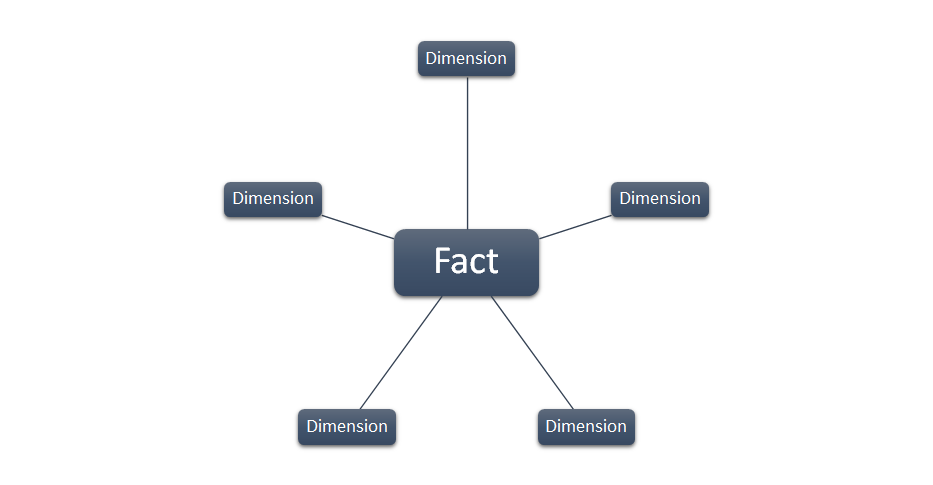

# Design of Data Warehouse



Lets take an initial look at the data

In [2]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
# Load the data into a dataframe
superstore_sales_df = pd.read_csv(SUPERSTORE_DATA_PATH)
superstore_sales_df.head()

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,Country,Postal Code,Market,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
0,32298,CA-2012-124891,31/07/12,31/07/12,Same Day,RH-19495,Rick Hansen,Consumer,New York City,New York,United States,10024.0,US,East,TEC-AC-10003033,Technology,Accessories,Plantronics CS510 - Over-the-Head monaural Wir...,2309.650,7,0.0,762.1845,933.57,Critical
1,26341,IN-2013-77878,05/02/13,07/02/13,Second Class,JR-16210,Justin Ritter,Corporate,Wollongong,New South Wales,Australia,NaN,APAC,Oceania,FUR-CH-10003950,Furniture,Chairs,"Novimex Executive Leather Armchair, Black",3709.395,9,0.1,-288.7650,923.63,Critical
2,25330,IN-2013-71249,17/10/13,18/10/13,First Class,CR-12730,Craig Reiter,Consumer,Brisbane,Queensland,Australia,NaN,APAC,Oceania,TEC-PH-10004664,Technology,Phones,"Nokia Smart Phone, with Caller ID",5175.171,9,0.1,919.9710,915.49,Medium
3,13524,ES-2013-1579342,28/01/13,30/01/13,First Class,KM-16375,Katherine Murray,Home Office,Berlin,Berlin,Germany,NaN,EU,Central,TEC-PH-10004583,Technology,Phones,"Motorola Smart Phone, Cordless",2892.510,5,0.1,-96.5400,910.16,Medium
4,47221,SG-2013-4320,05/11/13,06/11/13,Same Day,RH-9495,Rick Hansen,Consumer,Dakar,Dakar,Senegal,NaN,Africa,Africa,TEC-SHA-10000501,Technology,Copiers,"Sharp Wireless Fax, High-Speed",2832.960,8,0.0,311.5200,903.04,Critical


In [3]:
superstore_sales_df.columns

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Customer Name', 'Segment', 'City', 'State', 'Country',
       'Postal Code', 'Market', 'Region', 'Product ID', 'Category',
       'Sub-Category', 'Product Name', 'Sales', 'Quantity', 'Discount',
       'Profit', 'Shipping Cost', 'Order Priority'],
      dtype='object')

In [4]:
time_df = pd.read_csv(TIME_DATA_PATH)
time_df.head()

,month,short form,days,season
0,January,Jan.,31,winter
1,February,Feb.,28/29,winter
2,March,Mar.,31,spring
3,April,Apr.,30,spring
4,May,May,31,spring


**Question** : Is this data close to an OLAP data or OLTP?

**Answer** : This data is more closer to an OLAP store, as data is already aggregated at day level.

**Question** : What business questions can be answered for this data?

**Answer**:
* What are the most profitable products?
* Which states have most sales/profit?
* Which region give most profit/sales?
* What are profitable categories?
* Which time of the year maximum profit/sale is achived?
* What products to show maximum profit/sales?
* What products are sold most on each market?
* ... etc

**Question** :  *What are the dimensions and what are the facts in this data?*

**Answer**:  

* **Dimensions** : Customer details, Product details, Location details, Category details, Segment, Order Date, Ship Date, Market, Region
* **Facts** :  Sales, Quantity, Discount, Profit, Shipping Cost

**Question** : What is the granluarity should we choose here?

**Answer**
* Here he answer is mostly straight forward that we choose daily level factual data. 
* As the data given is to us is already aggregated at day level. 
* But imagine you might have POS data where each transaction is recorded to the second timestamp. 
* There deciding granlualrity depends on kind of bussiness questions we want to answer from data.

**Question** : Do you see sings of snowflacking dimensions here?

**Answer** : 
* We could have single dimension table for product and category and sub-categories or we could have two sepeate table ; one for product and one for category. 
* Even in category table we can have a table for sub_category and category separately.

The choice mostly depends on what are our most frequent access patterns. We would mostly like to analyse each product sperately and each category seperately. But it might not make logical sense to break the category and sub-categoty table.

**Question** : Identify the dimension tables and thier schema

**Answer**

* **dim_cutomer** :  
    * Has Customer name, Customer id, Customer key. 
    * Primary key in this dimension is Customer key
    * It is generated by entering query [Customer_Key] INT Identity (1,1) PK.

* **dim_product** : 
    * Product dimension has product_key as the primary key. 
    * Product_id contain id of the products. 
    * Product_name contain the name of product sold.
* **dim_category**:
    * Category_key
    * category, sub_category
* **dim_location** :
    * Location dimension contain Location_Key as primary key.
    * City, State, Country,Postal Code, Region
* **dim_date** :
    * Date dimension contain Date_Key as primary key
    * date, month, year
* **dim_month** :
    * month_key is the primary key
    * month, season, days in month 
* **dim_segment** :
    * segment_key
    * segment_name
* **dim_market**:
    * market_key
    * market_name
    

**Question** : Identify the fact tables and thier schema

**Answer** 

* **fact_retail** 
    * fact_key
    * order_id
    * coustomer_key
    * product_key
    * location_key
    * order_date_key
    * shipping_date_key
    * segment_key
    * market_key
    * category_key
    * sales
    * quantity
    * discount
    * profit
    * shipping_cost
    

**Question**: Draw the ER diagram of the star schema defined above

**Answer**

## Star Schema

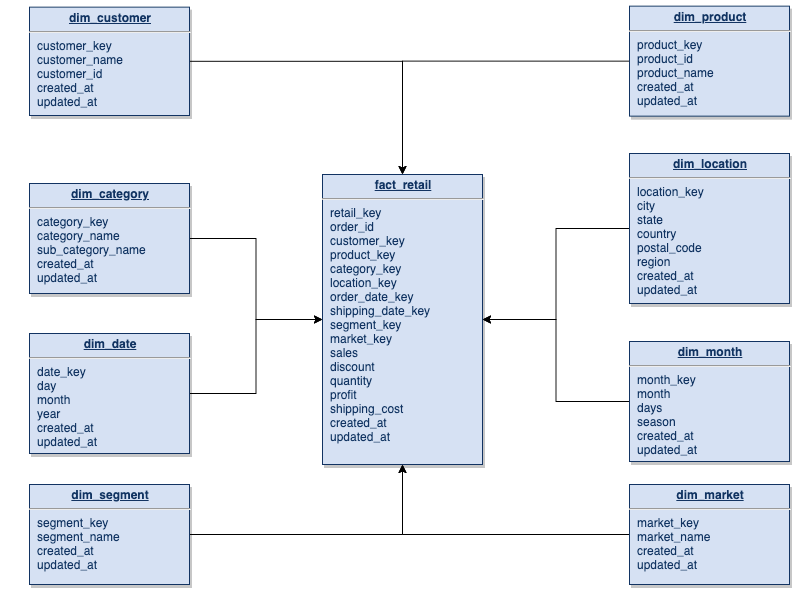

**Question** : What do we need surrogate keys where we have unique fields like customerId and productId?

**Answer** :  
* Each row in the fact table should be unique. But the ids could be repeated or chage over time, so we need to maintail OLAP idetifier for these ids.
* For eg, as the customer is repeated their id will also repeat and that won’t make the column unique.

**Question** : Do we really need created_at and updated_at dates?

**Answer** :
* As we know we are build a warehouse for an ongoing bussiness and there are always errors in real world.
* Created_At and updated_at dates help us tract which ELT run created or updated these records.
* More so, there is a state chage of warehouse from one to another on each incremental ELT run, so, these fields come in create help to revert a faulty / partial ETL run.

## Extract Transform Load (ETL) process

* To build a datawarehouse, we first copy the data in row form are present it the OLTP. This is usually done is a staging area.
* But the data in row form may not be usable so, we transform it based on the grainularity and dimesions idetified in the design process.
* Lastly loaded in destination area. 

This is known as ***ETL process***. 

* The data is extracted for external storage, which may be files , other databases, or a web api into the staging area.
* Next step is to carry Transformation stage. 
* Loading stage is the end of ETL.

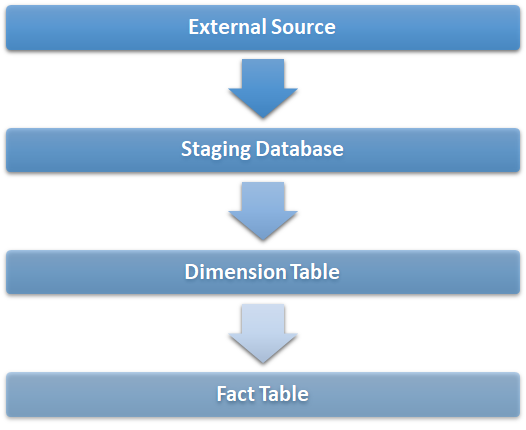

### Extraction

* We collect the data from an external source, which in this case are csv files
* This extraction will load the data into the the staging database base, which is oledb destination.
* All the data is extracted into the database from these csv files. 
* We can also see the data which comes in staging phase is stored in the database.

Following staging table are to be created and Exraction scripts are to writted for them.
*  main_stage
*  month_stage

In [5]:
# import necessary requirements for sqlalchemy
from sqlalchemy import *
from sqlalchemy.ext.declarative import declarative_base
from sqlalchemy.orm import sessionmaker
from sqlalchemy.sql import *

# create a database engine
engine = create_engine('sqlite:///global_superstore_dwh.db', echo=True)
Base = declarative_base()

In [6]:
# create necessary data model
class MainStage(Base):
    __tablename__ = "main_stage"
    RowID = Column(Integer, primary_key=True)
    OrderID = Column(String)
    OrderDate = Column(DateTime)
    ShipDate = Column(DateTime)
    ShipMode = Column(String)
    CustomerID = Column(String)
    CustomerName = Column(String)
    Segment = Column(String)
    City = Column(String)
    State = Column(String)
    Country = Column(String)
    PostalCode = Column(String)
    Market = Column(String)
    Region = Column(String)
    ProductID = Column(String)
    Category = Column(String)
    SubCategory = Column(String)
    ProductName = Column(String)
    Sales = Column(Float)
    Quantity = Column(Float) 
    Discount = Column(Float)
    Profit = Column(Float)
    ShippingCost = Column(Float)
    OrderPriority = Column(String)

class MonthStage(Base):
    __tablename__ = 'month_stage'
    Month = Column(String,primary_key=True)
    ShortForm = Column(String)
    Days = Column(String)
    Season = Column(String)
    
MainStage.__table__.create(bind=engine, checkfirst=True)
MonthStage.__table__.create(bind=engine, checkfirst=True)

2020-03-15 16:37:06,090 INFO sqlalchemy.engine.base.Engine SELECT CAST('test plain returns' AS VARCHAR(60)) AS anon_1
2020-03-15 16:37:06,091 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:06,092 INFO sqlalchemy.engine.base.Engine SELECT CAST('test unicode returns' AS VARCHAR(60)) AS anon_1
2020-03-15 16:37:06,093 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:06,094 INFO sqlalchemy.engine.base.Engine PRAGMA main.table_info("main_stage")
2020-03-15 16:37:06,095 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:06,096 INFO sqlalchemy.engine.base.Engine PRAGMA temp.table_info("main_stage")
2020-03-15 16:37:06,096 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:06,099 INFO sqlalchemy.engine.base.Engine 
CREATE TABLE main_stage (
	"RowID" INTEGER NOT NULL, 
	"OrderID" VARCHAR, 
	"OrderDate" DATETIME, 
	"ShipDate" DATETIME, 
	"ShipMode" VARCHAR, 
	"CustomerID" VARCHAR, 
	"CustomerName" VARCHAR, 
	"Segment" VARCHAR, 
	"City" VARCHAR, 
	"State" VARCHAR, 
	"Country"

### Transform
Before the data can be loaded into the dimension and fact table, it is important to ensure that it is in the correct format. Transforming data from current format to a homogenous format that can be written to a database is crucial step.

In [7]:
from dateutil import parser
def extract_staging_retail_data(db_engine,file_path):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    import pandas as pd
    superstore_sales_df = pd.read_csv(file_path)
    rows = superstore_sales_df.apply(lambda row : {'RowID': int(row['Row ID']),
                                                   'OrderID': row['Order ID'],
                                                   'OrderDate': parser.parse(row['Order Date']),
                                                   'ShipDate': parser.parse(row['Ship Date']),
                                                   'ShipMode': row['Ship Mode'],
                                                   'CustomerID': row['Customer ID'],
                                                   'CustomerName': row['Customer Name'],
                                                   'Segment': row['Segment'],
                                                   'City': row['City'] if str(row['City'])!='nan' else '',
                                                   'State': row['State'] if str(row['State'])!='nan' else '',
                                                   'Country': row['Country'] if str(row['Country'])!='nan' else '',
                                                   'PostalCode': row['Postal Code'] if str(row['Postal Code'])!='nan' else '',
                                                   'Market': row['Market'],
                                                   'Region': row['Region'] if str(row['Region'])!='nan' else '',
                                                   'ProductID': row['Product ID'],
                                                   'Category': row['Category'],
                                                   'SubCategory': row['Sub-Category'],
                                                   'ProductName': row['Product Name'],
                                                   'Sales': float(row['Sales']),
                                                   'Quantity': float(row['Quantity']),
                                                   'Discount': float(row['Discount']),
                                                   'Profit': float(row['Profit']),
                                                   'ShippingCost': float(row['Shipping Cost']),
                                                   'OrderPriority': row['Order Priority'],
                                                  }, axis=1)
    for row in rows:
        row = MainStage(**row)
        session.add(row)
    session.commit()
    
def extract_staging_time_data(db_engine,file_path):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    import pandas as pd
    time_df = pd.read_csv(file_path)
    rows = time_df.apply(lambda row : {'Month':row['month'],
                                       'ShortForm':row['short form'],
                                       'Days': str(row['days']),
                                       'Season':row['season']
                                      }, axis=1)
    for row in rows:
        row = MonthStage(**row)
        session.add(row)
    session.commit()

extract_staging_retail_data(engine, SUPERSTORE_DATA_PATH)
extract_staging_time_data(engine, TIME_DATA_PATH)

2020-03-15 16:37:24,897 INFO sqlalchemy.engine.base.Engine BEGIN (implicit)
2020-03-15 16:37:27,083 INFO sqlalchemy.engine.base.Engine INSERT INTO main_stage ("RowID", "OrderID", "OrderDate", "ShipDate", "ShipMode", "CustomerID", "CustomerName", "Segment", "City", "State", "Country", "PostalCode", "Market", "Region", "ProductID", "Category", "SubCategory", "ProductName", "Sales", "Quantity", "Discount", "Profit", "ShippingCost", "OrderPriority") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:37:27,083 INFO sqlalchemy.engine.base.Engine ((32298, 'CA-2012-124891', '2012-07-31 00:00:00.000000', '2012-07-31 00:00:00.000000', 'Same Day', 'RH-19495', 'Rick Hansen', 'Consumer', 'New York City', 'New York', 'United States', 10024.0, 'US', 'East', 'TEC-AC-10003033', 'Technology', 'Accessories', 'Plantronics CS510 - Over-the-Head monaural Wireless Headset System', 2309.65, 7.0, 0.0, 762.1845, 933.57, 'Critical'), (26341, 'IN-2013-77878', '2013-05-02

### Load
* Now, data can easily be loaded into a database
* We make the SQLAlchemy ORM models we defined the star schema earlier

In [8]:
class DimProduct(Base):
    __tablename__ = "dim_product"
    ProductKey = Column(Integer,primary_key=True,autoincrement=True)
    ProductId = Column(String)
    ProductName = Column(String)

class DimCustomer(Base):
    __tablename__ = "dim_customer"
    CustomerKey = Column(Integer,primary_key=True,autoincrement=True)
    CustomerId = Column(String)
    CustomerName = Column(String)

class DimCategory(Base):
    __tablename__ = "dim_category"
    CategoryKey = Column(Integer,primary_key=True,autoincrement=True)
    CategoryName = Column(String)
    SubCategoryName = Column(String)

class DimLocation(Base):
    __tablename__ = "dim_location"
    LocationKey = Column(Integer,primary_key=True,autoincrement=True)
    City = Column(String)
    State = Column(String)
    Country = Column(String)
    Region = Column(String)
    PostalCode = Column(String)
    Region = Column(String)

class DimDate(Base):
    __tablename__ = "dim_date"
    DateKey = Column(Integer,primary_key=True,autoincrement=True)
    Day = Column(Integer)
    Month = Column(Integer)
    Year = Column(Integer)
    Date = Column(DateTime)

class DimMonth(Base):
    __tablename__ = "dim_month"
    MonthKey = Column(Integer,primary_key=True,autoincrement=True)
    MonthNumber = Column(Integer)
    MonthName = Column(String)
    ShortForm = Column(String)
    Days = Column(String)
    Season = Column(String)

class DimSegment(Base):
    __tablename__ = "dim_segment"
    SegmentKey = Column(Integer,primary_key=True,autoincrement=True)
    SegmentName = Column(String)
    
class DimMarket(Base):
    __tablename__ = "dim_market"
    MarketKey = Column(Integer,primary_key=True,autoincrement=True)
    MarketName = Column(String)

class FactRetail(Base):
    __tablename__ = "fact_retail"
    RetailKey = Column(Integer,primary_key=True,autoincrement=True)
    OrderId = Column(String)
    CustomerKey = Column(Integer, ForeignKey('dim_customer.CustomerKey'))
    ProductKey = Column(Integer, ForeignKey('dim_product.ProductKey'))
    LocationKey = Column(Integer, ForeignKey('dim_location.LocationKey'))
    CategoryKey = Column(Integer, ForeignKey('dim_category.CategoryKey'))
    OrderDateKey = Column(Integer, ForeignKey('dim_date.DateKey'))
    ShippingDateKey = Column(Integer, ForeignKey('dim_date.DateKey'))
    SegmentKey = Column(Integer, ForeignKey('dim_segment.SegmentKey'))
    MarketKey = Column(Integer, ForeignKey('dim_market.MarketKey'))
    Sales = Column(Float)
    Discount = Column(Float)
    Quantity = Column(Float)
    Profit = Column(Float)
    ShippingCost = Column(Float)

DimProduct.__table__.create(bind=engine, checkfirst=True)
DimCustomer.__table__.create(bind=engine, checkfirst=True)
DimCategory.__table__.create(bind=engine, checkfirst=True)
DimLocation.__table__.create(bind=engine, checkfirst=True)
DimDate.__table__.create(bind=engine, checkfirst=True)
DimMonth.__table__.create(bind=engine, checkfirst=True)
DimSegment.__table__.create(bind=engine, checkfirst=True)
DimMarket.__table__.create(bind=engine, checkfirst=True)
FactRetail.__table__.create(bind=engine, checkfirst=True)

2020-03-15 16:37:28,721 INFO sqlalchemy.engine.base.Engine PRAGMA main.table_info("dim_product")
2020-03-15 16:37:28,722 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:28,723 INFO sqlalchemy.engine.base.Engine PRAGMA temp.table_info("dim_product")
2020-03-15 16:37:28,724 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:28,725 INFO sqlalchemy.engine.base.Engine 
CREATE TABLE dim_product (
	"ProductKey" INTEGER NOT NULL, 
	"ProductId" VARCHAR, 
	"ProductName" VARCHAR, 
	PRIMARY KEY ("ProductKey")
)


2020-03-15 16:37:28,726 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:28,732 INFO sqlalchemy.engine.base.Engine COMMIT
2020-03-15 16:37:28,734 INFO sqlalchemy.engine.base.Engine PRAGMA main.table_info("dim_customer")
2020-03-15 16:37:28,734 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:28,735 INFO sqlalchemy.engine.base.Engine PRAGMA temp.table_info("dim_customer")
2020-03-15 16:37:28,736 INFO sqlalchemy.engine.base.Engine ()
2020-03-15 16:37:28,738 INFO sqlal

Load functions here loads the data from staging area to original dimension tables

In [9]:
from sqlalchemy.inspection import inspect
from datetime import date, timedelta

def load_dim_customer(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MainStage).all()
    unique_customers = set()
    for row in rows:
        unique_customers.add((row.CustomerID,row.CustomerName))
    rows = [{'CustomerId':row[0],'CustomerName':row[1]} for row in unique_customers]
    for row in rows:
        row = DimCustomer(**row)
        session.add(row)
    session.commit()
    
def load_dim_product(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MainStage).all()
    unique_products = set()
    for row in rows:
        unique_products.add((row.ProductID,row.ProductName))
    rows = [{'ProductId':row[0],'ProductName':row[1]} for row in unique_products]
    for row in rows:
        row = DimProduct(**row)
        session.add(row)
    session.commit()

def load_dim_location(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MainStage).all()
    unique_locations = set()
    for row in rows:
        unique_locations.add((row.City,row.State, row.Country,row.PostalCode,row.Region))
    rows = [{'City':row[0] if str(row[0])!='nan' else '',
             'State':row[1] if str(row[1])!='nan' else '',
             'Country':row[2] if str(row[2])!='nan' else '',
             'PostalCode':row[3] if str(row[3])!='nan' else '',
             'Region':row[4] if str(row[4])!='nan' else ''} 
            for row in unique_locations]
    for row in rows:
        row = DimLocation(**row)
        session.add(row)
    session.commit()
    
def load_dim_category(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MainStage).all()
    unique_category = set()
    for row in rows:
        unique_category.add((row.Category,row.SubCategory))
    rows = [{'CategoryName':row[0],'SubCategoryName':row[1]} 
            for row in unique_category]
    for row in rows:
        row = DimCategory(**row)
        session.add(row)
    session.commit()
    
def load_dim_date(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    min_date = min([session.query(func.min(MainStage.OrderDate)).one()[0],
                session.query(func.min(MainStage.ShipDate)).one()[0]])
    max_date = max([session.query(func.max(MainStage.OrderDate)).one()[0],
                session.query(func.max(MainStage.ShipDate)).one()[0]])
    delta = max_date - min_date
    rows = []
    for i in range(delta.days + 1):
        day = min_date + timedelta(days=i)
        rows.append({'Day':day.day,'Month':day.month,'Year':day.year, 'Date':day})
    for row in rows:
        row = DimDate(**row)
        session.add(row)
    session.commit()
    
def load_dim_month(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MonthStage).all()
    MonthName = Column(String)
    ShortForm = Column(String)
    Days = Column(String)
    Season = Column(String)
    
    Month = Column(String,primary_key=True)
    ShortForm = Column(String)
    Days = Column(String)
    Season = Column(String)
    
    rows = [{'MonthNumber':i+1,
             'MonthName':row.Month, 
             'ShortForm':row.ShortForm,
             'Days':row.Days,
             'Season': row.Season
            } for i,row in enumerate(rows)]
    for row in rows:
        row = DimMonth(**row)
        session.add(row)
    session.commit()

def load_dim_segment(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MainStage).all()
    unique_segments = set()
    for row in rows:
        unique_segments.add(row.Segment)
    rows = [{'SegmentName':row} for row in unique_segments]
    for row in rows:
        row = DimSegment(**row)
        session.add(row)
    session.commit()

def load_dim_market(db_engine):
    Session = sessionmaker(bind=db_engine)
    session = Session()
    rows = session.query(MainStage).all()
    unique_markets = set()
    for row in rows:
        unique_markets.add(row.Market)
    rows = [{'MarketName':row} for row in unique_markets]
    for row in rows:
        row = DimMarket(**row)
        session.add(row)
    session.commit()

def load_fact_retail(db_engine):
    from sqlalchemy import alias, and_
    from sqlalchemy.orm import aliased
    
    DimOrderDate = aliased(DimDate)
    DimShipDate = aliased(DimDate)
    Session = sessionmaker(bind=engine)
    session = Session()
    rows = session.query(MainStage.OrderID.label('OrderId'),
                  DimCustomer.CustomerKey.label('CustomerKey'), 
                  DimProduct.ProductKey.label('ProductKey'),
                  DimLocation.LocationKey.label('LocationKey'),
                  DimCategory.CategoryKey.label('CategoryKey'),
                  DimOrderDate.DateKey.label('OrderDateKey'),
                  DimShipDate.DateKey.label('ShippingDateKey'),
                  DimSegment.SegmentKey.label('SegmentKey'),
                  DimMarket.MarketKey.label('MarketKey'),
                  MainStage.Sales.label('Sales'),
                  MainStage.Discount.label('Discount'),
                  MainStage.Quantity.label('Quantity'),
                  MainStage.Profit.label('Profit'),
                  MainStage.ShippingCost.label('ShippingCost')
                 ).join(DimProduct, and_(MainStage.ProductID == DimProduct.ProductId , 
                                         MainStage.ProductName == DimProduct.ProductName)
                 ).join(DimCustomer, and_(MainStage.CustomerID==DimCustomer.CustomerId,
                                          MainStage.CustomerName==DimCustomer.CustomerName)
                 ).join(DimCategory, and_(MainStage.Category==DimCategory.CategoryName,
                                          MainStage.SubCategory == DimCategory.SubCategoryName
                                         )
                 ).join(DimLocation, and_(MainStage.City==DimLocation.City,
                                          MainStage.State==DimLocation.State,
                                          MainStage.Country==DimLocation.Country,
                                          MainStage.PostalCode==DimLocation.PostalCode,
                                          MainStage.Region==DimLocation.Region
                                         )
                 ).join(DimOrderDate,and_(MainStage.OrderDate==DimOrderDate.Date)
                 ).join(DimShipDate, and_(MainStage.ShipDate==DimShipDate.Date)
                 ).join(DimSegment, and_(MainStage.Segment==DimSegment.SegmentName)
                 ).join(DimMarket, and_(MainStage.Market==DimMarket.MarketName)
                 )
    rows = rows.all()
    fact_rows = []
    for row in rows:
        fact_rows.append({'OrderId': row[0],
                          'CustomerKey':row[1],
                          'ProductKey':row[2],
                          'LocationKey':row[3],
                          'CategoryKey': row[4],
                          'OrderDateKey':row[5],
                          'ShippingDateKey':row[6],
                          'SegmentKey':row[7],
                          'MarketKey':row[8],
                          'Sales':row[9],
                          'Discount':row[10],
                          'Quantity':row[11],
                          'Profit':row[12],
                          'ShippingCost':row[13]
                         })
    for row in fact_rows:
        row = FactRetail(**row)
        session.add(row)
    session.commit()

load_dim_customer(engine)
load_dim_product(engine)
load_dim_location(engine)
load_dim_category(engine)
load_dim_date(engine)
load_dim_market(engine)
load_dim_month(engine)
load_dim_segment(engine)
load_fact_retail(engine)

2020-03-15 16:37:28,913 INFO sqlalchemy.engine.base.Engine BEGIN (implicit)
2020-03-15 16:37:28,915 INFO sqlalchemy.engine.base.Engine SELECT main_stage."RowID" AS "main_stage_RowID", main_stage."OrderID" AS "main_stage_OrderID", main_stage."OrderDate" AS "main_stage_OrderDate", main_stage."ShipDate" AS "main_stage_ShipDate", main_stage."ShipMode" AS "main_stage_ShipMode", main_stage."CustomerID" AS "main_stage_CustomerID", main_stage."CustomerName" AS "main_stage_CustomerName", main_stage."Segment" AS "main_stage_Segment", main_stage."City" AS "main_stage_City", main_stage."State" AS "main_stage_State", main_stage."Country" AS "main_stage_Country", main_stage."PostalCode" AS "main_stage_PostalCode", main_stage."Market" AS "main_stage_Market", main_stage."Region" AS "main_stage_Region", main_stage."ProductID" AS "main_stage_ProductID", main_stage."Category" AS "main_stage_Category", main_stage."SubCategory" AS "main_stage_SubCategory", main_stage."ProductName" AS "main_stage_ProductNam

2020-03-15 16:37:30,535 INFO sqlalchemy.engine.base.Engine ('CM-1815', 'Candace McMahon')
2020-03-15 16:37:30,535 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,536 INFO sqlalchemy.engine.base.Engine ('CK-2595', 'Clytie Kelty')
2020-03-15 16:37:30,536 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,536 INFO sqlalchemy.engine.base.Engine ('RA-9945', 'Ryan Akin')
2020-03-15 16:37:30,537 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,537 INFO sqlalchemy.engine.base.Engine ('TP-21565', 'Tracy Poddar')
2020-03-15 16:37:30,538 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,539 INFO sqlalchemy.engine.base.Engine ('MO-17800', "Meg O'Connel")
2020-03-15 16:37:30,540 INFO sqlalchemy.engine.

2020-03-15 16:37:30,587 INFO sqlalchemy.engine.base.Engine ('RD-19810', 'Ross DeVincentis')
2020-03-15 16:37:30,588 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,588 INFO sqlalchemy.engine.base.Engine ('BD-1635', 'Brian Derr')
2020-03-15 16:37:30,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,589 INFO sqlalchemy.engine.base.Engine ('AA-10315', 'Alex Avila')
2020-03-15 16:37:30,590 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,590 INFO sqlalchemy.engine.base.Engine ('KW-16570', 'Kelly Williams')
2020-03-15 16:37:30,590 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,591 INFO sqlalchemy.engine.base.Engine ('AC-420', 'Alyssa Crouse')
2020-03-15 16:37:30,591 INFO sqlalchemy.engi

2020-03-15 16:37:30,625 INFO sqlalchemy.engine.base.Engine ('MC-8100', 'Mick Crebagga')
2020-03-15 16:37:30,626 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,626 INFO sqlalchemy.engine.base.Engine ('FA-4230', 'Frank Atkinson')
2020-03-15 16:37:30,629 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,630 INFO sqlalchemy.engine.base.Engine ('AH-120', 'Adrian Hane')
2020-03-15 16:37:30,630 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,631 INFO sqlalchemy.engine.base.Engine ('MY-18295', 'Muhammed Yedwab')
2020-03-15 16:37:30,631 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,632 INFO sqlalchemy.engine.base.Engine ('GH-4485', 'Gene Hale')
2020-03-15 16:37:30,632 INFO sqlalchemy.engine.

2020-03-15 16:37:30,670 INFO sqlalchemy.engine.base.Engine ('CM-2160', 'Charles McCrossin')
2020-03-15 16:37:30,671 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,671 INFO sqlalchemy.engine.base.Engine ('BT-11530', 'Bradley Talbott')
2020-03-15 16:37:30,671 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,672 INFO sqlalchemy.engine.base.Engine ('TH-11235', 'Tiffany House')
2020-03-15 16:37:30,672 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,673 INFO sqlalchemy.engine.base.Engine ('JM-15580', 'Jill Matthias')
2020-03-15 16:37:30,673 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,674 INFO sqlalchemy.engine.base.Engine ('PO-19180', 'Philisse Overcash')
2020-03-15 16:37:30,674 INFO s

2020-03-15 16:37:30,718 INFO sqlalchemy.engine.base.Engine ('JF-15490', 'Jeremy Farry')
2020-03-15 16:37:30,719 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,719 INFO sqlalchemy.engine.base.Engine ('DC-12850', 'Dan Campbell')
2020-03-15 16:37:30,720 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,720 INFO sqlalchemy.engine.base.Engine ('LP-17080', 'Liz Pelletier')
2020-03-15 16:37:30,721 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,721 INFO sqlalchemy.engine.base.Engine ('LH-17155', 'Logan Haushalter')
2020-03-15 16:37:30,722 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,722 INFO sqlalchemy.engine.base.Engine ('EP-3915', 'Emily Phan')
2020-03-15 16:37:30,723 INFO sqlalchemy.en

2020-03-15 16:37:30,786 INFO sqlalchemy.engine.base.Engine ('IL-15100', 'Ivan Liston')
2020-03-15 16:37:30,787 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,787 INFO sqlalchemy.engine.base.Engine ('EM-4095', 'Eudokia Martin')
2020-03-15 16:37:30,788 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,788 INFO sqlalchemy.engine.base.Engine ('KW-16435', 'Katrina Willman')
2020-03-15 16:37:30,789 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,789 INFO sqlalchemy.engine.base.Engine ('DA-13450', 'Dianna Arnett')
2020-03-15 16:37:30,790 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,791 INFO sqlalchemy.engine.base.Engine ('TS-21370', 'Todd Sumrall')
2020-03-15 16:37:30,791 INFO sqlalchemy.

2020-03-15 16:37:30,823 INFO sqlalchemy.engine.base.Engine ('MG-18205', 'Mitch Gastineau')
2020-03-15 16:37:30,824 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,824 INFO sqlalchemy.engine.base.Engine ('CC-12100', 'Chad Cunningham')
2020-03-15 16:37:30,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,825 INFO sqlalchemy.engine.base.Engine ('HK-14890', 'Heather Kirkland')
2020-03-15 16:37:30,826 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,826 INFO sqlalchemy.engine.base.Engine ('KT-16480', 'Kean Thornton')
2020-03-15 16:37:30,827 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,827 INFO sqlalchemy.engine.base.Engine ('AH-30', 'Aaron Hawkins')
2020-03-15 16:37:30,827 INFO sqlalc

2020-03-15 16:37:30,856 INFO sqlalchemy.engine.base.Engine ('CS-1950', 'Carlos Soltero')
2020-03-15 16:37:30,857 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,857 INFO sqlalchemy.engine.base.Engine ('SD-20485', 'Shirley Daniels')
2020-03-15 16:37:30,858 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,858 INFO sqlalchemy.engine.base.Engine ('BE-1335', 'Bill Eplett')
2020-03-15 16:37:30,859 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,859 INFO sqlalchemy.engine.base.Engine ('LR-7035', 'Lisa Ryan')
2020-03-15 16:37:30,859 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,860 INFO sqlalchemy.engine.base.Engine ('JF-5190', 'Jamie Frazer')
2020-03-15 16:37:30,860 INFO sqlalchemy.engine.

2020-03-15 16:37:30,944 INFO sqlalchemy.engine.base.Engine ('MH-7785', 'Maya Herman')
2020-03-15 16:37:30,945 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,945 INFO sqlalchemy.engine.base.Engine ('VP-21730', 'Victor Preis')
2020-03-15 16:37:30,945 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,946 INFO sqlalchemy.engine.base.Engine ('CT-11995', 'Carol Triggs')
2020-03-15 16:37:30,946 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,946 INFO sqlalchemy.engine.base.Engine ('MZ-7515', 'Mary Zewe')
2020-03-15 16:37:30,947 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,947 INFO sqlalchemy.engine.base.Engine ('EB-3930', 'Eric Barreto')
2020-03-15 16:37:30,948 INFO sqlalchemy.engine.base

2020-03-15 16:37:30,977 INFO sqlalchemy.engine.base.Engine ('IL-5100', 'Ivan Liston')
2020-03-15 16:37:30,977 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,978 INFO sqlalchemy.engine.base.Engine ('TG-21640', 'Trudy Glocke')
2020-03-15 16:37:30,978 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,979 INFO sqlalchemy.engine.base.Engine ('PS-18760', 'Pamela Stobb')
2020-03-15 16:37:30,979 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,980 INFO sqlalchemy.engine.base.Engine ('NC-8535', 'Nick Crebassa')
2020-03-15 16:37:30,980 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:30,980 INFO sqlalchemy.engine.base.Engine ('TS-21655', 'Trudy Schmidt')
2020-03-15 16:37:30,981 INFO sqlalchemy.engin

2020-03-15 16:37:31,009 INFO sqlalchemy.engine.base.Engine ('TH-11100', 'Thea Hendricks')
2020-03-15 16:37:31,010 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,010 INFO sqlalchemy.engine.base.Engine ('SW-20455', 'Shaun Weien')
2020-03-15 16:37:31,011 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,011 INFO sqlalchemy.engine.base.Engine ('RW-19540', 'Rick Wilson')
2020-03-15 16:37:31,012 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,012 INFO sqlalchemy.engine.base.Engine ('JD-16060', 'Julia Dunbar')
2020-03-15 16:37:31,013 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,013 INFO sqlalchemy.engine.base.Engine ('RM-19375', 'Raymond Messe')
2020-03-15 16:37:31,013 INFO sqlalchemy.eng

2020-03-15 16:37:31,100 INFO sqlalchemy.engine.base.Engine ('KH-6510', 'Keith Herrera')
2020-03-15 16:37:31,100 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,101 INFO sqlalchemy.engine.base.Engine ('CK-2205', 'Chloris Kastensmidt')
2020-03-15 16:37:31,101 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,101 INFO sqlalchemy.engine.base.Engine ('SG-10080', 'Sandra Glassco')
2020-03-15 16:37:31,102 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,102 INFO sqlalchemy.engine.base.Engine ('DE-13255', 'Deanra Eno')
2020-03-15 16:37:31,103 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,103 INFO sqlalchemy.engine.base.Engine ('MC-7605', 'Matt Connell')
2020-03-15 16:37:31,104 INFO sqlalchemy

2020-03-15 16:37:31,132 INFO sqlalchemy.engine.base.Engine ('RD-9900', 'Ruben Dartt')
2020-03-15 16:37:31,133 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,133 INFO sqlalchemy.engine.base.Engine ('KH-16360', 'Katherine Hughes')
2020-03-15 16:37:31,134 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,134 INFO sqlalchemy.engine.base.Engine ('AJ-795', 'Anthony Johnson')
2020-03-15 16:37:31,135 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,135 INFO sqlalchemy.engine.base.Engine ('MG-18145', 'Mike Gockenbach')
2020-03-15 16:37:31,135 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,136 INFO sqlalchemy.engine.base.Engine ('IG-15085', 'Ivan Gibson')
2020-03-15 16:37:31,137 INFO sqlalchemy

2020-03-15 16:37:31,166 INFO sqlalchemy.engine.base.Engine ('DW-3585', 'Dorothy Wardle')
2020-03-15 16:37:31,166 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,167 INFO sqlalchemy.engine.base.Engine ('TZ-11580', 'Tracy Zic')
2020-03-15 16:37:31,167 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,167 INFO sqlalchemy.engine.base.Engine ('PO-8865', "Patrick O'Donnell")
2020-03-15 16:37:31,168 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,168 INFO sqlalchemy.engine.base.Engine ('MH-17620', 'Matt Hagelstein')
2020-03-15 16:37:31,169 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,169 INFO sqlalchemy.engine.base.Engine ('PB-19210', 'Phillip Breyer')
2020-03-15 16:37:31,170 INFO sqlalche

2020-03-15 16:37:31,255 INFO sqlalchemy.engine.base.Engine ('DB-3615', 'Doug Bickford')
2020-03-15 16:37:31,255 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,256 INFO sqlalchemy.engine.base.Engine ('CS-1845', 'Cari Sayre')
2020-03-15 16:37:31,256 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,257 INFO sqlalchemy.engine.base.Engine ('SS-20590', 'Sonia Sunley')
2020-03-15 16:37:31,257 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,258 INFO sqlalchemy.engine.base.Engine ('MO-7500', "Mary O'Rourke")
2020-03-15 16:37:31,258 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,258 INFO sqlalchemy.engine.base.Engine ('AS-90', 'Adam Shillingsburg')
2020-03-15 16:37:31,259 INFO sqlalchemy.engi

2020-03-15 16:37:31,286 INFO sqlalchemy.engine.base.Engine ('LO-17170', 'Lori Olson')
2020-03-15 16:37:31,287 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,287 INFO sqlalchemy.engine.base.Engine ('TC-21475', 'Tony Chapman')
2020-03-15 16:37:31,288 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,288 INFO sqlalchemy.engine.base.Engine ('BM-1785', 'Bryan Mills')
2020-03-15 16:37:31,288 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,289 INFO sqlalchemy.engine.base.Engine ('CS-12130', 'Chad Sievert')
2020-03-15 16:37:31,289 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,290 INFO sqlalchemy.engine.base.Engine ('PR-8880', 'Patrick Ryan')
2020-03-15 16:37:31,290 INFO sqlalchemy.engine.ba

2020-03-15 16:37:31,319 INFO sqlalchemy.engine.base.Engine ('KA-6525', 'Kelly Andreada')
2020-03-15 16:37:31,320 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,320 INFO sqlalchemy.engine.base.Engine ('FP-4320', 'Frank Preis')
2020-03-15 16:37:31,321 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,321 INFO sqlalchemy.engine.base.Engine ('BC-11125', 'Becky Castell')
2020-03-15 16:37:31,321 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,322 INFO sqlalchemy.engine.base.Engine ('BD-11605', 'Brian Dahlen')
2020-03-15 16:37:31,322 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,323 INFO sqlalchemy.engine.base.Engine ('AR-825', 'Anthony Rawles')
2020-03-15 16:37:31,323 INFO sqlalchemy.engi

2020-03-15 16:37:31,353 INFO sqlalchemy.engine.base.Engine ('PC-18745', 'Pamela Coakley')
2020-03-15 16:37:31,354 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,354 INFO sqlalchemy.engine.base.Engine ('BD-11725', 'Bruce Degenhardt')
2020-03-15 16:37:31,355 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,355 INFO sqlalchemy.engine.base.Engine ('EM-4200', 'Evan Minnotte')
2020-03-15 16:37:31,356 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,356 INFO sqlalchemy.engine.base.Engine ('RD-19660', 'Robert Dilbeck')
2020-03-15 16:37:31,357 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,357 INFO sqlalchemy.engine.base.Engine ('TS-11430', 'Tom Stivers')
2020-03-15 16:37:31,358 INFO sqlalche

2020-03-15 16:37:31,444 INFO sqlalchemy.engine.base.Engine ('SZ-10035', 'Sam Zeldin')
2020-03-15 16:37:31,444 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,444 INFO sqlalchemy.engine.base.Engine ('BP-11095', 'Bart Pistole')
2020-03-15 16:37:31,445 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,445 INFO sqlalchemy.engine.base.Engine ('BV-1245', 'Benjamin Venier')
2020-03-15 16:37:31,446 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,446 INFO sqlalchemy.engine.base.Engine ('OT-8730', 'Olvera Toch')
2020-03-15 16:37:31,447 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,447 INFO sqlalchemy.engine.base.Engine ('CL-2565', 'Clay Ludtke')
2020-03-15 16:37:31,447 INFO sqlalchemy.engine.b

2020-03-15 16:37:31,476 INFO sqlalchemy.engine.base.Engine ('DW-13540', 'Don Weiss')
2020-03-15 16:37:31,477 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,477 INFO sqlalchemy.engine.base.Engine ('BV-11245', 'Benjamin Venier')
2020-03-15 16:37:31,478 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,478 INFO sqlalchemy.engine.base.Engine ('LE-6810', 'Laurel Elliston')
2020-03-15 16:37:31,479 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,479 INFO sqlalchemy.engine.base.Engine ('CM-12160', 'Charles McCrossin')
2020-03-15 16:37:31,479 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,480 INFO sqlalchemy.engine.base.Engine ('DG-13300', 'Deirdre Greer')
2020-03-15 16:37:31,480 INFO sqlalch

2020-03-15 16:37:31,509 INFO sqlalchemy.engine.base.Engine ('DE-3255', 'Deanra Eno')
2020-03-15 16:37:31,509 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,510 INFO sqlalchemy.engine.base.Engine ('SJ-10215', 'Sarah Jordon')
2020-03-15 16:37:31,510 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,510 INFO sqlalchemy.engine.base.Engine ('CR-2820', 'Cyra Reiten')
2020-03-15 16:37:31,511 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,511 INFO sqlalchemy.engine.base.Engine ('CG-12040', 'Catherine Glotzbach')
2020-03-15 16:37:31,512 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,512 INFO sqlalchemy.engine.base.Engine ('SC-10050', 'Sample Company A')
2020-03-15 16:37:31,513 INFO sqlalchem

2020-03-15 16:37:31,601 INFO sqlalchemy.engine.base.Engine ('RP-19855', 'Roy Phan')
2020-03-15 16:37:31,602 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,602 INFO sqlalchemy.engine.base.Engine ('PC-8745', 'Pamela Coakley')
2020-03-15 16:37:31,603 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,603 INFO sqlalchemy.engine.base.Engine ('AH-10030', 'Aaron Hawkins')
2020-03-15 16:37:31,603 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,604 INFO sqlalchemy.engine.base.Engine ('DW-3540', 'Don Weiss')
2020-03-15 16:37:31,604 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,605 INFO sqlalchemy.engine.base.Engine ('BP-1290', 'Beth Paige')
2020-03-15 16:37:31,605 INFO sqlalchemy.engine.base.E

2020-03-15 16:37:31,633 INFO sqlalchemy.engine.base.Engine ('SC-20680', 'Steve Carroll')
2020-03-15 16:37:31,634 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,634 INFO sqlalchemy.engine.base.Engine ('HR-4770', 'Hallie Redmond')
2020-03-15 16:37:31,635 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,635 INFO sqlalchemy.engine.base.Engine ('BN-11515', 'Bradley Nguyen')
2020-03-15 16:37:31,636 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,636 INFO sqlalchemy.engine.base.Engine ('MK-7905', 'Michael Kennedy')
2020-03-15 16:37:31,636 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,637 INFO sqlalchemy.engine.base.Engine ('SW-20350', 'Sean Wendt')
2020-03-15 16:37:31,637 INFO sqlalchemy.

2020-03-15 16:37:31,666 INFO sqlalchemy.engine.base.Engine ('NB-8580', 'Nicole Brennan')
2020-03-15 16:37:31,666 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,667 INFO sqlalchemy.engine.base.Engine ('DR-12940', 'Daniel Raglin')
2020-03-15 16:37:31,667 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,667 INFO sqlalchemy.engine.base.Engine ('SV-10785', 'Stewart Visinsky')
2020-03-15 16:37:31,668 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,668 INFO sqlalchemy.engine.base.Engine ('KM-6720', 'Kunst Miller')
2020-03-15 16:37:31,669 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,669 INFO sqlalchemy.engine.base.Engine ('AH-10210', 'Alan Hwang')
2020-03-15 16:37:31,669 INFO sqlalchemy.e

2020-03-15 16:37:31,754 INFO sqlalchemy.engine.base.Engine ('ND-18370', 'Natalie DeCherney')
2020-03-15 16:37:31,755 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,755 INFO sqlalchemy.engine.base.Engine ('RB-9330', 'Randy Bradley')
2020-03-15 16:37:31,756 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,756 INFO sqlalchemy.engine.base.Engine ('HJ-14875', 'Heather Jas')
2020-03-15 16:37:31,757 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,757 INFO sqlalchemy.engine.base.Engine ('RE-19450', 'Richard Eichhorn')
2020-03-15 16:37:31,758 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,758 INFO sqlalchemy.engine.base.Engine ('YC-11895', 'Yoseph Carroll')
2020-03-15 16:37:31,758 INFO sqlal

2020-03-15 16:37:31,788 INFO sqlalchemy.engine.base.Engine ('JM-15535', 'Jessica Myrick')
2020-03-15 16:37:31,789 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,789 INFO sqlalchemy.engine.base.Engine ('EB-3750', 'Edward Becker')
2020-03-15 16:37:31,790 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,790 INFO sqlalchemy.engine.base.Engine ('AJ-960', 'Astrea Jones')
2020-03-15 16:37:31,790 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,791 INFO sqlalchemy.engine.base.Engine ('SC-20800', 'Stuart Calhoun')
2020-03-15 16:37:31,791 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,791 INFO sqlalchemy.engine.base.Engine ('FH-14350', 'Fred Harton')
2020-03-15 16:37:31,792 INFO sqlalchemy.eng

2020-03-15 16:37:31,821 INFO sqlalchemy.engine.base.Engine ('EH-13945', 'Eric Hoffmann')
2020-03-15 16:37:31,821 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,822 INFO sqlalchemy.engine.base.Engine ('JJ-15760', 'Joel Jenkins')
2020-03-15 16:37:31,822 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,823 INFO sqlalchemy.engine.base.Engine ('ST-10530', 'Shui Tom')
2020-03-15 16:37:31,823 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,823 INFO sqlalchemy.engine.base.Engine ('DH-3675', 'Duane Huffman')
2020-03-15 16:37:31,824 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,824 INFO sqlalchemy.engine.base.Engine ('CC-2685', 'Craig Carroll')
2020-03-15 16:37:31,825 INFO sqlalchemy.engine.

2020-03-15 16:37:31,854 INFO sqlalchemy.engine.base.Engine ('TS-11340', 'Toby Swindell')
2020-03-15 16:37:31,854 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,855 INFO sqlalchemy.engine.base.Engine ('TP-11130', 'Theone Pippenger')
2020-03-15 16:37:31,855 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,856 INFO sqlalchemy.engine.base.Engine ('RR-19315', 'Ralph Ritter')
2020-03-15 16:37:31,856 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,856 INFO sqlalchemy.engine.base.Engine ('CR-2625', 'Corey Roper')
2020-03-15 16:37:31,857 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,857 INFO sqlalchemy.engine.base.Engine ('RK-9300', 'Ralph Kennedy')
2020-03-15 16:37:31,858 INFO sqlalchemy.e

2020-03-15 16:37:31,943 INFO sqlalchemy.engine.base.Engine ('Dp-3240', 'Dean percer')
2020-03-15 16:37:31,943 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,943 INFO sqlalchemy.engine.base.Engine ('BK-11260', 'Berenike Kampe')
2020-03-15 16:37:31,944 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,944 INFO sqlalchemy.engine.base.Engine ('MS-7365', 'Maribeth Schnelling')
2020-03-15 16:37:31,945 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,945 INFO sqlalchemy.engine.base.Engine ('MS-17530', 'MaryBeth Skach')
2020-03-15 16:37:31,946 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,946 INFO sqlalchemy.engine.base.Engine ('EB-3705', 'Ed Braxton')
2020-03-15 16:37:31,947 INFO sqlalchemy

2020-03-15 16:37:31,975 INFO sqlalchemy.engine.base.Engine ('TB-21520', 'Tracy Blumstein')
2020-03-15 16:37:31,976 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,976 INFO sqlalchemy.engine.base.Engine ('MP-7965', 'Michael Paige')
2020-03-15 16:37:31,977 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,977 INFO sqlalchemy.engine.base.Engine ('AH-585', 'Angele Hood')
2020-03-15 16:37:31,978 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,978 INFO sqlalchemy.engine.base.Engine ('SC-10575', 'Sonia Cooley')
2020-03-15 16:37:31,978 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:31,979 INFO sqlalchemy.engine.base.Engine ('BN-11470', 'Brad Norvell')
2020-03-15 16:37:31,979 INFO sqlalchemy.engi

2020-03-15 16:37:32,009 INFO sqlalchemy.engine.base.Engine ('TC-21295', 'Toby Carlisle')
2020-03-15 16:37:32,009 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,009 INFO sqlalchemy.engine.base.Engine ('SM-20005', 'Sally Matthias')
2020-03-15 16:37:32,010 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,010 INFO sqlalchemy.engine.base.Engine ('SF-20965', 'Sylvia Foulston')
2020-03-15 16:37:32,011 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,011 INFO sqlalchemy.engine.base.Engine ('KD-6345', 'Katherine Ducich')
2020-03-15 16:37:32,011 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,012 INFO sqlalchemy.engine.base.Engine ('ME-18010', 'Michelle Ellison')
2020-03-15 16:37:32,012 INFO sq

2020-03-15 16:37:32,097 INFO sqlalchemy.engine.base.Engine ('AR-10345', 'Alex Russell')
2020-03-15 16:37:32,098 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,098 INFO sqlalchemy.engine.base.Engine ('SV-20935', 'Susan Vittorini')
2020-03-15 16:37:32,099 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,099 INFO sqlalchemy.engine.base.Engine ('DW-3195', 'David Wiener')
2020-03-15 16:37:32,100 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,100 INFO sqlalchemy.engine.base.Engine ('JM-5535', 'Jessica Myrick')
2020-03-15 16:37:32,101 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,101 INFO sqlalchemy.engine.base.Engine ('LS-6945', 'Linda Southworth')
2020-03-15 16:37:32,101 INFO sqlalchem

2020-03-15 16:37:32,130 INFO sqlalchemy.engine.base.Engine ('JF-5490', 'Jeremy Farry')
2020-03-15 16:37:32,130 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,130 INFO sqlalchemy.engine.base.Engine ('MO-17950', 'Michael Oakman')
2020-03-15 16:37:32,131 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,131 INFO sqlalchemy.engine.base.Engine ('FC-4245', 'Frank Carlisle')
2020-03-15 16:37:32,132 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,132 INFO sqlalchemy.engine.base.Engine ('SC-10800', 'Stuart Calhoun')
2020-03-15 16:37:32,133 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,133 INFO sqlalchemy.engine.base.Engine ('MC-17275', 'Marc Crier')
2020-03-15 16:37:32,134 INFO sqlalchemy.en

2020-03-15 16:37:32,164 INFO sqlalchemy.engine.base.Engine ('ML-18265', 'Muhammed Lee')
2020-03-15 16:37:32,165 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,165 INFO sqlalchemy.engine.base.Engine ('DK-2895', 'Dana Kaydos')
2020-03-15 16:37:32,165 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,166 INFO sqlalchemy.engine.base.Engine ('LC-16885', 'Lena Creighton')
2020-03-15 16:37:32,166 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,167 INFO sqlalchemy.engine.base.Engine ('MR-17545', 'Mathew Reese')
2020-03-15 16:37:32,167 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,167 INFO sqlalchemy.engine.base.Engine ('DB-2970', 'Darren Budd')
2020-03-15 16:37:32,168 INFO sqlalchemy.engine

2020-03-15 16:37:32,251 INFO sqlalchemy.engine.base.Engine ('MD-7860', 'Michael Dominguez')
2020-03-15 16:37:32,252 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,252 INFO sqlalchemy.engine.base.Engine ('SC-10305', 'Sean Christensen')
2020-03-15 16:37:32,252 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,253 INFO sqlalchemy.engine.base.Engine ('RP-9390', 'Resi Pölking')
2020-03-15 16:37:32,253 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,254 INFO sqlalchemy.engine.base.Engine ('MG-17650', 'Matthew Grinstein')
2020-03-15 16:37:32,254 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,255 INFO sqlalchemy.engine.base.Engine ('KD-16270', 'Karen Daniels')
2020-03-15 16:37:32,255 INFO sq

2020-03-15 16:37:32,283 INFO sqlalchemy.engine.base.Engine ('JF-5295', 'Jason Fortune-')
2020-03-15 16:37:32,284 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,284 INFO sqlalchemy.engine.base.Engine ('JE-5715', 'Joe Elijah')
2020-03-15 16:37:32,285 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,285 INFO sqlalchemy.engine.base.Engine ('AW-10930', 'Arthur Wiediger')
2020-03-15 16:37:32,286 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,286 INFO sqlalchemy.engine.base.Engine ('TB-11190', 'Thomas Brumley')
2020-03-15 16:37:32,286 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,287 INFO sqlalchemy.engine.base.Engine ('LC-16960', 'Lindsay Castell')
2020-03-15 16:37:32,287 INFO sqlalchem

2020-03-15 16:37:32,316 INFO sqlalchemy.engine.base.Engine ('JM-5580', 'Jill Matthias')
2020-03-15 16:37:32,317 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,317 INFO sqlalchemy.engine.base.Engine ('PC-19000', 'Pauline Chand')
2020-03-15 16:37:32,317 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,318 INFO sqlalchemy.engine.base.Engine ('TH-21100', 'Thea Hendricks')
2020-03-15 16:37:32,318 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,319 INFO sqlalchemy.engine.base.Engine ('AS-10045', 'Aaron Smayling')
2020-03-15 16:37:32,319 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,319 INFO sqlalchemy.engine.base.Engine ('DR-2880', 'Dan Reichenbach')
2020-03-15 16:37:32,320 INFO sqlalche

2020-03-15 16:37:32,350 INFO sqlalchemy.engine.base.Engine ('AF-10870', 'Art Ferguson')
2020-03-15 16:37:32,350 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,406 INFO sqlalchemy.engine.base.Engine ('RB-9645', 'Robert Barroso')
2020-03-15 16:37:32,407 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,407 INFO sqlalchemy.engine.base.Engine ('SM-10905', 'Susan MacKendrick')
2020-03-15 16:37:32,408 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,408 INFO sqlalchemy.engine.base.Engine ('JB-15400', 'Jennifer Braxton')
2020-03-15 16:37:32,409 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,409 INFO sqlalchemy.engine.base.Engine ('AM-705', 'Anne McFarland')
2020-03-15 16:37:32,410 INFO sqlal

2020-03-15 16:37:32,437 INFO sqlalchemy.engine.base.Engine ('ND-18460', 'Neil Ducich')
2020-03-15 16:37:32,438 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,438 INFO sqlalchemy.engine.base.Engine ('JA-5970', 'Joseph Airdo')
2020-03-15 16:37:32,439 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,439 INFO sqlalchemy.engine.base.Engine ('TT-21265', 'Tim Taslimi')
2020-03-15 16:37:32,439 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,440 INFO sqlalchemy.engine.base.Engine ('CS-12355', 'Christine Sundaresam')
2020-03-15 16:37:32,440 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_customer ("CustomerId", "CustomerName") VALUES (?, ?)
2020-03-15 16:37:32,441 INFO sqlalchemy.engine.base.Engine ('MV-18190', 'Mike Vittorini')
2020-03-15 16:37:32,441 INFO sqlalche

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:37:34,493 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,493 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10003837', 'Anderson Hickey Conga Table Tops & Accessories')
2020-03-15 16:37:34,495 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,495 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004411', 'Xerox Memo Slips, Multicolor')
2020-03-15 16:37:34,496 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,496 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003543', 'Safco Floating Shelf Set, Mobile')
2020-03-15 16:37:34,497 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,498 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004472', 'Dania Library with Doors, Pine')
2020-03-15 16:37:34,499 INFO

2020-03-15 16:37:34,554 INFO sqlalchemy.engine.base.Engine ('TEC-SAM-10003205', 'Samsung Audio Dock, VoIP')
2020-03-15 16:37:34,555 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,555 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004218', "Global Fabric Manager's Chair, Dark Gray")
2020-03-15 16:37:34,556 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,556 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003969', 'Green Bar Note Cards, 8.5 x 11')
2020-03-15 16:37:34,557 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,558 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000984', 'Okidata MB760 Printer')
2020-03-15 16:37:34,563 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,567 INFO sqlalchemy.engine.b

2020-03-15 16:37:34,613 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,614 INFO sqlalchemy.engine.base.Engine ('OFF-ADV-10003050', 'Advantus Rubber Bands, Bulk Pack')
2020-03-15 16:37:34,614 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,615 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000826', 'GlobeWeis Manila Envelope, Set of 50')
2020-03-15 16:37:34,615 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,616 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10004680', 'Lesro Wood Table, Fully Assembled')
2020-03-15 16:37:34,616 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,617 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004734', 'Southworth Structures Collection')
2020-03-15 16:37:34,618 INFO s

2020-03-15 16:37:34,655 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,656 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000353', 'Jiffy Mailers, with clear poly window')
2020-03-15 16:37:34,656 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,657 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004428', 'Panasonic Card Printer, Durable')
2020-03-15 16:37:34,657 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,658 INFO sqlalchemy.engine.base.Engine ('FUR-ADV-10001440', 'Advantus Door Stop, Black')
2020-03-15 16:37:34,658 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,662 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002980', 'Hon Executive Leather Armchair, Red')
2020-03-15 16:37:34,663 INFO sqlalc

2020-03-15 16:37:34,701 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001934', 'Avery 516')
2020-03-15 16:37:34,702 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,702 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10002900', 'Harbour Creations File Folder Labels, Alphabetical')
2020-03-15 16:37:34,703 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,703 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10003596', 'Lesro Computer Table, Adjustable Height')
2020-03-15 16:37:34,704 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,704 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001567', 'Smead File Cart, Single Width')
2020-03-15 16:37:34,705 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,706 INFO sqlalche

2020-03-15 16:37:34,748 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,749 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002498', 'Clear Mylar Reinforcing Strips')
2020-03-15 16:37:34,750 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,750 INFO sqlalchemy.engine.base.Engine ('OFF-GRE-10000492', 'Green Bar Memo Slips, Recycled')
2020-03-15 16:37:34,751 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,751 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004010', 'SAFCO Bag Chairs, Red')
2020-03-15 16:37:34,752 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,752 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002901', 'Memorex Mouse, Bluetooth')
2020-03-15 16:37:34,753 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:37:34,787 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004698', 'Breville Microwave, Red')
2020-03-15 16:37:34,788 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,788 INFO sqlalchemy.engine.base.Engine ('TEC-SAN-10004027', 'SanDisk Memory Card, Bluetooth')
2020-03-15 16:37:34,789 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,789 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002066', 'Smead File Cart, Blue')
2020-03-15 16:37:34,790 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,791 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003951', 'HP Copy Machine, High-Speed')
2020-03-15 16:37:34,791 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,792 INFO sqlalchemy.engine.base.Engine ('O

2020-03-15 16:37:34,852 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003318', 'Hewlett Ink, Digital')
2020-03-15 16:37:34,852 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,853 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10002851', 'Hon Legal Exhibit Labels, 5000 Label Set')
2020-03-15 16:37:34,853 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,854 INFO sqlalchemy.engine.base.Engine ('TEC-NOK-10001172', 'Nokia Speaker Phone, VoIP')
2020-03-15 16:37:34,854 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,854 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004464', 'Deflect-O Clock, Durable')
2020-03-15 16:37:34,855 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,855 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:34,881 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,882 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003823', 'Xerox 197')
2020-03-15 16:37:34,882 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,883 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001529', 'Binney & Smith Pencil Sharpener, Easy-Erase')
2020-03-15 16:37:34,883 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,883 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004523', 'OIC Thumb Tacks, Bulk Pack')
2020-03-15 16:37:34,884 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,884 INFO sqlalchemy.engine.base.Engine ('OFF-ACM-10002301', 'Acme Trimmer, Serrated')
2020-03-15 16:37:34,885 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:37:34,911 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001991', 'Konica Calculator, White')
2020-03-15 16:37:34,911 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,912 INFO sqlalchemy.engine.base.Engine ('FUR-TEN-10000002', 'Tenex Stacking Tray, Black')
2020-03-15 16:37:34,912 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,912 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001904', 'Logitech Mouse, Bluetooth')
2020-03-15 16:37:34,913 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,913 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001271', 'Sauder Classic Bookcase, Pine')
2020-03-15 16:37:34,914 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,914 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:34,941 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001343', 'Elite Scissors, High Speed')
2020-03-15 16:37:34,942 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,998 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004236', 'Eldon Folders, Blue')
2020-03-15 16:37:34,998 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,999 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000412', 'Cisco Office Telephone, Full Size')
2020-03-15 16:37:34,999 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:34,999 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000904', 'Brother MFC-9340CDW LED All-In-One Printer, Copier Scanner')
2020-03-15 16:37:35,000 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,000 INFO

2020-03-15 16:37:35,026 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000615', 'KitchenAid Toaster, Silver')
2020-03-15 16:37:35,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,027 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001715', 'Ames Clasp Envelope, with clear poly window')
2020-03-15 16:37:35,028 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,028 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004064', 'Rubbermaid Door Stop, Erganomic')
2020-03-15 16:37:35,029 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,029 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001968', 'Kleencut Letter Opener, Easy Grip')
2020-03-15 16:37:35,029 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,030 INFO sq

2020-03-15 16:37:35,056 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,056 INFO sqlalchemy.engine.base.Engine ('TEC-STA-10001407', 'StarTech Phone, Wireless')
2020-03-15 16:37:35,057 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,057 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000346', 'Ibico 3-Hole Punch, Clear')
2020-03-15 16:37:35,057 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,058 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10002521', 'Kleencut Box Cutter, Steel')
2020-03-15 16:37:35,058 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,059 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000883', 'Belkin Mouse, Bluetooth')
2020-03-15 16:37:35,059 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:37:35,085 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10002135', 'Epson Printer, White')
2020-03-15 16:37:35,086 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,086 INFO sqlalchemy.engine.base.Engine ('OFF-SAN-10001345', 'Sanford Canvas, Water Color')
2020-03-15 16:37:35,087 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,087 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003461', 'Stanley Pencil Sharpener, Easy-Erase')
2020-03-15 16:37:35,088 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,088 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001021', 'Fiskars Box Cutter, Serrated')
2020-03-15 16:37:35,088 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,089 INFO sqlalchemy.engine.base.

2020-03-15 16:37:35,171 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,172 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002799', 'SlimView Poly Binder, 3/8"')
2020-03-15 16:37:35,172 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,173 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003325', 'Tenex Door Stop, Duo Pack')
2020-03-15 16:37:35,173 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,173 INFO sqlalchemy.engine.base.Engine ('OFF-KRA-10002126', 'Kraft Business Envelopes, Recycled')
2020-03-15 16:37:35,174 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,174 INFO sqlalchemy.engine.base.Engine ('FUR-NOV-10004003', 'Novimex Steel Folding Chair, Red')
2020-03-15 16:37:35,175 INFO sqlalchemy.engin

2020-03-15 16:37:35,200 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,200 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003694', 'Brother Wireless Fax, Color')
2020-03-15 16:37:35,200 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,201 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001500', 'Kleencut Box Cutter, Serrated')
2020-03-15 16:37:35,201 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,202 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000134', 'Avery 511')
2020-03-15 16:37:35,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,202 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002363', 'Logitech Keyboard, USB')
2020-03-15 16:37:35,203 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_pr

2020-03-15 16:37:35,228 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,229 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001085', 'Eaton Computer Printout Paper, Premium')
2020-03-15 16:37:35,229 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,230 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10001545', 'Hon Comfortask Task/Swivel Chairs')
2020-03-15 16:37:35,230 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,230 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001995', 'Logitech Router, USB')
2020-03-15 16:37:35,231 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,231 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000089', 'OIC Rubber Bands, Assorted Sizes')
2020-03-15 16:37:35,232 INFO sqlalchemy.e

2020-03-15 16:37:35,259 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002966', 'SanDisk Cards & Envelopes, Recycled')
2020-03-15 16:37:35,259 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,260 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003148', 'Avery 51')
2020-03-15 16:37:35,260 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,261 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002364', 'BIC Pens, Easy-Erase')
2020-03-15 16:37:35,261 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,261 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001267', 'Imation\xa032GB Pocket Pro USB 3.0\xa0Flash Drive\xa0- 32 GB - Black - 1 P ...')
2020-03-15 16:37:35,262 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,262

2020-03-15 16:37:35,345 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,345 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004587', 'Konica Inkjet, White')
2020-03-15 16:37:35,345 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,346 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002550', 'Maxell 4.7GB DVD-RW 3/Pack')
2020-03-15 16:37:35,346 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,347 INFO sqlalchemy.engine.base.Engine ('TEC-LOG-10003634', 'Logitech Numeric Keypad, Programmable')
2020-03-15 16:37:35,347 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,347 INFO sqlalchemy.engine.base.Engine ('OFF-SAN-10004746', 'Sanford Highlighters, Fluorescent')
2020-03-15 16:37:35,348 INFO sqlalchemy.engine

2020-03-15 16:37:35,373 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,374 INFO sqlalchemy.engine.base.Engine ('FUR-DAN-10002631', 'Dania 3-Shelf Cabinet, Pine')
2020-03-15 16:37:35,374 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,375 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001516', 'Xerox Note Cards, Recycled')
2020-03-15 16:37:35,375 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,375 INFO sqlalchemy.engine.base.Engine ('TEC-HEW-10004652', 'Hewlett Personal Copier, Laser')
2020-03-15 16:37:35,376 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,376 INFO sqlalchemy.engine.base.Engine ('OFF-STO-10001916', 'Stockwell Clamps, Metal')
2020-03-15 16:37:35,377 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:35,405 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,406 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000751', 'Binney & Smith Highlighters, Blue')
2020-03-15 16:37:35,406 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,406 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002956', 'Boston 16801 Nautilus Battery Pencil Sharpener')
2020-03-15 16:37:35,407 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,407 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000069', 'TOPS 4 x 6 Fluorescent Color Memo Sheets, 500 Sheets per Pack')
2020-03-15 16:37:35,408 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,408 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004420', 'Cherry 142-key Programmable

2020-03-15 16:37:35,489 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000526', 'Deflect-O Frame, Durable')
2020-03-15 16:37:35,489 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,490 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003086', 'Safco Library with Doors, Traditional')
2020-03-15 16:37:35,490 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,491 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001662', 'Rogers Handheld Barrel Pencil Sharpener')
2020-03-15 16:37:35,491 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,491 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000390', 'Euro Pro Shark Stick Mini Vacuum')
2020-03-15 16:37:35,492 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,492 INFO sql

2020-03-15 16:37:35,519 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,519 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003849', 'Hoover Shoulder Vac Commercial Portable Vacuum')
2020-03-15 16:37:35,520 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,520 INFO sqlalchemy.engine.base.Engine ('TEC-OKI-10002750', 'Okidata Inkjet, Wireless')
2020-03-15 16:37:35,521 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,521 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000686', 'Epson Phone, Wireless')
2020-03-15 16:37:35,522 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,522 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003390', 'Harbour Creations File Folder Labels, 5000 Label Set')
2020-03-15 16:37:35,

2020-03-15 16:37:35,549 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10001289', 'Lesro Conference Table, Fully Assembled')
2020-03-15 16:37:35,550 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,550 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002205', 'File Shuttle I and Handi-File')
2020-03-15 16:37:35,551 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,551 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004017', 'Executive Impressions 13" Chairman Wall Clock')
2020-03-15 16:37:35,551 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,552 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10002498', 'Stiletto Letter Opener, High Speed')
2020-03-15 16:37:35,552 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:

2020-03-15 16:37:35,588 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,588 INFO sqlalchemy.engine.base.Engine ('OFF-CAM-10004338', 'Cameo Interoffice Envelope, Set of 50')
2020-03-15 16:37:35,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,589 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10001309', 'Hewlett Wireless Fax, Laser')
2020-03-15 16:37:35,590 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,590 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004506', 'Wilson Jones data.warehouse D-Ring Binders with DublLock')
2020-03-15 16:37:35,591 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,591 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002538', 'Fellowes Shelving, Blue')
2020-03-15 16:37:35,

2020-03-15 16:37:35,673 INFO sqlalchemy.engine.base.Engine ('TEC-LOG-10003079', 'Logitech Flash Drive, Erganomic')
2020-03-15 16:37:35,673 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,673 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002418', 'Green Bar Message Books, Multicolor')
2020-03-15 16:37:35,674 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,674 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001823', 'Cameo Mailers, Recycled')
2020-03-15 16:37:35,675 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,675 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10004970', 'GlobeWeis Peel and Seal, Security-Tint')
2020-03-15 16:37:35,676 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,676 INFO sqlalch

2020-03-15 16:37:35,702 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10002963', 'Master Caster Door Stop, Gray')
2020-03-15 16:37:35,703 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,703 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003884', 'Eaton Message Books, Multicolor')
2020-03-15 16:37:35,703 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,704 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002042', 'Cisco Audio Dock, Full Size')
2020-03-15 16:37:35,704 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,705 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000788', 'Cameo Peel and Seal, Set of 50')
2020-03-15 16:37:35,705 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,706 INFO sqlalchemy.engine.

2020-03-15 16:37:35,733 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,733 INFO sqlalchemy.engine.base.Engine ('OFF-BIN-10002236', 'Binney & Smith Pencil Sharpener, Water Color')
2020-03-15 16:37:35,734 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,734 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004617', 'Konica Receipt Printer, Wireless')
2020-03-15 16:37:35,735 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,735 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000030', 'Samsung Smart Phone, with Caller ID')
2020-03-15 16:37:35,736 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,736 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000715', 'Boston Markers, Blue')
2020-03-15 16:37:35,737 INFO sql

2020-03-15 16:37:35,763 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,763 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002530', 'Rogers Lockers, Single Width')
2020-03-15 16:37:35,764 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,764 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001358', 'StarTech Phone, Wireless')
2020-03-15 16:37:35,765 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,765 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001359', 'Stockwell Rubber Bands, Assorted Sizes')
2020-03-15 16:37:35,766 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,766 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10002698', 'Cuisinart Microwave, Black')
2020-03-15 16:37:35,766 INFO sqlalchemy.engine.b

2020-03-15 16:37:35,850 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,850 INFO sqlalchemy.engine.base.Engine ('TEC-LOG-10002431', 'Logitech Numeric Keypad, Bluetooth')
2020-03-15 16:37:35,851 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,851 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000542', 'Ibico Binder Covers, Recycled')
2020-03-15 16:37:35,852 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,852 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003499', 'Xerox Parchment Paper, 8.5 x 11')
2020-03-15 16:37:35,853 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,853 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003718', 'Xerox Memo Slips, Recycled')
2020-03-15 16:37:35,853 INFO sqlalchemy.eng

2020-03-15 16:37:35,880 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004432', 'Fellowes Folders, Blue')
2020-03-15 16:37:35,880 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,880 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001488', 'Stiletto Scissors, Steel')
2020-03-15 16:37:35,881 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,881 INFO sqlalchemy.engine.base.Engine ('FUR-TEN-10003648', 'Tenex Stacking Tray, Erganomic')
2020-03-15 16:37:35,882 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,882 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003951', 'Ibico 3-Hole Punch, Economy')
2020-03-15 16:37:35,883 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,883 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:37:35,909 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,910 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10002469', 'Harbour Creations Shipping Labels, Laser Printer Compatible')
2020-03-15 16:37:35,910 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,911 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003058', 'Acco Binder Covers, Economy')
2020-03-15 16:37:35,911 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,911 INFO sqlalchemy.engine.base.Engine ('OFF-FEL-10002158', 'Fellowes Folders, Blue')
2020-03-15 16:37:35,912 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,912 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001971', 'Eaton Memo Slips, Premium')
2020-03-15 16:37:35,913 INFO s

2020-03-15 16:37:35,994 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,994 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001949', 'Enermax Router, Bluetooth')
2020-03-15 16:37:35,995 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,995 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002398', 'AT&T 1070 Corded Phone')
2020-03-15 16:37:35,996 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,996 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004631', 'Rogers Trays, Industrial')
2020-03-15 16:37:35,996 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:35,997 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003773', 'Panasonic Card Printer, Wireless')
2020-03-15 16:37:35,997 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:37:36,025 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004151', 'BIC Sketch Pad, Blue')
2020-03-15 16:37:36,026 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,026 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000728', 'Dania Corner Shelving, Traditional')
2020-03-15 16:37:36,026 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,027 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002354', 'Acco Binder, Clear')
2020-03-15 16:37:36,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,028 INFO sqlalchemy.engine.base.Engine ('OFF-AME-10002081', 'Ames Peel and Seal, Security-Tint')
2020-03-15 16:37:36,028 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,028 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:37:36,055 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003537', 'Avery 515')
2020-03-15 16:37:36,055 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,056 INFO sqlalchemy.engine.base.Engine ('TEC-BEL-10000696', 'Belkin Mouse, Programmable')
2020-03-15 16:37:36,056 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,057 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000977', 'Cuisinart Toaster, Red')
2020-03-15 16:37:36,057 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,057 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004774', 'Novimex Executive Leather Armchair, Red')
2020-03-15 16:37:36,058 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,058 INFO sqlalchemy.engine.base.Engine ('OFF-AR

2020-03-15 16:37:36,085 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,085 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003477', 'Hamilton Beach Blender, Silver')
2020-03-15 16:37:36,086 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,086 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000800', 'Cisco Smart Phone, Full Size')
2020-03-15 16:37:36,087 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,087 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10002827', 'StarTech Printer, Red')
2020-03-15 16:37:36,088 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,088 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003836', 'Harbour Creations Rocking Chair, Red')
2020-03-15 16:37:36,088 INFO sqlalchemy.engine.ba

2020-03-15 16:37:36,175 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003249', 'Sanford Canvas, Easy-Erase')
2020-03-15 16:37:36,176 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,176 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000595', 'Safco Contoured Stacking Chairs')
2020-03-15 16:37:36,177 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,177 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001010', 'Dania Corner Shelving, Mobile')
2020-03-15 16:37:36,178 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,178 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10002148', 'Epson Printer, Durable')
2020-03-15 16:37:36,178 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,179 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:37:36,205 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,205 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004519', 'Spiral Phone Message Books with Labels by Adams')
2020-03-15 16:37:36,206 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,206 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003893', 'Xerox 1962')
2020-03-15 16:37:36,207 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,207 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004814', 'Panasonic Inkjet, White')
2020-03-15 16:37:36,207 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,208 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001427', 'Newell 330')
2020-03-15 16:37:36,208 INFO sqlalchemy.engine.base.Engine INSERT INTO dim

2020-03-15 16:37:36,234 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003339', 'Tenex Clock, Black')
2020-03-15 16:37:36,235 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,235 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001134', 'Boston Pens, Easy-Erase')
2020-03-15 16:37:36,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,236 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10002596', 'Harbour Creations Round Labels, Laser Printer Compatible')
2020-03-15 16:37:36,237 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,237 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001870', 'Xerox 202')
2020-03-15 16:37:36,237 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,238 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:37:36,264 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,264 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10002397', 'Breville Microwave, White')
2020-03-15 16:37:36,265 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,265 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002161', 'Tenex Trays, Single Width')
2020-03-15 16:37:36,266 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,266 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10000855', 'Chromcraft Training Table, Rectangular')
2020-03-15 16:37:36,266 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,325 INFO sqlalchemy.engine.base.Engine ('OFF-STI-10000286', 'Stiletto Ruler, Steel')
2020-03-15 16:37:36,326 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:36,353 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000116', 'Xerox Parchment Paper, Premium')
2020-03-15 16:37:36,353 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,353 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004248', 'Xerox 1990')
2020-03-15 16:37:36,354 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,355 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000880', 'Novimex Removable Labels, 5000 Label Set')
2020-03-15 16:37:36,355 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,356 INFO sqlalchemy.engine.base.Engine ('TEC-BRO-10002579', 'Brother Copy Machine, Laser')
2020-03-15 16:37:36,356 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,356 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:37:36,384 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000471', 'Smead Shipping Labels, 5000 Label Set')
2020-03-15 16:37:36,385 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,385 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000004', 'Belkin iPhone and iPad Lightning Cable')
2020-03-15 16:37:36,386 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,386 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10002057', 'Breville Coffee Grinder, Black')
2020-03-15 16:37:36,387 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,387 INFO sqlalchemy.engine.base.Engine ('OFF-HOO-10002946', 'Hoover Stove, Red')
2020-03-15 16:37:36,388 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,388 INFO sqlalchemy.e

2020-03-15 16:37:36,416 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,416 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003989', 'Enermax Numeric Keypad, Bluetooth')
2020-03-15 16:37:36,417 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,417 INFO sqlalchemy.engine.base.Engine ('OFF-STO-10000631', 'Stockwell Push Pins, Assorted Sizes')
2020-03-15 16:37:36,417 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,418 INFO sqlalchemy.engine.base.Engine ('OFF-BOS-10002041', 'Boston Highlighters, Water Color')
2020-03-15 16:37:36,418 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,419 INFO sqlalchemy.engine.base.Engine ('OFF-ADV-10000331', 'Advantus Paper Clips, Assorted Sizes')
2020-03-15 16:37:36,419 I

2020-03-15 16:37:36,500 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002589', 'SAFCO Steel Folding Chair, Red')
2020-03-15 16:37:36,500 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,501 INFO sqlalchemy.engine.base.Engine ('OFF-SME-10004553', 'Smead Lockers, Blue')
2020-03-15 16:37:36,501 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,502 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001707', 'Smead Shelving, Single Width')
2020-03-15 16:37:36,502 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,502 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000836', 'SAFCO Swivel Stool, Adjustable')
2020-03-15 16:37:36,503 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:36,503 INFO sqlalchemy.engine.base.Engi

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:37:37,533 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,533 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004571', 'Logitech Router, Programmable')
2020-03-15 16:37:37,534 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,534 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004387', 'Hon Chairmat, Red')
2020-03-15 16:37:37,534 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,535 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000618', 'Acme Trimmer, High Speed')
2020-03-15 16:37:37,535 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,536 INFO sqlalchemy.engine.base.Engine ('TEC-SAN-10004885', 'SanDisk Flash Drive, Erganomic')
2020-03-15 16:37:37,536 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:37:37,561 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001154', 'Kraft Clasp Envelope, Set of 50')
2020-03-15 16:37:37,562 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,562 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10003465', 'Cameo Peel and Seal, Security-Tint')
2020-03-15 16:37:37,562 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,563 INFO sqlalchemy.engine.base.Engine ('OFF-SAN-10004602', 'SanDisk Parchment Paper, 8.5 x 11')
2020-03-15 16:37:37,563 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,563 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004544', 'Motorola Speaker Phone, with Caller ID')
2020-03-15 16:37:37,564 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,564 INF

2020-03-15 16:37:37,587 INFO sqlalchemy.engine.base.Engine ('OFF-CAM-10001761', 'Cameo Clasp Envelope, Security-Tint')
2020-03-15 16:37:37,588 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,588 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000269', 'Dania Stackable Bookrack, Pine')
2020-03-15 16:37:37,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,589 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000556', 'Kleencut Shears, Steel')
2020-03-15 16:37:37,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,590 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002348', 'Enermax Memory Card, USB')
2020-03-15 16:37:37,590 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,590 INFO sqlalchemy.engine.base.

2020-03-15 16:37:37,668 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001725', 'Boston Home & Office Model 2000 Electric Pencil Sharpeners')
2020-03-15 16:37:37,669 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,669 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002423', 'Smead Shelving, Single Width')
2020-03-15 16:37:37,669 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,670 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000944', 'Enermax Computer Printout Paper, 8.5 x 11')
2020-03-15 16:37:37,670 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,671 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002040', 'Hewlett Fax and Copier, High-Speed')
2020-03-15 16:37:37,671 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
202

2020-03-15 16:37:37,696 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,696 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002043', 'Canon Wireless Fax, Digital')
2020-03-15 16:37:37,697 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,697 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000407', 'Avery White Multi-Purpose Labels')
2020-03-15 16:37:37,698 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,698 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000300', 'Stockwell Push Pins, Assorted Sizes')
2020-03-15 16:37:37,698 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,699 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001317', 'Eldon Photo Frame, Erganomic')
2020-03-15 16:37:37,699 INFO sqlalchemy.en

2020-03-15 16:37:37,723 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000501', 'Cardinal Binder, Durable')
2020-03-15 16:37:37,724 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,724 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003879', 'Ibico Binder Covers, Economy')
2020-03-15 16:37:37,725 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,725 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003497', 'KitchenAid Microwave, Red')
2020-03-15 16:37:37,725 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,726 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000103', 'Smead Lockers, Industrial')
2020-03-15 16:37:37,726 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,727 INFO sqlalchemy.engine.base.Engine ('O

2020-03-15 16:37:37,752 INFO sqlalchemy.engine.base.Engine ('FUR-HON-10001776', 'Hon Bag Chairs, Red')
2020-03-15 16:37:37,752 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,752 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10004730', 'Barricks Training Table, Adjustable Height')
2020-03-15 16:37:37,753 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,753 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003561', 'Sharp Copy Machine, Color')
2020-03-15 16:37:37,753 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,754 INFO sqlalchemy.engine.base.Engine ('OFF-EAT-10004307', 'Eaton Memo Slips, 8.5 x 11')
2020-03-15 16:37:37,754 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,755 INFO sqlalchemy.engine.bas

2020-03-15 16:37:37,833 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,834 INFO sqlalchemy.engine.base.Engine ('FUR-DAN-10004745', 'Dania Corner Shelving, Traditional')
2020-03-15 16:37:37,834 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,835 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000676', 'Bush Stackable Bookrack, Pine')
2020-03-15 16:37:37,835 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,835 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001031', 'Adjustable Personal File Tote')
2020-03-15 16:37:37,836 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,836 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000697', 'Advantus Rubber Bands, 12 Pack')
2020-03-15 16:37:37,837 INFO sqlalchemy.e

2020-03-15 16:37:37,862 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000321', 'Akro Stacking Bins')
2020-03-15 16:37:37,862 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,863 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001528', 'Kraft Business Envelopes, Recycled')
2020-03-15 16:37:37,863 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,864 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004571', 'Hoover Stove, Silver')
2020-03-15 16:37:37,864 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,864 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003282', 'Ikea Classic Bookcase, Mobile')
2020-03-15 16:37:37,865 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,865 INFO sqlalchemy.engine.base.Engine ('FU

2020-03-15 16:37:37,889 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,890 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004076', 'Translucent Push Pins by OIC')
2020-03-15 16:37:37,890 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,891 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10002764', 'Hoover Microwave, Black')
2020-03-15 16:37:37,891 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,891 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004034', 'Harbour Creations Color Coded Labels, Alphabetical')
2020-03-15 16:37:37,892 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,892 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003183', 'DYMO CardScan Personal V9 Business Card Scanner')
2020-03-15 16:37

2020-03-15 16:37:37,917 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002204', 'Dania Floating Shelf Set, Traditional')
2020-03-15 16:37:37,917 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,972 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001651', 'Samsung Speaker Phone, VoIP')
2020-03-15 16:37:37,972 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,972 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004054', 'Memorex Keyboard, Bluetooth')
2020-03-15 16:37:37,973 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,973 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004303', 'Stanley Markers, Blue')
2020-03-15 16:37:37,973 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,974 INFO sqlalchemy.engine.base.

2020-03-15 16:37:37,998 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,998 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004848', 'Avery Legal Exhibit Labels, 5000 Label Set')
2020-03-15 16:37:37,999 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:37,999 INFO sqlalchemy.engine.base.Engine ('OFF-SME-10004740', 'Smead Shipping Labels, Adjustable')
2020-03-15 16:37:38,000 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,000 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004712', 'Cardinal Hole Reinforcements, Clear')
2020-03-15 16:37:38,000 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,001 INFO sqlalchemy.engine.base.Engine ('OFF-BOS-10002558', 'Boston Pencil Sharpener, Easy-Erase')
2020-03-15 16:37:

2020-03-15 16:37:38,025 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002057', 'Sharp Copy Machine, Color')
2020-03-15 16:37:38,025 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,026 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10002524', 'Cameo Peel and Seal, with clear poly window')
2020-03-15 16:37:38,026 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,027 INFO sqlalchemy.engine.base.Engine ('OFF-ACM-10001704', 'Acme Letter Opener, Serrated')
2020-03-15 16:37:38,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,027 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003513', 'Nokia Speaker Phone, VoIP')
2020-03-15 16:37:38,028 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,028 INFO sqlalchemy.en

2020-03-15 16:37:38,052 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,053 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004185', 'Sharp Personal Copier, High-Speed')
2020-03-15 16:37:38,053 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,054 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003154', 'Panasonic Printer, Red')
2020-03-15 16:37:38,054 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,054 INFO sqlalchemy.engine.base.Engine ('OFF-KIT-10001040', 'KitchenAid Coffee Grinder, Black')
2020-03-15 16:37:38,055 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,055 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001523', 'Enermax Cards & Envelopes, Premium')
2020-03-15 16:37:38,056 INFO sqlalchemy.en

2020-03-15 16:37:38,147 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,147 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10003862', 'Laser & Ink Jet Business Envelopes')
2020-03-15 16:37:38,148 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,148 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003936', 'Epson Printer, White')
2020-03-15 16:37:38,149 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,149 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003629', 'Boston Canvas, Water Color')
2020-03-15 16:37:38,150 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,150 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004576', 'Rogers File Cart, Single Width')
2020-03-15 16:37:38,151 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:38,176 INFO sqlalchemy.engine.base.Engine ('TEC-PAN-10000577', 'Panasonic Inkjet, White')
2020-03-15 16:37:38,177 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,177 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001471', 'Strathmore Photo Frame Cards')
2020-03-15 16:37:38,178 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,178 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10004801', 'Ames Clasp Envelope, Security-Tint')
2020-03-15 16:37:38,178 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,179 INFO sqlalchemy.engine.base.Engine ('FUR-ELD-10004973', 'Eldon Clock, Black')
2020-03-15 16:37:38,179 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,180 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:38,205 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,206 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000123', 'Fellowes Folders, Wire Frame')
2020-03-15 16:37:38,206 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,206 INFO sqlalchemy.engine.base.Engine ('FUR-DEF-10001763', 'Deflect-O Door Stop, Durable')
2020-03-15 16:37:38,207 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,207 INFO sqlalchemy.engine.base.Engine ('OFF-IBI-10004959', 'Ibico Binder, Economy')
2020-03-15 16:37:38,208 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,208 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004346', 'Tenex Shelving, Single Width')
2020-03-15 16:37:38,209 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:38,234 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003184', 'KitchenAid Stove, Silver')
2020-03-15 16:37:38,235 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,235 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000194', 'OIC Push Pins, Metal')
2020-03-15 16:37:38,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,236 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002399', 'Dixon Prang Watercolor Pencils, 10-Color Set with Brush')
2020-03-15 16:37:38,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,237 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001731', 'Acrylic Self-Standing Desk Frames')
2020-03-15 16:37:38,237 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,237 INFO sql

2020-03-15 16:37:38,319 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,319 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002916', 'Hewlett Ink, Color')
2020-03-15 16:37:38,319 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,320 INFO sqlalchemy.engine.base.Engine ('OFF-ADV-10002593', 'Advantus Clamps, Bulk Pack')
2020-03-15 16:37:38,320 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,320 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10000213', 'Safco Classic Bookcase, Mobile')
2020-03-15 16:37:38,321 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,321 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004473', 'Tenex Trays, Wire Frame')
2020-03-15 16:37:38,322 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:37:38,347 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,347 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002095', 'Hewlett Packard 610 Color Digital Copier / Printer')
2020-03-15 16:37:38,348 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,348 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002713', 'Adams Phone Message Book, 200 Message Capacity, 8 1/16” x 11”')
2020-03-15 16:37:38,348 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,349 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001356', 'Ikea Library with Doors, Mobile')
2020-03-15 16:37:38,349 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,350 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000461', '#10- 4 1/8" x 9 1/2" Recy

2020-03-15 16:37:38,375 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,376 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003862', 'Advantus Photo Frame, Black')
2020-03-15 16:37:38,376 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,377 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000822', 'Lexmark MX611dhe Monochrome Laser Printer')
2020-03-15 16:37:38,377 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,378 INFO sqlalchemy.engine.base.Engine ('FUR-RUB-10003411', 'Rubbermaid Stacking Tray, Erganomic')
2020-03-15 16:37:38,378 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,378 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000314', 'BIC Highlighters, Fluorescent')
2020-03-15 16:37:38,379 INFO sq

2020-03-15 16:37:38,462 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000588', 'Newell 345')
2020-03-15 16:37:38,463 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,463 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000319', 'Binney & Smith Canvas, Fluorescent')
2020-03-15 16:37:38,463 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,464 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003198', 'Rubbermaid Photo Frame, Erganomic')
2020-03-15 16:37:38,464 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,465 INFO sqlalchemy.engine.base.Engine ('FUR-RUB-10001717', 'Rubbermaid Photo Frame, Durable')
2020-03-15 16:37:38,465 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,465 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:38,491 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,491 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003911', 'Green Bar Cards & Envelopes, Premium')
2020-03-15 16:37:38,492 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,492 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003978', 'Binney & Smith Sketch Pad, Easy-Erase')
2020-03-15 16:37:38,493 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,493 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10003058', 'Stockwell Rubber Bands, Assorted Sizes')
2020-03-15 16:37:38,494 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,494 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10002020', 'Novimex Color Coded Labels, 5000 Label Set')
2020-03-15 

2020-03-15 16:37:38,523 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001330', 'Konica Card Printer, Red')
2020-03-15 16:37:38,523 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,523 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000936', 'Eldon Photo Frame, Durable')
2020-03-15 16:37:38,524 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,524 INFO sqlalchemy.engine.base.Engine ('OFF-STI-10001743', 'Stiletto Scissors, Easy Grip')
2020-03-15 16:37:38,525 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,525 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002852', 'Belkin Memory Card, Erganomic')
2020-03-15 16:37:38,526 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,526 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:37:38,553 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,553 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10002600', 'Redi-Strip #10 Envelopes, 4 1/8 x 9 1/2')
2020-03-15 16:37:38,553 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,554 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003702', 'Wilson Jones Binder Covers, Durable')
2020-03-15 16:37:38,554 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,555 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000474', 'Avery Recycled Flexi-View Covers for Binding Systems')
2020-03-15 16:37:38,555 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,555 INFO sqlalchemy.engine.base.Engine ('OFF-SME-10003033', 'Smead Trays, Industrial')
2020-03-15 16:

2020-03-15 16:37:38,643 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,644 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004825', 'Cuisinart Toaster, Red')
2020-03-15 16:37:38,644 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,645 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002237', 'Enermax Memo Slips, 8.5 x 11')
2020-03-15 16:37:38,645 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,646 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10001873', 'SAFCO Bag Chairs, Set of Two')
2020-03-15 16:37:38,646 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,647 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10003485', 'Staples')
2020-03-15 16:37:38,647 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_pro

2020-03-15 16:37:38,674 INFO sqlalchemy.engine.base.Engine ('OFF-TEN-10004210', 'Tenex Trays, Wire Frame')
2020-03-15 16:37:38,674 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,675 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10001428', 'Safco Corner Shelving, Pine')
2020-03-15 16:37:38,676 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,676 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002749', 'Wirebound Message Books, 5-1/2 x 4 Forms, 2 or 4 Forms per Page')
2020-03-15 16:37:38,677 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,677 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004753', 'Novimex Round Labels, Laser Printer Compatible')
2020-03-15 16:37:38,678 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
202

2020-03-15 16:37:38,704 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003618', 'Hoover Refrigerator, Silver')
2020-03-15 16:37:38,705 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,705 INFO sqlalchemy.engine.base.Engine ('OFF-STA-10001895', 'Stanley Pens, Easy-Erase')
2020-03-15 16:37:38,706 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,706 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001099', 'Staples')
2020-03-15 16:37:38,707 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,707 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001080', 'Acme Letter Opener, High Speed')
2020-03-15 16:37:38,708 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,708 INFO sqlalchemy.engine.base.Engine ('OFF-KLE-100022

2020-03-15 16:37:38,736 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,736 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003589', 'HP Fax Machine, Digital')
2020-03-15 16:37:38,737 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,737 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001082', 'OIC Staples, Assorted Sizes')
2020-03-15 16:37:38,738 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,738 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004467', 'Harbour Creations Chairmat, Set of Two')
2020-03-15 16:37:38,738 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,739 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10003371', 'Elite Shears, Serrated')
2020-03-15 16:37:38,739 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:38,823 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004078', 'Sharp Fax Machine, Laser')
2020-03-15 16:37:38,824 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,824 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002522', 'Tenex Folders, Blue')
2020-03-15 16:37:38,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,825 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003620', 'Apple Signal Booster, Cordless')
2020-03-15 16:37:38,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,826 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004045', 'Hewlett Ink, High-Speed')
2020-03-15 16:37:38,826 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,827 INFO sqlalchemy.engine.base.Engine ('TEC-PH-

2020-03-15 16:37:38,854 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,854 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003451', 'Eldon Frame, Black')
2020-03-15 16:37:38,855 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,855 INFO sqlalchemy.engine.base.Engine ('FUR-TEN-10000407', 'Tenex Door Stop, Erganomic')
2020-03-15 16:37:38,856 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,856 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002323', 'Brother Copy Machine, Color')
2020-03-15 16:37:38,856 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,857 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10002519', 'Lesro Conference Table, with Bottom Storage')
2020-03-15 16:37:38,857 INFO sqlalchemy.engine.ba

2020-03-15 16:37:38,882 INFO sqlalchemy.engine.base.Engine ('FUR-NOV-10002453', 'Novimex Rocking Chair, Black')
2020-03-15 16:37:38,883 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,883 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001468', 'Panasonic Business\xa0Telephones\xa0KX-T7736')
2020-03-15 16:37:38,883 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,884 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002932', 'Samsung Speaker Phone, VoIP')
2020-03-15 16:37:38,884 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,885 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003178', 'Okidata Receipt Printer, Wireless')
2020-03-15 16:37:38,885 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,886 INFO sq

2020-03-15 16:37:38,978 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,978 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003846', 'Hon Valutask Swivel Chairs')
2020-03-15 16:37:38,979 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,979 INFO sqlalchemy.engine.base.Engine ('OFF-ADV-10001451', 'Advantus Clamps, Assorted Sizes')
2020-03-15 16:37:38,980 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,981 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001668', 'Ikea Floating Shelf Set, Pine')
2020-03-15 16:37:38,981 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:38,982 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003870', 'Logitech\xa0Z-906 Speaker sys - home theater - 5.1-CH')
2020-03-15 16:37:38,982 

2020-03-15 16:37:39,013 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000806', 'Fellowes Shelving, Industrial')
2020-03-15 16:37:39,014 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,014 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002114', 'Xiaomi Mi3')
2020-03-15 16:37:39,015 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,015 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002916', 'Rush Hierlooms Collection 1" Thick Stackable Bookcases')
2020-03-15 16:37:39,016 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,016 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003449', 'Green Bar Computer Printout Paper, Premium')
2020-03-15 16:37:39,017 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,017 INFO 

2020-03-15 16:37:39,045 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,045 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10001204', 'Harbour Creations Steel Folding Chair, Red')
2020-03-15 16:37:39,046 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,046 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004483', 'Ikea Floating Shelf Set, Pine')
2020-03-15 16:37:39,046 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,047 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004541', 'Wilson Jones Binder, Durable')
2020-03-15 16:37:39,047 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,048 INFO sqlalchemy.engine.base.Engine ('FUR-TEN-10000377', 'Tenex Light Bulb, Duo Pack')
2020-03-15 16:37:39,048 INFO sqlalchem

2020-03-15 16:37:39,074 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000861', 'SanDisk Router, Erganomic')
2020-03-15 16:37:39,074 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,075 INFO sqlalchemy.engine.base.Engine ('OFF-CUI-10004536', 'Cuisinart Blender, Black')
2020-03-15 16:37:39,075 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,076 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002383', 'Sauder Floating Shelf Set, Pine')
2020-03-15 16:37:39,076 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,077 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000051', 'GlobeWeis Manila Envelope, with clear poly window')
2020-03-15 16:37:39,077 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,078 INFO sqlal

2020-03-15 16:37:39,160 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000026', 'SAFCO Rocking Chair, Black')
2020-03-15 16:37:39,161 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,161 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004633', 'Safco Stackable Bookrack, Traditional')
2020-03-15 16:37:39,162 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,162 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001417', 'Hon File Folder Labels, Alphabetical')
2020-03-15 16:37:39,162 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,163 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003395', 'Xerox 1941')
2020-03-15 16:37:39,163 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,164 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:39,192 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,193 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004267', 'Brother Ink, Laser')
2020-03-15 16:37:39,194 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,194 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002135', 'Boston Heavy-Duty Trimline Electric Pencil Sharpeners')
2020-03-15 16:37:39,195 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,196 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001670', 'Hoover Coffee Grinder, White')
2020-03-15 16:37:39,196 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,197 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004310', 'Advantus Staples, 12 Pack')
2020-03-15 16:37:39,197 INFO sqlalchemy.

2020-03-15 16:37:39,227 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,227 INFO sqlalchemy.engine.base.Engine ('TEC-MEM-10004014', 'Memorex Router, Bluetooth')
2020-03-15 16:37:39,228 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,228 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003036', 'Eldon Door Stop, Durable')
2020-03-15 16:37:39,229 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,229 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10002732', 'Acme Box Cutter, High Speed')
2020-03-15 16:37:39,230 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,230 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003559', 'Hamilton Beach Stove, Red')
2020-03-15 16:37:39,230 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:37:39,256 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001881', 'Konica Card Printer, Red')
2020-03-15 16:37:39,256 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,257 INFO sqlalchemy.engine.base.Engine ('OFF-FEL-10002867', 'Fellowes Lockers, Single Width')
2020-03-15 16:37:39,257 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,257 INFO sqlalchemy.engine.base.Engine ('OFF-ACC-10003265', 'Accos Rubber Bands, Bulk Pack')
2020-03-15 16:37:39,258 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,314 INFO sqlalchemy.engine.base.Engine ('OFF-CAM-10001341', 'Cameo Business Envelopes, Recycled')
2020-03-15 16:37:39,315 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,315 INFO sqlalchemy.engi

2020-03-15 16:37:39,341 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003018', 'Smead File Cart, Industrial')
2020-03-15 16:37:39,341 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,342 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000236', 'Avery Color Coded Labels, Laser Printer Compatible')
2020-03-15 16:37:39,342 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,342 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002738', 'Belkin Memory Card, Programmable')
2020-03-15 16:37:39,343 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,343 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000563', 'Fellowes Bankers Box Stor/Drawer Steel Plus')
2020-03-15 16:37:39,344 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 1

2020-03-15 16:37:39,370 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,370 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001284', 'Smead Round Labels, 5000 Label Set')
2020-03-15 16:37:39,371 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,371 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001097', 'Ibico 3-Hole Punch, Durable')
2020-03-15 16:37:39,372 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,372 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002751', 'Xerox 1920')
2020-03-15 16:37:39,372 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,373 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004257', 'Accos Clamps, Metal')
2020-03-15 16:37:39,373 INFO sqlalchemy.engine.base.Engine INSERT INTO dim

2020-03-15 16:37:39,399 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,399 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004115', 'Sanford Markers, Blue')
2020-03-15 16:37:39,400 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,400 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004171', 'Razer Kraken 7.1 Surround Sound Over Ear USB Gaming Headset')
2020-03-15 16:37:39,401 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,401 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000422', 'Pencil and Crayon Sharpener')
2020-03-15 16:37:39,402 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,402 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004087', 'Elite Scissors, Steel')
2020-03-15 16:37:39,402 INFO sqlalch

2020-03-15 16:37:39,483 INFO sqlalchemy.engine.base.Engine ('FUR-NOV-10000222', 'Novimex Steel Folding Chair, Adjustable')
2020-03-15 16:37:39,484 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,484 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001484', 'Harbour Creations Legal Exhibit Labels, Adjustable')
2020-03-15 16:37:39,484 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,485 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000784', 'Harbour Creations File Folder Labels, 5000 Label Set')
2020-03-15 16:37:39,485 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:39,486 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001375', 'Accos Clamps, 12 Pack')
2020-03-15 16:37:39,486 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:37:40,511 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,512 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001843', 'Advantus Door Stop, Durable')
2020-03-15 16:37:40,512 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,513 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000285', 'XtraLife ClearVue Slant-D Ring Binders by Cardinal')
2020-03-15 16:37:40,513 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,513 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10001039', 'KI Adjustable-Height Table')
2020-03-15 16:37:40,514 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,514 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004433', 'Green Bar Parchment Paper, Premium')
2020-03-15 16:37:40,515 INF

2020-03-15 16:37:40,541 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001553', 'SpineVue Locking Slant-D Ring Binders by Cardinal')
2020-03-15 16:37:40,542 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,542 INFO sqlalchemy.engine.base.Engine ('OFF-BOS-10002340', 'Boston Markers, Blue')
2020-03-15 16:37:40,543 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,544 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002907', 'Wilson Jones 3-Hole Punch, Economy')
2020-03-15 16:37:40,545 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,545 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001751', 'Samsung Smart Phone, Cordless')
2020-03-15 16:37:40,545 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,546 INFO sq

2020-03-15 16:37:40,584 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000817', 'Acme Box Cutter, Serrated')
2020-03-15 16:37:40,585 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,585 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10002634', 'Jiffy Clasp Envelope, Set of 50')
2020-03-15 16:37:40,586 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,586 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000155', 'Novimex Round Labels, Alphabetical')
2020-03-15 16:37:40,587 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,587 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000034', 'BIC Brite Liner Grip Highlighters, Assorted, 5/Pack')
2020-03-15 16:37:40,588 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,588

2020-03-15 16:37:40,673 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,673 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003551', 'Harbour Creations File Folder Labels, 5000 Label Set')
2020-03-15 16:37:40,673 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,674 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000223', 'Xerox 2000')
2020-03-15 16:37:40,674 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,675 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000141', 'Ampad Evidence Wirebond Steno Books, 6" x 9"')
2020-03-15 16:37:40,675 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,675 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002767', 'Enermax Message Books, Premium')
2020-03-15 16:37:40,676 INFO

2020-03-15 16:37:40,700 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000576', 'AT&T 1080 Corded phone')
2020-03-15 16:37:40,701 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,701 INFO sqlalchemy.engine.base.Engine ('OFF-JIF-10003115', 'Jiffy Interoffice Envelope, Recycled')
2020-03-15 16:37:40,702 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,702 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004249', 'Stiletto Shears, High Speed')
2020-03-15 16:37:40,703 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,703 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002827', 'Avery Durable Poly Binders')
2020-03-15 16:37:40,703 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,704 INFO sqlalchemy.engine.base.

2020-03-15 16:37:40,728 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,729 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002399', 'Tenex Folders, Single Width')
2020-03-15 16:37:40,729 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,730 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004557', 'Logitech Mouse, USB')
2020-03-15 16:37:40,730 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,730 INFO sqlalchemy.engine.base.Engine ('OFF-HAR-10000242', 'Harbour Creations Round Labels, Laser Printer Compatible')
2020-03-15 16:37:40,731 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,731 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003570', 'Memorex Flash Drive, Erganomic')
2020-03-15 16:37:40,731 INFO sq

2020-03-15 16:37:40,756 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004120', 'Ibico 3-Hole Punch, Durable')
2020-03-15 16:37:40,756 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,757 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004209', 'Memorex Froggy Flash Drive 4 GB')
2020-03-15 16:37:40,757 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,757 INFO sqlalchemy.engine.base.Engine ('TEC-STA-10003550', 'StarTech Card Printer, Red')
2020-03-15 16:37:40,758 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,814 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001619', "O'Sullivan Cherrywood Estates Traditional Bookcase")
2020-03-15 16:37:40,815 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,815 INFO 

2020-03-15 16:37:40,841 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002182', 'Iris 3-Drawer Stacking Bin, Black')
2020-03-15 16:37:40,841 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,842 INFO sqlalchemy.engine.base.Engine ('TEC-SHA-10000306', 'Sharp Copy Machine, Color')
2020-03-15 16:37:40,842 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,842 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10002055', 'Eldon Light Bulb, Black')
2020-03-15 16:37:40,843 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,843 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001664', 'SanDisk Keyboard, USB')
2020-03-15 16:37:40,844 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,844 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:37:40,868 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10003556', 'Fiskars Trimmer, Easy Grip')
2020-03-15 16:37:40,869 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,869 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001830', 'Hon Round Labels, Laser Printer Compatible')
2020-03-15 16:37:40,869 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,870 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000689', 'Fellowes Strictly Business Drawer File, Letter/Legal Size')
2020-03-15 16:37:40,870 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,870 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003230', 'Okidata C610n Printer')
2020-03-15 16:37:40,871 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:4

2020-03-15 16:37:40,898 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,898 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003878', 'Safco Corner Shelving, Mobile')
2020-03-15 16:37:40,898 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,899 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003475', 'Wilson Jones Index Tab, Recycled')
2020-03-15 16:37:40,899 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,899 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001294', 'Fellowes Binding Cases')
2020-03-15 16:37:40,900 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,900 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002220', 'Fellowes File Cart, Blue')
2020-03-15 16:37:40,901 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:40,979 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000994', 'Office Star Steel Folding Chair, Red')
2020-03-15 16:37:40,979 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,980 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001546', 'Avery Shipping Labels, Adjustable')
2020-03-15 16:37:40,980 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,980 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001271', 'Eureka The Boss Cordless Rechargeable Stick Vac')
2020-03-15 16:37:40,981 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,981 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000228', 'Cuisinart Blender, White')
2020-03-15 16:37:40,981 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:40,982 

2020-03-15 16:37:41,006 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,007 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000295', 'Advantus Light Bulb, Black')
2020-03-15 16:37:41,007 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,008 INFO sqlalchemy.engine.base.Engine ('OFF-IBI-10001772', 'Ibico Index Tab, Clear')
2020-03-15 16:37:41,008 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,009 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000034', 'Safco Classic Bookcase, Pine')
2020-03-15 16:37:41,009 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,009 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10002410', 'GlobeWeis Manila Envelope, Recycled')
2020-03-15 16:37:41,010 INFO sqlalchemy.engine.base.

2020-03-15 16:37:41,035 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004680', 'Samsung Speaker Phone, with Caller ID')
2020-03-15 16:37:41,035 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,035 INFO sqlalchemy.engine.base.Engine ('OFF-ACM-10002045', 'Acme Shears, High Speed')
2020-03-15 16:37:41,036 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,036 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004519', 'Boston Canvas, Fluorescent')
2020-03-15 16:37:41,037 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,037 INFO sqlalchemy.engine.base.Engine ('TEC-HEW-10003829', 'Hewlett Wireless Fax, High-Speed')
2020-03-15 16:37:41,037 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,038 INFO sqlalchemy.engi

2020-03-15 16:37:41,063 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,063 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003816', 'Binney & Smith Highlighters, Easy-Erase')
2020-03-15 16:37:41,063 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,064 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004271', 'Cisco Speaker Phone, VoIP')
2020-03-15 16:37:41,064 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,064 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10002952', 'StarTech Calculator, White')
2020-03-15 16:37:41,065 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,065 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004407', 'Ikea Floating Shelf Set, Metal')
2020-03-15 16:37:41,066 INFO sqlalchemy.engi

2020-03-15 16:37:41,152 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000373', 'Ibico Hole Reinforcements, Economy')
2020-03-15 16:37:41,153 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,153 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001608', 'Hon Metal Bookcases, Black')
2020-03-15 16:37:41,154 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,154 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000258', 'Office Star Steel Folding Chair, Red')
2020-03-15 16:37:41,154 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,154 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004584', 'Office Star Steel Folding Chair, Set of Two')
2020-03-15 16:37:41,155 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,155 I

2020-03-15 16:37:41,181 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,182 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000351', 'Novimex Chairmat, Set of Two')
2020-03-15 16:37:41,182 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,182 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000317', 'StarTech Receipt Printer, Red')
2020-03-15 16:37:41,183 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,184 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004036', 'Bionaire 99.97% HEPA Air Cleaner')
2020-03-15 16:37:41,184 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,185 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10003469', 'Safco Classic Bookcase, Traditional')
2020-03-15 16:37:41,185 INFO sqlalchemy

2020-03-15 16:37:41,210 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004972', 'Breville Coffee Grinder, Red')
2020-03-15 16:37:41,211 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,211 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001010', 'Fellowes Lockers, Industrial')
2020-03-15 16:37:41,211 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,212 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003938', 'Eaton Cards & Envelopes, Premium')
2020-03-15 16:37:41,212 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,212 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004468', 'Canon Copy Machine, Digital')
2020-03-15 16:37:41,213 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,213 INFO sqlalchemy.engine.ba

2020-03-15 16:37:41,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,296 INFO sqlalchemy.engine.base.Engine ('OFF-HON-10003010', 'Hon Round Labels, 5000 Label Set')
2020-03-15 16:37:41,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,297 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000354', 'Belkin Numeric Keypad, USB')
2020-03-15 16:37:41,297 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,298 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001633', 'Stiletto Letter Opener, Easy Grip')
2020-03-15 16:37:41,298 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,299 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000192', 'Elite Trimmer, High Speed')
2020-03-15 16:37:41,299 INFO sqlalchemy.engine.

2020-03-15 16:37:41,322 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000640', 'Tenex Light Bulb, Duo Pack')
2020-03-15 16:37:41,323 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,323 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000540', 'Harbour Creations Round Labels, Adjustable')
2020-03-15 16:37:41,323 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,324 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004869', 'KitchenAid Toaster, White')
2020-03-15 16:37:41,324 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,324 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003272', "O'Sullivan Living Dimensions 5-Shelf Bookcases")
2020-03-15 16:37:41,325 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,325 I

2020-03-15 16:37:41,349 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004950', 'Acco Perma 3000 Stacking Storage Drawers')
2020-03-15 16:37:41,349 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,349 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004454', 'BIC Pens, Easy-Erase')
2020-03-15 16:37:41,350 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,350 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004883', 'Logitech Keyboard, Bluetooth')
2020-03-15 16:37:41,351 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,351 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003381', 'Eaton Cards & Envelopes, Multicolor')
2020-03-15 16:37:41,351 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,352 INFO sqlalchemy.e

2020-03-15 16:37:41,375 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003608', 'SAFCO Chairmat, Set of Two')
2020-03-15 16:37:41,376 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,376 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003273', 'Harbour Creations Color Coded Labels, Adjustable')
2020-03-15 16:37:41,377 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,377 INFO sqlalchemy.engine.base.Engine ('OFF-SME-10003752', 'Smead File Cart, Single Width')
2020-03-15 16:37:41,378 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,378 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004031', 'Advantus Frame, Durable')
2020-03-15 16:37:41,378 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,379 INFO sqlalche

2020-03-15 16:37:41,455 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,456 INFO sqlalchemy.engine.base.Engine ('OFF-NOV-10000721', 'Novimex File Folder Labels, Laser Printer Compatible')
2020-03-15 16:37:41,456 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,456 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000707', 'Stiletto Shears, Serrated')
2020-03-15 16:37:41,457 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,457 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004086', 'Hon 4070 Series Pagoda Armless Upholstered Stacking Chairs')
2020-03-15 16:37:41,458 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,458 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004446', 'Acme Ruler, Steel')
2020-03-15 

2020-03-15 16:37:41,482 INFO sqlalchemy.engine.base.Engine ('OFF-HAR-10002083', 'Harbour Creations Round Labels, 5000 Label Set')
2020-03-15 16:37:41,482 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,483 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001074', 'Fiskars Letter Opener, Easy Grip')
2020-03-15 16:37:41,483 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,483 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10002128', 'Hoover Blender, Black')
2020-03-15 16:37:41,484 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,484 INFO sqlalchemy.engine.base.Engine ('OFF-KRA-10004876', 'Kraft Interoffice Envelope, Set of 50')
2020-03-15 16:37:41,484 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,485 IN

2020-03-15 16:37:41,507 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,508 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004241', 'Logitech Keyboard, USB')
2020-03-15 16:37:41,508 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,508 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001925', 'Advantus Staples, 12 Pack')
2020-03-15 16:37:41,509 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,509 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001195', 'Smead Box, Wire Frame')
2020-03-15 16:37:41,510 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,510 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001149', 'Avery Hi-Liter Comfort Grip Fluorescent Highlighter, Yellow Ink')
2020-03-15 16:37:41,510 INFO sqla

2020-03-15 16:37:41,534 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002268', 'OIC Clamps, 12 Pack')
2020-03-15 16:37:41,534 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,534 INFO sqlalchemy.engine.base.Engine ('FUR-HON-10000103', 'Hon Swivel Stool, Red')
2020-03-15 16:37:41,535 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,535 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10000073', 'Lesro Coffee Table, Adjustable Height')
2020-03-15 16:37:41,536 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,536 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000688', 'Nokia Speaker Phone, VoIP')
2020-03-15 16:37:41,536 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,537 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:37:41,631 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002277', 'Bush Floating Shelf Set, Mobile')
2020-03-15 16:37:41,632 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,632 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004990', 'Xerox Note Cards, Recycled')
2020-03-15 16:37:41,633 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,633 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001977', 'Xerox 194')
2020-03-15 16:37:41,634 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,634 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001664', 'Cuisinart Stove, Black')
2020-03-15 16:37:41,635 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,636 INFO sqlalchemy.engine.base.Engine ('OFF-AVE-1000006

2020-03-15 16:37:41,665 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,665 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001110', 'BIC Pencil Sharpener, Water Color')
2020-03-15 16:37:41,665 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,666 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004880', 'Accos Rubber Bands, Bulk Pack')
2020-03-15 16:37:41,666 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,667 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001728', 'Jiffy Interoffice Envelope, Recycled')
2020-03-15 16:37:41,667 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,667 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002965', 'Accos Clamps, Bulk Pack')
2020-03-15 16:37:41,668 INFO sqlalchemy.eng

2020-03-15 16:37:41,692 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,693 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000184', 'Sauder Floating Shelf Set, Mobile')
2020-03-15 16:37:41,693 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,693 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004563', 'Stockwell Clamps, Assorted Sizes')
2020-03-15 16:37:41,694 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,694 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003025', 'Cardinal Binding Machine, Durable')
2020-03-15 16:37:41,695 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,695 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004684', 'StarTech Phone, White')
2020-03-15 16:37:41,696 INFO sqlalchemy.engin

2020-03-15 16:37:41,780 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,780 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000496', 'Fiskars Scissors, Steel')
2020-03-15 16:37:41,781 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,781 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10003785', 'Hon Round Table, Adjustable Height')
2020-03-15 16:37:41,782 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,782 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000769', 'Ibico Binder Covers, Clear')
2020-03-15 16:37:41,783 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,783 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000091', 'Stockwell Push Pins, Metal')
2020-03-15 16:37:41,784 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:41,812 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,812 INFO sqlalchemy.engine.base.Engine ('OFF-ACM-10003510', 'Acme Scissors, High Speed')
2020-03-15 16:37:41,813 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,813 INFO sqlalchemy.engine.base.Engine ('OFF-HAR-10001310', 'Harbour Creations File Folder Labels, 5000 Label Set')
2020-03-15 16:37:41,814 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,814 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004414', 'Okidata Phone, Red')
2020-03-15 16:37:41,815 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,815 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003783', 'Dania Library with Doors, Pine')
2020-03-15 16:37:41,816 INFO sqlalche

2020-03-15 16:37:41,851 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,852 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001587', 'Hamilton Beach Coffee Grinder, Silver')
2020-03-15 16:37:41,852 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,853 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001147', 'Bush Floating Shelf Set, Metal')
2020-03-15 16:37:41,853 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,854 INFO sqlalchemy.engine.base.Engine ('FUR-TEN-10003552', 'Tenex Clock, Durable')
2020-03-15 16:37:41,855 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,855 INFO sqlalchemy.engine.base.Engine ('OFF-AVE-10002102', 'Avery 3-Hole Punch, Economy')
2020-03-15 16:37:41,856 INFO sqlalchemy.engine.b

2020-03-15 16:37:41,887 INFO sqlalchemy.engine.base.Engine ('OFF-SAN-10003285', 'Sanford Pens, Fluorescent')
2020-03-15 16:37:41,887 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,888 INFO sqlalchemy.engine.base.Engine ('FUR-LES-10004098', 'Lesro Round Table, Rectangular')
2020-03-15 16:37:41,889 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,889 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002241', 'Stockwell Clamps, Bulk Pack')
2020-03-15 16:37:41,889 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,890 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002758', 'Hon Deluxe Fabric Upholstered Stacking Chairs, Squared Back')
2020-03-15 16:37:41,890 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,8

2020-03-15 16:37:41,973 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004781', 'GBC Wire Binding Strips')
2020-03-15 16:37:41,974 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,974 INFO sqlalchemy.engine.base.Engine ('OFF-ACC-10002220', 'Acco Binding Machine, Economy')
2020-03-15 16:37:41,975 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,975 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10002962', 'Acme Scissors, Serrated')
2020-03-15 16:37:41,975 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,976 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000807', 'Hon Rocking Chair, Adjustable')
2020-03-15 16:37:41,977 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:41,978 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:42,005 INFO sqlalchemy.engine.base.Engine ('OFF-XER-10004820', 'Xerox Computer Printout Paper, Premium')
2020-03-15 16:37:42,005 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,006 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003655', 'Sannysis Cute Owl Design Soft Skin Case Cover for Samsung Galaxy S4')
2020-03-15 16:37:42,006 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,007 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003658', 'Boston Markers, Water Color')
2020-03-15 16:37:42,007 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,008 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10003624', 'Stiletto Scissors, High Speed')
2020-03-15 16:37:42,009 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
20

2020-03-15 16:37:42,037 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,038 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003474', 'Brother Personal Copier, Digital')
2020-03-15 16:37:42,038 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,038 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004844', 'Novimex Swivel Stool, Adjustable')
2020-03-15 16:37:42,039 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,039 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001418', 'BIC Markers, Easy-Erase')
2020-03-15 16:37:42,040 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,040 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001711', 'Ames Clasp Envelope, with clear poly window')
2020-03-15 16:37:42,041 INFO sqlal

2020-03-15 16:37:42,067 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001972', 'Xerox 214')
2020-03-15 16:37:42,067 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,068 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10002122', 'Jiffy Mailers, with clear poly window')
2020-03-15 16:37:42,068 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,068 INFO sqlalchemy.engine.base.Engine ('FUR-IKE-10002894', 'Ikea Library with Doors, Traditional')
2020-03-15 16:37:42,069 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,069 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001990', 'Kensington Orbit Wireless Mobile Trackball for PC and Mac')
2020-03-15 16:37:42,070 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,070 

2020-03-15 16:37:42,153 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,154 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002423', 'Canon Personal Copier, High-Speed')
2020-03-15 16:37:42,154 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,154 INFO sqlalchemy.engine.base.Engine ('FUR-OFF-10004214', 'Office Star Executive Leather Armchair, Red')
2020-03-15 16:37:42,155 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,155 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003945', 'Nokia Audio Dock, VoIP')
2020-03-15 16:37:42,156 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,156 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001347', 'Cardinal Binder Covers, Economy')
2020-03-15 16:37:42,157 INFO sqlal

2020-03-15 16:37:42,182 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,182 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002566', 'Tenex Lockers, Wire Frame')
2020-03-15 16:37:42,182 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,183 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002539', 'Fellowes Shelving, Single Width')
2020-03-15 16:37:42,183 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,183 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001627', 'Konica Printer, White')
2020-03-15 16:37:42,184 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,184 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004566', 'Belkin Mouse, USB')
2020-03-15 16:37:42,185 INFO sqlalchemy.engine.base.Engine INSERT INTO

2020-03-15 16:37:42,211 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001087', 'Apple Signal Booster, Cordless')
2020-03-15 16:37:42,212 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,212 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004309', 'SAFCO Steel Folding Chair, Adjustable')
2020-03-15 16:37:42,212 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,213 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003085', 'Stanley Markers, Easy-Erase')
2020-03-15 16:37:42,213 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,213 INFO sqlalchemy.engine.base.Engine ('OFF-ENE-10004377', 'Enermax Note Cards, 8.5 x 11')
2020-03-15 16:37:42,214 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,214 INFO sqlalchemy.e

2020-03-15 16:37:42,298 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,298 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004777', 'Smead Shipping Labels, 5000 Label Set')
2020-03-15 16:37:42,299 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,299 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001456', 'Eaton Memo Slips, 8.5 x 11')
2020-03-15 16:37:42,299 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,300 INFO sqlalchemy.engine.base.Engine ('FUR-BUS-10001876', 'Bush 3-Shelf Cabinet, Pine')
2020-03-15 16:37:42,300 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,301 INFO sqlalchemy.engine.base.Engine ('OFF-EAT-10000522', 'Eaton Computer Printout Paper, Multicolor')
2020-03-15 16:37:42,301 INFO sql

2020-03-15 16:37:42,326 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,326 INFO sqlalchemy.engine.base.Engine ('OFF-ENE-10001906', 'Enermax Message Books, Recycled')
2020-03-15 16:37:42,326 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,327 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003256', 'Eldon Shelving, Wire Frame')
2020-03-15 16:37:42,327 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,327 INFO sqlalchemy.engine.base.Engine ('OFF-KLE-10001644', 'Kleencut Trimmer, Steel')
2020-03-15 16:37:42,328 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,328 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004165', 'Mitel MiVoice 5330e IP Phone')
2020-03-15 16:37:42,329 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:42,353 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,353 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000175', 'Elite Scissors, Easy Grip')
2020-03-15 16:37:42,354 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,354 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001071', 'GBC ProClick Punch Binding System')
2020-03-15 16:37:42,355 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,355 INFO sqlalchemy.engine.base.Engine ('OFF-HAM-10003368', 'Hamilton Beach Blender, Black')
2020-03-15 16:37:42,355 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,356 INFO sqlalchemy.engine.base.Engine ('OFF-ACM-10001112', 'Acme Shears, Steel')
2020-03-15 16:37:42,356 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:42,382 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000728', 'Ikea Classic Bookcase, Mobile')
2020-03-15 16:37:42,383 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,383 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10004788', 'Ames Mailers, Recycled')
2020-03-15 16:37:42,384 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,384 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003835', 'Rogers Folders, Single Width')
2020-03-15 16:37:42,385 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,385 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001298', 'StarTech Receipt Printer, Wireless')
2020-03-15 16:37:42,385 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,386 INFO sqlalchemy.engine.base

2020-03-15 16:37:42,468 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,468 INFO sqlalchemy.engine.base.Engine ('OFF-ACC-10004713', 'Accos Staples, Assorted Sizes')
2020-03-15 16:37:42,469 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,469 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003808', 'Harbour Creations Steel Folding Chair, Adjustable')
2020-03-15 16:37:42,469 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,470 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003968', 'Novimex Turbo Task Chair')
2020-03-15 16:37:42,470 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:42,470 INFO sqlalchemy.engine.base.Engine ('FUR-NOV-10003195', 'Novimex Chairmat, Red')
2020-03-15 16:37:42,471 INFO sqlalchemy

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:37:43,326 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,326 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002974', 'Trav-L-File Heavy-Duty Shuttle II, Black')
2020-03-15 16:37:43,327 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,327 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004896', 'Nokia Lumia 521 (T-Mobile)')
2020-03-15 16:37:43,328 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,328 INFO sqlalchemy.engine.base.Engine ('FUR-DAN-10004510', 'Dania Library with Doors, Metal')
2020-03-15 16:37:43,329 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,329 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000631', 'Accos Rubber Bands, Assorted Sizes')
2020-03-15 16:37:43,329 INFO sql

2020-03-15 16:37:43,356 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003692', 'Recycled Steel Personal File for Hanging File Folders')
2020-03-15 16:37:43,357 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,357 INFO sqlalchemy.engine.base.Engine ('OFF-JIF-10004747', 'Jiffy Manila Envelope, with clear poly window')
2020-03-15 16:37:43,357 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,358 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000713', 'Stockwell Clamps, 12 Pack')
2020-03-15 16:37:43,358 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,359 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003743', 'StarTech Printer, Durable')
2020-03-15 16:37:43,359 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:3

2020-03-15 16:37:43,385 INFO sqlalchemy.engine.base.Engine ('TEC-LOG-10001750', 'Logitech Mouse, USB')
2020-03-15 16:37:43,385 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,385 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001300', 'iKross Bluetooth Portable Keyboard + Cell Phone Stand Holder + Brush for Apple iPhone 5S 5C 5, 4S 4')
2020-03-15 16:37:43,386 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,386 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001634', 'Harbour Creations Color Coded Labels, Laser Printer Compatible')
2020-03-15 16:37:43,387 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,387 INFO sqlalchemy.engine.base.Engine ('TEC-HP -10001577', 'HP Copy Machine, Laser')
2020-03-15 16:37:43,388 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("P

2020-03-15 16:37:43,469 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000262', 'Avery 494')
2020-03-15 16:37:43,469 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,470 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004665', '3M Polarizing Task Lamp with Clamp Arm, Light Gray')
2020-03-15 16:37:43,470 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,470 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001030', 'Sanford Markers, Easy-Erase')
2020-03-15 16:37:43,471 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,471 INFO sqlalchemy.engine.base.Engine ('TEC-OKI-10003124', 'Okidata Inkjet, Wireless')
2020-03-15 16:37:43,471 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,472 INFO sqlalchemy.engine.base.E

2020-03-15 16:37:43,498 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,498 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000960', 'Samsung Headset, with Caller ID')
2020-03-15 16:37:43,499 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,499 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000490', 'Hamilton Beach Coffee Grinder, Silver')
2020-03-15 16:37:43,499 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,500 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002370', 'Sortfiler Multipurpose Personal File Organizer, Black')
2020-03-15 16:37:43,500 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,501 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003389', 'Enermax Message Books, Recycled')
2020-03-15 1

2020-03-15 16:37:43,527 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10002998', 'KitchenAid Microwave, Red')
2020-03-15 16:37:43,527 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,528 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10002360', 'Safco Stackable Bookrack, Pine')
2020-03-15 16:37:43,529 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,529 INFO sqlalchemy.engine.base.Engine ('OFF-FIS-10002759', 'Fiskars Letter Opener, High Speed')
2020-03-15 16:37:43,530 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,530 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000029', 'Ibico Binding Machine, Recycled')
2020-03-15 16:37:43,531 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,531 INFO sqlalchemy.eng

2020-03-15 16:37:43,618 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,619 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002132', 'Hon Rocking Chair, Black')
2020-03-15 16:37:43,620 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,620 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004540', 'Global Chrome Stack Chair')
2020-03-15 16:37:43,620 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,621 INFO sqlalchemy.engine.base.Engine ('OFF-EAT-10003405', 'Eaton Parchment Paper, Multicolor')
2020-03-15 16:37:43,621 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,621 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000720', 'Samsung Audio Dock, Full Size')
2020-03-15 16:37:43,622 INFO sqlalchemy.engine.base.

2020-03-15 16:37:43,651 INFO sqlalchemy.engine.base.Engine ('OFF-KIT-10001609', 'KitchenAid Coffee Grinder, Red')
2020-03-15 16:37:43,652 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,652 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10002258', 'Green Bar Message Books, 8.5 x 11')
2020-03-15 16:37:43,653 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,653 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002163', 'Stockwell Rubber Bands, Assorted Sizes')
2020-03-15 16:37:43,653 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,654 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002109', 'Safco Stackable Bookrack, Pine')
2020-03-15 16:37:43,654 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,655 INFO sql

2020-03-15 16:37:43,688 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,688 INFO sqlalchemy.engine.base.Engine ('TEC-EPS-10001651', 'Epson Phone, White')
2020-03-15 16:37:43,689 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,689 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001940', 'Okidata Card Printer, Wireless')
2020-03-15 16:37:43,690 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,690 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001551', 'Stockwell Thumb Tacks, 12 Pack')
2020-03-15 16:37:43,691 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,692 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003543', 'Xerox 1985')
2020-03-15 16:37:43,692 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_

2020-03-15 16:37:43,729 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10001039', 'Harbour Creations Rocking Chair, Adjustable')
2020-03-15 16:37:43,730 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,730 INFO sqlalchemy.engine.base.Engine ('OFF-AVE-10003558', 'Avery Round Labels, Alphabetical')
2020-03-15 16:37:43,731 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,732 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10002095', 'Lesro Training Table, Fully Assembled')
2020-03-15 16:37:43,733 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,733 INFO sqlalchemy.engine.base.Engine ('TEC-HEW-10000930', 'Hewlett Ink, Digital')
2020-03-15 16:37:43,734 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,734 INFO s

2020-03-15 16:37:43,839 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,840 INFO sqlalchemy.engine.base.Engine ('OFF-STI-10001651', 'Stiletto Shears, Steel')
2020-03-15 16:37:43,840 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,841 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002816', 'Boston Canvas, Blue')
2020-03-15 16:37:43,841 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,842 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003826', 'Eldon Door Stop, Duo Pack')
2020-03-15 16:37:43,843 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,843 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10002139', 'Novimex Color Coded Labels, Alphabetical')
2020-03-15 16:37:43,844 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:43,883 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001922', 'Konica Calculator, Wireless')
2020-03-15 16:37:43,884 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,884 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004911', 'Ikea Corner Shelving, Mobile')
2020-03-15 16:37:43,885 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,886 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003420', 'Deflect-O Door Stop, Durable')
2020-03-15 16:37:43,886 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,887 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001532', 'Brown Kraft Recycled Envelopes')
2020-03-15 16:37:43,887 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,888 INFO sqlalchemy.engine.base

2020-03-15 16:37:43,926 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10003729', 'Kraft Manila Envelope, Recycled')
2020-03-15 16:37:43,927 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,927 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004180', 'Safco Commercial Shelving')
2020-03-15 16:37:43,928 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,928 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002624', 'Samsung Galaxy S4 Mini')
2020-03-15 16:37:43,929 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,929 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003601', 'Ativa D5772 2-Line 5.8GHz Digital Expandable Corded/Cordless Phone System with Answering & Caller ID/Call Waiting, Black/Silver')
2020-03-15 16:37:43,930 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("

2020-03-15 16:37:43,959 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000130', 'Xerox 199')
2020-03-15 16:37:43,959 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:43,959 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002564', 'OtterBox Defender Series Case - Samsung Galaxy S4')
2020-03-15 16:37:43,960 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,015 INFO sqlalchemy.engine.base.Engine ('TEC-SAN-10002871', 'SanDisk Numeric Keypad, USB')
2020-03-15 16:37:44,015 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,016 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000019', 'Motorola Audio Dock, Full Size')
2020-03-15 16:37:44,016 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,016 INFO sqlalchemy.engine.b

2020-03-15 16:37:44,046 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003982', 'Cisco Speaker Phone, VoIP')
2020-03-15 16:37:44,047 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,047 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003171', 'Plantronics Encore H101 Dual Earpieces\xa0Headset')
2020-03-15 16:37:44,048 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,048 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001770', 'Binney & Smith Markers, Water Color')
2020-03-15 16:37:44,049 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,049 INFO sqlalchemy.engine.base.Engine ('TEC-APP-10001340', 'Apple Headset, VoIP')
2020-03-15 16:37:44,049 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,050 INFO sqlalc

2020-03-15 16:37:44,095 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,096 INFO sqlalchemy.engine.base.Engine ('OFF-HAR-10001855', 'Harbour Creations Round Labels, Alphabetical')
2020-03-15 16:37:44,096 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,097 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004239', 'Smead Color Coded Labels, Adjustable')
2020-03-15 16:37:44,098 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,098 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003808', 'Eldon Box, Wire Frame')
2020-03-15 16:37:44,099 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,100 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001635', 'KeyTronic\xa0KT400U2 -\xa0Keyboard\xa0- Black')
2020-03-15 16:37:

2020-03-15 16:37:44,139 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,140 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003334', 'Cuisinart Coffee Grinder, Silver')
2020-03-15 16:37:44,141 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,141 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000081', 'Avery 496')
2020-03-15 16:37:44,142 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,142 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004871', 'Motorola Headset, Cordless')
2020-03-15 16:37:44,143 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,144 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10001607', 'Novimex Swivel Stool, Set of Two')
2020-03-15 16:37:44,144 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:37:44,252 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001987', 'Acco Binding Machine, Economy')
2020-03-15 16:37:44,252 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,253 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10002829', 'Deflect-O Photo Frame, Black')
2020-03-15 16:37:44,253 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,254 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003298', 'Konica Card Printer, Wireless')
2020-03-15 16:37:44,254 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,254 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001124', 'Fellowes Trays, Wire Frame')
2020-03-15 16:37:44,255 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,255 INFO sqlalchemy.engine.base.

2020-03-15 16:37:44,295 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004848', 'DAX Solid Wood Frames')
2020-03-15 16:37:44,295 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,296 INFO sqlalchemy.engine.base.Engine ('OFF-KRA-10004624', 'Kraft Peel and Seal, Set of 50')
2020-03-15 16:37:44,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,297 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10001087', 'Hewlett Ink, Laser')
2020-03-15 16:37:44,298 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,298 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003124', 'Canon Ink, Laser')
2020-03-15 16:37:44,299 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,299 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001718',

2020-03-15 16:37:44,334 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,334 INFO sqlalchemy.engine.base.Engine ('FUR-CHR-10002278', 'Chromcraft Round Table, Adjustable Height')
2020-03-15 16:37:44,335 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,335 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004234', 'Canon Fax Machine, Laser')
2020-03-15 16:37:44,336 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,336 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002835', 'OIC Staples, Assorted Sizes')
2020-03-15 16:37:44,337 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,337 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000271', 'Enermax Router, Erganomic')
2020-03-15 16:37:44,338 INFO sqlalchemy.engine

2020-03-15 16:37:44,367 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,367 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003806', 'Tenex Chairmat w/ Average Lip, 45" x 53"')
2020-03-15 16:37:44,368 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,368 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001692', 'KitchenAid Stove, Black')
2020-03-15 16:37:44,368 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,369 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004008', 'Avery 507')
2020-03-15 16:37:44,369 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,370 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003492', 'Okidata Printer, Wireless')
2020-03-15 16:37:44,370 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:37:44,447 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,447 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000608', 'Office Star Chairmat, Set of Two')
2020-03-15 16:37:44,447 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,448 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002574', 'Cisco Speaker Phone, Cordless')
2020-03-15 16:37:44,448 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,449 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003516', 'Sharp Ink, High-Speed')
2020-03-15 16:37:44,449 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,450 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003554', 'Stanley Canvas, Blue')
2020-03-15 16:37:44,450 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:37:44,474 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003464', 'Seth Thomas 8 1/2" Cubicle Clock')
2020-03-15 16:37:44,474 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,474 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000290', 'Rogers Folders, Single Width')
2020-03-15 16:37:44,475 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,475 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000091', 'BIC Markers, Fluorescent')
2020-03-15 16:37:44,476 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,476 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004669', 'Novimex Executive Leather Armchair, Black')
2020-03-15 16:37:44,476 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,477 INFO sqlalchemy

2020-03-15 16:37:44,500 INFO sqlalchemy.engine.base.Engine ('OFF-ADV-10004228', 'Advantus Push Pins, Assorted Sizes')
2020-03-15 16:37:44,501 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,501 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001419', 'Stockwell Rubber Bands, 12 Pack')
2020-03-15 16:37:44,502 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,502 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10003887', 'Cameo Interoffice Envelope, with clear poly window')
2020-03-15 16:37:44,503 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,503 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001187', 'Stockwell Paper Clips, Bulk Pack')
2020-03-15 16:37:44,503 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37

2020-03-15 16:37:44,577 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001370', 'SanDisk Parchment Paper, 8.5 x 11')
2020-03-15 16:37:44,577 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,578 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000340', 'Avery Binding Machine, Clear')
2020-03-15 16:37:44,578 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,579 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003794', 'Cuisinart Refrigerator, Red')
2020-03-15 16:37:44,579 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,579 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004385', 'Eaton Parchment Paper, Premium')
2020-03-15 16:37:44,580 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,580 INFO sqlalchemy.engine

2020-03-15 16:37:44,604 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,604 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002601', 'SanDisk Router, Bluetooth')
2020-03-15 16:37:44,605 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,605 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001324', 'Ibico Hole Reinforcements, Clear')
2020-03-15 16:37:44,605 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,606 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000813', 'Cardinal Binding Machine, Economy')
2020-03-15 16:37:44,606 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,606 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004423', 'StarTech Card Printer, White')
2020-03-15 16:37:44,607 INFO sqlalchemy.engine

2020-03-15 16:37:44,630 INFO sqlalchemy.engine.base.Engine ('OFF-CUI-10001032', 'Cuisinart Stove, Red')
2020-03-15 16:37:44,631 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,631 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002102', 'Nokia Headset, Cordless')
2020-03-15 16:37:44,631 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,632 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004933', 'Harbour Creations Shipping Labels, Adjustable')
2020-03-15 16:37:44,632 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,632 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000872', 'Fellowes File Cart, Single Width')
2020-03-15 16:37:44,633 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,633 INFO sqlalchemy.eng

2020-03-15 16:37:44,657 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,657 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002049', 'Plantronics Savi W720 Multi-Device Wireless Headset System')
2020-03-15 16:37:44,658 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,658 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002961', 'Leather Task Chair, Black')
2020-03-15 16:37:44,659 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,659 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004738', 'Flexible Leather- Look Classic Collection Ring Binder')
2020-03-15 16:37:44,660 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,660 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001973', 'Wilson Jones 3-Hole Punch, Clea

2020-03-15 16:37:44,744 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003919', 'Xerox 1989')
2020-03-15 16:37:44,744 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,745 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000629', '9-3/4 Diameter Round Wall Clock')
2020-03-15 16:37:44,745 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,745 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000003', 'Tenex Shelving, Industrial')
2020-03-15 16:37:44,746 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,746 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000575', 'Wirebound Message Books, Four 2 3/4 x 5 White Forms per Page')
2020-03-15 16:37:44,747 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,747 INFO sqlalche

2020-03-15 16:37:44,773 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002632', 'Acco Binding Machine, Recycled')
2020-03-15 16:37:44,773 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,773 INFO sqlalchemy.engine.base.Engine ('OFF-WIL-10000164', 'Wilson Jones Binding Machine, Durable')
2020-03-15 16:37:44,774 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,774 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10000164', 'Kleencut Box Cutter, High Speed')
2020-03-15 16:37:44,775 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,775 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003367', 'Enermax Memory Card, Programmable')
2020-03-15 16:37:44,775 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,776 INFO sql

2020-03-15 16:37:44,800 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,800 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004609', 'Okidata Inkjet, White')
2020-03-15 16:37:44,800 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,801 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003646', 'Nokia Audio Dock, Full Size')
2020-03-15 16:37:44,801 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,802 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004553', 'Epson Receipt Printer, Red')
2020-03-15 16:37:44,802 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,802 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001228', 'Hon File Folder Labels, Alphabetical')
2020-03-15 16:37:44,803 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:44,828 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,828 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004527', 'Hamilton Beach Toaster, White')
2020-03-15 16:37:44,829 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,829 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002936', 'Ikea Stackable Bookrack, Pine')
2020-03-15 16:37:44,830 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,830 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000873', 'Belkin Mouse, USB')
2020-03-15 16:37:44,830 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,831 INFO sqlalchemy.engine.base.Engine ('FUR-DEF-10002865', 'Deflect-O Light Bulb, Erganomic')
2020-03-15 16:37:44,831 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:44,920 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10003463', 'OIC Thumb Tacks, Assorted Sizes')
2020-03-15 16:37:44,920 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,921 INFO sqlalchemy.engine.base.Engine ('OFF-OIC-10001056', 'OIC Clamps, 12 Pack')
2020-03-15 16:37:44,921 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,922 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10002215', 'Elite Ruler, High Speed')
2020-03-15 16:37:44,923 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,923 INFO sqlalchemy.engine.base.Engine ('OFF-FEL-10001261', 'Fellowes File Cart, Blue')
2020-03-15 16:37:44,924 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,924 INFO sqlalchemy.engine.base.Engine ('FUR-

2020-03-15 16:37:44,958 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,958 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004983', 'Office Star - Mid Back Dual function Ergonomic High Back Chair with 2-Way Adjustable Arms')
2020-03-15 16:37:44,959 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,959 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000774', 'SAFCO Rocking Chair, Set of Two')
2020-03-15 16:37:44,960 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,961 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001728', 'SanDisk Flash Drive, Programmable')
2020-03-15 16:37:44,961 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:44,962 INFO sqlalchemy.engine.base.Engine ('OFF-SME-10001149', 'Smead Folders

2020-03-15 16:37:44,999 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001573', 'Nokia Smart Phone, with Caller ID')
2020-03-15 16:37:45,000 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,000 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003885', 'Cisco Headset, with Caller ID')
2020-03-15 16:37:45,001 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,001 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004814', 'Logitech Illuminated Ultrathin Keyboard with Backlighting')
2020-03-15 16:37:45,002 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,003 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001322', 'Hamilton Beach Stove, Silver')
2020-03-15 16:37:45,003 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:

2020-03-15 16:37:45,104 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,105 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004224', 'Catalog Binders with Expanding Posts')
2020-03-15 16:37:45,105 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,106 INFO sqlalchemy.engine.base.Engine ('OFF-GRE-10002109', 'Green Bar Note Cards, Multicolor')
2020-03-15 16:37:45,106 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,107 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001624', 'Panasonic Phone, Red')
2020-03-15 16:37:45,108 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,108 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004209', 'Fellowes Twister Kit, Gray/Clear, 3/pkg')
2020-03-15 16:37:45,109 INFO sqlalch

2020-03-15 16:37:45,159 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004156', 'Xerox 188')
2020-03-15 16:37:45,159 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,160 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004932', 'Stiletto Ruler, Easy Grip')
2020-03-15 16:37:45,161 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,161 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10000949', 'Safco Floating Shelf Set, Pine')
2020-03-15 16:37:45,162 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,162 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003320', 'Dania Classic Bookcase, Metal')
2020-03-15 16:37:45,163 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,163 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10

2020-03-15 16:37:45,199 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001053', 'Boston Pencil Sharpener, Easy-Erase')
2020-03-15 16:37:45,200 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,200 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004539', 'Logitech Flash Drive, USB')
2020-03-15 16:37:45,201 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,201 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003111', 'Eldon Trays, Single Width')
2020-03-15 16:37:45,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,203 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001198', 'Avaya 4621SW VoIP phone')
2020-03-15 16:37:45,203 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,204 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:37:45,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,237 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001749', 'Jiffy Padded Mailers with Self-Seal Closure')
2020-03-15 16:37:45,237 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,238 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004171', 'Accos Paper Clips, Assorted Sizes')
2020-03-15 16:37:45,238 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,238 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002976', 'ACCOHIDE Binder by Acco')
2020-03-15 16:37:45,239 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,239 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001457', 'White GlueTop Scratch Pads')
2020-03-15 16:37:45,240 INFO sqlalchemy

2020-03-15 16:37:45,337 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002352', 'Iris Project Case')
2020-03-15 16:37:45,337 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,338 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10002934', 'Elite Shears, Serrated')
2020-03-15 16:37:45,339 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,339 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10001588', 'Hon Executive Leather Armchair, Red')
2020-03-15 16:37:45,339 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,340 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004938', 'Fiskars Trimmer, Steel')
2020-03-15 16:37:45,340 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,341 INFO sqlalchemy.engine.base.Engine ('OFF-LA-

2020-03-15 16:37:45,373 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002628', 'Avery 3-Hole Punch, Economy')
2020-03-15 16:37:45,374 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,374 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10003977', 'Cameo Clasp Envelope, Recycled')
2020-03-15 16:37:45,375 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,375 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001212', 'Safco Classic Bookcase, Mobile')
2020-03-15 16:37:45,376 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,376 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001425', 'Mophie Juice Pack Helium for iPhone')
2020-03-15 16:37:45,377 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,377 INFO sqlalchemy.en

2020-03-15 16:37:45,408 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,409 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003150', 'Eldon Door Stop, Erganomic')
2020-03-15 16:37:45,409 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,410 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001696', 'Binney & Smith Pens, Water Color')
2020-03-15 16:37:45,410 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,411 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003861', 'Enermax Keyboard, Erganomic')
2020-03-15 16:37:45,411 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,411 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000841', 'Nokia Signal Booster, VoIP')
2020-03-15 16:37:45,412 INFO sqlalchemy.engine.base.E

2020-03-15 16:37:45,444 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001440', 'Eldon Shelving, Blue')
2020-03-15 16:37:45,445 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,445 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10004626', 'Lexmark 20R1285 X6650 Wireless All-in-One Printer')
2020-03-15 16:37:45,445 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,446 INFO sqlalchemy.engine.base.Engine ('OFF-KRA-10002828', 'Kraft Peel and Seal, Security-Tint')
2020-03-15 16:37:45,446 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,447 INFO sqlalchemy.engine.base.Engine ('OFF-ELI-10002337', 'Elite Box Cutter, High Speed')
2020-03-15 16:37:45,447 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,448 INFO sq

2020-03-15 16:37:45,540 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004530', 'Personal Creations Ink Jet Cards and Labels')
2020-03-15 16:37:45,541 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,541 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004781', 'Stockwell Thumb Tacks, Metal')
2020-03-15 16:37:45,542 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,542 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003141', 'Hon Shipping Labels, Laser Printer Compatible')
2020-03-15 16:37:45,543 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,543 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10002292', 'Fellowes Lockers, Single Width')
2020-03-15 16:37:45,544 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:4

2020-03-15 16:37:45,576 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001623', 'Hoover Stove, White')
2020-03-15 16:37:45,577 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,577 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10002061', 'Cameo Mailers, Set of 50')
2020-03-15 16:37:45,578 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,578 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002727', 'Stanley Pencil Sharpener, Fluorescent')
2020-03-15 16:37:45,579 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,579 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001409', 'Green Bar Memo Slips, Multicolor')
2020-03-15 16:37:45,580 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,580 INFO sqlalchemy.engine.base.

2020-03-15 16:37:45,612 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001324', 'Sauder Floating Shelf Set, Pine')
2020-03-15 16:37:45,613 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,613 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000927', "Jet-Pak Recycled Peel 'N' Seal Padded Mailers")
2020-03-15 16:37:45,614 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,615 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10003469', 'Balt Split Level Computer Training Table')
2020-03-15 16:37:45,615 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,616 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10002400', 'Safco Corner Shelving, Metal')
2020-03-15 16:37:45,617 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45

2020-03-15 16:37:45,714 INFO sqlalchemy.engine.base.Engine ('OFF-CAR-10001471', 'Cardinal 3-Hole Punch, Clear')
2020-03-15 16:37:45,715 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,715 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10004289', 'BoxOffice By Design Rectangular and Half-Moon Meeting Room Tables')
2020-03-15 16:37:45,716 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,716 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004899', 'SAFCO Rocking Chair, Adjustable')
2020-03-15 16:37:45,717 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,717 INFO sqlalchemy.engine.base.Engine ('OFF-JIF-10004450', 'Jiffy Mailers, Recycled')
2020-03-15 16:37:45,718 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:3

2020-03-15 16:37:45,751 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004634', 'Personal Folder Holder, Ebony')
2020-03-15 16:37:45,752 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,752 INFO sqlalchemy.engine.base.Engine ('FUR-RUB-10001310', 'Rubbermaid Photo Frame, Black')
2020-03-15 16:37:45,753 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,753 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000560', 'StarTech Inkjet, Wireless')
2020-03-15 16:37:45,754 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,755 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003212', 'HP Copy Machine, High-Speed')
2020-03-15 16:37:45,755 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,755 INFO sqlalchemy.engine.base.E

2020-03-15 16:37:45,788 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,788 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001811', 'Okidata Card Printer, Durable')
2020-03-15 16:37:45,789 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,789 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004143', 'HP Personal Copier, Color')
2020-03-15 16:37:45,790 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,790 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004231', 'Acme Tagit Stainless Steel Antibacterial Scissors')
2020-03-15 16:37:45,791 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,791 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002738', 'Sauder Corner Shelving, Mobile')
2020-03-15 16:37:45,792 INFO sq

2020-03-15 16:37:45,824 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,825 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004818', 'Boston Markers, Easy-Erase')
2020-03-15 16:37:45,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,826 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003099', 'Eureka Hand Vacuum, Bagless')
2020-03-15 16:37:45,826 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,826 INFO sqlalchemy.engine.base.Engine ('OFF-ELI-10002160', 'Elite Scissors, Easy Grip')
2020-03-15 16:37:45,827 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,827 INFO sqlalchemy.engine.base.Engine ('FUR-SAU-10002255', 'Sauder Classic Bookcase, Pine')
2020-03-15 16:37:45,828 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:45,989 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,990 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002510', 'Safco 3-Shelf Cabinet, Traditional')
2020-03-15 16:37:45,991 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,991 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10001382', 'HP Personal Copier, Laser')
2020-03-15 16:37:45,991 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,992 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002704', 'Boston 1900 Electric Pencil Sharpener')
2020-03-15 16:37:45,992 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:45,993 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10003034', 'OIC Rubber Bands, 12 Pack')
2020-03-15 16:37:45,993 INFO sqlalchemy.eng

2020-03-15 16:37:46,025 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,026 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002557', 'Presstex Flexible Ring Binders')
2020-03-15 16:37:46,026 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,027 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10004886', 'Bevis Steel Folding Chairs')
2020-03-15 16:37:46,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,093 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000944', 'Advantus Light Bulb, Black')
2020-03-15 16:37:46,094 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,095 INFO sqlalchemy.engine.base.Engine ('TEC-SAN-10001738', 'SanDisk Mouse, Programmable')
2020-03-15 16:37:46,095 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:46,132 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000390', 'Cardinal Index Tab, Clear')
2020-03-15 16:37:46,133 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,133 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004630', 'Ikea Library with Doors, Mobile')
2020-03-15 16:37:46,134 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,134 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000027', 'Boston Pencil Sharpener, Easy-Erase')
2020-03-15 16:37:46,135 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,135 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002225', 'Cardinal Binding Machine, Durable')
2020-03-15 16:37:46,136 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,136 INFO sqlalchemy.

2020-03-15 16:37:46,173 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,174 INFO sqlalchemy.engine.base.Engine ('OFF-NOV-10004680', 'Novimex Shipping Labels, Laser Printer Compatible')
2020-03-15 16:37:46,175 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,175 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10004211', 'GlobeWeis Business Envelopes, Security-Tint')
2020-03-15 16:37:46,176 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,177 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004888', 'Xerox 217')
2020-03-15 16:37:46,177 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,178 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001774', 'Eldon Door Stop, Durable')
2020-03-15 16:37:46,178 INFO sqlalchem

2020-03-15 16:37:46,215 INFO sqlalchemy.engine.base.Engine ('OFF-SAN-10001094', 'SanDisk Memo Slips, 8.5 x 11')
2020-03-15 16:37:46,216 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,216 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001321', 'Cisco Speaker Phone, Full Size')
2020-03-15 16:37:46,217 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,217 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000264', 'Memorex Memory Card, Erganomic')
2020-03-15 16:37:46,218 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,218 INFO sqlalchemy.engine.base.Engine ('OFF-WIL-10003299', 'Wilson Jones Binding Machine, Recycled')
2020-03-15 16:37:46,219 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,220 INFO sqlalch

2020-03-15 16:37:46,314 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,314 INFO sqlalchemy.engine.base.Engine ('TEC-CIS-10002153', 'Cisco Audio Dock, Cordless')
2020-03-15 16:37:46,315 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,315 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004299', 'Stiletto Trimmer, High Speed')
2020-03-15 16:37:46,316 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,316 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001876', 'Computer Room Manger, 14"')
2020-03-15 16:37:46,317 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,318 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002645', 'LG G2')
2020-03-15 16:37:46,318 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_prod

2020-03-15 16:37:46,351 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000513', "High-Back Leather Manager's Chair")
2020-03-15 16:37:46,352 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,352 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004398', 'Brother Copy Machine, Color')
2020-03-15 16:37:46,353 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,353 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10004658', 'Stiletto Letter Opener, Easy Grip')
2020-03-15 16:37:46,354 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,354 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003370', 'Tenex Light Bulb, Durable')
2020-03-15 16:37:46,355 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,355 INFO sqlalchemy.engine

2020-03-15 16:37:46,520 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003981', 'SanDisk Note Cards, Premium')
2020-03-15 16:37:46,521 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,521 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001835', 'Jawbone JAMBOX Wireless Bluetooth Speaker')
2020-03-15 16:37:46,522 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,522 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001722', 'SanDisk Message Books, Premium')
2020-03-15 16:37:46,523 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,523 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001164', 'Green Bar Message Books, Recycled')
2020-03-15 16:37:46,524 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,524 INFO sqla

2020-03-15 16:37:46,559 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,559 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000584', 'Breville Refrigerator, Silver')
2020-03-15 16:37:46,560 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,560 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10003392', 'Global Adaptabilities Conference Tables')
2020-03-15 16:37:46,561 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,561 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004879', 'Nokia Headset, Cordless')
2020-03-15 16:37:46,562 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,562 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001626', 'BIC Pens, Blue')
2020-03-15 16:37:46,563 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:46,597 INFO sqlalchemy.engine.base.Engine ('OFF-STI-10003148', 'Stiletto Trimmer, Serrated')
2020-03-15 16:37:46,598 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,598 INFO sqlalchemy.engine.base.Engine ('FUR-TEN-10004388', 'Tenex Door Stop, Black')
2020-03-15 16:37:46,599 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,599 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10004704', 'Bush Corner Shelving, Pine')
2020-03-15 16:37:46,600 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,600 INFO sqlalchemy.engine.base.Engine ('OFF-BOS-10004950', 'Boston Pens, Fluorescent')
2020-03-15 16:37:46,601 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,601 INFO sqlalchemy.engine.base.Engine ('TE

2020-03-15 16:37:46,635 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,635 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004769', 'Wilson Jones Index Tab, Economy')
2020-03-15 16:37:46,636 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,636 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003511', 'Cuisinart Microwave, Black')
2020-03-15 16:37:46,637 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,638 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004298', 'Stockwell Staples, Bulk Pack')
2020-03-15 16:37:46,638 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,639 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002392', 'Nokia Signal Booster, Cordless')
2020-03-15 16:37:46,639 INFO sqlalchemy.engine.ba

2020-03-15 16:37:46,737 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,737 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003910', 'DXL Angle-View Binders with Locking Rings by Samsill')
2020-03-15 16:37:46,738 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,738 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004538', 'Harbour Creations Legal Exhibit Labels, Laser Printer Compatible')
2020-03-15 16:37:46,739 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,739 INFO sqlalchemy.engine.base.Engine ('TEC-HEW-10004172', 'Hewlett Wireless Fax, Laser')
2020-03-15 16:37:46,740 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,741 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001421', 'Acme Shears, Easy Grip'

2020-03-15 16:37:46,779 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10004550', 'Fellowes Folders, Wire Frame')
2020-03-15 16:37:46,780 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,780 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001577', 'Stockwell Staples, Bulk Pack')
2020-03-15 16:37:46,781 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,781 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004503', 'Accos Staples, Assorted Sizes')
2020-03-15 16:37:46,782 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,782 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10000244', 'Hon Legal Exhibit Labels, Alphabetical')
2020-03-15 16:37:46,783 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,784 INFO sqlalchemy.e

2020-03-15 16:37:46,820 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,821 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10004344', 'Bulldog Vacuum Base Pencil Sharpener')
2020-03-15 16:37:46,821 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,822 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10000967', 'HP Fax Machine, Laser')
2020-03-15 16:37:46,822 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,823 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000142', 'Ames Business Envelopes, Security-Tint')
2020-03-15 16:37:46,823 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:46,824 INFO sqlalchemy.engine.base.Engine ('FUR-DAN-10001340', 'Dania Corner Shelving, Mobile')
2020-03-15 16:37:46,825 INFO sqlalchemy

2020-03-15 16:37:46,859 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001002', 'BIC Sketch Pad, Fluorescent')
2020-03-15 16:37:46,859 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,006 INFO sqlalchemy.engine.base.Engine ('OFF-CUI-10003670', 'Cuisinart Toaster, White')
2020-03-15 16:37:47,006 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,007 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10001195', 'Stanley Canvas, Water Color')
2020-03-15 16:37:47,007 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,008 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001722', 'Stiletto Box Cutter, Easy Grip')
2020-03-15 16:37:47,009 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,009 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:47,047 INFO sqlalchemy.engine.base.Engine ('OFF-STI-10002519', 'Stiletto Trimmer, High Speed')
2020-03-15 16:37:47,048 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,048 INFO sqlalchemy.engine.base.Engine ('OFF-OIC-10004810', 'OIC Paper Clips, Metal')
2020-03-15 16:37:47,049 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,049 INFO sqlalchemy.engine.base.Engine ('OFF-FIS-10002703', 'Fiskars Letter Opener, Easy Grip')
2020-03-15 16:37:47,050 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,051 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10001285', 'Cuisinart Stove, Red')
2020-03-15 16:37:47,051 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,052 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:47,166 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,166 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004912', 'Cisco SPA112 2 Port Phone Adapter')
2020-03-15 16:37:47,167 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,167 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001028', 'Ibico 3-Hole Punch, Clear')
2020-03-15 16:37:47,168 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,168 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003273', 'Green Bar Cards & Envelopes, Premium')
2020-03-15 16:37:47,169 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,169 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004239', 'Advantus Staples, Metal')
2020-03-15 16:37:47,170 INFO sqlalchemy.engine.

2020-03-15 16:37:47,200 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003284', 'Sauder Floating Shelf Set, Mobile')
2020-03-15 16:37:47,200 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,201 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003741', 'Smead Lockers, Blue')
2020-03-15 16:37:47,201 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,201 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000407', 'KitchenAid Refrigerator, Silver')
2020-03-15 16:37:47,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,202 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001909', 'Fiskars Scissors, Steel')
2020-03-15 16:37:47,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,203 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:37:47,228 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10000494', 'Apple Speaker Phone, Cordless')
2020-03-15 16:37:47,229 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,229 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10004846', 'Letter or Legal Size Expandable Poly String Tie Envelopes')
2020-03-15 16:37:47,229 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,230 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10003448', 'Boston Markers, Water Color')
2020-03-15 16:37:47,230 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,230 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10000362', 'Sauder Inglewood Library Bookcases')
2020-03-15 16:37:47,231 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:

2020-03-15 16:37:47,258 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,258 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10001066', 'Acme Letter Opener, Steel')
2020-03-15 16:37:47,259 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,259 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003827', 'Avery Color Coded Labels, 5000 Label Set')
2020-03-15 16:37:47,260 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,260 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002304', 'Global Stack Chair without Arms, Black')
2020-03-15 16:37:47,261 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,261 INFO sqlalchemy.engine.base.Engine ('OFF-HAR-10003514', 'Harbour Creations Removable Labels, Laser Printer Compatible')


2020-03-15 16:37:47,341 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003698', 'Okidata Phone, White')
2020-03-15 16:37:47,342 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,342 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10000854', 'Canon Personal Copier, Color')
2020-03-15 16:37:47,343 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,343 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002062', 'Acco Hole Reinforcements, Economy')
2020-03-15 16:37:47,343 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,344 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002581', 'SanDisk Flash Drive, Erganomic')
2020-03-15 16:37:47,344 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,345 INFO sqlalchemy.engine.base.E

2020-03-15 16:37:47,378 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,379 INFO sqlalchemy.engine.base.Engine ('OFF-BIN-10003023', 'Binney & Smith Sketch Pad, Fluorescent')
2020-03-15 16:37:47,380 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,380 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10000945', 'Bevis Coffee Table, Adjustable Height')
2020-03-15 16:37:47,381 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,382 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001647', 'GlobeWeis Interoffice Envelope, Security-Tint')
2020-03-15 16:37:47,382 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,383 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000501', 'Petty Cash Envelope')
2020-03-15 16:37:47,384 

2020-03-15 16:37:47,578 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,579 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004220', 'Hamilton Beach Coffee Grinder, White')
2020-03-15 16:37:47,580 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,580 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10004309', 'GlobeWeis Business Envelopes, Recycled')
2020-03-15 16:37:47,581 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,581 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10001679', 'GBC Instant Index System for Binding Systems')
2020-03-15 16:37:47,582 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,582 INFO sqlalchemy.engine.base.Engine ('TEC-STA-10003447', 'StarTech Printer, White')
2020-03-15 16:37:47,58

2020-03-15 16:37:47,625 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,626 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002715', 'Avery Index Tab, Clear')
2020-03-15 16:37:47,627 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,627 INFO sqlalchemy.engine.base.Engine ('OFF-SME-10000018', 'Smead Round Labels, Laser Printer Compatible')
2020-03-15 16:37:47,628 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,628 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002058', 'Stockwell Thumb Tacks, Assorted Sizes')
2020-03-15 16:37:47,629 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,629 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001137', 'Samsung Speaker Phone, with Caller ID')
2020-03-15 16:37:47,630

2020-03-15 16:37:47,673 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004516', 'Stockwell Push Pins, Bulk Pack')
2020-03-15 16:37:47,673 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,674 INFO sqlalchemy.engine.base.Engine ('FUR-OFF-10000303', 'Office Star Rocking Chair, Set of Two')
2020-03-15 16:37:47,675 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,675 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10001127', 'Epson Inkjet, Wireless')
2020-03-15 16:37:47,676 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,677 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003832', 'Xerox Message Books, 8.5 x 11')
2020-03-15 16:37:47,677 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,678 INFO sqlalchemy.engin

2020-03-15 16:37:47,787 INFO sqlalchemy.engine.base.Engine ('TEC-KON-10002034', 'Konica Receipt Printer, Wireless')
2020-03-15 16:37:47,788 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,789 INFO sqlalchemy.engine.base.Engine ('OFF-XER-10000566', 'Xerox Note Cards, 8.5 x 11')
2020-03-15 16:37:47,789 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,790 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003982', 'Harbour Creations Swivel Stool, Adjustable')
2020-03-15 16:37:47,790 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,791 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003937', 'Green Bar Memo Slips, Recycled')
2020-03-15 16:37:47,791 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,792 INFO sql

2020-03-15 16:37:47,829 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003077', 'Avery 500')
2020-03-15 16:37:47,829 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,830 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004139', 'Advantus Thumb Tacks, 12 Pack')
2020-03-15 16:37:47,830 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,831 INFO sqlalchemy.engine.base.Engine ('TEC-CIS-10003103', 'Cisco Office Telephone, VoIP')
2020-03-15 16:37:47,831 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,832 INFO sqlalchemy.engine.base.Engine ('OFF-JIF-10004616', 'Jiffy Manila Envelope, Security-Tint')
2020-03-15 16:37:47,832 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,833 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:37:47,869 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,869 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10002255', 'Newell 346')
2020-03-15 16:37:47,870 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,870 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002962', 'Motorola Smart Phone, Full Size')
2020-03-15 16:37:47,871 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,871 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000562', 'Enermax Cards & Envelopes, 8.5 x 11')
2020-03-15 16:37:47,872 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,872 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003550', 'Eaton Cards & Envelopes, Recycled')
2020-03-15 16:37:47,873 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:47,913 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001998', 'Logitech\xa0LS21 Speaker System - PC Multimedia - 2.1-CH - Wired')
2020-03-15 16:37:47,913 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,914 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10003979', 'Kraft Clasp Envelope, with clear poly window')
2020-03-15 16:37:47,914 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,915 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003199', 'Office Star - Contemporary Task Swivel Chair')
2020-03-15 16:37:47,916 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:47,916 INFO sqlalchemy.engine.base.Engine ('OFF-EAT-10001025', 'Eaton Note Cards, Multicolor')
2020-03-15 16:37:47,917 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName

2020-03-15 16:37:48,033 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001072', 'Advantus Clamps, 12 Pack')
2020-03-15 16:37:48,033 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,034 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002496', 'Cisco SPA301')
2020-03-15 16:37:48,035 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,036 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10003821', 'Smead Shipping Labels, Alphabetical')
2020-03-15 16:37:48,037 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,037 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10003568', 'Hoover Stove, Black')
2020-03-15 16:37:48,038 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,039 INFO sqlalchemy.engine.base.Engine ('OFF-LA-100033

2020-03-15 16:37:48,084 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,085 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003906', 'Eaton Memo Slips, Premium')
2020-03-15 16:37:48,086 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,087 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001415', 'Staples')
2020-03-15 16:37:48,087 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,088 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10002256', 'Hon Wood Table, Fully Assembled')
2020-03-15 16:37:48,089 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,089 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000263', 'KitchenAid Microwave, Silver')
2020-03-15 16:37:48,090 INFO sqlalchemy.engine.base.Engine INSERT INTO di

2020-03-15 16:37:48,132 INFO sqlalchemy.engine.base.Engine ('TEC-NOK-10003034', 'Nokia Speaker Phone, Full Size')
2020-03-15 16:37:48,133 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,134 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10000648', 'Jiffy Peel and Seal, with clear poly window')
2020-03-15 16:37:48,135 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,136 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003350', 'Acco Expandable Hanging Binders')
2020-03-15 16:37:48,136 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,137 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001835', 'Safco Library with Doors, Traditional')
2020-03-15 16:37:48,138 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,13

2020-03-15 16:37:48,184 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,185 INFO sqlalchemy.engine.base.Engine ('FUR-LES-10002616', 'Lesro Conference Table, with Bottom Storage')
2020-03-15 16:37:48,186 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,186 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004022', 'Hammermill Color Copier Paper (28Lb. and 96 Bright)')
2020-03-15 16:37:48,187 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,188 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10000122', 'Okidata Calculator, Red')
2020-03-15 16:37:48,188 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,189 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003142', 'Hewlett Fax and Copier, Laser')
2020-03-15 16:37:

2020-03-15 16:37:48,288 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003468', 'Wilson Jones Binder Covers, Durable')
2020-03-15 16:37:48,289 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,289 INFO sqlalchemy.engine.base.Engine ('OFF-ACC-10001281', 'Accos Clamps, Bulk Pack')
2020-03-15 16:37:48,290 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,290 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001775', 'Deflect-O Stacking Tray, Durable')
2020-03-15 16:37:48,291 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,291 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10004466', 'Cuisinart Toaster, Black')
2020-03-15 16:37:48,292 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,292 INFO sqlalchemy.engine.ba

2020-03-15 16:37:48,325 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,325 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004122', 'Avery Color Coded Labels, Laser Printer Compatible')
2020-03-15 16:37:48,326 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,326 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10002659', 'Eldon Clock, Black')
2020-03-15 16:37:48,327 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,327 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10003779', 'Stockwell Paper Clips, Assorted Sizes')
2020-03-15 16:37:48,328 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,328 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004563', 'HP Copy Machine, Color')
2020-03-15 16:37:48,329 INFO sqlalche

2020-03-15 16:37:48,361 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10003392', 'Acco Binder Covers, Durable')
2020-03-15 16:37:48,362 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,362 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001144', 'Rubbermaid Photo Frame, Erganomic')
2020-03-15 16:37:48,363 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,364 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001713', 'Gould Plastics 9-Pocket Panel Bin, 18-3/8w x 5-1/4d x 20-1/2h, Black')
2020-03-15 16:37:48,364 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,365 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002026', 'Ibico Recycled Linen-Style Covers')
2020-03-15 16:37:48,365 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
202

2020-03-15 16:37:48,658 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10002736', 'Sauder Stackable Bookrack, Mobile')
2020-03-15 16:37:48,658 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,659 INFO sqlalchemy.engine.base.Engine ('OFF-SU-10003234', 'Acme Box Cutter, Easy Grip')
2020-03-15 16:37:48,659 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,660 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001383', 'Logitech Wireless Touch Keyboard K400')
2020-03-15 16:37:48,660 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,661 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004191', 'HP Ink, Laser')
2020-03-15 16:37:48,662 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,662 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:48,696 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,696 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003801', 'StarTech Card Printer, Red')
2020-03-15 16:37:48,697 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,697 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003995', 'Nokia Audio Dock, VoIP')
2020-03-15 16:37:48,698 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,698 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10004328', 'Motorola Audio Dock, Cordless')
2020-03-15 16:37:48,699 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,700 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001892', 'Sauder Library with Doors, Pine')
2020-03-15 16:37:48,701 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:37:48,739 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10003992', 'HP Ink, Color')
2020-03-15 16:37:48,739 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,740 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10002326', 'Canon Copy Machine, Color')
2020-03-15 16:37:48,741 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,741 INFO sqlalchemy.engine.base.Engine ('TEC-SHA-10002696', 'Sharp Ink, Color')
2020-03-15 16:37:48,742 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,743 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000129', 'Fellowes Recycled Storage Drawers')
2020-03-15 16:37:48,743 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,744 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001494

2020-03-15 16:37:48,784 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,785 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000108', 'Green Bar Parchment Paper, 8.5 x 11')
2020-03-15 16:37:48,786 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,786 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003904', 'SanDisk Keyboard, USB')
2020-03-15 16:37:48,787 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,788 INFO sqlalchemy.engine.base.Engine ('OFF-STA-10003027', 'Stanley Highlighters, Easy-Erase')
2020-03-15 16:37:48,788 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,789 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10000303', 'Logitech M510 Wireless Mouse')
2020-03-15 16:37:48,790 INFO sqlalchemy.engine.

2020-03-15 16:37:48,890 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10003095', 'Logitech G35 7.1-Channel Surround Sound Headset')
2020-03-15 16:37:48,890 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,891 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001650', 'Xerox Message Books, Premium')
2020-03-15 16:37:48,891 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,892 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004791', 'Belkin Keyboard, USB')
2020-03-15 16:37:48,893 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,893 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000746', 'Advantus Thumb Tacks, 12 Pack')
2020-03-15 16:37:48,894 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,894 INFO sqlalchemy.

2020-03-15 16:37:48,934 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,934 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002373', 'Office Star Rocking Chair, Set of Two')
2020-03-15 16:37:48,935 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,936 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000115', 'Acco Hole Reinforcements, Clear')
2020-03-15 16:37:48,936 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,937 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10003026', 'Novimex Bag Chairs, Adjustable')
2020-03-15 16:37:48,937 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,938 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10004543', 'Novimex Shipping Labels, Adjustable')
2020-03-15 16:37:48,939 INFO sq

2020-03-15 16:37:48,978 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,979 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004454', 'Cardinal Binder Covers, Clear')
2020-03-15 16:37:48,979 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,980 INFO sqlalchemy.engine.base.Engine ('FUR-SAF-10000265', 'Safco Library with Doors, Metal')
2020-03-15 16:37:48,981 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,981 INFO sqlalchemy.engine.base.Engine ('TEC-CO-10004929', 'Canon Personal Copier, Color')
2020-03-15 16:37:48,982 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:48,983 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10001228', 'Fellowes Personal Hanging Folder Files, Navy')
2020-03-15 16:37:48,983 INFO sq

2020-03-15 16:37:49,025 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10001359', 'Chromcraft Training Table, with Bottom Storage')
2020-03-15 16:37:49,026 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,026 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10000074', 'Stockwell Push Pins, Bulk Pack')
2020-03-15 16:37:49,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,027 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000466', 'Memo Book, 100 Message Capacity, 5 3/8” x 11”')
2020-03-15 16:37:49,028 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,029 INFO sqlalchemy.engine.base.Engine ('OFF-AVE-10001473', 'Avery Legal Exhibit Labels, Laser Printer Compatible')
2020-03-15 16:37:49,030 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALU

2020-03-15 16:37:49,224 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10002152', 'Hon Bag Chairs, Set of Two')
2020-03-15 16:37:49,225 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,225 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001731', 'Avery Removable Labels, Alphabetical')
2020-03-15 16:37:49,226 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,227 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000121', 'Cardinal Index Tab, Clear')
2020-03-15 16:37:49,228 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,228 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10001010', 'Stockwell Clamps, Metal')
2020-03-15 16:37:49,229 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,230 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:49,339 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,340 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10001278', 'Enermax Flash Drive, USB')
2020-03-15 16:37:49,341 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,342 INFO sqlalchemy.engine.base.Engine ('OFF-AR-10000315', 'Dixon Ticonderoga Maple Cedar Pencil, #2')
2020-03-15 16:37:49,343 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,343 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001667', 'Great White Multi-Use Recycled Paper (20Lb. and 84 Bright)')
2020-03-15 16:37:49,344 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,345 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10002153', 'Lesro Round Table, with Bottom Storage')
2020

2020-03-15 16:37:49,382 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001194', 'Rubbermaid Light Bulb, Duo Pack')
2020-03-15 16:37:49,382 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,383 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10002895', 'Accos Staples, 12 Pack')
2020-03-15 16:37:49,384 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,385 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10000994', 'Xerox 1915')
2020-03-15 16:37:49,386 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,387 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000548', 'Tenex Stacking Tray, Durable')
2020-03-15 16:37:49,388 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,389 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10004

2020-03-15 16:37:49,427 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,428 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10003996', 'Letter/Legal File Tote with Clear Snap-On Lid, Black Granite')
2020-03-15 16:37:49,428 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,428 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10001595', 'Chromcraft Coffee Table, Adjustable Height')
2020-03-15 16:37:49,429 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,430 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10000245', 'Chromcraft Computer Table, Adjustable Height')
2020-03-15 16:37:49,431 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,431 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10001946', 'Sauder 3-Shelf Cabine

2020-03-15 16:37:49,473 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,474 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10002249', 'StarTech Calculator, Wireless')
2020-03-15 16:37:49,474 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,475 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10002546', 'Deflect-O Light Bulb, Durable')
2020-03-15 16:37:49,475 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,476 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10001619', 'LG G3')
2020-03-15 16:37:49,477 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,477 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10000368', 'Deflect-O Frame, Durable')
2020-03-15 16:37:49,478 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_pr

2020-03-15 16:37:49,585 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10004903', 'Eldon Light Bulb, Black')
2020-03-15 16:37:49,586 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,587 INFO sqlalchemy.engine.base.Engine ('OFF-FA-10004140', 'Accos Push Pins, 12 Pack')
2020-03-15 16:37:49,587 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,588 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10003094', 'Eldon Clock, Erganomic')
2020-03-15 16:37:49,588 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,589 INFO sqlalchemy.engine.base.Engine ('FUR-FU-10001161', 'Deflect-O Photo Frame, Duo Pack')
2020-03-15 16:37:49,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,590 INFO sqlalchemy.engine.base.Engine ('TEC

2020-03-15 16:37:49,630 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003647', 'Ikea Classic Bookcase, Pine')
2020-03-15 16:37:49,631 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,632 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10001745', 'Wirebound Message Books, 2 7/8" x 5", 3 Forms per Page')
2020-03-15 16:37:49,633 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,634 INFO sqlalchemy.engine.base.Engine ('OFF-JIF-10002621', 'Jiffy Business Envelopes, Security-Tint')
2020-03-15 16:37:49,635 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,635 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10002775', 'Ibico Hole Reinforcements, Clear')
2020-03-15 16:37:49,636 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 

2020-03-15 16:37:49,821 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,821 INFO sqlalchemy.engine.base.Engine ('OFF-ST-10000885', 'Fellowes Desktop Hanging File Manager')
2020-03-15 16:37:49,822 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,823 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10002086', 'SanDisk Keyboard, Erganomic')
2020-03-15 16:37:49,823 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,824 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10000310', 'Barricks Training Table, Rectangular')
2020-03-15 16:37:49,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,825 INFO sqlalchemy.engine.base.Engine ('OFF-EN-10001991', 'Kraft Clasp Envelope, Set of 50')
2020-03-15 16:37:49,826 INFO sqla

2020-03-15 16:37:49,858 INFO sqlalchemy.engine.base.Engine ('TEC-MA-10003332', 'Panasonic Receipt Printer, Durable')
2020-03-15 16:37:49,859 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,859 INFO sqlalchemy.engine.base.Engine ('FUR-TA-10002341', 'Barricks Computer Table, Fully Assembled')
2020-03-15 16:37:49,860 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,860 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10003847', 'Apple Headset, with Caller ID')
2020-03-15 16:37:49,861 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,861 INFO sqlalchemy.engine.base.Engine ('OFF-PA-10003943', 'Green Bar Computer Printout Paper, Multicolor')
2020-03-15 16:37:49,862 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37

2020-03-15 16:37:49,897 INFO sqlalchemy.engine.base.Engine ('TEC-AC-10004975', 'Plantronics Audio 995 Wireless Stereo Headset')
2020-03-15 16:37:49,897 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,898 INFO sqlalchemy.engine.base.Engine ('OFF-LA-10001800', 'Hon Shipping Labels, Laser Printer Compatible')
2020-03-15 16:37:49,898 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,899 INFO sqlalchemy.engine.base.Engine ('OFF-AP-10000938', 'Avanti 1.7 Cu. Ft. Refrigerator')
2020-03-15 16:37:49,899 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,900 INFO sqlalchemy.engine.base.Engine ('TEC-PH-10002085', 'Clarity 53712')
2020-03-15 16:37:49,900 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,901 INFO s

2020-03-15 16:37:49,934 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,934 INFO sqlalchemy.engine.base.Engine ('FUR-BO-10003893', 'Sauder Camden County Collection Library')
2020-03-15 16:37:49,935 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,935 INFO sqlalchemy.engine.base.Engine ('FUR-CH-10000488', 'SAFCO Steel Folding Chair, Black')
2020-03-15 16:37:49,936 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:49,936 INFO sqlalchemy.engine.base.Engine ('TEC-EPS-10003568', 'Epson Receipt Printer, Durable')
2020-03-15 16:37:49,937 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:50,001 INFO sqlalchemy.engine.base.Engine ('OFF-ELI-10000797', 'Elite Ruler, High Speed')
2020-03-15 16:37:50,002 INFO sqlalchem

2020-03-15 16:37:50,033 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:50,034 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10004986', 'Ibico 3-Hole Punch, Recycled')
2020-03-15 16:37:50,035 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:50,035 INFO sqlalchemy.engine.base.Engine ('OFF-ELD-10003918', 'Eldon Folders, Wire Frame')
2020-03-15 16:37:50,036 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:50,036 INFO sqlalchemy.engine.base.Engine ('OFF-BI-10000894', 'Avery Binder Covers, Clear')
2020-03-15 16:37:50,037 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_product ("ProductId", "ProductName") VALUES (?, ?)
2020-03-15 16:37:50,037 INFO sqlalchemy.engine.base.Engine ('TEC-KON-10004519', 'Konica Card Printer, Red')
2020-03-15 16:37:50,038 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:52,254 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,255 INFO sqlalchemy.engine.base.Engine ('Beaumont', 'Texas', 'United States', '77705.0', 'Central')
2020-03-15 16:37:52,255 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,256 INFO sqlalchemy.engine.base.Engine ('An Nasiriyah', 'Dhi Qar', 'Iraq', '', 'EMEA')
2020-03-15 16:37:52,256 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,257 INFO sqlalchemy.engine.base.Engine ('Grand Island', 'Nebraska', 'United States', '68801.0', 'Central')
2020-03-15 16:37:52,258 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-0

2020-03-15 16:37:52,286 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,287 INFO sqlalchemy.engine.base.Engine ('Osasco', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:52,287 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,288 INFO sqlalchemy.engine.base.Engine ('Guarapari', 'Espírito Santo', 'Brazil', '', 'South')
2020-03-15 16:37:52,288 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,289 INFO sqlalchemy.engine.base.Engine ('Barry', 'Wales', 'United Kingdom', '', 'North')
2020-03-15 16:37:52,289 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,290 INFO sq

2020-03-15 16:37:52,326 INFO sqlalchemy.engine.base.Engine ('Monza', 'Lombardy', 'Italy', '', 'South')
2020-03-15 16:37:52,327 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,327 INFO sqlalchemy.engine.base.Engine ('Irbid', 'Irbid', 'Jordan', '', 'EMEA')
2020-03-15 16:37:52,328 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,329 INFO sqlalchemy.engine.base.Engine ('Houilles', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:52,330 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,330 INFO sqlalchemy.engine.base.Engine ('Yibin', 'Sichuan', 'China', '', 'North Asia')
2020-03-15 16:37:52,331 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "St

2020-03-15 16:37:52,363 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,363 INFO sqlalchemy.engine.base.Engine ('Banjarmasin', 'Kalimantan Selatan', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:52,364 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,364 INFO sqlalchemy.engine.base.Engine ('Mont-Saint-Aignan', 'Upper Normandy', 'France', '', 'Central')
2020-03-15 16:37:52,365 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,365 INFO sqlalchemy.engine.base.Engine ('Jonesboro', 'Arkansas', 'United States', '72401.0', 'South')
2020-03-15 16:37:52,366 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUE

2020-03-15 16:37:52,395 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,396 INFO sqlalchemy.engine.base.Engine ('Palembang', 'Sumatera Selatan', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:52,396 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,397 INFO sqlalchemy.engine.base.Engine ('Nelson', 'Nelson', 'New Zealand', '', 'Oceania')
2020-03-15 16:37:52,397 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,398 INFO sqlalchemy.engine.base.Engine ('Liaoyuan', 'Jilin', 'China', '', 'North Asia')
2020-03-15 16:37:52,398 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:

2020-03-15 16:37:52,428 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,429 INFO sqlalchemy.engine.base.Engine ('Taldyqorghan', 'Almaty', 'Kazakhstan', '', 'EMEA')
2020-03-15 16:37:52,429 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,430 INFO sqlalchemy.engine.base.Engine ('Bolingbrook', 'Illinois', 'United States', '60440.0', 'Central')
2020-03-15 16:37:52,430 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,431 INFO sqlalchemy.engine.base.Engine ('Catia La Mar', 'Vargas', 'Venezuela', '', 'South')
2020-03-15 16:37:52,431 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15

2020-03-15 16:37:52,460 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,460 INFO sqlalchemy.engine.base.Engine ('Piedras Negras', 'Coahuila', 'Mexico', '', 'North')
2020-03-15 16:37:52,461 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,462 INFO sqlalchemy.engine.base.Engine ('Silao', 'Guanajuato', 'Mexico', '', 'North')
2020-03-15 16:37:52,462 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,463 INFO sqlalchemy.engine.base.Engine ('Billings', 'Montana', 'United States', '59102.0', 'West')
2020-03-15 16:37:52,463 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,46

2020-03-15 16:37:52,517 INFO sqlalchemy.engine.base.Engine ('Regina', 'Saskatchewan', 'Canada', '', 'Canada')
2020-03-15 16:37:52,517 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,518 INFO sqlalchemy.engine.base.Engine ('Coimbra', 'Coimbra', 'Portugal', '', 'South')
2020-03-15 16:37:52,519 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,519 INFO sqlalchemy.engine.base.Engine ('Dundee', 'Scotland', 'United Kingdom', '', 'North')
2020-03-15 16:37:52,520 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,520 INFO sqlalchemy.engine.base.Engine ('Clinton', 'Maryland', 'United States', '20735.0', 'East')
2020-03-15 16:37:52,520 INFO sqlalchemy.engine.base.Engine INSERT INTO 

2020-03-15 16:37:52,554 INFO sqlalchemy.engine.base.Engine ('Zaanstad', 'North Holland', 'Netherlands', '', 'Central')
2020-03-15 16:37:52,554 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,555 INFO sqlalchemy.engine.base.Engine ('Tongi', 'Dhaka', 'Bangladesh', '', 'Central Asia')
2020-03-15 16:37:52,555 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,556 INFO sqlalchemy.engine.base.Engine ('Morristown', 'New Jersey', 'United States', '7960.0', 'East')
2020-03-15 16:37:52,556 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,557 INFO sqlalchemy.engine.base.Engine ('Gravataí', 'Rio Grande do Sul', 'Brazil', '', 'South')
2020-03-15 16:37:52,558 INFO sqlalchemy.engine.bas

2020-03-15 16:37:52,587 INFO sqlalchemy.engine.base.Engine ('Najafabad', 'Esfahan', 'Iran', '', 'EMEA')
2020-03-15 16:37:52,587 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,588 INFO sqlalchemy.engine.base.Engine ('Srinagar', 'Uttarakhand', 'India', '', 'Central Asia')
2020-03-15 16:37:52,588 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,589 INFO sqlalchemy.engine.base.Engine ('Sabadell', 'Catalonia', 'Spain', '', 'South')
2020-03-15 16:37:52,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,590 INFO sqlalchemy.engine.base.Engine ('Ebolowa', 'Sud', 'Cameroon', '', 'Africa')
2020-03-15 16:37:52,590 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("Cit

2020-03-15 16:37:52,620 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,620 INFO sqlalchemy.engine.base.Engine ('Champaign', 'Illinois', 'United States', '61821.0', 'Central')
2020-03-15 16:37:52,621 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,621 INFO sqlalchemy.engine.base.Engine ("Karbala'", "Karbala'", 'Iraq', '', 'EMEA')
2020-03-15 16:37:52,622 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,622 INFO sqlalchemy.engine.base.Engine ('Cholula', 'Puebla', 'Mexico', '', 'North')
2020-03-15 16:37:52,623 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,624 INFO

2020-03-15 16:37:52,719 INFO sqlalchemy.engine.base.Engine ('Lakewood', 'Ohio', 'United States', '44107.0', 'East')
2020-03-15 16:37:52,719 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,720 INFO sqlalchemy.engine.base.Engine ('Sumy', 'Sumy', 'Ukraine', '', 'EMEA')
2020-03-15 16:37:52,720 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,721 INFO sqlalchemy.engine.base.Engine ('Canoas', 'Rio Grande do Sul', 'Brazil', '', 'South')
2020-03-15 16:37:52,721 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,722 INFO sqlalchemy.engine.base.Engine ('Montfermeil', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:52,722 INFO sqlalchemy.engine.base.Engine INSERT INTO dim

2020-03-15 16:37:52,750 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,751 INFO sqlalchemy.engine.base.Engine ('Los Ángeles', 'Biobio', 'Chile', '', 'South')
2020-03-15 16:37:52,752 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,752 INFO sqlalchemy.engine.base.Engine ('Heerlen', 'Limburg', 'Netherlands', '', 'Central')
2020-03-15 16:37:52,753 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,753 INFO sqlalchemy.engine.base.Engine ('Varanasi', 'Uttar Pradesh', 'India', '', 'Central Asia')
2020-03-15 16:37:52,754 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,754

2020-03-15 16:37:52,782 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,782 INFO sqlalchemy.engine.base.Engine ('Saint-Michel-sur-Orge', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:52,783 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,784 INFO sqlalchemy.engine.base.Engine ('Lianzhou', 'Guangxi', 'China', '', 'North Asia')
2020-03-15 16:37:52,784 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,785 INFO sqlalchemy.engine.base.Engine ('Cedar Rapids', 'Iowa', 'United States', '52402.0', 'Central')
2020-03-15 16:37:52,786 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)


2020-03-15 16:37:52,814 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,814 INFO sqlalchemy.engine.base.Engine ('Rotorua', 'Bay of Plenty', 'New Zealand', '', 'Oceania')
2020-03-15 16:37:52,815 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,816 INFO sqlalchemy.engine.base.Engine ('Elbasan', 'Elbasan', 'Albania', '', 'EMEA')
2020-03-15 16:37:52,816 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,817 INFO sqlalchemy.engine.base.Engine ('Almaty', 'Almaty City', 'Kazakhstan', '', 'EMEA')
2020-03-15 16:37:52,818 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,818 IN

2020-03-15 16:37:52,913 INFO sqlalchemy.engine.base.Engine ('Midyat', 'Mardin', 'Turkey', '', 'EMEA')
2020-03-15 16:37:52,914 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,914 INFO sqlalchemy.engine.base.Engine ('Portland', 'Oregon', 'United States', '97206.0', 'West')
2020-03-15 16:37:52,915 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,915 INFO sqlalchemy.engine.base.Engine ('Bossier City', 'Louisiana', 'United States', '71111.0', 'South')
2020-03-15 16:37:52,916 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,917 INFO sqlalchemy.engine.base.Engine ('Sonderborg', 'South Denmark', 'Denmark', '', 'North')
2020-03-15 16:37:52,917 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:52,947 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,947 INFO sqlalchemy.engine.base.Engine ('Fuzhou', 'Fujian', 'China', '', 'North Asia')
2020-03-15 16:37:52,948 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,948 INFO sqlalchemy.engine.base.Engine ('Hamilton', 'Ohio', 'United States', '45011.0', 'East')
2020-03-15 16:37:52,949 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,949 INFO sqlalchemy.engine.base.Engine ('Palaiseau', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:52,950 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,95

2020-03-15 16:37:52,979 INFO sqlalchemy.engine.base.Engine ('Sonipat', 'Haryana', 'India', '', 'Central Asia')
2020-03-15 16:37:52,980 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,980 INFO sqlalchemy.engine.base.Engine ('Auburn', 'New York', 'United States', '13021.0', 'East')
2020-03-15 16:37:52,981 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,981 INFO sqlalchemy.engine.base.Engine ('Pearland', 'Texas', 'United States', '77581.0', 'Central')
2020-03-15 16:37:52,982 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:52,982 INFO sqlalchemy.engine.base.Engine ('Helsinki', 'Uusimaa', 'Finland', '', 'North')
2020-03-15 16:37:52,983 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:37:53,011 INFO sqlalchemy.engine.base.Engine ('Lisbon', 'Lisboa', 'Portugal', '', 'South')
2020-03-15 16:37:53,012 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,012 INFO sqlalchemy.engine.base.Engine ('Torcy', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:53,013 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,013 INFO sqlalchemy.engine.base.Engine ('Ho Chi Minh City', 'Ho Chí Minh City', 'Vietnam', '', 'Southeast Asia')
2020-03-15 16:37:53,014 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,015 INFO sqlalchemy.engine.base.Engine ('Jinjiang', 'Fujian', 'China', '', 'North Asia')
2020-03-15 16:37:53,015 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:37:53,105 INFO sqlalchemy.engine.base.Engine ('Shumen', 'Shumen', 'Bulgaria', '', 'EMEA')
2020-03-15 16:37:53,106 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,106 INFO sqlalchemy.engine.base.Engine ('Lodi', 'California', 'United States', '95240.0', 'West')
2020-03-15 16:37:53,107 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,107 INFO sqlalchemy.engine.base.Engine ('Hollywood', 'Florida', 'United States', '33021.0', 'South')
2020-03-15 16:37:53,108 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,108 INFO sqlalchemy.engine.base.Engine ('Richardson', 'Texas', 'United States', '75080.0', 'Central')
2020-03-15 16:37:53,109 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:53,137 INFO sqlalchemy.engine.base.Engine ('Abeokuta', 'Ogun', 'Nigeria', '', 'Africa')
2020-03-15 16:37:53,137 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,138 INFO sqlalchemy.engine.base.Engine ('Kandahar', 'Kandahar', 'Afghanistan', '', 'Central Asia')
2020-03-15 16:37:53,138 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,139 INFO sqlalchemy.engine.base.Engine ('Apodaca', 'Nuevo León', 'Mexico', '', 'North')
2020-03-15 16:37:53,139 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,140 INFO sqlalchemy.engine.base.Engine ('Minneapolis', 'Minnesota', 'United States', '55407.0', 'Central')
2020-03-15 16:37:53,141 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:37:53,168 INFO sqlalchemy.engine.base.Engine ('Segovia', 'Castile and León', 'Spain', '', 'South')
2020-03-15 16:37:53,169 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,169 INFO sqlalchemy.engine.base.Engine ('Surakarta', 'Jawa Tengah', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:53,170 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,170 INFO sqlalchemy.engine.base.Engine ('Guacara', 'Carabobo', 'Venezuela', '', 'South')
2020-03-15 16:37:53,171 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,171 INFO sqlalchemy.engine.base.Engine ('Geraldton', 'Western Australia', 'Australia', '', 'Oceania')
2020-03-15 16:37:53,172 INFO sqlalchemy.engine.base.E

2020-03-15 16:37:53,199 INFO sqlalchemy.engine.base.Engine ('Varna', 'Varna', 'Bulgaria', '', 'EMEA')
2020-03-15 16:37:53,199 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,200 INFO sqlalchemy.engine.base.Engine ('Bento Gonçalves', 'Rio Grande do Sul', 'Brazil', '', 'South')
2020-03-15 16:37:53,201 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,201 INFO sqlalchemy.engine.base.Engine ('Licheng', 'Jiangsu', 'China', '', 'North Asia')
2020-03-15 16:37:53,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,202 INFO sqlalchemy.engine.base.Engine ('Florencia', 'Caquetá', 'Colombia', '', 'South')
2020-03-15 16:37:53,203 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_lo

2020-03-15 16:37:53,295 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,295 INFO sqlalchemy.engine.base.Engine ('Agde', 'Languedoc-Roussillon', 'France', '', 'Central')
2020-03-15 16:37:53,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,296 INFO sqlalchemy.engine.base.Engine ('Toguchin', 'Novosibirsk', 'Russia', '', 'EMEA')
2020-03-15 16:37:53,297 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,297 INFO sqlalchemy.engine.base.Engine ('Maiduguri', 'Borno', 'Nigeria', '', 'Africa')
2020-03-15 16:37:53,298 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,298 INF

2020-03-15 16:37:53,327 INFO sqlalchemy.engine.base.Engine ('Changwon', 'Gyeongsangnam', 'South Korea', '', 'North Asia')
2020-03-15 16:37:53,327 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,328 INFO sqlalchemy.engine.base.Engine ('Zhangzhou', 'Fujian', 'China', '', 'North Asia')
2020-03-15 16:37:53,328 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,329 INFO sqlalchemy.engine.base.Engine ('East Orange', 'New Jersey', 'United States', '7017.0', 'East')
2020-03-15 16:37:53,329 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,330 INFO sqlalchemy.engine.base.Engine ('Consolación del Sur', 'Pinar del Río', 'Cuba', '', 'Caribbean')
2020-03-15 16:37:53,330 INFO sqlalchemy

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:37:53,982 INFO sqlalchemy.engine.base.Engine ('Cambé', 'Parana', 'Brazil', '', 'South')
2020-03-15 16:37:53,983 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,983 INFO sqlalchemy.engine.base.Engine ('Badalona', 'Catalonia', 'Spain', '', 'South')
2020-03-15 16:37:53,984 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,984 INFO sqlalchemy.engine.base.Engine ('Kent', 'Washington', 'United States', '98031.0', 'West')
2020-03-15 16:37:53,985 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:53,985 INFO sqlalchemy.engine.base.Engine ('Darlington', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:53,986 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_lo

2020-03-15 16:37:54,077 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,078 INFO sqlalchemy.engine.base.Engine ('Denver', 'Colorado', 'United States', '80219.0', 'West')
2020-03-15 16:37:54,078 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,079 INFO sqlalchemy.engine.base.Engine ('Manizales', 'Caldas', 'Colombia', '', 'South')
2020-03-15 16:37:54,079 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,080 INFO sqlalchemy.engine.base.Engine ('Thonon-les-Bains', 'Rhône-Alpes', 'France', '', 'Central')
2020-03-15 16:37:54,080 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:

2020-03-15 16:37:54,112 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,112 INFO sqlalchemy.engine.base.Engine ('Boca Raton', 'Florida', 'United States', '33433.0', 'South')
2020-03-15 16:37:54,113 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,113 INFO sqlalchemy.engine.base.Engine ('Bacau', 'Bacau', 'Romania', '', 'EMEA')
2020-03-15 16:37:54,114 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,114 INFO sqlalchemy.engine.base.Engine ('Las Pinas', 'National Capital', 'Philippines', '', 'Southeast Asia')
2020-03-15 16:37:54,115 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03

2020-03-15 16:37:54,144 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,144 INFO sqlalchemy.engine.base.Engine ('Puertollano', 'Castile-La Mancha', 'Spain', '', 'South')
2020-03-15 16:37:54,145 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,145 INFO sqlalchemy.engine.base.Engine ('Villa Frontera', 'Coahuila', 'Mexico', '', 'North')
2020-03-15 16:37:54,146 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,146 INFO sqlalchemy.engine.base.Engine ('Woodland', 'California', 'United States', '95695.0', 'West')
2020-03-15 16:37:54,147 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03

2020-03-15 16:37:54,190 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,191 INFO sqlalchemy.engine.base.Engine ('Tychy', 'Silesia', 'Poland', '', 'EMEA')
2020-03-15 16:37:54,192 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,193 INFO sqlalchemy.engine.base.Engine ('Villavicencio', 'Meta', 'Colombia', '', 'South')
2020-03-15 16:37:54,194 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,195 INFO sqlalchemy.engine.base.Engine ('Moorhead', 'Minnesota', 'United States', '56560.0', 'Central')
2020-03-15 16:37:54,196 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,197 

2020-03-15 16:37:54,294 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,294 INFO sqlalchemy.engine.base.Engine ('Puente Alto', 'Santiago', 'Chile', '', 'South')
2020-03-15 16:37:54,295 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,295 INFO sqlalchemy.engine.base.Engine ('Beni Mellal', 'Tadla-Azilal', 'Morocco', '', 'Africa')
2020-03-15 16:37:54,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,296 INFO sqlalchemy.engine.base.Engine ('Green Bay', 'Wisconsin', 'United States', '54302.0', 'Central')
2020-03-15 16:37:54,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15

2020-03-15 16:37:54,319 INFO sqlalchemy.engine.base.Engine ('Cuautitlán', 'México', 'Mexico', '', 'North')
2020-03-15 16:37:54,319 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,320 INFO sqlalchemy.engine.base.Engine ('Singapore', 'Singapore', 'Singapore', '', 'Southeast Asia')
2020-03-15 16:37:54,320 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,320 INFO sqlalchemy.engine.base.Engine ('Khenifra', 'Meknès-Tafilalet', 'Morocco', '', 'Africa')
2020-03-15 16:37:54,321 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,321 INFO sqlalchemy.engine.base.Engine ('Thanjavur', 'Tamil Nadu', 'India', '', 'Central Asia')
2020-03-15 16:37:54,322 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:54,343 INFO sqlalchemy.engine.base.Engine ('Carpentras', "Provence-Alpes-Côte d'Azur", 'France', '', 'Central')
2020-03-15 16:37:54,344 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,344 INFO sqlalchemy.engine.base.Engine ('León', 'Guanajuato', 'Mexico', '', 'North')
2020-03-15 16:37:54,345 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,345 INFO sqlalchemy.engine.base.Engine ('Brussels', 'Brussels', 'Belgium', '', 'Central')
2020-03-15 16:37:54,345 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,346 INFO sqlalchemy.engine.base.Engine ('Fuenlabrada', 'Madrid', 'Spain', '', 'South')
2020-03-15 16:37:54,346 INFO sqlalchemy.engine.base.Engine INSERT INT

2020-03-15 16:37:54,368 INFO sqlalchemy.engine.base.Engine ('Viterbo', 'Lazio', 'Italy', '', 'South')
2020-03-15 16:37:54,369 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,369 INFO sqlalchemy.engine.base.Engine ('Nicolás Romero', 'México', 'Mexico', '', 'North')
2020-03-15 16:37:54,369 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,370 INFO sqlalchemy.engine.base.Engine ('Berdychiv', 'Zhytomyr', 'Ukraine', '', 'EMEA')
2020-03-15 16:37:54,370 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,371 INFO sqlalchemy.engine.base.Engine ('Simões Filho', 'Bahia', 'Brazil', '', 'South')
2020-03-15 16:37:54,371 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City"

2020-03-15 16:37:54,454 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,455 INFO sqlalchemy.engine.base.Engine ('Dartford', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:54,455 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,456 INFO sqlalchemy.engine.base.Engine ('Trappes', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:54,456 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,457 INFO sqlalchemy.engine.base.Engine ('Sale', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:54,457 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,457

2020-03-15 16:37:54,481 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,481 INFO sqlalchemy.engine.base.Engine ('Kano', 'Kano', 'Nigeria', '', 'Africa')
2020-03-15 16:37:54,482 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,482 INFO sqlalchemy.engine.base.Engine ('Maastricht', 'Limburg', 'Netherlands', '', 'Central')
2020-03-15 16:37:54,483 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,483 INFO sqlalchemy.engine.base.Engine ('Parker', 'Colorado', 'United States', '80134.0', 'West')
2020-03-15 16:37:54,484 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,484 IN

2020-03-15 16:37:54,506 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,507 INFO sqlalchemy.engine.base.Engine ('Atsugacho', 'Hokkaido', 'Japan', '', 'North Asia')
2020-03-15 16:37:54,507 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,508 INFO sqlalchemy.engine.base.Engine ('Rotherham', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:54,508 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,508 INFO sqlalchemy.engine.base.Engine ('Villach', 'Carinthia', 'Austria', '', 'Central')
2020-03-15 16:37:54,509 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,509

2020-03-15 16:37:54,531 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,531 INFO sqlalchemy.engine.base.Engine ('Kerman', 'Kerman', 'Iran', '', 'EMEA')
2020-03-15 16:37:54,532 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,532 INFO sqlalchemy.engine.base.Engine ('Saint-Louis', 'Saint-Louis', 'Senegal', '', 'Africa')
2020-03-15 16:37:54,532 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,533 INFO sqlalchemy.engine.base.Engine ('Bragança Paulista', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:54,533 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,534 INFO

2020-03-15 16:37:54,556 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,556 INFO sqlalchemy.engine.base.Engine ('Marysville', 'Washington', 'United States', '98270.0', 'West')
2020-03-15 16:37:54,557 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,557 INFO sqlalchemy.engine.base.Engine ('Sapele', 'Delta', 'Nigeria', '', 'Africa')
2020-03-15 16:37:54,558 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,558 INFO sqlalchemy.engine.base.Engine ('Vlaardingen', 'South Holland', 'Netherlands', '', 'Central')
2020-03-15 16:37:54,558 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15

2020-03-15 16:37:54,636 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,637 INFO sqlalchemy.engine.base.Engine ('Tuscaloosa', 'Alabama', 'United States', '35401.0', 'South')
2020-03-15 16:37:54,637 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,637 INFO sqlalchemy.engine.base.Engine ('Saveh', 'Markazi', 'Iran', '', 'EMEA')
2020-03-15 16:37:54,638 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,638 INFO sqlalchemy.engine.base.Engine ('Heze', 'Shandong', 'China', '', 'North Asia')
2020-03-15 16:37:54,639 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,639 INFO sq

2020-03-15 16:37:54,661 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,661 INFO sqlalchemy.engine.base.Engine ('Adiyaman', 'Adiyaman', 'Turkey', '', 'EMEA')
2020-03-15 16:37:54,661 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,662 INFO sqlalchemy.engine.base.Engine ('Velsen', 'North Holland', 'Netherlands', '', 'Central')
2020-03-15 16:37:54,662 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,663 INFO sqlalchemy.engine.base.Engine ('Invercargill', 'Southland', 'New Zealand', '', 'Oceania')
2020-03-15 16:37:54,663 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:5

2020-03-15 16:37:54,685 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,686 INFO sqlalchemy.engine.base.Engine ('Muzaffarpur', 'Bihar', 'India', '', 'Central Asia')
2020-03-15 16:37:54,686 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,686 INFO sqlalchemy.engine.base.Engine ('Hazebrouck', 'Nord-Pas-de-Calais', 'France', '', 'Central')
2020-03-15 16:37:54,687 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,687 INFO sqlalchemy.engine.base.Engine ('Shuangcheng', 'Heilongjiang', 'China', '', 'North Asia')
2020-03-15 16:37:54,688 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-

2020-03-15 16:37:54,710 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,710 INFO sqlalchemy.engine.base.Engine ('Atlanta', 'Georgia', 'United States', '30318.0', 'South')
2020-03-15 16:37:54,711 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,711 INFO sqlalchemy.engine.base.Engine ('Barretos', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:54,711 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,712 INFO sqlalchemy.engine.base.Engine ('Sartrouville', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:54,712 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:3

2020-03-15 16:37:54,792 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,793 INFO sqlalchemy.engine.base.Engine ('Zunyi', 'Guizhou', 'China', '', 'North Asia')
2020-03-15 16:37:54,793 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,794 INFO sqlalchemy.engine.base.Engine ('Greifswald', 'Mecklenburg-Vorpommern', 'Germany', '', 'Central')
2020-03-15 16:37:54,794 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,794 INFO sqlalchemy.engine.base.Engine ('Shinyanga', 'Shinyanga', 'Tanzania', '', 'Africa')
2020-03-15 16:37:54,795 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:3

2020-03-15 16:37:54,820 INFO sqlalchemy.engine.base.Engine ('Seremban', 'Negeri Sembilan', 'Malaysia', '', 'Southeast Asia')
2020-03-15 16:37:54,821 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,822 INFO sqlalchemy.engine.base.Engine ('Taylor', 'Michigan', 'United States', '48180.0', 'Central')
2020-03-15 16:37:54,823 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,824 INFO sqlalchemy.engine.base.Engine ('Campeche', 'Campeche', 'Mexico', '', 'North')
2020-03-15 16:37:54,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,826 INFO sqlalchemy.engine.base.Engine ('Deuil-la-Barre', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:54,828 INFO sqlalchemy.engine.

2020-03-15 16:37:54,864 INFO sqlalchemy.engine.base.Engine ('Araçatuba', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:54,865 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,865 INFO sqlalchemy.engine.base.Engine ('Bhavnagar', 'Gujarat', 'India', '', 'Central Asia')
2020-03-15 16:37:54,866 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,866 INFO sqlalchemy.engine.base.Engine ('Panihati', 'West Bengal', 'India', '', 'Central Asia')
2020-03-15 16:37:54,867 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,867 INFO sqlalchemy.engine.base.Engine ('San Antonio', 'Valparaíso', 'Chile', '', 'South')
2020-03-15 16:37:54,868 INFO sqlalchemy.engine.base.Engine INSERT INTO 

2020-03-15 16:37:54,897 INFO sqlalchemy.engine.base.Engine ('Bolívar', 'Bolivar', 'Venezuela', '', 'South')
2020-03-15 16:37:54,897 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,898 INFO sqlalchemy.engine.base.Engine ('Itapecuru Mirim', 'Maranhão', 'Brazil', '', 'South')
2020-03-15 16:37:54,898 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,898 INFO sqlalchemy.engine.base.Engine ('La Paz', 'Baja California Sur', 'Mexico', '', 'North')
2020-03-15 16:37:54,899 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,900 INFO sqlalchemy.engine.base.Engine ('Forst', 'Brandenburg', 'Germany', '', 'Central')
2020-03-15 16:37:54,900 INFO sqlalchemy.engine.base.Engine INSERT INTO d

2020-03-15 16:37:54,991 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,991 INFO sqlalchemy.engine.base.Engine ('Margate', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:54,992 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,992 INFO sqlalchemy.engine.base.Engine ('Eugene', 'Oregon', 'United States', '97405.0', 'West')
2020-03-15 16:37:54,993 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,993 INFO sqlalchemy.engine.base.Engine ('Luanda', 'Luanda', 'Angola', '', 'Africa')
2020-03-15 16:37:54,993 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:54,994 INF

2020-03-15 16:37:55,024 INFO sqlalchemy.engine.base.Engine ('Pierrefitte-sur-Seine', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:55,025 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,025 INFO sqlalchemy.engine.base.Engine ('Veenendaal', 'Utrecht', 'Netherlands', '', 'Central')
2020-03-15 16:37:55,026 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,027 INFO sqlalchemy.engine.base.Engine ('San Luis Río Colorado', 'Sonora', 'Mexico', '', 'North')
2020-03-15 16:37:55,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,028 INFO sqlalchemy.engine.base.Engine ('Fukui', 'Fukui', 'Japan', '', 'North Asia')
2020-03-15 16:37:55,028 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:37:55,056 INFO sqlalchemy.engine.base.Engine ('Maracay', 'Aragua', 'Venezuela', '', 'South')
2020-03-15 16:37:55,057 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,057 INFO sqlalchemy.engine.base.Engine ('Blenheim', 'Marlborough', 'New Zealand', '', 'Oceania')
2020-03-15 16:37:55,058 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,059 INFO sqlalchemy.engine.base.Engine ('La Baule-Escoublac', 'Pays de la Loire', 'France', '', 'Central')
2020-03-15 16:37:55,060 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,060 INFO sqlalchemy.engine.base.Engine ('Columbia', 'South Carolina', 'United States', '29203.0', 'South')
2020-03-15 16:37:55,061 INFO sqlalchemy.en

2020-03-15 16:37:55,091 INFO sqlalchemy.engine.base.Engine ('Gien', 'Centre', 'France', '', 'Central')
2020-03-15 16:37:55,092 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,092 INFO sqlalchemy.engine.base.Engine ('Corlu', 'Tekirdag', 'Turkey', '', 'EMEA')
2020-03-15 16:37:55,093 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,093 INFO sqlalchemy.engine.base.Engine ('Boa Esperança', 'Minas Gerais', 'Brazil', '', 'South')
2020-03-15 16:37:55,094 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,094 INFO sqlalchemy.engine.base.Engine ("Usol'ye-Sibirskoye", 'Irkutsk', 'Russia', '', 'EMEA')
2020-03-15 16:37:55,095 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location

2020-03-15 16:37:55,194 INFO sqlalchemy.engine.base.Engine ("Mariupol'", 'Donetsk', 'Ukraine', '', 'EMEA')
2020-03-15 16:37:55,194 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,195 INFO sqlalchemy.engine.base.Engine ('Saint-Brieuc', 'Brittany', 'France', '', 'Central')
2020-03-15 16:37:55,196 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,196 INFO sqlalchemy.engine.base.Engine ('Birkenhead', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:55,197 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,197 INFO sqlalchemy.engine.base.Engine ('Jingmen', 'Hubei', 'China', '', 'North Asia')
2020-03-15 16:37:55,198 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_lo

2020-03-15 16:37:55,233 INFO sqlalchemy.engine.base.Engine ('Dubbo', 'New South Wales', 'Australia', '', 'Oceania')
2020-03-15 16:37:55,234 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,234 INFO sqlalchemy.engine.base.Engine ('Kumanovo', 'Kumanovo', 'Macedonia', '', 'EMEA')
2020-03-15 16:37:55,235 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,236 INFO sqlalchemy.engine.base.Engine ('Nancy', 'Lorraine', 'France', '', 'Central')
2020-03-15 16:37:55,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,237 INFO sqlalchemy.engine.base.Engine ('Chaoyang', 'Jilin', 'China', '', 'North Asia')
2020-03-15 16:37:55,238 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_locati

2020-03-15 16:37:55,270 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,271 INFO sqlalchemy.engine.base.Engine ('Groningen', 'Groningen', 'Netherlands', '', 'Central')
2020-03-15 16:37:55,271 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,272 INFO sqlalchemy.engine.base.Engine ('East Kilbride', 'Scotland', 'United Kingdom', '', 'North')
2020-03-15 16:37:55,272 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,273 INFO sqlalchemy.engine.base.Engine ('Ad Diwem', 'White Nile', 'Sudan', '', 'Africa')
2020-03-15 16:37:55,273 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:3

2020-03-15 16:37:55,307 INFO sqlalchemy.engine.base.Engine ('Brisbane', 'Queensland', 'Australia', '', 'Oceania')
2020-03-15 16:37:55,308 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,309 INFO sqlalchemy.engine.base.Engine ('Suffolk', 'Virginia', 'United States', '23434.0', 'South')
2020-03-15 16:37:55,310 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,310 INFO sqlalchemy.engine.base.Engine ('Winterthur', 'Zürich', 'Switzerland', '', 'Central')
2020-03-15 16:37:55,311 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,311 INFO sqlalchemy.engine.base.Engine ('Toamasina', 'Atsinanana', 'Madagascar', '', 'Africa')
2020-03-15 16:37:55,312 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:55,405 INFO sqlalchemy.engine.base.Engine ('Lins', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:55,406 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,406 INFO sqlalchemy.engine.base.Engine ('Poissy', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:55,407 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,407 INFO sqlalchemy.engine.base.Engine ('Kowloon', 'Hong Kong', 'Hong Kong', '', 'North Asia')
2020-03-15 16:37:55,408 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,409 INFO sqlalchemy.engine.base.Engine ('Dover', 'New Hampshire', 'United States', '3820.0', 'East')
2020-03-15 16:37:55,409 INFO sqlalchemy.engine.base.Engine INSERT IN

2020-03-15 16:37:55,437 INFO sqlalchemy.engine.base.Engine ('Cotonou', 'Littoral', 'Benin', '', 'Africa')
2020-03-15 16:37:55,438 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,438 INFO sqlalchemy.engine.base.Engine ('Macon', 'Georgia', 'United States', '31204.0', 'South')
2020-03-15 16:37:55,439 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,440 INFO sqlalchemy.engine.base.Engine ('Poza Rica de Hidalgo', 'Veracruz', 'Mexico', '', 'North')
2020-03-15 16:37:55,441 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,441 INFO sqlalchemy.engine.base.Engine ('Dortmund', 'North Rhine-Westphalia', 'Germany', '', 'Central')
2020-03-15 16:37:55,442 INFO sqlalchemy.engine.base.En

2020-03-15 16:37:55,470 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,470 INFO sqlalchemy.engine.base.Engine ('Zanjan', 'Zanjan', 'Iran', '', 'EMEA')
2020-03-15 16:37:55,471 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,471 INFO sqlalchemy.engine.base.Engine ('Victoria Falls', 'Matabeleland North', 'Zimbabwe', '', 'Africa')
2020-03-15 16:37:55,472 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,472 INFO sqlalchemy.engine.base.Engine ('Menemen', 'Izmir', 'Turkey', '', 'EMEA')
2020-03-15 16:37:55,473 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,473 INFO sql

2020-03-15 16:37:55,501 INFO sqlalchemy.engine.base.Engine ('Taiyuan', 'Shanxi', 'China', '', 'North Asia')
2020-03-15 16:37:55,502 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,502 INFO sqlalchemy.engine.base.Engine ('Columbus', 'Ohio', 'United States', '43229.0', 'East')
2020-03-15 16:37:55,503 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,504 INFO sqlalchemy.engine.base.Engine ('Coquitlam', 'British Columbia', 'Canada', '', 'Canada')
2020-03-15 16:37:55,504 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,505 INFO sqlalchemy.engine.base.Engine ('Lugoj', 'Timis', 'Romania', '', 'EMEA')
2020-03-15 16:37:55,506 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_loc

2020-03-15 16:37:55,595 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,595 INFO sqlalchemy.engine.base.Engine ('Lake Forest', 'California', 'United States', '92630.0', 'West')
2020-03-15 16:37:55,596 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,596 INFO sqlalchemy.engine.base.Engine ('Puyang', 'Henan', 'China', '', 'North Asia')
2020-03-15 16:37:55,597 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,597 INFO sqlalchemy.engine.base.Engine ('Lake Charles', 'Louisiana', 'United States', '70601.0', 'South')
2020-03-15 16:37:55,598 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
202

2020-03-15 16:37:55,626 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,627 INFO sqlalchemy.engine.base.Engine ('Rio Branco', 'Acre', 'Brazil', '', 'South')
2020-03-15 16:37:55,627 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,628 INFO sqlalchemy.engine.base.Engine ('Bergerac', 'Aquitaine', 'France', '', 'Central')
2020-03-15 16:37:55,628 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,629 INFO sqlalchemy.engine.base.Engine ('Montería', 'Córdoba', 'Colombia', '', 'South')
2020-03-15 16:37:55,629 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,630 INFO sqlalche

2020-03-15 16:37:55,657 INFO sqlalchemy.engine.base.Engine ("Donets'k", 'Donetsk', 'Ukraine', '', 'EMEA')
2020-03-15 16:37:55,658 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,658 INFO sqlalchemy.engine.base.Engine ('Niterói', 'Rio de Janeiro', 'Brazil', '', 'South')
2020-03-15 16:37:55,659 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,660 INFO sqlalchemy.engine.base.Engine ('Harlingen', 'Texas', 'United States', '78550.0', 'Central')
2020-03-15 16:37:55,660 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,661 INFO sqlalchemy.engine.base.Engine ('Tembisa', 'Gauteng', 'South Africa', '', 'Africa')
2020-03-15 16:37:55,661 INFO sqlalchemy.engine.base.Engine INSERT INT

2020-03-15 16:37:55,687 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,688 INFO sqlalchemy.engine.base.Engine ('Buenos Aires', 'Buenos Aires', 'Argentina', '', 'South')
2020-03-15 16:37:55,688 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,689 INFO sqlalchemy.engine.base.Engine ('Avion', 'Nord-Pas-de-Calais', 'France', '', 'Central')
2020-03-15 16:37:55,689 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,690 INFO sqlalchemy.engine.base.Engine ('Denpasar', 'Bali', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:55,690 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 

2020-03-15 16:37:55,782 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,782 INFO sqlalchemy.engine.base.Engine ('Malanje', 'Malanje', 'Angola', '', 'Africa')
2020-03-15 16:37:55,783 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,783 INFO sqlalchemy.engine.base.Engine ('Yucaipa', 'California', 'United States', '92399.0', 'West')
2020-03-15 16:37:55,784 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,784 INFO sqlalchemy.engine.base.Engine ('Bharatpur', 'Rajasthan', 'India', '', 'Central Asia')
2020-03-15 16:37:55,785 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:5

2020-03-15 16:37:55,815 INFO sqlalchemy.engine.base.Engine ('Baytown', 'Texas', 'United States', '77520.0', 'Central')
2020-03-15 16:37:55,815 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,816 INFO sqlalchemy.engine.base.Engine ('Iserlohn', 'North Rhine-Westphalia', 'Germany', '', 'Central')
2020-03-15 16:37:55,816 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,817 INFO sqlalchemy.engine.base.Engine ("St. John's", 'Newfoundland', 'Canada', '', 'Canada')
2020-03-15 16:37:55,818 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,818 INFO sqlalchemy.engine.base.Engine ('Foumban', 'Ouest', 'Cameroon', '', 'Africa')
2020-03-15 16:37:55,818 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:55,849 INFO sqlalchemy.engine.base.Engine ('Durg', 'Chhattisgarh', 'India', '', 'Central Asia')
2020-03-15 16:37:55,850 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,850 INFO sqlalchemy.engine.base.Engine ('Hendersonville', 'Tennessee', 'United States', '37075.0', 'South')
2020-03-15 16:37:55,851 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,851 INFO sqlalchemy.engine.base.Engine ('Villingen-Schwenningen', 'Baden-Württemberg', 'Germany', '', 'Central')
2020-03-15 16:37:55,852 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,853 INFO sqlalchemy.engine.base.Engine ('Al Hillah', 'Babil', 'Iraq', '', 'EMEA')
2020-03-15 16:37:55,853 INFO sqlalchemy.engi

2020-03-15 16:37:55,884 INFO sqlalchemy.engine.base.Engine ('Antofagasta', 'Antofagasta', 'Chile', '', 'South')
2020-03-15 16:37:55,885 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,885 INFO sqlalchemy.engine.base.Engine ('Cheonan', 'South Chungcheong', 'South Korea', '', 'North Asia')
2020-03-15 16:37:55,886 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,887 INFO sqlalchemy.engine.base.Engine ('Cuajimalpa', 'Distrito Federal', 'Mexico', '', 'North')
2020-03-15 16:37:55,888 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,888 INFO sqlalchemy.engine.base.Engine ('Catanduva', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:55,889 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:37:55,918 INFO sqlalchemy.engine.base.Engine ('Preston', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:55,919 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,920 INFO sqlalchemy.engine.base.Engine ('Kitwe', 'Copperbelt', 'Zambia', '', 'Africa')
2020-03-15 16:37:55,920 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,920 INFO sqlalchemy.engine.base.Engine ('Heilbronn', 'Baden-Württemberg', 'Germany', '', 'Central')
2020-03-15 16:37:55,921 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:55,921 INFO sqlalchemy.engine.base.Engine ('Lisieux', 'Lower Normandy', 'France', '', 'Central')
2020-03-15 16:37:55,922 INFO sqlalchemy.engine.base.Engine INSERT 

2020-03-15 16:37:56,021 INFO sqlalchemy.engine.base.Engine ('Misratah', 'Misratah', 'Libya', '', 'Africa')
2020-03-15 16:37:56,022 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,022 INFO sqlalchemy.engine.base.Engine ('Acarigua', 'Portuguesa', 'Venezuela', '', 'South')
2020-03-15 16:37:56,023 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,023 INFO sqlalchemy.engine.base.Engine ('Tarbes', 'Midi-Pyrénées', 'France', '', 'Central')
2020-03-15 16:37:56,024 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,024 INFO sqlalchemy.engine.base.Engine ('Kayseri', 'Kayseri', 'Turkey', '', 'EMEA')
2020-03-15 16:37:56,025 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location (

2020-03-15 16:37:56,053 INFO sqlalchemy.engine.base.Engine ('Gonabad', 'Razavi Khorasan', 'Iran', '', 'EMEA')
2020-03-15 16:37:56,053 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,054 INFO sqlalchemy.engine.base.Engine ('Brindisi', 'Apulia', 'Italy', '', 'South')
2020-03-15 16:37:56,054 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,055 INFO sqlalchemy.engine.base.Engine ('Torrance', 'California', 'United States', '90503.0', 'West')
2020-03-15 16:37:56,055 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,056 INFO sqlalchemy.engine.base.Engine ('Florence', 'Alabama', 'United States', '35630.0', 'South')
2020-03-15 16:37:56,057 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:37:56,085 INFO sqlalchemy.engine.base.Engine ('Aachen', 'North Rhine-Westphalia', 'Germany', '', 'Central')
2020-03-15 16:37:56,086 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,086 INFO sqlalchemy.engine.base.Engine ('Ruda Slaska', 'Silesia', 'Poland', '', 'EMEA')
2020-03-15 16:37:56,087 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,087 INFO sqlalchemy.engine.base.Engine ('Guarenas', 'Miranda', 'Venezuela', '', 'South')
2020-03-15 16:37:56,088 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,088 INFO sqlalchemy.engine.base.Engine ('Shangyu', 'Zhejiang', 'China', '', 'North Asia')
2020-03-15 16:37:56,089 INFO sqlalchemy.engine.base.Engine INSERT INTO 

2020-03-15 16:37:56,118 INFO sqlalchemy.engine.base.Engine ('Namibe', 'Namibe', 'Angola', '', 'Africa')
2020-03-15 16:37:56,118 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,119 INFO sqlalchemy.engine.base.Engine ('Sannois', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:56,119 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,120 INFO sqlalchemy.engine.base.Engine ('Edea', 'Littoral', 'Cameroon', '', 'Africa')
2020-03-15 16:37:56,120 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,121 INFO sqlalchemy.engine.base.Engine ('Diadema', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:56,121 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City

2020-03-15 16:37:56,215 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,215 INFO sqlalchemy.engine.base.Engine ('Ludwigshafen am Rhein', 'Rhineland-Palatinate', 'Germany', '', 'Central')
2020-03-15 16:37:56,216 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,216 INFO sqlalchemy.engine.base.Engine ('Dayr az Zawr', 'Dayr Az Zawr', 'Syria', '', 'EMEA')
2020-03-15 16:37:56,217 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,217 INFO sqlalchemy.engine.base.Engine ('Dronfield', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:56,218 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, 

2020-03-15 16:37:56,247 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,248 INFO sqlalchemy.engine.base.Engine ('Esbjerg', 'South Denmark', 'Denmark', '', 'North')
2020-03-15 16:37:56,249 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,249 INFO sqlalchemy.engine.base.Engine ('Pistoia', 'Tuscany', 'Italy', '', 'South')
2020-03-15 16:37:56,250 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,250 INFO sqlalchemy.engine.base.Engine ('Karimnagar', 'Telangana', 'India', '', 'Central Asia')
2020-03-15 16:37:56,251 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,251 INFO

2020-03-15 16:37:56,281 INFO sqlalchemy.engine.base.Engine ('Reus', 'Catalonia', 'Spain', '', 'South')
2020-03-15 16:37:56,282 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,282 INFO sqlalchemy.engine.base.Engine ('Munich', 'Bavaria', 'Germany', '', 'Central')
2020-03-15 16:37:56,283 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,283 INFO sqlalchemy.engine.base.Engine ('Roanne', 'Rhône-Alpes', 'France', '', 'Central')
2020-03-15 16:37:56,284 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,284 INFO sqlalchemy.engine.base.Engine ('Daqing', 'Heilongjiang', 'China', '', 'North Asia')
2020-03-15 16:37:56,285 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("C

2020-03-15 16:37:56,314 INFO sqlalchemy.engine.base.Engine ('Ranchi', 'Jharkhand', 'India', '', 'Central Asia')
2020-03-15 16:37:56,315 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,315 INFO sqlalchemy.engine.base.Engine ('Seattle', 'Washington', 'United States', '98103.0', 'West')
2020-03-15 16:37:56,316 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,316 INFO sqlalchemy.engine.base.Engine ('Colorado Springs', 'Colorado', 'United States', '80906.0', 'West')
2020-03-15 16:37:56,317 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,317 INFO sqlalchemy.engine.base.Engine ('Depok', 'Jawa Barat', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:56,318 INFO sqlalchemy.e

2020-03-15 16:37:56,414 INFO sqlalchemy.engine.base.Engine ('Hechuan', 'Chongqing', 'China', '', 'North Asia')
2020-03-15 16:37:56,415 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,415 INFO sqlalchemy.engine.base.Engine ('Roswell', 'Georgia', 'United States', '30076.0', 'South')
2020-03-15 16:37:56,416 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,416 INFO sqlalchemy.engine.base.Engine ('Mobile', 'Alabama', 'United States', '36608.0', 'South')
2020-03-15 16:37:56,417 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,418 INFO sqlalchemy.engine.base.Engine ('Arkhangelsk', "Arkhangel'sk", 'Russia', '', 'EMEA')
2020-03-15 16:37:56,418 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:37:56,447 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,448 INFO sqlalchemy.engine.base.Engine ('Thiruvananthapuram', 'Kerala', 'India', '', 'Central Asia')
2020-03-15 16:37:56,448 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,449 INFO sqlalchemy.engine.base.Engine ('Villa Canales', 'Guatemala', 'Guatemala', '', 'Central')
2020-03-15 16:37:56,450 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,450 INFO sqlalchemy.engine.base.Engine ('Cranston', 'Rhode Island', 'United States', '2920.0', 'East')
2020-03-15 16:37:56,451 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?

2020-03-15 16:37:56,479 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,479 INFO sqlalchemy.engine.base.Engine ('Aprilia', 'Lazio', 'Italy', '', 'South')
2020-03-15 16:37:56,480 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,480 INFO sqlalchemy.engine.base.Engine ('Freiburg', 'Baden-Württemberg', 'Germany', '', 'Central')
2020-03-15 16:37:56,481 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,481 INFO sqlalchemy.engine.base.Engine ('Shenyang', 'Liaoning', 'China', '', 'North Asia')
2020-03-15 16:37:56,482 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,482 INFO

2020-03-15 16:37:56,504 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,505 INFO sqlalchemy.engine.base.Engine ('Johannesburg', 'Gauteng', 'South Africa', '', 'Africa')
2020-03-15 16:37:56,505 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,505 INFO sqlalchemy.engine.base.Engine ('Guimarães', 'Braga', 'Portugal', '', 'South')
2020-03-15 16:37:56,506 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,506 INFO sqlalchemy.engine.base.Engine ('Thane', 'Maharashtra', 'India', '', 'Central Asia')
2020-03-15 16:37:56,507 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,507

2020-03-15 16:37:56,592 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,592 INFO sqlalchemy.engine.base.Engine ('Zhumadian', 'Henan', 'China', '', 'North Asia')
2020-03-15 16:37:56,594 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,595 INFO sqlalchemy.engine.base.Engine ('Wuchuan', 'Guangdong', 'China', '', 'North Asia')
2020-03-15 16:37:56,595 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,596 INFO sqlalchemy.engine.base.Engine ('Girón', 'Santander', 'Colombia', '', 'South')
2020-03-15 16:37:56,597 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,597 INFO sqla

2020-03-15 16:37:56,635 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,635 INFO sqlalchemy.engine.base.Engine ('Annonay', 'Rhône-Alpes', 'France', '', 'Central')
2020-03-15 16:37:56,636 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,636 INFO sqlalchemy.engine.base.Engine ('Coatzacoalcos', 'Veracruz', 'Mexico', '', 'North')
2020-03-15 16:37:56,637 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,637 INFO sqlalchemy.engine.base.Engine ('Iasi', 'Iasi', 'Romania', '', 'EMEA')
2020-03-15 16:37:56,638 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,638 INFO sqlalchem

2020-03-15 16:37:56,672 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,673 INFO sqlalchemy.engine.base.Engine ('Athis-Mons', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:56,673 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,674 INFO sqlalchemy.engine.base.Engine ('Bikaner', 'Rajasthan', 'India', '', 'Central Asia')
2020-03-15 16:37:56,674 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,675 INFO sqlalchemy.engine.base.Engine ('Brumado', 'Bahia', 'Brazil', '', 'South')
2020-03-15 16:37:56,676 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,676 INFO

2020-03-15 16:37:56,713 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,713 INFO sqlalchemy.engine.base.Engine ('Mardin', 'Mardin', 'Turkey', '', 'EMEA')
2020-03-15 16:37:56,714 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,714 INFO sqlalchemy.engine.base.Engine ('Mataram', 'Nusa Tenggara Barat', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:56,715 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,716 INFO sqlalchemy.engine.base.Engine ('Zabrze', 'Silesia', 'Poland', '', 'EMEA')
2020-03-15 16:37:56,717 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,719 IN

2020-03-15 16:37:56,822 INFO sqlalchemy.engine.base.Engine ('Shihezi', 'Xinjiang Uygur', 'China', '', 'North Asia')
2020-03-15 16:37:56,823 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,823 INFO sqlalchemy.engine.base.Engine ('Bartlett', 'Tennessee', 'United States', '38134.0', 'South')
2020-03-15 16:37:56,824 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,824 INFO sqlalchemy.engine.base.Engine ('Nottingham', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:56,825 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,825 INFO sqlalchemy.engine.base.Engine ('Zeist', 'Utrecht', 'Netherlands', '', 'Central')
2020-03-15 16:37:56,826 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:37:56,852 INFO sqlalchemy.engine.base.Engine ('Andijon', 'Andijan', 'Uzbekistan', '', 'EMEA')
2020-03-15 16:37:56,852 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,853 INFO sqlalchemy.engine.base.Engine ('Trinidad', 'Beni', 'Bolivia', '', 'South')
2020-03-15 16:37:56,853 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,854 INFO sqlalchemy.engine.base.Engine ('Cavaillon', "Provence-Alpes-Côte d'Azur", 'France', '', 'Central')
2020-03-15 16:37:56,854 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,855 INFO sqlalchemy.engine.base.Engine ('Linhai', 'Zhejiang', 'China', '', 'North Asia')
2020-03-15 16:37:56,855 INFO sqlalchemy.engine.base.Engine INSERT INTO 

2020-03-15 16:37:56,880 INFO sqlalchemy.engine.base.Engine ('Launceston', 'Tasmania', 'Australia', '', 'Oceania')
2020-03-15 16:37:56,881 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,881 INFO sqlalchemy.engine.base.Engine ('Hamburg', 'Hamburg', 'Germany', '', 'Central')
2020-03-15 16:37:56,882 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,882 INFO sqlalchemy.engine.base.Engine ('Peoria', 'Illinois', 'United States', '61604.0', 'Central')
2020-03-15 16:37:56,882 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,883 INFO sqlalchemy.engine.base.Engine ('Santa Catarina', 'Nuevo León', 'Mexico', '', 'North')
2020-03-15 16:37:56,883 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:37:56,911 INFO sqlalchemy.engine.base.Engine ('Lippstadt', 'North Rhine-Westphalia', 'Germany', '', 'Central')
2020-03-15 16:37:56,911 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,912 INFO sqlalchemy.engine.base.Engine ('Umtata', 'Eastern Cape', 'South Africa', '', 'Africa')
2020-03-15 16:37:56,912 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,913 INFO sqlalchemy.engine.base.Engine ('Tampico', 'Tamaulipas', 'Mexico', '', 'North')
2020-03-15 16:37:56,913 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,914 INFO sqlalchemy.engine.base.Engine ('Antiguo Cuscatlán', 'La Libertad', 'El Salvador', '', 'Central')
2020-03-15 16:37:56,914 INFO sqlalchemy.engin

2020-03-15 16:37:56,997 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,997 INFO sqlalchemy.engine.base.Engine ('Kazerun', 'Fars', 'Iran', '', 'EMEA')
2020-03-15 16:37:56,998 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,998 INFO sqlalchemy.engine.base.Engine ('Oxford', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:56,999 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:56,999 INFO sqlalchemy.engine.base.Engine ('Huadian', 'Jilin', 'China', '', 'North Asia')
2020-03-15 16:37:57,000 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,000 INFO sqlalchemy.en

2020-03-15 16:37:57,027 INFO sqlalchemy.engine.base.Engine ('Graz', 'Styria', 'Austria', '', 'EMEA')
2020-03-15 16:37:57,027 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,028 INFO sqlalchemy.engine.base.Engine ('Arad', 'Arad', 'Romania', '', 'EMEA')
2020-03-15 16:37:57,028 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,029 INFO sqlalchemy.engine.base.Engine ('Toledo', 'Castile-La Mancha', 'Spain', '', 'South')
2020-03-15 16:37:57,029 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,030 INFO sqlalchemy.engine.base.Engine ('Sunnyvale', 'California', 'United States', '94086.0', 'West')
2020-03-15 16:37:57,030 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location 

2020-03-15 16:37:57,057 INFO sqlalchemy.engine.base.Engine ('Gaomi', 'Shandong', 'China', '', 'North Asia')
2020-03-15 16:37:57,058 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,058 INFO sqlalchemy.engine.base.Engine ('Coventry', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:57,059 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,059 INFO sqlalchemy.engine.base.Engine ('New York City', 'New York', 'United States', '10035.0', 'East')
2020-03-15 16:37:57,059 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,060 INFO sqlalchemy.engine.base.Engine ('Angarsk', 'Irkutsk', 'Russia', '', 'EMEA')
2020-03-15 16:37:57,060 INFO sqlalchemy.engine.base.Engine INSERT INT

2020-03-15 16:37:57,085 INFO sqlalchemy.engine.base.Engine ('Port Macquarie', 'New South Wales', 'Australia', '', 'Oceania')
2020-03-15 16:37:57,085 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,086 INFO sqlalchemy.engine.base.Engine ('Texas City', 'Texas', 'United States', '77590.0', 'Central')
2020-03-15 16:37:57,086 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,087 INFO sqlalchemy.engine.base.Engine ('Hardenberg', 'Overijssel', 'Netherlands', '', 'Central')
2020-03-15 16:37:57,087 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,087 INFO sqlalchemy.engine.base.Engine ('Floriano', 'Piauí', 'Brazil', '', 'South')
2020-03-15 16:37:57,088 INFO sqlalchemy.engine.base

2020-03-15 16:37:57,115 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,115 INFO sqlalchemy.engine.base.Engine ('Creil', 'Picardy', 'France', '', 'Central')
2020-03-15 16:37:57,116 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,169 INFO sqlalchemy.engine.base.Engine ('Frankfurt', 'Hesse', 'Germany', '', 'Central')
2020-03-15 16:37:57,170 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,170 INFO sqlalchemy.engine.base.Engine ('Des Moines', 'Iowa', 'United States', '50315.0', 'Central')
2020-03-15 16:37:57,171 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,171 IN

2020-03-15 16:37:57,191 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,191 INFO sqlalchemy.engine.base.Engine ('Redding', 'California', 'United States', '96003.0', 'West')
2020-03-15 16:37:57,192 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,192 INFO sqlalchemy.engine.base.Engine ('Auckland', 'Auckland', 'New Zealand', '', 'Oceania')
2020-03-15 16:37:57,192 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,193 INFO sqlalchemy.engine.base.Engine ('Ramat Gan', 'Tel Aviv', 'Israel', '', 'EMEA')
2020-03-15 16:37:57,193 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:5

2020-03-15 16:37:57,220 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,222 INFO sqlalchemy.engine.base.Engine ('Matagalpa', 'Matagalpa', 'Nicaragua', '', 'Central')
2020-03-15 16:37:57,223 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,224 INFO sqlalchemy.engine.base.Engine ('La Romana', 'La Romana', 'Dominican Republic', '', 'Caribbean')
2020-03-15 16:37:57,227 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,228 INFO sqlalchemy.engine.base.Engine ('Santo Domingo', 'Santo Domingo', 'Dominican Republic', '', 'Caribbean')
2020-03-15 16:37:57,228 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, 

2020-03-15 16:37:57,261 INFO sqlalchemy.engine.base.Engine ('Chifeng', 'Inner Mongolia', 'China', '', 'North Asia')
2020-03-15 16:37:57,261 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,262 INFO sqlalchemy.engine.base.Engine ('Chelmsford', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:57,263 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,263 INFO sqlalchemy.engine.base.Engine ('Plano', 'Texas', 'United States', '75023.0', 'Central')
2020-03-15 16:37:57,264 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,264 INFO sqlalchemy.engine.base.Engine ('Tegucigalpa', 'Francisco Morazán', 'Honduras', '', 'Central')
2020-03-15 16:37:57,265 INFO sqlalchemy.engine.b

2020-03-15 16:37:57,292 INFO sqlalchemy.engine.base.Engine ('Accra', 'Greater Accra', 'Ghana', '', 'Africa')
2020-03-15 16:37:57,293 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,294 INFO sqlalchemy.engine.base.Engine ('Kalisz', 'Greater Poland', 'Poland', '', 'EMEA')
2020-03-15 16:37:57,294 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,295 INFO sqlalchemy.engine.base.Engine ('Chengjiang', 'Jiangsu', 'China', '', 'North Asia')
2020-03-15 16:37:57,296 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,296 INFO sqlalchemy.engine.base.Engine ('Leeds', 'England', 'United Kingdom', '', 'North')
2020-03-15 16:37:57,297 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_loc

2020-03-15 16:37:57,381 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,381 INFO sqlalchemy.engine.base.Engine ('Blois', 'Centre', 'France', '', 'Central')
2020-03-15 16:37:57,382 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,382 INFO sqlalchemy.engine.base.Engine ('Viersen', 'North Rhine-Westphalia', 'Germany', '', 'Central')
2020-03-15 16:37:57,382 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,383 INFO sqlalchemy.engine.base.Engine ('Vinnytsya', 'Vinnytsya', 'Ukraine', '', 'EMEA')
2020-03-15 16:37:57,383 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,383 

2020-03-15 16:37:57,406 INFO sqlalchemy.engine.base.Engine ('Port Orange', 'Florida', 'United States', '32127.0', 'South')
2020-03-15 16:37:57,407 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,407 INFO sqlalchemy.engine.base.Engine ('Presidente Prudente', 'São Paulo', 'Brazil', '', 'South')
2020-03-15 16:37:57,408 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,408 INFO sqlalchemy.engine.base.Engine ('Oxnard', 'California', 'United States', '93030.0', 'West')
2020-03-15 16:37:57,409 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,409 INFO sqlalchemy.engine.base.Engine ('Istres', "Provence-Alpes-Côte d'Azur", 'France', '', 'Central')
2020-03-15 16:37:57,409 INFO sqla

2020-03-15 16:37:57,433 INFO sqlalchemy.engine.base.Engine ('Namangan', 'Namangan', 'Uzbekistan', '', 'EMEA')
2020-03-15 16:37:57,434 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,434 INFO sqlalchemy.engine.base.Engine ('Kokshetau', 'Aqmola', 'Kazakhstan', '', 'EMEA')
2020-03-15 16:37:57,435 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,435 INFO sqlalchemy.engine.base.Engine ('Santa Rosa', 'La Pampa', 'Argentina', '', 'South')
2020-03-15 16:37:57,436 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,436 INFO sqlalchemy.engine.base.Engine ('Argentan', 'Lower Normandy', 'France', '', 'Central')
2020-03-15 16:37:57,436 INFO sqlalchemy.engine.base.Engine INSERT INTO dim

2020-03-15 16:37:57,460 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,460 INFO sqlalchemy.engine.base.Engine ('Tepic', 'Nayarit', 'Mexico', '', 'North')
2020-03-15 16:37:57,460 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,461 INFO sqlalchemy.engine.base.Engine ('Calamba', 'Calabarzon', 'Philippines', '', 'Southeast Asia')
2020-03-15 16:37:57,461 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,462 INFO sqlalchemy.engine.base.Engine ('Cherbourg-Octeville', 'Lower Normandy', 'France', '', 'Central')
2020-03-15 16:37:57,462 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-1

2020-03-15 16:37:57,539 INFO sqlalchemy.engine.base.Engine ('Paris', 'Ile-de-France', 'France', '', 'Central')
2020-03-15 16:37:57,540 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,540 INFO sqlalchemy.engine.base.Engine ('Carpi', 'Emilia-Romagna', 'Italy', '', 'South')
2020-03-15 16:37:57,541 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,541 INFO sqlalchemy.engine.base.Engine ('Ardabil', 'Ardabil', 'Iran', '', 'EMEA')
2020-03-15 16:37:57,542 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,542 INFO sqlalchemy.engine.base.Engine ('Tinley Park', 'Illinois', 'United States', '60477.0', 'Central')
2020-03-15 16:37:57,542 INFO sqlalchemy.engine.base.Engine INSERT INTO d

2020-03-15 16:37:57,564 INFO sqlalchemy.engine.base.Engine ('Guatire', 'Miranda', 'Venezuela', '', 'South')
2020-03-15 16:37:57,564 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,564 INFO sqlalchemy.engine.base.Engine ('Altoona', 'Pennsylvania', 'United States', '16602.0', 'East')
2020-03-15 16:37:57,565 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,565 INFO sqlalchemy.engine.base.Engine ('Cholet', 'Pays de la Loire', 'France', '', 'Central')
2020-03-15 16:37:57,566 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,566 INFO sqlalchemy.engine.base.Engine ('Bijie', 'Guizhou', 'China', '', 'North Asia')
2020-03-15 16:37:57,567 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:37:57,589 INFO sqlalchemy.engine.base.Engine ('Padang', 'Sumatera Barat', 'Indonesia', '', 'Southeast Asia')
2020-03-15 16:37:57,589 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,589 INFO sqlalchemy.engine.base.Engine ('Turkmenabat', 'Lebap', 'Turkmenistan', '', 'EMEA')
2020-03-15 16:37:57,590 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,590 INFO sqlalchemy.engine.base.Engine ('Beaune', 'Burgundy', 'France', '', 'Central')
2020-03-15 16:37:57,591 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,591 INFO sqlalchemy.engine.base.Engine ('Stakhanov', "Luhans'k", 'Ukraine', '', 'EMEA')
2020-03-15 16:37:57,592 INFO sqlalchemy.engine.base.Engine INSERT INTO

2020-03-15 16:37:57,614 INFO sqlalchemy.engine.base.Engine ('Zabol', 'Sistan Va Baluchestan', 'Iran', '', 'EMEA')
2020-03-15 16:37:57,614 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,614 INFO sqlalchemy.engine.base.Engine ('Fengcheng', 'Liaoning', 'China', '', 'North Asia')
2020-03-15 16:37:57,615 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,615 INFO sqlalchemy.engine.base.Engine ('Modica', 'Sicily', 'Italy', '', 'South')
2020-03-15 16:37:57,616 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,616 INFO sqlalchemy.engine.base.Engine ('Cuscatancingo', 'San Salvador', 'El Salvador', '', 'Central')
2020-03-15 16:37:57,617 INFO sqlalchemy.engine.base.Engine INSERT INT

2020-03-15 16:37:57,693 INFO sqlalchemy.engine.base.Engine ('Rotterdam', 'South Holland', 'Netherlands', '', 'Central')
2020-03-15 16:37:57,694 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,694 INFO sqlalchemy.engine.base.Engine ('Sevastopol', "Sevastopol'", 'Ukraine', '', 'EMEA')
2020-03-15 16:37:57,695 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,695 INFO sqlalchemy.engine.base.Engine ('Waiblingen', 'Baden-Württemberg', 'Germany', '', 'Central')
2020-03-15 16:37:57,696 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_location ("City", "State", "Country", "PostalCode", "Region") VALUES (?, ?, ?, ?, ?)
2020-03-15 16:37:57,696 INFO sqlalchemy.engine.base.Engine ('Tamale', 'Northern', 'Ghana', '', 'Africa')
2020-03-15 16:37:57,696 INFO sqlalchemy.engine.base.Engine INS

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:00,118 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,118 INFO sqlalchemy.engine.base.Engine (21, 3, 2012, '2012-03-21 00:00:00.000000')
2020-03-15 16:38:00,119 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,119 INFO sqlalchemy.engine.base.Engine (22, 3, 2012, '2012-03-22 00:00:00.000000')
2020-03-15 16:38:00,120 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,120 INFO sqlalchemy.engine.base.Engine (23, 3, 2012, '2012-03-23 00:00:00.000000')
2020-03-15 16:38:00,121 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,121 INFO sqlalchemy.engine.base.Engine (24, 3, 2012, '2012-03-24 00:00:00.000000')
2020-03-15 16:38:00,121 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,202 INFO sqlalchemy.engine.base.Engine (25, 4, 2012, '2012-04-25 00:00:00.000000')
2020-03-15 16:38:00,202 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,203 INFO sqlalchemy.engine.base.Engine (26, 4, 2012, '2012-04-26 00:00:00.000000')
2020-03-15 16:38:00,203 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,204 INFO sqlalchemy.engine.base.Engine (27, 4, 2012, '2012-04-27 00:00:00.000000')
2020-03-15 16:38:00,204 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,204 INFO sqlalchemy.engine.base.Engine (28, 4, 2012, '2012-04-28 00:00:00.000000')
2020-03-15 16:38:00,205 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,229 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,230 INFO sqlalchemy.engine.base.Engine (30, 5, 2012, '2012-05-30 00:00:00.000000')
2020-03-15 16:38:00,230 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,230 INFO sqlalchemy.engine.base.Engine (31, 5, 2012, '2012-05-31 00:00:00.000000')
2020-03-15 16:38:00,231 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,231 INFO sqlalchemy.engine.base.Engine (1, 6, 2012, '2012-06-01 00:00:00.000000')
2020-03-15 16:38:00,231 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,232 INFO sqlalchemy.engine.base.Engine (2, 6, 2012, '2012-06-02 00:00:00.000000')
2020-03-15 16:38:00,232 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:00,260 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,260 INFO sqlalchemy.engine.base.Engine (4, 7, 2012, '2012-07-04 00:00:00.000000')
2020-03-15 16:38:00,261 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,261 INFO sqlalchemy.engine.base.Engine (5, 7, 2012, '2012-07-05 00:00:00.000000')
2020-03-15 16:38:00,262 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,262 INFO sqlalchemy.engine.base.Engine (6, 7, 2012, '2012-07-06 00:00:00.000000')
2020-03-15 16:38:00,262 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,263 INFO sqlalchemy.engine.base.Engine (7, 7, 2012, '2012-07-07 00:00:00.000000')
2020-03-15 16:38:00,263 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:00,347 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,347 INFO sqlalchemy.engine.base.Engine (8, 8, 2012, '2012-08-08 00:00:00.000000')
2020-03-15 16:38:00,347 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,348 INFO sqlalchemy.engine.base.Engine (9, 8, 2012, '2012-08-09 00:00:00.000000')
2020-03-15 16:38:00,348 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,348 INFO sqlalchemy.engine.base.Engine (10, 8, 2012, '2012-08-10 00:00:00.000000')
2020-03-15 16:38:00,349 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,349 INFO sqlalchemy.engine.base.Engine (11, 8, 2012, '2012-08-11 00:00:00.000000')
2020-03-15 16:38:00,350 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:00,374 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,374 INFO sqlalchemy.engine.base.Engine (12, 9, 2012, '2012-09-12 00:00:00.000000')
2020-03-15 16:38:00,375 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,375 INFO sqlalchemy.engine.base.Engine (13, 9, 2012, '2012-09-13 00:00:00.000000')
2020-03-15 16:38:00,375 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,376 INFO sqlalchemy.engine.base.Engine (14, 9, 2012, '2012-09-14 00:00:00.000000')
2020-03-15 16:38:00,376 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,377 INFO sqlalchemy.engine.base.Engine (15, 9, 2012, '2012-09-15 00:00:00.000000')
2020-03-15 16:38:00,377 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,403 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,403 INFO sqlalchemy.engine.base.Engine (17, 10, 2012, '2012-10-17 00:00:00.000000')
2020-03-15 16:38:00,404 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,404 INFO sqlalchemy.engine.base.Engine (18, 10, 2012, '2012-10-18 00:00:00.000000')
2020-03-15 16:38:00,404 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,405 INFO sqlalchemy.engine.base.Engine (19, 10, 2012, '2012-10-19 00:00:00.000000')
2020-03-15 16:38:00,405 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,406 INFO sqlalchemy.engine.base.Engine (20, 10, 2012, '2012-10-20 00:00:00.000000')
2020-03-15 16:38:00,406 INFO sqlalchemy.engine.base.

2020-03-15 16:38:00,432 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,432 INFO sqlalchemy.engine.base.Engine (21, 11, 2012, '2012-11-21 00:00:00.000000')
2020-03-15 16:38:00,432 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,433 INFO sqlalchemy.engine.base.Engine (22, 11, 2012, '2012-11-22 00:00:00.000000')
2020-03-15 16:38:00,433 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,434 INFO sqlalchemy.engine.base.Engine (23, 11, 2012, '2012-11-23 00:00:00.000000')
2020-03-15 16:38:00,434 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,434 INFO sqlalchemy.engine.base.Engine (24, 11, 2012, '2012-11-24 00:00:00.000000')
2020-03-15 16:38:00,435 INFO sqlalchemy.engine.base.

2020-03-15 16:38:00,515 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,516 INFO sqlalchemy.engine.base.Engine (26, 12, 2012, '2012-12-26 00:00:00.000000')
2020-03-15 16:38:00,516 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,516 INFO sqlalchemy.engine.base.Engine (27, 12, 2012, '2012-12-27 00:00:00.000000')
2020-03-15 16:38:00,517 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,517 INFO sqlalchemy.engine.base.Engine (28, 12, 2012, '2012-12-28 00:00:00.000000')
2020-03-15 16:38:00,517 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,518 INFO sqlalchemy.engine.base.Engine (29, 12, 2012, '2012-12-29 00:00:00.000000')
2020-03-15 16:38:00,518 INFO sqlalchemy.engine.base.

2020-03-15 16:38:00,544 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,545 INFO sqlalchemy.engine.base.Engine (30, 1, 2013, '2013-01-30 00:00:00.000000')
2020-03-15 16:38:00,545 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,545 INFO sqlalchemy.engine.base.Engine (31, 1, 2013, '2013-01-31 00:00:00.000000')
2020-03-15 16:38:00,546 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,546 INFO sqlalchemy.engine.base.Engine (1, 2, 2013, '2013-02-01 00:00:00.000000')
2020-03-15 16:38:00,547 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,547 INFO sqlalchemy.engine.base.Engine (2, 2, 2013, '2013-02-02 00:00:00.000000')
2020-03-15 16:38:00,547 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:00,572 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,573 INFO sqlalchemy.engine.base.Engine (6, 3, 2013, '2013-03-06 00:00:00.000000')
2020-03-15 16:38:00,573 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,574 INFO sqlalchemy.engine.base.Engine (7, 3, 2013, '2013-03-07 00:00:00.000000')
2020-03-15 16:38:00,574 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,575 INFO sqlalchemy.engine.base.Engine (8, 3, 2013, '2013-03-08 00:00:00.000000')
2020-03-15 16:38:00,575 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,575 INFO sqlalchemy.engine.base.Engine (9, 3, 2013, '2013-03-09 00:00:00.000000')
2020-03-15 16:38:00,576 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:00,601 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,656 INFO sqlalchemy.engine.base.Engine (10, 4, 2013, '2013-04-10 00:00:00.000000')
2020-03-15 16:38:00,657 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,657 INFO sqlalchemy.engine.base.Engine (11, 4, 2013, '2013-04-11 00:00:00.000000')
2020-03-15 16:38:00,658 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,658 INFO sqlalchemy.engine.base.Engine (12, 4, 2013, '2013-04-12 00:00:00.000000')
2020-03-15 16:38:00,659 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,659 INFO sqlalchemy.engine.base.Engine (13, 4, 2013, '2013-04-13 00:00:00.000000')
2020-03-15 16:38:00,660 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,685 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,685 INFO sqlalchemy.engine.base.Engine (15, 5, 2013, '2013-05-15 00:00:00.000000')
2020-03-15 16:38:00,685 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,686 INFO sqlalchemy.engine.base.Engine (16, 5, 2013, '2013-05-16 00:00:00.000000')
2020-03-15 16:38:00,686 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,686 INFO sqlalchemy.engine.base.Engine (17, 5, 2013, '2013-05-17 00:00:00.000000')
2020-03-15 16:38:00,687 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,687 INFO sqlalchemy.engine.base.Engine (18, 5, 2013, '2013-05-18 00:00:00.000000')
2020-03-15 16:38:00,688 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,712 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,712 INFO sqlalchemy.engine.base.Engine (19, 6, 2013, '2013-06-19 00:00:00.000000')
2020-03-15 16:38:00,713 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,713 INFO sqlalchemy.engine.base.Engine (20, 6, 2013, '2013-06-20 00:00:00.000000')
2020-03-15 16:38:00,714 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,714 INFO sqlalchemy.engine.base.Engine (21, 6, 2013, '2013-06-21 00:00:00.000000')
2020-03-15 16:38:00,715 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,715 INFO sqlalchemy.engine.base.Engine (22, 6, 2013, '2013-06-22 00:00:00.000000')
2020-03-15 16:38:00,715 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,746 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,746 INFO sqlalchemy.engine.base.Engine (24, 7, 2013, '2013-07-24 00:00:00.000000')
2020-03-15 16:38:00,747 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,748 INFO sqlalchemy.engine.base.Engine (25, 7, 2013, '2013-07-25 00:00:00.000000')
2020-03-15 16:38:00,749 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,750 INFO sqlalchemy.engine.base.Engine (26, 7, 2013, '2013-07-26 00:00:00.000000')
2020-03-15 16:38:00,751 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,751 INFO sqlalchemy.engine.base.Engine (27, 7, 2013, '2013-07-27 00:00:00.000000')
2020-03-15 16:38:00,752 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,837 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,838 INFO sqlalchemy.engine.base.Engine (28, 8, 2013, '2013-08-28 00:00:00.000000')
2020-03-15 16:38:00,838 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,838 INFO sqlalchemy.engine.base.Engine (29, 8, 2013, '2013-08-29 00:00:00.000000')
2020-03-15 16:38:00,839 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,839 INFO sqlalchemy.engine.base.Engine (30, 8, 2013, '2013-08-30 00:00:00.000000')
2020-03-15 16:38:00,840 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,840 INFO sqlalchemy.engine.base.Engine (31, 8, 2013, '2013-08-31 00:00:00.000000')
2020-03-15 16:38:00,840 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,865 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,865 INFO sqlalchemy.engine.base.Engine (2, 10, 2013, '2013-10-02 00:00:00.000000')
2020-03-15 16:38:00,866 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,866 INFO sqlalchemy.engine.base.Engine (3, 10, 2013, '2013-10-03 00:00:00.000000')
2020-03-15 16:38:00,867 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,867 INFO sqlalchemy.engine.base.Engine (4, 10, 2013, '2013-10-04 00:00:00.000000')
2020-03-15 16:38:00,868 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,868 INFO sqlalchemy.engine.base.Engine (5, 10, 2013, '2013-10-05 00:00:00.000000')
2020-03-15 16:38:00,868 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,894 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,895 INFO sqlalchemy.engine.base.Engine (6, 11, 2013, '2013-11-06 00:00:00.000000')
2020-03-15 16:38:00,895 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,895 INFO sqlalchemy.engine.base.Engine (7, 11, 2013, '2013-11-07 00:00:00.000000')
2020-03-15 16:38:00,896 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,896 INFO sqlalchemy.engine.base.Engine (8, 11, 2013, '2013-11-08 00:00:00.000000')
2020-03-15 16:38:00,897 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,897 INFO sqlalchemy.engine.base.Engine (9, 11, 2013, '2013-11-09 00:00:00.000000')
2020-03-15 16:38:00,897 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:00,923 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,924 INFO sqlalchemy.engine.base.Engine (11, 12, 2013, '2013-12-11 00:00:00.000000')
2020-03-15 16:38:00,924 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,924 INFO sqlalchemy.engine.base.Engine (12, 12, 2013, '2013-12-12 00:00:00.000000')
2020-03-15 16:38:00,925 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,925 INFO sqlalchemy.engine.base.Engine (13, 12, 2013, '2013-12-13 00:00:00.000000')
2020-03-15 16:38:00,926 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:00,926 INFO sqlalchemy.engine.base.Engine (14, 12, 2013, '2013-12-14 00:00:00.000000')
2020-03-15 16:38:00,927 INFO sqlalchemy.engine.base.

2020-03-15 16:38:01,006 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,007 INFO sqlalchemy.engine.base.Engine (15, 1, 2014, '2014-01-15 00:00:00.000000')
2020-03-15 16:38:01,007 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,008 INFO sqlalchemy.engine.base.Engine (16, 1, 2014, '2014-01-16 00:00:00.000000')
2020-03-15 16:38:01,008 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,008 INFO sqlalchemy.engine.base.Engine (17, 1, 2014, '2014-01-17 00:00:00.000000')
2020-03-15 16:38:01,009 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,009 INFO sqlalchemy.engine.base.Engine (18, 1, 2014, '2014-01-18 00:00:00.000000')
2020-03-15 16:38:01,009 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,034 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,035 INFO sqlalchemy.engine.base.Engine (19, 2, 2014, '2014-02-19 00:00:00.000000')
2020-03-15 16:38:01,035 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,036 INFO sqlalchemy.engine.base.Engine (20, 2, 2014, '2014-02-20 00:00:00.000000')
2020-03-15 16:38:01,036 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,036 INFO sqlalchemy.engine.base.Engine (21, 2, 2014, '2014-02-21 00:00:00.000000')
2020-03-15 16:38:01,037 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,037 INFO sqlalchemy.engine.base.Engine (22, 2, 2014, '2014-02-22 00:00:00.000000')
2020-03-15 16:38:01,038 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,062 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,063 INFO sqlalchemy.engine.base.Engine (26, 3, 2014, '2014-03-26 00:00:00.000000')
2020-03-15 16:38:01,063 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,064 INFO sqlalchemy.engine.base.Engine (27, 3, 2014, '2014-03-27 00:00:00.000000')
2020-03-15 16:38:01,064 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,064 INFO sqlalchemy.engine.base.Engine (28, 3, 2014, '2014-03-28 00:00:00.000000')
2020-03-15 16:38:01,065 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,065 INFO sqlalchemy.engine.base.Engine (29, 3, 2014, '2014-03-29 00:00:00.000000')
2020-03-15 16:38:01,066 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,148 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,149 INFO sqlalchemy.engine.base.Engine (30, 4, 2014, '2014-04-30 00:00:00.000000')
2020-03-15 16:38:01,149 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,150 INFO sqlalchemy.engine.base.Engine (1, 5, 2014, '2014-05-01 00:00:00.000000')
2020-03-15 16:38:01,150 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,151 INFO sqlalchemy.engine.base.Engine (2, 5, 2014, '2014-05-02 00:00:00.000000')
2020-03-15 16:38:01,151 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,152 INFO sqlalchemy.engine.base.Engine (3, 5, 2014, '2014-05-03 00:00:00.000000')
2020-03-15 16:38:01,152 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:01,178 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,178 INFO sqlalchemy.engine.base.Engine (4, 6, 2014, '2014-06-04 00:00:00.000000')
2020-03-15 16:38:01,179 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,179 INFO sqlalchemy.engine.base.Engine (5, 6, 2014, '2014-06-05 00:00:00.000000')
2020-03-15 16:38:01,180 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,180 INFO sqlalchemy.engine.base.Engine (6, 6, 2014, '2014-06-06 00:00:00.000000')
2020-03-15 16:38:01,181 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,181 INFO sqlalchemy.engine.base.Engine (7, 6, 2014, '2014-06-07 00:00:00.000000')
2020-03-15 16:38:01,181 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:01,206 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,206 INFO sqlalchemy.engine.base.Engine (9, 7, 2014, '2014-07-09 00:00:00.000000')
2020-03-15 16:38:01,207 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,207 INFO sqlalchemy.engine.base.Engine (10, 7, 2014, '2014-07-10 00:00:00.000000')
2020-03-15 16:38:01,208 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,208 INFO sqlalchemy.engine.base.Engine (11, 7, 2014, '2014-07-11 00:00:00.000000')
2020-03-15 16:38:01,208 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,209 INFO sqlalchemy.engine.base.Engine (12, 7, 2014, '2014-07-12 00:00:00.000000')
2020-03-15 16:38:01,209 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:01,234 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,234 INFO sqlalchemy.engine.base.Engine (13, 8, 2014, '2014-08-13 00:00:00.000000')
2020-03-15 16:38:01,235 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,235 INFO sqlalchemy.engine.base.Engine (14, 8, 2014, '2014-08-14 00:00:00.000000')
2020-03-15 16:38:01,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,236 INFO sqlalchemy.engine.base.Engine (15, 8, 2014, '2014-08-15 00:00:00.000000')
2020-03-15 16:38:01,236 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,237 INFO sqlalchemy.engine.base.Engine (16, 8, 2014, '2014-08-16 00:00:00.000000')
2020-03-15 16:38:01,237 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,317 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,317 INFO sqlalchemy.engine.base.Engine (17, 9, 2014, '2014-09-17 00:00:00.000000')
2020-03-15 16:38:01,318 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,318 INFO sqlalchemy.engine.base.Engine (18, 9, 2014, '2014-09-18 00:00:00.000000')
2020-03-15 16:38:01,318 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,319 INFO sqlalchemy.engine.base.Engine (19, 9, 2014, '2014-09-19 00:00:00.000000')
2020-03-15 16:38:01,319 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,320 INFO sqlalchemy.engine.base.Engine (20, 9, 2014, '2014-09-20 00:00:00.000000')
2020-03-15 16:38:01,320 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,346 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,346 INFO sqlalchemy.engine.base.Engine (22, 10, 2014, '2014-10-22 00:00:00.000000')
2020-03-15 16:38:01,347 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,347 INFO sqlalchemy.engine.base.Engine (23, 10, 2014, '2014-10-23 00:00:00.000000')
2020-03-15 16:38:01,347 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,348 INFO sqlalchemy.engine.base.Engine (24, 10, 2014, '2014-10-24 00:00:00.000000')
2020-03-15 16:38:01,348 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,348 INFO sqlalchemy.engine.base.Engine (25, 10, 2014, '2014-10-25 00:00:00.000000')
2020-03-15 16:38:01,349 INFO sqlalchemy.engine.base.

2020-03-15 16:38:01,373 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,374 INFO sqlalchemy.engine.base.Engine (26, 11, 2014, '2014-11-26 00:00:00.000000')
2020-03-15 16:38:01,374 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,374 INFO sqlalchemy.engine.base.Engine (27, 11, 2014, '2014-11-27 00:00:00.000000')
2020-03-15 16:38:01,375 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,375 INFO sqlalchemy.engine.base.Engine (28, 11, 2014, '2014-11-28 00:00:00.000000')
2020-03-15 16:38:01,376 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,376 INFO sqlalchemy.engine.base.Engine (29, 11, 2014, '2014-11-29 00:00:00.000000')
2020-03-15 16:38:01,376 INFO sqlalchemy.engine.base.

2020-03-15 16:38:01,460 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,461 INFO sqlalchemy.engine.base.Engine (31, 12, 2014, '2014-12-31 00:00:00.000000')
2020-03-15 16:38:01,461 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,461 INFO sqlalchemy.engine.base.Engine (1, 1, 2015, '2015-01-01 00:00:00.000000')
2020-03-15 16:38:01,462 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,462 INFO sqlalchemy.engine.base.Engine (2, 1, 2015, '2015-01-02 00:00:00.000000')
2020-03-15 16:38:01,463 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,463 INFO sqlalchemy.engine.base.Engine (3, 1, 2015, '2015-01-03 00:00:00.000000')
2020-03-15 16:38:01,464 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:01,488 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,489 INFO sqlalchemy.engine.base.Engine (4, 2, 2015, '2015-02-04 00:00:00.000000')
2020-03-15 16:38:01,489 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,489 INFO sqlalchemy.engine.base.Engine (5, 2, 2015, '2015-02-05 00:00:00.000000')
2020-03-15 16:38:01,490 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,490 INFO sqlalchemy.engine.base.Engine (6, 2, 2015, '2015-02-06 00:00:00.000000')
2020-03-15 16:38:01,490 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,491 INFO sqlalchemy.engine.base.Engine (7, 2, 2015, '2015-02-07 00:00:00.000000')
2020-03-15 16:38:01,491 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:01,516 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,517 INFO sqlalchemy.engine.base.Engine (11, 3, 2015, '2015-03-11 00:00:00.000000')
2020-03-15 16:38:01,517 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,517 INFO sqlalchemy.engine.base.Engine (12, 3, 2015, '2015-03-12 00:00:00.000000')
2020-03-15 16:38:01,518 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,518 INFO sqlalchemy.engine.base.Engine (13, 3, 2015, '2015-03-13 00:00:00.000000')
2020-03-15 16:38:01,519 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,519 INFO sqlalchemy.engine.base.Engine (14, 3, 2015, '2015-03-14 00:00:00.000000')
2020-03-15 16:38:01,520 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,544 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,545 INFO sqlalchemy.engine.base.Engine (15, 4, 2015, '2015-04-15 00:00:00.000000')
2020-03-15 16:38:01,545 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,545 INFO sqlalchemy.engine.base.Engine (16, 4, 2015, '2015-04-16 00:00:00.000000')
2020-03-15 16:38:01,546 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,546 INFO sqlalchemy.engine.base.Engine (17, 4, 2015, '2015-04-17 00:00:00.000000')
2020-03-15 16:38:01,546 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,547 INFO sqlalchemy.engine.base.Engine (18, 4, 2015, '2015-04-18 00:00:00.000000')
2020-03-15 16:38:01,547 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,630 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,630 INFO sqlalchemy.engine.base.Engine (20, 5, 2015, '2015-05-20 00:00:00.000000')
2020-03-15 16:38:01,630 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,631 INFO sqlalchemy.engine.base.Engine (21, 5, 2015, '2015-05-21 00:00:00.000000')
2020-03-15 16:38:01,631 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,632 INFO sqlalchemy.engine.base.Engine (22, 5, 2015, '2015-05-22 00:00:00.000000')
2020-03-15 16:38:01,632 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,632 INFO sqlalchemy.engine.base.Engine (23, 5, 2015, '2015-05-23 00:00:00.000000')
2020-03-15 16:38:01,633 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:01,659 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,659 INFO sqlalchemy.engine.base.Engine (24, 6, 2015, '2015-06-24 00:00:00.000000')
2020-03-15 16:38:01,660 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,660 INFO sqlalchemy.engine.base.Engine (25, 6, 2015, '2015-06-25 00:00:00.000000')
2020-03-15 16:38:01,660 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,661 INFO sqlalchemy.engine.base.Engine (26, 6, 2015, '2015-06-26 00:00:00.000000')
2020-03-15 16:38:01,661 INFO sqlalchemy.engine.base.Engine INSERT INTO dim_date ("Day", "Month", "Year", "Date") VALUES (?, ?, ?, ?)
2020-03-15 16:38:01,662 INFO sqlalchemy.engine.base.Engine (27, 6, 2015, '2015-06-27 00:00:00.000000')
2020-03-15 16:38:01,662 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:03,234 INFO sqlalchemy.engine.base.Engine BEGIN (implicit)
2020-03-15 16:38:03,235 INFO sqlalchemy.engine.base.Engine SELECT main_stage."RowID" AS "main_stage_RowID", main_stage."OrderID" AS "main_stage_OrderID", main_stage."OrderDate" AS "main_stage_OrderDate", main_stage."ShipDate" AS "main_stage_ShipDate", main_stage."ShipMode" AS "main_stage_ShipMode", main_stage."CustomerID" AS "main_stage_CustomerID", main_stage."CustomerName" AS "main_stage_CustomerName", main_stage."Segment" AS "main_stage_Segment", main_stage."City" AS "main_stage_City", main_stage."State" AS "main_stage_State", main_stage."Country" AS "main_stage_Country", main_stage."PostalCode" AS "main_stage_PostalCode", main_stage."Market" AS "main_stage_Market", main_stage."Region" AS "main_stage_Region", main_stage."ProductID" AS "main_stage_ProductID", main_stage."Category" AS "main_stage_Category", main_stage."SubCategory" AS "main_stage_SubCategory", main_stage."ProductName" AS "main_stage_ProductNam

2020-03-15 16:38:09,184 INFO sqlalchemy.engine.base.Engine ('MX-2013-134096', 13, 2185, 204, 4, 1001, 741, 1, 3, 341.52, 0.0, 2.0, 13.64, 17.34)
2020-03-15 16:38:09,185 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,185 INFO sqlalchemy.engine.base.Engine ('MX-2013-134096', 13, 3742, 204, 14, 1001, 741, 1, 3, 12.06, 0.0, 3.0, 3.48, 1.13)
2020-03-15 16:38:09,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,186 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:09,206 INFO sqlalchemy.engine.base.Engine ('US-2013-167129', 553, 10299, 3294, 14, 875, 882, 2, 3, 141.28799999999998, 0.4, 7.0, -73.05199999999999, 9.47)
2020-03-15 16:38:09,207 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,208 INFO sqlalchemy.engine.base.Engine ('US-2013-167129', 553, 2656, 3294, 12, 875, 882, 2, 3, 21.84, 0.4, 4.0, -3.28, 1.09)
2020-03-15 16:38:09,208 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,209 INFO sqla

2020-03-15 16:38:09,229 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,229 INFO sqlalchemy.engine.base.Engine ('MX-2014-164959', 1366, 1377, 3042, 5, 1112, 1113, 2, 3, 168.96, 0.0, 3.0, 40.5, 55.02)
2020-03-15 16:38:09,230 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,230 INFO sqlalchemy.engine.base.Engine ('US-2012-151372', 859, 8759, 3263, 13, 483, 401, 1, 3, 125.44, 0.2, 5.0, -0.06, 10.19)
2020-03-15 16:38:09,231 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:09,254 INFO sqlalchemy.engine.base.Engine ('US-2012-164609', 1288, 5984, 3294, 15, 604, 606, 1, 3, 437.68800000000005, 0.4, 3.0, -248.05200000000002, 83.77)
2020-03-15 16:38:09,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,255 INFO sqlalchemy.engine.base.Engine ('MX-2014-165442', 147, 10574, 3074, 14, 1169, 1172, 2, 3, 68.6, 0.0, 2.0, 26.72, 14.02)
2020-03-15 16:38:09,256 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,256 INFO

2020-03-15 16:38:09,275 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,275 INFO sqlalchemy.engine.base.Engine ('US-2011-119935', 1495, 5518, 3034, 5, 164, 168, 1, 3, 323.064, 0.4, 14.0, -124.096, 4.37)
2020-03-15 16:38:09,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,276 INFO sqlalchemy.engine.base.Engine ('US-2011-119935', 1495, 10383, 3034, 4, 164, 168, 1, 3, 137.52, 0.4, 3.0, -22.92, 6.76)
2020-03-15 16:38:09,277 INFO sqlalchemy.engine.base

2020-03-15 16:38:09,296 INFO sqlalchemy.engine.base.Engine ('MX-2011-149986', 1371, 3524, 1873, 13, 294, 298, 3, 3, 96.0, 0.0, 3.0, 4.8, 5.69)
2020-03-15 16:38:09,297 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,297 INFO sqlalchemy.engine.base.Engine ('US-2013-125892', 1223, 5518, 3263, 5, 951, 1012, 1, 3, 92.304, 0.2, 3.0, -3.516, 28.03)
2020-03-15 16:38:09,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,299 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:09,318 INFO sqlalchemy.engine.base.Engine ('MX-2014-145051', 1343, 461, 1374, 12, 1151, 1130, 1, 3, 27.76, 0.2, 5.0, 1.36, 1.61)
2020-03-15 16:38:09,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,319 INFO sqlalchemy.engine.base.Engine ('MX-2014-167801', 624, 1382, 764, 2, 1428, 1139, 1, 3, 461.9, 0.0, 5.0, 101.6, 78.48)
2020-03-15 16:38:09,320 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,321 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:09,339 INFO sqlalchemy.engine.base.Engine ('US-2014-118752', 509, 7103, 3263, 14, 1368, 1196, 2, 3, 5.5520000000000005, 0.2, 1.0, -0.768, 0.18)
2020-03-15 16:38:09,339 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,340 INFO sqlalchemy.engine.base.Engine ('MX-2014-128762', 463, 5983, 736, 3, 1398, 1166, 3, 3, 13.32, 0.4, 5.0, 0.42, 1.11)
2020-03-15 16:38:09,340 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,341 INFO sqlalchemy.engin

2020-03-15 16:38:09,359 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,359 INFO sqlalchemy.engine.base.Engine ('MX-2013-106782', 778, 7310, 3166, 14, 1023, 1027, 2, 3, 19.3, 0.0, 5.0, 7.1, 1.01)
2020-03-15 16:38:09,360 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,361 INFO sqlalchemy.engine.base.Engine ('MX-2013-106782', 778, 3088, 3166, 5, 1023, 1027, 2, 3, 193.1, 0.0, 5.0, 79.1, 2.88)
2020-03-15 16:38:09,362 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:09,379 INFO sqlalchemy.engine.base.Engine ('US-2013-103513', 425, 656, 282, 17, 1091, 1093, 3, 3, 10.512, 0.4, 1.0, -2.8080000000000003, 3.16)
2020-03-15 16:38:09,379 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,380 INFO sqlalchemy.engine.base.Engine ('MX-2013-131436', 951, 3899, 2681, 5, 894, 1077, 1, 3, 731.424, 0.2, 3.0, 118.824, 54.04)
2020-03-15 16:38:09,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,381 INFO sqlalchemy.

2020-03-15 16:38:09,399 INFO sqlalchemy.engine.base.Engine ('MX-2013-148453', 1587, 3601, 3375, 5, 1085, 1087, 1, 3, 121.58, 0.0, 1.0, 15.8, 2.52)
2020-03-15 16:38:09,400 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,400 INFO sqlalchemy.engine.base.Engine ('MX-2013-148453', 1587, 4883, 3375, 6, 1085, 1087, 1, 3, 159.68, 0.002, 2.0, 70.08, 21.11)
2020-03-15 16:38:09,401 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,401 INFO sqlalchemy.engine.base.

2020-03-15 16:38:09,418 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,418 INFO sqlalchemy.engine.base.Engine ('MX-2013-163853', 1383, 9242, 1918, 5, 993, 998, 1, 3, 80.112, 0.4, 2.0, 9.312000000000001, 3.15)
2020-03-15 16:38:09,419 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,420 INFO sqlalchemy.engine.base.Engine ('MX-2013-163853', 1383, 6810, 1918, 13, 993, 998, 1, 3, 107.304, 0.4, 2.0, -64.416, 13.21)
2020-03-15 16:38:09,420 INFO sqlalchemy.e

2020-03-15 16:38:09,437 INFO sqlalchemy.engine.base.Engine ('MX-2012-147382', 529, 7868, 3315, 16, 468, 559, 3, 3, 818.08, 0.0, 4.0, 8.16, 77.98)
2020-03-15 16:38:09,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,438 INFO sqlalchemy.engine.base.Engine ('MX-2012-147382', 529, 5823, 3315, 3, 468, 559, 3, 3, 17.76, 0.0, 3.0, 0.12, 1.53)
2020-03-15 16:38:09,439 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,439 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:09,458 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,459 INFO sqlalchemy.engine.base.Engine ('MX-2013-133417', 979, 7394, 1174, 14, 794, 886, 1, 3, 58.98, 0.0, 3.0, 25.32, 3.07)
2020-03-15 16:38:09,460 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,460 INFO sqlalchemy.engine.base.Engine ('MX-2011-133466', 1422, 7078, 703, 2, 57, 34, 3, 3, 177.36, 0.0, 4.0, 54.96, 9.28)
2020-03-15 16:38:09,461 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:09,483 INFO sqlalchemy.engine.base.Engine ('MX-2012-100503', 424, 1349, 3443, 6, 433, 494, 1, 3, 161.59616, 0.002, 2.0, 30.436159999999997, 23.56)
2020-03-15 16:38:09,484 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,485 INFO sqlalchemy.engine.base.Engine ('MX-2012-127565', 1245, 9349, 1694, 3, 508, 514, 1, 3, 51.8, 0.0, 7.0, 0.0, 2.51)
2020-03-15 16:38:09,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,486 INFO sqlalchemy.engi

2020-03-15 16:38:09,509 INFO sqlalchemy.engine.base.Engine ('US-2014-138415', 332, 6465, 3294, 1, 1164, 1286, 1, 3, 29.016, 0.4, 2.0, -6.303999999999999, 4.89)
2020-03-15 16:38:09,509 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,510 INFO sqlalchemy.engine.base.Engine ('US-2011-152240', 769, 4725, 1384, 5, 111, 117, 1, 3, 551.556, 0.4, 3.0, -101.124, 52.26)
2020-03-15 16:38:09,511 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,511 INFO sqlalchemy.

2020-03-15 16:38:09,603 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,604 INFO sqlalchemy.engine.base.Engine ('MX-2013-143000', 21, 835, 2682, 11, 780, 784, 1, 3, 1970.496, 0.2, 4.0, 49.216, 116.24)
2020-03-15 16:38:09,605 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,605 INFO sqlalchemy.engine.base.Engine ('MX-2013-103527', 1074, 2638, 913, 17, 771, 921, 1, 3, 130.56, 0.0, 6.0, 31.32, 6.34)
2020-03-15 16:38:09,606 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:09,627 INFO sqlalchemy.engine.base.Engine ('MX-2011-109414', 1203, 1321, 1759, 14, 257, 263, 3, 3, 116.64, 0.0, 6.0, 0.0, 12.44)
2020-03-15 16:38:09,628 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,628 INFO sqlalchemy.engine.base.Engine ('MX-2011-109414', 1203, 6488, 1759, 13, 257, 263, 3, 3, 32.3, 0.0, 1.0, 13.88, 4.39)
2020-03-15 16:38:09,629 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,630 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:09,647 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,648 INFO sqlalchemy.engine.base.Engine ('MX-2013-156412', 58, 10357, 3290, 14, 827, 949, 1, 3, 8.6, 0.0, 2.0, 3.6, 0.59)
2020-03-15 16:38:09,649 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,649 INFO sqlalchemy.engine.base.Engine ('MX-2013-156412', 58, 3524, 3290, 13, 827, 949, 1, 3, 128.0, 0.0, 4.0, 6.4, 10.81)
2020-03-15 16:38:09,650 INFO sqlalchemy.engine.base.Engine INSERT 

2020-03-15 16:38:09,667 INFO sqlalchemy.engine.base.Engine ('MX-2012-113502', 647, 9314, 158, 11, 441, 445, 3, 3, 1454.832, 0.2, 3.0, -54.588, 84.24)
2020-03-15 16:38:09,668 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,668 INFO sqlalchemy.engine.base.Engine ('MX-2014-122574', 439, 6322, 22, 12, 1459, 1462, 3, 3, 54.48, 0.0, 6.0, 10.32, 2.96)
2020-03-15 16:38:09,669 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,669 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:09,689 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,690 INFO sqlalchemy.engine.base.Engine ('MX-2012-131870', 1293, 1849, 2942, 4, 663, 667, 1, 3, 820.7, 0.0, 5.0, 352.9, 83.52)
2020-03-15 16:38:09,691 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,691 INFO sqlalchemy.engine.base.Engine ('MX-2012-131870', 1293, 2592, 2942, 14, 663, 667, 1, 3, 10.16, 0.0, 2.0, 4.04, 0.57)
2020-03-15 16:38:09,692 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:09,709 INFO sqlalchemy.engine.base.Engine ('MX-2011-137652', 1517, 8779, 3359, 15, 252, 257, 2, 3, 197.92, 0.0, 2.0, 45.52, 15.25)
2020-03-15 16:38:09,710 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,711 INFO sqlalchemy.engine.base.Engine ('MX-2011-137652', 1517, 8998, 3359, 13, 252, 257, 2, 3, 144.56, 0.0, 4.0, 12.96, 12.98)
2020-03-15 16:38:09,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,712 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:09,730 INFO sqlalchemy.engine.base.Engine ('MX-2014-139367', 266, 3959, 507, 5, 1246, 1102, 1, 3, 219.456, 0.2, 3.0, 24.636, 27.3)
2020-03-15 16:38:09,731 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,731 INFO sqlalchemy.engine.base.Engine ('MX-2014-139367', 266, 4073, 507, 9, 1246, 1102, 1, 3, 30.24, 0.0, 3.0, 11.76, 1.07)
2020-03-15 16:38:09,732 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,732 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:09,812 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,813 INFO sqlalchemy.engine.base.Engine ('MX-2013-117254', 547, 1201, 439, 7, 971, 830, 1, 3, 66.96, 0.0, 2.0, 20.72, 5.99)
2020-03-15 16:38:09,813 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,814 INFO sqlalchemy.engine.base.Engine ('US-2013-135951', 980, 9933, 2298, 4, 1074, 992, 1, 3, 68.796, 0.4, 3.0, -45.864, 3.86)
2020-03-15 16:38:09,815 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:09,831 INFO sqlalchemy.engine.base.Engine ('US-2012-121538', 940, 494, 3294, 2, 468, 651, 2, 3, 98.59200000000001, 0.4, 2.0, -14.808, 5.08)
2020-03-15 16:38:09,832 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,832 INFO sqlalchemy.engine.base.Engine ('MX-2013-148005', 1252, 5870, 2638, 13, 887, 1040, 1, 3, 987.56, 0.0, 7.0, 29.54, 93.75)
2020-03-15 16:38:09,833 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,833 INFO sqlalchemy.engi

2020-03-15 16:38:09,850 INFO sqlalchemy.engine.base.Engine ('US-2012-110716', 860, 6457, 3315, 14, 537, 543, 1, 3, 33.3, 0.0, 3.0, 16.62, 2.84)
2020-03-15 16:38:09,851 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,851 INFO sqlalchemy.engine.base.Engine ('MX-2014-136973', 828, 3419, 3792, 15, 1356, 1360, 3, 3, 463.10400000000004, 0.2, 6.0, 92.544, 50.13)
2020-03-15 16:38:09,852 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,852 INFO sqlalchemy.engi

2020-03-15 16:38:09,869 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,870 INFO sqlalchemy.engine.base.Engine ('MX-2013-160115', 423, 4587, 340, 9, 1045, 1022, 1, 3, 51.66, 0.0, 3.0, 22.68, 7.22)
2020-03-15 16:38:09,870 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,871 INFO sqlalchemy.engine.base.Engine ('MX-2012-145128', 1466, 6776, 232, 3, 584, 645, 3, 3, 32.5, 0.0, 5.0, 13.6, 11.7)
2020-03-15 16:38:09,871 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:09,887 INFO sqlalchemy.engine.base.Engine ('MX-2012-162915', 1181, 5418, 3263, 9, 679, 626, 1, 3, 87.936, 0.2, 3.0, 25.236, 7.43)
2020-03-15 16:38:09,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,889 INFO sqlalchemy.engine.base.Engine ('MX-2012-162915', 1181, 7394, 3263, 14, 679, 626, 1, 3, 31.456, 0.2, 2.0, 9.016, 2.69)
2020-03-15 16:38:09,890 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,890 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:09,906 INFO sqlalchemy.engine.base.Engine ('US-2014-135160', 627, 8092, 1137, 13, 1366, 1368, 3, 3, 135.576, 0.4, 7.0, 15.735999999999999, 20.15)
2020-03-15 16:38:09,907 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,907 INFO sqlalchemy.engine.base.Engine ('US-2014-131786', 917, 1119, 3294, 14, 1398, 1166, 1, 3, 10.187999999999999, 0.4, 3.0, -2.772, 0.42)
2020-03-15 16:38:09,908 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,908 IN

2020-03-15 16:38:09,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,926 INFO sqlalchemy.engine.base.Engine ('US-2011-155894', 83, 7405, 3719, 13, 286, 292, 1, 3, 40.96, 0.0, 2.0, 4.48, 8.43)
2020-03-15 16:38:09,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:09,927 INFO sqlalchemy.engine.base.Engine ('US-2011-155894', 83, 4002, 3719, 6, 286, 292, 1, 3, 635.08728, 0.002, 3.0, 202.30728, 96.5)
2020-03-15 16:38:09,927 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:10,009 INFO sqlalchemy.engine.base.Engine ('MX-2012-154179', 1399, 10611, 204, 12, 682, 716, 3, 3, 18.6, 0.0, 2.0, 6.12, 2.21)
2020-03-15 16:38:10,009 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,010 INFO sqlalchemy.engine.base.Engine ('MX-2012-154179', 1399, 9935, 204, 16, 682, 716, 3, 3, 1324.88, 0.0, 4.0, 423.92, 87.29)
2020-03-15 16:38:10,010 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,011 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:10,028 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,029 INFO sqlalchemy.engine.base.Engine ('US-2014-139941', 711, 9758, 1691, 4, 1198, 1289, 1, 3, 345.28, 0.0, 2.0, 117.36, 89.69)
2020-03-15 16:38:10,029 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,030 INFO sqlalchemy.engine.base.Engine ('US-2014-139941', 711, 2518, 1691, 15, 1198, 1289, 1, 3, 183.136, 0.2, 2.0, 48.056000000000004, 47.84)
2020-03-15 16:38:10,030 INFO sqlalchem

2020-03-15 16:38:10,047 INFO sqlalchemy.engine.base.Engine ('MX-2012-106740', 1299, 6556, 451, 6, 719, 725, 2, 3, 378.32184, 0.002, 3.0, 165.98183999999998, 26.13)
2020-03-15 16:38:10,048 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,048 INFO sqlalchemy.engine.base.Engine ('MX-2012-106740', 1299, 1496, 451, 1, 719, 725, 2, 3, 47.22, 0.0, 3.0, 22.62, 1.91)
2020-03-15 16:38:10,049 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,049 INFO sqlalchemy.en

2020-03-15 16:38:10,066 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,066 INFO sqlalchemy.engine.base.Engine ('US-2011-132899', 1441, 9417, 1469, 2, 4, 124, 3, 3, 138.696, 0.4, 2.0, -25.464000000000002, 20.4)
2020-03-15 16:38:10,067 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,067 INFO sqlalchemy.engine.base.Engine ('US-2011-132899', 1441, 4782, 1469, 9, 4, 124, 3, 3, 44.94, 0.4, 5.0, 0.74, 5.41)
2020-03-15 16:38:10,068 INFO sqlalchemy.engine.ba

2020-03-15 16:38:10,082 INFO sqlalchemy.engine.base.Engine ('MX-2014-162306', 1288, 7377, 2161, 17, 1282, 1344, 1, 3, 130.44, 0.0, 6.0, 28.68, 6.92)
2020-03-15 16:38:10,082 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,083 INFO sqlalchemy.engine.base.Engine ('MX-2011-149258', 895, 4009, 1052, 3, 178, 178, 3, 3, 36.3, 0.0, 5.0, 11.9, 5.56)
2020-03-15 16:38:10,083 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,083 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:10,097 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,097 INFO sqlalchemy.engine.base.Engine ('US-2014-112690', 1435, 7912, 3447, 10, 1358, 1362, 1, 3, 56.736000000000004, 0.4, 3.0, -3.804, 9.95)
2020-03-15 16:38:10,098 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,098 INFO sqlalchemy.engine.base.Engine ('US-2014-163251', 569, 6197, 2080, 17, 1435, 1232, 3, 3, 24.984, 0.4, 2.0, -1.696, 0.42)
2020-03-15 16:38:10,099 INFO sqlalchemy

2020-03-15 16:38:10,113 INFO sqlalchemy.engine.base.Engine ('MX-2014-120579', 1460, 5486, 3780, 6, 1337, 1164, 1, 3, 783.54976, 0.002, 7.0, 312.44976, 65.41)
2020-03-15 16:38:10,113 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,114 INFO sqlalchemy.engine.base.Engine ('MX-2014-120579', 1460, 3007, 3780, 12, 1337, 1164, 1, 3, 48.4, 0.0, 5.0, 6.7, 2.81)
2020-03-15 16:38:10,114 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,115 INFO sqlalchemy.engine.

2020-03-15 16:38:10,199 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,199 INFO sqlalchemy.engine.base.Engine ('MX-2012-120089', 1295, 7936, 2274, 6, 445, 451, 3, 3, 381.91463999999996, 0.002, 3.0, 79.57464, 21.44)
2020-03-15 16:38:10,200 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,200 INFO sqlalchemy.engine.base.Engine ('MX-2014-153689', 532, 7653, 507, 12, 1211, 1214, 1, 3, 107.4, 0.0, 10.0, 28.8, 4.89)
2020-03-15 16:38:10,201 INFO sqlalchemy.

2020-03-15 16:38:10,216 INFO sqlalchemy.engine.base.Engine ('US-2013-159590', 876, 9471, 3191, 9, 1031, 1033, 2, 3, 25.704, 0.4, 2.0, -17.136, 0.37)
2020-03-15 16:38:10,216 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,217 INFO sqlalchemy.engine.base.Engine ('MX-2012-148180', 1085, 1436, 2347, 7, 648, 622, 1, 3, 34.98, 0.0, 3.0, 9.06, 5.52)
2020-03-15 16:38:10,217 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,218 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:10,233 INFO sqlalchemy.engine.base.Engine ('MX-2013-105228', 181, 9223, 348, 3, 1049, 1056, 3, 3, 10.76, 0.0, 2.0, 4.16, 1.53)
2020-03-15 16:38:10,233 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,233 INFO sqlalchemy.engine.base.Engine ('MX-2013-117016', 1339, 3541, 80, 13, 1062, 1064, 3, 3, 151.76, 0.0, 4.0, 75.84, 57.0)
2020-03-15 16:38:10,234 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,234 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:10,249 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,249 INFO sqlalchemy.engine.base.Engine ('US-2013-157175', 838, 991, 580, 5, 1048, 1050, 3, 3, 57.504, 0.2, 2.0, -10.096, 4.89)
2020-03-15 16:38:10,250 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,250 INFO sqlalchemy.engine.base.Engine ('MX-2014-141201', 953, 5453, 2347, 5, 1409, 1355, 3, 3, 69.648, 0.2, 3.0, 20.868000000000002, 12.9)
2020-03-15 16:38:10,250 INFO sqlalchemy.eng

2020-03-15 16:38:10,265 INFO sqlalchemy.engine.base.Engine ('MX-2013-150287', 774, 9708, 2942, 12, 798, 1012, 3, 3, 31.14, 0.0, 3.0, 13.98, 3.73)
2020-03-15 16:38:10,265 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,265 INFO sqlalchemy.engine.base.Engine ('MX-2013-150287', 774, 127, 2942, 14, 798, 1012, 3, 3, 12.24, 0.0, 3.0, 5.22, 0.98)
2020-03-15 16:38:10,266 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,266 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:10,281 INFO sqlalchemy.engine.base.Engine ('MX-2012-100293', 290, 6105, 2638, 5, 687, 689, 3, 3, 150.24, 0.0, 4.0, 20.96, 49.33)
2020-03-15 16:38:10,282 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,282 INFO sqlalchemy.engine.base.Engine ('MX-2012-100293', 290, 1955, 2638, 4, 687, 689, 3, 3, 551.36, 0.0, 8.0, 148.8, 79.19)
2020-03-15 16:38:10,283 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,283 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:10,298 INFO sqlalchemy.engine.base.Engine ('MX-2011-153710', 309, 3374, 3463, 12, 363, 365, 1, 3, 14.56, 0.0, 2.0, 6.84, 0.97)
2020-03-15 16:38:10,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,299 INFO sqlalchemy.engine.base.Engine ('MX-2012-120537', 337, 10277, 1067, 10, 526, 679, 2, 3, 133.76, 0.0, 4.0, 65.52, 20.73)
2020-03-15 16:38:10,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,300 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:10,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,373 INFO sqlalchemy.engine.base.Engine ('US-2014-107524', 1245, 5304, 2505, 4, 1287, 1440, 1, 3, 155.00799999999998, 0.2, 4.0, -19.392, 2.73)
2020-03-15 16:38:10,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,374 INFO sqlalchemy.engine.base.Engine ('MX-2014-126599', 1152, 7599, 335, 13, 1423, 1427, 3, 3, 11.04, 0.0, 1.0, 1.86, 0.88)
2020-03-15 16:38:10,375 INFO sqlalchemy.en

2020-03-15 16:38:10,390 INFO sqlalchemy.engine.base.Engine ('MX-2013-100923', 932, 3983, 3566, 14, 1019, 1025, 1, 3, 58.74, 0.0, 3.0, 16.44, 2.81)
2020-03-15 16:38:10,390 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,391 INFO sqlalchemy.engine.base.Engine ('MX-2013-103667', 491, 8786, 482, 7, 796, 949, 1, 3, 9.84, 0.0, 1.0, 3.92, 2.14)
2020-03-15 16:38:10,391 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,392 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:10,407 INFO sqlalchemy.engine.base.Engine ('MX-2012-110247', 244, 8848, 2453, 16, 570, 572, 1, 3, 322.0, 0.0, 5.0, 83.7, 78.83)
2020-03-15 16:38:10,408 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,408 INFO sqlalchemy.engine.base.Engine ('US-2013-110401', 1123, 10642, 3294, 4, 875, 880, 1, 3, 32.676, 0.4, 1.0, -8.184, 3.5)
2020-03-15 16:38:10,409 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,409 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:10,425 INFO sqlalchemy.engine.base.Engine ('MX-2011-109155', 200, 9398, 3306, 17, 357, 362, 3, 3, 77.42, 0.0, 7.0, 22.4, 2.68)
2020-03-15 16:38:10,426 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,426 INFO sqlalchemy.engine.base.Engine ('MX-2014-136560', 1173, 5241, 3053, 2, 1209, 1212, 1, 3, 222.64, 0.0, 2.0, 8.88, 33.86)
2020-03-15 16:38:10,427 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,427 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:10,442 INFO sqlalchemy.engine.base.Engine ('MX-2014-155915', 572, 9245, 1916, 14, 1259, 1381, 1, 3, 26.64, 0.0, 6.0, 4.44, 2.94)
2020-03-15 16:38:10,443 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,443 INFO sqlalchemy.engine.base.Engine ('MX-2014-155915', 572, 5642, 1916, 5, 1259, 1381, 1, 3, 31.904, 0.2, 1.0, 7.164, 2.86)
2020-03-15 16:38:10,444 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,444 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:10,459 INFO sqlalchemy.engine.base.Engine ('MX-2013-158162', 479, 4233, 926, 15, 931, 935, 3, 3, 489.2, 0.0, 5.0, 92.9, 58.61)
2020-03-15 16:38:10,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,460 INFO sqlalchemy.engine.base.Engine ('MX-2014-151554', 423, 3196, 371, 16, 1421, 1421, 1, 3, 1078.08, 0.0, 3.0, 452.76, 117.24)
2020-03-15 16:38:10,460 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,461 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:10,479 INFO sqlalchemy.engine.base.Engine ('MX-2014-158638', 1424, 6681, 2958, 3, 1361, 1366, 2, 3, 13.72, 0.0, 2.0, 1.92, 0.76)
2020-03-15 16:38:10,479 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,480 INFO sqlalchemy.engine.base.Engine ('MX-2014-158638', 1424, 9868, 2958, 3, 1361, 1366, 2, 3, 8.76, 0.0, 2.0, 3.12, 0.7)
2020-03-15 16:38:10,480 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,481 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:10,559 INFO sqlalchemy.engine.base.Engine ('MX-2011-106775', 1438, 8856, 139, 15, 300, 304, 1, 3, 2190.72, 0.0, 8.0, 1073.44, 88.73)
2020-03-15 16:38:10,559 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,560 INFO sqlalchemy.engine.base.Engine ('MX-2011-161508', 717, 1623, 2871, 7, 25, 29, 3, 3, 31.72, 0.0, 2.0, 10.12, 4.45)
2020-03-15 16:38:10,560 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,561 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:10,575 INFO sqlalchemy.engine.base.Engine ('MX-2012-126704', 333, 3983, 1186, 14, 700, 468, 2, 3, 78.32, 0.0, 4.0, 21.92, 2.57)
2020-03-15 16:38:10,575 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,576 INFO sqlalchemy.engine.base.Engine ('MX-2012-126704', 333, 1058, 1186, 10, 700, 468, 2, 3, 146.7, 0.0, 5.0, 39.6, 7.74)
2020-03-15 16:38:10,576 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,577 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:10,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,592 INFO sqlalchemy.engine.base.Engine ('MX-2014-160934', 402, 6102, 645, 13, 1155, 1250, 3, 3, 45.28, 0.0, 4.0, 0.0, 2.04)
2020-03-15 16:38:10,593 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,593 INFO sqlalchemy.engine.base.Engine ('MX-2014-160934', 402, 9779, 645, 1, 1155, 1250, 3, 3, 52.0, 0.0, 2.0, 16.12, 3.14)
2020-03-15 16:38:10,594 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:10,612 INFO sqlalchemy.engine.base.Engine ('MX-2012-102960', 123, 1407, 80, 9, 533, 533, 2, 3, 64.8, 0.0, 2.0, 27.2, 13.13)
2020-03-15 16:38:10,612 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,613 INFO sqlalchemy.engine.base.Engine ('US-2013-108567', 190, 412, 1518, 10, 827, 888, 1, 3, 128.304, 0.4, 3.0, -83.436, 28.29)
2020-03-15 16:38:10,613 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,614 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:10,631 INFO sqlalchemy.engine.base.Engine ('MX-2014-106873', 979, 5952, 3018, 2, 1210, 1101, 1, 3, 64.44, 0.4, 2.0, 1.04, 6.79)
2020-03-15 16:38:10,632 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,632 INFO sqlalchemy.engine.base.Engine ('US-2011-107594', 625, 3500, 3263, 10, 83, 83, 1, 3, 13.38, 0.5, 2.0, -5.9, 2.8)
2020-03-15 16:38:10,633 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,633 INFO sqlalchemy.engine.base.Engine ('MX-

2020-03-15 16:38:10,650 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,651 INFO sqlalchemy.engine.base.Engine ('MX-2013-126361', 1171, 10492, 482, 2, 1082, 1084, 3, 3, 87.16, 0.0, 2.0, 31.36, 17.09)
2020-03-15 16:38:10,651 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,652 INFO sqlalchemy.engine.base.Engine ('MX-2013-128160', 1205, 5260, 1171, 4, 770, 829, 3, 3, 168.84, 0.0, 6.0, 30.36, 26.9)
2020-03-15 16:38:10,652 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:10,669 INFO sqlalchemy.engine.base.Engine ('MX-2013-157735', 837, 3457, 1679, 15, 965, 967, 3, 3, 522.48, 0.0, 4.0, 172.4, 173.65)
2020-03-15 16:38:10,669 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,670 INFO sqlalchemy.engine.base.Engine ('MX-2013-157735', 837, 6632, 1679, 5, 965, 967, 3, 3, 117.62, 0.0, 1.0, 24.7, 51.36)
2020-03-15 16:38:10,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,671 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:10,745 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,745 INFO sqlalchemy.engine.base.Engine ('US-2012-130932', 294, 1830, 1384, 14, 710, 653, 1, 3, 7.68, 0.4, 4.0, -2.24, 1.11)
2020-03-15 16:38:10,746 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,747 INFO sqlalchemy.engine.base.Engine ('MX-2013-147543', 1351, 1758, 204, 17, 915, 1038, 2, 3, 43.98, 0.0, 3.0, 15.78, 4.62)
2020-03-15 16:38:10,747 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:10,763 INFO sqlalchemy.engine.base.Engine ('MX-2012-133172', 442, 1346, 963, 11, 371, 523, 2, 3, 112.584, 0.7, 2.0, -232.696, 5.12)
2020-03-15 16:38:10,764 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,764 INFO sqlalchemy.engine.base.Engine ('MX-2012-101637', 1512, 1515, 3097, 5, 697, 377, 2, 3, 185.52, 0.0, 4.0, 31.52, 27.31)
2020-03-15 16:38:10,765 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,765 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:10,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,784 INFO sqlalchemy.engine.base.Engine ('US-2014-111906', 1405, 2185, 3263, 4, 1391, 1396, 1, 3, 409.824, 0.2, 3.0, -81.99600000000001, 25.1)
2020-03-15 16:38:10,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,785 INFO sqlalchemy.engine.base.Engine ('US-2014-111906', 1405, 7718, 3263, 14, 1391, 1396, 1, 3, 24.768, 0.2, 3.0, 5.207999999999999, 0.7)
2020-03-15 16:38:10,785 INFO

2020-03-15 16:38:10,803 INFO sqlalchemy.engine.base.Engine ('MX-2012-136987', 1438, 1754, 15, 17, 510, 512, 1, 3, 35.44, 0.0, 2.0, 14.52, 10.02)
2020-03-15 16:38:10,804 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,805 INFO sqlalchemy.engine.base.Engine ('MX-2012-136987', 1438, 8974, 15, 2, 510, 512, 1, 3, 856.92, 0.0, 2.0, 222.76, 234.28)
2020-03-15 16:38:10,805 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,806 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:10,822 INFO sqlalchemy.engine.base.Engine ('US-2012-142699', 1117, 10004, 2644, 10, 393, 458, 3, 3, 31.76, 0.0, 2.0, 8.56, 1.64)
2020-03-15 16:38:10,823 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,823 INFO sqlalchemy.engine.base.Engine ('US-2012-142699', 1117, 6238, 2644, 2, 393, 458, 3, 3, 217.6, 0.0, 5.0, 50.0, 10.62)
2020-03-15 16:38:10,824 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,824 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:10,840 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,840 INFO sqlalchemy.engine.base.Engine ('US-2014-101651', 85, 497, 503, 13, 1329, 1329, 3, 3, 40.5, 0.4, 9.0, -21.6, 4.96)
2020-03-15 16:38:10,840 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,841 INFO sqlalchemy.engine.base.Engine ('US-2014-101651', 85, 2005, 503, 4, 1329, 1329, 3, 3, 66.936, 0.4, 2.0, 6.656000000000001, 5.52)
2020-03-15 16:38:10,841 INFO sqlalchemy.engine.bas

2020-03-15 16:38:10,856 INFO sqlalchemy.engine.base.Engine ('MX-2012-100741', 121, 9194, 1606, 3, 373, 433, 1, 3, 13.032, 0.4, 3.0, -3.528, 3.65)
2020-03-15 16:38:10,856 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,857 INFO sqlalchemy.engine.base.Engine ('MX-2012-100741', 121, 6172, 1606, 14, 373, 433, 1, 3, 6.69, 0.7, 5.0, -9.91, 1.18)
2020-03-15 16:38:10,857 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,858 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:10,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,929 INFO sqlalchemy.engine.base.Engine ('US-2014-107664', 375, 1807, 1046, 15, 1228, 1412, 1, 3, 272.54400000000004, 0.4, 4.0, -54.576, 12.43)
2020-03-15 16:38:10,930 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,930 INFO sqlalchemy.engine.base.Engine ('US-2014-107664', 375, 8941, 1046, 5, 1228, 1412, 1, 3, 64.812, 0.4, 1.0, -32.408, 3.58)
2020-03-15 16:38:10,931 INFO sqlalchem

2020-03-15 16:38:10,946 INFO sqlalchemy.engine.base.Engine ('MX-2014-147725', 73, 6984, 3578, 14, 1210, 1215, 1, 3, 10.88, 0.0, 2.0, 3.48, 0.69)
2020-03-15 16:38:10,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,947 INFO sqlalchemy.engine.base.Engine ('MX-2014-167493', 111, 3509, 2117, 6, 1413, 1417, 3, 3, 288.08268, 0.002, 3.0, 103.28268, 8.15)
2020-03-15 16:38:10,948 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,948 INFO sqlalchemy.engine.ba

2020-03-15 16:38:10,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,963 INFO sqlalchemy.engine.base.Engine ('MX-2011-162523', 509, 1925, 139, 5, 179, 127, 2, 3, 319.2, 0.0, 6.0, 143.64, 12.9)
2020-03-15 16:38:10,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,964 INFO sqlalchemy.engine.base.Engine ('MX-2011-162523', 509, 8594, 139, 7, 179, 127, 2, 3, 48.6, 0.0, 2.0, 24.28, 3.08)
2020-03-15 16:38:10,964 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:10,980 INFO sqlalchemy.engine.base.Engine ('US-2011-120383', 244, 5683, 1840, 5, 42, 101, 1, 3, 178.08, 0.2, 2.0, -44.52, 26.81)
2020-03-15 16:38:10,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,981 INFO sqlalchemy.engine.base.Engine ('US-2011-120383', 244, 2868, 1840, 14, 42, 101, 1, 3, 7.6, 0.0, 2.0, 1.12, 0.93)
2020-03-15 16:38:10,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,982 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:10,996 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,996 INFO sqlalchemy.engine.base.Engine ('MX-2011-153024', 597, 4747, 3792, 1, 333, 102, 1, 3, 90.2, 0.0, 5.0, 35.1, 7.82)
2020-03-15 16:38:10,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:10,997 INFO sqlalchemy.engine.base.Engine ('MX-2011-153024', 597, 77, 3792, 13, 333, 102, 1, 3, 283.26, 0.0, 3.0, 62.28, 18.14)
2020-03-15 16:38:10,998 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:11,012 INFO sqlalchemy.engine.base.Engine ('MX-2013-142678', 175, 3733, 2751, 3, 857, 1071, 3, 3, 23.6, 0.0, 4.0, 10.56, 1.45)
2020-03-15 16:38:11,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,013 INFO sqlalchemy.engine.base.Engine ('MX-2013-142678', 175, 5807, 2751, 4, 857, 1071, 3, 3, 39.5, 0.0, 1.0, 5.12, 1.23)
2020-03-15 16:38:11,013 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,014 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:11,029 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,029 INFO sqlalchemy.engine.base.Engine ('US-2011-103856', 898, 1422, 3263, 9, 263, 267, 1, 3, 30.88, 0.2, 2.0, -0.4, 1.29)
2020-03-15 16:38:11,030 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,030 INFO sqlalchemy.engine.base.Engine ('MX-2011-111458', 363, 5483, 3262, 14, 194, 199, 1, 3, 9.344, 0.2, 2.0, 1.3840000000000001, 0.41)
2020-03-15 16:38:11,031 INFO sqlalchemy.engine.ba

2020-03-15 16:38:11,045 INFO sqlalchemy.engine.base.Engine ('MX-2011-131359', 1539, 9600, 439, 6, 100, 161, 3, 3, 285.20844, 0.002, 3.0, 65.12844, 64.92)
2020-03-15 16:38:11,045 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,046 INFO sqlalchemy.engine.base.Engine ('MX-2011-126991', 864, 7229, 507, 17, 74, 80, 3, 3, 100.26, 0.0, 9.0, 18.9, 4.11)
2020-03-15 16:38:11,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,047 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:11,129 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,130 INFO sqlalchemy.engine.base.Engine ('MX-2014-121076', 309, 2928, 1167, 12, 1313, 1231, 1, 3, 61.32, 0.0, 7.0, 13.44, 5.21)
2020-03-15 16:38:11,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,131 INFO sqlalchemy.engine.base.Engine ('MX-2014-121076', 309, 5774, 1167, 15, 1313, 1231, 1, 3, 162.76, 0.0, 2.0, 27.64, 6.63)
2020-03-15 16:38:11,132 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:11,146 INFO sqlalchemy.engine.base.Engine ('MX-2013-158918', 555, 10514, 1837, 1, 916, 1039, 3, 3, 128.8, 0.0, 8.0, 14.08, 12.07)
2020-03-15 16:38:11,146 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,147 INFO sqlalchemy.engine.base.Engine ('MX-2013-126802', 1200, 4021, 2171, 13, 918, 918, 1, 3, 64.68, 0.0, 2.0, 23.92, 9.97)
2020-03-15 16:38:11,147 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,148 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:11,164 INFO sqlalchemy.engine.base.Engine ('MX-2012-162236', 826, 2004, 1447, 9, 497, 620, 1, 3, 39.48, 0.0, 2.0, 18.92, 5.18)
2020-03-15 16:38:11,165 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,165 INFO sqlalchemy.engine.base.Engine ('MX-2014-160493', 376, 2993, 3347, 10, 1419, 1424, 1, 3, 69.0, 0.0, 2.0, 16.56, 4.46)
2020-03-15 16:38:11,165 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,166 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:11,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,180 INFO sqlalchemy.engine.base.Engine ('MX-2011-104752', 960, 6395, 740, 10, 307, 75, 1, 3, 44.46, 0.0, 3.0, 8.4, 3.41)
2020-03-15 16:38:11,181 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,181 INFO sqlalchemy.engine.base.Engine ('MX-2011-104752', 960, 350, 740, 2, 307, 75, 1, 3, 43.42, 0.0, 1.0, 16.06, 2.81)
2020-03-15 16:38:11,182 INFO sqlalchemy.engine.base.Engine INSERT IN

2020-03-15 16:38:11,195 INFO sqlalchemy.engine.base.Engine ('MX-2013-145121', 1205, 10357, 3191, 14, 909, 912, 3, 3, 5.16, 0.4, 2.0, 0.16, 0.3)
2020-03-15 16:38:11,196 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,196 INFO sqlalchemy.engine.base.Engine ('MX-2013-145121', 1205, 4951, 3191, 1, 909, 912, 3, 3, 16.092, 0.4, 3.0, -10.248, 0.77)
2020-03-15 16:38:11,197 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,197 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:11,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,212 INFO sqlalchemy.engine.base.Engine ('MX-2012-150910', 505, 1123, 3442, 12, 476, 477, 1, 3, 25.86, 0.0, 3.0, 0.48, 1.19)
2020-03-15 16:38:11,213 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,213 INFO sqlalchemy.engine.base.Engine ('MX-2013-135006', 26, 556, 2991, 17, 850, 826, 1, 3, 11.24, 0.0, 1.0, 3.24, 0.67)
2020-03-15 16:38:11,213 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:11,227 INFO sqlalchemy.engine.base.Engine ('MX-2014-166142', 523, 10490, 2161, 10, 1198, 1381, 3, 3, 41.568000000000005, 0.4, 2.0, 0.688, 3.86)
2020-03-15 16:38:11,228 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,228 INFO sqlalchemy.engine.base.Engine ('MX-2014-166142', 523, 8238, 2161, 4, 1198, 1381, 3, 3, 222.56, 0.0, 4.0, 13.28, 25.96)
2020-03-15 16:38:11,228 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,229 INFO sqlalchemy.e

2020-03-15 16:38:11,305 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,305 INFO sqlalchemy.engine.base.Engine ('US-2013-112823', 980, 10763, 1469, 15, 913, 744, 1, 3, 158.472, 0.4, 2.0, -100.368, 11.31)
2020-03-15 16:38:11,306 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,306 INFO sqlalchemy.engine.base.Engine ('US-2013-112823', 980, 3910, 1469, 17, 913, 744, 1, 3, 19.92, 0.4, 1.0, -8.64, 1.43)
2020-03-15 16:38:11,307 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:11,322 INFO sqlalchemy.engine.base.Engine ('MX-2012-151680', 786, 10290, 764, 5, 507, 514, 2, 3, 94.8, 0.0, 3.0, 27.48, 1.18)
2020-03-15 16:38:11,322 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,323 INFO sqlalchemy.engine.base.Engine ('MX-2012-151680', 786, 8395, 764, 17, 507, 514, 2, 3, 33.36, 0.0, 3.0, 13.98, 3.28)
2020-03-15 16:38:11,323 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,324 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:11,338 INFO sqlalchemy.engine.base.Engine ('MX-2011-164322', 971, 507, 371, 7, 112, 118, 1, 3, 31.32, 0.0, 2.0, 5.32, 1.45)
2020-03-15 16:38:11,339 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,339 INFO sqlalchemy.engine.base.Engine ('MX-2011-164322', 971, 3772, 371, 14, 112, 118, 1, 3, 41.08, 0.0, 2.0, 13.96, 3.98)
2020-03-15 16:38:11,340 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,340 INFO sqlalchemy.engine.base.Engine ('MX-2

2020-03-15 16:38:11,359 INFO sqlalchemy.engine.base.Engine ('MX-2012-133480', 124, 10134, 1819, 13, 720, 722, 1, 3, 65.24, 0.0, 2.0, 0.64, 5.62)
2020-03-15 16:38:11,360 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,360 INFO sqlalchemy.engine.base.Engine ('MX-2014-135867', 753, 6431, 2871, 3, 1407, 1293, 1, 3, 31.6, 0.0, 4.0, 15.12, 1.32)
2020-03-15 16:38:11,361 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,362 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:11,382 INFO sqlalchemy.engine.base.Engine ('MX-2011-127250', 799, 6968, 439, 11, 37, 218, 1, 3, 1502.7839999999999, 0.2, 6.0, 413.184, 61.09)
2020-03-15 16:38:11,383 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,383 INFO sqlalchemy.engine.base.Engine ('MX-2011-127250', 799, 5187, 439, 10, 37, 218, 1, 3, 29.1, 0.0, 1.0, 4.36, 1.6)
2020-03-15 16:38:11,384 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:11,384 INFO sqlalchemy.engine.base

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:12,305 INFO sqlalchemy.engine.base.Engine ('MX-2014-167031', 266, 7181, 1617, 4, 1133, 1253, 1, 3, 149.6, 0.0, 2.0, 56.84, 6.77)
2020-03-15 16:38:12,306 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,306 INFO sqlalchemy.engine.base.Engine ('MX-2014-108574', 1275, 1894, 61, 3, 1461, 1552, 2, 3, 16.74, 0.0, 3.0, 0.66, 1.32)
2020-03-15 16:38:12,306 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,307 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:12,373 INFO sqlalchemy.engine.base.Engine ('MX-2013-102694', 1322, 3770, 3263, 4, 947, 835, 1, 3, 273.664, 0.2, 2.0, 6.824, 25.53)
2020-03-15 16:38:12,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,374 INFO sqlalchemy.engine.base.Engine ('US-2013-159359', 443, 5915, 2746, 5, 947, 834, 1, 3, 79.744, 0.6, 7.0, -69.77600000000001, 3.2)
2020-03-15 16:38:12,375 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,375 INFO sqlalchemy.engin

2020-03-15 16:38:12,388 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,389 INFO sqlalchemy.engine.base.Engine ('MX-2012-153780', 1091, 10422, 747, 15, 512, 371, 1, 3, 664.56, 0.0, 6.0, 6.6, 37.9)
2020-03-15 16:38:12,389 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,390 INFO sqlalchemy.engine.base.Engine ('US-2012-141523', 1157, 368, 2080, 9, 684, 688, 3, 3, 64.008, 0.4, 6.0, -19.272000000000002, 2.64)
2020-03-15 16:38:12,390 INFO sqlalchemy.engine

2020-03-15 16:38:12,403 INFO sqlalchemy.engine.base.Engine ('MX-2013-127201', 979, 1362, 1137, 9, 831, 953, 1, 3, 68.184, 0.4, 3.0, 5.664, 5.26)
2020-03-15 16:38:12,403 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,404 INFO sqlalchemy.engine.base.Engine ('MX-2012-164000', 360, 3133, 2515, 10, 438, 442, 1, 3, 226.56, 0.0, 3.0, 63.42, 28.35)
2020-03-15 16:38:12,404 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,404 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:12,417 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,418 INFO sqlalchemy.engine.base.Engine ('MX-2012-151036', 1438, 586, 596, 17, 439, 445, 1, 3, 32.22, 0.0, 1.0, 5.78, 3.59)
2020-03-15 16:38:12,418 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,418 INFO sqlalchemy.engine.base.Engine ('MX-2012-151036', 1438, 9776, 596, 14, 439, 445, 1, 3, 26.76, 0.0, 3.0, 4.5, 5.46)
2020-03-15 16:38:12,419 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:12,432 INFO sqlalchemy.engine.base.Engine ('MX-2011-155271', 1, 2257, 769, 5, 191, 283, 1, 3, 124.62, 0.0, 3.0, 6.18, 6.6)
2020-03-15 16:38:12,433 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,433 INFO sqlalchemy.engine.base.Engine ('MX-2011-155271', 1, 10628, 769, 2, 191, 283, 1, 3, 333.78, 0.0, 3.0, 83.4, 48.24)
2020-03-15 16:38:12,434 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,434 INFO sqlalchemy.engine.base.Engine ('MX-201

2020-03-15 16:38:12,447 INFO sqlalchemy.engine.base.Engine ('MX-2013-112956', 1263, 12, 1684, 14, 1085, 1090, 2, 3, 15.76, 0.0, 4.0, 2.96, 0.71)
2020-03-15 16:38:12,448 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,448 INFO sqlalchemy.engine.base.Engine ('MX-2013-112956', 1263, 2597, 1684, 2, 1085, 1090, 2, 3, 82.22, 0.0, 1.0, 18.08, 9.82)
2020-03-15 16:38:12,448 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,449 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:12,462 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,462 INFO sqlalchemy.engine.base.Engine ('US-2012-136000', 755, 6258, 3274, 10, 500, 502, 3, 3, 10.056000000000001, 0.4, 1.0, -0.8440000000000001, 0.56)
2020-03-15 16:38:12,463 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,463 INFO sqlalchemy.engine.base.Engine ('US-2012-136000', 755, 10571, 3274, 3, 500, 502, 3, 3, 12.4, 0.0, 4.0, 6.16, 2.75)
2020-03-15 16:38:12,463 INFO sqlalc

2020-03-15 16:38:12,531 INFO sqlalchemy.engine.base.Engine ('MX-2012-164791', 238, 1849, 1579, 4, 529, 590, 2, 3, 2297.96, 0.0, 14.0, 988.12, 483.26)
2020-03-15 16:38:12,532 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,532 INFO sqlalchemy.engine.base.Engine ('MX-2014-151449', 1089, 8537, 1731, 5, 1188, 1310, 1, 3, 41.352, 0.4, 2.0, 6.192, 4.87)
2020-03-15 16:38:12,533 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,533 INFO sqlalchemy.engine.base.

2020-03-15 16:38:12,549 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,549 INFO sqlalchemy.engine.base.Engine ('MX-2012-156776', 1443, 2468, 67, 5, 684, 689, 3, 3, 288.192, 0.2, 3.0, 32.412, 20.75)
2020-03-15 16:38:12,550 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,550 INFO sqlalchemy.engine.base.Engine ('MX-2013-143686', 1332, 6105, 2289, 5, 907, 911, 1, 3, 75.12, 0.0, 2.0, 10.48, 14.08)
2020-03-15 16:38:12,551 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:12,564 INFO sqlalchemy.engine.base.Engine ('US-2012-163370', 1295, 7909, 2801, 7, 701, 381, 3, 3, 13.68, 0.4, 3.0, -6.18, 0.85)
2020-03-15 16:38:12,564 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,564 INFO sqlalchemy.engine.base.Engine ('US-2012-163370', 1295, 8571, 2801, 15, 701, 381, 3, 3, 148.10399999999998, 0.4, 3.0, -46.956, 9.82)
2020-03-15 16:38:12,565 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,565 INFO sqlalchemy.engi

2020-03-15 16:38:12,578 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,578 INFO sqlalchemy.engine.base.Engine ('MX-2013-138653', 267, 7318, 335, 3, 908, 910, 1, 3, 28.64, 0.0, 4.0, 5.44, 2.6)
2020-03-15 16:38:12,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,579 INFO sqlalchemy.engine.base.Engine ('MX-2013-138653', 267, 7638, 335, 11, 908, 910, 1, 3, 852.48, 0.2, 3.0, 213.12, 149.86)
2020-03-15 16:38:12,579 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:12,592 INFO sqlalchemy.engine.base.Engine ('MX-2013-162453', 1156, 7191, 978, 7, 869, 870, 2, 3, 52.98, 0.0, 3.0, 5.28, 8.31)
2020-03-15 16:38:12,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,593 INFO sqlalchemy.engine.base.Engine ('MX-2014-146843', 648, 7385, 3250, 12, 1208, 1210, 2, 3, 22.92, 0.0, 2.0, 11.0, 3.83)
2020-03-15 16:38:12,593 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,594 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:12,606 INFO sqlalchemy.engine.base.Engine ('MX-2011-159961', 92, 6070, 2112, 11, 361, 426, 1, 3, 1587.168, 0.2, 6.0, 218.208, 128.9)
2020-03-15 16:38:12,607 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,607 INFO sqlalchemy.engine.base.Engine ('MX-2013-104409', 603, 1663, 1325, 3, 865, 869, 2, 3, 17.375999999999998, 0.2, 3.0, 0.396, 1.05)
2020-03-15 16:38:12,608 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,608 INFO sqlalchemy.eng

2020-03-15 16:38:12,621 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,621 INFO sqlalchemy.engine.base.Engine ('MX-2012-146115', 13, 5956, 138, 15, 474, 481, 1, 3, 1657.08, 0.0, 6.0, 364.44, 107.34)
2020-03-15 16:38:12,622 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,622 INFO sqlalchemy.engine.base.Engine ('MX-2012-146115', 13, 558, 138, 10, 474, 481, 1, 3, 58.6, 0.0, 2.0, 0.0, 4.61)
2020-03-15 16:38:12,622 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:12,635 INFO sqlalchemy.engine.base.Engine ('MX-2013-129301', 30, 3990, 1325, 5, 1020, 1025, 1, 3, 764.8, 0.2, 10.0, 0.0, 60.58)
2020-03-15 16:38:12,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,636 INFO sqlalchemy.engine.base.Engine ('MX-2013-129301', 30, 829, 1325, 6, 1020, 1025, 1, 3, 809.04432, 0.20199999999999999, 4.0, -174.39568, 47.05)
2020-03-15 16:38:12,637 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,692 INFO sqlalc

2020-03-15 16:38:12,706 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,707 INFO sqlalchemy.engine.base.Engine ('MX-2013-152191', 1106, 3489, 204, 14, 925, 929, 3, 3, 30.56, 0.0, 4.0, 3.92, 3.5)
2020-03-15 16:38:12,707 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,707 INFO sqlalchemy.engine.base.Engine ('US-2014-160192', 1084, 1481, 3263, 5, 1173, 1177, 3, 3, 1212.56, 0.2, 5.0, -45.54, 199.99)
2020-03-15 16:38:12,708 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:12,721 INFO sqlalchemy.engine.base.Engine ('MX-2013-145821', 997, 7722, 3792, 1, 738, 919, 3, 3, 42.44, 0.0, 2.0, 18.64, 3.55)
2020-03-15 16:38:12,722 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,722 INFO sqlalchemy.engine.base.Engine ('MX-2013-145821', 997, 7189, 3792, 6, 738, 919, 3, 3, 669.21888, 0.002, 8.0, 105.85888, 46.8)
2020-03-15 16:38:12,722 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,723 INFO sqlalchemy.engine.base.

2020-03-15 16:38:12,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,736 INFO sqlalchemy.engine.base.Engine ('MX-2011-157903', 775, 10428, 3262, 1, 230, 234, 2, 3, 55.824, 0.2, 3.0, -2.7960000000000003, 10.11)
2020-03-15 16:38:12,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,737 INFO sqlalchemy.engine.base.Engine ('US-2012-107090', 765, 1640, 3294, 2, 434, 495, 1, 3, 204.96, 0.4, 7.0, -58.1, 61.0)
2020-03-15 16:38:12,737 INFO sqlalchemy.engi

2020-03-15 16:38:12,750 INFO sqlalchemy.engine.base.Engine ('MX-2014-166254', 425, 3151, 602, 16, 1336, 1105, 3, 3, 166.92, 0.0, 3.0, 70.08, 17.74)
2020-03-15 16:38:12,750 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,751 INFO sqlalchemy.engine.base.Engine ('MX-2014-166254', 425, 8562, 602, 4, 1336, 1105, 3, 3, 220.44, 0.0, 3.0, 17.58, 36.64)
2020-03-15 16:38:12,751 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,752 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:12,765 INFO sqlalchemy.engine.base.Engine ('MX-2012-155852', 116, 1005, 439, 10, 475, 479, 3, 3, 50.52, 0.0, 3.0, 21.72, 8.77)
2020-03-15 16:38:12,766 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,766 INFO sqlalchemy.engine.base.Engine ('MX-2012-130351', 574, 2086, 3792, 3, 720, 724, 3, 3, 21.96, 0.0, 3.0, 7.44, 1.65)
2020-03-15 16:38:12,766 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,767 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:12,780 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,780 INFO sqlalchemy.engine.base.Engine ('MX-2012-141404', 1063, 7316, 2117, 5, 658, 663, 1, 3, 147.71200000000002, 0.2, 2.0, 12.912, 14.8)
2020-03-15 16:38:12,781 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,781 INFO sqlalchemy.engine.base.Engine ('MX-2012-141404', 1063, 8222, 2117, 1, 658, 663, 1, 3, 27.12, 0.0, 3.0, 2.4, 2.91)
2020-03-15 16:38:12,782 INFO sqlalchemy.engine.b

2020-03-15 16:38:12,794 INFO sqlalchemy.engine.base.Engine ('MX-2012-169047', 1377, 10646, 3792, 14, 572, 576, 1, 3, 10.68, 0.0, 3.0, 0.3, 1.0)
2020-03-15 16:38:12,795 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,795 INFO sqlalchemy.engine.base.Engine ('MX-2012-129959', 132, 3868, 580, 12, 609, 465, 3, 3, 30.016, 0.2, 4.0, 8.176, 2.28)
2020-03-15 16:38:12,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,796 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:12,882 INFO sqlalchemy.engine.base.Engine ('MX-2013-132206', 1583, 1246, 2681, 3, 1016, 1077, 3, 3, 33.0, 0.0, 6.0, 0.96, 8.68)
2020-03-15 16:38:12,883 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,883 INFO sqlalchemy.engine.base.Engine ('MX-2013-132206', 1583, 3855, 2681, 4, 1016, 1077, 3, 3, 111.12, 0.0, 3.0, 16.62, 26.04)
2020-03-15 16:38:12,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,884 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:12,903 INFO sqlalchemy.engine.base.Engine ('MX-2013-167080', 1401, 3742, 1759, 14, 844, 849, 2, 3, 16.08, 0.0, 4.0, 4.64, 3.0)
2020-03-15 16:38:12,904 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,904 INFO sqlalchemy.engine.base.Engine ('US-2013-155012', 702, 3436, 2447, 14, 1016, 1079, 3, 3, 3.528, 0.4, 2.0, -0.5920000000000001, 0.29)
2020-03-15 16:38:12,905 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,905 INFO sqlalchemy.engin

2020-03-15 16:38:12,922 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,922 INFO sqlalchemy.engine.base.Engine ('MX-2011-144022', 725, 1425, 3053, 2, 347, 349, 3, 3, 93.18, 0.0, 1.0, 0.0, 13.51)
2020-03-15 16:38:12,923 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,923 INFO sqlalchemy.engine.base.Engine ('US-2014-104738', 1294, 10665, 2298, 11, 1197, 1411, 3, 3, 464.67, 0.7, 5.0, -836.43, 27.56)
2020-03-15 16:38:12,924 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:12,940 INFO sqlalchemy.engine.base.Engine ('US-2014-157315', 1075, 7997, 1137, 13, 1362, 1366, 2, 3, 54.93600000000001, 0.4, 1.0, -25.644000000000002, 4.83)
2020-03-15 16:38:12,941 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,941 INFO sqlalchemy.engine.base.Engine ('US-2014-157315', 1075, 7741, 1137, 4, 1362, 1366, 2, 3, 92.64, 0.4, 5.0, -4.66, 20.07)
2020-03-15 16:38:12,942 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,942 INFO

2020-03-15 16:38:12,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,962 INFO sqlalchemy.engine.base.Engine ('MX-2013-147333', 1437, 6372, 546, 3, 993, 996, 3, 3, 45.48, 0.0, 6.0, 9.96, 8.17)
2020-03-15 16:38:12,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,963 INFO sqlalchemy.engine.base.Engine ('MX-2013-147333', 1437, 2570, 546, 9, 993, 996, 3, 3, 16.7, 0.0, 1.0, 7.5, 3.01)
2020-03-15 16:38:12,964 INFO sqlalchemy.engine.base.Engine INSERT 

2020-03-15 16:38:12,981 INFO sqlalchemy.engine.base.Engine ('US-2011-163874', 782, 3188, 2325, 15, 305, 335, 1, 3, 451.6, 0.2, 5.0, -107.3, 57.75)
2020-03-15 16:38:12,982 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,983 INFO sqlalchemy.engine.base.Engine ('US-2011-163874', 782, 4802, 2325, 2, 305, 335, 1, 3, 244.5, 0.0, 5.0, 88.0, 39.11)
2020-03-15 16:38:12,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:12,983 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:13,001 INFO sqlalchemy.engine.base.Engine ('MX-2014-114545', 1492, 6090, 3573, 7, 1229, 1233, 2, 3, 32.88, 0.0, 3.0, 1.62, 7.55)
2020-03-15 16:38:13,002 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,002 INFO sqlalchemy.engine.base.Engine ('MX-2014-114545', 1492, 7394, 3573, 14, 1229, 1233, 2, 3, 39.32, 0.0, 2.0, 16.88, 6.23)
2020-03-15 16:38:13,003 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,004 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:13,077 INFO sqlalchemy.engine.base.Engine ('MX-2012-107601', 1499, 4474, 1832, 17, 661, 665, 1, 3, 75.76, 0.0, 4.0, 32.56, 4.48)
2020-03-15 16:38:13,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,078 INFO sqlalchemy.engine.base.Engine ('US-2013-148355', 280, 2846, 3191, 17, 932, 935, 1, 3, 20.184, 0.4, 2.0, -5.056, 0.96)
2020-03-15 16:38:13,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,079 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:13,093 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,093 INFO sqlalchemy.engine.base.Engine ('MX-2013-117996', 791, 1201, 2537, 7, 890, 1012, 1, 3, 100.44, 0.0, 3.0, 31.08, 11.2)
2020-03-15 16:38:13,094 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,094 INFO sqlalchemy.engine.base.Engine ('MX-2013-117996', 791, 6468, 2537, 16, 890, 1012, 1, 3, 169.5, 0.0, 3.0, 61.02, 14.34)
2020-03-15 16:38:13,095 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:13,109 INFO sqlalchemy.engine.base.Engine ('MX-2014-102246', 1562, 1445, 1273, 3, 1223, 1376, 1, 3, 18.56, 0.0, 4.0, 2.4, 1.06)
2020-03-15 16:38:13,110 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,110 INFO sqlalchemy.engine.base.Engine ('MX-2014-102246', 1562, 2908, 1273, 15, 1223, 1376, 1, 3, 585.456, 0.2, 3.0, -0.024, 13.46)
2020-03-15 16:38:13,111 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,111 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:13,125 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,126 INFO sqlalchemy.engine.base.Engine ('US-2011-102281', 1585, 6628, 1535, 2, 100, 253, 2, 3, 77.85600000000001, 0.6, 2.0, -33.104, 6.71)
2020-03-15 16:38:13,126 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,127 INFO sqlalchemy.engine.base.Engine ('MX-2011-148495', 314, 7127, 204, 6, 321, 324, 3, 3, 526.40508, 0.002, 3.0, 188.78508, 109.36)
2020-03-15 16:38:13,127 INFO sqlalch

2020-03-15 16:38:13,142 INFO sqlalchemy.engine.base.Engine ('US-2014-158141', 1509, 2298, 80, 17, 1179, 1184, 3, 3, 40.64, 0.0, 2.0, 0.8, 3.85)
2020-03-15 16:38:13,142 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,143 INFO sqlalchemy.engine.base.Engine ('MX-2012-131002', 181, 6454, 3787, 16, 701, 381, 3, 3, 76.08, 0.0, 3.0, 10.62, 4.55)
2020-03-15 16:38:13,143 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,144 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:13,159 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,160 INFO sqlalchemy.engine.base.Engine ('MX-2014-117478', 105, 7831, 2161, 14, 1193, 1254, 3, 3, 67.84, 0.0, 2.0, 4.04, 2.39)
2020-03-15 16:38:13,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,160 INFO sqlalchemy.engine.base.Engine ('MX-2014-117478', 105, 4868, 2161, 15, 1193, 1254, 3, 3, 151.936, 0.2, 2.0, 17.055999999999997, 25.58)
2020-03-15 16:38:13,161 INFO sqlalchemy.e

2020-03-15 16:38:13,176 INFO sqlalchemy.engine.base.Engine ('MX-2013-159100', 1193, 9469, 2161, 6, 1074, 992, 1, 3, 195.44832, 0.002, 2.0, 17.20832, 27.74)
2020-03-15 16:38:13,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,177 INFO sqlalchemy.engine.base.Engine ('MX-2013-159100', 1193, 10693, 2161, 1, 1074, 992, 1, 3, 46.32, 0.0, 3.0, 6.0, 5.02)
2020-03-15 16:38:13,178 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,178 INFO sqlalchemy.engine.ba

2020-03-15 16:38:13,252 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,253 INFO sqlalchemy.engine.base.Engine ('US-2013-160864', 1021, 8406, 2505, 11, 984, 1075, 2, 3, 207.648, 0.7, 2.0, -152.312, 22.65)
2020-03-15 16:38:13,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,254 INFO sqlalchemy.engine.base.Engine ('US-2013-160864', 1021, 6911, 2505, 4, 984, 1075, 2, 3, 86.68799999999999, 0.2, 2.0, -10.872, 9.96)
2020-03-15 16:38:13,254 INFO sqlalche

2020-03-15 16:38:13,269 INFO sqlalchemy.engine.base.Engine ('MX-2014-137554', 559, 3418, 1920, 15, 1169, 1175, 2, 3, 164.6, 0.0, 2.0, 21.36, 9.25)
2020-03-15 16:38:13,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,270 INFO sqlalchemy.engine.base.Engine ('MX-2014-137554', 559, 10058, 1920, 1, 1169, 1175, 2, 3, 49.6, 0.0, 2.0, 7.44, 3.61)
2020-03-15 16:38:13,270 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,271 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:13,285 INFO sqlalchemy.engine.base.Engine ('MX-2012-114461', 416, 7494, 2578, 4, 367, 488, 1, 3, 200.16, 0.0, 3.0, 0.0, 28.95)
2020-03-15 16:38:13,286 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,286 INFO sqlalchemy.engine.base.Engine ('MX-2014-107965', 1278, 5483, 370, 14, 1161, 1253, 1, 3, 17.52, 0.0, 3.0, 5.58, 0.56)
2020-03-15 16:38:13,287 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,287 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:13,302 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,303 INFO sqlalchemy.engine.base.Engine ('US-2014-142832', 1384, 7374, 2298, 13, 1253, 1375, 2, 3, 109.848, 0.4, 2.0, -47.632, 10.02)
2020-03-15 16:38:13,303 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,304 INFO sqlalchemy.engine.base.Engine ('US-2014-142832', 1384, 5753, 2298, 2, 1253, 1375, 2, 3, 66.732, 0.4, 1.0, -43.388000000000005, 2.35)
2020-03-15 16:38:13,305 INFO sqlalc

2020-03-15 16:38:13,319 INFO sqlalchemy.engine.base.Engine ('MX-2013-100664', 480, 9889, 1728, 16, 983, 1013, 1, 3, 373.98, 0.0, 1.0, 172.02, 19.7)
2020-03-15 16:38:13,320 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,320 INFO sqlalchemy.engine.base.Engine ('MX-2013-100664', 480, 2902, 1728, 9, 983, 1013, 1, 3, 69.04, 0.0, 2.0, 1.36, 15.55)
2020-03-15 16:38:13,321 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,321 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:13,336 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,336 INFO sqlalchemy.engine.base.Engine ('MX-2014-161046', 1321, 7501, 1423, 2, 1364, 1369, 1, 3, 165.92, 0.0, 2.0, 11.6, 12.64)
2020-03-15 16:38:13,337 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,337 INFO sqlalchemy.engine.base.Engine ('MX-2014-161046', 1321, 5881, 1423, 13, 1364, 1369, 1, 3, 30.72, 0.0, 2.0, 5.8, 2.0)
2020-03-15 16:38:13,338 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:13,352 INFO sqlalchemy.engine.base.Engine ('MX-2014-126571', 921, 8755, 138, 5, 1216, 1132, 1, 3, 87.08, 0.0, 1.0, 6.08, 2.77)
2020-03-15 16:38:13,352 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,353 INFO sqlalchemy.engine.base.Engine ('MX-2014-126571', 921, 3449, 138, 14, 1216, 1132, 1, 3, 37.08, 0.0, 6.0, 4.8, 2.68)
2020-03-15 16:38:13,353 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,353 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:13,429 INFO sqlalchemy.engine.base.Engine ('MX-2012-163279', 1052, 1780, 3829, 10, 371, 431, 1, 3, 100.44, 0.0, 3.0, 16.02, 19.48)
2020-03-15 16:38:13,429 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,430 INFO sqlalchemy.engine.base.Engine ('MX-2012-163279', 1052, 7985, 3829, 7, 371, 431, 1, 3, 16.72, 0.0, 2.0, 1.48, 4.45)
2020-03-15 16:38:13,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,430 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:13,445 INFO sqlalchemy.engine.base.Engine ('MX-2013-130883', 1460, 2195, 2971, 14, 935, 940, 1, 3, 7.1, 0.0, 1.0, 2.9, 0.61)
2020-03-15 16:38:13,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,446 INFO sqlalchemy.engine.base.Engine ('MX-2013-130883', 1460, 5066, 2971, 6, 935, 940, 1, 3, 348.34192, 0.002, 2.0, 23.70192, 65.14)
2020-03-15 16:38:13,447 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,447 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:13,461 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,462 INFO sqlalchemy.engine.base.Engine ('MX-2011-148845', 759, 3591, 764, 5, 358, 365, 1, 3, 84.52, 0.0, 2.0, 42.24, 4.98)
2020-03-15 16:38:13,462 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,463 INFO sqlalchemy.engine.base.Engine ('MX-2014-113894', 90, 7415, 430, 3, 1407, 1293, 3, 3, 25.84, 0.0, 4.0, 9.76, 0.77)
2020-03-15 16:38:13,463 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:13,478 INFO sqlalchemy.engine.base.Engine ('US-2014-104808', 388, 4802, 3294, 2, 1345, 1375, 1, 3, 58.68, 0.4, 2.0, -3.92, 14.05)
2020-03-15 16:38:13,479 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,479 INFO sqlalchemy.engine.base.Engine ('US-2014-104808', 388, 632, 3294, 4, 1345, 1375, 1, 3, 394.272, 0.4, 4.0, -256.288, 130.44)
2020-03-15 16:38:13,480 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,480 INFO sqlalchemy.engine.base

2020-03-15 16:38:13,495 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,495 INFO sqlalchemy.engine.base.Engine ('US-2012-155453', 270, 1393, 3294, 10, 492, 615, 1, 3, 85.60799999999999, 0.4, 2.0, -15.712, 5.63)
2020-03-15 16:38:13,496 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,496 INFO sqlalchemy.engine.base.Engine ('US-2012-155453', 270, 656, 3294, 17, 492, 615, 1, 3, 84.096, 0.4, 8.0, -22.464000000000002, 3.76)
2020-03-15 16:38:13,496 INFO sql

2020-03-15 16:38:13,515 INFO sqlalchemy.engine.base.Engine ('US-2013-113740', 1531, 5231, 3306, 6, 1085, 1090, 3, 3, 423.31167999999997, 0.002, 2.0, -0.8483200000000001, 25.05)
2020-03-15 16:38:13,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,516 INFO sqlalchemy.engine.base.Engine ('US-2013-113740', 1531, 2522, 3306, 4, 1085, 1090, 3, 3, 73.8, 0.0, 2.0, 30.96, 5.55)
2020-03-15 16:38:13,516 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,517 INF

2020-03-15 16:38:13,535 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,535 INFO sqlalchemy.engine.base.Engine ('MX-2014-163615', 205, 836, 2352, 17, 1133, 1133, 1, 3, 41.663999999999994, 0.2, 4.0, 4.144, 7.57)
2020-03-15 16:38:13,536 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,536 INFO sqlalchemy.engine.base.Engine ('US-2014-145387', 85, 5561, 2080, 4, 1258, 1411, 3, 3, 87.072, 0.4, 8.0, -7.327999999999999, 6.2)
2020-03-15 16:38:13,537 INFO sqla

2020-03-15 16:38:13,612 INFO sqlalchemy.engine.base.Engine ('MX-2014-135307', 1519, 7466, 2060, 2, 1424, 1426, 1, 3, 408.42, 0.0, 9.0, 32.58, 46.65)
2020-03-15 16:38:13,612 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,613 INFO sqlalchemy.engine.base.Engine ('MX-2014-167164', 1547, 8933, 204, 16, 1319, 1414, 3, 3, 206.26, 0.0, 1.0, 61.86, 16.23)
2020-03-15 16:38:13,613 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,613 INFO sqlalchemy.engine.base.

2020-03-15 16:38:13,629 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,629 INFO sqlalchemy.engine.base.Engine ('MX-2014-146269', 1487, 1544, 3792, 1, 1261, 1264, 1, 3, 48.68, 0.0, 2.0, 9.72, 20.12)
2020-03-15 16:38:13,630 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,630 INFO sqlalchemy.engine.base.Engine ('MX-2013-168879', 1551, 10414, 3783, 4, 954, 1015, 3, 3, 347.76, 0.0, 9.0, 149.4, 27.56)
2020-03-15 16:38:13,630 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:13,644 INFO sqlalchemy.engine.base.Engine ('MX-2014-144484', 476, 497, 1262, 13, 1318, 1440, 3, 3, 45.0, 0.0, 6.0, 3.6, 5.7)
2020-03-15 16:38:13,645 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,645 INFO sqlalchemy.engine.base.Engine ('MX-2014-144484', 476, 3298, 1262, 13, 1318, 1440, 3, 3, 108.48, 0.0, 3.0, 21.66, 9.64)
2020-03-15 16:38:13,646 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,646 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:13,660 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,660 INFO sqlalchemy.engine.base.Engine ('MX-2013-151617', 1066, 4943, 1067, 5, 1072, 1072, 3, 3, 527.76, 0.0, 9.0, 248.04, 108.89)
2020-03-15 16:38:13,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,661 INFO sqlalchemy.engine.base.Engine ('MX-2013-103975', 1327, 8532, 2505, 5, 1072, 927, 2, 3, 245.44, 0.2, 1.0, 70.56, 22.08)
2020-03-15 16:38:13,662 INFO sqlalchemy.engine.base

2020-03-15 16:38:13,676 INFO sqlalchemy.engine.base.Engine ('US-2013-137785', 1436, 4021, 3623, 13, 900, 905, 1, 3, 19.404, 0.4, 1.0, -0.976, 0.48)
2020-03-15 16:38:13,676 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,676 INFO sqlalchemy.engine.base.Engine ('US-2013-137785', 1436, 556, 3623, 17, 900, 905, 1, 3, 47.208, 0.4, 7.0, -8.792, 3.18)
2020-03-15 16:38:13,677 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,677 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:13,693 INFO sqlalchemy.engine.base.Engine ('MX-2013-119949', 988, 8533, 3783, 10, 1086, 1091, 3, 3, 57.0, 0.0, 5.0, 3.9, 5.81)
2020-03-15 16:38:13,693 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,694 INFO sqlalchemy.engine.base.Engine ('MX-2013-119949', 988, 2656, 3783, 12, 1086, 1091, 3, 3, 27.3, 0.0, 3.0, 8.46, 3.2)
2020-03-15 16:38:13,694 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,695 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:13,709 INFO sqlalchemy.engine.base.Engine ('US-2014-104773', 951, 1687, 2298, 1, 1277, 1284, 1, 3, 82.8, 0.4, 6.0, -11.04, 7.66)
2020-03-15 16:38:13,710 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,710 INFO sqlalchemy.engine.base.Engine ('US-2014-144582', 1178, 9999, 3294, 9, 1319, 1441, 1, 3, 20.304000000000002, 0.4, 2.0, -4.776, 2.94)
2020-03-15 16:38:13,710 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,711 INFO sqlalchemy.eng

2020-03-15 16:38:13,783 INFO sqlalchemy.engine.base.Engine ('MX-2013-167276', 556, 10199, 978, 6, 1041, 898, 1, 3, 98.86188, 0.002, 1.0, 44.36188, 9.58)
2020-03-15 16:38:13,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,784 INFO sqlalchemy.engine.base.Engine ('MX-2013-167276', 556, 1515, 978, 5, 1041, 898, 1, 3, 417.42, 0.0, 9.0, 70.92, 71.93)
2020-03-15 16:38:13,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,785 INFO sqlalchemy.engine.base

2020-03-15 16:38:13,800 INFO sqlalchemy.engine.base.Engine ('MX-2014-100097', 1230, 5167, 1383, 9, 1372, 1170, 2, 3, 19.4, 0.0, 2.0, 0.56, 2.04)
2020-03-15 16:38:13,801 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,801 INFO sqlalchemy.engine.base.Engine ('MX-2014-144953', 751, 4973, 3792, 2, 1111, 1116, 3, 3, 226.12, 0.0, 2.0, 97.2, 22.67)
2020-03-15 16:38:13,801 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,802 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:13,816 INFO sqlalchemy.engine.base.Engine ('MX-2014-111234', 238, 8082, 638, 17, 1397, 1397, 2, 3, 60.24, 0.0, 2.0, 18.04, 18.31)
2020-03-15 16:38:13,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,817 INFO sqlalchemy.engine.base.Engine ('MX-2014-111234', 238, 6766, 638, 1, 1397, 1397, 2, 3, 84.6, 0.0, 3.0, 6.72, 39.81)
2020-03-15 16:38:13,817 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,817 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:13,832 INFO sqlalchemy.engine.base.Engine ('MX-2014-155278', 1201, 5941, 978, 9, 1260, 1265, 1, 3, 42.92, 0.0, 2.0, 16.28, 8.46)
2020-03-15 16:38:13,833 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,833 INFO sqlalchemy.engine.base.Engine ('US-2013-117772', 1178, 5231, 2182, 6, 846, 736, 1, 3, 634.96752, 0.002, 3.0, -1.2724799999999998, 14.66)
2020-03-15 16:38:13,834 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,834 INFO sqlalchem

2020-03-15 16:38:13,849 INFO sqlalchemy.engine.base.Engine ('US-2013-123078', 1361, 9468, 3294, 14, 990, 994, 3, 3, 4.644, 0.4, 3.0, -2.436, 0.13)
2020-03-15 16:38:13,850 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,850 INFO sqlalchemy.engine.base.Engine ('MX-2014-140529', 1195, 6219, 3306, 7, 1201, 1204, 3, 3, 16.0, 0.0, 4.0, 2.4, 1.14)
2020-03-15 16:38:13,851 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,851 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:13,866 INFO sqlalchemy.engine.base.Engine ('MX-2013-150238', 1225, 9100, 204, 1, 1047, 1079, 2, 3, 10.7, 0.0, 1.0, 2.14, 0.54)
2020-03-15 16:38:13,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,867 INFO sqlalchemy.engine.base.Engine ('MX-2013-150238', 1225, 9291, 204, 9, 1047, 1079, 2, 3, 59.1, 0.0, 3.0, 20.64, 4.13)
2020-03-15 16:38:13,868 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,868 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:13,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,885 INFO sqlalchemy.engine.base.Engine ('MX-2013-141537', 1149, 9291, 3263, 9, 733, 792, 2, 3, 63.04, 0.2, 4.0, 11.76, 14.41)
2020-03-15 16:38:13,885 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,885 INFO sqlalchemy.engine.base.Engine ('MX-2013-141537', 1149, 1545, 3263, 7, 733, 792, 2, 3, 19.936, 0.2, 2.0, -4.744, 0.58)
2020-03-15 16:38:13,886 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:13,963 INFO sqlalchemy.engine.base.Engine ('MX-2013-166674', 269, 7547, 2942, 6, 1071, 899, 1, 3, 248.32236, 0.002, 3.0, 74.14236, 3.25)
2020-03-15 16:38:13,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,964 INFO sqlalchemy.engine.base.Engine ('MX-2013-166674', 269, 2053, 2942, 3, 1071, 899, 1, 3, 33.84, 0.0, 6.0, 7.44, 2.82)
2020-03-15 16:38:13,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,965 INFO sqlalchemy.engine.base.

2020-03-15 16:38:13,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,980 INFO sqlalchemy.engine.base.Engine ('MX-2013-147298', 1309, 4472, 3792, 1, 941, 829, 3, 3, 189.96, 0.0, 6.0, 43.68, 15.68)
2020-03-15 16:38:13,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,981 INFO sqlalchemy.engine.base.Engine ('MX-2012-109862', 1286, 743, 3166, 6, 726, 727, 1, 3, 227.66376, 0.002, 2.0, 97.62376, 27.45)
2020-03-15 16:38:13,982 INFO sqlalchemy.engine.ba

2020-03-15 16:38:13,995 INFO sqlalchemy.engine.base.Engine ('MX-2014-138226', 415, 7547, 2638, 6, 1396, 1138, 1, 3, 662.19296, 0.002, 8.0, 197.71296, 31.75)
2020-03-15 16:38:13,996 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,996 INFO sqlalchemy.engine.base.Engine ('MX-2014-135650', 1467, 2355, 2112, 13, 1274, 1134, 2, 3, 32.64, 0.0, 1.0, 10.1, 2.17)
2020-03-15 16:38:13,996 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:13,997 INFO sqlalchemy.engine

2020-03-15 16:38:14,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,012 INFO sqlalchemy.engine.base.Engine ('MX-2013-102470', 919, 161, 1067, 2, 1055, 1058, 2, 3, 364.14, 0.0, 3.0, 171.12, 93.28)
2020-03-15 16:38:14,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,013 INFO sqlalchemy.engine.base.Engine ('MX-2013-102470', 919, 8871, 1067, 1, 1055, 1058, 2, 3, 206.16, 0.0, 6.0, 53.52, 10.8)
2020-03-15 16:38:14,013 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:14,028 INFO sqlalchemy.engine.base.Engine ('MX-2011-163048', 603, 784, 1362, 4, 271, 41, 2, 3, 535.78, 0.0, 7.0, 101.78, 46.23)
2020-03-15 16:38:14,028 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,029 INFO sqlalchemy.engine.base.Engine ('MX-2013-169474', 1346, 7310, 3263, 14, 840, 845, 1, 3, 6.176, 0.2, 2.0, 1.296, 0.61)
2020-03-15 16:38:14,029 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,030 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:14,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,047 INFO sqlalchemy.engine.base.Engine ('US-2013-131975', 120, 4220, 3798, 3, 900, 906, 1, 3, 8.208, 0.4, 2.0, -3.592, 0.76)
2020-03-15 16:38:14,048 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,048 INFO sqlalchemy.engine.base.Engine ('US-2013-131975', 120, 2421, 3798, 9, 900, 906, 1, 3, 128.88, 0.4, 6.0, -51.6, 9.87)
2020-03-15 16:38:14,049 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:14,065 INFO sqlalchemy.engine.base.Engine ('US-2013-118696', 1111, 784, 1137, 4, 1001, 741, 3, 3, 137.77200000000002, 0.4, 3.0, -48.228, 5.09)
2020-03-15 16:38:14,066 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,066 INFO sqlalchemy.engine.base.Engine ('US-2013-118696', 1111, 7310, 1137, 14, 1001, 741, 3, 3, 4.632, 0.4, 2.0, -0.248, 0.38)
2020-03-15 16:38:14,067 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,067 INFO sqlalchemy.en

2020-03-15 16:38:14,143 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,144 INFO sqlalchemy.engine.base.Engine ('MX-2014-117072', 1235, 1261, 913, 7, 1405, 1232, 1, 3, 40.2, 0.0, 5.0, 17.6, 1.9)
2020-03-15 16:38:14,144 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,145 INFO sqlalchemy.engine.base.Engine ('MX-2014-117072', 1235, 7325, 913, 1, 1405, 1232, 1, 3, 54.6, 0.0, 3.0, 8.7, 4.46)
2020-03-15 16:38:14,145 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:14,159 INFO sqlalchemy.engine.base.Engine ('MX-2013-127642', 1169, 4785, 3578, 13, 833, 894, 3, 3, 41.74, 0.0, 1.0, 11.26, 5.4)
2020-03-15 16:38:14,159 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,160 INFO sqlalchemy.engine.base.Engine ('US-2013-106327', 222, 129, 3294, 13, 993, 997, 1, 3, 281.34, 0.4, 5.0, -168.86, 23.21)
2020-03-15 16:38:14,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,161 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:14,177 INFO sqlalchemy.engine.base.Engine ('MX-2013-153129', 657, 6983, 732, 2, 983, 987, 1, 3, 183.72, 0.0, 2.0, 29.36, 13.08)
2020-03-15 16:38:14,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,177 INFO sqlalchemy.engine.base.Engine ('MX-2013-104696', 323, 10612, 1759, 12, 925, 929, 1, 3, 11.12, 0.0, 1.0, 4.1, 0.76)
2020-03-15 16:38:14,178 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,178 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:14,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,193 INFO sqlalchemy.engine.base.Engine ('MX-2011-150385', 1526, 964, 716, 12, 298, 302, 3, 3, 27.72, 0.4, 5.0, -6.08, 1.08)
2020-03-15 16:38:14,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,194 INFO sqlalchemy.engine.base.Engine ('MX-2014-163426', 219, 10574, 3047, 14, 1378, 1355, 2, 3, 205.8, 0.0, 6.0, 80.16, 16.85)
2020-03-15 16:38:14,194 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:14,210 INFO sqlalchemy.engine.base.Engine ('US-2012-156356', 533, 7203, 3263, 5, 481, 483, 2, 3, 102.57600000000001, 0.2, 3.0, 26.916, 17.31)
2020-03-15 16:38:14,211 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,211 INFO sqlalchemy.engine.base.Engine ('MX-2014-165309', 639, 3939, 1913, 9, 1225, 1317, 1, 3, 53.4, 0.0, 3.0, 19.74, 15.93)
2020-03-15 16:38:14,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,212 INFO sqlalchemy.engin

2020-03-15 16:38:14,226 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,227 INFO sqlalchemy.engine.base.Engine ('MX-2013-166443', 141, 10376, 2392, 8, 963, 967, 1, 3, 703.04, 0.0, 4.0, 351.52, 45.3)
2020-03-15 16:38:14,227 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,228 INFO sqlalchemy.engine.base.Engine ('MX-2013-166443', 141, 4229, 2392, 5, 963, 967, 1, 3, 106.02, 0.0, 3.0, 6.36, 6.59)
2020-03-15 16:38:14,228 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:14,242 INFO sqlalchemy.engine.base.Engine ('US-2012-166856', 500, 1578, 3294, 3, 444, 451, 1, 3, 12.78, 0.4, 3.0, -1.92, 1.66)
2020-03-15 16:38:14,243 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,243 INFO sqlalchemy.engine.base.Engine ('US-2012-166856', 500, 1854, 3294, 15, 444, 451, 1, 3, 417.144, 0.4, 7.0, -97.35600000000001, 56.93)
2020-03-15 16:38:14,244 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,244 INFO sqlalchemy.engin

2020-03-15 16:38:14,318 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,318 INFO sqlalchemy.engine.base.Engine ('US-2014-118612', 575, 4448, 2524, 15, 1420, 1425, 1, 3, 975.12, 0.2, 5.0, -219.48, 70.43)
2020-03-15 16:38:14,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,319 INFO sqlalchemy.engine.base.Engine ('US-2014-118612', 575, 10480, 2524, 3, 1420, 1425, 1, 3, 22.86, 0.0, 3.0, 8.88, 1.99)
2020-03-15 16:38:14,320 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:14,334 INFO sqlalchemy.engine.base.Engine ('MX-2013-112578', 402, 8000, 3646, 14, 985, 985, 3, 3, 19.56, 0.0, 6.0, 5.28, 2.36)
2020-03-15 16:38:14,334 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,335 INFO sqlalchemy.engine.base.Engine ('MX-2013-112578', 402, 8859, 3646, 4, 985, 985, 3, 3, 78.96, 0.0, 4.0, 38.64, 25.06)
2020-03-15 16:38:14,335 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,336 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:14,351 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,351 INFO sqlalchemy.engine.base.Engine ('MX-2012-168144', 633, 10078, 978, 12, 480, 485, 3, 3, 48.3, 0.0, 5.0, 0.9, 4.33)
2020-03-15 16:38:14,352 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,352 INFO sqlalchemy.engine.base.Engine ('MX-2012-168144', 633, 1830, 978, 14, 480, 485, 3, 3, 6.4, 0.0, 2.0, 1.44, 0.63)
2020-03-15 16:38:14,353 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:38:14,367 INFO sqlalchemy.engine.base.Engine ('US-2012-163230', 621, 4463, 2505, 5, 558, 620, 2, 3, 285.69599999999997, 0.2, 4.0, -35.744, 48.76)
2020-03-15 16:38:14,367 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,367 INFO sqlalchemy.engine.base.Engine ('MX-2014-154529', 1084, 3457, 3792, 15, 1307, 1194, 3, 3, 522.48, 0.2, 5.0, 84.88, 22.52)
2020-03-15 16:38:14,368 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,368 INFO sqlalchemy.

2020-03-15 16:38:14,384 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,384 INFO sqlalchemy.engine.base.Engine ('MX-2014-135048', 260, 9792, 1067, 16, 1414, 1416, 3, 3, 306.84, 0.0, 6.0, 122.64, 30.28)
2020-03-15 16:38:14,385 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,385 INFO sqlalchemy.engine.base.Engine ('MX-2013-123043', 1398, 6485, 204, 13, 1063, 743, 1, 3, 69.84, 0.0, 6.0, 15.36, 2.48)
2020-03-15 16:38:14,386 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:14,401 INFO sqlalchemy.engine.base.Engine ('MX-2014-120285', 393, 9137, 2182, 2, 1323, 1327, 3, 3, 295.1, 0.0, 5.0, 17.7, 12.3)
2020-03-15 16:38:14,401 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,401 INFO sqlalchemy.engine.base.Engine ('US-2012-157224', 513, 6216, 932, 5, 684, 689, 3, 3, 146.736, 0.2, 3.0, -16.524, 9.85)
2020-03-15 16:38:14,402 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,402 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:14,419 INFO sqlalchemy.engine.base.Engine ('MX-2014-156027', 627, 10495, 978, 3, 1381, 1444, 3, 3, 15.12, 0.0, 2.0, 1.64, 1.44)
2020-03-15 16:38:14,420 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:14,420 INFO sqlalchemy.engine.base.Engine ('MX-2014-156027', 627, 8830, 978, 14, 1381, 1444, 3, 3, 22.4, 0.0, 5.0, 9.8, 1.93)
2020-03-15 16:38:14,420 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:15,470 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,470 INFO sqlalchemy.engine.base.Engine ('MX-2012-125311', 1466, 230, 2305, 1, 509, 515, 3, 3, 62.72, 0.0, 2.0, 30.08, 10.9)
2020-03-15 16:38:15,470 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,471 INFO sqlalchemy.engine.base.Engine ('MX-2012-125311', 1466, 7123, 2305, 15, 509, 515, 3, 3, 249.72, 0.0, 3.0, 79.86, 31.25)
2020-03-15 16:38:15,471 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:15,484 INFO sqlalchemy.engine.base.Engine ('MX-2012-124401', 1460, 1824, 1067, 6, 580, 641, 1, 3, 635.80584, 0.002, 3.0, 62.38584, 111.48)
2020-03-15 16:38:15,485 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,485 INFO sqlalchemy.engine.base.Engine ('MX-2014-126389', 859, 5591, 1273, 17, 1449, 1451, 1, 3, 109.28, 0.0, 8.0, 33.76, 6.43)
2020-03-15 16:38:15,485 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,486 INFO sqlalchemy.engine

2020-03-15 16:38:15,499 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,499 INFO sqlalchemy.engine.base.Engine ('US-2012-157105', 261, 9929, 3294, 17, 633, 638, 2, 3, 68.4, 0.4, 6.0, -14.88, 6.34)
2020-03-15 16:38:15,500 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,500 INFO sqlalchemy.engine.base.Engine ('MX-2014-152961', 778, 6782, 22, 16, 1174, 1176, 2, 3, 1888.7, 0.0, 5.0, 887.6, 465.92)
2020-03-15 16:38:15,500 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:15,566 INFO sqlalchemy.engine.base.Engine ('US-2013-119928', 1487, 557, 80, 10, 1089, 1092, 1, 3, 39.984, 0.4, 4.0, -13.376, 1.82)
2020-03-15 16:38:15,567 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,567 INFO sqlalchemy.engine.base.Engine ('US-2013-119928', 1487, 6457, 80, 14, 1089, 1092, 1, 3, 22.2, 0.0, 2.0, 11.08, 0.79)
2020-03-15 16:38:15,568 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,568 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:15,581 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,581 INFO sqlalchemy.engine.base.Engine ('US-2014-167416', 900, 9383, 3294, 3, 1392, 1398, 1, 3, 19.02, 0.4, 5.0, -1.68, 1.38)
2020-03-15 16:38:15,582 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,582 INFO sqlalchemy.engine.base.Engine ('US-2014-167416', 900, 9838, 3294, 10, 1392, 1398, 1, 3, 7.56, 0.4, 1.0, 0.36, 0.84)
2020-03-15 16:38:15,583 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:15,595 INFO sqlalchemy.engine.base.Engine ('MX-2013-159583', 726, 9999, 2347, 9, 763, 883, 2, 3, 67.68, 0.0, 4.0, 17.52, 5.66)
2020-03-15 16:38:15,596 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,596 INFO sqlalchemy.engine.base.Engine ('MX-2013-159583', 726, 6457, 2347, 14, 763, 883, 2, 3, 22.2, 0.0, 2.0, 11.08, 1.86)
2020-03-15 16:38:15,597 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,597 INFO sqlalchemy.engine.base.Engine ('U

2020-03-15 16:38:15,610 INFO sqlalchemy.engine.base.Engine ('MX-2013-164679', 783, 5359, 3829, 4, 749, 755, 3, 3, 26.5, 0.0, 1.0, 0.52, 3.02)
2020-03-15 16:38:15,611 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,611 INFO sqlalchemy.engine.base.Engine ('MX-2013-142811', 1503, 6346, 2971, 6, 871, 876, 3, 3, 284.37012000000004, 0.002, 3.0, 22.17012, 18.33)
2020-03-15 16:38:15,611 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,612 INFO sqlalchemy.engi

2020-03-15 16:38:15,625 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,625 INFO sqlalchemy.engine.base.Engine ('MX-2013-146318', 907, 3983, 1372, 14, 802, 924, 2, 3, 39.16, 0.0, 2.0, 10.96, 2.83)
2020-03-15 16:38:15,626 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,626 INFO sqlalchemy.engine.base.Engine ('MX-2014-150336', 1263, 7581, 3787, 17, 1216, 1132, 2, 3, 35.34, 0.0, 3.0, 9.18, 7.05)
2020-03-15 16:38:15,626 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:15,639 INFO sqlalchemy.engine.base.Engine ('MX-2013-111822', 133, 7865, 3591, 12, 1034, 773, 1, 3, 46.08, 0.0, 6.0, 14.64, 4.32)
2020-03-15 16:38:15,640 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,640 INFO sqlalchemy.engine.base.Engine ('MX-2013-111822', 133, 4490, 3591, 5, 1034, 773, 1, 3, 111.88, 0.0, 2.0, 21.24, 26.88)
2020-03-15 16:38:15,641 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,641 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:15,654 INFO sqlalchemy.engine.base.Engine ('MX-2013-116155', 764, 2577, 2085, 14, 1061, 743, 1, 3, 45.5, 0.0, 5.0, 19.1, 3.15)
2020-03-15 16:38:15,655 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,655 INFO sqlalchemy.engine.base.Engine ('MX-2013-116155', 764, 468, 2085, 1, 1061, 743, 1, 3, 76.48, 0.0, 4.0, 19.84, 5.41)
2020-03-15 16:38:15,656 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,656 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:15,723 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,723 INFO sqlalchemy.engine.base.Engine ('MX-2013-130526', 826, 74, 340, 9, 957, 961, 1, 3, 19.04, 0.0, 2.0, 6.08, 1.48)
2020-03-15 16:38:15,724 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,724 INFO sqlalchemy.engine.base.Engine ('MX-2013-130526', 826, 3601, 340, 5, 957, 961, 1, 3, 729.48, 0.0, 6.0, 94.8, 127.7)
2020-03-15 16:38:15,725 INFO sqlalchemy.engine.base.Engine INSERT 

2020-03-15 16:38:15,738 INFO sqlalchemy.engine.base.Engine ('MX-2013-165071', 1411, 6782, 1727, 16, 1027, 1032, 1, 3, 1888.7, 0.0, 5.0, 887.6, 171.57)
2020-03-15 16:38:15,738 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,739 INFO sqlalchemy.engine.base.Engine ('US-2012-140662', 280, 5664, 1469, 10, 701, 380, 1, 3, 7.572, 0.4, 1.0, -0.768, 2.12)
2020-03-15 16:38:15,739 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,739 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:15,753 INFO sqlalchemy.engine.base.Engine ('MX-2013-109141', 1005, 4725, 804, 5, 986, 1047, 1, 3, 919.26, 0.0, 3.0, 266.58, 251.57)
2020-03-15 16:38:15,753 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,754 INFO sqlalchemy.engine.base.Engine ('MX-2014-123512', 1371, 9088, 95, 16, 1231, 1235, 3, 3, 2003.52, 0.0, 6.0, 861.48, 302.48)
2020-03-15 16:38:15,754 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,755 INFO sqlalchemy.engine.bas

2020-03-15 16:38:15,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,768 INFO sqlalchemy.engine.base.Engine ('MX-2014-134523', 1106, 5983, 3566, 3, 1455, 1458, 3, 3, 22.2, 0.0, 5.0, 9.3, 3.96)
2020-03-15 16:38:15,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,769 INFO sqlalchemy.engine.base.Engine ('MX-2011-159688', 1177, 1750, 703, 9, 199, 203, 2, 3, 304.74, 0.0, 9.0, 5.94, 17.06)
2020-03-15 16:38:15,769 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:15,783 INFO sqlalchemy.engine.base.Engine ('MX-2013-139661', 1304, 8596, 3294, 14, 860, 860, 2, 3, 15.228, 0.4, 3.0, 1.248, 2.19)
2020-03-15 16:38:15,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,783 INFO sqlalchemy.engine.base.Engine ('MX-2013-139661', 1304, 7475, 3294, 17, 860, 860, 2, 3, 37.716, 0.4, 7.0, -5.124, 7.74)
2020-03-15 16:38:15,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,784 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:15,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,798 INFO sqlalchemy.engine.base.Engine ('MX-2013-129308', 83, 7395, 1186, 16, 1039, 838, 1, 3, 135.48, 0.0, 3.0, 17.58, 5.72)
2020-03-15 16:38:15,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,798 INFO sqlalchemy.engine.base.Engine ('MX-2013-129308', 83, 4804, 1186, 9, 1039, 838, 1, 3, 31.5, 0.0, 3.0, 11.64, 3.52)
2020-03-15 16:38:15,799 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:15,811 INFO sqlalchemy.engine.base.Engine ('US-2013-161081', 992, 8485, 3034, 10, 823, 976, 1, 3, 50.472, 0.4, 3.0, -29.448, 2.39)
2020-03-15 16:38:15,812 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,812 INFO sqlalchemy.engine.base.Engine ('US-2013-161081', 992, 1461, 3034, 1, 823, 976, 1, 3, 19.8, 0.4, 3.0, -10.56, 1.26)
2020-03-15 16:38:15,813 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,813 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:15,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,826 INFO sqlalchemy.engine.base.Engine ('US-2012-157644', 1105, 3987, 1234, 7, 614, 500, 2, 3, 32.508, 0.4, 3.0, -13.572000000000001, 0.59)
2020-03-15 16:38:15,827 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,882 INFO sqlalchemy.engine.base.Engine ('MX-2011-109323', 877, 2169, 2638, 15, 272, 69, 3, 3, 230.48, 0.0, 2.0, 96.8, 15.23)
2020-03-15 16:38:15,882 INFO sqlalchemy.engin

2020-03-15 16:38:15,896 INFO sqlalchemy.engine.base.Engine ('US-2014-164861', 1558, 10444, 507, 13, 1136, 1348, 1, 3, 32.0, 0.0, 2.0, 13.76, 3.44)
2020-03-15 16:38:15,896 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,896 INFO sqlalchemy.engine.base.Engine ('MX-2014-160724', 139, 843, 1913, 5, 1124, 1188, 2, 3, 31.76, 0.0, 1.0, 7.3, 3.19)
2020-03-15 16:38:15,897 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,897 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:15,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,911 INFO sqlalchemy.engine.base.Engine ('MX-2014-137400', 1523, 1485, 3646, 5, 1357, 1357, 3, 3, 227.24, 0.0, 2.0, 6.8, 33.76)
2020-03-15 16:38:15,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,912 INFO sqlalchemy.engine.base.Engine ('MX-2014-148950', 1203, 2764, 988, 6, 1181, 1185, 3, 3, 503.51095999999995, 0.002, 2.0, 150.31096000000002, 64.43)
2020-03-15 16:38:15,912 INFO

2020-03-15 16:38:15,925 INFO sqlalchemy.engine.base.Engine ('US-2014-123897', 382, 188, 3034, 1, 1226, 1257, 1, 3, 81.108, 0.4, 9.0, -42.012, 22.18)
2020-03-15 16:38:15,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,926 INFO sqlalchemy.engine.base.Engine ('MX-2014-129238', 61, 6197, 1668, 17, 1268, 1268, 1, 3, 166.56, 0.0, 8.0, 59.84, 50.65)
2020-03-15 16:38:15,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,927 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:15,939 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,940 INFO sqlalchemy.engine.base.Engine ('MX-2014-119613', 1125, 7304, 3191, 12, 1413, 1417, 1, 3, 10.548, 0.4, 3.0, 0.648, 0.97)
2020-03-15 16:38:15,940 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,940 INFO sqlalchemy.engine.base.Engine ('MX-2014-119613', 1125, 7082, 3191, 12, 1413, 1417, 1, 3, 12.347999999999999, 0.4, 3.0, -2.892, 0.98)
2020-03-15 16:38:15,941 INFO sqlalchemy

2020-03-15 16:38:15,953 INFO sqlalchemy.engine.base.Engine ('MX-2012-121678', 129, 5736, 3792, 6, 698, 437, 1, 3, 95.92775999999999, 0.002, 1.0, 37.28776, 13.05)
2020-03-15 16:38:15,954 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,954 INFO sqlalchemy.engine.base.Engine ('MX-2012-121678', 129, 4098, 3792, 5, 698, 437, 1, 3, 251.296, 0.2, 1.0, 34.536, 29.9)
2020-03-15 16:38:15,954 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,955 INFO sqlalchemy.e

2020-03-15 16:38:15,967 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,967 INFO sqlalchemy.engine.base.Engine ('US-2014-115441', 443, 8446, 2505, 8, 1380, 1414, 1, 3, 140.76, 0.7, 4.0, -178.36, 9.22)
2020-03-15 16:38:15,968 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,968 INFO sqlalchemy.engine.base.Engine ('US-2014-115441', 443, 3189, 2505, 3, 1380, 1414, 1, 3, 46.08, 0.2, 10.0, -11.52, 0.54)
2020-03-15 16:38:15,969 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:15,981 INFO sqlalchemy.engine.base.Engine ('US-2014-138212', 706, 2367, 3034, 6, 1383, 1388, 1, 3, 384.34656, 0.402, 3.0, -162.01344, 42.88)
2020-03-15 16:38:15,982 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,982 INFO sqlalchemy.engine.base.Engine ('MX-2013-134649', 547, 4387, 545, 15, 1042, 927, 1, 3, 627.696, 0.2, 3.0, 172.59599999999998, 38.69)
2020-03-15 16:38:15,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:15,983 INFO sq

2020-03-15 16:38:16,050 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,050 INFO sqlalchemy.engine.base.Engine ('US-2012-114524', 1378, 4024, 92, 10, 434, 556, 1, 3, 124.064, 0.6, 4.0, -167.53599999999997, 4.15)
2020-03-15 16:38:16,051 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,051 INFO sqlalchemy.engine.base.Engine ('US-2012-114524', 1378, 8934, 92, 6, 434, 556, 1, 3, 300.09996, 0.602, 3.0, -318.20004, 17.41)
2020-03-15 16:38:16,051 INFO sqlalc

2020-03-15 16:38:16,063 INFO sqlalchemy.engine.base.Engine ('MX-2012-148040', 1574, 9711, 3463, 1, 376, 497, 3, 3, 114.8, 0.0, 4.0, 19.44, 7.6)
2020-03-15 16:38:16,064 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,064 INFO sqlalchemy.engine.base.Engine ('MX-2012-148040', 1574, 4009, 3463, 3, 376, 497, 3, 3, 50.82, 0.0, 7.0, 16.66, 2.15)
2020-03-15 16:38:16,065 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,065 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:16,078 INFO sqlalchemy.engine.base.Engine ('MX-2011-106334', 944, 475, 679, 9, 252, 256, 1, 3, 97.6, 0.0, 5.0, 28.3, 11.54)
2020-03-15 16:38:16,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,079 INFO sqlalchemy.engine.base.Engine ('MX-2011-106334', 944, 3509, 679, 6, 252, 256, 1, 3, 288.08268, 0.002, 3.0, 103.28268, 38.03)
2020-03-15 16:38:16,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,080 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:16,093 INFO sqlalchemy.engine.base.Engine ('MX-2013-153920', 132, 5614, 988, 1, 914, 914, 3, 3, 44.28, 0.0, 3.0, 0.42, 6.91)
2020-03-15 16:38:16,093 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,094 INFO sqlalchemy.engine.base.Engine ('MX-2013-153920', 132, 5338, 988, 12, 914, 914, 3, 3, 25.6, 0.0, 2.0, 4.08, 1.26)
2020-03-15 16:38:16,094 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,094 INFO sqlalchemy.engine.base.Engine ('US-20

2020-03-15 16:38:16,107 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,108 INFO sqlalchemy.engine.base.Engine ('MX-2014-162558', 1071, 4804, 2117, 9, 1357, 1360, 1, 3, 42.0, 0.0, 4.0, 15.52, 4.28)
2020-03-15 16:38:16,108 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,108 INFO sqlalchemy.engine.base.Engine ('MX-2014-162558', 1071, 5274, 2117, 10, 1357, 1360, 1, 3, 47.82, 0.4, 5.0, -13.58, 3.9)
2020-03-15 16:38:16,109 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:16,122 INFO sqlalchemy.engine.base.Engine ('MX-2011-125087', 1074, 4009, 3166, 3, 198, 202, 1, 3, 36.3, 0.0, 5.0, 11.9, 2.38)
2020-03-15 16:38:16,122 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,122 INFO sqlalchemy.engine.base.Engine ('MX-2011-125087', 1074, 7512, 3166, 7, 198, 202, 1, 3, 71.46, 0.0, 9.0, 9.18, 7.07)
2020-03-15 16:38:16,123 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,123 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:16,136 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,137 INFO sqlalchemy.engine.base.Engine ('MX-2012-111976', 1341, 4740, 3263, 9, 498, 529, 1, 3, 115.008, 0.2, 4.0, 40.208, 28.99)
2020-03-15 16:38:16,137 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,138 INFO sqlalchemy.engine.base.Engine ('MX-2012-111976', 1341, 6777, 3263, 6, 498, 529, 1, 3, 183.95496, 0.20199999999999999, 2.0, -21.24504, 51.59)
2020-03-15 16:38:16,138 INFO sq

2020-03-15 16:38:16,207 INFO sqlalchemy.engine.base.Engine ('MX-2014-157336', 596, 4752, 2297, 6, 1235, 1239, 2, 3, 1182.8296, 0.002, 5.0, 9.4296, 83.16)
2020-03-15 16:38:16,207 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,207 INFO sqlalchemy.engine.base.Engine ('MX-2014-157336', 596, 631, 2297, 8, 1235, 1239, 2, 3, 1010.16, 0.0, 9.0, 60.48, 77.31)
2020-03-15 16:38:16,208 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,208 INFO sqlalchemy.engine.b

2020-03-15 16:38:16,221 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,221 INFO sqlalchemy.engine.base.Engine ('MX-2013-158519', 955, 3733, 394, 3, 1036, 746, 2, 3, 17.7, 0.0, 3.0, 7.92, 1.0)
2020-03-15 16:38:16,222 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,222 INFO sqlalchemy.engine.base.Engine ('MX-2011-128034', 1072, 9946, 1067, 2, 40, 190, 1, 3, 405.92, 0.0, 8.0, 68.96, 19.68)
2020-03-15 16:38:16,223 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:16,235 INFO sqlalchemy.engine.base.Engine ('MX-2011-133816', 529, 2553, 645, 6, 47, 51, 3, 3, 294.0108, 0.002, 3.0, 49.4508, 7.47)
2020-03-15 16:38:16,235 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,236 INFO sqlalchemy.engine.base.Engine ('MX-2012-141544', 116, 4021, 2505, 13, 696, 700, 3, 3, 51.744, 0.2, 2.0, 10.984000000000002, 3.06)
2020-03-15 16:38:16,236 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,236 INFO sqlalchemy.eng

2020-03-15 16:38:16,250 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,250 INFO sqlalchemy.engine.base.Engine ('MX-2014-127285', 513, 3009, 1200, 17, 1385, 1389, 3, 3, 225.82, 0.0, 7.0, 8.96, 39.68)
2020-03-15 16:38:16,250 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,251 INFO sqlalchemy.engine.base.Engine ('MX-2013-150091', 1201, 6685, 978, 12, 907, 909, 1, 3, 24.88, 0.0, 2.0, 3.2, 2.81)
2020-03-15 16:38:16,251 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:16,264 INFO sqlalchemy.engine.base.Engine ('MX-2013-113222', 736, 4605, 173, 3, 992, 996, 2, 3, 20.08, 0.0, 4.0, 9.2, 0.89)
2020-03-15 16:38:16,264 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,265 INFO sqlalchemy.engine.base.Engine ('MX-2014-102141', 158, 1595, 2009, 1, 1196, 1349, 3, 3, 70.74, 0.0, 3.0, 33.24, 2.82)
2020-03-15 16:38:16,265 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,266 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:16,279 INFO sqlalchemy.engine.base.Engine ('MX-2014-152877', 1509, 6172, 631, 14, 1242, 1245, 3, 3, 22.3, 0.0, 5.0, 5.7, 0.24)
2020-03-15 16:38:16,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,280 INFO sqlalchemy.engine.base.Engine ('MX-2014-152877', 1509, 523, 631, 7, 1242, 1245, 3, 3, 22.72, 0.0, 4.0, 9.04, 3.65)
2020-03-15 16:38:16,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,281 INFO sqlalchemy.engine.base.Engine ('U

2020-03-15 16:38:16,293 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,294 INFO sqlalchemy.engine.base.Engine ('MX-2012-163944', 1076, 4020, 3792, 6, 461, 644, 1, 3, 698.04112, 0.002, 4.0, 131.48112, 35.1)
2020-03-15 16:38:16,294 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,295 INFO sqlalchemy.engine.base.Engine ('US-2014-117282', 469, 3327, 1320, 5, 1430, 1228, 1, 3, 263.13599999999997, 0.4, 4.0, -17.584, 43.71)
2020-03-15 16:38:16,295 INFO sqla

2020-03-15 16:38:16,368 INFO sqlalchemy.engine.base.Engine ('MX-2013-132129', 1466, 3516, 204, 6, 797, 889, 3, 3, 631.91364, 0.002, 3.0, 87.35364, 37.72)
2020-03-15 16:38:16,368 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,369 INFO sqlalchemy.engine.base.Engine ('MX-2013-132129', 1466, 2053, 204, 3, 797, 889, 3, 3, 5.64, 0.0, 1.0, 1.24, 1.05)
2020-03-15 16:38:16,370 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,370 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:16,396 INFO sqlalchemy.engine.base.Engine ('MX-2014-111661', 1159, 4020, 1067, 6, 1243, 1247, 1, 3, 698.04112, 0.002, 4.0, 131.48112, 62.65)
2020-03-15 16:38:16,397 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,397 INFO sqlalchemy.engine.base.Engine ('US-2013-119914', 1503, 7201, 1137, 2, 993, 995, 3, 3, 99.10799999999999, 0.4, 3.0, -54.552, 11.77)
2020-03-15 16:38:16,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,398 INFO sql

2020-03-15 16:38:16,417 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,417 INFO sqlalchemy.engine.base.Engine ('MX-2012-101462', 1124, 4435, 3837, 4, 668, 670, 3, 3, 95.12, 0.0, 2.0, 21.84, 21.89)
2020-03-15 16:38:16,418 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,418 INFO sqlalchemy.engine.base.Engine ('MX-2012-101462', 1124, 4308, 3837, 14, 668, 670, 3, 3, 60.6, 0.0, 6.0, 18.12, 6.04)
2020-03-15 16:38:16,419 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:16,437 INFO sqlalchemy.engine.base.Engine ('MX-2014-124800', 847, 10612, 2783, 12, 1414, 1414, 3, 3, 11.12, 0.0, 1.0, 4.1, 1.53)
2020-03-15 16:38:16,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,438 INFO sqlalchemy.engine.base.Engine ('MX-2014-124800', 847, 2860, 2783, 9, 1414, 1414, 3, 3, 88.06, 0.0, 7.0, 12.32, 18.23)
2020-03-15 16:38:16,439 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,439 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:16,456 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,457 INFO sqlalchemy.engine.base.Engine ('MX-2014-146542', 944, 6954, 335, 10, 1368, 1196, 1, 3, 54.44, 0.0, 2.0, 13.04, 4.41)
2020-03-15 16:38:16,458 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,458 INFO sqlalchemy.engine.base.Engine ('MX-2013-132843', 1158, 6292, 2305, 9, 862, 1015, 3, 3, 72.24, 0.0, 4.0, 25.28, 5.85)
2020-03-15 16:38:16,459 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:16,474 INFO sqlalchemy.engine.base.Engine ('US-2014-154095', 676, 9468, 2298, 14, 1296, 1300, 1, 3, 8.514, 0.7, 11.0, -17.445999999999998, 1.17)
2020-03-15 16:38:16,475 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,475 INFO sqlalchemy.engine.base.Engine ('MX-2012-119676', 548, 1750, 422, 9, 515, 462, 1, 3, 67.72, 0.0, 2.0, 1.32, 2.72)
2020-03-15 16:38:16,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,476 INFO sqlalchemy.engine

2020-03-15 16:38:16,493 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,493 INFO sqlalchemy.engine.base.Engine ('MX-2014-102043', 1327, 6840, 340, 3, 1135, 1224, 2, 3, 19.04, 0.0, 4.0, 8.72, 3.99)
2020-03-15 16:38:16,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,495 INFO sqlalchemy.engine.base.Engine ('MX-2011-123960', 55, 420, 335, 3, 270, 272, 3, 3, 25.36, 0.0, 4.0, 3.52, 5.12)
2020-03-15 16:38:16,495 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:38:16,568 INFO sqlalchemy.engine.base.Engine ('MX-2014-139157', 859, 8998, 988, 13, 1347, 1322, 1, 3, 180.7, 0.0, 5.0, 16.2, 20.63)
2020-03-15 16:38:16,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,569 INFO sqlalchemy.engine.base.Engine ('US-2014-162747', 1548, 10399, 3792, 15, 1403, 1172, 1, 3, 583.872, 0.2, 3.0, -14.628, 23.18)
2020-03-15 16:38:16,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,570 INFO sqlalchemy.engine.bas

2020-03-15 16:38:16,585 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,585 INFO sqlalchemy.engine.base.Engine ('MX-2014-145828', 887, 8331, 485, 9, 1343, 1199, 1, 3, 53.28, 0.0, 3.0, 7.44, 4.05)
2020-03-15 16:38:16,586 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,586 INFO sqlalchemy.engine.base.Engine ('MX-2014-145828', 887, 6372, 485, 3, 1343, 1199, 1, 3, 45.48, 0.0, 6.0, 9.96, 4.59)
2020-03-15 16:38:16,587 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:16,601 INFO sqlalchemy.engine.base.Engine ('US-2012-139612', 870, 843, 3294, 5, 680, 710, 1, 3, 19.055999999999997, 0.4, 1.0, -5.404, 4.09)
2020-03-15 16:38:16,601 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,602 INFO sqlalchemy.engine.base.Engine ('MX-2011-100587', 553, 9710, 2305, 13, 269, 10, 2, 3, 272.2, 0.0, 2.0, 29.92, 11.27)
2020-03-15 16:38:16,602 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,603 INFO sqlalchemy.engine.b

2020-03-15 16:38:16,619 INFO sqlalchemy.engine.base.Engine ('MX-2014-130120', 1449, 6485, 340, 13, 1272, 1275, 2, 3, 34.92, 0.0, 3.0, 7.68, 3.28)
2020-03-15 16:38:16,620 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,620 INFO sqlalchemy.engine.base.Engine ('MX-2011-136602', 592, 7850, 2420, 13, 175, 180, 2, 3, 132.26, 0.0, 1.0, 43.64, 13.87)
2020-03-15 16:38:16,620 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,621 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:16,635 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,635 INFO sqlalchemy.engine.base.Engine ('MX-2014-144806', 1167, 9327, 3047, 17, 1365, 1367, 1, 3, 129.12, 0.0, 4.0, 64.56, 20.63)
2020-03-15 16:38:16,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,636 INFO sqlalchemy.engine.base.Engine ('MX-2014-144806', 1167, 10217, 3047, 17, 1365, 1367, 1, 3, 80.28, 0.0, 9.0, 30.42, 9.39)
2020-03-15 16:38:16,637 INFO sqlalchemy.engine.base

2020-03-15 16:38:16,651 INFO sqlalchemy.engine.base.Engine ('MX-2013-113621', 634, 6984, 439, 14, 1001, 800, 1, 3, 10.88, 0.0, 2.0, 3.48, 0.71)
2020-03-15 16:38:16,652 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,652 INFO sqlalchemy.engine.base.Engine ('MX-2013-105046', 445, 7044, 3463, 17, 1096, 1097, 1, 3, 50.5, 0.0, 5.0, 5.0, 11.38)
2020-03-15 16:38:16,653 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,653 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:16,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,668 INFO sqlalchemy.engine.base.Engine ('MX-2014-152436', 221, 5553, 2505, 14, 1397, 1197, 1, 3, 82.272, 0.2, 3.0, 18.492, 1.83)
2020-03-15 16:38:16,668 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,669 INFO sqlalchemy.engine.base.Engine ('MX-2014-103765', 139, 129, 3792, 13, 1263, 1268, 2, 3, 187.56, 0.0, 2.0, 7.48, 12.91)
2020-03-15 16:38:16,669 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:16,742 INFO sqlalchemy.engine.base.Engine ('MX-2013-154942', 165, 2468, 3053, 5, 1047, 1081, 2, 3, 960.64, 0.0, 8.0, 278.56, 64.96)
2020-03-15 16:38:16,743 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,743 INFO sqlalchemy.engine.base.Engine ('US-2014-126914', 1184, 991, 1755, 5, 1209, 1213, 2, 3, 230.016, 0.2, 8.0, -40.384, 17.34)
2020-03-15 16:38:16,744 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,744 INFO sqlalchemy.engine.bas

2020-03-15 16:38:16,760 INFO sqlalchemy.engine.base.Engine ('MX-2013-104675', 900, 1003, 2347, 17, 924, 1079, 1, 3, 26.88, 0.0, 3.0, 12.06, 2.8)
2020-03-15 16:38:16,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,761 INFO sqlalchemy.engine.base.Engine ('MX-2013-104675', 900, 8851, 2347, 12, 924, 1079, 1, 3, 24.96, 0.0, 2.0, 9.96, 2.93)
2020-03-15 16:38:16,761 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,762 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:16,775 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,776 INFO sqlalchemy.engine.base.Engine ('MX-2014-158589', 1322, 6261, 1447, 11, 1381, 1445, 1, 3, 1267.76, 0.2, 5.0, 221.76, 71.12)
2020-03-15 16:38:16,776 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,777 INFO sqlalchemy.engine.base.Engine ('MX-2014-158589', 1322, 3044, 1447, 10, 1381, 1445, 1, 3, 44.111999999999995, 0.4, 2.0, -8.847999999999999, 4.85)
2020-03-15 16:38:16,777 

2020-03-15 16:38:16,792 INFO sqlalchemy.engine.base.Engine ('MX-2013-131793', 476, 7332, 3792, 1, 1035, 893, 3, 3, 44.0, 0.0, 5.0, 9.6, 4.96)
2020-03-15 16:38:16,793 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,793 INFO sqlalchemy.engine.base.Engine ('MX-2013-131793', 476, 5064, 3792, 13, 1035, 893, 3, 3, 277.08, 0.0, 2.0, 5.52, 51.96)
2020-03-15 16:38:16,794 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,794 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:16,809 INFO sqlalchemy.engine.base.Engine ('MX-2014-136784', 126, 5802, 2196, 8, 1389, 1394, 1, 3, 114.92, 0.0, 2.0, 13.76, 9.64)
2020-03-15 16:38:16,809 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,810 INFO sqlalchemy.engine.base.Engine ('MX-2014-136784', 126, 129, 2196, 13, 1389, 1394, 1, 3, 562.68, 0.0, 6.0, 22.44, 66.97)
2020-03-15 16:38:16,810 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,811 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:16,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,826 INFO sqlalchemy.engine.base.Engine ('MX-2014-156258', 158, 275, 3294, 4, 1400, 1400, 3, 3, 232.34400000000002, 0.4, 7.0, -23.296, 53.16)
2020-03-15 16:38:16,827 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,827 INFO sqlalchemy.engine.base.Engine ('MX-2014-156258', 158, 7459, 3294, 13, 1400, 1400, 3, 3, 238.14, 0.4, 3.0, 23.76, 50.81)
2020-03-15 16:38:16,827 INFO sqlalchemy.

2020-03-15 16:38:16,841 INFO sqlalchemy.engine.base.Engine ('MX-2014-140557', 1321, 5499, 143, 14, 1257, 1379, 1, 3, 39.44, 0.0, 2.0, 6.68, 2.62)
2020-03-15 16:38:16,842 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,842 INFO sqlalchemy.engine.base.Engine ('MX-2014-140557', 1321, 2322, 143, 1, 1257, 1379, 1, 3, 123.12, 0.0, 4.0, 54.16, 10.49)
2020-03-15 16:38:16,843 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,843 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:16,915 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,915 INFO sqlalchemy.engine.base.Engine ('MX-2012-150560', 1574, 3679, 2046, 15, 630, 635, 3, 3, 162.12, 0.0, 2.0, 47.0, 7.33)
2020-03-15 16:38:16,916 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,916 INFO sqlalchemy.engine.base.Engine ('MX-2012-150560', 1574, 2759, 2046, 15, 630, 635, 3, 3, 728.64, 0.0, 3.0, 189.42, 48.42)
2020-03-15 16:38:16,917 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:16,930 INFO sqlalchemy.engine.base.Engine ('MX-2012-133221', 1193, 3, 2305, 15, 645, 534, 1, 3, 398.52, 0.0, 3.0, 191.28, 54.04)
2020-03-15 16:38:16,931 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,932 INFO sqlalchemy.engine.base.Engine ('MX-2012-133221', 1193, 4833, 2305, 12, 645, 534, 1, 3, 49.42, 0.0, 7.0, 4.34, 5.63)
2020-03-15 16:38:16,933 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,933 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:16,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,948 INFO sqlalchemy.engine.base.Engine ('MX-2012-115945', 1116, 8786, 3447, 7, 558, 681, 1, 3, 29.52, 0.0, 3.0, 11.76, 1.44)
2020-03-15 16:38:16,948 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,949 INFO sqlalchemy.engine.base.Engine ('MX-2013-160395', 1245, 2, 747, 17, 828, 981, 1, 3, 19.92, 0.0, 2.0, 4.76, 3.42)
2020-03-15 16:38:16,949 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:16,963 INFO sqlalchemy.engine.base.Engine ('MX-2014-101980', 1313, 9813, 602, 9, 1203, 1206, 1, 3, 19.32, 0.0, 2.0, 0.56, 0.03)
2020-03-15 16:38:16,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,964 INFO sqlalchemy.engine.base.Engine ('MX-2014-101980', 1313, 8354, 602, 4, 1203, 1206, 1, 3, 516.66, 0.0, 3.0, 87.78, 40.37)
2020-03-15 16:38:16,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,965 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:16,979 INFO sqlalchemy.engine.base.Engine ('MX-2014-166681', 862, 4723, 596, 14, 1362, 1366, 3, 3, 234.92, 0.0, 7.0, 32.76, 23.01)
2020-03-15 16:38:16,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,980 INFO sqlalchemy.engine.base.Engine ('MX-2014-166681', 862, 3245, 596, 6, 1362, 1366, 3, 3, 471.21567999999996, 0.002, 2.0, 79.29568, 48.07)
2020-03-15 16:38:16,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,981 INFO sqlalchem

2020-03-15 16:38:16,996 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,996 INFO sqlalchemy.engine.base.Engine ('MX-2013-111010', 68, 8760, 1449, 6, 972, 799, 1, 3, 170.77776, 0.002, 2.0, 57.81776, 25.61)
2020-03-15 16:38:16,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:16,997 INFO sqlalchemy.engine.base.Engine ('MX-2013-111010', 68, 10672, 1449, 4, 972, 799, 1, 3, 279.6, 0.0, 5.0, 16.7, 34.49)
2020-03-15 16:38:16,998 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:17,012 INFO sqlalchemy.engine.base.Engine ('MX-2014-141922', 502, 9924, 2182, 5, 1244, 1102, 1, 3, 42.58, 0.0, 1.0, 16.18, 2.7)
2020-03-15 16:38:17,013 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,013 INFO sqlalchemy.engine.base.Engine ('MX-2013-114825', 1488, 3855, 2697, 4, 950, 925, 3, 3, 74.08, 0.0, 2.0, 11.08, 10.55)
2020-03-15 16:38:17,014 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,014 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:17,088 INFO sqlalchemy.engine.base.Engine ('US-2013-140494', 487, 2638, 2298, 17, 770, 890, 3, 3, 65.28, 0.4, 5.0, -17.42, 9.84)
2020-03-15 16:38:17,089 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,089 INFO sqlalchemy.engine.base.Engine ('MX-2011-154641', 207, 6084, 409, 4, 287, 291, 1, 3, 61.56, 0.0, 3.0, 22.74, 8.92)
2020-03-15 16:38:17,090 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,090 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:17,105 INFO sqlalchemy.engine.base.Engine ('MX-2014-136266', 1401, 8149, 22, 14, 1411, 1415, 2, 3, 141.4, 0.0, 7.0, 32.48, 18.69)
2020-03-15 16:38:17,106 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,106 INFO sqlalchemy.engine.base.Engine ('MX-2013-111437', 1128, 603, 1597, 9, 893, 1048, 2, 3, 37.86, 0.0, 3.0, 15.48, 1.56)
2020-03-15 16:38:17,107 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,107 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:17,123 INFO sqlalchemy.engine.base.Engine ('MX-2013-130876', 238, 6381, 1916, 5, 822, 822, 2, 3, 306.992, 0.2, 7.0, -76.748, 104.03)
2020-03-15 16:38:17,123 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,123 INFO sqlalchemy.engine.base.Engine ('US-2012-102015', 104, 5775, 3263, 7, 536, 541, 3, 3, 146.08, 0.2, 10.0, -7.32, 7.45)
2020-03-15 16:38:17,124 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,124 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:17,138 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,138 INFO sqlalchemy.engine.base.Engine ('MX-2013-107006', 1016, 4937, 703, 11, 1016, 1047, 2, 3, 1176.0, 0.0, 7.0, 0.0, 59.04)
2020-03-15 16:38:17,139 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,139 INFO sqlalchemy.engine.base.Engine ('MX-2013-107006', 1016, 4220, 703, 3, 1016, 1047, 2, 3, 13.68, 0.0, 2.0, 1.88, 2.05)
2020-03-15 16:38:17,140 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:17,153 INFO sqlalchemy.engine.base.Engine ('MX-2013-166471', 442, 9837, 546, 6, 805, 809, 2, 3, 189.65992, 0.002, 2.0, 83.21992, 11.6)
2020-03-15 16:38:17,153 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,154 INFO sqlalchemy.engine.base.Engine ('MX-2013-166471', 442, 7086, 546, 3, 805, 809, 2, 3, 13.96, 0.0, 2.0, 3.2, 0.5)
2020-03-15 16:38:17,155 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,155 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:17,170 INFO sqlalchemy.engine.base.Engine ('MX-2013-164385', 617, 4841, 2182, 4, 910, 769, 2, 3, 93.42, 0.0, 3.0, 37.32, 8.39)
2020-03-15 16:38:17,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,171 INFO sqlalchemy.engine.base.Engine ('MX-2013-164385', 617, 8533, 2182, 10, 910, 769, 2, 3, 34.2, 0.0, 3.0, 2.34, 2.64)
2020-03-15 16:38:17,173 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,173 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:17,188 INFO sqlalchemy.engine.base.Engine ('MX-2011-142307', 1013, 3404, 3835, 7, 87, 35, 2, 3, 44.82, 0.0, 3.0, 11.16, 1.21)
2020-03-15 16:38:17,189 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,189 INFO sqlalchemy.engine.base.Engine ('MX-2011-142307', 1013, 6551, 3835, 3, 87, 35, 2, 3, 8.34, 0.0, 3.0, 3.72, 0.55)
2020-03-15 16:38:17,190 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,190 INFO sqlalchemy.engine.base.Engine ('MX-20

2020-03-15 16:38:17,265 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,265 INFO sqlalchemy.engine.base.Engine ('MX-2013-112389', 735, 10134, 1067, 13, 804, 809, 1, 3, 97.86, 0.0, 3.0, 0.96, 6.64)
2020-03-15 16:38:17,265 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,266 INFO sqlalchemy.engine.base.Engine ('MX-2013-112389', 735, 8859, 1067, 4, 804, 809, 1, 3, 39.48, 0.0, 2.0, 19.32, 2.1)
2020-03-15 16:38:17,266 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:17,281 INFO sqlalchemy.engine.base.Engine ('MX-2011-132584', 278, 5668, 978, 6, 156, 217, 3, 3, 199.75968, 0.002, 2.0, 55.639680000000006, 56.73)
2020-03-15 16:38:17,282 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,282 INFO sqlalchemy.engine.base.Engine ('MX-2011-132584', 278, 7178, 978, 15, 156, 217, 3, 3, 187.88, 0.0, 2.0, 16.88, 59.76)
2020-03-15 16:38:17,283 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,283 INFO sqlalchemy.e

2020-03-15 16:38:17,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,298 INFO sqlalchemy.engine.base.Engine ('US-2011-158435', 130, 7424, 1234, 8, 117, 36, 1, 3, 214.368, 0.7, 4.0, -142.912, 30.77)
2020-03-15 16:38:17,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,299 INFO sqlalchemy.engine.base.Engine ('US-2011-158435', 130, 8532, 1234, 5, 117, 36, 1, 3, 920.4, 0.4, 5.0, 46.0, 47.23)
2020-03-15 16:38:17,299 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:17,313 INFO sqlalchemy.engine.base.Engine ('MX-2014-154571', 1150, 4468, 3282, 15, 1274, 1193, 3, 3, 1107.2, 0.2, 5.0, 249.1, 2.51)
2020-03-15 16:38:17,314 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,314 INFO sqlalchemy.engine.base.Engine ('MX-2014-154571', 1150, 6346, 3282, 6, 1274, 1193, 3, 3, 189.58008, 0.002, 2.0, 14.780079999999998, 14.97)
2020-03-15 16:38:17,314 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,315 INFO sqlal

2020-03-15 16:38:17,330 INFO sqlalchemy.engine.base.Engine ('MX-2011-123414', 584, 6984, 618, 14, 317, 322, 1, 3, 21.76, 0.0, 4.0, 6.96, 1.25)
2020-03-15 16:38:17,330 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,330 INFO sqlalchemy.engine.base.Engine ('MX-2011-150441', 547, 7793, 2453, 2, 299, 301, 1, 3, 2120.7, 0.0, 5.0, 63.6, 206.33)
2020-03-15 16:38:17,331 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,332 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:17,346 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,346 INFO sqlalchemy.engine.base.Engine ('MX-2014-134768', 598, 4073, 1325, 9, 1225, 1348, 1, 3, 40.32, 0.2, 5.0, 9.52, 5.13)
2020-03-15 16:38:17,347 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,348 INFO sqlalchemy.engine.base.Engine ('MX-2014-134768', 598, 7189, 1325, 6, 1225, 1348, 1, 3, 334.4418, 0.20199999999999999, 5.0, -17.6582, 40.48)
2020-03-15 16:38:17,348 INFO sqlalch

2020-03-15 16:38:17,363 INFO sqlalchemy.engine.base.Engine ('MX-2014-103478', 220, 4299, 3783, 17, 1420, 1422, 3, 3, 119.92, 0.0, 4.0, 40.72, 37.85)
2020-03-15 16:38:17,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,364 INFO sqlalchemy.engine.base.Engine ('MX-2014-103478', 220, 2522, 3783, 4, 1420, 1422, 3, 3, 184.5, 0.0, 5.0, 77.4, 43.31)
2020-03-15 16:38:17,364 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,365 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:17,439 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,439 INFO sqlalchemy.engine.base.Engine ('US-2013-131429', 1375, 4712, 1491, 6, 810, 814, 2, 3, 200.6888, 0.402, 4.0, -91.3112, 11.59)
2020-03-15 16:38:17,440 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,440 INFO sqlalchemy.engine.base.Engine ('US-2013-131429', 1375, 7554, 1491, 5, 810, 814, 2, 3, 173.796, 0.4, 7.0, -87.024, 16.51)
2020-03-15 16:38:17,441 INFO sqlalchemy.engine

2020-03-15 16:38:17,455 INFO sqlalchemy.engine.base.Engine ('MX-2014-135328', 786, 9299, 3077, 7, 1313, 1435, 2, 3, 26.88, 0.0, 3.0, 12.9, 3.48)
2020-03-15 16:38:17,456 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,456 INFO sqlalchemy.engine.base.Engine ('MX-2014-135328', 786, 6347, 3077, 10, 1313, 1435, 2, 3, 38.04, 0.0, 2.0, 4.56, 5.46)
2020-03-15 16:38:17,457 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,457 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:17,473 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,473 INFO sqlalchemy.engine.base.Engine ('MX-2013-136819', 812, 7797, 1067, 15, 884, 1067, 1, 3, 789.6, 0.0, 7.0, 149.94, 42.25)
2020-03-15 16:38:17,474 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,474 INFO sqlalchemy.engine.base.Engine ('MX-2011-151302', 332, 7407, 1067, 5, 353, 355, 1, 3, 610.6, 0.0, 2.0, 238.12, 56.18)
2020-03-15 16:38:17,475 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:17,490 INFO sqlalchemy.engine.base.Engine ('MX-2013-111668', 1350, 7643, 3034, 5, 998, 1001, 3, 3, 368.352, 0.4, 2.0, 18.392, 21.04)
2020-03-15 16:38:17,490 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,491 INFO sqlalchemy.engine.base.Engine ('US-2013-154025', 560, 4055, 3294, 14, 1056, 1060, 2, 3, 31.68, 0.4, 5.0, -0.62, 3.24)
2020-03-15 16:38:17,491 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,491 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:17,507 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,507 INFO sqlalchemy.engine.base.Engine ('US-2012-115966', 1194, 1925, 3295, 5, 663, 669, 1, 3, 127.68, 0.2, 3.0, 39.9, 7.92)
2020-03-15 16:38:17,508 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:17,508 INFO sqlalchemy.engine.base.Engine ('MX-2013-143455', 764, 8696, 1230, 5, 841, 846, 1, 3, 930.0, 0.0, 3.0, 455.7, 21.0)
2020-03-15 16:38:17,509 INFO sqlalchemy.engine.base.Engine IN

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:18,546 INFO sqlalchemy.engine.base.Engine ('US-2014-106257', 910, 6084, 3294, 4, 1439, 1355, 1, 3, 36.936, 0.4, 3.0, -1.8840000000000001, 3.32)
2020-03-15 16:38:18,547 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,547 INFO sqlalchemy.engine.base.Engine ('US-2014-106257', 910, 1655, 3294, 7, 1439, 1355, 1, 3, 38.28, 0.4, 11.0, -1.98, 3.99)
2020-03-15 16:38:18,547 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,548 INFO sqlalchemy.en

2020-03-15 16:38:18,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,563 INFO sqlalchemy.engine.base.Engine ('MX-2011-133627', 1561, 1294, 340, 13, 347, 352, 1, 3, 56.7, 0.0, 5.0, 10.2, 1.96)
2020-03-15 16:38:18,563 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,564 INFO sqlalchemy.engine.base.Engine ('MX-2011-133627', 1561, 10255, 340, 7, 347, 352, 1, 3, 49.8, 0.0, 2.0, 15.92, 3.55)
2020-03-15 16:38:18,564 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:18,578 INFO sqlalchemy.engine.base.Engine ('MX-2012-130652', 741, 4712, 451, 6, 574, 578, 2, 3, 251.1966, 0.002, 3.0, 32.1966, 53.3)
2020-03-15 16:38:18,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,579 INFO sqlalchemy.engine.base.Engine ('MX-2013-163727', 1257, 10132, 3578, 2, 1027, 1031, 1, 3, 164.52, 0.0, 2.0, 36.16, 15.78)
2020-03-15 16:38:18,580 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,580 INFO sqlalchemy.engine.bas

2020-03-15 16:38:18,594 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,594 INFO sqlalchemy.engine.base.Engine ('US-2011-119557', 435, 3971, 1731, 9, 252, 256, 1, 3, 15.876, 0.4, 3.0, -10.104, 2.65)
2020-03-15 16:38:18,594 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,651 INFO sqlalchemy.engine.base.Engine ('US-2011-119557', 435, 1246, 1731, 3, 252, 256, 1, 3, 3.3, 0.4, 1.0, -2.04, 0.44)
2020-03-15 16:38:18,652 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:18,666 INFO sqlalchemy.engine.base.Engine ('US-2014-117121', 180, 632, 3191, 4, 1371, 1141, 1, 3, 98.568, 0.4, 1.0, -64.072, 3.62)
2020-03-15 16:38:18,666 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,666 INFO sqlalchemy.engine.base.Engine ('US-2014-137162', 711, 9872, 3263, 2, 1407, 1293, 1, 3, 147.072, 0.2, 2.0, -7.367999999999999, 5.87)
2020-03-15 16:38:18,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,667 INFO sqlalchemy.e

2020-03-15 16:38:18,680 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,681 INFO sqlalchemy.engine.base.Engine ('US-2012-120355', 671, 2234, 1137, 4, 717, 721, 3, 3, 168.6, 0.4, 10.0, -36.6, 15.47)
2020-03-15 16:38:18,681 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,682 INFO sqlalchemy.engine.base.Engine ('MX-2012-155733', 1309, 10395, 138, 15, 434, 648, 3, 3, 166.12, 0.0, 2.0, 44.84, 16.77)
2020-03-15 16:38:18,682 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:18,701 INFO sqlalchemy.engine.base.Engine ('MX-2013-111556', 708, 4, 3191, 15, 1053, 1057, 1, 3, 291.0, 0.4, 2.0, 48.48, 10.88)
2020-03-15 16:38:18,701 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,702 INFO sqlalchemy.engine.base.Engine ('MX-2014-100895', 534, 4679, 1322, 14, 1288, 1411, 1, 3, 75.42, 0.0, 9.0, 27.9, 7.88)
2020-03-15 16:38:18,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,703 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:18,720 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,720 INFO sqlalchemy.engine.base.Engine ('MX-2013-127705', 881, 5534, 3306, 13, 999, 1003, 1, 3, 473.6, 0.0, 5.0, 189.4, 40.21)
2020-03-15 16:38:18,721 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,721 INFO sqlalchemy.engine.base.Engine ('MX-2013-127705', 881, 8703, 3306, 13, 999, 1003, 1, 3, 702.3, 0.0, 5.0, 126.4, 40.53)
2020-03-15 16:38:18,722 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:18,736 INFO sqlalchemy.engine.base.Engine ('MX-2014-115091', 126, 8058, 2999, 10, 1326, 1331, 1, 3, 162.6, 0.0, 5.0, 60.1, 11.26)
2020-03-15 16:38:18,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,737 INFO sqlalchemy.engine.base.Engine ('MX-2014-115091', 126, 1292, 2999, 4, 1326, 1331, 1, 3, 80.58, 0.0, 3.0, 36.24, 5.91)
2020-03-15 16:38:18,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,737 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:18,753 INFO sqlalchemy.engine.base.Engine ('MX-2012-151904', 1295, 4707, 2751, 17, 367, 427, 3, 3, 94.02, 0.0, 3.0, 1.86, 10.73)
2020-03-15 16:38:18,753 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,754 INFO sqlalchemy.engine.base.Engine ('MX-2014-139402', 440, 1221, 3792, 15, 1288, 1411, 1, 3, 546.336, 0.2, 6.0, 75.096, 29.85)
2020-03-15 16:38:18,754 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,755 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:18,770 INFO sqlalchemy.engine.base.Engine ('MX-2012-153157', 574, 259, 2453, 5, 680, 653, 3, 3, 319.98400000000004, 0.2, 7.0, 55.943999999999996, 39.13)
2020-03-15 16:38:18,770 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,771 INFO sqlalchemy.engine.base.Engine ('US-2014-114538', 364, 4142, 3294, 1, 1406, 1263, 3, 3, 36.66, 0.4, 5.0, -7.34, 5.2)
2020-03-15 16:38:18,772 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,772 INFO sqlalc

2020-03-15 16:38:18,840 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,840 INFO sqlalchemy.engine.base.Engine ('MX-2011-122679', 1520, 6171, 3107, 6, 248, 133, 1, 3, 378.92064, 0.002, 4.0, 63.72064, 32.35)
2020-03-15 16:38:18,841 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,842 INFO sqlalchemy.engine.base.Engine ('US-2013-144596', 130, 7552, 3294, 5, 1010, 898, 1, 3, 55.152, 0.4, 3.0, -27.588, 4.37)
2020-03-15 16:38:18,843 INFO sqlalchemy.engine.

2020-03-15 16:38:18,857 INFO sqlalchemy.engine.base.Engine ('MX-2012-132157', 1127, 5009, 204, 12, 691, 693, 1, 3, 21.96, 0.0, 3.0, 2.58, 1.34)
2020-03-15 16:38:18,858 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,858 INFO sqlalchemy.engine.base.Engine ('MX-2014-140312', 1177, 1758, 116, 17, 1390, 1396, 2, 3, 43.98, 0.0, 3.0, 15.78, 2.6)
2020-03-15 16:38:18,859 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,859 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:18,883 INFO sqlalchemy.engine.base.Engine ('MX-2011-102421', 1352, 7922, 3434, 4, 330, 12, 3, 3, 40.96, 0.0, 2.0, 18.84, 1.44)
2020-03-15 16:38:18,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,884 INFO sqlalchemy.engine.base.Engine ('MX-2011-100195', 1528, 6279, 3034, 10, 360, 360, 3, 3, 173.76, 0.4, 4.0, 20.24, 3.1)
2020-03-15 16:38:18,885 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,885 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:18,903 INFO sqlalchemy.engine.base.Engine ('MX-2014-114783', 993, 1034, 3306, 13, 1461, 1613, 1, 3, 35.2, 0.0, 2.0, 9.12, 3.45)
2020-03-15 16:38:18,904 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,904 INFO sqlalchemy.engine.base.Engine ('MX-2014-114783', 993, 9181, 3306, 3, 1461, 1613, 1, 3, 7.12, 0.0, 1.0, 0.56, 0.2)
2020-03-15 16:38:18,905 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,906 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:18,924 INFO sqlalchemy.engine.base.Engine ('US-2013-130379', 1583, 7201, 1137, 2, 1073, 959, 3, 3, 66.072, 0.4, 2.0, -36.368, 4.09)
2020-03-15 16:38:18,924 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,925 INFO sqlalchemy.engine.base.Engine ('US-2013-130379', 1583, 8912, 1137, 13, 1073, 959, 3, 3, 6.42, 0.4, 1.0, -0.22, 0.61)
2020-03-15 16:38:18,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,926 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:18,943 INFO sqlalchemy.engine.base.Engine ('MX-2011-145198', 1185, 7228, 698, 13, 298, 300, 1, 3, 26.24, 0.0, 2.0, 9.96, 3.17)
2020-03-15 16:38:18,943 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,944 INFO sqlalchemy.engine.base.Engine ('MX-2013-162390', 1436, 10199, 3128, 6, 805, 807, 1, 3, 692.03316, 0.002, 7.0, 310.53316, 79.23)
2020-03-15 16:38:18,944 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,945 INFO sqlalchemy.engine.ba

2020-03-15 16:38:18,959 INFO sqlalchemy.engine.base.Engine ('MX-2011-107643', 751, 10290, 919, 5, 173, 177, 3, 3, 151.68, 0.2, 6.0, 17.04, 9.19)
2020-03-15 16:38:18,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,960 INFO sqlalchemy.engine.base.Engine ('MX-2012-148516', 1235, 2520, 371, 1, 532, 536, 1, 3, 292.8, 0.0, 10.0, 114.0, 26.41)
2020-03-15 16:38:18,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:18,961 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:19,025 INFO sqlalchemy.engine.base.Engine ('MX-2013-134453', 416, 4485, 2638, 13, 817, 820, 1, 3, 682.08, 0.0, 8.0, 224.96, 76.54)
2020-03-15 16:38:19,026 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,026 INFO sqlalchemy.engine.base.Engine ('MX-2013-134453', 416, 9736, 2638, 11, 817, 820, 1, 3, 249.90400000000002, 0.2, 1.0, 28.104, 26.11)
2020-03-15 16:38:19,026 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,027 INFO sqlalchemy.en

2020-03-15 16:38:19,040 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,040 INFO sqlalchemy.engine.base.Engine ('MX-2014-156979', 1482, 2878, 28, 13, 1427, 1430, 1, 3, 79.9, 0.0, 5.0, 31.9, 16.61)
2020-03-15 16:38:19,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,041 INFO sqlalchemy.engine.base.Engine ('MX-2013-161585', 1548, 9327, 439, 17, 875, 879, 1, 3, 193.68, 0.0, 6.0, 96.84, 19.07)
2020-03-15 16:38:19,042 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:19,054 INFO sqlalchemy.engine.base.Engine ('US-2011-149069', 1271, 229, 3263, 12, 328, 333, 3, 3, 44.352, 0.2, 7.0, -1.7080000000000002, 3.43)
2020-03-15 16:38:19,054 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,055 INFO sqlalchemy.engine.base.Engine ('US-2013-104647', 904, 6201, 3294, 13, 1029, 1035, 1, 3, 35.711999999999996, 0.4, 3.0, -4.788, 2.57)
2020-03-15 16:38:19,055 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,056 INFO 

2020-03-15 16:38:19,068 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,069 INFO sqlalchemy.engine.base.Engine ('MX-2014-128566', 329, 6934, 3463, 4, 1458, 1521, 2, 3, 124.08, 0.0, 4.0, 0.0, 12.19)
2020-03-15 16:38:19,069 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,070 INFO sqlalchemy.engine.base.Engine ('MX-2012-128566', 860, 10179, 335, 12, 455, 490, 1, 3, 13.18, 0.0, 1.0, 0.64, 1.7)
2020-03-15 16:38:19,070 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:19,083 INFO sqlalchemy.engine.base.Engine ('MX-2014-130428', 973, 6673, 631, 5, 1164, 1286, 1, 3, 164.32, 0.0, 4.0, 44.32, 11.61)
2020-03-15 16:38:19,083 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,083 INFO sqlalchemy.engine.base.Engine ('MX-2014-130428', 973, 4337, 631, 14, 1164, 1286, 1, 3, 40.04, 0.0, 7.0, 10.78, 2.98)
2020-03-15 16:38:19,084 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,084 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:19,097 INFO sqlalchemy.engine.base.Engine ('US-2011-122588', 1343, 4782, 1325, 9, 310, 166, 1, 3, 23.968000000000004, 0.2, 2.0, 6.287999999999999, 2.63)
2020-03-15 16:38:19,098 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,098 INFO sqlalchemy.engine.base.Engine ('US-2011-122588', 1343, 9431, 1325, 5, 310, 166, 1, 3, 68.8, 0.2, 1.0, 12.04, 4.99)
2020-03-15 16:38:19,098 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,099 INFO sqlalch

2020-03-15 16:38:19,112 INFO sqlalchemy.engine.base.Engine ('MX-2014-152107', 1224, 6830, 2751, 7, 1179, 1185, 2, 3, 26.1, 0.0, 3.0, 6.48, 1.61)
2020-03-15 16:38:19,112 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,112 INFO sqlalchemy.engine.base.Engine ('US-2014-120516', 530, 3821, 3294, 1, 1135, 1163, 3, 3, 154.84799999999998, 0.4, 8.0, -20.671999999999997, 35.33)
2020-03-15 16:38:19,113 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,113 INFO sq

2020-03-15 16:38:19,178 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,179 INFO sqlalchemy.engine.base.Engine ('MX-2014-118332', 685, 698, 3306, 4, 1179, 1183, 1, 3, 379.7, 0.0, 5.0, 174.6, 58.47)
2020-03-15 16:38:19,179 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,179 INFO sqlalchemy.engine.base.Engine ('MX-2014-118332', 685, 5187, 3306, 10, 1179, 1183, 1, 3, 52.38, 0.4, 3.0, -21.84, 8.07)
2020-03-15 16:38:19,180 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:19,194 INFO sqlalchemy.engine.base.Engine ('MX-2014-102449', 790, 535, 2505, 12, 1346, 1407, 1, 3, 17.664, 0.2, 3.0, -4.416, 4.77)
2020-03-15 16:38:19,194 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,194 INFO sqlalchemy.engine.base.Engine ('MX-2013-106621', 1007, 10471, 3549, 1, 910, 769, 3, 3, 56.2, 0.0, 2.0, 13.48, 4.65)
2020-03-15 16:38:19,195 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,195 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:19,209 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,209 INFO sqlalchemy.engine.base.Engine ('MX-2014-160080', 816, 2951, 3803, 2, 1224, 1347, 2, 3, 191.6, 0.0, 4.0, 13.36, 13.17)
2020-03-15 16:38:19,209 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,210 INFO sqlalchemy.engine.base.Engine ('MX-2013-117877', 1072, 4286, 3261, 1, 988, 990, 1, 3, 64.0, 0.0, 4.0, 28.16, 10.95)
2020-03-15 16:38:19,210 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:19,224 INFO sqlalchemy.engine.base.Engine ('MX-2012-124702', 1258, 6823, 963, 14, 657, 660, 1, 3, 82.848, 0.2, 3.0, 13.427999999999999, 3.28)
2020-03-15 16:38:19,224 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,224 INFO sqlalchemy.engine.base.Engine ('MX-2012-124702', 1258, 127, 963, 14, 657, 660, 1, 3, 16.32, 0.2, 5.0, 4.62, 2.47)
2020-03-15 16:38:19,225 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,225 INFO sqlalchemy.engine.b

2020-03-15 16:38:19,238 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,238 INFO sqlalchemy.engine.base.Engine ('US-2012-144519', 907, 6677, 3607, 14, 697, 377, 2, 3, 16.17, 0.7, 7.0, -34.51, 2.75)
2020-03-15 16:38:19,239 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,239 INFO sqlalchemy.engine.base.Engine ('US-2012-144519', 907, 8331, 3607, 9, 697, 377, 2, 3, 31.968000000000004, 0.4, 3.0, -13.872, 3.87)
2020-03-15 16:38:19,240 INFO sqlalchemy.engin

2020-03-15 16:38:19,253 INFO sqlalchemy.engine.base.Engine ('MX-2014-102561', 654, 2638, 851, 17, 1389, 1393, 1, 3, 43.52, 0.0, 2.0, 10.44, 4.11)
2020-03-15 16:38:19,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,254 INFO sqlalchemy.engine.base.Engine ('MX-2014-102561', 654, 7103, 851, 14, 1389, 1393, 1, 3, 48.58, 0.0, 7.0, 4.34, 2.95)
2020-03-15 16:38:19,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,255 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:19,268 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,268 INFO sqlalchemy.engine.base.Engine ('MX-2014-133592', 533, 3728, 3083, 15, 1459, 1552, 2, 3, 601.32, 0.0, 6.0, 246.48, 5.98)
2020-03-15 16:38:19,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,269 INFO sqlalchemy.engine.base.Engine ('MX-2013-123694', 596, 5453, 2644, 5, 999, 1004, 2, 3, 174.12, 0.0, 6.0, 76.56, 8.68)
2020-03-15 16:38:19,270 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:19,335 INFO sqlalchemy.engine.base.Engine ('MX-2013-125619', 375, 1508, 2250, 4, 985, 985, 1, 3, 44.964, 0.4, 1.0, 0.7440000000000001, 8.14)
2020-03-15 16:38:19,335 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,336 INFO sqlalchemy.engine.base.Engine ('MX-2013-113579', 544, 1887, 90, 13, 973, 974, 3, 3, 145.76, 0.0, 4.0, 17.44, 14.26)
2020-03-15 16:38:19,336 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,336 INFO sqlalchemy.engine.

2020-03-15 16:38:19,349 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,349 INFO sqlalchemy.engine.base.Engine ('MX-2014-143217', 225, 10079, 3290, 9, 1272, 1276, 2, 3, 97.32, 0.0, 3.0, 18.48, 4.83)
2020-03-15 16:38:19,350 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,350 INFO sqlalchemy.engine.base.Engine ('MX-2014-143217', 225, 5064, 3290, 13, 1272, 1276, 2, 3, 277.08, 0.0, 2.0, 5.52, 10.43)
2020-03-15 16:38:19,351 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:19,363 INFO sqlalchemy.engine.base.Engine ('MX-2014-138394', 1294, 836, 2908, 17, 1285, 1322, 3, 3, 26.04, 0.0, 2.0, 7.28, 2.2)
2020-03-15 16:38:19,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,364 INFO sqlalchemy.engine.base.Engine ('MX-2014-138394', 1294, 8354, 2908, 4, 1285, 1322, 3, 3, 1033.32, 0.0, 6.0, 175.56, 54.37)
2020-03-15 16:38:19,364 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,364 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:19,377 INFO sqlalchemy.engine.base.Engine ('MX-2011-131996', 569, 9813, 2958, 9, 67, 189, 3, 3, 28.98, 0.0, 3.0, 0.84, 2.54)
2020-03-15 16:38:19,378 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,378 INFO sqlalchemy.engine.base.Engine ('MX-2011-131996', 569, 3654, 2958, 12, 67, 189, 3, 3, 33.06, 0.0, 3.0, 11.88, 4.08)
2020-03-15 16:38:19,379 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,379 INFO sqlalchemy.engine.base.Engine ('MX-

2020-03-15 16:38:19,392 INFO sqlalchemy.engine.base.Engine ('MX-2012-115504', 662, 4884, 732, 13, 725, 729, 1, 3, 96.96, 0.0, 3.0, 42.66, 6.52)
2020-03-15 16:38:19,393 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,393 INFO sqlalchemy.engine.base.Engine ('MX-2012-115504', 662, 5485, 732, 7, 725, 729, 1, 3, 112.86, 0.0, 9.0, 21.42, 6.22)
2020-03-15 16:38:19,393 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,394 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:19,407 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,407 INFO sqlalchemy.engine.base.Engine ('MX-2013-106922', 988, 5805, 22, 7, 865, 869, 3, 3, 34.68, 0.0, 2.0, 14.2, 1.23)
2020-03-15 16:38:19,407 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,408 INFO sqlalchemy.engine.base.Engine ('MX-2013-106922', 988, 4034, 22, 10, 865, 869, 3, 3, 20.088, 0.4, 1.0, -2.012, 1.86)
2020-03-15 16:38:19,408 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:19,420 INFO sqlalchemy.engine.base.Engine ('MX-2011-103331', 583, 8684, 450, 4, 164, 170, 1, 3, 36.336, 0.4, 2.0, 1.8159999999999998, 2.83)
2020-03-15 16:38:19,421 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,421 INFO sqlalchemy.engine.base.Engine ('MX-2011-103331', 583, 7831, 450, 14, 164, 170, 1, 3, 61.056000000000004, 0.4, 3.0, -34.644, 3.63)
2020-03-15 16:38:19,422 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,422 INFO sqlal

2020-03-15 16:38:19,487 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,488 INFO sqlalchemy.engine.base.Engine ('MX-2013-134663', 1281, 3524, 1759, 13, 894, 955, 1, 3, 32.0, 0.0, 1.0, 1.6, 4.91)
2020-03-15 16:38:19,488 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,489 INFO sqlalchemy.engine.base.Engine ('MX-2013-134663', 1281, 2641, 1759, 15, 894, 955, 1, 3, 378.4, 0.2, 5.0, -71.0, 132.12)
2020-03-15 16:38:19,489 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:19,502 INFO sqlalchemy.engine.base.Engine ('US-2013-119781', 178, 7374, 1137, 13, 845, 848, 1, 3, 164.77200000000002, 0.4, 3.0, -71.44800000000001, 51.13)
2020-03-15 16:38:19,502 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,503 INFO sqlalchemy.engine.base.Engine ('MX-2013-116456', 1453, 4818, 2829, 9, 862, 985, 3, 3, 49.02, 0.0, 3.0, 9.3, 5.05)
2020-03-15 16:38:19,503 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,504 INFO sqlalc

2020-03-15 16:38:19,516 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,516 INFO sqlalchemy.engine.base.Engine ('MX-2014-112585', 75, 4828, 80, 6, 1425, 1425, 1, 3, 395.32776, 0.002, 2.0, 50.68776, 45.88)
2020-03-15 16:38:19,517 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,517 INFO sqlalchemy.engine.base.Engine ('MX-2014-112585', 75, 2278, 80, 1, 1425, 1425, 1, 3, 115.92, 0.0, 7.0, 38.22, 17.78)
2020-03-15 16:38:19,517 INFO sqlalchemy.engine.base.

2020-03-15 16:38:19,530 INFO sqlalchemy.engine.base.Engine ('US-2012-134439', 425, 4468, 3294, 15, 691, 696, 3, 3, 498.24, 0.4, 3.0, -16.62, 17.35)
2020-03-15 16:38:19,530 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,531 INFO sqlalchemy.engine.base.Engine ('US-2012-134439', 425, 10327, 3294, 13, 691, 696, 3, 3, 42.983999999999995, 0.4, 2.0, -20.776, 3.95)
2020-03-15 16:38:19,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,531 INFO sqlalchemy.e

2020-03-15 16:38:19,545 INFO sqlalchemy.engine.base.Engine ('MX-2014-164854', 1587, 675, 335, 9, 1354, 1355, 1, 3, 35.24, 0.0, 2.0, 13.72, 13.31)
2020-03-15 16:38:19,545 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,546 INFO sqlalchemy.engine.base.Engine ('US-2012-145849', 1197, 3049, 2298, 1, 578, 555, 3, 3, 22.848000000000003, 0.4, 4.0, -3.472, 0.55)
2020-03-15 16:38:19,546 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,547 INFO sqlalchemy.engin

2020-03-15 16:38:19,560 INFO sqlalchemy.engine.base.Engine ('MX-2013-103821', 498, 10611, 978, 12, 963, 967, 1, 3, 65.1, 0.0, 7.0, 21.42, 5.32)
2020-03-15 16:38:19,560 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,560 INFO sqlalchemy.engine.base.Engine ('US-2012-111339', 964, 2563, 3191, 16, 401, 522, 2, 3, 246.456, 0.4, 2.0, -32.864000000000004, 28.62)
2020-03-15 16:38:19,561 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,561 INFO sqlalchemy.engi

2020-03-15 16:38:19,574 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,574 INFO sqlalchemy.engine.base.Engine ('US-2011-122399', 898, 7322, 3623, 12, 224, 346, 1, 3, 13.655999999999999, 0.4, 2.0, -8.904, 1.61)
2020-03-15 16:38:19,575 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,575 INFO sqlalchemy.engine.base.Engine ('MX-2014-114580', 1117, 5246, 2112, 15, 1259, 1443, 3, 3, 385.98400000000004, 0.2, 2.0, 33.744, 31.12)
2020-03-15 16:38:19,576 INFO

2020-03-15 16:38:19,641 INFO sqlalchemy.engine.base.Engine ('MX-2013-129574', 228, 10327, 1759, 13, 1044, 990, 3, 3, 250.74, 0.0, 7.0, 27.58, 22.74)
2020-03-15 16:38:19,642 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,642 INFO sqlalchemy.engine.base.Engine ('MX-2014-123981', 1351, 9178, 1320, 2, 1313, 1231, 2, 3, 95.68799999999999, 0.4, 3.0, 14.328, 7.99)
2020-03-15 16:38:19,643 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,643 INFO sqlalchemy.e

2020-03-15 16:38:19,656 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,656 INFO sqlalchemy.engine.base.Engine ('MX-2014-147599', 1560, 8873, 875, 12, 1127, 1157, 1, 3, 27.72, 0.0, 3.0, 8.82, 3.54)
2020-03-15 16:38:19,657 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,657 INFO sqlalchemy.engine.base.Engine ('US-2012-105991', 267, 7494, 3294, 4, 710, 655, 1, 3, 40.032, 0.4, 1.0, -26.688000000000002, 1.88)
2020-03-15 16:38:19,658 INFO sqlalchemy.engin

2020-03-15 16:38:19,670 INFO sqlalchemy.engine.base.Engine ('MX-2013-123659', 337, 8696, 3792, 5, 994, 999, 2, 3, 496.0, 0.2, 2.0, 179.8, 47.32)
2020-03-15 16:38:19,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,671 INFO sqlalchemy.engine.base.Engine ('MX-2013-123659', 337, 9874, 3792, 9, 994, 999, 2, 3, 23.88, 0.0, 3.0, 1.38, 2.53)
2020-03-15 16:38:19,672 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,672 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:19,685 INFO sqlalchemy.engine.base.Engine ('US-2014-104010', 42, 8464, 1469, 2, 1363, 1367, 3, 3, 111.552, 0.4, 2.0, -14.888, 9.56)
2020-03-15 16:38:19,685 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,685 INFO sqlalchemy.engine.base.Engine ('US-2014-104010', 42, 9292, 1469, 3, 1363, 1367, 3, 3, 4.704, 0.4, 1.0, 0.14400000000000002, 0.23)
2020-03-15 16:38:19,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,686 INFO sqlalchemy.en

2020-03-15 16:38:19,699 INFO sqlalchemy.engine.base.Engine ('MX-2012-149972', 1548, 1145, 1393, 14, 527, 588, 1, 3, 40.64, 0.0, 2.0, 4.44, 5.55)
2020-03-15 16:38:19,700 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,700 INFO sqlalchemy.engine.base.Engine ('MX-2011-147144', 267, 1549, 2182, 2, 319, 325, 1, 3, 243.7, 0.0, 5.0, 21.9, 36.31)
2020-03-15 16:38:19,701 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,701 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:19,713 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,714 INFO sqlalchemy.engine.base.Engine ('MX-2014-129980', 185, 9833, 3792, 13, 1362, 1364, 1, 3, 121.5, 0.0, 3.0, 19.44, 17.02)
2020-03-15 16:38:19,714 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,715 INFO sqlalchemy.engine.base.Engine ('MX-2011-123995', 102, 3758, 232, 4, 104, 109, 1, 3, 113.28, 0.0, 2.0, 10.16, 12.07)
2020-03-15 16:38:19,715 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:19,728 INFO sqlalchemy.engine.base.Engine ('MX-2014-154655', 633, 6510, 2999, 1, 1311, 1168, 3, 3, 151.2, 0.0, 6.0, 75.6, 9.66)
2020-03-15 16:38:19,728 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,728 INFO sqlalchemy.engine.base.Engine ('MX-2014-165946', 141, 8521, 2783, 12, 1323, 1330, 1, 3, 22.32, 0.0, 2.0, 1.76, 1.28)
2020-03-15 16:38:19,729 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,729 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:19,795 INFO sqlalchemy.engine.base.Engine ('MX-2011-144827', 885, 3682, 3447, 13, 210, 212, 3, 3, 43.08, 0.0, 6.0, 17.16, 10.88)
2020-03-15 16:38:19,795 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,796 INFO sqlalchemy.engine.base.Engine ('MX-2011-144827', 885, 2054, 3447, 10, 210, 212, 3, 3, 132.048, 0.4, 3.0, -37.452, 29.36)
2020-03-15 16:38:19,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,796 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:19,810 INFO sqlalchemy.engine.base.Engine ('US-2014-165001', 65, 5246, 3623, 15, 1422, 1428, 1, 3, 578.976, 0.4, 4.0, -125.50399999999999, 83.6)
2020-03-15 16:38:19,811 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,811 INFO sqlalchemy.engine.base.Engine ('MX-2012-169761', 275, 1436, 2829, 7, 383, 385, 1, 3, 34.98, 0.0, 3.0, 9.06, 4.13)
2020-03-15 16:38:19,812 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,812 INFO sqlalchemy.engin

2020-03-15 16:38:19,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,826 INFO sqlalchemy.engine.base.Engine ('MX-2013-134194', 612, 1830, 3845, 14, 950, 1072, 1, 3, 13.44, 0.4, 7.0, -3.92, 0.66)
2020-03-15 16:38:19,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,827 INFO sqlalchemy.engine.base.Engine ('US-2012-153241', 870, 343, 1188, 14, 540, 546, 1, 3, 19.08, 0.4, 6.0, -5.76, 2.03)
2020-03-15 16:38:19,827 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:19,839 INFO sqlalchemy.engine.base.Engine ('MX-2012-161809', 1204, 8000, 978, 14, 619, 653, 1, 3, 22.82, 0.0, 7.0, 6.16, 1.92)
2020-03-15 16:38:19,840 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,840 INFO sqlalchemy.engine.base.Engine ('MX-2012-161809', 1204, 6007, 978, 1, 619, 653, 1, 3, 38.48, 0.0, 4.0, 10.32, 3.03)
2020-03-15 16:38:19,841 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,841 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:19,854 INFO sqlalchemy.engine.base.Engine ('US-2014-124716', 453, 5239, 3373, 5, 1331, 1336, 2, 3, 119.47200000000001, 0.4, 2.0, -35.848, 8.02)
2020-03-15 16:38:19,855 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,855 INFO sqlalchemy.engine.base.Engine ('MX-2011-133844', 275, 6141, 2182, 6, 69, 161, 1, 3, 1039.27728, 0.002, 6.0, 279.07728, 92.16)
2020-03-15 16:38:19,856 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,856 INFO sqlal

2020-03-15 16:38:19,870 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,870 INFO sqlalchemy.engine.base.Engine ('MX-2014-140823', 1289, 2161, 1696, 13, 1118, 1122, 2, 3, 377.6, 0.0, 4.0, 3.76, 16.21)
2020-03-15 16:38:19,871 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,871 INFO sqlalchemy.engine.base.Engine ('MX-2014-140823', 1289, 7356, 1696, 8, 1118, 1122, 2, 3, 1226.52, 0.0, 6.0, 232.92, 45.95)
2020-03-15 16:38:19,872 INFO sqlalchemy.engine.base

2020-03-15 16:38:19,889 INFO sqlalchemy.engine.base.Engine ('MX-2014-110898', 898, 6937, 95, 14, 1140, 1141, 1, 3, 105.18, 0.0, 3.0, 49.38, 11.37)
2020-03-15 16:38:19,890 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,891 INFO sqlalchemy.engine.base.Engine ('MX-2014-110898', 898, 482, 95, 2, 1140, 1141, 1, 3, 99.2, 0.0, 2.0, 23.8, 24.92)
2020-03-15 16:38:19,891 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,892 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:19,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,982 INFO sqlalchemy.engine.base.Engine ('MX-2012-103954', 1587, 1374, 3792, 9, 539, 543, 1, 3, 23.2, 0.0, 2.0, 0.68, 1.87)
2020-03-15 16:38:19,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:19,983 INFO sqlalchemy.engine.base.Engine ('MX-2012-103954', 1587, 6968, 3792, 11, 539, 543, 1, 3, 1502.7839999999999, 0.2, 6.0, 413.184, 148.21)
2020-03-15 16:38:19,983 INFO sqlalchemy.engi

2020-03-15 16:38:20,000 INFO sqlalchemy.engine.base.Engine ('MX-2014-134138', 1464, 4435, 3114, 4, 1338, 1164, 1, 3, 142.68, 0.0, 3.0, 32.76, 19.2)
2020-03-15 16:38:20,000 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,000 INFO sqlalchemy.engine.base.Engine ('MX-2012-138562', 420, 4420, 204, 9, 644, 500, 1, 3, 85.12, 0.0, 8.0, 40.8, 3.97)
2020-03-15 16:38:20,001 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,002 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:20,018 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,019 INFO sqlalchemy.engine.base.Engine ('MX-2013-168487', 485, 5111, 747, 4, 1060, 1065, 3, 3, 69.92, 0.0, 1.0, 6.28, 0.72)
2020-03-15 16:38:20,019 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,020 INFO sqlalchemy.engine.base.Engine ('MX-2013-168487', 485, 4954, 747, 14, 1060, 1065, 3, 3, 32.88, 0.0, 1.0, 2.3, 2.21)
2020-03-15 16:38:20,020 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:20,036 INFO sqlalchemy.engine.base.Engine ('US-2011-155383', 973, 1212, 2298, 2, 40, 160, 1, 3, 79.884, 0.4, 3.0, -47.976000000000006, 10.44)
2020-03-15 16:38:20,037 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,037 INFO sqlalchemy.engine.base.Engine ('US-2011-155383', 973, 7785, 2298, 4, 40, 160, 1, 3, 49.248000000000005, 0.4, 3.0, -8.232000000000001, 5.43)
2020-03-15 16:38:20,038 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,03

2020-03-15 16:38:20,053 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,054 INFO sqlalchemy.engine.base.Engine ('MX-2014-141145', 541, 10574, 340, 14, 1427, 1139, 2, 3, 68.6, 0.0, 2.0, 26.72, 2.67)
2020-03-15 16:38:20,054 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,055 INFO sqlalchemy.engine.base.Engine ('MX-2014-143742', 276, 9550, 2211, 8, 1433, 1169, 1, 3, 104.58, 0.0, 3.0, 33.42, 31.33)
2020-03-15 16:38:20,055 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:20,070 INFO sqlalchemy.engine.base.Engine ('US-2014-167941', 932, 4633, 3191, 17, 1214, 1132, 1, 3, 19.32, 0.4, 1.0, -6.78, 1.37)
2020-03-15 16:38:20,071 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,071 INFO sqlalchemy.engine.base.Engine ('MX-2014-128426', 426, 8730, 1980, 17, 1411, 1415, 1, 3, 59.64, 0.0, 3.0, 26.82, 3.81)
2020-03-15 16:38:20,072 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,072 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:20,088 INFO sqlalchemy.engine.base.Engine ('MX-2012-134327', 951, 9182, 42, 13, 709, 626, 1, 3, 109.38, 0.0, 3.0, 42.6, 9.79)
2020-03-15 16:38:20,088 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,089 INFO sqlalchemy.engine.base.Engine ('MX-2014-152114', 1247, 6728, 3835, 1, 1263, 1268, 3, 3, 33.64, 0.0, 2.0, 10.76, 1.48)
2020-03-15 16:38:20,089 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,090 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:20,162 INFO sqlalchemy.engine.base.Engine ('MX-2011-147865', 214, 9471, 1447, 9, 308, 107, 1, 3, 107.1, 0.0, 5.0, 0.0, 7.69)
2020-03-15 16:38:20,163 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,163 INFO sqlalchemy.engine.base.Engine ('MX-2011-147865', 214, 9868, 1447, 3, 308, 107, 1, 3, 13.14, 0.0, 3.0, 4.68, 1.01)
2020-03-15 16:38:20,164 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,164 INFO sqlalchemy.engine.base.Engine ('MX-2

2020-03-15 16:38:20,179 INFO sqlalchemy.engine.base.Engine ('MX-2012-135174', 299, 2943, 3829, 9, 661, 665, 2, 3, 26.92, 0.0, 2.0, 2.12, 5.32)
2020-03-15 16:38:20,179 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,180 INFO sqlalchemy.engine.base.Engine ('MX-2012-135174', 299, 737, 3829, 13, 661, 665, 2, 3, 77.5, 0.0, 5.0, 3.8, 2.93)
2020-03-15 16:38:20,181 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,181 INFO sqlalchemy.engine.base.Engine ('MX-20

2020-03-15 16:38:20,196 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,197 INFO sqlalchemy.engine.base.Engine ('MX-2012-102428', 1177, 7202, 3263, 5, 567, 572, 2, 3, 88.912, 0.2, 1.0, 18.892, 4.19)
2020-03-15 16:38:20,197 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,198 INFO sqlalchemy.engine.base.Engine ('MX-2012-102428', 1177, 2396, 3263, 1, 567, 572, 2, 3, 95.552, 0.2, 4.0, -3.648, 1.73)
2020-03-15 16:38:20,198 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:20,212 INFO sqlalchemy.engine.base.Engine ('US-2011-139689', 1512, 2902, 2479, 9, 292, 294, 2, 3, 41.424, 0.4, 2.0, -26.256, 4.13)
2020-03-15 16:38:20,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,213 INFO sqlalchemy.engine.base.Engine ('US-2011-139689', 1512, 5702, 2479, 9, 292, 294, 2, 3, 109.152, 0.4, 6.0, -63.768, 18.67)
2020-03-15 16:38:20,213 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,213 INFO sqlalchemy.engine.base.

2020-03-15 16:38:20,229 INFO sqlalchemy.engine.base.Engine ('MX-2013-100608', 1478, 1921, 1696, 17, 1071, 899, 3, 3, 26.52, 0.0, 3.0, 5.28, 2.6)
2020-03-15 16:38:20,229 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,230 INFO sqlalchemy.engine.base.Engine ('MX-2012-125808', 1122, 1974, 3419, 9, 620, 684, 2, 3, 134.72, 0.0, 4.0, 2.64, 15.22)
2020-03-15 16:38:20,231 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,231 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:20,245 INFO sqlalchemy.engine.base.Engine ('US-2013-123085', 1088, 10014, 1130, 2, 982, 1073, 3, 3, 422.92800000000005, 0.4, 6.0, -162.192, 63.29)
2020-03-15 16:38:20,246 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,246 INFO sqlalchemy.engine.base.Engine ('US-2013-123085', 1088, 4934, 1130, 17, 982, 1073, 3, 3, 95.00399999999999, 0.4, 7.0, -14.335999999999999, 11.17)
2020-03-15 16:38:20,247 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 1

2020-03-15 16:38:20,261 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,262 INFO sqlalchemy.engine.base.Engine ('MX-2013-166604', 1332, 3863, 3463, 5, 868, 870, 1, 3, 177.16, 0.0, 2.0, 31.88, 30.05)
2020-03-15 16:38:20,262 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,263 INFO sqlalchemy.engine.base.Engine ('MX-2013-166604', 1332, 3599, 3463, 10, 868, 870, 1, 3, 81.48, 0.0, 7.0, 26.04, 17.01)
2020-03-15 16:38:20,263 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:20,334 INFO sqlalchemy.engine.base.Engine ('MX-2014-134894', 1043, 4670, 3294, 4, 1228, 1228, 3, 3, 307.62, 0.4, 3.0, 40.98, 76.07)
2020-03-15 16:38:20,334 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,335 INFO sqlalchemy.engine.base.Engine ('MX-2012-162495', 56, 1895, 1067, 3, 624, 625, 1, 3, 28.64, 0.0, 4.0, 0.56, 1.08)
2020-03-15 16:38:20,335 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,335 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:20,350 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,351 INFO sqlalchemy.engine.base.Engine ('MX-2011-120719', 187, 343, 1447, 14, 129, 252, 1, 3, 31.8, 0.0, 6.0, 6.96, 3.18)
2020-03-15 16:38:20,351 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,352 INFO sqlalchemy.engine.base.Engine ('MX-2014-166716', 1331, 9060, 1032, 14, 1263, 1267, 2, 3, 48.7, 0.0, 5.0, 17.5, 5.41)
2020-03-15 16:38:20,352 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:20,367 INFO sqlalchemy.engine.base.Engine ('US-2013-149125', 905, 1453, 3294, 17, 985, 1015, 2, 3, 24.552, 0.4, 2.0, -15.168, 1.75)
2020-03-15 16:38:20,367 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,368 INFO sqlalchemy.engine.base.Engine ('US-2013-149125', 905, 5561, 3294, 4, 985, 1015, 2, 3, 43.536, 0.4, 4.0, -3.6639999999999997, 2.62)
2020-03-15 16:38:20,368 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,368 INFO sqlalchemy.e

2020-03-15 16:38:20,382 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,382 INFO sqlalchemy.engine.base.Engine ('MX-2014-125332', 1183, 583, 663, 16, 1457, 1461, 1, 3, 204.3, 0.0, 5.0, 28.6, 47.97)
2020-03-15 16:38:20,383 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,384 INFO sqlalchemy.engine.base.Engine ('MX-2013-124254', 591, 7242, 1125, 11, 802, 955, 3, 3, 485.904, 0.2, 3.0, 36.384, 31.76)
2020-03-15 16:38:20,384 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:20,399 INFO sqlalchemy.engine.base.Engine ('MX-2014-110702', 1185, 77, 3034, 13, 1324, 1328, 1, 3, 113.304, 0.4, 2.0, -34.016, 9.71)
2020-03-15 16:38:20,399 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,400 INFO sqlalchemy.engine.base.Engine ('MX-2013-136651', 1454, 5412, 3173, 6, 1060, 1062, 1, 3, 231.97512000000003, 0.002, 2.0, 43.69512, 16.94)
2020-03-15 16:38:20,400 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,401 INFO sqlal

2020-03-15 16:38:20,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,415 INFO sqlalchemy.engine.base.Engine ('MX-2011-114685', 72, 1615, 3792, 14, 328, 330, 1, 3, 9.06, 0.0, 3.0, 3.66, 1.06)
2020-03-15 16:38:20,416 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,416 INFO sqlalchemy.engine.base.Engine ('MX-2011-114685', 72, 6290, 3792, 14, 328, 330, 1, 3, 50.5, 0.0, 5.0, 3.5, 4.95)
2020-03-15 16:38:20,416 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:38:20,431 INFO sqlalchemy.engine.base.Engine ('MX-2011-147039', 1253, 9469, 3578, 6, 347, 351, 1, 3, 390.89664, 0.002, 4.0, 34.41664, 28.72)
2020-03-15 16:38:20,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,432 INFO sqlalchemy.engine.base.Engine ('MX-2011-147039', 1253, 6291, 3578, 11, 347, 351, 1, 3, 1274.24, 0.2, 5.0, -127.46, 35.67)
2020-03-15 16:38:20,432 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,433 INFO sqlalchemy.engi

2020-03-15 16:38:20,503 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,503 INFO sqlalchemy.engine.base.Engine ('MX-2014-154907', 1077, 507, 1916, 7, 1420, 1420, 2, 3, 78.3, 0.0, 5.0, 13.3, 18.96)
2020-03-15 16:38:20,504 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,504 INFO sqlalchemy.engine.base.Engine ('MX-2013-118269', 890, 3726, 2168, 14, 967, 973, 1, 3, 8.52, 0.0, 1.0, 3.82, 0.42)
2020-03-15 16:38:20,505 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:20,521 INFO sqlalchemy.engine.base.Engine ('US-2013-113866', 547, 3926, 3792, 10, 827, 1010, 1, 3, 41.52, 0.4, 2.0, -1.4, 5.07)
2020-03-15 16:38:20,522 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,523 INFO sqlalchemy.engine.base.Engine ('US-2013-113866', 547, 743, 3792, 6, 827, 1010, 1, 3, 341.49564, 0.002, 3.0, 146.43563999999998, 43.05)
2020-03-15 16:38:20,523 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,524 INFO sqlalchemy.e

2020-03-15 16:38:20,539 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,540 INFO sqlalchemy.engine.base.Engine ('MX-2014-101826', 288, 5956, 9, 15, 1384, 1388, 3, 3, 276.18, 0.0, 1.0, 60.74, 46.64)
2020-03-15 16:38:20,540 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,541 INFO sqlalchemy.engine.base.Engine ('MX-2014-101826', 288, 5534, 9, 13, 1384, 1388, 3, 3, 378.88, 0.0, 4.0, 151.52, 50.99)
2020-03-15 16:38:20,542 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:20,555 INFO sqlalchemy.engine.base.Engine ('MX-2014-141369', 56, 213, 1067, 6, 1455, 1462, 1, 3, 962.4712, 0.002, 4.0, 335.5912, 86.11)
2020-03-15 16:38:20,556 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,556 INFO sqlalchemy.engine.base.Engine ('MX-2014-141369', 56, 9443, 1067, 17, 1455, 1462, 1, 3, 32.68, 0.0, 2.0, 5.88, 1.79)
2020-03-15 16:38:20,557 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:20,557 INFO sqlalchemy.engine.base.

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:21,963 INFO sqlalchemy.engine.base.Engine ('MX-2011-159373', 1364, 3606, 978, 7, 91, 213, 2, 3, 38.58, 0.0, 3.0, 7.68, 3.51)
2020-03-15 16:38:21,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:21,964 INFO sqlalchemy.engine.base.Engine ('MX-2011-121300', 476, 4781, 1447, 1, 171, 171, 3, 3, 325.16, 0.0, 11.0, 120.12, 12.51)
2020-03-15 16:38:21,965 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:21,965 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:21,980 INFO sqlalchemy.engine.base.Engine ('MX-2013-116435', 1520, 8521, 482, 12, 843, 844, 1, 3, 22.32, 0.0, 2.0, 1.76, 6.53)
2020-03-15 16:38:21,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:21,981 INFO sqlalchemy.engine.base.Engine ('MX-2012-132556', 288, 8430, 3306, 13, 679, 624, 3, 3, 77.16, 0.0, 2.0, 34.72, 6.7)
2020-03-15 16:38:21,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:21,982 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:21,996 INFO sqlalchemy.engine.base.Engine ('MX-2013-132297', 512, 6196, 66, 17, 999, 741, 3, 3, 12.24, 0.0, 1.0, 3.42, 0.69)
2020-03-15 16:38:21,996 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:21,996 INFO sqlalchemy.engine.base.Engine ('MX-2013-115994', 10, 2022, 1158, 10, 1095, 1156, 3, 3, 42.08, 0.0, 2.0, 13.88, 3.35)
2020-03-15 16:38:21,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:21,997 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:22,011 INFO sqlalchemy.engine.base.Engine ('MX-2014-120159', 1245, 2594, 840, 11, 1273, 1275, 1, 3, 1938.24, 0.2, 4.0, -96.96, 223.81)
2020-03-15 16:38:22,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,012 INFO sqlalchemy.engine.base.Engine ('MX-2014-120159', 1245, 8146, 840, 10, 1273, 1275, 1, 3, 137.6, 0.0, 4.0, 31.6, 27.57)
2020-03-15 16:38:22,013 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,013 INFO sqlalchemy.engine.base

2020-03-15 16:38:22,030 INFO sqlalchemy.engine.base.Engine ('MX-2014-133410', 50, 10451, 2638, 7, 1216, 1221, 1, 3, 49.38, 0.0, 3.0, 11.34, 2.22)
2020-03-15 16:38:22,031 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,031 INFO sqlalchemy.engine.base.Engine ('MX-2011-120502', 1006, 1585, 61, 4, 169, 174, 1, 3, 234.2, 0.0, 5.0, 4.6, 18.79)
2020-03-15 16:38:22,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,032 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:38:22,046 INFO sqlalchemy.engine.base.Engine ('MX-2014-141012', 612, 4152, 28, 10, 1354, 1359, 1, 3, 58.536, 0.4, 3.0, 3.8760000000000003, 4.23)
2020-03-15 16:38:22,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,104 INFO sqlalchemy.engine.base.Engine ('MX-2014-141012', 612, 9838, 28, 10, 1354, 1359, 1, 3, 45.36, 0.4, 6.0, 2.16, 0.34)
2020-03-15 16:38:22,105 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,105 INFO sqlalchemy.engine.

2020-03-15 16:38:22,120 INFO sqlalchemy.engine.base.Engine ('MX-2014-113019', 1329, 7785, 2182, 4, 1236, 1239, 1, 3, 54.72, 0.0, 2.0, 16.4, 12.18)
2020-03-15 16:38:22,120 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,121 INFO sqlalchemy.engine.base.Engine ('MX-2011-119977', 73, 3682, 913, 13, 214, 45, 1, 3, 50.26, 0.0, 7.0, 20.02, 2.6)
2020-03-15 16:38:22,121 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,122 INFO sqlalchemy.engine.base.Engine ('U

2020-03-15 16:38:22,137 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,137 INFO sqlalchemy.engine.base.Engine ('MX-2012-154970', 70, 5186, 602, 13, 561, 562, 2, 3, 179.2, 0.0, 10.0, 55.4, 43.4)
2020-03-15 16:38:22,138 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,138 INFO sqlalchemy.engine.base.Engine ('US-2014-105473', 62, 3886, 3694, 10, 1174, 1178, 3, 3, 23.268, 0.4, 1.0, -13.972000000000001, 3.22)
2020-03-15 16:38:22,138 INFO sqlalchemy.engine

2020-03-15 16:38:22,153 INFO sqlalchemy.engine.base.Engine ('MX-2012-150504', 773, 1567, 978, 17, 588, 652, 1, 3, 13.72, 0.0, 1.0, 3.84, 0.84)
2020-03-15 16:38:22,153 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,154 INFO sqlalchemy.engine.base.Engine ('MX-2012-150504', 773, 2520, 978, 1, 588, 652, 1, 3, 146.4, 0.0, 5.0, 57.0, 5.32)
2020-03-15 16:38:22,154 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,155 INFO sqlalchemy.engine.base.Engine ('US-2

2020-03-15 16:38:22,169 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,170 INFO sqlalchemy.engine.base.Engine ('MX-2014-162173', 254, 3911, 3263, 5, 1215, 1132, 2, 3, 89.24799999999999, 0.2, 2.0, 6.688, 11.44)
2020-03-15 16:38:22,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,170 INFO sqlalchemy.engine.base.Engine ('US-2013-135216', 1156, 6480, 3294, 2, 838, 842, 2, 3, 182.304, 0.4, 3.0, -82.056, 22.37)
2020-03-15 16:38:22,171 INFO sqlalchemy.e

2020-03-15 16:38:22,185 INFO sqlalchemy.engine.base.Engine ('MX-2012-109134', 651, 1026, 3578, 7, 616, 707, 3, 3, 40.98, 0.0, 3.0, 18.84, 7.28)
2020-03-15 16:38:22,185 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,185 INFO sqlalchemy.engine.base.Engine ('MX-2012-109134', 651, 2740, 3578, 13, 616, 707, 3, 3, 1060.8, 0.0, 8.0, 254.56, 163.28)
2020-03-15 16:38:22,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,186 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:22,201 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,202 INFO sqlalchemy.engine.base.Engine ('MX-2013-165064', 1354, 2574, 335, 15, 819, 735, 1, 3, 1815.24, 0.0, 7.0, 471.94, 318.08)
2020-03-15 16:38:22,202 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,202 INFO sqlalchemy.engine.base.Engine ('US-2012-140004', 1464, 9150, 2298, 7, 626, 626, 1, 3, 47.1, 0.4, 5.0, -16.5, 16.9)
2020-03-15 16:38:22,203 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:22,218 INFO sqlalchemy.engine.base.Engine ('MX-2014-166884', 773, 2336, 944, 16, 1443, 1447, 1, 3, 107.184, 0.2, 3.0, -22.836, 6.76)
2020-03-15 16:38:22,218 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,218 INFO sqlalchemy.engine.base.Engine ('MX-2014-166884', 773, 9946, 944, 2, 1443, 1447, 1, 3, 40.592, 0.2, 1.0, -1.528, 2.17)
2020-03-15 16:38:22,219 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,219 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:22,292 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,292 INFO sqlalchemy.engine.base.Engine ('MX-2014-167829', 1027, 6094, 3263, 10, 1386, 1393, 1, 3, 114.17, 0.5, 7.0, -6.93, 10.95)
2020-03-15 16:38:22,293 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,293 INFO sqlalchemy.engine.base.Engine ('US-2013-128720', 1074, 2802, 3294, 14, 906, 908, 1, 3, 13.392000000000001, 0.4, 4.0, -8.927999999999999, 2.41)
2020-03-15 16:38:22,294 INFO

2020-03-15 16:38:22,307 INFO sqlalchemy.engine.base.Engine ('MX-2011-163636', 1337, 8719, 335, 2, 48, 53, 2, 3, 309.36, 0.0, 3.0, 102.06, 26.54)
2020-03-15 16:38:22,308 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,308 INFO sqlalchemy.engine.base.Engine ('MX-2012-167892', 758, 754, 3792, 16, 509, 511, 3, 3, 935.5, 0.0, 5.0, 168.3, 264.43)
2020-03-15 16:38:22,309 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,309 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:22,323 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,324 INFO sqlalchemy.engine.base.Engine ('MX-2014-120880', 337, 3436, 1067, 14, 1385, 1390, 2, 3, 8.82, 0.0, 3.0, 2.64, 0.77)
2020-03-15 16:38:22,324 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,325 INFO sqlalchemy.engine.base.Engine ('MX-2014-120880', 337, 2303, 1067, 4, 1385, 1390, 2, 3, 106.32, 0.0, 3.0, 42.48, 7.8)
2020-03-15 16:38:22,325 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:22,341 INFO sqlalchemy.engine.base.Engine ('MX-2014-111080', 1476, 996, 1755, 9, 1299, 1303, 3, 3, 59.24, 0.0, 2.0, 5.32, 3.98)
2020-03-15 16:38:22,341 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,342 INFO sqlalchemy.engine.base.Engine ('MX-2014-111080', 1476, 5614, 1755, 1, 1299, 1303, 3, 3, 103.32, 0.0, 7.0, 0.98, 6.03)
2020-03-15 16:38:22,342 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,343 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:22,357 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,357 INFO sqlalchemy.engine.base.Engine ('US-2012-103814', 1230, 630, 3034, 14, 497, 681, 2, 3, 82.03200000000001, 0.4, 4.0, -36.928000000000004, 4.62)
2020-03-15 16:38:22,358 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,358 INFO sqlalchemy.engine.base.Engine ('US-2012-103814', 1230, 1623, 3034, 7, 497, 681, 2, 3, 19.032, 0.4, 2.0, -2.568, 0.95)
2020-03-15 16:38:22,359 INFO sql

2020-03-15 16:38:22,374 INFO sqlalchemy.engine.base.Engine ('MX-2014-168179', 1533, 4452, 64, 17, 1422, 1426, 1, 3, 62.64, 0.0, 6.0, 0.6, 4.76)
2020-03-15 16:38:22,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,375 INFO sqlalchemy.engine.base.Engine ('MX-2011-164539', 1221, 3981, 3178, 9, 326, 333, 2, 3, 70.32, 0.0, 4.0, 18.24, 6.08)
2020-03-15 16:38:22,375 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,376 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:22,392 INFO sqlalchemy.engine.base.Engine ('MX-2014-120705', 1084, 6402, 1759, 9, 1441, 1417, 3, 3, 99.72, 0.0, 3.0, 39.84, 9.24)
2020-03-15 16:38:22,392 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,393 INFO sqlalchemy.engine.base.Engine ('MX-2014-136945', 335, 8000, 2638, 14, 1176, 1180, 1, 3, 13.04, 0.0, 4.0, 3.52, 1.0)
2020-03-15 16:38:22,393 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,394 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:22,472 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,472 INFO sqlalchemy.engine.base.Engine ('MX-2011-167920', 690, 6425, 1052, 1, 262, 262, 1, 3, 52.6, 0.0, 2.0, 10.52, 12.67)
2020-03-15 16:38:22,473 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,473 INFO sqlalchemy.engine.base.Engine ('MX-2011-167920', 690, 8871, 1052, 1, 262, 262, 1, 3, 68.72, 0.0, 2.0, 17.84, 19.54)
2020-03-15 16:38:22,474 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:22,489 INFO sqlalchemy.engine.base.Engine ('MX-2011-162488', 1128, 1322, 1174, 12, 266, 266, 2, 3, 23.94, 0.0, 3.0, 10.26, 6.83)
2020-03-15 16:38:22,490 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,490 INFO sqlalchemy.engine.base.Engine ('MX-2011-162488', 1128, 9813, 1174, 9, 266, 266, 2, 3, 9.66, 0.0, 1.0, 0.28, 3.39)
2020-03-15 16:38:22,491 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,491 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:22,508 INFO sqlalchemy.engine.base.Engine ('MX-2014-138982', 332, 4922, 1752, 16, 1266, 1272, 1, 3, 413.0, 0.0, 2.0, 136.28, 31.62)
2020-03-15 16:38:22,508 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,509 INFO sqlalchemy.engine.base.Engine ('MX-2014-138982', 332, 6728, 1752, 1, 1266, 1272, 1, 3, 16.82, 0.0, 1.0, 5.38, 1.34)
2020-03-15 16:38:22,509 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,510 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:22,527 INFO sqlalchemy.engine.base.Engine ('MX-2011-149944', 480, 2521, 1332, 12, 173, 176, 1, 3, 8.24, 0.0, 1.0, 0.4, 3.05)
2020-03-15 16:38:22,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,528 INFO sqlalchemy.engine.base.Engine ('MX-2014-158827', 329, 7395, 1200, 16, 1461, 1493, 2, 3, 135.48, 0.0, 3.0, 17.58, 10.93)
2020-03-15 16:38:22,528 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,529 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:22,544 INFO sqlalchemy.engine.base.Engine ('MX-2013-142972', 385, 2322, 3052, 1, 1084, 1089, 3, 3, 184.68, 0.0, 6.0, 81.24, 14.31)
2020-03-15 16:38:22,544 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,545 INFO sqlalchemy.engine.base.Engine ('MX-2013-142972', 385, 3552, 3052, 14, 1084, 1089, 3, 3, 9.96, 0.0, 1.0, 3.58, 0.65)
2020-03-15 16:38:22,545 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,545 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:22,559 INFO sqlalchemy.engine.base.Engine ('MX-2012-108924', 1402, 183, 1913, 14, 527, 649, 1, 3, 34.4, 0.0, 4.0, 2.4, 2.09)
2020-03-15 16:38:22,559 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,560 INFO sqlalchemy.engine.base.Engine ('MX-2014-126221', 273, 3816, 1696, 5, 1418, 1422, 2, 3, 145.216, 0.2, 4.0, 39.856, 14.27)
2020-03-15 16:38:22,560 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,560 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:22,574 INFO sqlalchemy.engine.base.Engine ('MX-2011-117114', 355, 10480, 2838, 3, 347, 348, 3, 3, 22.86, 0.0, 3.0, 8.88, 6.53)
2020-03-15 16:38:22,574 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,575 INFO sqlalchemy.engine.base.Engine ('MX-2011-117114', 355, 1550, 2838, 9, 347, 348, 3, 3, 82.6, 0.0, 5.0, 33.0, 10.73)
2020-03-15 16:38:22,575 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,576 INFO sqlalchemy.engine.base.Engine ('MX

2020-03-15 16:38:22,641 INFO sqlalchemy.engine.base.Engine ('US-2011-147508', 10, 2641, 2505, 15, 350, 353, 3, 3, 113.52, 0.4, 2.0, -66.24, 11.58)
2020-03-15 16:38:22,642 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,642 INFO sqlalchemy.engine.base.Engine ('MX-2013-119816', 35, 6480, 3042, 2, 800, 953, 3, 3, 303.84, 0.0, 3.0, 39.48, 31.86)
2020-03-15 16:38:22,642 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,643 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:22,655 INFO sqlalchemy.engine.base.Engine ('US-2012-112004', 50, 182, 2211, 10, 461, 644, 1, 3, 45.216, 0.4, 2.0, -0.024, 3.65)
2020-03-15 16:38:22,656 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,656 INFO sqlalchemy.engine.base.Engine ('US-2012-112004', 50, 8085, 2211, 17, 461, 644, 1, 3, 55.6, 0.0, 4.0, 13.84, 3.73)
2020-03-15 16:38:22,657 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,657 INFO sqlalchemy.engine.base.Engine ('U

2020-03-15 16:38:22,670 INFO sqlalchemy.engine.base.Engine ('MX-2012-165190', 1565, 5412, 3683, 6, 457, 640, 1, 3, 579.9378, 0.002, 5.0, 109.2378, 26.94)
2020-03-15 16:38:22,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,671 INFO sqlalchemy.engine.base.Engine ('MX-2012-165190', 1565, 6911, 3683, 4, 457, 640, 1, 3, 108.36, 0.0, 2.0, 10.8, 7.55)
2020-03-15 16:38:22,672 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,672 INFO sqlalchemy.engine.base

2020-03-15 16:38:22,685 INFO sqlalchemy.engine.base.Engine ('US-2014-125955', 1367, 5479, 3191, 12, 1272, 1277, 1, 3, 11.28, 0.4, 2.0, -7.36, 0.33)
2020-03-15 16:38:22,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,686 INFO sqlalchemy.engine.base.Engine ('US-2012-159639', 1138, 4490, 2681, 5, 607, 374, 3, 3, 44.751999999999995, 0.2, 1.0, -0.568, 9.12)
2020-03-15 16:38:22,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,687 INFO sqlalchemy.eng

2020-03-15 16:38:22,699 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,700 INFO sqlalchemy.engine.base.Engine ('MX-2013-128986', 1340, 3990, 2155, 5, 948, 1009, 1, 3, 305.92, 0.2, 4.0, 0.0, 99.76)
2020-03-15 16:38:22,700 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,701 INFO sqlalchemy.engine.base.Engine ('MX-2013-128986', 1340, 2789, 2155, 13, 948, 1009, 1, 3, 38.58, 0.0, 1.0, 8.1, 11.05)
2020-03-15 16:38:22,701 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:22,715 INFO sqlalchemy.engine.base.Engine ('US-2012-164805', 482, 829, 663, 6, 521, 613, 2, 3, 758.85924, 0.002, 3.0, 21.279239999999998, 36.11)
2020-03-15 16:38:22,715 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,715 INFO sqlalchemy.engine.base.Engine ('MX-2014-163664', 129, 1423, 3306, 16, 1139, 1259, 1, 3, 327.6, 0.0, 5.0, 62.2, 49.57)
2020-03-15 16:38:22,716 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,716 INFO sqlalchemy.e

2020-03-15 16:38:22,730 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,730 INFO sqlalchemy.engine.base.Engine ('MX-2011-147585', 673, 1360, 2751, 13, 204, 210, 3, 3, 124.26, 0.0, 3.0, 32.28, 17.46)
2020-03-15 16:38:22,730 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,731 INFO sqlalchemy.engine.base.Engine ('MX-2011-147585', 673, 10078, 2751, 12, 204, 210, 3, 3, 9.66, 0.0, 1.0, 0.18, 1.17)
2020-03-15 16:38:22,731 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:22,796 INFO sqlalchemy.engine.base.Engine ('MX-2012-147823', 1278, 8644, 204, 1, 430, 614, 1, 3, 80.0, 0.0, 4.0, 19.2, 5.97)
2020-03-15 16:38:22,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,796 INFO sqlalchemy.engine.base.Engine ('MX-2014-154858', 1474, 3344, 1325, 5, 1393, 1399, 2, 3, 59.136, 0.2, 2.0, 3.696, 4.88)
2020-03-15 16:38:22,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,797 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:22,810 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,810 INFO sqlalchemy.engine.base.Engine ('US-2014-122007', 783, 3767, 2966, 15, 1373, 1199, 3, 3, 150.696, 0.4, 3.0, 7.476, 29.81)
2020-03-15 16:38:22,811 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,811 INFO sqlalchemy.engine.base.Engine ('MX-2014-136623', 559, 8764, 3263, 12, 1450, 1452, 2, 3, 15.392000000000001, 0.2, 2.0, 3.832, 0.17)
2020-03-15 16:38:22,812 INFO sqlalchemy.

2020-03-15 16:38:22,824 INFO sqlalchemy.engine.base.Engine ('US-2011-127439', 941, 10273, 3294, 7, 287, 289, 1, 3, 119.95200000000001, 0.4, 6.0, -36.048, 35.66)
2020-03-15 16:38:22,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,825 INFO sqlalchemy.engine.base.Engine ('US-2011-127439', 941, 8223, 3294, 15, 287, 289, 1, 3, 114.24, 0.4, 2.0, -47.6, 9.12)
2020-03-15 16:38:22,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,826 INFO sqlalchemy.eng

2020-03-15 16:38:22,838 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,838 INFO sqlalchemy.engine.base.Engine ('US-2011-144078', 1221, 3540, 3488, 13, 141, 144, 2, 3, 57.6, 0.4, 3.0, -9.6, 5.07)
2020-03-15 16:38:22,839 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,839 INFO sqlalchemy.engine.base.Engine ('US-2011-144078', 1221, 2274, 3488, 5, 141, 144, 2, 3, 62.316, 0.4, 3.0, -0.024, 8.56)
2020-03-15 16:38:22,840 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:22,852 INFO sqlalchemy.engine.base.Engine ('US-2013-141439', 131, 5642, 1320, 5, 907, 907, 1, 3, 23.928, 0.4, 1.0, -0.812, 2.58)
2020-03-15 16:38:22,853 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,853 INFO sqlalchemy.engine.base.Engine ('US-2013-141439', 131, 7593, 1320, 9, 907, 907, 1, 3, 17.964000000000002, 0.4, 3.0, -9.936, 1.2)
2020-03-15 16:38:22,853 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,854 INFO sqlalchemy.engine.

2020-03-15 16:38:22,866 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,867 INFO sqlalchemy.engine.base.Engine ('US-2014-116120', 673, 6454, 92, 16, 1396, 1107, 3, 3, 20.288, 0.6, 2.0, -23.351999999999997, 1.37)
2020-03-15 16:38:22,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,867 INFO sqlalchemy.engine.base.Engine ('US-2014-116120', 673, 971, 92, 13, 1396, 1107, 3, 3, 50.72, 0.6, 4.0, -49.52, 5.1)
2020-03-15 16:38:22,868 INFO sqlalchemy.engine

2020-03-15 16:38:22,880 INFO sqlalchemy.engine.base.Engine ('MX-2013-120075', 1583, 4152, 3386, 10, 1040, 868, 3, 3, 58.536, 0.4, 3.0, 3.8760000000000003, 5.67)
2020-03-15 16:38:22,881 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,881 INFO sqlalchemy.engine.base.Engine ('MX-2013-120075', 1583, 9950, 3386, 15, 1040, 868, 3, 3, 697.584, 0.2, 3.0, 17.424, 83.04)
2020-03-15 16:38:22,882 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,882 INFO sqlalchem

2020-03-15 16:38:22,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,946 INFO sqlalchemy.engine.base.Engine ('US-2012-117541', 1503, 2359, 1731, 14, 678, 593, 3, 3, 22.511999999999997, 0.4, 7.0, 0.672, 2.24)
2020-03-15 16:38:22,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,947 INFO sqlalchemy.engine.base.Engine ('US-2012-117541', 1503, 10290, 1731, 5, 678, 593, 3, 3, 94.8, 0.4, 5.0, -17.4, 6.09)
2020-03-15 16:38:22,947 INFO sqlalchemy.engine

2020-03-15 16:38:22,960 INFO sqlalchemy.engine.base.Engine ('US-2014-103317', 732, 1392, 3294, 12, 1439, 1353, 1, 3, 38.7, 0.4, 5.0, -25.8, 5.28)
2020-03-15 16:38:22,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,960 INFO sqlalchemy.engine.base.Engine ('US-2012-102519', 177, 4463, 1137, 5, 622, 627, 1, 3, 535.68, 0.4, 10.0, -267.92, 66.41)
2020-03-15 16:38:22,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,961 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:22,974 INFO sqlalchemy.engine.base.Engine ('MX-2012-112291', 219, 9562, 2991, 7, 725, 729, 2, 3, 95.6, 0.0, 4.0, 3.76, 5.83)
2020-03-15 16:38:22,975 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,975 INFO sqlalchemy.engine.base.Engine ('MX-2012-112291', 219, 1365, 2991, 6, 725, 729, 2, 3, 96.806, 0.002, 1.0, 9.506, 7.59)
2020-03-15 16:38:22,976 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,976 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:22,988 INFO sqlalchemy.engine.base.Engine ('MX-2014-142825', 78, 4057, 1913, 15, 1456, 1460, 3, 3, 1820.7, 0.0, 7.0, 436.94, 114.61)
2020-03-15 16:38:22,989 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,989 INFO sqlalchemy.engine.base.Engine ('MX-2014-142825', 78, 8540, 1913, 7, 1456, 1460, 3, 3, 52.64, 0.0, 4.0, 22.56, 3.7)
2020-03-15 16:38:22,990 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:22,990 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:23,003 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,003 INFO sqlalchemy.engine.base.Engine ('MX-2011-124030', 1485, 9520, 2347, 4, 208, 67, 2, 3, 347.0, 0.0, 2.0, 69.4, 15.33)
2020-03-15 16:38:23,004 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,004 INFO sqlalchemy.engine.base.Engine ('US-2014-139703', 638, 4364, 3263, 2, 1161, 1283, 2, 3, 388.608, 0.2, 4.0, -14.592, 32.17)
2020-03-15 16:38:23,004 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:23,018 INFO sqlalchemy.engine.base.Engine ('MX-2013-149167', 1150, 3436, 173, 14, 927, 930, 3, 3, 5.88, 0.0, 2.0, 1.76, 0.73)
2020-03-15 16:38:23,018 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,019 INFO sqlalchemy.engine.base.Engine ('MX-2011-159212', 1562, 9924, 3262, 5, 249, 165, 1, 3, 34.064, 0.2, 1.0, 7.664, 4.23)
2020-03-15 16:38:23,019 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,019 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:23,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,032 INFO sqlalchemy.engine.base.Engine ('MX-2014-105319', 1116, 2578, 80, 8, 1346, 1292, 1, 3, 818.02, 0.0, 7.0, 302.54, 10.19)
2020-03-15 16:38:23,033 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,033 INFO sqlalchemy.engine.base.Engine ('MX-2014-105319', 1116, 6638, 80, 17, 1346, 1292, 1, 3, 10.2, 0.0, 1.0, 0.0, 0.68)
2020-03-15 16:38:23,034 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:23,098 INFO sqlalchemy.engine.base.Engine ('MX-2014-118528', 732, 4989, 618, 14, 1340, 1370, 1, 3, 26.58, 0.0, 3.0, 3.72, 1.82)
2020-03-15 16:38:23,099 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,099 INFO sqlalchemy.engine.base.Engine ('MX-2014-118528', 732, 3408, 618, 4, 1340, 1370, 1, 3, 225.24, 0.0, 3.0, 78.78, 32.73)
2020-03-15 16:38:23,100 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,100 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:23,112 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,112 INFO sqlalchemy.engine.base.Engine ('US-2014-144764', 703, 4452, 3294, 17, 1420, 1426, 3, 3, 12.527999999999999, 0.4, 2.0, -8.152000000000001, 0.88)
2020-03-15 16:38:23,113 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,113 INFO sqlalchemy.engine.base.Engine ('MX-2011-128111', 1574, 3816, 1393, 5, 118, 36, 3, 3, 108.912, 0.2, 3.0, 29.892, 12.24)
2020-03-15 16:38:23,114 INFO 

2020-03-15 16:38:23,126 INFO sqlalchemy.engine.base.Engine ('MX-2014-166541', 388, 274, 3306, 14, 1137, 1287, 1, 3, 40.6, 0.0, 2.0, 10.52, 4.55)
2020-03-15 16:38:23,127 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,127 INFO sqlalchemy.engine.base.Engine ('MX-2014-166541', 388, 6480, 3306, 2, 1137, 1287, 1, 3, 405.12, 0.0, 4.0, 52.64, 45.09)
2020-03-15 16:38:23,128 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,128 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:23,140 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,140 INFO sqlalchemy.engine.base.Engine ('MX-2013-105242', 182, 10646, 747, 14, 1041, 899, 3, 3, 14.24, 0.0, 4.0, 0.4, 1.19)
2020-03-15 16:38:23,141 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,141 INFO sqlalchemy.engine.base.Engine ('MX-2013-105242', 182, 8532, 747, 5, 1041, 899, 3, 3, 1227.2, 0.0, 4.0, 527.68, 86.02)
2020-03-15 16:38:23,142 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:23,154 INFO sqlalchemy.engine.base.Engine ('MX-2013-110828', 638, 4126, 3719, 4, 915, 1068, 2, 3, 375.4, 0.0, 5.0, 97.6, 50.08)
2020-03-15 16:38:23,155 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,155 INFO sqlalchemy.engine.base.Engine ('MX-2014-101441', 100, 6786, 173, 2, 1428, 1430, 1, 3, 536.8, 0.0, 11.0, 85.8, 67.25)
2020-03-15 16:38:23,155 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,156 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:23,169 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,169 INFO sqlalchemy.engine.base.Engine ('US-2013-164077', 13, 7305, 879, 4, 1001, 741, 1, 3, 136.608, 0.6, 2.0, -191.27200000000002, 9.07)
2020-03-15 16:38:23,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,170 INFO sqlalchemy.engine.base.Engine ('US-2013-164077', 13, 8007, 879, 14, 1001, 741, 1, 3, 4.824, 0.6, 3.0, -3.7560000000000002, 0.33)
2020-03-15 16:38:23,171 INFO sqla

2020-03-15 16:38:23,185 INFO sqlalchemy.engine.base.Engine ('US-2014-109617', 512, 5824, 3437, 13, 1265, 1272, 3, 3, 32.0, 0.6, 5.0, -13.6, 2.58)
2020-03-15 16:38:23,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,186 INFO sqlalchemy.engine.base.Engine ('US-2013-127586', 553, 306, 1097, 14, 875, 882, 2, 3, 94.19200000000001, 0.6, 7.0, -120.148, 11.16)
2020-03-15 16:38:23,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,187 INFO sqlalchemy.engi

2020-03-15 16:38:23,252 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,252 INFO sqlalchemy.engine.base.Engine ('US-2014-160745', 1532, 1694, 3795, 4, 1398, 1138, 1, 3, 22.535999999999998, 0.6, 3.0, -29.904, 1.2)
2020-03-15 16:38:23,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,253 INFO sqlalchemy.engine.base.Engine ('US-2014-126207', 1366, 8253, 2696, 5, 1112, 1113, 2, 3, 67.584, 0.6, 3.0, -60.876000000000005, 9.47)
2020-03-15 16:38:23,254 INF

2020-03-15 16:38:23,266 INFO sqlalchemy.engine.base.Engine ('US-2014-124730', 260, 4831, 879, 15, 1232, 1232, 3, 3, 350.088, 0.6, 3.0, -385.152, 51.75)
2020-03-15 16:38:23,267 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,267 INFO sqlalchemy.engine.base.Engine ('US-2012-146801', 1288, 7010, 1097, 15, 604, 606, 1, 3, 291.79200000000003, 0.6, 3.0, -393.94800000000004, 19.68)
2020-03-15 16:38:23,267 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,268 

2020-03-15 16:38:23,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,280 INFO sqlalchemy.engine.base.Engine ('US-2011-102288', 1495, 5132, 3303, 10, 164, 168, 1, 3, 15.192, 0.6, 3.0, -8.388, 1.94)
2020-03-15 16:38:23,281 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,281 INFO sqlalchemy.engine.base.Engine ('US-2011-102288', 1495, 6085, 3303, 5, 164, 168, 1, 3, 215.37599999999998, 0.6, 14.0, -231.78400000000002, 39.85)
2020-03-15 16:38:23,282 INFO

2020-03-15 16:38:23,294 INFO sqlalchemy.engine.base.Engine ('US-2011-145177', 1495, 4114, 879, 4, 109, 115, 1, 3, 22.144000000000002, 0.6, 2.0, -31.576, 1.08)
2020-03-15 16:38:23,295 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,295 INFO sqlalchemy.engine.base.Engine ('US-2011-143175', 1371, 6688, 2702, 13, 294, 298, 3, 3, 38.4, 0.6, 3.0, -52.8, 1.02)
2020-03-15 16:38:23,296 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,296 INFO sqlalchemy.engine

2020-03-15 16:38:23,309 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,309 INFO sqlalchemy.engine.base.Engine ('US-2013-153822', 1006, 5295, 1801, 13, 990, 995, 1, 3, 272.84, 0.6, 5.0, -115.96, 13.82)
2020-03-15 16:38:23,309 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,310 INFO sqlalchemy.engine.base.Engine ('US-2014-162999', 1343, 2922, 2184, 12, 1151, 1130, 1, 3, 13.88, 0.6, 5.0, -12.52, 0.6)
2020-03-15 16:38:23,310 INFO sqlalchemy.engine.base.

2020-03-15 16:38:23,323 INFO sqlalchemy.engine.base.Engine ('US-2013-159415', 186, 3340, 2654, 15, 1049, 1054, 1, 3, 483.2, 0.6, 5.0, -579.9, 24.62)
2020-03-15 16:38:23,323 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,324 INFO sqlalchemy.engine.base.Engine ('US-2014-140662', 509, 1600, 2105, 12, 1368, 1196, 2, 3, 7.072, 0.6, 2.0, -8.328, 0.56)
2020-03-15 16:38:23,324 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,324 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:23,337 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,338 INFO sqlalchemy.engine.base.Engine ('US-2012-147543', 190, 3905, 1097, 4, 568, 572, 1, 3, 38.256, 0.6, 3.0, -13.404000000000002, 4.12)
2020-03-15 16:38:23,338 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,339 INFO sqlalchemy.engine.base.Engine ('US-2013-165939', 778, 3239, 3814, 5, 1023, 1027, 2, 3, 78.312, 0.6, 3.0, -107.68799999999999, 7.52)
2020-03-15 16:38:23,339 INFO s

2020-03-15 16:38:23,408 INFO sqlalchemy.engine.base.Engine ('US-2012-105753', 1485, 6547, 2902, 5, 578, 494, 2, 3, 111.04, 0.6, 5.0, -163.86, 11.29)
2020-03-15 16:38:23,409 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,409 INFO sqlalchemy.engine.base.Engine ('US-2013-115308', 1411, 6680, 2105, 5, 1055, 1058, 1, 3, 15.408, 0.6, 1.0, -5.792000000000001, 1.81)
2020-03-15 16:38:23,410 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,410 INFO sqlalchemy.

2020-03-15 16:38:23,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,431 INFO sqlalchemy.engine.base.Engine ('US-2014-160164', 827, 6492, 2105, 2, 1385, 1388, 1, 3, 70.944, 0.6, 4.0, -51.456, 6.84)
2020-03-15 16:38:23,432 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,433 INFO sqlalchemy.engine.base.Engine ('US-2013-156713', 1587, 9421, 417, 7, 1085, 1087, 1, 3, 29.736, 0.6, 3.0, -26.784000000000002, 12.98)
2020-03-15 16:38:23,434 INFO sqlalchemy

2020-03-15 16:38:23,455 INFO sqlalchemy.engine.base.Engine ('US-2013-165785', 621, 8817, 2184, 7, 1050, 1054, 2, 3, 16.72, 0.6, 5.0, -21.38, 1.06)
2020-03-15 16:38:23,455 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,456 INFO sqlalchemy.engine.base.Engine ('US-2014-132829', 134, 8074, 3830, 13, 1349, 1385, 3, 3, 102.696, 0.6, 3.0, -154.04399999999998, 10.04)
2020-03-15 16:38:23,457 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,457 INFO sqlalchemy

2020-03-15 16:38:23,477 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,477 INFO sqlalchemy.engine.base.Engine ('US-2011-156762', 1379, 2499, 2105, 2, 362, 364, 3, 3, 848.32, 0.6, 5.0, -996.78, 118.16)
2020-03-15 16:38:23,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,478 INFO sqlalchemy.engine.base.Engine ('US-2012-131793', 529, 1691, 3208, 13, 468, 559, 3, 3, 56.832, 0.6, 4.0, -78.208, 0.94)
2020-03-15 16:38:23,479 INFO sqlalchemy.engine.base.

2020-03-15 16:38:23,495 INFO sqlalchemy.engine.base.Engine ('US-2014-110590', 448, 5280, 2702, 15, 1282, 1405, 3, 3, 219.808, 0.6, 2.0, -219.832, 31.23)
2020-03-15 16:38:23,496 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,496 INFO sqlalchemy.engine.base.Engine ('US-2012-108567', 49, 2856, 3830, 16, 623, 628, 1, 3, 911.328, 0.6, 6.0, -615.192, 113.26)
2020-03-15 16:38:23,497 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,497 INFO sqlalchemy.engine

2020-03-15 16:38:23,514 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,515 INFO sqlalchemy.engine.base.Engine ('US-2014-121293', 1394, 211, 3814, 13, 1365, 1367, 3, 3, 75.536, 0.6, 2.0, -71.78399999999999, 10.15)
2020-03-15 16:38:23,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,516 INFO sqlalchemy.engine.base.Engine ('US-2012-131212', 424, 234, 3208, 17, 433, 494, 1, 3, 47.856, 0.6, 6.0, -40.704, 6.84)
2020-03-15 16:38:23,516 INFO sqlalchemy.e

2020-03-15 16:38:23,533 INFO sqlalchemy.engine.base.Engine ('US-2014-164098', 358, 6572, 1801, 13, 1131, 1343, 1, 3, 28.912, 0.6, 2.0, -36.888000000000005, 4.02)
2020-03-15 16:38:23,533 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,534 INFO sqlalchemy.engine.base.Engine ('US-2014-165491', 181, 7702, 3437, 12, 1421, 1426, 3, 3, 21.48, 0.6, 5.0, -17.82, 2.16)
2020-03-15 16:38:23,534 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,535 INFO sqlalchemy.

2020-03-15 16:38:23,604 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,605 INFO sqlalchemy.engine.base.Engine ('US-2013-160332', 735, 9613, 2902, 3, 813, 815, 1, 3, 6.096, 0.6, 2.0, -3.2239999999999998, 1.22)
2020-03-15 16:38:23,605 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,606 INFO sqlalchemy.engine.base.Engine ('US-2013-160332', 735, 10710, 2902, 2, 813, 815, 1, 3, 64.44, 0.6, 3.0, -30.66, 6.08)
2020-03-15 16:38:23,606 INFO sqlalchemy.engine

2020-03-15 16:38:23,621 INFO sqlalchemy.engine.base.Engine ('ES-2014-1311038', 1403, 4398, 3324, 2, 1279, 1402, 3, 1, 413.82, 0.0, 3.0, 20.61, 39.87)
2020-03-15 16:38:23,622 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,622 INFO sqlalchemy.engine.base.Engine ('ES-2012-5113958', 934, 9807, 1982, 6, 373, 525, 3, 1, 428.22, 0.0, 3.0, 192.69, 51.0)
2020-03-15 16:38:23,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,623 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:23,638 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,638 INFO sqlalchemy.engine.base.Engine ('IT-2013-1215824', 180, 1318, 3649, 13, 1073, 959, 1, 1, 279.72, 0.1, 5.0, -6.33, 27.77)
2020-03-15 16:38:23,639 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,639 INFO sqlalchemy.engine.base.Engine ('IT-2013-1215824', 180, 10445, 3649, 9, 1073, 959, 1, 1, 108.78, 0.0, 7.0, 35.7, 3.38)
2020-03-15 16:38:23,640 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:23,653 INFO sqlalchemy.engine.base.Engine ('IT-2013-2373016', 460, 1911, 1459, 14, 954, 1046, 3, 1, 14.04, 0.5, 4.0, 0.0, 2.08)
2020-03-15 16:38:23,654 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,654 INFO sqlalchemy.engine.base.Engine ('IT-2013-2373016', 460, 10546, 1459, 9, 954, 1046, 3, 1, 33.075, 0.5, 5.0, -11.925, 7.27)
2020-03-15 16:38:23,655 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,655 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:23,670 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,670 INFO sqlalchemy.engine.base.Engine ('ES-2013-4569090', 623, 888, 3131, 9, 972, 799, 1, 1, 30.15, 0.0, 3.0, 14.76, 0.35)
2020-03-15 16:38:23,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,671 INFO sqlalchemy.engine.base.Engine ('ES-2013-4569090', 623, 7664, 3131, 8, 972, 799, 1, 1, 145.584, 0.4, 2.0, -82.536, 5.74)
2020-03-15 16:38:23,672 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:23,685 INFO sqlalchemy.engine.base.Engine ('ES-2011-4932761', 971, 2466, 958, 10, 138, 144, 1, 1, 87.3, 0.0, 2.0, 27.06, 11.53)
2020-03-15 16:38:23,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,686 INFO sqlalchemy.engine.base.Engine ('ES-2011-4932761', 971, 10245, 958, 5, 138, 144, 1, 1, 1058.58, 0.0, 6.0, 105.84, 86.92)
2020-03-15 16:38:23,687 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,687 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:23,701 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,701 INFO sqlalchemy.engine.base.Engine ('ES-2014-5631536', 1077, 1018, 1095, 7, 1257, 1379, 2, 1, 25.08, 0.0, 2.0, 12.0, 2.96)
2020-03-15 16:38:23,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,702 INFO sqlalchemy.engine.base.Engine ('ES-2014-5631536', 1077, 1454, 1095, 1, 1257, 1379, 2, 1, 11.13, 0.0, 1.0, 4.11, 1.43)
2020-03-15 16:38:23,703 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:23,718 INFO sqlalchemy.engine.base.Engine ('ES-2014-2774938', 986, 2792, 2380, 3, 1097, 1156, 1, 1, 13.8, 0.0, 2.0, 4.92, 1.25)
2020-03-15 16:38:23,718 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,719 INFO sqlalchemy.engine.base.Engine ('ES-2014-2774938', 986, 4499, 2380, 8, 1097, 1156, 1, 1, 677.4075, 0.15, 3.0, -111.6225, 104.69)
2020-03-15 16:38:23,719 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,773 INFO sqlalchemy.engine.b

2020-03-15 16:38:23,787 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,788 INFO sqlalchemy.engine.base.Engine ('ES-2011-2377967', 303, 2516, 2139, 14, 55, 59, 3, 1, 308.7, 0.0, 6.0, 77.04, 13.8)
2020-03-15 16:38:23,788 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,789 INFO sqlalchemy.engine.base.Engine ('ES-2011-2377967', 303, 1900, 2139, 15, 55, 59, 3, 1, 2076.0, 0.0, 5.0, 103.8, 197.11)
2020-03-15 16:38:23,789 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:23,802 INFO sqlalchemy.engine.base.Engine ('ES-2013-1621921', 460, 10546, 2124, 9, 766, 794, 3, 1, 26.46, 0.0, 2.0, 8.46, 4.37)
2020-03-15 16:38:23,803 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,804 INFO sqlalchemy.engine.base.Engine ('ES-2013-1621921', 460, 4763, 2124, 16, 766, 794, 3, 1, 2636.85, 0.0, 5.0, 949.2, 14.98)
2020-03-15 16:38:23,805 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,805 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:23,820 INFO sqlalchemy.engine.base.Engine ('ES-2011-3540276', 997, 3428, 3699, 14, 218, 340, 3, 1, 25.191, 0.1, 1.0, 6.4110000000000005, 1.89)
2020-03-15 16:38:23,821 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,821 INFO sqlalchemy.engine.base.Engine ('ES-2011-3540276', 997, 4339, 3699, 4, 218, 340, 3, 1, 112.833, 0.1, 3.0, -12.537, 7.89)
2020-03-15 16:38:23,821 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,822 INFO sqlalchemy.e

2020-03-15 16:38:23,835 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,835 INFO sqlalchemy.engine.base.Engine ('ES-2013-1788644', 934, 5282, 3684, 2, 878, 737, 3, 1, 1062.81, 0.0, 7.0, 265.65, 59.83)
2020-03-15 16:38:23,836 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,836 INFO sqlalchemy.engine.base.Engine ('ES-2013-1788644', 934, 4984, 3684, 13, 878, 737, 3, 1, 96.714, 0.1, 2.0, 2.094, 7.48)
2020-03-15 16:38:23,837 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:23,851 INFO sqlalchemy.engine.base.Engine ('ES-2013-2354581', 1588, 3303, 35, 14, 862, 923, 1, 1, 14.19, 0.0, 1.0, 2.97, 3.95)
2020-03-15 16:38:23,851 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,852 INFO sqlalchemy.engine.base.Engine ('ES-2013-2354581', 1588, 4686, 35, 4, 862, 923, 1, 1, 206.43, 0.0, 7.0, 26.67, 34.21)
2020-03-15 16:38:23,852 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,852 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:23,867 INFO sqlalchemy.engine.base.Engine ('ES-2012-4071187', 993, 9788, 1446, 1, 504, 504, 1, 1, 109.53, 0.0, 3.0, 16.38, 26.88)
2020-03-15 16:38:23,868 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,868 INFO sqlalchemy.engine.base.Engine ('ES-2014-3850519', 1366, 3161, 3131, 13, 1150, 1154, 2, 1, 112.5, 0.4, 10.0, 11.1, 11.46)
2020-03-15 16:38:23,869 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,869 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:23,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,884 INFO sqlalchemy.engine.base.Engine ('ES-2013-2121455', 1366, 2600, 603, 14, 1009, 864, 2, 1, 158.76, 0.0, 3.0, 72.99, 7.24)
2020-03-15 16:38:23,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,885 INFO sqlalchemy.engine.base.Engine ('IT-2013-5450529', 1309, 1198, 572, 13, 910, 912, 3, 1, 196.98, 0.5, 2.0, -118.2, 46.76)
2020-03-15 16:38:23,885 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:23,954 INFO sqlalchemy.engine.base.Engine ('ES-2014-5831908', 1491, 1502, 770, 9, 1441, 1414, 1, 1, 161.91, 0.0, 3.0, 54.99, 22.17)
2020-03-15 16:38:23,955 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,955 INFO sqlalchemy.engine.base.Engine ('ES-2014-5831908', 1491, 6015, 770, 13, 1441, 1414, 1, 1, 88.074, 0.1, 2.0, 19.554000000000002, 12.27)
2020-03-15 16:38:23,956 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,956 INFO sqlalchem

2020-03-15 16:38:23,970 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,971 INFO sqlalchemy.engine.base.Engine ('ES-2011-2720769', 1090, 1013, 1628, 9, 251, 226, 2, 1, 194.4, 0.0, 4.0, 83.52, 26.87)
2020-03-15 16:38:23,971 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:23,972 INFO sqlalchemy.engine.base.Engine ('ES-2012-1749192', 937, 8636, 3516, 14, 724, 729, 3, 1, 48.0, 0.0, 4.0, 1.92, 3.08)
2020-03-15 16:38:23,972 INFO sqlalchemy.engine.base.Engine 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:25,497 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,497 INFO sqlalchemy.engine.base.Engine ('ES-2011-1136913', 1364, 1626, 3021, 17, 192, 317, 2, 1, 84.36, 0.0, 4.0, 41.28, 8.28)
2020-03-15 16:38:25,498 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,498 INFO sqlalchemy.engine.base.Engine ('ES-2012-3409639', 314, 845, 1236, 5, 577, 464, 3, 1, 238.46400000000003, 0.1, 2.0, 2.6039999999999996, 18.5)
2020-03-15 16:38:25,499 INFO sqla

2020-03-15 16:38:25,512 INFO sqlalchemy.engine.base.Engine ('ES-2012-5318538', 623, 8107, 1361, 17, 462, 584, 1, 1, 31.32, 0.0, 2.0, 0.6, 1.55)
2020-03-15 16:38:25,512 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,513 INFO sqlalchemy.engine.base.Engine ('IT-2012-2898980', 207, 5159, 2072, 2, 599, 599, 1, 1, 83.31, 0.5, 2.0, -48.33, 17.79)
2020-03-15 16:38:25,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,514 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:25,530 INFO sqlalchemy.engine.base.Engine ('ES-2013-1782910', 66, 5639, 1036, 13, 1073, 959, 1, 1, 52.8, 0.0, 2.0, 26.4, 3.04)
2020-03-15 16:38:25,530 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,531 INFO sqlalchemy.engine.base.Engine ('ES-2013-3093926', 949, 10095, 2005, 15, 900, 905, 1, 1, 262.60200000000003, 0.1, 2.0, 14.562000000000001, 17.22)
2020-03-15 16:38:25,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,532 INFO sql

2020-03-15 16:38:25,546 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,547 INFO sqlalchemy.engine.base.Engine ('ES-2013-5788188', 1315, 5570, 3740, 14, 947, 1008, 2, 1, 103.56, 0.0, 2.0, 18.6, 10.32)
2020-03-15 16:38:25,547 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,547 INFO sqlalchemy.engine.base.Engine ('ES-2013-5788188', 1315, 5100, 3740, 1, 947, 1008, 2, 1, 56.76, 0.0, 2.0, 26.64, 5.91)
2020-03-15 16:38:25,548 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:25,562 INFO sqlalchemy.engine.base.Engine ('ES-2011-5834860', 1007, 5639, 2378, 13, 290, 295, 3, 1, 47.52, 0.1, 2.0, 21.12, 4.27)
2020-03-15 16:38:25,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,563 INFO sqlalchemy.engine.base.Engine ('IT-2012-3131435', 396, 445, 1707, 9, 633, 639, 1, 1, 44.1, 0.0, 3.0, 8.82, 2.96)
2020-03-15 16:38:25,563 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,563 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:25,577 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,578 INFO sqlalchemy.engine.base.Engine ('ES-2014-2280822', 830, 1789, 1036, 13, 1155, 1130, 3, 1, 271.05, 0.0, 5.0, 56.85, 55.23)
2020-03-15 16:38:25,578 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,579 INFO sqlalchemy.engine.base.Engine ('ES-2014-2280822', 830, 10644, 1036, 1, 1155, 1130, 3, 1, 56.97, 0.0, 3.0, 4.5, 7.21)
2020-03-15 16:38:25,579 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:25,648 INFO sqlalchemy.engine.base.Engine ('ES-2013-3967063', 61, 3413, 3253, 9, 1096, 1128, 1, 1, 142.8, 0.0, 8.0, 11.28, 30.83)
2020-03-15 16:38:25,649 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,649 INFO sqlalchemy.engine.base.Engine ('ES-2014-4878149', 981, 5392, 421, 9, 1274, 1103, 3, 1, 186.69, 0.0, 7.0, 7.35, 18.64)
2020-03-15 16:38:25,650 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,650 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:25,664 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,664 INFO sqlalchemy.engine.base.Engine ('ES-2013-2155035', 1163, 181, 1247, 9, 966, 968, 1, 1, 304.38, 0.0, 6.0, 97.38, 45.52)
2020-03-15 16:38:25,665 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,665 INFO sqlalchemy.engine.base.Engine ('ES-2014-3871836', 1434, 4500, 1527, 8, 1299, 1301, 1, 1, 1101.33, 0.0, 9.0, 319.14, 116.58)
2020-03-15 16:38:25,666 INFO sqlalchemy.engine.bas

2020-03-15 16:38:25,680 INFO sqlalchemy.engine.base.Engine ('ES-2011-2314308', 827, 6020, 3401, 7, 71, 163, 1, 1, 36.18, 0.0, 3.0, 10.08, 6.42)
2020-03-15 16:38:25,680 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,681 INFO sqlalchemy.engine.base.Engine ('ES-2011-2314308', 827, 7917, 3401, 8, 71, 163, 1, 1, 354.15, 0.0, 3.0, 173.52, 49.65)
2020-03-15 16:38:25,681 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,681 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:25,696 INFO sqlalchemy.engine.base.Engine ('IT-2011-4812190', 226, 4491, 3148, 5, 37, 96, 3, 1, 1252.5839999999998, 0.1, 3.0, -41.79600000000001, 176.06)
2020-03-15 16:38:25,696 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,697 INFO sqlalchemy.engine.base.Engine ('ES-2012-5755966', 587, 5396, 1382, 1, 701, 382, 3, 1, 35.52, 0.0, 1.0, 12.42, 2.97)
2020-03-15 16:38:25,697 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,698 INFO sqlal

2020-03-15 16:38:25,711 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,711 INFO sqlalchemy.engine.base.Engine ('ES-2014-3898681', 1405, 7331, 1459, 10, 1287, 1440, 1, 1, 127.296, 0.2, 3.0, 28.566, 9.53)
2020-03-15 16:38:25,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,712 INFO sqlalchemy.engine.base.Engine ('ES-2014-3898681', 1405, 7840, 1459, 12, 1287, 1440, 1, 1, 10.41, 0.5, 2.0, -1.89, 0.58)
2020-03-15 16:38:25,713 INFO sqlalchemy.engine.ba

2020-03-15 16:38:25,727 INFO sqlalchemy.engine.base.Engine ('ES-2014-5809699', 1076, 2075, 1892, 3, 1146, 1153, 1, 1, 20.16, 0.0, 2.0, 6.42, 2.01)
2020-03-15 16:38:25,728 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,728 INFO sqlalchemy.engine.base.Engine ('ES-2014-2998043', 181, 3677, 329, 3, 1248, 1370, 3, 1, 45.6, 0.0, 5.0, 19.95, 7.64)
2020-03-15 16:38:25,729 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,729 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:25,744 INFO sqlalchemy.engine.base.Engine ('IT-2012-2368261', 405, 6947, 423, 12, 516, 371, 1, 1, 24.6, 0.5, 5.0, -6.45, 5.06)
2020-03-15 16:38:25,745 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,745 INFO sqlalchemy.engine.base.Engine ('IT-2011-2506333', 551, 3603, 574, 13, 236, 240, 3, 1, 450.792, 0.4, 12.0, -75.168, 33.3)
2020-03-15 16:38:25,746 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,746 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:25,817 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,817 INFO sqlalchemy.engine.base.Engine ('ES-2014-1271577', 1538, 7904, 1411, 3, 1460, 1521, 1, 1, 44.64, 0.0, 4.0, 9.72, 2.59)
2020-03-15 16:38:25,818 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,818 INFO sqlalchemy.engine.base.Engine ('ES-2014-1271577', 1538, 3277, 1411, 13, 1460, 1521, 1, 1, 70.956, 0.1, 4.0, -3.2039999999999997, 4.17)
2020-03-15 16:38:25,819 INFO sqlalchemy

2020-03-15 16:38:25,832 INFO sqlalchemy.engine.base.Engine ('ES-2014-5990473', 357, 7393, 3473, 5, 1270, 1275, 1, 1, 306.774, 0.1, 2.0, 129.474, 28.41)
2020-03-15 16:38:25,833 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,833 INFO sqlalchemy.engine.base.Engine ('ES-2012-5345056', 985, 4097, 2031, 13, 493, 677, 1, 1, 97.632, 0.1, 2.0, 30.372, 11.54)
2020-03-15 16:38:25,834 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,834 INFO sqlalchemy.engine.ba

2020-03-15 16:38:25,848 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,848 INFO sqlalchemy.engine.base.Engine ('ES-2014-2332714', 1352, 7555, 1122, 2, 1324, 1327, 3, 1, 1954.17, 0.0, 3.0, 429.84, 20.7)
2020-03-15 16:38:25,849 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,849 INFO sqlalchemy.engine.base.Engine ('IT-2014-3434385', 1159, 9921, 382, 5, 1257, 1318, 1, 1, 423.9, 0.5, 9.0, -17.01, 41.17)
2020-03-15 16:38:25,849 INFO sqlalchemy.engine.bas

2020-03-15 16:38:25,864 INFO sqlalchemy.engine.base.Engine ('ES-2012-4147201', 602, 7917, 1966, 8, 631, 636, 3, 1, 354.15, 0.0, 3.0, 173.52, 56.45)
2020-03-15 16:38:25,865 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,866 INFO sqlalchemy.engine.base.Engine ('ES-2012-5580875', 1282, 2533, 7, 8, 610, 379, 1, 1, 919.89, 0.0, 3.0, 303.48, 91.49)
2020-03-15 16:38:25,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,867 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:25,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,888 INFO sqlalchemy.engine.base.Engine ('ES-2014-1286720', 90, 8754, 3729, 9, 1104, 1255, 3, 1, 46.44, 0.0, 3.0, 7.83, 4.22)
2020-03-15 16:38:25,889 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,890 INFO sqlalchemy.engine.base.Engine ('IT-2013-4281827', 501, 6138, 2559, 15, 787, 734, 3, 1, 1322.01, 0.5, 6.0, -317.43, 81.82)
2020-03-15 16:38:25,891 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:25,909 INFO sqlalchemy.engine.base.Engine ('ES-2014-5632446', 1336, 6329, 351, 9, 1326, 1328, 1, 1, 146.1, 0.0, 5.0, 18.9, 8.99)
2020-03-15 16:38:25,910 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,910 INFO sqlalchemy.engine.base.Engine ('IT-2014-3280659', 1343, 7561, 1388, 13, 1420, 1424, 1, 1, 43.335, 0.1, 3.0, -0.045, 4.47)
2020-03-15 16:38:25,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,911 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:25,928 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,928 INFO sqlalchemy.engine.base.Engine ('IT-2012-2737300', 693, 2733, 2057, 14, 592, 596, 1, 1, 244.8, 0.0, 5.0, 88.05, 36.65)
2020-03-15 16:38:25,929 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:25,929 INFO sqlalchemy.engine.base.Engine ('IT-2012-2737300', 693, 591, 2057, 9, 592, 596, 1, 1, 189.63, 0.0, 7.0, 94.71, 20.39)
2020-03-15 16:38:25,930 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,000 INFO sqlalchemy.engine.base.Engine ('ES-2014-1325616', 610, 9268, 2351, 2, 1189, 1311, 3, 1, 265.26, 0.0, 2.0, 13.26, 24.66)
2020-03-15 16:38:26,001 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,001 INFO sqlalchemy.engine.base.Engine ('IT-2013-3876077', 1454, 5524, 3593, 2, 755, 759, 1, 1, 260.19, 0.5, 3.0, -109.35, 33.73)
2020-03-15 16:38:26,001 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,002 INFO sqlalchemy.engine.base

2020-03-15 16:38:26,017 INFO sqlalchemy.engine.base.Engine ('ES-2014-5951204', 213, 10202, 1864, 12, 1279, 1402, 1, 1, 66.96, 0.0, 4.0, 8.64, 5.53)
2020-03-15 16:38:26,017 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,017 INFO sqlalchemy.engine.base.Engine ('ES-2014-4098716', 1010, 10367, 1874, 7, 1228, 1381, 1, 1, 41.76, 0.0, 2.0, 12.48, 2.76)
2020-03-15 16:38:26,018 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,018 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:26,031 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,032 INFO sqlalchemy.engine.base.Engine ('ES-2012-1315786', 1447, 9645, 2031, 4, 575, 577, 1, 1, 152.55, 0.0, 5.0, 65.55, 37.18)
2020-03-15 16:38:26,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,032 INFO sqlalchemy.engine.base.Engine ('IT-2014-3335279', 965, 7556, 2061, 8, 1376, 1291, 3, 1, 761.4, 0.0, 9.0, 266.49, 141.9)
2020-03-15 16:38:26,033 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:26,047 INFO sqlalchemy.engine.base.Engine ('ES-2014-2631855', 443, 9624, 351, 9, 1174, 1181, 1, 1, 50.7, 0.0, 2.0, 13.68, 4.15)
2020-03-15 16:38:26,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,047 INFO sqlalchemy.engine.base.Engine ('ES-2014-2631855', 443, 3607, 351, 7, 1174, 1181, 1, 1, 240.3, 0.0, 6.0, 11.88, 11.91)
2020-03-15 16:38:26,048 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,048 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:26,061 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,061 INFO sqlalchemy.engine.base.Engine ('ES-2013-2612318', 1013, 8704, 3213, 14, 991, 995, 2, 1, 61.8, 0.0, 5.0, 6.15, 3.45)
2020-03-15 16:38:26,062 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,062 INFO sqlalchemy.engine.base.Engine ('ES-2013-4777583', 460, 5900, 2962, 15, 959, 966, 3, 1, 797.04, 0.0, 4.0, 95.64, 68.05)
2020-03-15 16:38:26,062 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,074 INFO sqlalchemy.engine.base.Engine ('ES-2013-2481532', 438, 4902, 3093, 2, 1076, 1052, 2, 1, 195.84, 0.4, 5.0, -111.06, 14.67)
2020-03-15 16:38:26,075 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,075 INFO sqlalchemy.engine.base.Engine ('IT-2014-4483445', 749, 9034, 34, 14, 1321, 1325, 3, 1, 13.905, 0.5, 3.0, -1.755, 1.4)
2020-03-15 16:38:26,076 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,076 INFO sqlalchemy.engine.base.

2020-03-15 16:38:26,176 INFO sqlalchemy.engine.base.Engine ('ES-2014-2200615', 160, 7525, 2665, 14, 1438, 1324, 3, 1, 473.31, 0.0, 9.0, 113.4, 6.74)
2020-03-15 16:38:26,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,177 INFO sqlalchemy.engine.base.Engine ('ES-2014-2200615', 160, 5100, 2665, 1, 1438, 1324, 3, 1, 56.76, 0.0, 2.0, 26.64, 5.14)
2020-03-15 16:38:26,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,178 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:26,190 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,191 INFO sqlalchemy.engine.base.Engine ('ES-2011-3192576', 1097, 3702, 3389, 3, 308, 103, 1, 1, 64.26, 0.0, 9.0, 24.84, 3.53)
2020-03-15 16:38:26,191 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,191 INFO sqlalchemy.engine.base.Engine ('ES-2011-3192576', 1097, 6642, 3389, 9, 308, 103, 1, 1, 44.22, 0.0, 2.0, 7.92, 5.92)
2020-03-15 16:38:26,192 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:26,204 INFO sqlalchemy.engine.base.Engine ('IT-2013-4017525', 247, 2646, 3690, 11, 867, 873, 3, 1, 1031.355, 0.35, 3.0, -317.385, 47.08)
2020-03-15 16:38:26,204 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,205 INFO sqlalchemy.engine.base.Engine ('IT-2014-1950119', 1444, 5958, 3473, 13, 1105, 1225, 3, 1, 55.29600000000001, 0.1, 2.0, -1.284, 4.37)
2020-03-15 16:38:26,205 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,206 INFO sqlal

2020-03-15 16:38:26,219 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,219 INFO sqlalchemy.engine.base.Engine ('IT-2011-4688263', 382, 9827, 3456, 9, 315, 320, 1, 1, 50.1, 0.0, 2.0, 3.0, 3.19)
2020-03-15 16:38:26,219 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,220 INFO sqlalchemy.engine.base.Engine ('IT-2014-4405865', 726, 8704, 3800, 14, 1334, 1339, 2, 1, 18.54, 0.5, 3.0, -14.85, 2.07)
2020-03-15 16:38:26,220 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:26,232 INFO sqlalchemy.engine.base.Engine ('IT-2014-2902671', 623, 3299, 2012, 14, 1382, 1386, 1, 1, 13.65, 0.0, 1.0, 1.89, 2.4)
2020-03-15 16:38:26,233 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,233 INFO sqlalchemy.engine.base.Engine ('IT-2013-1217994', 1134, 3671, 572, 14, 799, 860, 1, 1, 9.495, 0.5, 3.0, -8.775, 3.59)
2020-03-15 16:38:26,233 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,234 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,247 INFO sqlalchemy.engine.base.Engine ('ES-2011-2210233', 1263, 4645, 1523, 7, 138, 138, 2, 1, 94.05, 0.0, 5.0, 15.9, 26.81)
2020-03-15 16:38:26,247 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,248 INFO sqlalchemy.engine.base.Engine ('ES-2014-2509408', 769, 7517, 2082, 9, 1439, 1352, 1, 1, 126.9, 0.0, 5.0, 41.85, 26.86)
2020-03-15 16:38:26,248 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,248 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:26,316 INFO sqlalchemy.engine.base.Engine ('ES-2013-4250046', 1200, 10041, 3069, 16, 959, 963, 1, 1, 91.935, 0.5, 3.0, -27.585, 5.99)
2020-03-15 16:38:26,316 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,316 INFO sqlalchemy.engine.base.Engine ('ES-2013-4250046', 1200, 9729, 3069, 9, 959, 963, 1, 1, 19.77, 0.5, 2.0, -3.21, 1.02)
2020-03-15 16:38:26,317 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,317 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:26,330 INFO sqlalchemy.engine.base.Engine ('ES-2013-2204795', 1434, 1124, 3401, 5, 771, 860, 1, 1, 215.46, 0.1, 3.0, 16.74, 86.92)
2020-03-15 16:38:26,331 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,331 INFO sqlalchemy.engine.base.Engine ('ES-2013-2204795', 1434, 5270, 3401, 1, 771, 860, 1, 1, 27.93, 0.0, 1.0, 11.43, 3.84)
2020-03-15 16:38:26,332 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,332 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:26,345 INFO sqlalchemy.engine.base.Engine ('ES-2013-1087911', 31, 8450, 136, 7, 815, 819, 3, 1, 39.48, 0.0, 2.0, 4.32, 3.51)
2020-03-15 16:38:26,345 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,345 INFO sqlalchemy.engine.base.Engine ('ES-2013-5135305', 958, 9065, 2435, 13, 899, 901, 1, 1, 53.136, 0.1, 3.0, 3.4560000000000004, 4.02)
2020-03-15 16:38:26,346 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,346 INFO sqlalchemy.engine.b

2020-03-15 16:38:26,359 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,359 INFO sqlalchemy.engine.base.Engine ('ES-2011-3134727', 200, 5542, 3699, 10, 349, 356, 3, 1, 68.04, 0.1, 3.0, 21.15, 8.33)
2020-03-15 16:38:26,360 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,360 INFO sqlalchemy.engine.base.Engine ('IT-2013-1143457', 435, 2159, 3473, 2, 978, 836, 1, 1, 467.56800000000004, 0.15, 3.0, -0.07200000000000001, 56.9)
2020-03-15 16:38:26,361 INFO s

2020-03-15 16:38:26,373 INFO sqlalchemy.engine.base.Engine ('IT-2014-2725928', 1322, 7208, 572, 13, 1263, 1266, 1, 1, 191.835, 0.5, 3.0, -145.845, 8.81)
2020-03-15 16:38:26,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,374 INFO sqlalchemy.engine.base.Engine ('IT-2014-2725928', 1322, 10406, 572, 17, 1263, 1266, 1, 1, 45.09, 0.5, 2.0, -0.03, 11.34)
2020-03-15 16:38:26,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,375 INFO sqlalchemy.engine.

2020-03-15 16:38:26,387 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,388 INFO sqlalchemy.engine.base.Engine ('ES-2011-3517120', 41, 3453, 3391, 1, 146, 150, 3, 1, 163.98, 0.0, 6.0, 6.48, 7.16)
2020-03-15 16:38:26,388 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,388 INFO sqlalchemy.engine.base.Engine ('IT-2014-4142742', 1503, 2159, 34, 2, 1265, 1270, 3, 1, 192.528, 0.65, 3.0, -275.112, 14.55)
2020-03-15 16:38:26,389 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:26,402 INFO sqlalchemy.engine.base.Engine ('ES-2013-5072900', 121, 7503, 2730, 14, 799, 921, 1, 1, 22.86, 0.5, 4.0, -6.42, 1.24)
2020-03-15 16:38:26,403 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,403 INFO sqlalchemy.engine.base.Engine ('ES-2014-2015673', 523, 9276, 3699, 13, 1288, 1411, 3, 1, 244.8, 0.2, 5.0, 33.6, 10.08)
2020-03-15 16:38:26,404 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,404 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:26,468 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,469 INFO sqlalchemy.engine.base.Engine ('ES-2013-5755406', 673, 10511, 1857, 7, 910, 828, 3, 1, 56.82, 0.0, 2.0, 27.84, 6.88)
2020-03-15 16:38:26,469 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,470 INFO sqlalchemy.engine.base.Engine ('ES-2014-3575398', 1479, 2055, 939, 5, 1248, 1340, 1, 1, 148.014, 0.1, 2.0, 54.233999999999995, 18.46)
2020-03-15 16:38:26,470 INFO sqlalchemy.e

2020-03-15 16:38:26,482 INFO sqlalchemy.engine.base.Engine ('IT-2011-1165265', 17, 8507, 3376, 14, 258, 258, 1, 1, 51.27, 0.5, 2.0, -15.39, 7.11)
2020-03-15 16:38:26,483 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,483 INFO sqlalchemy.engine.base.Engine ('IT-2012-5122607', 1010, 8636, 366, 14, 437, 437, 1, 1, 84.0, 0.0, 7.0, 3.36, 17.28)
2020-03-15 16:38:26,483 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,484 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:26,497 INFO sqlalchemy.engine.base.Engine ('ES-2014-4957212', 498, 977, 443, 15, 1367, 1106, 1, 1, 2898.21, 0.0, 7.0, 1420.02, 393.46)
2020-03-15 16:38:26,498 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,498 INFO sqlalchemy.engine.base.Engine ('ES-2014-4957212', 498, 10330, 443, 15, 1367, 1106, 1, 1, 869.76, 0.0, 6.0, 208.62, 68.02)
2020-03-15 16:38:26,498 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,499 INFO sqlalchemy.engine.

2020-03-15 16:38:26,512 INFO sqlalchemy.engine.base.Engine ('ES-2012-3109926', 605, 6066, 2561, 15, 693, 698, 1, 1, 879.06, 0.0, 7.0, 114.24, 60.77)
2020-03-15 16:38:26,512 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,513 INFO sqlalchemy.engine.base.Engine ('ES-2011-2041772', 1352, 6876, 1248, 10, 210, 212, 3, 1, 116.22, 0.0, 2.0, 20.88, 32.17)
2020-03-15 16:38:26,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,514 INFO sqlalchemy.engine.base.

2020-03-15 16:38:26,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,527 INFO sqlalchemy.engine.base.Engine ('ES-2014-4913372', 627, 5699, 2962, 13, 1279, 1402, 3, 1, 33.12, 0.0, 2.0, 1.98, 1.76)
2020-03-15 16:38:26,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,528 INFO sqlalchemy.engine.base.Engine ('ES-2013-3576323', 958, 9490, 2493, 3, 942, 829, 1, 1, 32.13, 0.0, 3.0, 5.13, 2.14)
2020-03-15 16:38:26,528 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:26,541 INFO sqlalchemy.engine.base.Engine ('ES-2014-4417507', 1172, 5570, 3396, 14, 1328, 1335, 1, 1, 103.56, 0.0, 2.0, 18.6, 5.27)
2020-03-15 16:38:26,541 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,541 INFO sqlalchemy.engine.base.Engine ('IT-2011-1097469', 1042, 8258, 2442, 8, 242, 129, 1, 1, 682.992, 0.15, 3.0, -96.49799999999999, 48.15)
2020-03-15 16:38:26,542 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,542 INFO sqlalchem

2020-03-15 16:38:26,556 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,556 INFO sqlalchemy.engine.base.Engine ('ES-2011-5268439', 946, 3409, 1553, 14, 119, 5, 2, 1, 20.82, 0.0, 2.0, 7.02, 1.46)
2020-03-15 16:38:26,556 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,557 INFO sqlalchemy.engine.base.Engine ('ES-2014-5479414', 612, 5196, 2608, 13, 1253, 1375, 1, 1, 557.28, 0.1, 3.0, 216.72, 51.64)
2020-03-15 16:38:26,557 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:26,622 INFO sqlalchemy.engine.base.Engine ('ES-2013-4468149', 759, 8040, 3131, 6, 1096, 1156, 1, 1, 781.02, 0.0, 3.0, 140.58, 193.57)
2020-03-15 16:38:26,622 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,623 INFO sqlalchemy.engine.base.Engine ('ES-2011-3948308', 1243, 1070, 3148, 14, 81, 86, 1, 1, 39.96, 0.0, 3.0, 16.38, 4.2)
2020-03-15 16:38:26,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,623 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:26,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,636 INFO sqlalchemy.engine.base.Engine ('ES-2011-1822857', 1042, 4079, 1858, 16, 157, 279, 1, 1, 225.396, 0.1, 4.0, 75.036, 16.74)
2020-03-15 16:38:26,637 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,637 INFO sqlalchemy.engine.base.Engine ('IT-2013-4009690', 416, 7574, 572, 9, 962, 962, 1, 1, 36.135, 0.5, 3.0, -22.455, 4.03)
2020-03-15 16:38:26,637 INFO sqlalchemy.engine.base.

2020-03-15 16:38:26,650 INFO sqlalchemy.engine.base.Engine ('ES-2011-2367994', 1282, 3506, 1891, 9, 183, 306, 1, 1, 111.84, 0.0, 4.0, 4.44, 9.87)
2020-03-15 16:38:26,651 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,651 INFO sqlalchemy.engine.base.Engine ('IT-2014-1995970', 946, 7561, 136, 13, 1438, 1324, 2, 1, 57.78, 0.1, 4.0, -0.06, 10.2)
2020-03-15 16:38:26,651 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,652 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,665 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,665 INFO sqlalchemy.engine.base.Engine ('ES-2012-3054287', 217, 3876, 2450, 6, 393, 367, 1, 1, 379.38, 0.0, 2.0, 75.84, 2.66)
2020-03-15 16:38:26,666 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,666 INFO sqlalchemy.engine.base.Engine ('ES-2014-4325220', 185, 5052, 7, 13, 1390, 1394, 1, 1, 358.02, 0.1, 2.0, 71.58, 27.83)
2020-03-15 16:38:26,667 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,679 INFO sqlalchemy.engine.base.Engine ('ES-2014-3412389', 58, 6324, 3473, 9, 1320, 1445, 1, 1, 99.48, 0.0, 2.0, 23.82, 16.48)
2020-03-15 16:38:26,680 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,680 INFO sqlalchemy.engine.base.Engine ('ES-2014-3412389', 58, 7134, 3473, 4, 1320, 1445, 1, 1, 237.87, 0.0, 3.0, 30.87, 29.35)
2020-03-15 16:38:26,680 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,681 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:26,694 INFO sqlalchemy.engine.base.Engine ('IT-2011-1027688', 1508, 8739, 2670, 5, 302, 70, 1, 1, 750.195, 0.1, 5.0, 233.295, 54.21)
2020-03-15 16:38:26,694 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,695 INFO sqlalchemy.engine.base.Engine ('IT-2011-1027688', 1508, 3666, 2670, 12, 302, 70, 1, 1, 117.0, 0.0, 6.0, 46.8, 3.49)
2020-03-15 16:38:26,695 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,695 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:26,708 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,709 INFO sqlalchemy.engine.base.Engine ('IT-2012-4853510', 841, 5816, 572, 1, 560, 562, 3, 1, 117.0, 0.5, 6.0, -88.92, 11.72)
2020-03-15 16:38:26,709 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,709 INFO sqlalchemy.engine.base.Engine ('IT-2012-4853510', 841, 2415, 572, 14, 560, 562, 3, 1, 98.64, 0.5, 4.0, -77.04, 13.74)
2020-03-15 16:38:26,710 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,773 INFO sqlalchemy.engine.base.Engine ('ES-2014-2959093', 618, 1700, 1677, 4, 1336, 1136, 1, 1, 108.36, 0.0, 3.0, 21.6, 11.79)
2020-03-15 16:38:26,773 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,774 INFO sqlalchemy.engine.base.Engine ('ES-2014-2959093', 618, 2889, 1677, 7, 1336, 1136, 1, 1, 179.25, 0.0, 5.0, 25.05, 33.09)
2020-03-15 16:38:26,774 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,775 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:26,787 INFO sqlalchemy.engine.base.Engine ('IT-2012-5084286', 1299, 3940, 1331, 2, 474, 475, 2, 1, 191.592, 0.4, 4.0, -60.768, 21.63)
2020-03-15 16:38:26,788 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,788 INFO sqlalchemy.engine.base.Engine ('IT-2012-5084286', 1299, 3220, 1331, 6, 474, 475, 2, 1, 171.09, 0.0, 1.0, 66.72, 14.85)
2020-03-15 16:38:26,789 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,789 INFO sqlalchemy.engine.base

2020-03-15 16:38:26,801 INFO sqlalchemy.engine.base.Engine ('ES-2014-3632460', 1021, 5723, 3435, 5, 1218, 1279, 2, 1, 380.16, 0.1, 5.0, -21.24, 49.72)
2020-03-15 16:38:26,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,802 INFO sqlalchemy.engine.base.Engine ('ES-2014-3632460', 1021, 7970, 3435, 5, 1218, 1279, 2, 1, 107.676, 0.1, 2.0, 13.116, 11.48)
2020-03-15 16:38:26,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,803 INFO sqlalchemy.engine.

2020-03-15 16:38:26,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,816 INFO sqlalchemy.engine.base.Engine ('IT-2012-2666705', 541, 5599, 1858, 4, 601, 607, 2, 1, 222.77700000000002, 0.1, 1.0, 4.947, 31.47)
2020-03-15 16:38:26,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,817 INFO sqlalchemy.engine.base.Engine ('ES-2014-1726240', 224, 8397, 1525, 9, 1281, 1404, 1, 1, 218.16, 0.0, 4.0, 104.64, 8.5)
2020-03-15 16:38:26,817 INFO sqlalchemy.eng

2020-03-15 16:38:26,830 INFO sqlalchemy.engine.base.Engine ('ES-2013-5670479', 1443, 1963, 561, 13, 931, 936, 3, 1, 127.46700000000001, 0.1, 1.0, 22.647, 16.46)
2020-03-15 16:38:26,831 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,831 INFO sqlalchemy.engine.base.Engine ('ES-2013-5670479', 1443, 8704, 561, 14, 931, 936, 3, 1, 98.88, 0.0, 8.0, 9.84, 7.64)
2020-03-15 16:38:26,831 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,832 INFO sqlalchemy.engi

2020-03-15 16:38:26,846 INFO sqlalchemy.engine.base.Engine ('ES-2013-5310113', 828, 390, 493, 5, 999, 1003, 3, 1, 268.164, 0.1, 4.0, 83.36399999999999, 28.89)
2020-03-15 16:38:26,846 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,847 INFO sqlalchemy.engine.base.Engine ('ES-2013-5310113', 828, 1095, 493, 15, 999, 1003, 3, 1, 460.971, 0.1, 3.0, -5.138999999999999, 58.47)
2020-03-15 16:38:26,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,848 INFO 

2020-03-15 16:38:26,861 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,861 INFO sqlalchemy.engine.base.Engine ('ES-2012-1929989', 190, 1424, 2467, 3, 720, 727, 1, 1, 26.88, 0.0, 4.0, 6.72, 2.31)
2020-03-15 16:38:26,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,862 INFO sqlalchemy.engine.base.Engine ('ES-2012-1929989', 190, 803, 2467, 16, 720, 727, 1, 1, 2811.45, 0.0, 5.0, 702.75, 96.37)
2020-03-15 16:38:26,863 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:26,934 INFO sqlalchemy.engine.base.Engine ('ES-2012-5912233', 856, 6800, 1844, 6, 628, 628, 1, 1, 296.64, 0.0, 2.0, 133.44, 63.05)
2020-03-15 16:38:26,935 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,935 INFO sqlalchemy.engine.base.Engine ('ES-2013-4550309', 870, 9624, 2661, 9, 918, 1041, 1, 1, 76.05, 0.0, 3.0, 20.52, 5.86)
2020-03-15 16:38:26,936 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,936 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:26,962 INFO sqlalchemy.engine.base.Engine ('ES-2014-2629745', 467, 7442, 136, 15, 1194, 1377, 3, 1, 124.86, 0.0, 1.0, 48.69, 15.09)
2020-03-15 16:38:26,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,963 INFO sqlalchemy.engine.base.Engine ('ES-2014-2629745', 467, 9362, 136, 12, 1194, 1377, 3, 1, 11.43, 0.0, 1.0, 4.89, 1.16)
2020-03-15 16:38:26,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,965 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:26,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,983 INFO sqlalchemy.engine.base.Engine ('IT-2014-2751929', 1447, 10434, 724, 5, 1203, 1209, 1, 1, 157.98, 0.5, 4.0, -63.3, 4.5)
2020-03-15 16:38:26,984 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:26,984 INFO sqlalchemy.engine.base.Engine ('IT-2014-2751929', 1447, 6336, 724, 14, 1203, 1209, 1, 1, 11.19, 0.5, 2.0, -5.43, 0.24)
2020-03-15 16:38:26,985 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:27,002 INFO sqlalchemy.engine.base.Engine ('ES-2014-1749985', 423, 2166, 3473, 16, 1435, 1231, 1, 1, 224.28900000000002, 0.1, 3.0, 87.219, 16.05)
2020-03-15 16:38:27,003 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,003 INFO sqlalchemy.engine.base.Engine ('ES-2014-1749985', 423, 2281, 3473, 14, 1435, 1231, 1, 1, 10.68, 0.0, 2.0, 4.32, 0.37)
2020-03-15 16:38:27,004 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,005 INFO sqlalchemy.

2020-03-15 16:38:27,021 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,021 INFO sqlalchemy.engine.base.Engine ('ES-2014-2905780', 1590, 5409, 796, 12, 1205, 1205, 1, 1, 116.76, 0.0, 7.0, 57.12, 2.43)
2020-03-15 16:38:27,022 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,022 INFO sqlalchemy.engine.base.Engine ('ES-2013-4486106', 254, 6549, 977, 14, 812, 817, 2, 1, 151.65, 0.0, 3.0, 16.65, 20.56)
2020-03-15 16:38:27,023 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:27,040 INFO sqlalchemy.engine.base.Engine ('ES-2013-1337779', 752, 1401, 1843, 13, 920, 1043, 3, 1, 1607.2020000000002, 0.1, 9.0, 124.902, 168.49)
2020-03-15 16:38:27,040 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,041 INFO sqlalchemy.engine.base.Engine ('ES-2013-1337779', 752, 144, 1843, 4, 920, 1043, 3, 1, 170.55, 0.0, 3.0, 28.98, 31.1)
2020-03-15 16:38:27,042 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,042 INFO sqlalchemy.

2020-03-15 16:38:27,057 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,057 INFO sqlalchemy.engine.base.Engine ('ES-2012-1191624', 621, 9618, 1804, 13, 544, 432, 2, 1, 247.158, 0.1, 2.0, 82.338, 11.38)
2020-03-15 16:38:27,058 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,058 INFO sqlalchemy.engine.base.Engine ('ES-2012-1191624', 621, 5720, 1804, 14, 544, 432, 2, 1, 25.8, 0.0, 4.0, 6.6, 1.77)
2020-03-15 16:38:27,059 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:27,075 INFO sqlalchemy.engine.base.Engine ('ES-2013-3375106', 83, 2678, 2280, 10, 1090, 1095, 1, 1, 37.98, 0.0, 2.0, 13.62, 3.34)
2020-03-15 16:38:27,076 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,130 INFO sqlalchemy.engine.base.Engine ('ES-2013-1346757', 1319, 4803, 3189, 2, 1074, 989, 1, 1, 73.2, 0.0, 1.0, 3.66, 14.33)
2020-03-15 16:38:27,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,132 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:27,145 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,146 INFO sqlalchemy.engine.base.Engine ('ES-2014-4111468', 1216, 4677, 1295, 7, 1423, 1429, 3, 1, 37.35, 0.0, 1.0, 4.47, 2.5)
2020-03-15 16:38:27,146 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,147 INFO sqlalchemy.engine.base.Engine ('ES-2014-4111468', 1216, 3306, 1295, 15, 1423, 1429, 3, 1, 565.8, 0.0, 4.0, 271.56, 17.45)
2020-03-15 16:38:27,147 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:27,161 INFO sqlalchemy.engine.base.Engine ('ES-2013-4986805', 824, 355, 2870, 15, 1058, 1062, 3, 1, 1483.704, 0.1, 4.0, 395.54400000000004, 98.8)
2020-03-15 16:38:27,161 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,162 INFO sqlalchemy.engine.base.Engine ('IT-2013-2032199', 1106, 7711, 242, 13, 959, 965, 3, 1, 42.66, 0.1, 2.0, -4.74, 1.63)
2020-03-15 16:38:27,162 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,163 INFO sqlalchemy.e

2020-03-15 16:38:27,181 INFO sqlalchemy.engine.base.Engine ('ES-2013-5424830', 669, 2728, 2137, 14, 959, 960, 1, 1, 45.15, 0.0, 7.0, 17.43, 1.16)
2020-03-15 16:38:27,181 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,182 INFO sqlalchemy.engine.base.Engine ('ES-2013-5424830', 669, 4343, 2137, 12, 959, 960, 1, 1, 68.88, 0.0, 4.0, 24.72, 12.58)
2020-03-15 16:38:27,182 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,183 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:27,197 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,198 INFO sqlalchemy.engine.base.Engine ('ES-2013-2675006', 697, 2269, 1912, 8, 938, 943, 3, 1, 201.6, 0.0, 4.0, 28.2, 29.05)
2020-03-15 16:38:27,198 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,199 INFO sqlalchemy.engine.base.Engine ('ES-2013-2675006', 697, 3603, 1912, 13, 938, 943, 3, 1, 62.61, 0.0, 1.0, 18.78, 4.41)
2020-03-15 16:38:27,199 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:27,213 INFO sqlalchemy.engine.base.Engine ('ES-2013-3830070', 1340, 2836, 1115, 13, 860, 952, 1, 1, 23.355, 0.5, 3.0, -1.935, 5.29)
2020-03-15 16:38:27,214 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,214 INFO sqlalchemy.engine.base.Engine ('IT-2011-2556136', 1052, 593, 1133, 2, 284, 320, 1, 1, 136.72799999999998, 0.1, 1.0, -6.102, 7.62)
2020-03-15 16:38:27,215 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,215 INFO sqlalchemy.en

2020-03-15 16:38:27,230 INFO sqlalchemy.engine.base.Engine ('IT-2012-3620342', 30, 3268, 1477, 7, 440, 444, 1, 1, 47.04, 0.5, 7.0, -11.34, 2.75)
2020-03-15 16:38:27,231 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,231 INFO sqlalchemy.engine.base.Engine ('IT-2012-3620342', 30, 220, 1477, 6, 440, 444, 1, 1, 1900.5, 0.5, 10.0, -1672.5, 167.55)
2020-03-15 16:38:27,232 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,232 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:27,247 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,247 INFO sqlalchemy.engine.base.Engine ('ES-2011-4514717', 1444, 9207, 3021, 8, 219, 195, 3, 1, 250.02, 0.0, 3.0, 104.94, 13.69)
2020-03-15 16:38:27,248 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,248 INFO sqlalchemy.engine.base.Engine ('ES-2011-4514717', 1444, 9284, 3021, 3, 219, 195, 3, 1, 116.1, 0.0, 9.0, 24.3, 11.82)
2020-03-15 16:38:27,249 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:27,317 INFO sqlalchemy.engine.base.Engine ('ES-2012-2424030', 1508, 10388, 2493, 17, 501, 506, 1, 1, 338.1, 0.0, 7.0, 37.17, 17.31)
2020-03-15 16:38:27,318 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,318 INFO sqlalchemy.engine.base.Engine ('ES-2011-5658621', 872, 165, 1226, 13, 223, 345, 2, 1, 167.832, 0.1, 3.0, 55.872, 14.31)
2020-03-15 16:38:27,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,319 INFO sqlalchemy.engine.base.

2020-03-15 16:38:27,333 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,333 INFO sqlalchemy.engine.base.Engine ('ES-2012-4160852', 355, 10095, 3435, 15, 399, 550, 3, 1, 131.30100000000002, 0.1, 1.0, 7.281000000000001, 19.67)
2020-03-15 16:38:27,334 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,334 INFO sqlalchemy.engine.base.Engine ('ES-2012-4160852', 355, 2418, 3435, 15, 399, 550, 3, 1, 259.14599999999996, 0.1, 2.0, -8.693999999999999, 30.06)
2020

2020-03-15 16:38:27,352 INFO sqlalchemy.engine.base.Engine ('ES-2014-1871238', 39, 9807, 691, 6, 1455, 1459, 3, 1, 285.48, 0.0, 2.0, 128.46, 12.74)
2020-03-15 16:38:27,352 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,353 INFO sqlalchemy.engine.base.Engine ('ES-2014-1871238', 39, 6491, 691, 13, 1455, 1459, 3, 1, 9.693, 0.1, 1.0, -1.077, 0.52)
2020-03-15 16:38:27,354 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,354 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:27,370 INFO sqlalchemy.engine.base.Engine ('ES-2013-1433183', 541, 9334, 242, 9, 1043, 959, 2, 1, 197.88, 0.0, 4.0, 31.56, 11.31)
2020-03-15 16:38:27,371 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,372 INFO sqlalchemy.engine.base.Engine ('ES-2014-2964353', 1063, 2047, 1108, 8, 1391, 1393, 1, 1, 795.8295, 0.15, 3.0, -74.9205, 27.71)
2020-03-15 16:38:27,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,373 INFO sqlalchemy.engine.

2020-03-15 16:38:27,390 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,390 INFO sqlalchemy.engine.base.Engine ('ES-2014-5292672', 676, 4863, 2142, 12, 1447, 1452, 1, 1, 37.68, 0.0, 2.0, 3.0, 2.07)
2020-03-15 16:38:27,391 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,391 INFO sqlalchemy.engine.base.Engine ('IT-2014-1332770', 865, 2864, 481, 1, 1214, 1132, 3, 1, 139.23, 0.0, 3.0, 65.43, 8.15)
2020-03-15 16:38:27,392 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:27,407 INFO sqlalchemy.engine.base.Engine ('ES-2013-1053198', 31, 2059, 1148, 3, 778, 780, 3, 1, 8.64, 0.0, 1.0, 3.36, 1.19)
2020-03-15 16:38:27,408 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,408 INFO sqlalchemy.engine.base.Engine ('ES-2013-1053198', 31, 6336, 1148, 14, 778, 780, 3, 1, 22.38, 0.0, 2.0, 5.76, 4.94)
2020-03-15 16:38:27,409 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,409 INFO sqlalchemy.engine.base.Engine ('ES-

2020-03-15 16:38:27,423 INFO sqlalchemy.engine.base.Engine ('IT-2011-1289488', 1220, 5684, 3593, 9, 286, 286, 2, 1, 26.7, 0.5, 2.0, -11.76, 2.28)
2020-03-15 16:38:27,424 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,424 INFO sqlalchemy.engine.base.Engine ('ES-2012-4698340', 1405, 730, 643, 1, 647, 592, 1, 1, 83.34, 0.0, 3.0, 14.13, 2.73)
2020-03-15 16:38:27,425 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,425 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:27,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,494 INFO sqlalchemy.engine.base.Engine ('ES-2012-3247635', 547, 9276, 1671, 13, 457, 579, 1, 1, 183.6, 0.0, 3.0, 56.88, 18.67)
2020-03-15 16:38:27,495 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,495 INFO sqlalchemy.engine.base.Engine ('ES-2012-5283047', 1141, 7358, 2230, 17, 654, 656, 1, 1, 324.66, 0.0, 7.0, 32.34, 43.2)
2020-03-15 16:38:27,496 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:27,509 INFO sqlalchemy.engine.base.Engine ('ES-2011-4154402', 1301, 6697, 2599, 15, 173, 177, 3, 1, 218.862, 0.1, 2.0, 82.662, 35.16)
2020-03-15 16:38:27,510 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,510 INFO sqlalchemy.engine.base.Engine ('ES-2011-4154402', 1301, 6388, 2599, 16, 173, 177, 3, 1, 228.825, 0.1, 3.0, 50.805, 33.9)
2020-03-15 16:38:27,511 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,511 INFO sqlalchemy.engine.ba

2020-03-15 16:38:27,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,526 INFO sqlalchemy.engine.base.Engine ('ES-2013-3687340', 23, 5410, 1255, 7, 1084, 1089, 3, 1, 226.2, 0.0, 5.0, 61.05, 30.26)
2020-03-15 16:38:27,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,527 INFO sqlalchemy.engine.base.Engine ('ES-2014-2298874', 502, 489, 1348, 2, 1373, 1434, 1, 1, 509.04, 0.0, 3.0, 91.62, 69.56)
2020-03-15 16:38:27,528 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:27,542 INFO sqlalchemy.engine.base.Engine ('ES-2011-2410472', 312, 4848, 2103, 1, 201, 201, 3, 1, 123.21, 0.0, 3.0, 60.3, 14.39)
2020-03-15 16:38:27,542 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,543 INFO sqlalchemy.engine.base.Engine ('ES-2011-2410472', 312, 10194, 2103, 1, 201, 201, 3, 1, 178.32, 0.0, 4.0, 51.6, 33.35)
2020-03-15 16:38:27,543 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,543 INFO sqlalchemy.engine.base.Engin

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:27,911 INFO sqlalchemy.engine.base.Engine ('ES-2014-4995013', 1171, 7517, 136, 9, 1371, 1141, 3, 1, 152.28, 0.0, 6.0, 50.22, 12.56)
2020-03-15 16:38:27,912 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,912 INFO sqlalchemy.engine.base.Engine ('ES-2014-4995013', 1171, 7905, 136, 2, 1371, 1141, 3, 1, 450.603, 0.1, 3.0, 24.993000000000002, 20.04)
2020-03-15 16:38:27,913 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,913 INFO sqlalchem

2020-03-15 16:38:27,927 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,927 INFO sqlalchemy.engine.base.Engine ('ES-2014-4041713', 1495, 9582, 1448, 14, 1418, 1422, 1, 1, 40.2, 0.0, 5.0, 16.8, 7.07)
2020-03-15 16:38:27,928 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:27,928 INFO sqlalchemy.engine.base.Engine ('ES-2013-1562914', 1053, 4684, 2490, 10, 829, 890, 2, 1, 44.64, 0.0, 2.0, 1.74, 6.22)
2020-03-15 16:38:27,928 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:28,003 INFO sqlalchemy.engine.base.Engine ('ES-2014-4030649', 751, 10630, 1096, 14, 1195, 1256, 3, 1, 88.74, 0.0, 3.0, 15.03, 17.06)
2020-03-15 16:38:28,004 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,004 INFO sqlalchemy.engine.base.Engine ('ES-2014-4030649', 751, 5301, 1096, 13, 1195, 1256, 3, 1, 237.49200000000002, 0.4, 2.0, -118.788, 24.21)
2020-03-15 16:38:28,005 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,005 INFO sqlalc

2020-03-15 16:38:28,019 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,020 INFO sqlalchemy.engine.base.Engine ('ES-2011-3248922', 1037, 5996, 2202, 16, 221, 313, 3, 1, 6517.08, 0.0, 12.0, 2476.44, 28.74)
2020-03-15 16:38:28,020 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,021 INFO sqlalchemy.engine.base.Engine ('ES-2011-3248922', 1037, 4711, 2202, 13, 221, 313, 3, 1, 457.32599999999996, 0.1, 9.0, 76.086, 99.32)
2020-03-15 16:38:28,021 INFO sqlalc

2020-03-15 16:38:28,035 INFO sqlalchemy.engine.base.Engine ('ES-2012-3714969', 355, 5392, 707, 9, 654, 661, 3, 1, 53.34, 0.0, 2.0, 2.1, 6.66)
2020-03-15 16:38:28,035 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,036 INFO sqlalchemy.engine.base.Engine ('ES-2013-3690526', 917, 8671, 3389, 9, 971, 771, 1, 1, 53.7, 0.0, 1.0, 4.29, 6.66)
2020-03-15 16:38:28,036 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,037 INFO sqlalchemy.engine.base.Engine ('ES-2

2020-03-15 16:38:28,050 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,051 INFO sqlalchemy.engine.base.Engine ('ES-2012-1298741', 1434, 8884, 2952, 6, 501, 507, 1, 1, 348.66, 0.0, 2.0, 142.92, 25.52)
2020-03-15 16:38:28,052 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,052 INFO sqlalchemy.engine.base.Engine ('ES-2013-3632888', 1551, 8939, 642, 7, 967, 973, 3, 1, 73.2, 0.0, 5.0, 24.75, 3.28)
2020-03-15 16:38:28,053 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:28,066 INFO sqlalchemy.engine.base.Engine ('ES-2013-1827959', 651, 4303, 2898, 13, 882, 827, 3, 1, 83.59200000000001, 0.1, 4.0, 21.311999999999998, 6.46)
2020-03-15 16:38:28,067 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,067 INFO sqlalchemy.engine.base.Engine ('ES-2014-4936686', 73, 6491, 2655, 13, 1328, 1328, 1, 1, 19.386, 0.1, 2.0, -2.154, 1.37)
2020-03-15 16:38:28,068 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,068 INFO s

2020-03-15 16:38:28,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,085 INFO sqlalchemy.engine.base.Engine ('ES-2012-1207634', 626, 6863, 3455, 10, 404, 525, 1, 1, 79.8, 0.0, 5.0, 9.45, 8.31)
2020-03-15 16:38:28,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,086 INFO sqlalchemy.engine.base.Engine ('ES-2013-3894596', 78, 3059, 136, 10, 788, 788, 3, 1, 439.02, 0.0, 9.0, 219.51, 67.44)
2020-03-15 16:38:28,087 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:28,103 INFO sqlalchemy.engine.base.Engine ('IT-2014-4499061', 487, 50, 2896, 7, 1173, 1176, 3, 1, 117.0, 0.0, 6.0, 17.46, 24.72)
2020-03-15 16:38:28,104 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,104 INFO sqlalchemy.engine.base.Engine ('IT-2014-4499061', 487, 1693, 2896, 6, 1173, 1176, 3, 1, 1076.406, 0.15, 4.0, -38.034, 84.05)
2020-03-15 16:38:28,105 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,105 INFO sqlalchemy.engine.bas

2020-03-15 16:38:28,179 INFO sqlalchemy.engine.base.Engine ('ES-2012-5796869', 597, 1306, 640, 1, 603, 607, 1, 1, 218.4, 0.0, 8.0, 8.64, 13.94)
2020-03-15 16:38:28,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,180 INFO sqlalchemy.engine.base.Engine ('ES-2012-5796869', 597, 7877, 640, 9, 603, 607, 1, 1, 97.74, 0.0, 2.0, 28.32, 6.35)
2020-03-15 16:38:28,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,181 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:28,195 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,195 INFO sqlalchemy.engine.base.Engine ('ES-2011-5898391', 1327, 4464, 1809, 17, 255, 285, 2, 1, 142.35, 0.0, 5.0, 68.25, 15.7)
2020-03-15 16:38:28,196 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,196 INFO sqlalchemy.engine.base.Engine ('ES-2011-5898391', 1327, 878, 1809, 5, 255, 285, 2, 1, 428.274, 0.1, 1.0, 137.994, 165.91)
2020-03-15 16:38:28,197 INFO sqlalchemy.engine.base

2020-03-15 16:38:28,211 INFO sqlalchemy.engine.base.Engine ('ES-2012-3083992', 1459, 2810, 259, 2, 731, 763, 1, 1, 209.50799999999998, 0.15, 2.0, -22.212, 18.19)
2020-03-15 16:38:28,211 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,212 INFO sqlalchemy.engine.base.Engine ('ES-2012-3083992', 1459, 6324, 259, 9, 731, 763, 1, 1, 99.48, 0.0, 2.0, 23.82, 24.16)
2020-03-15 16:38:28,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,212 INFO sqlalchemy.en

2020-03-15 16:38:28,227 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,227 INFO sqlalchemy.engine.base.Engine ('ES-2014-1166113', 447, 5709, 395, 7, 1110, 1115, 1, 1, 18.0, 0.0, 3.0, 3.78, 1.68)
2020-03-15 16:38:28,227 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,228 INFO sqlalchemy.engine.base.Engine ('ES-2014-1166113', 447, 7379, 395, 4, 1110, 1115, 1, 1, 92.7, 0.0, 3.0, 30.51, 7.12)
2020-03-15 16:38:28,228 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:28,245 INFO sqlalchemy.engine.base.Engine ('ES-2013-1215823', 1222, 469, 1671, 15, 960, 963, 3, 1, 1233.63, 0.0, 3.0, 234.36, 325.32)
2020-03-15 16:38:28,246 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,246 INFO sqlalchemy.engine.base.Engine ('ES-2013-1215823', 1222, 2508, 1671, 17, 960, 963, 3, 1, 85.14, 0.0, 3.0, 4.23, 8.23)
2020-03-15 16:38:28,247 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,247 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:28,263 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,263 INFO sqlalchemy.engine.base.Engine ('ES-2013-1534120', 1353, 10080, 2726, 17, 1057, 1064, 3, 1, 71.52, 0.0, 4.0, 19.2, 11.92)
2020-03-15 16:38:28,264 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,264 INFO sqlalchemy.engine.base.Engine ('ES-2013-1534120', 1353, 3602, 2726, 9, 1057, 1064, 3, 1, 293.58, 0.0, 6.0, 146.7, 20.38)
2020-03-15 16:38:28,265 INFO sqlalchemy.engine.bas

2020-03-15 16:38:28,280 INFO sqlalchemy.engine.base.Engine ('ES-2013-4636934', 1105, 1189, 222, 9, 1001, 1001, 2, 1, 266.58, 0.0, 6.0, 87.84, 128.32)
2020-03-15 16:38:28,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,281 INFO sqlalchemy.engine.base.Engine ('ES-2013-4636934', 1105, 5704, 222, 13, 1001, 1001, 2, 1, 328.14, 0.0, 6.0, 81.9, 30.71)
2020-03-15 16:38:28,281 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,282 INFO sqlalchemy.engine.base

2020-03-15 16:38:28,349 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,350 INFO sqlalchemy.engine.base.Engine ('ES-2013-1049729', 462, 10550, 1945, 13, 742, 801, 2, 1, 758.4839999999999, 0.1, 4.0, 126.324, 142.97)
2020-03-15 16:38:28,350 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,351 INFO sqlalchemy.engine.base.Engine ('ES-2011-3617816', 61, 9676, 470, 4, 329, 334, 1, 1, 1294.8, 0.0, 5.0, 608.55, 122.55)
2020-03-15 16:38:28,351 INFO sqlalchemy.

2020-03-15 16:38:28,365 INFO sqlalchemy.engine.base.Engine ('ES-2011-4741318', 275, 4779, 1858, 13, 167, 169, 1, 1, 99.25200000000001, 0.1, 2.0, 9.912, 6.21)
2020-03-15 16:38:28,366 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,366 INFO sqlalchemy.engine.base.Engine ('ES-2012-2141914', 250, 9712, 2890, 15, 553, 676, 1, 1, 439.344, 0.1, 4.0, 63.38399999999999, 35.63)
2020-03-15 16:38:28,367 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,367 INFO sq

2020-03-15 16:38:28,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,382 INFO sqlalchemy.engine.base.Engine ('ES-2013-1756896', 778, 3544, 3699, 7, 778, 785, 2, 1, 38.88, 0.1, 6.0, 15.12, 4.04)
2020-03-15 16:38:28,382 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,383 INFO sqlalchemy.engine.base.Engine ('ES-2013-1756896', 778, 3428, 3699, 14, 778, 785, 2, 1, 50.382, 0.1, 2.0, 12.822000000000001, 6.35)
2020-03-15 16:38:28,383 INFO sqlalchemy.engin

2020-03-15 16:38:28,397 INFO sqlalchemy.engine.base.Engine ('ES-2014-1749985', 178, 7561, 2417, 13, 1317, 1317, 1, 1, 43.335, 0.1, 3.0, -0.045, 6.85)
2020-03-15 16:38:28,397 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,398 INFO sqlalchemy.engine.base.Engine ('IT-2013-1961543', 1319, 9521, 1348, 15, 860, 1044, 1, 1, 1459.68, 0.0, 4.0, 335.64, 103.86)
2020-03-15 16:38:28,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,399 INFO sqlalchemy.engine.

2020-03-15 16:38:28,412 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,413 INFO sqlalchemy.engine.base.Engine ('ES-2013-4037849', 1105, 9410, 2262, 2, 920, 956, 2, 1, 415.44, 0.0, 3.0, 16.56, 38.31)
2020-03-15 16:38:28,413 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,414 INFO sqlalchemy.engine.base.Engine ('ES-2012-3877819', 162, 4236, 37, 6, 636, 375, 2, 1, 837.48, 0.0, 7.0, 418.74, 3.93)
2020-03-15 16:38:28,414 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:28,427 INFO sqlalchemy.engine.base.Engine ('IT-2012-5750622', 502, 8410, 34, 9, 731, 822, 1, 1, 11.31, 0.5, 2.0, -9.33, 0.38)
2020-03-15 16:38:28,428 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,428 INFO sqlalchemy.engine.base.Engine ('IT-2012-5750622', 502, 2595, 34, 12, 731, 822, 1, 1, 14.43, 0.5, 2.0, -11.85, 1.38)
2020-03-15 16:38:28,429 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,429 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:28,444 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,444 INFO sqlalchemy.engine.base.Engine ('ES-2014-5252744', 1497, 2704, 1858, 14, 1155, 1099, 1, 1, 92.556, 0.1, 2.0, -1.044, 18.52)
2020-03-15 16:38:28,445 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,445 INFO sqlalchemy.engine.base.Engine ('ES-2013-1818988', 610, 8752, 3690, 5, 1019, 1021, 3, 1, 409.968, 0.1, 1.0, 13.638, 4.92)
2020-03-15 16:38:28,446 INFO sqlalchemy.engine.b

2020-03-15 16:38:28,514 INFO sqlalchemy.engine.base.Engine ('ES-2014-1771479', 49, 3805, 1063, 17, 1124, 1125, 1, 1, 67.56, 0.0, 4.0, 27.6, 11.75)
2020-03-15 16:38:28,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,515 INFO sqlalchemy.engine.base.Engine ('ES-2013-2117585', 1279, 4690, 643, 9, 855, 1008, 1, 1, 285.66, 0.0, 6.0, 54.18, 1.61)
2020-03-15 16:38:28,516 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,516 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:28,534 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,534 INFO sqlalchemy.engine.base.Engine ('ES-2011-2174124', 1583, 8746, 144, 9, 70, 131, 3, 1, 29.1, 0.0, 2.0, 6.36, 3.72)
2020-03-15 16:38:28,535 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,535 INFO sqlalchemy.engine.base.Engine ('IT-2014-4311078', 338, 5842, 2936, 2, 1263, 1265, 1, 1, 426.972, 0.15, 7.0, -50.358000000000004, 60.99)
2020-03-15 16:38:28,536 INFO sqlalchemy.eng

2020-03-15 16:38:28,552 INFO sqlalchemy.engine.base.Engine ('ES-2012-2740636', 1110, 4361, 2666, 7, 607, 495, 1, 1, 34.08, 0.0, 2.0, 8.52, 3.24)
2020-03-15 16:38:28,553 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,553 INFO sqlalchemy.engine.base.Engine ('ES-2012-2740636', 1110, 5740, 2666, 9, 607, 495, 1, 1, 37.08, 0.0, 3.0, 10.35, 1.84)
2020-03-15 16:38:28,553 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,554 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:28,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,570 INFO sqlalchemy.engine.base.Engine ('ES-2012-4424003', 534, 2281, 2730, 14, 577, 494, 1, 1, 8.01, 0.5, 3.0, -1.53, 1.0)
2020-03-15 16:38:28,570 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,570 INFO sqlalchemy.engine.base.Engine ('ES-2012-4424003', 534, 3887, 2730, 5, 577, 494, 1, 1, 156.744, 0.6, 3.0, -203.796, 15.79)
2020-03-15 16:38:28,571 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:28,585 INFO sqlalchemy.engine.base.Engine ('IT-2011-4004093', 872, 10123, 572, 13, 341, 197, 2, 1, 61.215, 0.5, 7.0, -46.725, 6.54)
2020-03-15 16:38:28,585 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,586 INFO sqlalchemy.engine.base.Engine ('ES-2013-5939705', 414, 1219, 243, 4, 1082, 1085, 3, 1, 38.52, 0.0, 1.0, 6.54, 3.99)
2020-03-15 16:38:28,586 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,586 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:28,601 INFO sqlalchemy.engine.base.Engine ('IT-2011-2876489', 124, 9338, 3839, 5, 172, 175, 1, 1, 1696.2479999999998, 0.1, 4.0, 734.928, 401.13)
2020-03-15 16:38:28,601 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,602 INFO sqlalchemy.engine.base.Engine ('IT-2011-2876489', 124, 10457, 3839, 7, 172, 175, 1, 1, 264.6, 0.0, 9.0, 129.6, 43.35)
2020-03-15 16:38:28,602 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,603 INFO sqlalchemy.e

2020-03-15 16:38:28,616 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,616 INFO sqlalchemy.engine.base.Engine ('IT-2013-5753206', 1125, 4603, 3473, 1, 920, 1043, 1, 1, 199.26, 0.0, 9.0, 11.88, 20.86)
2020-03-15 16:38:28,617 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,617 INFO sqlalchemy.engine.base.Engine ('ES-2012-5522696', 388, 1551, 2881, 4, 500, 503, 1, 1, 169.92, 0.0, 2.0, 73.02, 48.6)
2020-03-15 16:38:28,618 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:28,685 INFO sqlalchemy.engine.base.Engine ('ES-2012-1927421', 1110, 7994, 2621, 14, 577, 433, 1, 1, 201.6, 0.0, 7.0, 90.72, 12.18)
2020-03-15 16:38:28,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,686 INFO sqlalchemy.engine.base.Engine ('ES-2012-1927421', 1110, 9592, 2621, 13, 577, 433, 1, 1, 380.97, 0.1, 2.0, 143.91, 37.44)
2020-03-15 16:38:28,687 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,687 INFO sqlalchemy.engine.base.

2020-03-15 16:38:28,701 INFO sqlalchemy.engine.base.Engine ('IT-2013-5913315', 1243, 10245, 2621, 5, 1089, 1093, 1, 1, 158.787, 0.1, 1.0, -0.003, 3.04)
2020-03-15 16:38:28,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,702 INFO sqlalchemy.engine.base.Engine ('IT-2013-5913315', 1243, 5292, 2621, 13, 1089, 1093, 1, 1, 82.863, 0.1, 3.0, -7.407, 8.62)
2020-03-15 16:38:28,703 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,703 INFO sqlalchemy.engine.

2020-03-15 16:38:28,717 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,718 INFO sqlalchemy.engine.base.Engine ('IT-2011-1978668', 1574, 3692, 1550, 16, 47, 50, 3, 1, 277.263, 0.1, 1.0, -0.027000000000000003, 27.94)
2020-03-15 16:38:28,718 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,719 INFO sqlalchemy.engine.base.Engine ('IT-2011-1978668', 1574, 8072, 1550, 5, 47, 50, 3, 1, 4544.1, 0.1, 11.0, 1868.13, 506.27)
2020-03-15 16:38:28,719 INFO sqlalch

2020-03-15 16:38:28,735 INFO sqlalchemy.engine.base.Engine ('ES-2012-4934724', 534, 3812, 3473, 5, 466, 649, 1, 1, 837.0, 0.1, 2.0, 288.3, 62.04)
2020-03-15 16:38:28,735 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,735 INFO sqlalchemy.engine.base.Engine ('ES-2014-5283796', 1503, 9732, 1787, 14, 1397, 1107, 3, 1, 7.62, 0.0, 1.0, 3.42, 0.96)
2020-03-15 16:38:28,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,736 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:28,751 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,751 INFO sqlalchemy.engine.base.Engine ('ES-2013-1510295', 178, 8746, 3131, 9, 902, 905, 1, 1, 101.85, 0.0, 7.0, 22.26, 14.42)
2020-03-15 16:38:28,752 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,752 INFO sqlalchemy.engine.base.Engine ('ES-2013-1505656', 360, 1527, 1268, 10, 923, 1046, 1, 1, 37.86, 0.0, 2.0, 11.34, 2.76)
2020-03-15 16:38:28,752 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:28,766 INFO sqlalchemy.engine.base.Engine ('IT-2014-2152908', 947, 4968, 1062, 10, 1119, 1119, 1, 1, 190.8, 0.0, 8.0, 13.2, 52.2)
2020-03-15 16:38:28,767 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,767 INFO sqlalchemy.engine.base.Engine ('ES-2013-3359334', 993, 7035, 2378, 7, 1035, 862, 1, 1, 57.87, 0.0, 3.0, 3.42, 5.3)
2020-03-15 16:38:28,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,768 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:28,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,782 INFO sqlalchemy.engine.base.Engine ('ES-2014-5809699', 898, 7248, 2311, 13, 1420, 1426, 1, 1, 40.5, 0.1, 4.0, -0.9, 2.07)
2020-03-15 16:38:28,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,783 INFO sqlalchemy.engine.base.Engine ('ES-2014-2445603', 1226, 9173, 3304, 17, 1322, 1326, 1, 1, 26.94, 0.0, 2.0, 4.56, 2.36)
2020-03-15 16:38:28,784 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:28,798 INFO sqlalchemy.engine.base.Engine ('IT-2014-5989338', 523, 5301, 3318, 13, 1434, 1204, 3, 1, 1603.0710000000001, 0.1, 9.0, -0.18899999999999997, 104.92)
2020-03-15 16:38:28,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,799 INFO sqlalchemy.engine.base.Engine ('ES-2013-4736780', 1341, 4355, 958, 14, 761, 853, 1, 1, 196.92, 0.0, 4.0, 78.72, 11.69)
2020-03-15 16:38:28,799 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,856 

2020-03-15 16:38:28,910 INFO sqlalchemy.engine.base.Engine ('ES-2012-5285727', 356, 9661, 318, 4, 630, 632, 1, 1, 200.16, 0.0, 2.0, 36.0, 18.7)
2020-03-15 16:38:28,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,911 INFO sqlalchemy.engine.base.Engine ('ES-2014-1526550', 1220, 6047, 1625, 7, 1149, 1153, 2, 1, 54.78, 0.0, 2.0, 18.06, 4.11)
2020-03-15 16:38:28,912 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,912 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:28,927 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,927 INFO sqlalchemy.engine.base.Engine ('IT-2012-4580670', 930, 1819, 305, 10, 573, 577, 1, 1, 52.983000000000004, 0.3, 3.0, -4.617, 0.58)
2020-03-15 16:38:28,928 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,928 INFO sqlalchemy.engine.base.Engine ('ES-2014-3307997', 958, 287, 2135, 13, 1337, 1164, 1, 1, 484.596, 0.1, 4.0, 199.11599999999999, 14.62)
2020-03-15 16:38:28,929 INFO

2020-03-15 16:38:28,942 INFO sqlalchemy.engine.base.Engine ('ES-2014-2298874', 313, 7994, 2225, 14, 1133, 1314, 3, 1, 86.4, 0.0, 3.0, 38.88, 4.17)
2020-03-15 16:38:28,943 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,943 INFO sqlalchemy.engine.base.Engine ('IT-2011-4565126', 500, 6210, 1674, 13, 332, 71, 1, 1, 103.68, 0.5, 1.0, -68.43, 9.5)
2020-03-15 16:38:28,944 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,944 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:28,958 INFO sqlalchemy.engine.base.Engine ('ES-2011-3341008', 910, 3127, 3473, 6, 43, 71, 1, 1, 379.287, 0.15, 3.0, 151.67700000000002, 81.24)
2020-03-15 16:38:28,959 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,959 INFO sqlalchemy.engine.base.Engine ('ES-2013-5212920', 1361, 9676, 3150, 4, 1054, 1058, 3, 1, 1812.72, 0.0, 7.0, 851.97, 52.92)
2020-03-15 16:38:28,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:28,960 INFO sqlalchem

2020-03-15 16:38:29,031 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,031 INFO sqlalchemy.engine.base.Engine ('ES-2014-3426802', 553, 5524, 2885, 2, 1183, 1100, 2, 1, 520.38, 0.0, 3.0, 150.84, 25.82)
2020-03-15 16:38:29,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,032 INFO sqlalchemy.engine.base.Engine ('ES-2013-2522918', 1176, 858, 1207, 14, 1051, 1054, 3, 1, 141.15, 0.0, 5.0, 0.0, 17.78)
2020-03-15 16:38:29,033 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,047 INFO sqlalchemy.engine.base.Engine ('IT-2013-1635889', 476, 3277, 2849, 13, 899, 903, 3, 1, 53.217, 0.1, 3.0, -2.403, 8.31)
2020-03-15 16:38:29,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,047 INFO sqlalchemy.engine.base.Engine ('IT-2013-1635889', 476, 4236, 2849, 6, 899, 903, 3, 1, 598.2, 0.0, 5.0, 299.1, 35.4)
2020-03-15 16:38:29,048 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,048 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:29,062 INFO sqlalchemy.engine.base.Engine ('ES-2014-4578544', 321, 4326, 670, 17, 1136, 1348, 3, 1, 171.0, 0.0, 6.0, 17.1, 13.05)
2020-03-15 16:38:29,062 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,063 INFO sqlalchemy.engine.base.Engine ('ES-2014-4578544', 321, 10614, 670, 15, 1136, 1348, 3, 1, 2452.275, 0.1, 7.0, 190.575, 155.69)
2020-03-15 16:38:29,063 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,064 INFO sqlalchemy.engine.b

2020-03-15 16:38:29,078 INFO sqlalchemy.engine.base.Engine ('IT-2012-4812694', 697, 6175, 2313, 14, 497, 650, 3, 1, 272.7, 0.0, 9.0, 125.28, 19.58)
2020-03-15 16:38:29,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,079 INFO sqlalchemy.engine.base.Engine ('ES-2011-4182812', 443, 7324, 7, 8, 95, 217, 1, 1, 369.09, 0.0, 3.0, 14.76, 32.71)
2020-03-15 16:38:29,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,080 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:29,096 INFO sqlalchemy.engine.base.Engine ('ES-2012-1242181', 587, 9078, 933, 13, 725, 727, 3, 1, 204.87599999999998, 0.4, 6.0, 3.2760000000000002, 56.3)
2020-03-15 16:38:29,096 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,096 INFO sqlalchemy.engine.base.Engine ('IT-2014-1388520', 95, 9089, 382, 6, 1193, 1346, 1, 1, 321.75, 0.5, 5.0, -193.05, 24.76)
2020-03-15 16:38:29,097 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,097 INFO s

2020-03-15 16:38:29,111 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,111 INFO sqlalchemy.engine.base.Engine ('ES-2012-4007496', 533, 512, 3640, 12, 452, 369, 2, 1, 52.56, 0.0, 4.0, 13.08, 4.91)
2020-03-15 16:38:29,112 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,112 INFO sqlalchemy.engine.base.Engine ('ES-2013-4464084', 636, 6308, 3387, 2, 965, 969, 1, 1, 496.332, 0.15, 4.0, 175.092, 20.34)
2020-03-15 16:38:29,113 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:29,126 INFO sqlalchemy.engine.base.Engine ('ES-2014-2192694', 987, 3769, 1881, 14, 1269, 1271, 3, 1, 20.97, 0.0, 3.0, 10.26, 4.48)
2020-03-15 16:38:29,127 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,127 INFO sqlalchemy.engine.base.Engine ('ES-2014-2192694', 987, 109, 1881, 14, 1269, 1271, 3, 1, 65.28, 0.0, 8.0, 30.48, 7.94)
2020-03-15 16:38:29,128 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,128 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:29,200 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,200 INFO sqlalchemy.engine.base.Engine ('ES-2012-3109926', 643, 6384, 3285, 4, 382, 389, 1, 1, 243.81, 0.0, 3.0, 121.86, 14.7)
2020-03-15 16:38:29,201 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,201 INFO sqlalchemy.engine.base.Engine ('IT-2014-2068457', 1068, 669, 795, 13, 1301, 1305, 3, 1, 229.446, 0.1, 2.0, -22.974, 9.56)
2020-03-15 16:38:29,202 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,215 INFO sqlalchemy.engine.base.Engine ('ES-2011-4253699', 752, 4604, 322, 1, 323, 329, 3, 1, 147.96, 0.0, 3.0, 53.19, 8.03)
2020-03-15 16:38:29,216 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,216 INFO sqlalchemy.engine.base.Engine ('ES-2013-4771203', 445, 1039, 2749, 4, 921, 1074, 1, 1, 162.54, 0.0, 6.0, 37.26, 12.94)
2020-03-15 16:38:29,217 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,217 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:29,231 INFO sqlalchemy.engine.base.Engine ('ES-2014-1723873', 131, 1648, 1797, 9, 1132, 1160, 1, 1, 40.26, 0.0, 2.0, 10.44, 11.4)
2020-03-15 16:38:29,231 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,232 INFO sqlalchemy.engine.base.Engine ('ES-2013-2806399', 1466, 8510, 1749, 7, 990, 995, 3, 1, 63.0, 0.0, 4.0, 28.32, 4.51)
2020-03-15 16:38:29,232 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,233 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:29,246 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,365 INFO sqlalchemy.engine.base.Engine ('ES-2014-2888354', 702, 9521, 727, 15, 1421, 1427, 3, 1, 364.92, 0.0, 1.0, 83.91, 33.12)
2020-03-15 16:38:29,366 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,366 INFO sqlalchemy.engine.base.Engine ('ES-2013-2368528', 1225, 2889, 1996, 7, 1084, 1088, 2, 1, 35.85, 0.0, 1.0, 5.01, 2.1)
2020-03-15 16:38:29,367 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:29,381 INFO sqlalchemy.engine.base.Engine ('IT-2014-4674372', 197, 6540, 724, 14, 1413, 1419, 1, 1, 7.335, 0.5, 3.0, -3.825, 0.87)
2020-03-15 16:38:29,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,382 INFO sqlalchemy.engine.base.Engine ('IT-2014-4674372', 197, 2894, 724, 14, 1413, 1419, 1, 1, 44.235, 0.5, 3.0, -25.695, 6.45)
2020-03-15 16:38:29,382 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,383 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,397 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,397 INFO sqlalchemy.engine.base.Engine ('ES-2011-4077297', 1071, 1967, 2876, 5, 218, 164, 1, 1, 146.736, 0.2, 2.0, -14.724, 10.05)
2020-03-15 16:38:29,397 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,398 INFO sqlalchemy.engine.base.Engine ('ES-2011-4077297', 1071, 6435, 2876, 2, 218, 164, 1, 1, 58.698, 0.1, 1.0, 8.478, 6.13)
2020-03-15 16:38:29,398 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,412 INFO sqlalchemy.engine.base.Engine ('IT-2014-1918237', 1021, 1693, 2894, 6, 1199, 1203, 2, 1, 1076.406, 0.15, 4.0, -38.034, 21.79)
2020-03-15 16:38:29,412 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,413 INFO sqlalchemy.engine.base.Engine ('ES-2012-2865767', 338, 1774, 387, 10, 383, 388, 1, 1, 201.48, 0.0, 4.0, 18.12, 11.63)
2020-03-15 16:38:29,413 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,413 INFO sqlalchemy.engine.b

2020-03-15 16:38:29,427 INFO sqlalchemy.engine.base.Engine ('ES-2012-2223892', 588, 6015, 523, 13, 631, 633, 3, 1, 48.93, 0.5, 2.0, -19.59, 5.85)
2020-03-15 16:38:29,429 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,429 INFO sqlalchemy.engine.base.Engine ('ES-2014-4478437', 65, 181, 3473, 9, 1219, 1219, 1, 1, 355.11, 0.0, 7.0, 113.61, 43.33)
2020-03-15 16:38:29,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,431 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:29,451 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,453 INFO sqlalchemy.engine.base.Engine ('ES-2012-5207465', 717, 9207, 182, 8, 544, 432, 3, 1, 141.678, 0.15, 2.0, 44.958, 9.3)
2020-03-15 16:38:29,454 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,455 INFO sqlalchemy.engine.base.Engine ('ES-2012-5207465', 717, 4370, 182, 13, 544, 432, 3, 1, 88.12799999999999, 0.1, 2.0, 34.248000000000005, 4.53)
2020-03-15 16:38:29,456 INFO sqla

2020-03-15 16:38:29,474 INFO sqlalchemy.engine.base.Engine ('ES-2014-2689172', 1438, 9154, 3446, 5, 1260, 1262, 1, 1, 228.74400000000003, 0.1, 3.0, 10.134, 80.06)
2020-03-15 16:38:29,475 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,475 INFO sqlalchemy.engine.base.Engine ('IT-2012-2733319', 1382, 6965, 2819, 13, 437, 498, 1, 1, 122.49, 0.4, 1.0, -28.59, 13.21)
2020-03-15 16:38:29,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,477 INFO sqlalche

2020-03-15 16:38:29,493 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,494 INFO sqlalchemy.engine.base.Engine ('ES-2012-5808020', 944, 7964, 1858, 14, 410, 415, 1, 1, 11.312999999999999, 0.1, 1.0, 0.363, 2.19)
2020-03-15 16:38:29,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,494 INFO sqlalchemy.engine.base.Engine ('ES-2011-2075610', 1561, 2440, 3389, 14, 220, 225, 1, 1, 8.76, 0.0, 1.0, 4.02, 0.77)
2020-03-15 16:38:29,495 INFO sqlalchemy.engine

2020-03-15 16:38:29,563 INFO sqlalchemy.engine.base.Engine ('IT-2013-2925328', 186, 8754, 376, 9, 999, 1001, 1, 1, 15.48, 0.5, 2.0, -10.26, 0.78)
2020-03-15 16:38:29,564 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,564 INFO sqlalchemy.engine.base.Engine ('IT-2012-4844477', 362, 4821, 34, 15, 437, 559, 3, 1, 207.43200000000002, 0.6, 3.0, -285.228, 19.62)
2020-03-15 16:38:29,565 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,565 INFO sqlalchemy.eng

2020-03-15 16:38:29,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,579 INFO sqlalchemy.engine.base.Engine ('ES-2014-4717877', 540, 10010, 3454, 14, 1454, 1457, 1, 1, 149.31, 0.0, 3.0, 41.76, 27.84)
2020-03-15 16:38:29,580 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,580 INFO sqlalchemy.engine.base.Engine ('IT-2013-5438494', 158, 1452, 423, 8, 1077, 1084, 3, 1, 175.725, 0.5, 3.0, -151.155, 12.02)
2020-03-15 16:38:29,581 INFO sqlalchemy.engine.

2020-03-15 16:38:29,594 INFO sqlalchemy.engine.base.Engine ('IT-2011-3203475', 1571, 7988, 253, 2, 57, 93, 1, 1, 119.61, 0.5, 3.0, -40.68, 7.74)
2020-03-15 16:38:29,594 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,595 INFO sqlalchemy.engine.base.Engine ('IT-2011-3203475', 1571, 9679, 253, 10, 57, 93, 1, 1, 533.376, 0.2, 6.0, -0.14400000000000002, 39.26)
2020-03-15 16:38:29,595 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,595 INFO sqlalchemy.eng

2020-03-15 16:38:29,608 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,608 INFO sqlalchemy.engine.base.Engine ('ES-2014-1383281', 985, 9269, 3699, 17, 1210, 1215, 1, 1, 101.25, 0.1, 5.0, -6.75, 0.82)
2020-03-15 16:38:29,609 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,609 INFO sqlalchemy.engine.base.Engine ('ES-2014-1383281', 985, 10372, 3699, 15, 1210, 1215, 1, 1, 1190.3039999999999, 0.2, 12.0, 14.544, 66.18)
2020-03-15 16:38:29,610 INFO sqlalch

2020-03-15 16:38:29,623 INFO sqlalchemy.engine.base.Engine ('ES-2014-3309259', 1200, 252, 1115, 16, 1316, 1322, 1, 1, 747.405, 0.5, 3.0, -269.145, 75.44)
2020-03-15 16:38:29,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,624 INFO sqlalchemy.engine.base.Engine ('ES-2014-3309259', 1200, 9362, 1115, 12, 1316, 1322, 1, 1, 28.575, 0.5, 5.0, -4.125, 0.28)
2020-03-15 16:38:29,624 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,624 INFO sqlalchemy.engin

2020-03-15 16:38:29,637 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,638 INFO sqlalchemy.engine.base.Engine ('ES-2012-4551093', 937, 2864, 388, 1, 404, 525, 3, 1, 116.025, 0.5, 5.0, -6.975, 9.31)
2020-03-15 16:38:29,638 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,639 INFO sqlalchemy.engine.base.Engine ('ES-2012-4551093', 937, 5254, 388, 9, 404, 525, 3, 1, 77.67, 0.5, 3.0, -20.25, 9.9)
2020-03-15 16:38:29,639 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:29,652 INFO sqlalchemy.engine.base.Engine ('ES-2013-2630841', 1468, 1041, 958, 9, 988, 993, 1, 1, 258.15, 0.0, 5.0, 43.8, 30.38)
2020-03-15 16:38:29,652 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,653 INFO sqlalchemy.engine.base.Engine ('ES-2013-1394541', 423, 2211, 1808, 2, 1089, 1094, 1, 1, 62.2965, 0.15, 1.0, 19.7865, 5.54)
2020-03-15 16:38:29,653 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,653 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,723 INFO sqlalchemy.engine.base.Engine ('IT-2014-1431014', 887, 1214, 3131, 13, 1335, 1105, 1, 1, 86.292, 0.4, 6.0, -54.828, 3.74)
2020-03-15 16:38:29,724 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,724 INFO sqlalchemy.engine.base.Engine ('IT-2014-1431014', 887, 1260, 3131, 10, 1335, 1105, 1, 1, 155.43, 0.0, 3.0, 55.89, 12.71)
2020-03-15 16:38:29,724 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,725 INFO sqlalchemy.engine.ba

2020-03-15 16:38:29,744 INFO sqlalchemy.engine.base.Engine ('IT-2013-3098328', 946, 4095, 2526, 1, 1048, 1050, 2, 1, 115.8, 0.0, 5.0, 55.5, 29.66)
2020-03-15 16:38:29,744 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,745 INFO sqlalchemy.engine.base.Engine ('ES-2011-3119147', 1084, 6123, 243, 1, 360, 365, 3, 1, 191.85, 0.0, 5.0, 90.15, 14.72)
2020-03-15 16:38:29,745 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,746 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:29,762 INFO sqlalchemy.engine.base.Engine ('ES-2011-1374122', 1299, 10623, 3752, 9, 92, 214, 2, 1, 30.24, 0.0, 2.0, 10.86, 3.76)
2020-03-15 16:38:29,763 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,763 INFO sqlalchemy.engine.base.Engine ('ES-2011-1374122', 1299, 762, 3752, 3, 92, 214, 2, 1, 27.36, 0.0, 3.0, 5.94, 3.33)
2020-03-15 16:38:29,764 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,764 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:29,782 INFO sqlalchemy.engine.base.Engine ('ES-2014-5605089', 1191, 10112, 3021, 4, 1445, 1449, 1, 1, 115.02, 0.0, 1.0, 0.0, 19.18)
2020-03-15 16:38:29,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,784 INFO sqlalchemy.engine.base.Engine ('ES-2014-5605089', 1191, 2650, 3021, 9, 1445, 1449, 1, 1, 155.34, 0.0, 3.0, 4.59, 13.74)
2020-03-15 16:38:29,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,786 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,806 INFO sqlalchemy.engine.base.Engine ('IT-2011-4664416', 1253, 9030, 3376, 2, 53, 58, 1, 1, 184.95, 0.5, 3.0, -92.52, 9.15)
2020-03-15 16:38:29,807 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,807 INFO sqlalchemy.engine.base.Engine ('ES-2014-5501051', 584, 6800, 3473, 6, 1329, 1331, 1, 1, 630.36, 0.15, 5.0, 222.36, 139.58)
2020-03-15 16:38:29,808 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,808 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,823 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,823 INFO sqlalchemy.engine.base.Engine ('ES-2013-2849768', 1149, 94, 441, 17, 787, 790, 2, 1, 111.72, 0.0, 4.0, 40.2, 7.07)
2020-03-15 16:38:29,824 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,824 INFO sqlalchemy.engine.base.Engine ('ES-2013-2849768', 1149, 9592, 441, 13, 787, 790, 2, 1, 423.3, 0.0, 2.0, 186.24, 61.22)
2020-03-15 16:38:29,825 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:29,837 INFO sqlalchemy.engine.base.Engine ('ES-2012-5776825', 1512, 7988, 7, 2, 531, 535, 2, 1, 558.18, 0.0, 7.0, 184.17, 57.54)
2020-03-15 16:38:29,838 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,838 INFO sqlalchemy.engine.base.Engine ('ES-2012-5776825', 1512, 3351, 7, 12, 531, 535, 2, 1, 27.96, 0.0, 2.0, 10.02, 2.99)
2020-03-15 16:38:29,839 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,839 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:29,903 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,903 INFO sqlalchemy.engine.base.Engine ('ES-2014-2623115', 311, 1722, 2527, 6, 1144, 1149, 2, 1, 574.02, 0.0, 3.0, 269.73, 44.48)
2020-03-15 16:38:29,904 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,904 INFO sqlalchemy.engine.base.Engine ('ES-2014-2623115', 311, 7213, 2527, 10, 1144, 1149, 2, 1, 342.51, 0.0, 7.0, 30.66, 25.63)
2020-03-15 16:38:29,905 INFO sqlalchemy.engine.bas

2020-03-15 16:38:29,917 INFO sqlalchemy.engine.base.Engine ('ES-2014-2967876', 865, 526, 1568, 8, 1224, 1285, 3, 1, 307.683, 0.15, 3.0, 68.733, 21.58)
2020-03-15 16:38:29,917 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,918 INFO sqlalchemy.engine.base.Engine ('ES-2014-2967876', 865, 151, 1568, 5, 1224, 1285, 3, 1, 1076.247, 0.1, 9.0, 227.097, 125.9)
2020-03-15 16:38:29,918 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,918 INFO sqlalchemy.engine.

2020-03-15 16:38:29,931 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,931 INFO sqlalchemy.engine.base.Engine ('ES-2011-3468356', 764, 390, 1769, 5, 276, 73, 1, 1, 74.49, 0.5, 2.0, -17.91, 9.12)
2020-03-15 16:38:29,932 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,932 INFO sqlalchemy.engine.base.Engine ('ES-2014-2920154', 360, 7871, 1196, 10, 1108, 1198, 1, 1, 126.96, 0.0, 8.0, 50.64, 16.27)
2020-03-15 16:38:29,933 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:29,946 INFO sqlalchemy.engine.base.Engine ('ES-2012-2268105', 1544, 6210, 3131, 13, 487, 671, 1, 1, 373.24800000000005, 0.4, 3.0, -143.082, 18.46)
2020-03-15 16:38:29,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,947 INFO sqlalchemy.engine.base.Engine ('ES-2012-2268105', 1544, 7525, 3131, 14, 487, 671, 1, 1, 52.59, 0.0, 1.0, 12.6, 5.59)
2020-03-15 16:38:29,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,947 INFO sqlalchemy.

2020-03-15 16:38:29,961 INFO sqlalchemy.engine.base.Engine ('ES-2011-5083754', 707, 5926, 3324, 2, 263, 267, 1, 1, 565.32, 0.0, 4.0, 56.52, 53.93)
2020-03-15 16:38:29,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,962 INFO sqlalchemy.engine.base.Engine ('ES-2011-5083754', 707, 5288, 3324, 13, 263, 267, 1, 1, 268.32, 0.0, 2.0, 24.12, 34.96)
2020-03-15 16:38:29,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,963 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:29,975 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,976 INFO sqlalchemy.engine.base.Engine ('ES-2014-2243017', 584, 2987, 2493, 4, 1126, 1218, 1, 1, 519.66, 0.0, 2.0, 213.06, 35.54)
2020-03-15 16:38:29,976 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,976 INFO sqlalchemy.engine.base.Engine ('ES-2014-2243017', 584, 5599, 2493, 4, 1126, 1218, 1, 1, 495.06, 0.0, 2.0, 59.4, 30.52)
2020-03-15 16:38:29,977 INFO sqlalchemy.engine.base.

2020-03-15 16:38:29,990 INFO sqlalchemy.engine.base.Engine ('ES-2013-1013413', 1056, 206, 1858, 9, 756, 759, 1, 1, 74.601, 0.1, 3.0, 4.131, 10.67)
2020-03-15 16:38:29,990 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,991 INFO sqlalchemy.engine.base.Engine ('ES-2013-5628468', 1402, 7862, 3075, 7, 948, 864, 1, 1, 122.94, 0.0, 6.0, 49.14, 11.19)
2020-03-15 16:38:29,991 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:29,991 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:31,153 INFO sqlalchemy.engine.base.Engine ('ES-2014-5160531', 1081, 5639, 3435, 13, 1441, 1418, 3, 1, 71.28, 0.1, 3.0, 31.68, 10.39)
2020-03-15 16:38:31,154 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,154 INFO sqlalchemy.engine.base.Engine ('IT-2013-3005581', 1465, 5282, 1459, 2, 844, 851, 3, 1, 227.745, 0.5, 3.0, -113.895, 15.69)
2020-03-15 16:38:31,155 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,155 INFO sqlalchemy.engine.b

2020-03-15 16:38:31,169 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,170 INFO sqlalchemy.engine.base.Engine ('ES-2012-5560916', 1474, 3885, 1608, 5, 524, 560, 2, 1, 258.12, 0.1, 2.0, 74.52, 11.66)
2020-03-15 16:38:31,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,170 INFO sqlalchemy.engine.base.Engine ('ES-2012-5560916', 1474, 3077, 1608, 1, 524, 560, 2, 1, 75.24, 0.0, 3.0, 9.0, 4.43)
2020-03-15 16:38:31,171 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:31,186 INFO sqlalchemy.engine.base.Engine ('ES-2013-1135793', 1453, 5194, 3574, 13, 1085, 1091, 3, 1, 30.564, 0.1, 2.0, 12.564, 1.84)
2020-03-15 16:38:31,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,187 INFO sqlalchemy.engine.base.Engine ('ES-2014-3405449', 120, 5069, 2065, 13, 1335, 1339, 1, 1, 46.65, 0.0, 5.0, 14.85, 4.38)
2020-03-15 16:38:31,187 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,188 INFO sqlalchemy.engine.base

2020-03-15 16:38:31,259 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,260 INFO sqlalchemy.engine.base.Engine ('ES-2013-1692384', 500, 2110, 462, 15, 1063, 833, 1, 1, 3063.27, 0.0, 7.0, 1470.21, 419.38)
2020-03-15 16:38:31,260 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,261 INFO sqlalchemy.engine.base.Engine ('ES-2013-1692384', 500, 9372, 462, 16, 1063, 833, 1, 1, 81.6, 0.0, 2.0, 35.88, 14.24)
2020-03-15 16:38:31,261 INFO sqlalchemy.engine.base.

2020-03-15 16:38:31,276 INFO sqlalchemy.engine.base.Engine ('ES-2011-1539879', 1243, 1963, 1255, 13, 243, 129, 1, 1, 764.802, 0.1, 6.0, 135.882, 24.72)
2020-03-15 16:38:31,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,277 INFO sqlalchemy.engine.base.Engine ('ES-2011-1539879', 1243, 6926, 1255, 12, 243, 129, 1, 1, 50.28, 0.0, 4.0, 15.48, 3.44)
2020-03-15 16:38:31,277 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:31,277 INFO sqlalchemy.engine.base

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:32,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,269 INFO sqlalchemy.engine.base.Engine ('IT-2014-4540740', 252, 2110, 2201, 15, 1289, 1320, 1, 1, 2188.05, 0.0, 5.0, 1050.15, 593.91)
2020-03-15 16:38:32,270 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,270 INFO sqlalchemy.engine.base.Engine ('ES-2014-2418647', 162, 7913, 2555, 9, 1396, 1166, 2, 1, 74.85, 0.0, 5.0, 26.85, 4.35)
2020-03-15 16:38:32,271 INFO sqlalchemy.engine.ba

2020-03-15 16:38:32,341 INFO sqlalchemy.engine.base.Engine ('ES-2011-1708709', 1299, 5699, 1539, 13, 269, 273, 2, 1, 29.808000000000003, 0.1, 2.0, -1.3319999999999999, 1.74)
2020-03-15 16:38:32,341 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,342 INFO sqlalchemy.engine.base.Engine ('ES-2011-1708709', 1299, 2235, 1539, 12, 269, 273, 2, 1, 42.39, 0.0, 3.0, 9.72, 6.28)
2020-03-15 16:38:32,342 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,343 INFO s

2020-03-15 16:38:32,357 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,357 INFO sqlalchemy.engine.base.Engine ('ES-2013-4380115', 605, 10432, 1445, 10, 1009, 864, 1, 1, 136.8, 0.0, 8.0, 32.64, 25.9)
2020-03-15 16:38:32,358 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,358 INFO sqlalchemy.engine.base.Engine ('ES-2013-4380115', 605, 562, 1445, 8, 1009, 864, 1, 1, 799.2719999999999, 0.15, 3.0, 9.342, 166.45)
2020-03-15 16:38:32,358 INFO sqlalchemy.en

2020-03-15 16:38:32,372 INFO sqlalchemy.engine.base.Engine ('ES-2012-5336654', 1505, 1675, 958, 8, 483, 461, 2, 1, 253.5, 0.0, 5.0, 4.95, 25.46)
2020-03-15 16:38:32,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,373 INFO sqlalchemy.engine.base.Engine ('ES-2012-5336654', 1505, 5607, 958, 3, 483, 461, 2, 1, 27.0, 0.0, 4.0, 3.96, 0.88)
2020-03-15 16:38:32,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,374 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:32,388 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,389 INFO sqlalchemy.engine.base.Engine ('IT-2012-4831874', 358, 6502, 1769, 7, 478, 483, 1, 1, 205.44, 0.5, 8.0, -90.48, 13.9)
2020-03-15 16:38:32,389 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,390 INFO sqlalchemy.engine.base.Engine ('IT-2012-4831874', 358, 3423, 1769, 14, 478, 483, 1, 1, 29.04, 0.5, 4.0, -26.76, 1.83)
2020-03-15 16:38:32,390 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:32,406 INFO sqlalchemy.engine.base.Engine ('ES-2014-3399721', 1210, 5570, 1769, 14, 1270, 1275, 3, 1, 77.67, 0.5, 3.0, -49.77, 4.38)
2020-03-15 16:38:32,407 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,407 INFO sqlalchemy.engine.base.Engine ('ES-2013-3679516', 580, 4156, 2380, 17, 999, 1004, 3, 1, 241.65, 0.0, 5.0, 9.6, 36.08)
2020-03-15 16:38:32,407 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,408 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:32,422 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,422 INFO sqlalchemy.engine.base.Engine ('ES-2014-2538638', 401, 1037, 958, 14, 1384, 1386, 1, 1, 60.9, 0.0, 2.0, 30.42, 14.38)
2020-03-15 16:38:32,423 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,423 INFO sqlalchemy.engine.base.Engine ('ES-2014-2538638', 401, 1906, 958, 14, 1384, 1386, 1, 1, 97.68, 0.0, 2.0, 11.7, 24.62)
2020-03-15 16:38:32,424 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:32,438 INFO sqlalchemy.engine.base.Engine ('ES-2014-5075420', 1465, 2166, 3473, 16, 1122, 1127, 3, 1, 74.763, 0.1, 1.0, 29.073, 9.15)
2020-03-15 16:38:32,439 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,439 INFO sqlalchemy.engine.base.Engine ('ES-2013-2058218', 225, 3964, 1013, 7, 937, 937, 2, 1, 348.81, 0.0, 7.0, 34.86, 85.76)
2020-03-15 16:38:32,440 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,440 INFO sqlalchemy.engine.base.

2020-03-15 16:38:32,513 INFO sqlalchemy.engine.base.Engine ('ES-2011-2835499', 1387, 1852, 2509, 4, 108, 110, 3, 1, 311.76, 0.0, 12.0, 12.24, 57.74)
2020-03-15 16:38:32,514 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,514 INFO sqlalchemy.engine.base.Engine ('ES-2011-2835499', 1387, 5301, 2509, 13, 108, 110, 3, 1, 474.98400000000004, 0.4, 4.0, -237.576, 163.42)
2020-03-15 16:38:32,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,515 INFO sqlalch

2020-03-15 16:38:32,529 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,529 INFO sqlalchemy.engine.base.Engine ('ES-2013-1603822', 1122, 6744, 3324, 9, 899, 902, 2, 1, 91.38, 0.0, 2.0, 14.58, 6.34)
2020-03-15 16:38:32,530 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,530 INFO sqlalchemy.engine.base.Engine ('ES-2013-1603822', 1122, 8938, 3324, 6, 899, 902, 2, 1, 1199.76, 0.0, 4.0, 479.88, 204.43)
2020-03-15 16:38:32,531 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:32,545 INFO sqlalchemy.engine.base.Engine ('ES-2012-2091336', 381, 2523, 939, 13, 373, 555, 1, 1, 462.348, 0.1, 4.0, -46.332, 35.53)
2020-03-15 16:38:32,546 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,546 INFO sqlalchemy.engine.base.Engine ('ES-2013-1469005', 1509, 6837, 814, 7, 1073, 960, 3, 1, 49.38, 0.0, 2.0, 3.9, 2.7)
2020-03-15 16:38:32,547 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,547 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:32,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,562 INFO sqlalchemy.engine.base.Engine ('ES-2012-4435180', 1084, 1722, 2311, 6, 563, 569, 3, 1, 574.02, 0.0, 3.0, 269.73, 44.96)
2020-03-15 16:38:32,563 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,563 INFO sqlalchemy.engine.base.Engine ('ES-2012-4435180', 1084, 3361, 2311, 2, 563, 569, 3, 1, 306.24, 0.0, 2.0, 9.18, 12.32)
2020-03-15 16:38:32,563 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:32,578 INFO sqlalchemy.engine.base.Engine ('ES-2011-5433855', 228, 3443, 325, 12, 182, 213, 3, 1, 33.39, 0.0, 3.0, 2.25, 9.73)
2020-03-15 16:38:32,578 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,579 INFO sqlalchemy.engine.base.Engine ('ES-2011-5433855', 228, 5052, 325, 13, 182, 213, 3, 1, 716.04, 0.1, 4.0, 143.16, 32.46)
2020-03-15 16:38:32,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,580 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:32,593 INFO sqlalchemy.engine.base.Engine ('ES-2014-2443168', 1041, 8546, 2405, 13, 1175, 1176, 1, 1, 132.03, 0.1, 3.0, -10.35, 7.39)
2020-03-15 16:38:32,594 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,595 INFO sqlalchemy.engine.base.Engine ('IT-2013-3505199', 1262, 9410, 3739, 2, 922, 1017, 1, 1, 166.176, 0.4, 2.0, -99.744, 14.67)
2020-03-15 16:38:32,595 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,596 INFO sqlalchemy.engine.

2020-03-15 16:38:32,611 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,611 INFO sqlalchemy.engine.base.Engine ('ES-2014-3625378', 1131, 9382, 2656, 9, 1381, 1447, 1, 1, 205.44, 0.0, 4.0, 39.0, 13.07)
2020-03-15 16:38:32,612 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,612 INFO sqlalchemy.engine.base.Engine ('ES-2014-3625378', 1131, 2962, 2656, 9, 1381, 1447, 1, 1, 99.72, 0.0, 2.0, 0.0, 5.46)
2020-03-15 16:38:32,613 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:32,682 INFO sqlalchemy.engine.base.Engine ('ES-2014-4303897', 287, 3409, 1926, 14, 1282, 1282, 1, 1, 41.64, 0.0, 4.0, 14.04, 16.89)
2020-03-15 16:38:32,683 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,683 INFO sqlalchemy.engine.base.Engine ('ES-2014-4303897', 287, 4429, 1926, 14, 1282, 1282, 1, 1, 89.46, 0.0, 7.0, 38.43, 17.69)
2020-03-15 16:38:32,684 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,684 INFO sqlalchemy.engine.base.

2020-03-15 16:38:32,699 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,700 INFO sqlalchemy.engine.base.Engine ('IT-2014-4709866', 1367, 4429, 492, 14, 1408, 1325, 1, 1, 31.95, 0.5, 5.0, -4.5, 3.29)
2020-03-15 16:38:32,700 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,701 INFO sqlalchemy.engine.base.Engine ('IT-2014-4709866', 1367, 8511, 492, 13, 1408, 1325, 1, 1, 96.84, 0.5, 4.0, -44.64, 7.99)
2020-03-15 16:38:32,701 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:32,718 INFO sqlalchemy.engine.base.Engine ('ES-2012-3520629', 634, 4965, 958, 17, 637, 406, 1, 1, 67.92, 0.0, 4.0, 25.8, 17.29)
2020-03-15 16:38:32,719 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,719 INFO sqlalchemy.engine.base.Engine ('ES-2011-2813459', 1410, 8647, 230, 14, 118, 95, 1, 1, 15.51, 0.0, 1.0, 0.45, 2.49)
2020-03-15 16:38:32,720 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,720 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:32,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,736 INFO sqlalchemy.engine.base.Engine ('ES-2011-1273737', 238, 6281, 1596, 14, 314, 289, 2, 1, 30.96, 0.0, 2.0, 8.64, 1.65)
2020-03-15 16:38:32,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,737 INFO sqlalchemy.engine.base.Engine ('IT-2011-4230809', 621, 1267, 1069, 2, 285, 349, 2, 1, 442.884, 0.15, 8.0, -57.516000000000005, 46.65)
2020-03-15 16:38:32,738 INFO sqlalchemy.en

2020-03-15 16:38:32,752 INFO sqlalchemy.engine.base.Engine ('ES-2013-4693974', 972, 7948, 1992, 17, 864, 867, 3, 1, 249.0, 0.0, 5.0, 29.85, 36.51)
2020-03-15 16:38:32,753 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,753 INFO sqlalchemy.engine.base.Engine ('ES-2013-4670866', 1204, 4136, 3078, 3, 1059, 1060, 1, 1, 24.84, 0.0, 2.0, 5.94, 8.08)
2020-03-15 16:38:32,754 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,754 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:32,769 INFO sqlalchemy.engine.base.Engine ('ES-2014-1285854', 1329, 3671, 3590, 14, 1116, 1120, 1, 1, 12.66, 0.0, 2.0, 0.48, 1.15)
2020-03-15 16:38:32,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,769 INFO sqlalchemy.engine.base.Engine ('ES-2011-1084683', 1071, 7720, 1047, 4, 341, 195, 1, 1, 414.9, 0.0, 5.0, 66.3, 52.51)
2020-03-15 16:38:32,770 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,770 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:32,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,785 INFO sqlalchemy.engine.base.Engine ('ES-2013-2388994', 735, 7464, 529, 2, 854, 946, 1, 1, 262.14, 0.0, 2.0, 28.8, 10.02)
2020-03-15 16:38:32,786 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,786 INFO sqlalchemy.engine.base.Engine ('ES-2012-3497513', 197, 4459, 2623, 13, 531, 537, 1, 1, 38.88, 0.1, 4.0, 6.84, 3.13)
2020-03-15 16:38:32,786 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:32,856 INFO sqlalchemy.engine.base.Engine ('ES-2014-2949307', 1410, 4984, 1595, 13, 1105, 1164, 1, 1, 48.357, 0.1, 1.0, 1.047, 8.95)
2020-03-15 16:38:32,856 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,857 INFO sqlalchemy.engine.base.Engine ('ES-2011-4815184', 124, 9865, 2066, 2, 165, 169, 1, 1, 636.06, 0.0, 1.0, 273.48, 82.75)
2020-03-15 16:38:32,857 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,858 INFO sqlalchemy.engine.base.

2020-03-15 16:38:32,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,873 INFO sqlalchemy.engine.base.Engine ('IT-2013-3447288', 1449, 5958, 3684, 13, 981, 926, 2, 1, 27.648000000000003, 0.1, 1.0, -0.642, 1.99)
2020-03-15 16:38:32,873 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,874 INFO sqlalchemy.engine.base.Engine ('IT-2013-3447288', 1449, 9063, 3684, 1, 981, 926, 2, 1, 94.05, 0.0, 3.0, 20.61, 3.23)
2020-03-15 16:38:32,874 INFO sqlalchemy.eng

2020-03-15 16:38:32,889 INFO sqlalchemy.engine.base.Engine ('ES-2014-4297152', 435, 6099, 1355, 15, 1141, 1148, 1, 1, 447.876, 0.1, 4.0, -10.044, 42.67)
2020-03-15 16:38:32,889 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,890 INFO sqlalchemy.engine.base.Engine ('ES-2014-3187939', 1526, 1139, 131, 14, 1368, 1165, 3, 1, 43.83, 0.0, 3.0, 14.4, 3.51)
2020-03-15 16:38:32,890 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,891 INFO sqlalchemy.engine.bas

2020-03-15 16:38:32,905 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,906 INFO sqlalchemy.engine.base.Engine ('ES-2014-2386692', 1561, 4097, 686, 13, 1262, 1264, 1, 1, 97.632, 0.1, 2.0, 30.372, 28.52)
2020-03-15 16:38:32,906 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,907 INFO sqlalchemy.engine.base.Engine ('IT-2014-2658711', 442, 6061, 2221, 8, 1166, 1350, 2, 1, 934.185, 0.5, 7.0, -915.705, 69.1)
2020-03-15 16:38:32,907 INFO sqlalchemy.engine.

2020-03-15 16:38:32,921 INFO sqlalchemy.engine.base.Engine ('IT-2011-5781543', 1437, 452, 2903, 1, 173, 175, 3, 1, 144.99, 0.5, 9.0, -52.38, 24.27)
2020-03-15 16:38:32,922 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,922 INFO sqlalchemy.engine.base.Engine ('ES-2013-3496655', 1441, 5400, 1422, 6, 881, 827, 3, 1, 2272.86, 0.0, 6.0, 840.78, 137.15)
2020-03-15 16:38:32,923 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,923 INFO sqlalchemy.engine.base

2020-03-15 16:38:32,937 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,938 INFO sqlalchemy.engine.base.Engine ('ES-2014-5269284', 578, 1189, 2934, 9, 1442, 1446, 1, 1, 311.01, 0.0, 7.0, 102.48, 23.28)
2020-03-15 16:38:32,938 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,939 INFO sqlalchemy.engine.base.Engine ('ES-2014-5269284', 578, 1940, 2934, 5, 1442, 1446, 1, 1, 180.28799999999998, 0.6, 8.0, -135.312, 21.56)
2020-03-15 16:38:32,939 INFO sqlalch

2020-03-15 16:38:32,953 INFO sqlalchemy.engine.base.Engine ('ES-2013-1990428', 1316, 7817, 129, 2, 1088, 1095, 1, 1, 1629.2205, 0.15, 3.0, 402.4305, 74.3)
2020-03-15 16:38:32,954 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,954 INFO sqlalchemy.engine.base.Engine ('ES-2014-3028437', 102, 10623, 3473, 9, 1442, 1448, 1, 1, 45.36, 0.0, 3.0, 16.29, 4.14)
2020-03-15 16:38:32,955 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:32,955 INFO sqlalchemy.engine.

2020-03-15 16:38:33,024 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,025 INFO sqlalchemy.engine.base.Engine ('ES-2012-4997791', 692, 5394, 305, 9, 730, 791, 1, 1, 113.7, 0.0, 10.0, 26.1, 15.18)
2020-03-15 16:38:33,025 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,025 INFO sqlalchemy.engine.base.Engine ('ES-2012-4997791', 692, 5986, 305, 14, 730, 791, 1, 1, 39.78, 0.0, 3.0, 18.27, 4.36)
2020-03-15 16:38:33,026 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:33,043 INFO sqlalchemy.engine.base.Engine ('IT-2012-3723061', 947, 5542, 556, 10, 497, 711, 1, 1, 37.8, 0.5, 3.0, -9.09, 2.19)
2020-03-15 16:38:33,044 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,045 INFO sqlalchemy.engine.base.Engine ('ES-2012-5853394', 1173, 435, 1286, 14, 542, 372, 1, 1, 39.15, 0.0, 5.0, 16.05, 2.22)
2020-03-15 16:38:33,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,047 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:33,066 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,066 INFO sqlalchemy.engine.base.Engine ('ES-2013-5716863', 30, 10060, 53, 17, 860, 1013, 1, 1, 187.38, 0.0, 9.0, 76.68, 14.26)
2020-03-15 16:38:33,067 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,067 INFO sqlalchemy.engine.base.Engine ('ES-2013-5716863', 30, 8893, 53, 2, 860, 1013, 1, 1, 721.395, 0.15, 5.0, 33.945, 28.76)
2020-03-15 16:38:33,068 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:33,084 INFO sqlalchemy.engine.base.Engine ('ES-2014-5093967', 388, 10755, 770, 14, 1186, 1190, 1, 1, 31.59, 0.0, 3.0, 7.2, 3.0)
2020-03-15 16:38:33,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,085 INFO sqlalchemy.engine.base.Engine ('ES-2014-2421154', 217, 8982, 3796, 15, 1454, 1454, 1, 1, 2553.18, 0.0, 7.0, 842.52, 302.55)
2020-03-15 16:38:33,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,086 INFO sqlalchemy.engine.base.

2020-03-15 16:38:33,102 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,103 INFO sqlalchemy.engine.base.Engine ('ES-2013-1964432', 1577, 3361, 1152, 2, 895, 902, 3, 1, 153.12, 0.0, 1.0, 4.59, 8.59)
2020-03-15 16:38:33,103 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,104 INFO sqlalchemy.engine.base.Engine ('ES-2013-1964432', 1577, 10735, 1152, 7, 895, 902, 3, 1, 73.62, 0.0, 3.0, 32.31, 4.26)
2020-03-15 16:38:33,104 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:33,117 INFO sqlalchemy.engine.base.Engine ('ES-2014-3491817', 937, 7870, 1860, 6, 1181, 1100, 3, 1, 736.5, 0.0, 5.0, 0.0, 121.47)
2020-03-15 16:38:33,117 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,118 INFO sqlalchemy.engine.base.Engine ('ES-2011-5858551', 313, 2211, 3473, 2, 265, 269, 3, 1, 186.8895, 0.15, 3.0, 59.3595, 13.96)
2020-03-15 16:38:33,118 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,119 INFO sqlalchemy.engine.base

2020-03-15 16:38:33,132 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,132 INFO sqlalchemy.engine.base.Engine ('ES-2011-3729382', 42, 2958, 3757, 2, 163, 224, 3, 1, 48.33, 0.4, 1.0, 0.78, 12.1)
2020-03-15 16:38:33,133 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,133 INFO sqlalchemy.engine.base.Engine ('ES-2011-3729382', 42, 6452, 3757, 14, 163, 224, 3, 1, 28.8, 0.0, 2.0, 1.44, 8.5)
2020-03-15 16:38:33,134 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:38:33,201 INFO sqlalchemy.engine.base.Engine ('IT-2011-2011704', 1337, 8650, 481, 14, 187, 164, 2, 1, 151.02, 0.0, 3.0, 9.0, 22.07)
2020-03-15 16:38:33,201 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,201 INFO sqlalchemy.engine.base.Engine ('ES-2011-3401415', 1116, 2113, 3699, 10, 42, 192, 1, 1, 22.734, 0.1, 1.0, 7.553999999999999, 1.83)
2020-03-15 16:38:33,202 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,202 INFO sqlalchemy.engin

2020-03-15 16:38:33,215 INFO sqlalchemy.engine.base.Engine ('ES-2013-3158080', 53, 1214, 1524, 13, 934, 941, 1, 1, 86.292, 0.1, 4.0, -7.787999999999999, 12.76)
2020-03-15 16:38:33,215 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,215 INFO sqlalchemy.engine.base.Engine ('ES-2013-5147891', 1444, 3203, 3737, 13, 1042, 927, 3, 1, 216.0, 0.1, 5.0, 86.4, 14.77)
2020-03-15 16:38:33,216 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,216 INFO sqlalchemy.en

2020-03-15 16:38:33,229 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,229 INFO sqlalchemy.engine.base.Engine ('ES-2014-5160909', 905, 6415, 1098, 13, 1328, 1333, 2, 1, 207.33, 0.5, 2.0, -99.57, 11.26)
2020-03-15 16:38:33,230 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,230 INFO sqlalchemy.engine.base.Engine ('ES-2013-5338073', 24, 4631, 755, 14, 1026, 1026, 1, 1, 150.39, 0.0, 3.0, 31.5, 31.13)
2020-03-15 16:38:33,230 INFO sqlalchemy.engine.base.

2020-03-15 16:38:33,243 INFO sqlalchemy.engine.base.Engine ('ES-2014-1367750', 784, 7099, 536, 14, 1429, 1167, 3, 1, 33.3, 0.0, 2.0, 9.3, 4.32)
2020-03-15 16:38:33,243 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,244 INFO sqlalchemy.engine.base.Engine ('ES-2014-1367750', 784, 6435, 536, 2, 1429, 1167, 3, 1, 391.32, 0.0, 6.0, 90.0, 34.81)
2020-03-15 16:38:33,244 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,244 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:33,257 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,257 INFO sqlalchemy.engine.base.Engine ('ES-2014-4710352', 224, 3124, 640, 15, 1124, 1126, 1, 1, 217.89, 0.1, 2.0, 77.43, 33.57)
2020-03-15 16:38:33,258 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,258 INFO sqlalchemy.engine.base.Engine ('IT-2014-1559800', 207, 8173, 2617, 13, 1279, 1432, 1, 1, 174.96, 0.0, 3.0, 76.95, 35.97)
2020-03-15 16:38:33,259 INFO sqlalchemy.engine.base

2020-03-15 16:38:33,271 INFO sqlalchemy.engine.base.Engine ('ES-2012-3098892', 987, 3602, 3150, 9, 410, 414, 3, 1, 97.86, 0.0, 2.0, 48.9, 6.04)
2020-03-15 16:38:33,272 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,272 INFO sqlalchemy.engine.base.Engine ('ES-2011-1138719', 1281, 6083, 794, 14, 305, 16, 1, 1, 22.05, 0.0, 3.0, 6.75, 1.09)
2020-03-15 16:38:33,272 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,273 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:33,285 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,285 INFO sqlalchemy.engine.base.Engine ('ES-2013-1985580', 703, 548, 2424, 9, 808, 814, 3, 1, 208.44, 0.5, 9.0, -100.17, 16.93)
2020-03-15 16:38:33,286 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,286 INFO sqlalchemy.engine.base.Engine ('ES-2012-5845607', 865, 7384, 3213, 3, 675, 502, 3, 1, 110.16, 0.0, 9.0, 41.85, 8.11)
2020-03-15 16:38:33,287 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:33,299 INFO sqlalchemy.engine.base.Engine ('ES-2013-4827951', 783, 5756, 3699, 5, 839, 842, 3, 1, 720.48, 0.2, 5.0, 135.03, 114.97)
2020-03-15 16:38:33,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,352 INFO sqlalchemy.engine.base.Engine ('ES-2013-4827951', 783, 6356, 3699, 8, 839, 842, 3, 1, 78.273, 0.1, 1.0, 10.413, 7.09)
2020-03-15 16:38:33,352 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,352 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:33,365 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,365 INFO sqlalchemy.engine.base.Engine ('ES-2014-1139892', 1041, 433, 3579, 6, 1393, 1398, 1, 1, 639.96, 0.0, 2.0, 287.94, 6.19)
2020-03-15 16:38:33,366 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,366 INFO sqlalchemy.engine.base.Engine ('ES-2011-3429709', 388, 2407, 136, 3, 26, 30, 1, 1, 31.5, 0.0, 3.0, 10.08, 4.82)
2020-03-15 16:38:33,367 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:33,379 INFO sqlalchemy.engine.base.Engine ('IT-2013-3113956', 1281, 109, 556, 14, 999, 1004, 1, 1, 28.56, 0.5, 7.0, -1.89, 1.96)
2020-03-15 16:38:33,379 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,380 INFO sqlalchemy.engine.base.Engine ('IT-2013-3113956', 1281, 5248, 556, 6, 999, 1004, 1, 1, 190.815, 0.5, 1.0, -114.495, 12.34)
2020-03-15 16:38:33,380 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,380 INFO sqlalchemy.engine.base.

2020-03-15 16:38:33,395 INFO sqlalchemy.engine.base.Engine ('ES-2012-2756176', 175, 8964, 958, 7, 390, 395, 3, 1, 231.15, 0.0, 5.0, 97.05, 12.16)
2020-03-15 16:38:33,395 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,395 INFO sqlalchemy.engine.base.Engine ('ES-2012-2756176', 175, 866, 958, 5, 390, 395, 3, 1, 68.07, 0.0, 1.0, 29.94, 2.7)
2020-03-15 16:38:33,396 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,396 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:33,409 INFO sqlalchemy.engine.base.Engine ('ES-2012-3954494', 118, 4376, 57, 6, 559, 559, 3, 1, 1224.714, 0.15, 4.0, -129.726, 326.27)
2020-03-15 16:38:33,410 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,410 INFO sqlalchemy.engine.base.Engine ('ES-2012-3954494', 118, 8671, 57, 9, 559, 559, 3, 1, 375.9, 0.0, 7.0, 30.03, 8.14)
2020-03-15 16:38:33,411 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,411 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:33,424 INFO sqlalchemy.engine.base.Engine ('ES-2014-2178876', 755, 2047, 2660, 8, 1345, 1262, 3, 1, 624.18, 0.0, 2.0, 43.68, 66.8)
2020-03-15 16:38:33,424 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,424 INFO sqlalchemy.engine.base.Engine ('ES-2014-2178876', 755, 6384, 2660, 4, 1345, 1262, 3, 1, 162.54, 0.0, 2.0, 81.24, 26.28)
2020-03-15 16:38:33,425 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,425 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:33,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,438 INFO sqlalchemy.engine.base.Engine ('IT-2014-2028606', 1454, 5610, 3699, 14, 1358, 1362, 1, 1, 23.598000000000003, 0.1, 2.0, -0.8220000000000001, 2.22)
2020-03-15 16:38:33,439 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,439 INFO sqlalchemy.engine.base.Engine ('IT-2014-2028606', 1454, 1911, 3699, 14, 1358, 1362, 1, 1, 6.318, 0.1, 1.0, 2.8080000000000003, 0.37)
2020-03-15 1

2020-03-15 16:38:33,452 INFO sqlalchemy.engine.base.Engine ('ES-2012-5064111', 1544, 617, 2517, 10, 605, 609, 1, 1, 47.19, 0.0, 1.0, 9.9, 5.67)
2020-03-15 16:38:33,452 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,453 INFO sqlalchemy.engine.base.Engine ('ES-2012-5064111', 1544, 6348, 2517, 8, 605, 609, 1, 1, 450.33, 0.15, 2.0, 37.05, 29.04)
2020-03-15 16:38:33,453 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,504 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:33,516 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,517 INFO sqlalchemy.engine.base.Engine ('ES-2014-1972860', 943, 8243, 1342, 12, 1105, 1105, 2, 1, 16.68, 0.0, 1.0, 6.33, 3.29)
2020-03-15 16:38:33,517 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,517 INFO sqlalchemy.engine.base.Engine ('ES-2014-1972860', 943, 8894, 1342, 7, 1105, 1105, 2, 1, 93.24, 0.0, 2.0, 27.0, 7.84)
2020-03-15 16:38:33,518 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:33,530 INFO sqlalchemy.engine.base.Engine ('IT-2012-2122628', 1319, 5288, 3678, 13, 550, 673, 1, 1, 603.72, 0.1, 5.0, -6.78, 57.93)
2020-03-15 16:38:33,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,531 INFO sqlalchemy.engine.base.Engine ('ES-2012-3777672', 591, 888, 3334, 9, 709, 626, 3, 1, 30.15, 0.0, 3.0, 14.76, 2.55)
2020-03-15 16:38:33,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,532 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:33,544 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,544 INFO sqlalchemy.engine.base.Engine ('ES-2013-5819284', 1578, 3885, 640, 5, 896, 902, 1, 1, 1032.48, 0.1, 8.0, 298.08, 144.27)
2020-03-15 16:38:33,545 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,545 INFO sqlalchemy.engine.base.Engine ('ES-2013-5819284', 1578, 8150, 640, 10, 896, 902, 1, 1, 151.11, 0.0, 3.0, 46.8, 6.75)
2020-03-15 16:38:33,546 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:33,558 INFO sqlalchemy.engine.base.Engine ('IT-2011-3459226', 1394, 8361, 3839, 16, 270, 69, 3, 1, 507.49199999999996, 0.1, 2.0, -0.048, 64.83)
2020-03-15 16:38:33,558 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,559 INFO sqlalchemy.engine.base.Engine ('IT-2011-2568112', 537, 1332, 3078, 13, 224, 346, 2, 1, 253.206, 0.1, 2.0, -25.374000000000002, 10.13)
2020-03-15 16:38:33,559 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,559 IN

2020-03-15 16:38:33,578 INFO sqlalchemy.engine.base.Engine ('ES-2013-1633219', 1399, 3813, 1651, 4, 1033, 801, 3, 1, 61.56, 0.0, 2.0, 16.62, 10.79)
2020-03-15 16:38:33,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,579 INFO sqlalchemy.engine.base.Engine ('ES-2013-1633219', 1399, 1267, 1651, 2, 1033, 801, 3, 1, 110.721, 0.15, 2.0, -14.379000000000001, 14.83)
2020-03-15 16:38:33,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,580 INFO sqlalche

2020-03-15 16:38:33,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,593 INFO sqlalchemy.engine.base.Engine ('IT-2013-2056803', 752, 6970, 2052, 13, 1090, 1094, 3, 1, 48.96, 0.5, 2.0, -16.68, 8.94)
2020-03-15 16:38:33,593 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,593 INFO sqlalchemy.engine.base.Engine ('ES-2013-5810502', 1123, 9507, 796, 3, 895, 900, 1, 1, 11.43, 0.0, 1.0, 2.73, 0.97)
2020-03-15 16:38:33,594 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:33,659 INFO sqlalchemy.engine.base.Engine ('ES-2013-1950281', 1436, 5570, 1931, 14, 1044, 988, 1, 1, 51.78, 0.0, 1.0, 9.3, 6.88)
2020-03-15 16:38:33,660 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,660 INFO sqlalchemy.engine.base.Engine ('ES-2014-4612740', 1574, 9509, 2375, 12, 1212, 1101, 3, 1, 78.12, 0.0, 6.0, 3.06, 6.08)
2020-03-15 16:38:33,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,661 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:33,673 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,674 INFO sqlalchemy.engine.base.Engine ('IT-2014-1428345', 673, 8894, 1192, 7, 1309, 1109, 3, 1, 46.62, 0.5, 2.0, -19.62, 1.88)
2020-03-15 16:38:33,674 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,675 INFO sqlalchemy.engine.base.Engine ('IT-2011-2600640', 745, 2523, 3699, 13, 293, 300, 1, 1, 513.72, 0.2, 5.0, -122.13, 33.75)
2020-03-15 16:38:33,675 INFO sqlalchemy.engine.base.

2020-03-15 16:38:33,687 INFO sqlalchemy.engine.base.Engine ('ES-2014-1197792', 1547, 992, 1858, 9, 1123, 1125, 3, 1, 39.69, 0.1, 2.0, 3.51, 4.09)
2020-03-15 16:38:33,688 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,688 INFO sqlalchemy.engine.base.Engine ('ES-2014-2997259', 186, 2625, 938, 9, 1258, 1350, 1, 1, 91.5, 0.0, 2.0, 42.06, 27.61)
2020-03-15 16:38:33,688 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,689 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:33,701 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,701 INFO sqlalchemy.engine.base.Engine ('ES-2013-1521931', 1571, 9454, 3473, 7, 1019, 1023, 1, 1, 30.93, 0.0, 1.0, 9.57, 3.47)
2020-03-15 16:38:33,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,702 INFO sqlalchemy.engine.base.Engine ('IT-2013-4180226', 121, 6045, 3446, 8, 910, 910, 1, 1, 299.115, 0.15, 2.0, -24.645, 42.12)
2020-03-15 16:38:33,702 INFO sqlalchemy.engine.base.

2020-03-15 16:38:33,715 INFO sqlalchemy.engine.base.Engine ('ES-2012-4026260', 679, 7423, 1152, 9, 535, 542, 1, 1, 79.29, 0.0, 3.0, 7.11, 4.39)
2020-03-15 16:38:33,716 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,716 INFO sqlalchemy.engine.base.Engine ('ES-2012-4026260', 679, 8931, 1152, 7, 535, 542, 1, 1, 35.73, 0.0, 3.0, 8.55, 2.59)
2020-03-15 16:38:33,716 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,717 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:33,729 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,730 INFO sqlalchemy.engine.base.Engine ('IT-2014-1858881', 1434, 1245, 1477, 17, 1132, 1252, 1, 1, 81.525, 0.5, 5.0, -39.225, 4.54)
2020-03-15 16:38:33,730 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,730 INFO sqlalchemy.engine.base.Engine ('IT-2014-1858881', 1434, 49, 1477, 2, 1132, 1252, 1, 1, 72.21, 0.5, 1.0, -49.11, 3.62)
2020-03-15 16:38:33,731 INFO sqlalchemy.engine.base

2020-03-15 16:38:33,743 INFO sqlalchemy.engine.base.Engine ('IT-2013-1350483', 212, 5248, 2693, 6, 860, 921, 3, 1, 2671.41, 0.0, 7.0, 534.24, 483.04)
2020-03-15 16:38:33,744 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,744 INFO sqlalchemy.engine.base.Engine ('ES-2014-4070239', 690, 4153, 24, 9, 1195, 1348, 1, 1, 245.43, 0.0, 9.0, 41.58, 13.91)
2020-03-15 16:38:33,744 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,745 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:33,757 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,809 INFO sqlalchemy.engine.base.Engine ('ES-2012-5195118', 1304, 431, 2066, 2, 649, 656, 2, 1, 333.96, 0.0, 2.0, 106.86, 40.69)
2020-03-15 16:38:33,809 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,810 INFO sqlalchemy.engine.base.Engine ('ES-2014-4358524', 874, 278, 403, 9, 1253, 1375, 1, 1, 55.86, 0.0, 2.0, 6.12, 8.13)
2020-03-15 16:38:33,810 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:33,822 INFO sqlalchemy.engine.base.Engine ('ES-2012-5736749', 960, 8377, 3473, 6, 728, 822, 1, 1, 324.819, 0.15, 2.0, 34.359, 63.05)
2020-03-15 16:38:33,823 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,823 INFO sqlalchemy.engine.base.Engine ('ES-2014-4221464', 416, 9276, 3021, 13, 1225, 1348, 1, 1, 385.56, 0.1, 7.0, 89.88, 28.82)
2020-03-15 16:38:33,824 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,824 INFO sqlalchemy.engine.bas

2020-03-15 16:38:33,837 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,837 INFO sqlalchemy.engine.base.Engine ('ES-2014-4229063', 583, 1124, 2987, 5, 1144, 1149, 1, 1, 574.56, 0.1, 8.0, 44.64, 43.26)
2020-03-15 16:38:33,837 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,838 INFO sqlalchemy.engine.base.Engine ('ES-2014-2598901', 808, 7535, 2203, 17, 1142, 1147, 1, 1, 82.95, 0.0, 5.0, 38.1, 7.52)
2020-03-15 16:38:33,838 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:33,851 INFO sqlalchemy.engine.base.Engine ('ES-2014-4341309', 1352, 9454, 7, 7, 1392, 1395, 3, 1, 30.93, 0.0, 1.0, 9.57, 7.08)
2020-03-15 16:38:33,852 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,852 INFO sqlalchemy.engine.base.Engine ('ES-2014-2036598', 1152, 1566, 3391, 13, 1240, 1244, 3, 1, 273.45, 0.0, 5.0, 27.3, 10.4)
2020-03-15 16:38:33,853 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,853 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:33,866 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,866 INFO sqlalchemy.engine.base.Engine ('ES-2013-2700361', 523, 430, 1702, 10, 1064, 743, 3, 1, 100.02, 0.0, 2.0, 15.96, 16.45)
2020-03-15 16:38:33,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,867 INFO sqlalchemy.engine.base.Engine ('ES-2013-2700361', 523, 2962, 1702, 9, 1064, 743, 3, 1, 149.58, 0.0, 3.0, 0.0, 33.69)
2020-03-15 16:38:33,868 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:33,906 INFO sqlalchemy.engine.base.Engine ('IT-2014-3087072', 422, 1017, 3131, 1, 1443, 1449, 2, 1, 206.4, 0.0, 5.0, 24.75, 17.03)
2020-03-15 16:38:33,907 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,907 INFO sqlalchemy.engine.base.Engine ('ES-2014-1009423', 946, 8704, 3253, 14, 1328, 1332, 2, 1, 61.8, 0.0, 5.0, 6.15, 4.81)
2020-03-15 16:38:33,907 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,908 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:33,974 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,974 INFO sqlalchemy.engine.base.Engine ('IT-2014-2861098', 1531, 9477, 2052, 17, 1229, 1232, 3, 1, 33.72, 0.5, 4.0, -21.6, 6.33)
2020-03-15 16:38:33,975 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,975 INFO sqlalchemy.engine.base.Engine ('ES-2012-4993978', 1021, 1277, 1138, 8, 596, 597, 2, 1, 558.9, 0.1, 2.0, 117.96, 34.37)
2020-03-15 16:38:33,976 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:33,993 INFO sqlalchemy.engine.base.Engine ('ES-2013-4147391', 1042, 8021, 2934, 17, 974, 771, 1, 1, 31.17, 0.0, 1.0, 7.14, 7.52)
2020-03-15 16:38:33,993 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,994 INFO sqlalchemy.engine.base.Engine ('ES-2013-4147391', 1042, 8938, 2934, 6, 974, 771, 1, 1, 599.88, 0.0, 2.0, 239.94, 184.11)
2020-03-15 16:38:33,995 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:33,996 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:34,020 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,020 INFO sqlalchemy.engine.base.Engine ('ES-2013-3245416', 624, 1839, 2008, 3, 1045, 1019, 1, 1, 31.95, 0.0, 3.0, 1.53, 4.49)
2020-03-15 16:38:34,021 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,021 INFO sqlalchemy.engine.base.Engine ('ES-2014-3538315', 612, 2681, 1426, 7, 1457, 1493, 1, 1, 24.93, 0.0, 1.0, 1.23, 2.74)
2020-03-15 16:38:34,022 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:34,039 INFO sqlalchemy.engine.base.Engine ('ES-2012-4662036', 732, 10712, 2650, 3, 373, 494, 1, 1, 46.44, 0.0, 4.0, 3.24, 4.77)
2020-03-15 16:38:34,040 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,040 INFO sqlalchemy.engine.base.Engine ('ES-2012-4662036', 732, 397, 2650, 14, 373, 494, 1, 1, 18.12, 0.0, 4.0, 9.0, 2.57)
2020-03-15 16:38:34,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,042 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:34,060 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,061 INFO sqlalchemy.engine.base.Engine ('ES-2014-5904288', 312, 445, 727, 9, 1160, 1221, 3, 1, 102.9, 0.0, 7.0, 20.58, 9.82)
2020-03-15 16:38:34,061 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,062 INFO sqlalchemy.engine.base.Engine ('IT-2012-2399688', 587, 235, 2342, 6, 510, 515, 3, 1, 757.5795, 0.15, 3.0, -62.4105, 108.08)
2020-03-15 16:38:34,062 INFO sqlalchemy.engine.base.

2020-03-15 16:38:34,078 INFO sqlalchemy.engine.base.Engine ('IT-2014-4272173', 1359, 1245, 2885, 17, 1118, 1123, 1, 1, 65.22, 0.0, 2.0, 16.92, 3.81)
2020-03-15 16:38:34,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,079 INFO sqlalchemy.engine.base.Engine ('IT-2014-4272173', 1359, 1810, 2885, 9, 1118, 1123, 1, 1, 115.8, 0.0, 4.0, 16.2, 10.58)
2020-03-15 16:38:34,080 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,080 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:34,097 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,098 INFO sqlalchemy.engine.base.Engine ('ES-2014-3995946', 981, 8902, 2293, 13, 1321, 1321, 3, 1, 229.23, 0.0, 9.0, 59.4, 34.35)
2020-03-15 16:38:34,098 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,099 INFO sqlalchemy.engine.base.Engine ('ES-2014-3995946', 981, 4325, 2293, 10, 1321, 1321, 3, 1, 119.02799999999999, 0.3, 4.0, -23.892, 29.89)
2020-03-15 16:38:34,099 INFO sqlalche

2020-03-15 16:38:34,171 INFO sqlalchemy.engine.base.Engine ('ES-2012-4411026', 900, 2256, 2397, 8, 650, 687, 1, 1, 2219.1839999999997, 0.1, 8.0, 24.624000000000002, 215.35)
2020-03-15 16:38:34,171 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,172 INFO sqlalchemy.engine.base.Engine ('ES-2013-4065837', 597, 6467, 3325, 3, 1056, 1056, 1, 1, 79.59, 0.0, 7.0, 28.56, 20.83)
2020-03-15 16:38:34,172 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,172 INFO 

2020-03-15 16:38:34,187 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,188 INFO sqlalchemy.engine.base.Engine ('ES-2014-3853688', 1399, 1242, 1739, 15, 1274, 1162, 3, 1, 560.655, 0.1, 5.0, 118.305, 45.58)
2020-03-15 16:38:34,188 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,189 INFO sqlalchemy.engine.base.Engine ('ES-2013-5960221', 363, 9154, 1497, 5, 1063, 1064, 1, 1, 677.76, 0.0, 8.0, 94.8, 158.5)
2020-03-15 16:38:34,189 INFO sqlalchemy.engine.b

2020-03-15 16:38:34,202 INFO sqlalchemy.engine.base.Engine ('IT-2012-4835449', 759, 1459, 366, 8, 592, 598, 1, 1, 1360.56, 0.0, 8.0, 462.48, 88.2)
2020-03-15 16:38:34,203 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,203 INFO sqlalchemy.engine.base.Engine ('IT-2012-4835449', 759, 10152, 366, 5, 592, 598, 1, 1, 96.9, 0.0, 2.0, 24.18, 6.05)
2020-03-15 16:38:34,204 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,205 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:34,220 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,221 INFO sqlalchemy.engine.base.Engine ('ES-2012-2212320', 1278, 4051, 2044, 4, 602, 607, 1, 1, 512.28, 0.0, 2.0, 204.9, 53.35)
2020-03-15 16:38:34,221 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,221 INFO sqlalchemy.engine.base.Engine ('ES-2012-2212320', 1278, 721, 2044, 15, 602, 607, 1, 1, 1857.06, 0.1, 5.0, 639.51, 228.78)
2020-03-15 16:38:34,222 INFO sqlalchemy.engine.base

2020-03-15 16:38:34,235 INFO sqlalchemy.engine.base.Engine ('IT-2012-5509380', 1370, 9426, 2025, 2, 407, 589, 1, 1, 81.03, 0.5, 2.0, -45.39, 6.0)
2020-03-15 16:38:34,236 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,236 INFO sqlalchemy.engine.base.Engine ('IT-2012-5509380', 1370, 571, 2025, 6, 407, 589, 1, 1, 365.535, 0.5, 3.0, -241.335, 25.19)
2020-03-15 16:38:34,237 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,237 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:34,251 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,251 INFO sqlalchemy.engine.base.Engine ('ES-2012-2130247', 26, 5288, 3560, 13, 547, 463, 1, 1, 241.488, 0.4, 3.0, -124.81200000000001, 18.71)
2020-03-15 16:38:34,252 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,252 INFO sqlalchemy.engine.base.Engine ('ES-2012-2130247', 26, 7748, 3560, 12, 547, 463, 1, 1, 34.56, 0.0, 3.0, 13.77, 2.71)
2020-03-15 16:38:34,253 INFO sqlalchemy.eng

2020-03-15 16:38:34,759 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,760 INFO sqlalchemy.engine.base.Engine ('IT-2012-3587497', 588, 1947, 3595, 12, 596, 600, 3, 1, 85.35, 0.0, 5.0, 34.95, 9.16)
2020-03-15 16:38:34,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,761 INFO sqlalchemy.engine.base.Engine ('IT-2012-3587497', 588, 8678, 3595, 13, 596, 600, 3, 1, 388.773, 0.1, 7.0, -13.167, 17.21)
2020-03-15 16:38:34,761 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:34,776 INFO sqlalchemy.engine.base.Engine ('ES-2012-3438393', 1071, 7077, 3435, 15, 414, 418, 1, 1, 405.89099999999996, 0.1, 3.0, 117.171, 39.75)
2020-03-15 16:38:34,777 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,777 INFO sqlalchemy.engine.base.Engine ('ES-2012-3438393', 1071, 9365, 3435, 4, 414, 418, 1, 1, 579.6, 0.0, 10.0, 179.4, 92.94)
2020-03-15 16:38:34,778 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,778 INFO sqlalchemy

2020-03-15 16:38:34,848 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,848 INFO sqlalchemy.engine.base.Engine ('IT-2013-3779238', 1552, 10330, 1314, 15, 853, 853, 2, 1, 72.48, 0.5, 1.0, -37.71, 20.03)
2020-03-15 16:38:34,849 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:34,849 INFO sqlalchemy.engine.base.Engine ('IT-2013-3779238', 1552, 5556, 1314, 16, 853, 853, 2, 1, 993.66, 0.5, 4.0, -655.86, 169.62)
2020-03-15 16:38:34,850 INFO sqlalchemy.engine.b

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:35,952 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:35,953 INFO sqlalchemy.engine.base.Engine ('ES-2012-2469272', 165, 3252, 642, 6, 392, 367, 2, 1, 440.64, 0.0, 3.0, 132.12, 33.13)
2020-03-15 16:38:35,953 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:35,953 INFO sqlalchemy.engine.base.Engine ('ES-2014-1141847', 626, 10619, 1007, 7, 1192, 1314, 1, 1, 36.0, 0.0, 4.0, 0.0, 1.74)
2020-03-15 16:38:35,954 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:35,968 INFO sqlalchemy.engine.base.Engine ('IT-2013-5935172', 872, 4143, 1858, 3, 1076, 1051, 2, 1, 42.714, 0.1, 7.0, -2.016, 2.33)
2020-03-15 16:38:35,968 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:35,969 INFO sqlalchemy.engine.base.Engine ('ES-2013-1589316', 1505, 1648, 2429, 9, 880, 768, 2, 1, 60.39, 0.0, 3.0, 15.66, 2.71)
2020-03-15 16:38:35,969 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:35,969 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:35,984 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:35,985 INFO sqlalchemy.engine.base.Engine ('ES-2013-1353166', 200, 7761, 3740, 7, 757, 733, 3, 1, 190.8, 0.0, 5.0, 89.55, 9.73)
2020-03-15 16:38:35,985 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:35,986 INFO sqlalchemy.engine.base.Engine ('ES-2013-1353166', 200, 6621, 3740, 12, 757, 733, 3, 1, 15.96, 0.0, 1.0, 1.59, 0.81)
2020-03-15 16:38:35,987 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:36,059 INFO sqlalchemy.engine.base.Engine ('IT-2012-2157465', 449, 6136, 1223, 15, 684, 688, 2, 1, 442.69199999999995, 0.1, 4.0, 73.692, 46.55)
2020-03-15 16:38:36,060 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,060 INFO sqlalchemy.engine.base.Engine ('IT-2012-2157465', 449, 2471, 1223, 9, 684, 688, 2, 1, 151.56, 0.0, 3.0, 43.92, 17.32)
2020-03-15 16:38:36,060 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,061 INFO sqlalchemy.en

2020-03-15 16:38:36,075 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,075 INFO sqlalchemy.engine.base.Engine ('ES-2012-3866726', 439, 1341, 2819, 16, 683, 687, 3, 1, 468.93, 0.0, 7.0, 173.46, 36.2)
2020-03-15 16:38:36,076 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,076 INFO sqlalchemy.engine.base.Engine ('IT-2012-1755975', 523, 10436, 2321, 5, 561, 563, 3, 1, 426.249, 0.1, 1.0, 89.979, 53.74)
2020-03-15 16:38:36,076 INFO sqlalchemy.engine.base.

2020-03-15 16:38:36,091 INFO sqlalchemy.engine.base.Engine ('ES-2012-4574908', 876, 5938, 136, 12, 665, 665, 2, 1, 34.38, 0.0, 2.0, 13.02, 3.89)
2020-03-15 16:38:36,091 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,091 INFO sqlalchemy.engine.base.Engine ('ES-2012-4574908', 876, 6237, 136, 13, 665, 665, 2, 1, 103.35600000000001, 0.1, 2.0, 45.93600000000001, 6.48)
2020-03-15 16:38:36,092 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,092 INFO sqlalc

2020-03-15 16:38:36,106 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,106 INFO sqlalchemy.engine.base.Engine ('ES-2011-1875818', 1247, 5699, 1207, 13, 160, 282, 3, 1, 59.61600000000001, 0.1, 4.0, -2.6639999999999997, 3.87)
2020-03-15 16:38:36,106 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,107 INFO sqlalchemy.engine.base.Engine ('ES-2011-1875818', 1247, 231, 1207, 4, 160, 282, 3, 1, 153.6, 0.0, 5.0, 46.05, 9.89)
2020-03-15 16:38:36,107 INFO sql

2020-03-15 16:38:36,121 INFO sqlalchemy.engine.base.Engine ('ES-2013-2905051', 1183, 8380, 136, 14, 953, 1045, 1, 1, 11.61, 0.0, 3.0, 1.08, 2.54)
2020-03-15 16:38:36,122 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,122 INFO sqlalchemy.engine.base.Engine ('ES-2013-2905051', 1183, 10630, 136, 14, 953, 1045, 1, 1, 59.16, 0.0, 2.0, 10.02, 10.7)
2020-03-15 16:38:36,122 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,123 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:36,138 INFO sqlalchemy.engine.base.Engine ('ES-2013-3614757', 82, 2628, 3831, 14, 733, 914, 1, 1, 17.1, 0.0, 3.0, 7.11, 2.11)
2020-03-15 16:38:36,139 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,139 INFO sqlalchemy.engine.base.Engine ('ES-2013-3614757', 82, 6642, 3831, 9, 733, 914, 1, 1, 22.11, 0.0, 1.0, 3.96, 4.37)
2020-03-15 16:38:36,140 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,140 INFO sqlalchemy.engine.base.Engine ('IT-

2020-03-15 16:38:36,157 INFO sqlalchemy.engine.base.Engine ('ES-2014-4158324', 1138, 7230, 2715, 1, 1097, 1309, 3, 1, 43.29, 0.0, 1.0, 20.34, 2.75)
2020-03-15 16:38:36,158 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,158 INFO sqlalchemy.engine.base.Engine ('ES-2014-4158324', 1138, 6237, 2715, 13, 1097, 1309, 3, 1, 137.808, 0.4, 4.0, 22.968000000000004, 5.82)
2020-03-15 16:38:36,159 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,160 INFO sqlalchem

2020-03-15 16:38:36,229 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,229 INFO sqlalchemy.engine.base.Engine ('IT-2014-3830887', 1210, 3506, 2559, 9, 1139, 1351, 3, 1, 69.9, 0.5, 5.0, -64.35, 4.92)
2020-03-15 16:38:36,230 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,230 INFO sqlalchemy.engine.base.Engine ('IT-2014-3830887', 1210, 5796, 2559, 5, 1139, 1351, 3, 1, 45.15, 0.5, 2.0, -15.39, 3.11)
2020-03-15 16:38:36,231 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:36,244 INFO sqlalchemy.engine.base.Engine ('ES-2011-3142386', 335, 8754, 3021, 9, 163, 163, 1, 1, 46.44, 0.0, 3.0, 7.83, 8.9)
2020-03-15 16:38:36,244 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,245 INFO sqlalchemy.engine.base.Engine ('IT-2013-5108540', 955, 10278, 1821, 9, 971, 973, 2, 1, 93.18, 0.0, 2.0, 13.92, 10.34)
2020-03-15 16:38:36,245 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,246 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:36,260 INFO sqlalchemy.engine.base.Engine ('IT-2011-3264984', 35, 10258, 2201, 5, 46, 52, 3, 1, 727.5360000000001, 0.2, 2.0, -81.86399999999999, 60.76)
2020-03-15 16:38:36,260 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,260 INFO sqlalchemy.engine.base.Engine ('IT-2011-3264984', 35, 545, 2201, 10, 46, 52, 3, 1, 127.26, 0.0, 3.0, 19.08, 8.53)
2020-03-15 16:38:36,261 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,261 INFO sqlalchem

2020-03-15 16:38:36,275 INFO sqlalchemy.engine.base.Engine ('ES-2014-2896926', 1322, 3883, 2977, 14, 1204, 1211, 1, 1, 2.955, 0.5, 1.0, -2.445, 0.22)
2020-03-15 16:38:36,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,276 INFO sqlalchemy.engine.base.Engine ('ES-2013-2028016', 1042, 4697, 3693, 3, 847, 849, 1, 1, 19.71, 0.0, 3.0, 7.83, 2.59)
2020-03-15 16:38:36,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,277 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:36,291 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,292 INFO sqlalchemy.engine.base.Engine ('IT-2014-5701429', 1220, 628, 2072, 13, 1184, 1100, 2, 1, 193.32, 0.5, 3.0, -166.32, 19.17)
2020-03-15 16:38:36,292 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,293 INFO sqlalchemy.engine.base.Engine ('IT-2014-5524294', 609, 7773, 2042, 9, 1335, 1105, 2, 1, 38.28, 0.0, 2.0, 8.4, 1.97)
2020-03-15 16:38:36,293 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:36,311 INFO sqlalchemy.engine.base.Engine ('IT-2011-2075149', 1443, 899, 532, 7, 117, 36, 3, 1, 52.5, 0.5, 5.0, -35.7, 3.48)
2020-03-15 16:38:36,312 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,312 INFO sqlalchemy.engine.base.Engine ('ES-2012-4717022', 524, 6745, 3003, 3, 594, 599, 1, 1, 12.3, 0.0, 2.0, 2.46, 1.02)
2020-03-15 16:38:36,313 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,313 INFO sqlalchemy.engine.base.Engine ('ES-2

2020-03-15 16:38:36,330 INFO sqlalchemy.engine.base.Engine ('ES-2013-4762189', 1409, 1883, 1071, 5, 1074, 992, 3, 1, 755.73, 0.1, 5.0, 335.88, 76.74)
2020-03-15 16:38:36,331 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,331 INFO sqlalchemy.engine.base.Engine ('ES-2013-4762189', 1409, 593, 1071, 2, 1074, 992, 3, 1, 303.84, 0.0, 2.0, 18.18, 38.47)
2020-03-15 16:38:36,332 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,332 INFO sqlalchemy.engine.base.

2020-03-15 16:38:36,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,399 INFO sqlalchemy.engine.base.Engine ('ES-2012-2716574', 195, 3883, 3846, 14, 381, 388, 1, 1, 17.73, 0.0, 3.0, 1.53, 1.05)
2020-03-15 16:38:36,399 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,399 INFO sqlalchemy.engine.base.Engine ('ES-2012-2716574', 195, 1260, 3846, 10, 381, 388, 1, 1, 362.67, 0.0, 7.0, 130.41, 29.54)
2020-03-15 16:38:36,400 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:36,415 INFO sqlalchemy.engine.base.Engine ('IT-2013-4602742', 1350, 2372, 387, 14, 827, 918, 3, 1, 50.46, 0.0, 1.0, 0.99, 9.06)
2020-03-15 16:38:36,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,415 INFO sqlalchemy.engine.base.Engine ('IT-2013-4602742', 1350, 6312, 387, 2, 827, 918, 3, 1, 5726.16, 0.1, 10.0, -445.44, 71.46)
2020-03-15 16:38:36,416 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,416 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,429 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,430 INFO sqlalchemy.engine.base.Engine ('ES-2013-5170724', 118, 9870, 2280, 14, 1037, 779, 3, 1, 13.38, 0.0, 2.0, 3.42, 1.37)
2020-03-15 16:38:36,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,430 INFO sqlalchemy.engine.base.Engine ('ES-2013-5170724', 118, 6675, 2280, 14, 1037, 779, 3, 1, 145.26, 0.0, 3.0, 43.56, 16.92)
2020-03-15 16:38:36,431 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:36,446 INFO sqlalchemy.engine.base.Engine ('ES-2014-4442179', 569, 5191, 298, 1, 1274, 1276, 3, 1, 198.24, 0.0, 8.0, 23.76, 46.3)
2020-03-15 16:38:36,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,447 INFO sqlalchemy.engine.base.Engine ('ES-2013-3042034', 1339, 10735, 2069, 7, 785, 788, 3, 1, 147.24, 0.0, 6.0, 64.62, 51.03)
2020-03-15 16:38:36,448 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,448 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,464 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,465 INFO sqlalchemy.engine.base.Engine ('ES-2014-3352897', 1105, 6502, 1858, 7, 1453, 1459, 2, 1, 184.896, 0.1, 4.0, 36.936, 6.35)
2020-03-15 16:38:36,466 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,466 INFO sqlalchemy.engine.base.Engine ('ES-2014-3352897', 1105, 1906, 1858, 14, 1453, 1459, 2, 1, 131.868, 0.1, 3.0, 2.898, 12.78)
2020-03-15 16:38:36,467 INFO sqlalchemy.engine.

2020-03-15 16:38:36,484 INFO sqlalchemy.engine.base.Engine ('ES-2014-4594141', 1043, 1479, 979, 15, 1408, 1324, 3, 1, 504.09, 0.0, 3.0, 115.92, 28.73)
2020-03-15 16:38:36,485 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,485 INFO sqlalchemy.engine.base.Engine ('ES-2014-4594141', 1043, 6540, 979, 14, 1408, 1324, 3, 1, 4.89, 0.0, 1.0, 1.17, 0.51)
2020-03-15 16:38:36,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,486 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:36,503 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,503 INFO sqlalchemy.engine.base.Engine ('ES-2011-3091823', 856, 6138, 1858, 15, 349, 353, 1, 1, 1983.015, 0.1, 5.0, 616.815, 211.36)
2020-03-15 16:38:36,504 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,504 INFO sqlalchemy.engine.base.Engine ('ES-2011-3091823', 856, 9870, 1858, 14, 349, 353, 1, 1, 24.084, 0.1, 4.0, 4.164, 3.59)
2020-03-15 16:38:36,505 INFO sqlalchemy.engine.bas

2020-03-15 16:38:36,586 INFO sqlalchemy.engine.base.Engine ('ES-2013-2173269', 1491, 7301, 1115, 17, 1084, 1090, 1, 1, 13.32, 0.5, 1.0, -7.2, 1.79)
2020-03-15 16:38:36,587 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,587 INFO sqlalchemy.engine.base.Engine ('ES-2013-2173269', 1491, 5926, 1115, 2, 1084, 1090, 1, 1, 141.33, 0.5, 2.0, -113.07, 15.03)
2020-03-15 16:38:36,588 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,588 INFO sqlalchemy.engine.bas

2020-03-15 16:38:36,603 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,604 INFO sqlalchemy.engine.base.Engine ('ES-2013-3350486', 1295, 2372, 2621, 14, 924, 955, 3, 1, 151.38, 0.0, 3.0, 2.97, 6.1)
2020-03-15 16:38:36,604 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,605 INFO sqlalchemy.engine.base.Engine ('ES-2011-1406120', 92, 633, 2221, 10, 169, 174, 1, 1, 103.68, 0.5, 4.0, -45.72, 12.28)
2020-03-15 16:38:36,605 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:36,619 INFO sqlalchemy.engine.base.Engine ('IT-2012-2505922', 1498, 9661, 1314, 4, 609, 465, 2, 1, 100.08, 0.5, 2.0, -64.08, 7.18)
2020-03-15 16:38:36,619 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,620 INFO sqlalchemy.engine.base.Engine ('IT-2013-1807993', 1386, 548, 1006, 9, 1070, 868, 2, 1, 138.96, 0.5, 6.0, -66.78, 4.03)
2020-03-15 16:38:36,620 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,620 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,634 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,634 INFO sqlalchemy.engine.base.Engine ('ES-2014-2571250', 824, 5785, 1895, 13, 1302, 1307, 3, 1, 1016.1, 0.0, 5.0, 314.85, 60.53)
2020-03-15 16:38:36,635 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,635 INFO sqlalchemy.engine.base.Engine ('ES-2011-2069466', 598, 2148, 2137, 10, 282, 343, 1, 1, 87.9, 0.0, 2.0, 3.48, 23.51)
2020-03-15 16:38:36,636 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,649 INFO sqlalchemy.engine.base.Engine ('ES-2013-5905207', 1422, 9780, 2059, 14, 986, 1077, 3, 1, 104.58, 0.0, 7.0, 9.24, 14.71)
2020-03-15 16:38:36,649 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,650 INFO sqlalchemy.engine.base.Engine ('ES-2014-2665002', 1343, 9802, 3160, 3, 1344, 1229, 1, 1, 78.57, 0.0, 9.0, 24.3, 9.88)
2020-03-15 16:38:36,650 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,651 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,664 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,664 INFO sqlalchemy.engine.base.Engine ('ES-2012-5805673', 797, 7001, 1858, 17, 572, 577, 1, 1, 213.75900000000001, 0.1, 7.0, 73.479, 4.56)
2020-03-15 16:38:36,665 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,665 INFO sqlalchemy.engine.base.Engine ('ES-2014-5474746', 1283, 93, 1429, 14, 1156, 1187, 1, 1, 24.72, 0.0, 2.0, 11.1, 1.05)
2020-03-15 16:38:36,665 INFO sqlalchemy.engi

2020-03-15 16:38:36,680 INFO sqlalchemy.engine.base.Engine ('ES-2013-3712216', 932, 201, 463, 1, 903, 907, 1, 1, 136.2, 0.0, 4.0, 21.72, 9.51)
2020-03-15 16:38:36,680 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,680 INFO sqlalchemy.engine.base.Engine ('ES-2014-4443552', 574, 8660, 3093, 14, 1460, 1582, 3, 1, 45.45, 0.0, 3.0, 6.3, 3.99)
2020-03-15 16:38:36,681 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,681 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:36,753 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,753 INFO sqlalchemy.engine.base.Engine ('IT-2013-2494403', 240, 2523, 136, 13, 760, 762, 1, 1, 1271.4569999999999, 0.1, 11.0, -127.413, 278.75)
2020-03-15 16:38:36,754 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,754 INFO sqlalchemy.engine.base.Engine ('IT-2013-2494403', 240, 1332, 136, 13, 760, 762, 1, 1, 886.221, 0.1, 7.0, -88.809, 190.71)
2020-03-15 16:38:36,755 INFO sqlalc

2020-03-15 16:38:36,768 INFO sqlalchemy.engine.base.Engine ('ES-2013-4643172', 205, 960, 462, 8, 1027, 1031, 1, 1, 1123.9560000000001, 0.1, 4.0, 124.836, 172.48)
2020-03-15 16:38:36,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,769 INFO sqlalchemy.engine.base.Engine ('ES-2011-5335590', 1462, 7905, 834, 2, 224, 346, 1, 1, 992.9955, 0.15, 7.0, -0.0945, 67.26)
2020-03-15 16:38:36,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,770 INFO sqlalch

2020-03-15 16:38:36,783 INFO sqlalchemy.engine.base.Engine ('ES-2014-2387068', 1454, 5610, 1782, 14, 1158, 1311, 1, 1, 39.33, 0.0, 3.0, 2.7, 4.14)
2020-03-15 16:38:36,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,784 INFO sqlalchemy.engine.base.Engine ('ES-2014-2387068', 1454, 7617, 1782, 14, 1158, 1311, 1, 1, 85.05, 0.0, 3.0, 25.47, 5.81)
2020-03-15 16:38:36,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,785 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,799 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,799 INFO sqlalchemy.engine.base.Engine ('ES-2014-3361384', 313, 7443, 1639, 5, 1288, 1411, 3, 1, 406.14, 0.0, 7.0, 97.44, 31.42)
2020-03-15 16:38:36,800 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,800 INFO sqlalchemy.engine.base.Engine ('ES-2014-3361384', 313, 5191, 1639, 1, 1288, 1411, 3, 1, 74.34, 0.0, 3.0, 8.91, 4.81)
2020-03-15 16:38:36,801 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:36,814 INFO sqlalchemy.engine.base.Engine ('ES-2011-3592923', 1021, 7672, 2997, 16, 100, 314, 2, 1, 76.788, 0.1, 2.0, 1.6680000000000001, 5.72)
2020-03-15 16:38:36,815 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,815 INFO sqlalchemy.engine.base.Engine ('ES-2013-1109945', 658, 5410, 3352, 7, 746, 751, 3, 1, 180.96, 0.0, 4.0, 48.84, 14.51)
2020-03-15 16:38:36,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,816 INFO sqlalchemy.en

2020-03-15 16:38:36,829 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,830 INFO sqlalchemy.engine.base.Engine ('ES-2014-2331802', 1173, 7964, 1858, 14, 1230, 1232, 1, 1, 45.251999999999995, 0.1, 4.0, 1.452, 5.41)
2020-03-15 16:38:36,830 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,831 INFO sqlalchemy.engine.base.Engine ('ES-2014-2331802', 1173, 8807, 1858, 9, 1230, 1232, 1, 1, 63.504, 0.1, 3.0, -5.706, 12.4)
2020-03-15 16:38:36,831 INFO sqlalchem

2020-03-15 16:38:36,844 INFO sqlalchemy.engine.base.Engine ('ES-2011-3398154', 1221, 95, 1858, 13, 165, 169, 2, 1, 241.43400000000003, 0.1, 2.0, 24.114, 47.1)
2020-03-15 16:38:36,844 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,845 INFO sqlalchemy.engine.base.Engine ('ES-2014-3994900', 435, 4429, 3131, 14, 1337, 1105, 1, 1, 25.56, 0.0, 2.0, 10.98, 1.36)
2020-03-15 16:38:36,845 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,846 INFO sqlalchemy.eng

2020-03-15 16:38:36,912 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,912 INFO sqlalchemy.engine.base.Engine ('IT-2011-1088680', 360, 3119, 459, 16, 230, 234, 1, 1, 139.8, 0.5, 4.0, -25.2, 14.94)
2020-03-15 16:38:36,913 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,913 INFO sqlalchemy.engine.base.Engine ('ES-2012-3298245', 580, 755, 3146, 9, 622, 628, 3, 1, 68.22, 0.5, 3.0, -64.17, 3.18)
2020-03-15 16:38:36,913 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:36,926 INFO sqlalchemy.engine.base.Engine ('ES-2014-4842025', 633, 8419, 3223, 15, 1406, 1261, 3, 1, 449.46, 0.0, 3.0, 134.82, 56.76)
2020-03-15 16:38:36,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,926 INFO sqlalchemy.engine.base.Engine ('ES-2013-3126391', 276, 1648, 1133, 9, 811, 813, 1, 1, 40.26, 0.0, 2.0, 10.44, 4.51)
2020-03-15 16:38:36,927 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,927 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:36,940 INFO sqlalchemy.engine.base.Engine ('ES-2014-5705147', 1295, 9865, 3131, 2, 1307, 1194, 3, 1, 2671.452, 0.4, 7.0, 133.392, 178.48)
2020-03-15 16:38:36,940 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,941 INFO sqlalchemy.engine.base.Engine ('ES-2014-5705147', 1295, 3079, 3131, 14, 1307, 1194, 3, 1, 50.76, 0.0, 4.0, 23.28, 3.23)
2020-03-15 16:38:36,941 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,941 INFO sqlalchemy.engine

2020-03-15 16:38:36,954 INFO sqlalchemy.engine.base.Engine ('ES-2014-1325954', 250, 7624, 58, 9, 1322, 1326, 1, 1, 37.74, 0.0, 2.0, 9.42, 2.64)
2020-03-15 16:38:36,955 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,955 INFO sqlalchemy.engine.base.Engine ('IT-2011-5193547', 1577, 163, 2025, 4, 37, 187, 3, 1, 388.125, 0.5, 3.0, -357.075, 23.99)
2020-03-15 16:38:36,956 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,956 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:36,969 INFO sqlalchemy.engine.base.Engine ('ES-2014-3133751', 121, 7372, 2201, 6, 1320, 1442, 1, 1, 245.22, 0.0, 2.0, 19.56, 34.56)
2020-03-15 16:38:36,970 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,970 INFO sqlalchemy.engine.base.Engine ('ES-2014-1331794', 36, 7671, 392, 7, 1326, 1331, 2, 1, 77.4, 0.0, 3.0, 33.21, 9.12)
2020-03-15 16:38:36,971 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,971 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:36,984 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,984 INFO sqlalchemy.engine.base.Engine ('ES-2011-2140658', 816, 445, 1769, 9, 84, 86, 2, 1, 14.7, 0.5, 2.0, -8.82, 1.89)
2020-03-15 16:38:36,984 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,985 INFO sqlalchemy.engine.base.Engine ('IT-2014-3087072', 235, 5816, 792, 1, 1322, 1326, 3, 1, 117.0, 0.0, 3.0, 14.04, 7.09)
2020-03-15 16:38:36,985 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:36,998 INFO sqlalchemy.engine.base.Engine ('ES-2013-4486106', 1027, 5866, 867, 13, 790, 793, 1, 1, 54.431999999999995, 0.1, 3.0, -3.0780000000000003, 6.05)
2020-03-15 16:38:36,998 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,998 INFO sqlalchemy.engine.base.Engine ('ES-2012-1439357', 427, 4394, 2154, 5, 419, 422, 2, 1, 2285.7, 0.0, 5.0, 845.7, 355.06)
2020-03-15 16:38:36,999 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:36,999 INFO 

2020-03-15 16:38:37,063 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,063 INFO sqlalchemy.engine.base.Engine ('IT-2013-4864710', 504, 3883, 3376, 14, 994, 998, 1, 1, 11.82, 0.5, 4.0, -9.78, 1.8)
2020-03-15 16:38:37,064 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,064 INFO sqlalchemy.engine.base.Engine ('ES-2011-2858219', 70, 4647, 2655, 17, 249, 165, 2, 1, 214.83, 0.0, 11.0, 60.06, 14.09)
2020-03-15 16:38:37,065 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:37,077 INFO sqlalchemy.engine.base.Engine ('ES-2014-1080192', 1289, 78, 2499, 8, 1135, 1285, 2, 1, 600.3, 0.0, 5.0, 102.0, 15.45)
2020-03-15 16:38:37,077 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,078 INFO sqlalchemy.engine.base.Engine ('ES-2014-1679056', 988, 1037, 2031, 14, 1277, 1223, 3, 1, 60.9, 0.0, 2.0, 30.42, 6.01)
2020-03-15 16:38:37,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,078 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:37,091 INFO sqlalchemy.engine.base.Engine ('ES-2014-5297510', 1354, 7185, 2222, 1, 1414, 1420, 1, 1, 216.0, 0.0, 9.0, 30.24, 10.07)
2020-03-15 16:38:37,091 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,092 INFO sqlalchemy.engine.base.Engine ('ES-2014-5297510', 1354, 21, 2222, 5, 1414, 1420, 1, 1, 668.22, 0.0, 7.0, 106.89, 22.87)
2020-03-15 16:38:37,092 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,093 INFO sqlalchemy.engine.base.

2020-03-15 16:38:37,106 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,106 INFO sqlalchemy.engine.base.Engine ('ES-2012-1074279', 221, 2415, 2217, 14, 636, 638, 1, 1, 493.2, 0.0, 10.0, 54.0, 32.37)
2020-03-15 16:38:37,106 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,107 INFO sqlalchemy.engine.base.Engine ('ES-2012-1074279', 221, 874, 2217, 17, 636, 638, 1, 1, 42.24, 0.0, 2.0, 6.72, 7.34)
2020-03-15 16:38:37,107 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:37,120 INFO sqlalchemy.engine.base.Engine ('ES-2011-5911716', 1303, 4734, 958, 15, 353, 357, 2, 1, 1542.24, 0.0, 9.0, 200.34, 129.28)
2020-03-15 16:38:37,120 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,120 INFO sqlalchemy.engine.base.Engine ('ES-2011-5911716', 1303, 3812, 958, 5, 353, 357, 2, 1, 1395.0, 0.0, 3.0, 571.95, 116.41)
2020-03-15 16:38:37,121 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,121 INFO sqlalchemy.engine.bas

2020-03-15 16:38:37,135 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,136 INFO sqlalchemy.engine.base.Engine ('ES-2014-1035204', 305, 1695, 2448, 13, 1336, 1338, 2, 1, 242.25, 0.0, 5.0, 0.0, 25.58)
2020-03-15 16:38:37,136 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,136 INFO sqlalchemy.engine.base.Engine ('ES-2014-1035204', 305, 5651, 2448, 5, 1336, 1338, 2, 1, 212.4, 0.0, 4.0, 8.4, 31.06)
2020-03-15 16:38:37,137 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:37,149 INFO sqlalchemy.engine.base.Engine ('ES-2014-5298968', 616, 4686, 3298, 4, 1107, 1227, 2, 1, 58.98, 0.0, 2.0, 7.62, 7.96)
2020-03-15 16:38:37,150 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,150 INFO sqlalchemy.engine.base.Engine ('ES-2011-5483343', 104, 5394, 658, 9, 237, 241, 3, 1, 34.11, 0.0, 3.0, 7.83, 4.8)
2020-03-15 16:38:37,151 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,151 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:38:37,218 INFO sqlalchemy.engine.base.Engine ('ES-2014-5488768', 609, 10150, 3223, 5, 1279, 1371, 2, 1, 429.48, 0.0, 3.0, 17.1, 27.33)
2020-03-15 16:38:37,218 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,218 INFO sqlalchemy.engine.base.Engine ('ES-2014-4951531', 1141, 4527, 2448, 15, 1356, 1360, 1, 1, 870.9, 0.0, 2.0, 130.62, 32.32)
2020-03-15 16:38:37,219 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,219 INFO sqlalchemy.engine.bas

2020-03-15 16:38:37,232 INFO sqlalchemy.engine.base.Engine ('IN-2011-79397', 1583, 8581, 477, 16, 60, 60, 3, 5, 276.10200000000003, 0.1, 1.0, 110.412, 125.32)
2020-03-15 16:38:37,232 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,232 INFO sqlalchemy.engine.base.Engine ('ID-2012-63535', 1085, 6749, 402, 2, 614, 501, 1, 5, 504.54, 0.4, 5.0, -42.06, 30.98)
2020-03-15 16:38:37,233 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,233 INFO sqlalchemy.engin

2020-03-15 16:38:37,246 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,246 INFO sqlalchemy.engine.base.Engine ('IN-2013-76464', 252, 2249, 3627, 5, 1071, 896, 1, 5, 243.747, 0.27, 2.0, -6.693, 58.42)
2020-03-15 16:38:37,246 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,247 INFO sqlalchemy.engine.base.Engine ('IN-2011-32126', 935, 6156, 1244, 5, 40, 221, 1, 5, 249.84, 0.25, 4.0, 69.84, 50.32)
2020-03-15 16:38:37,247 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:37,260 INFO sqlalchemy.engine.base.Engine ('IN-2012-70325', 207, 2598, 3717, 4, 671, 380, 1, 5, 142.68, 0.0, 2.0, 45.6, 9.76)
2020-03-15 16:38:37,260 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,260 INFO sqlalchemy.engine.base.Engine ('IN-2011-38202', 865, 6560, 1339, 4, 229, 235, 3, 5, 107.325, 0.1, 3.0, 9.495, 5.81)
2020-03-15 16:38:37,261 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,261 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:37,274 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,274 INFO sqlalchemy.engine.base.Engine ('IN-2013-34702', 1281, 2337, 2710, 9, 987, 992, 1, 5, 119.88, 0.1, 5.0, -4.02, 18.2)
2020-03-15 16:38:37,275 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,275 INFO sqlalchemy.engine.base.Engine ('IN-2012-20996', 1286, 9171, 3539, 17, 633, 637, 1, 5, 59.52, 0.0, 4.0, 17.76, 4.82)
2020-03-15 16:38:37,276 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:37,288 INFO sqlalchemy.engine.base.Engine ('ID-2012-20562', 416, 4511, 477, 14, 462, 615, 1, 5, 13.959000000000001, 0.1, 1.0, -0.951, 1.16)
2020-03-15 16:38:37,289 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,289 INFO sqlalchemy.engine.base.Engine ('ID-2013-18448', 1533, 4923, 1077, 3, 899, 903, 1, 5, 9.222000000000001, 0.47, 2.0, -6.797999999999999, 0.54)
2020-03-15 16:38:37,290 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,290

2020-03-15 16:38:37,303 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,303 INFO sqlalchemy.engine.base.Engine ('ID-2011-74721', 30, 10319, 3542, 12, 95, 125, 1, 5, 82.044, 0.47, 8.0, -32.676, 20.1)
2020-03-15 16:38:37,304 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,304 INFO sqlalchemy.engine.base.Engine ('ID-2011-74721', 30, 7661, 3542, 16, 95, 125, 1, 5, 55.6017, 0.17, 1.0, 0.6417, 7.34)
2020-03-15 16:38:37,305 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:37,372 INFO sqlalchemy.engine.base.Engine ('IN-2014-13597', 1346, 9648, 389, 11, 1166, 1288, 1, 5, 2664.0, 0.0, 5.0, 905.7, 325.54)
2020-03-15 16:38:37,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,372 INFO sqlalchemy.engine.base.Engine ('ID-2011-36011', 262, 1745, 2692, 5, 26, 27, 3, 5, 334.3035, 0.27, 1.0, -109.9365, 92.67)
2020-03-15 16:38:37,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,373 INFO sqlalchemy.engine.base

2020-03-15 16:38:37,387 INFO sqlalchemy.engine.base.Engine ('IN-2014-53427', 1072, 4549, 2622, 14, 1344, 1231, 1, 5, 55.98, 0.0, 2.0, 7.8, 3.65)
2020-03-15 16:38:37,387 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,388 INFO sqlalchemy.engine.base.Engine ('IN-2014-53427', 1072, 8048, 2622, 16, 1344, 1231, 1, 5, 98.85, 0.0, 1.0, 42.48, 7.26)
2020-03-15 16:38:37,388 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,388 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:37,401 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,402 INFO sqlalchemy.engine.base.Engine ('IN-2014-76058', 1071, 10745, 1434, 17, 1168, 1170, 1, 5, 62.4, 0.0, 2.0, 25.56, 16.65)
2020-03-15 16:38:37,402 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,403 INFO sqlalchemy.engine.base.Engine ('IN-2014-76058', 1071, 6433, 1434, 9, 1168, 1170, 1, 5, 52.86, 0.0, 2.0, 11.58, 13.72)
2020-03-15 16:38:37,403 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:37,415 INFO sqlalchemy.engine.base.Engine ('IN-2014-66853', 191, 8761, 2055, 15, 1235, 1240, 3, 5, 220.644, 0.1, 2.0, 46.523999999999994, 18.63)
2020-03-15 16:38:37,416 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,416 INFO sqlalchemy.engine.base.Engine ('IN-2014-66853', 191, 5372, 2055, 1, 1235, 1240, 3, 5, 183.735, 0.1, 5.0, -12.315, 16.67)
2020-03-15 16:38:37,417 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,417 INFO sqlalchem

2020-03-15 16:38:37,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,430 INFO sqlalchemy.engine.base.Engine ('ID-2012-61722', 364, 2773, 3399, 3, 683, 686, 3, 5, 43.857, 0.45, 6.0, -18.423, 3.49)
2020-03-15 16:38:37,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,431 INFO sqlalchemy.engine.base.Engine ('ID-2012-61722', 364, 10499, 3399, 5, 683, 686, 3, 5, 597.915, 0.25, 6.0, -167.445, 75.53)
2020-03-15 16:38:37,431 INFO sqlalchemy.engine.base.

2020-03-15 16:38:37,444 INFO sqlalchemy.engine.base.Engine ('IN-2014-20226', 707, 4912, 3165, 3, 1261, 1263, 1, 5, 160.02, 0.0, 14.0, 46.2, 34.77)
2020-03-15 16:38:37,444 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,445 INFO sqlalchemy.engine.base.Engine ('IN-2012-26169', 442, 6242, 3399, 2, 451, 455, 2, 5, 955.8675, 0.25, 7.0, 229.2675, 68.17)
2020-03-15 16:38:37,445 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,445 INFO sqlalchemy.engine.base.

2020-03-15 16:38:37,458 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,459 INFO sqlalchemy.engine.base.Engine ('IN-2013-11448', 1172, 10641, 1065, 7, 884, 1037, 1, 5, 11.4, 0.0, 1.0, 0.21, 0.28)
2020-03-15 16:38:37,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,459 INFO sqlalchemy.engine.base.Engine ('IN-2013-37159', 273, 8239, 533, 17, 874, 878, 2, 5, 145.74, 0.0, 7.0, 56.7, 3.53)
2020-03-15 16:38:37,460 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:37,473 INFO sqlalchemy.engine.base.Engine ('IN-2014-78438', 1252, 1431, 3670, 7, 1333, 1333, 1, 5, 63.3456, 0.17, 2.0, 16.7856, 12.67)
2020-03-15 16:38:37,473 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,474 INFO sqlalchemy.engine.base.Engine ('IN-2014-78438', 1252, 9664, 3670, 9, 1333, 1333, 1, 5, 78.9828, 0.17, 2.0, 10.4628, 16.64)
2020-03-15 16:38:37,474 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,528 INFO sqlalchemy.engine

2020-03-15 16:38:37,553 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,554 INFO sqlalchemy.engine.base.Engine ('IN-2012-38713', 1437, 7136, 1888, 7, 630, 635, 3, 5, 95.04, 0.0, 2.0, 13.26, 5.15)
2020-03-15 16:38:37,554 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,555 INFO sqlalchemy.engine.base.Engine ('ID-2013-69114', 937, 783, 1077, 13, 736, 887, 3, 5, 631.071, 0.47, 6.0, -23.949, 24.39)
2020-03-15 16:38:37,556 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:37,580 INFO sqlalchemy.engine.base.Engine ('ID-2011-60882', 885, 7373, 1077, 9, 33, 92, 3, 5, 104.8764, 0.47, 4.0, -47.5236, 13.49)
2020-03-15 16:38:37,580 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,581 INFO sqlalchemy.engine.base.Engine ('IN-2014-10475', 1402, 6464, 2672, 3, 1407, 1291, 1, 5, 43.2, 0.0, 5.0, 1.2, 12.88)
2020-03-15 16:38:37,582 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,582 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:37,601 INFO sqlalchemy.engine.base.Engine ('IN-2011-24055', 1134, 6034, 2572, 16, 299, 304, 1, 5, 862.0878, 0.17, 2.0, 114.2478, 120.5)
2020-03-15 16:38:37,602 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,602 INFO sqlalchemy.engine.base.Engine ('IN-2014-21990', 1315, 709, 2497, 5, 1198, 1259, 2, 5, 57.93, 0.0, 1.0, 17.94, 20.17)
2020-03-15 16:38:37,603 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,603 INFO sqlalchemy.engine.base

2020-03-15 16:38:37,622 INFO sqlalchemy.engine.base.Engine ('ID-2013-70122', 390, 9537, 775, 13, 1041, 897, 2, 5, 106.9704, 0.17, 1.0, 5.1504, 13.06)
2020-03-15 16:38:37,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,623 INFO sqlalchemy.engine.base.Engine ('IN-2012-60644', 1173, 4115, 361, 1, 430, 583, 1, 5, 62.1, 0.1, 2.0, 12.42, 11.32)
2020-03-15 16:38:37,624 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,624 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:37,641 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,641 INFO sqlalchemy.engine.base.Engine ('IN-2014-54211', 275, 9558, 2514, 14, 1112, 1116, 1, 5, 93.7236, 0.17, 4.0, 34.9236, 4.99)
2020-03-15 16:38:37,642 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,643 INFO sqlalchemy.engine.base.Engine ('IN-2014-54211', 275, 2019, 2514, 9, 1112, 1116, 1, 5, 50.9832, 0.27, 4.0, -1.4568, 3.14)
2020-03-15 16:38:37,643 INFO sqlalchemy.engine.ba

2020-03-15 16:38:37,659 INFO sqlalchemy.engine.base.Engine ('IN-2013-34835', 638, 2934, 3147, 3, 827, 888, 2, 5, 54.18, 0.0, 6.0, 19.98, 3.22)
2020-03-15 16:38:37,660 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,660 INFO sqlalchemy.engine.base.Engine ('IN-2013-38405', 1015, 2755, 2087, 10, 1067, 779, 1, 5, 56.97, 0.0, 3.0, 5.04, 5.16)
2020-03-15 16:38:37,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,661 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:37,679 INFO sqlalchemy.engine.base.Engine ('IN-2014-18252', 1309, 1082, 3420, 3, 1340, 1110, 3, 5, 48.75, 0.0, 5.0, 11.7, 0.15)
2020-03-15 16:38:37,679 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,680 INFO sqlalchemy.engine.base.Engine ('ID-2013-17097', 20, 1884, 3399, 2, 1082, 1087, 1, 5, 626.175, 0.25, 5.0, -16.725, 47.21)
2020-03-15 16:38:37,680 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,681 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:37,750 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,750 INFO sqlalchemy.engine.base.Engine ('IN-2011-19351', 132, 7066, 748, 3, 168, 170, 3, 5, 43.8, 0.0, 4.0, 12.6, 3.22)
2020-03-15 16:38:37,751 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,751 INFO sqlalchemy.engine.base.Engine ('IN-2011-19351', 132, 101, 748, 11, 168, 170, 3, 5, 3238.305, 0.3, 5.0, -740.295, 449.18)
2020-03-15 16:38:37,752 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:37,766 INFO sqlalchemy.engine.base.Engine ('IN-2014-48359', 782, 9053, 402, 13, 1345, 1345, 1, 5, 327.312, 0.4, 4.0, 5.352, 75.15)
2020-03-15 16:38:37,766 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,767 INFO sqlalchemy.engine.base.Engine ('IN-2011-62982', 769, 4640, 1626, 4, 89, 4, 1, 5, 126.63, 0.0, 3.0, 17.64, 12.98)
2020-03-15 16:38:37,767 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,767 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:37,781 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,781 INFO sqlalchemy.engine.base.Engine ('ID-2012-24048', 809, 8097, 3424, 16, 690, 696, 3, 5, 230.364, 0.1, 3.0, -5.166, 2.09)
2020-03-15 16:38:37,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,782 INFO sqlalchemy.engine.base.Engine ('ID-2012-24048', 809, 10545, 3424, 1, 690, 696, 3, 5, 133.812, 0.1, 6.0, 28.151999999999997, 12.25)
2020-03-15 16:38:37,783 INFO sqlalchemy.eng

2020-03-15 16:38:37,796 INFO sqlalchemy.engine.base.Engine ('IN-2012-27975', 631, 1164, 292, 17, 381, 386, 1, 5, 67.8, 0.0, 2.0, 17.58, 10.04)
2020-03-15 16:38:37,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,798 INFO sqlalchemy.engine.base.Engine ('ID-2014-79313', 938, 4881, 2300, 10, 1220, 1373, 1, 5, 25.4916, 0.27, 2.0, -8.4084, 1.83)
2020-03-15 16:38:37,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,799 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:37,813 INFO sqlalchemy.engine.base.Engine ('IN-2011-26456', 651, 7619, 3723, 7, 52, 59, 3, 5, 149.58, 0.0, 6.0, 70.2, 19.92)
2020-03-15 16:38:37,814 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,814 INFO sqlalchemy.engine.base.Engine ('IN-2011-26456', 651, 1801, 3723, 6, 52, 59, 3, 5, 297.18, 0.0, 2.0, 56.46, 51.95)
2020-03-15 16:38:37,815 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,815 INFO sqlalchemy.engine.base.Engine ('IN-2

2020-03-15 16:38:37,830 INFO sqlalchemy.engine.base.Engine ('IN-2011-24727', 943, 10713, 876, 13, 108, 112, 2, 5, 125.22, 0.0, 2.0, 22.5, 22.06)
2020-03-15 16:38:37,830 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,831 INFO sqlalchemy.engine.base.Engine ('IN-2011-24727', 943, 7892, 876, 17, 108, 112, 2, 5, 33.24, 0.0, 2.0, 12.24, 2.1)
2020-03-15 16:38:37,831 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,832 INFO sqlalchemy.engine.base.Engine ('IN

2020-03-15 16:38:37,846 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,847 INFO sqlalchemy.engine.base.Engine ('ID-2013-37705', 442, 940, 2021, 15, 979, 1009, 2, 5, 246.6945, 0.35, 3.0, -125.2755, 63.84)
2020-03-15 16:38:37,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,848 INFO sqlalchemy.engine.base.Engine ('IN-2014-18777', 233, 5444, 3664, 14, 1195, 1317, 3, 5, 102.54, 0.0, 2.0, 18.42, 12.95)
2020-03-15 16:38:37,848 INFO sqlalchemy.engine.ba

2020-03-15 16:38:37,918 INFO sqlalchemy.engine.base.Engine ('IN-2011-10426', 1129, 2923, 1386, 13, 158, 188, 2, 5, 34.02, 0.0, 2.0, 3.36, 13.61)
2020-03-15 16:38:37,918 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,918 INFO sqlalchemy.engine.base.Engine ('IN-2012-66685', 102, 8857, 1591, 15, 600, 607, 1, 5, 294.6, 0.0, 2.0, 106.02, 36.82)
2020-03-15 16:38:37,919 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,919 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:37,933 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,933 INFO sqlalchemy.engine.base.Engine ('ID-2013-61771', 193, 1431, 883, 7, 1083, 1088, 2, 5, 76.32, 0.0, 2.0, 29.76, 7.28)
2020-03-15 16:38:37,934 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,934 INFO sqlalchemy.engine.base.Engine ('IN-2011-24069', 1229, 9704, 402, 3, 348, 350, 3, 5, 15.228, 0.4, 3.0, 1.4580000000000002, 2.04)
2020-03-15 16:38:37,934 INFO sqlalchemy.engine.ba

2020-03-15 16:38:37,948 INFO sqlalchemy.engine.base.Engine ('IN-2013-34058', 193, 10467, 1994, 9, 948, 1070, 2, 5, 96.66, 0.1, 2.0, 24.66, 3.72)
2020-03-15 16:38:37,949 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,949 INFO sqlalchemy.engine.base.Engine ('ID-2013-29662', 1383, 9121, 1370, 6, 934, 938, 1, 5, 430.704, 0.1, 4.0, -33.576, 33.21)
2020-03-15 16:38:37,950 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,950 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:37,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,965 INFO sqlalchemy.engine.base.Engine ('ID-2013-66811', 309, 5000, 3380, 4, 888, 1010, 1, 5, 229.2, 0.5, 4.0, -155.88, 29.0)
2020-03-15 16:38:37,965 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,965 INFO sqlalchemy.engine.base.Engine ('IN-2013-41870', 1384, 7491, 361, 9, 906, 910, 2, 5, 29.97, 0.1, 3.0, 2.61, 6.06)
2020-03-15 16:38:37,966 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:37,980 INFO sqlalchemy.engine.base.Engine ('ID-2014-78564', 245, 7496, 1740, 14, 1268, 1272, 3, 5, 126.6912, 0.17, 3.0, -25.9488, 15.9)
2020-03-15 16:38:37,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,981 INFO sqlalchemy.engine.base.Engine ('ID-2013-58642', 735, 3680, 1339, 11, 783, 784, 1, 5, 1809.255, 0.3, 5.0, -258.495, 339.47)
2020-03-15 16:38:37,982 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:37,982 INFO sqlalchemy.engin

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:39,041 INFO sqlalchemy.engine.base.Engine ('IN-2014-66454', 951, 3480, 3609, 4, 1421, 1426, 1, 5, 447.876, 0.1, 2.0, 129.336, 40.71)
2020-03-15 16:38:39,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,042 INFO sqlalchemy.engine.base.Engine ('IN-2011-11770', 618, 2289, 1077, 2, 237, 241, 1, 5, 646.3044, 0.17, 6.0, 77.8644, 64.5)
2020-03-15 16:38:39,042 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,043 INFO sqlalchemy.engine.base

2020-03-15 16:38:39,056 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,160 INFO sqlalchemy.engine.base.Engine ('ID-2014-11098', 1476, 7944, 1339, 1, 1267, 1272, 3, 5, 118.74600000000001, 0.1, 3.0, -2.6639999999999997, 10.75)
2020-03-15 16:38:39,161 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,161 INFO sqlalchemy.engine.base.Engine ('ID-2014-11098', 1476, 10319, 1339, 12, 1267, 1272, 3, 5, 17.415, 0.1, 1.0, 3.075, 1.28)
2020-03-15 16:38:39,162 INF

2020-03-15 16:38:39,178 INFO sqlalchemy.engine.base.Engine ('IN-2013-31083', 487, 7575, 3399, 6, 742, 923, 3, 5, 568.269, 0.35, 6.0, 87.309, 82.96)
2020-03-15 16:38:39,179 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,179 INFO sqlalchemy.engine.base.Engine ('ID-2014-43690', 406, 753, 3789, 11, 1241, 1245, 3, 5, 951.0426, 0.47, 6.0, -646.0974, 110.58)
2020-03-15 16:38:39,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,180 INFO sqlalchemy.engine.

2020-03-15 16:38:39,195 INFO sqlalchemy.engine.base.Engine ('IN-2012-11007', 49, 8437, 1363, 6, 655, 660, 1, 5, 497.16, 0.0, 4.0, 154.08, 25.37)
2020-03-15 16:38:39,195 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,195 INFO sqlalchemy.engine.base.Engine ('ID-2011-43480', 116, 328, 2514, 9, 326, 328, 3, 5, 17.4324, 0.27, 2.0, -2.1876, 5.05)
2020-03-15 16:38:39,196 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,196 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:39,210 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,211 INFO sqlalchemy.engine.base.Engine ('IN-2011-73671', 1435, 8316, 3670, 10, 237, 242, 1, 5, 127.6989, 0.27, 7.0, -5.4411, 6.45)
2020-03-15 16:38:39,211 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,212 INFO sqlalchemy.engine.base.Engine ('IN-2011-73671', 1435, 2295, 3670, 4, 237, 242, 1, 5, 143.7678, 0.47, 6.0, -70.6122, 7.84)
2020-03-15 16:38:39,212 INFO sqlalchemy.engine.b

2020-03-15 16:38:39,281 INFO sqlalchemy.engine.base.Engine ('IN-2013-10699', 588, 5809, 1370, 3, 880, 882, 3, 5, 18.765, 0.1, 5.0, 2.565, 3.57)
2020-03-15 16:38:39,282 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,282 INFO sqlalchemy.engine.base.Engine ('IN-2012-48618', 679, 5142, 2213, 11, 633, 639, 1, 5, 947.7, 0.0, 3.0, 28.35, 66.01)
2020-03-15 16:38:39,283 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,284 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:39,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,298 INFO sqlalchemy.engine.base.Engine ('IN-2013-78081', 1479, 10604, 3399, 2, 901, 905, 1, 5, 381.78, 0.25, 3.0, 91.62, 17.81)
2020-03-15 16:38:39,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,299 INFO sqlalchemy.engine.base.Engine ('IN-2014-25644', 1482, 3578, 2975, 15, 1455, 1460, 1, 5, 444.42, 0.1, 4.0, 153.06, 25.03)
2020-03-15 16:38:39,300 INFO sqlalchemy.engine.base.

2020-03-15 16:38:39,314 INFO sqlalchemy.engine.base.Engine ('ID-2012-30873', 1020, 10075, 3819, 17, 492, 553, 1, 5, 105.4011, 0.47, 7.0, -55.8789, 11.3)
2020-03-15 16:38:39,314 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,315 INFO sqlalchemy.engine.base.Engine ('ID-2014-56059', 808, 4755, 1509, 10, 1368, 1137, 1, 5, 94.5, 0.25, 5.0, -21.45, 17.89)
2020-03-15 16:38:39,315 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,316 INFO sqlalchemy.engine.ba

2020-03-15 16:38:39,330 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,330 INFO sqlalchemy.engine.base.Engine ('ID-2012-37775', 185, 3399, 1084, 16, 430, 583, 1, 5, 216.1125, 0.15, 3.0, -15.2775, 12.39)
2020-03-15 16:38:39,331 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,331 INFO sqlalchemy.engine.base.Engine ('ID-2014-51866', 308, 10565, 3562, 6, 1222, 1406, 2, 5, 356.50800000000004, 0.4, 2.0, -231.732, 19.19)
2020-03-15 16:38:39,332 INFO sqlalc

2020-03-15 16:38:39,346 INFO sqlalchemy.engine.base.Engine ('IN-2012-46448', 410, 875, 1761, 14, 517, 517, 1, 5, 50.64, 0.0, 8.0, 24.24, 11.68)
2020-03-15 16:38:39,347 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,347 INFO sqlalchemy.engine.base.Engine ('IN-2012-46448', 410, 9317, 1761, 2, 517, 517, 1, 5, 951.6, 0.0, 13.0, 66.3, 154.11)
2020-03-15 16:38:39,348 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,348 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:39,362 INFO sqlalchemy.engine.base.Engine ('IN-2011-59328', 778, 3394, 2710, 17, 103, 109, 2, 5, 171.639, 0.1, 13.0, 53.07899999999999, 11.22)
2020-03-15 16:38:39,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,363 INFO sqlalchemy.engine.base.Engine ('IN-2011-59328', 778, 6443, 2710, 5, 103, 109, 2, 5, 47.708999999999996, 0.1, 1.0, -0.531, 4.41)
2020-03-15 16:38:39,364 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,364 INFO sqla

2020-03-15 16:38:39,378 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,379 INFO sqlalchemy.engine.base.Engine ('IN-2012-62373', 1221, 5431, 2021, 10, 637, 638, 2, 5, 106.1775, 0.25, 3.0, 16.9875, 8.58)
2020-03-15 16:38:39,379 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,379 INFO sqlalchemy.engine.base.Engine ('IN-2012-62373', 1221, 4940, 2021, 15, 637, 638, 2, 5, 535.7819999999999, 0.35, 2.0, 65.922, 11.89)
2020-03-15 16:38:39,380 INFO sqlalchemy

2020-03-15 16:38:39,393 INFO sqlalchemy.engine.base.Engine ('IN-2014-77339', 303, 3362, 2812, 3, 1375, 1406, 3, 5, 61.95, 0.0, 7.0, 7.35, 12.7)
2020-03-15 16:38:39,394 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,394 INFO sqlalchemy.engine.base.Engine ('IN-2011-37278', 10, 3315, 748, 7, 73, 74, 3, 5, 16.62, 0.0, 2.0, 3.3, 2.93)
2020-03-15 16:38:39,395 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,459 INFO sqlalchemy.engine.base.Engine ('IN-2014-

2020-03-15 16:38:39,475 INFO sqlalchemy.engine.base.Engine ('IN-2014-14780', 616, 895, 758, 2, 1386, 1390, 2, 5, 3194.55, 0.0, 5.0, 830.55, 403.97)
2020-03-15 16:38:39,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,477 INFO sqlalchemy.engine.base.Engine ('IN-2014-14780', 616, 6383, 758, 14, 1386, 1390, 2, 5, 58.08, 0.0, 4.0, 16.8, 2.83)
2020-03-15 16:38:39,477 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,477 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:39,491 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,492 INFO sqlalchemy.engine.base.Engine ('IN-2013-59888', 273, 7725, 3562, 10, 1020, 1022, 2, 5, 158.22, 0.4, 6.0, -39.6, 28.92)
2020-03-15 16:38:39,492 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,493 INFO sqlalchemy.engine.base.Engine ('IN-2013-59888', 273, 3291, 3562, 8, 1020, 1022, 2, 5, 150.84, 0.4, 5.0, -65.46, 17.31)
2020-03-15 16:38:39,493 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:39,507 INFO sqlalchemy.engine.base.Engine ('ID-2012-14262', 352, 5000, 2710, 4, 503, 507, 1, 5, 206.28, 0.1, 2.0, 13.74, 45.55)
2020-03-15 16:38:39,507 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,508 INFO sqlalchemy.engine.base.Engine ('ID-2012-14262', 352, 5065, 2710, 17, 503, 507, 1, 5, 365.958, 0.1, 9.0, 48.708, 59.87)
2020-03-15 16:38:39,508 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:39,509 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:40,031 INFO sqlalchemy.engine.base.Engine ('IN-2011-11889', 1359, 3902, 2482, 6, 144, 148, 1, 5, 955.17, 0.0, 3.0, 429.75, 65.91)
2020-03-15 16:38:40,031 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,032 INFO sqlalchemy.engine.base.Engine ('IN-2011-78235', 448, 1484, 656, 13, 364, 364, 3, 5, 195.84, 0.0, 4.0, 7.8, 32.09)
2020-03-15 16:38:40,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,032 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:40,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,046 INFO sqlalchemy.engine.base.Engine ('IN-2013-17699', 1572, 5114, 1205, 5, 965, 969, 1, 5, 1428.3, 0.0, 3.0, 314.19, 114.14)
2020-03-15 16:38:40,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,047 INFO sqlalchemy.engine.base.Engine ('IN-2013-17699', 1572, 7117, 1205, 13, 965, 969, 1, 5, 989.7, 0.0, 5.0, 178.05, 68.81)
2020-03-15 16:38:40,048 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:40,062 INFO sqlalchemy.engine.base.Engine ('IN-2012-79411', 1027, 8854, 972, 10, 566, 572, 1, 5, 466.95599999999996, 0.4, 7.0, -109.074, 20.9)
2020-03-15 16:38:40,062 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,063 INFO sqlalchemy.engine.base.Engine ('IN-2014-64186', 56, 7033, 1077, 2, 1132, 1252, 1, 5, 73.4052, 0.17, 1.0, 22.1052, 5.75)
2020-03-15 16:38:40,063 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,063 INFO sqlalchemy.e

2020-03-15 16:38:40,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,078 INFO sqlalchemy.engine.base.Engine ('IN-2013-35388', 738, 4290, 775, 12, 920, 1043, 1, 5, 38.3985, 0.47, 5.0, -3.0015, 2.58)
2020-03-15 16:38:40,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,079 INFO sqlalchemy.engine.base.Engine ('IN-2013-35388', 738, 2760, 775, 3, 920, 1043, 1, 5, 23.531999999999996, 0.47, 4.0, -1.788, 1.2)
2020-03-15 16:38:40,080 INFO sqlalchemy.engi

2020-03-15 16:38:40,159 INFO sqlalchemy.engine.base.Engine ('IN-2013-62093', 1377, 7290, 477, 14, 886, 1008, 1, 5, 26.433000000000003, 0.1, 1.0, 11.732999999999999, 1.76)
2020-03-15 16:38:40,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,160 INFO sqlalchemy.engine.base.Engine ('IN-2013-62093', 1377, 149, 477, 10, 886, 1008, 1, 5, 100.008, 0.1, 1.0, 9.978, 13.91)
2020-03-15 16:38:40,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,161 INFO sql

2020-03-15 16:38:40,174 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,174 INFO sqlalchemy.engine.base.Engine ('ID-2014-48191', 303, 2368, 1601, 4, 1340, 1109, 3, 5, 204.225, 0.5, 5.0, -8.175, 24.11)
2020-03-15 16:38:40,175 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,175 INFO sqlalchemy.engine.base.Engine ('ID-2014-48191', 303, 9826, 1601, 10, 1340, 1109, 3, 5, 82.8, 0.2, 2.0, -4.14, 10.52)
2020-03-15 16:38:40,176 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:40,191 INFO sqlalchemy.engine.base.Engine ('IN-2014-61897', 1282, 7600, 1077, 14, 1424, 1424, 1, 5, 26.2944, 0.17, 2.0, 6.9144, 2.46)
2020-03-15 16:38:40,192 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,192 INFO sqlalchemy.engine.base.Engine ('IN-2013-19176', 116, 3582, 2497, 17, 1041, 899, 3, 5, 53.52, 0.0, 4.0, 22.92, 2.45)
2020-03-15 16:38:40,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,193 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:40,207 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,207 INFO sqlalchemy.engine.base.Engine ('IN-2014-51607', 1230, 736, 2332, 4, 1419, 1424, 2, 5, 400.32, 0.0, 4.0, 112.08, 37.05)
2020-03-15 16:38:40,208 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,209 INFO sqlalchemy.engine.base.Engine ('IN-2011-70850', 1504, 4885, 372, 2, 325, 330, 2, 5, 1954.17, 0.0, 3.0, 312.66, 148.65)
2020-03-15 16:38:40,209 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:40,224 INFO sqlalchemy.engine.base.Engine ('ID-2013-35640', 273, 9344, 2055, 15, 970, 972, 2, 5, 2760.345, 0.1, 7.0, -214.725, 475.34)
2020-03-15 16:38:40,224 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,225 INFO sqlalchemy.engine.base.Engine ('IN-2011-40323', 868, 7710, 2544, 15, 284, 317, 2, 5, 724.8, 0.0, 2.0, 333.36, 164.79)
2020-03-15 16:38:40,225 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,225 INFO sqlalchemy.engine.base

2020-03-15 16:38:40,239 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,239 INFO sqlalchemy.engine.base.Engine ('IN-2013-34583', 1074, 2007, 2979, 3, 906, 912, 1, 5, 9.774, 0.1, 1.0, 4.343999999999999, 0.72)
2020-03-15 16:38:40,239 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,240 INFO sqlalchemy.engine.base.Engine ('IN-2013-34583', 1074, 673, 2979, 3, 906, 912, 1, 5, 27.864, 0.1, 3.0, 1.224, 1.65)
2020-03-15 16:38:40,240 INFO sqlalchemy.engine.bas

2020-03-15 16:38:40,253 INFO sqlalchemy.engine.base.Engine ('IN-2011-23117', 1403, 3852, 621, 5, 157, 279, 3, 5, 883.71, 0.1, 6.0, 353.43, 40.99)
2020-03-15 16:38:40,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,254 INFO sqlalchemy.engine.base.Engine ('IN-2012-55737', 111, 8672, 2716, 8, 641, 410, 3, 5, 505.08, 0.0, 3.0, 15.12, 44.29)
2020-03-15 16:38:40,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,254 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:40,326 INFO sqlalchemy.engine.base.Engine ('IN-2011-57144', 1462, 5889, 3558, 13, 40, 68, 1, 5, 189.96, 0.0, 4.0, 0.0, 50.04)
2020-03-15 16:38:40,326 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,327 INFO sqlalchemy.engine.base.Engine ('IN-2011-57144', 1462, 4509, 3558, 13, 40, 68, 1, 5, 52.8, 0.0, 2.0, 19.5, 9.27)
2020-03-15 16:38:40,327 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,328 INFO sqlalchemy.engine.base.Engine ('ID-20

2020-03-15 16:38:40,340 INFO sqlalchemy.engine.base.Engine ('ID-2011-25735', 513, 1283, 775, 8, 57, 3, 3, 5, 287.4456, 0.17, 3.0, -45.1044, 81.63)
2020-03-15 16:38:40,341 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,341 INFO sqlalchemy.engine.base.Engine ('IN-2012-72040', 518, 4310, 3666, 13, 641, 409, 2, 5, 95.2674, 0.17, 2.0, 30.9474, 11.44)
2020-03-15 16:38:40,342 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,342 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:40,355 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,356 INFO sqlalchemy.engine.base.Engine ('IN-2012-48548', 753, 949, 184, 9, 675, 502, 1, 5, 16.86, 0.0, 1.0, 7.92, 2.14)
2020-03-15 16:38:40,356 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,356 INFO sqlalchemy.engine.base.Engine ('ID-2013-37495', 317, 2347, 3666, 11, 867, 869, 1, 5, 988.2327, 0.47, 7.0, -708.5673, 39.89)
2020-03-15 16:38:40,357 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:40,370 INFO sqlalchemy.engine.base.Engine ('IN-2013-27296', 260, 8717, 1339, 14, 827, 949, 3, 5, 28.107, 0.1, 3.0, 11.187000000000001, 4.11)
2020-03-15 16:38:40,371 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,371 INFO sqlalchemy.engine.base.Engine ('IN-2013-27296', 260, 7856, 1339, 14, 827, 949, 3, 5, 10.449000000000002, 0.1, 3.0, 4.329, 1.26)
2020-03-15 16:38:40,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,372 INFO sqlalc

2020-03-15 16:38:40,386 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,386 INFO sqlalchemy.engine.base.Engine ('ID-2013-32903', 1577, 8129, 1339, 13, 833, 986, 3, 5, 1679.616, 0.1, 9.0, -149.364, 122.24)
2020-03-15 16:38:40,386 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,387 INFO sqlalchemy.engine.base.Engine ('IN-2014-74980', 685, 166, 927, 9, 1294, 1294, 1, 5, 78.327, 0.1, 3.0, 6.957000000000001, 18.75)
2020-03-15 16:38:40,387 INFO sqlalchemy.

2020-03-15 16:38:40,401 INFO sqlalchemy.engine.base.Engine ('IN-2011-44467', 1341, 4778, 2087, 2, 202, 208, 1, 5, 148.8, 0.0, 2.0, 46.08, 14.25)
2020-03-15 16:38:40,402 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,402 INFO sqlalchemy.engine.base.Engine ('IN-2012-44509', 1367, 7290, 728, 14, 496, 557, 1, 5, 29.37, 0.5, 2.0, -0.03, 0.88)
2020-03-15 16:38:40,403 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,403 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:40,417 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,417 INFO sqlalchemy.engine.base.Engine ('ID-2014-46287', 937, 2408, 1256, 7, 1372, 1169, 3, 5, 21.96, 0.5, 6.0, -9.72, 3.42)
2020-03-15 16:38:40,417 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,418 INFO sqlalchemy.engine.base.Engine ('IN-2013-71354', 895, 10292, 1370, 13, 800, 922, 3, 5, 1714.365, 0.1, 9.0, 647.595, 52.27)
2020-03-15 16:38:40,418 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:40,484 INFO sqlalchemy.engine.base.Engine ('ID-2011-26596', 282, 5497, 2067, 14, 346, 352, 2, 5, 46.98, 0.5, 12.0, -26.46, 3.88)
2020-03-15 16:38:40,484 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,484 INFO sqlalchemy.engine.base.Engine ('IN-2011-27534', 824, 1552, 1740, 13, 254, 284, 3, 5, 677.778, 0.17, 4.0, 73.458, 153.25)
2020-03-15 16:38:40,485 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,485 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:40,498 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,498 INFO sqlalchemy.engine.base.Engine ('ID-2013-70367', 1386, 3877, 3399, 5, 873, 876, 2, 5, 236.97, 0.25, 4.0, -34.83, 83.48)
2020-03-15 16:38:40,499 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,499 INFO sqlalchemy.engine.base.Engine ('IN-2013-67070', 258, 8803, 3147, 6, 1029, 1033, 2, 5, 763.26, 0.0, 2.0, 366.36, 53.96)
2020-03-15 16:38:40,500 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:40,512 INFO sqlalchemy.engine.base.Engine ('ID-2011-47575', 1253, 7934, 3399, 6, 46, 52, 1, 5, 1235.286, 0.35, 6.0, -456.17400000000004, 118.63)
2020-03-15 16:38:40,512 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,512 INFO sqlalchemy.engine.base.Engine ('ID-2011-47575', 1253, 10067, 3399, 2, 46, 52, 1, 5, 136.935, 0.25, 2.0, -1.845, 16.42)
2020-03-15 16:38:40,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,513 INFO sqlalchemy.

2020-03-15 16:38:40,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,526 INFO sqlalchemy.engine.base.Engine ('IN-2013-79390', 85, 9607, 3489, 12, 917, 1070, 3, 5, 83.55, 0.0, 5.0, 27.45, 3.58)
2020-03-15 16:38:40,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,527 INFO sqlalchemy.engine.base.Engine ('IN-2013-79390', 85, 9455, 3489, 13, 917, 1070, 3, 5, 248.64, 0.0, 4.0, 109.32, 15.39)
2020-03-15 16:38:40,527 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:40,540 INFO sqlalchemy.engine.base.Engine ('IN-2013-42360', 847, 10458, 477, 2, 910, 738, 3, 5, 233.766, 0.1, 2.0, 20.766, 55.48)
2020-03-15 16:38:40,540 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,541 INFO sqlalchemy.engine.base.Engine ('ID-2012-31419', 1485, 10561, 3399, 15, 528, 681, 2, 5, 193.245, 0.35, 2.0, -50.595, 15.26)
2020-03-15 16:38:40,541 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,542 INFO sqlalchemy.engine.base

2020-03-15 16:38:40,554 INFO sqlalchemy.engine.base.Engine ('IN-2011-63115', 1436, 6858, 1529, 2, 90, 155, 1, 5, 336.24, 0.0, 2.0, 127.74, 41.92)
2020-03-15 16:38:40,555 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,555 INFO sqlalchemy.engine.base.Engine ('IN-2013-68680', 252, 3694, 748, 17, 890, 951, 1, 5, 90.9, 0.0, 6.0, 28.08, 7.32)
2020-03-15 16:38:40,555 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,556 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:40,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,569 INFO sqlalchemy.engine.base.Engine ('ID-2011-17370', 1288, 4202, 3533, 13, 348, 351, 1, 5, 674.6904, 0.17, 4.0, 219.4104, 66.13)
2020-03-15 16:38:40,570 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,570 INFO sqlalchemy.engine.base.Engine ('IN-2013-28353', 687, 6858, 3666, 2, 964, 966, 1, 5, 837.2376, 0.17, 6.0, 211.7376, 149.15)
2020-03-15 16:38:40,571 INFO sqlalchemy.engin

2020-03-15 16:38:40,635 INFO sqlalchemy.engine.base.Engine ('IN-2014-15725', 1225, 4235, 2256, 17, 1368, 1165, 2, 5, 29.7, 0.0, 1.0, 6.81, 1.8)
2020-03-15 16:38:40,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,636 INFO sqlalchemy.engine.base.Engine ('ID-2013-78382', 1146, 9709, 2055, 1, 822, 883, 3, 5, 92.583, 0.1, 3.0, -8.307, 11.95)
2020-03-15 16:38:40,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,637 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:40,649 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,649 INFO sqlalchemy.engine.base.Engine ('IN-2014-78151', 544, 8128, 775, 3, 1412, 1446, 3, 5, 18.0783, 0.47, 3.0, 0.9783, 1.15)
2020-03-15 16:38:40,650 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,650 INFO sqlalchemy.engine.base.Engine ('IN-2014-78151', 544, 4730, 775, 13, 1412, 1446, 3, 5, 84.5604, 0.17, 6.0, -2.1996, 5.45)
2020-03-15 16:38:40,651 INFO sqlalchemy.engine.base.

2020-03-15 16:38:40,663 INFO sqlalchemy.engine.base.Engine ('IN-2012-76142', 790, 4996, 3543, 5, 690, 693, 1, 5, 641.97, 0.0, 7.0, 38.43, 177.72)
2020-03-15 16:38:40,664 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,664 INFO sqlalchemy.engine.base.Engine ('ID-2012-19386', 1526, 3008, 167, 4, 689, 692, 3, 5, 307.557, 0.1, 3.0, -34.173, 29.69)
2020-03-15 16:38:40,665 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,665 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:40,730 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,730 INFO sqlalchemy.engine.base.Engine ('IN-2013-76835', 447, 3968, 115, 17, 1073, 959, 1, 5, 26.94, 0.0, 2.0, 1.86, 2.95)
2020-03-15 16:38:40,731 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,731 INFO sqlalchemy.engine.base.Engine ('IN-2013-76835', 447, 2604, 115, 8, 1073, 959, 1, 5, 163.5, 0.0, 1.0, 37.59, 21.12)
2020-03-15 16:38:40,731 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:40,796 INFO sqlalchemy.engine.base.Engine ('ID-2013-61946', 156, 4077, 3230, 17, 1004, 892, 2, 5, 26.64, 0.5, 2.0, -12.84, 1.32)
2020-03-15 16:38:40,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,797 INFO sqlalchemy.engine.base.Engine ('IN-2014-71102', 1283, 4807, 3332, 13, 1248, 1370, 1, 5, 511.68, 0.0, 4.0, 30.6, 58.79)
2020-03-15 16:38:40,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,798 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:40,810 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,811 INFO sqlalchemy.engine.base.Engine ('IN-2011-51586', 154, 2082, 79, 17, 220, 342, 1, 5, 143.43, 0.0, 7.0, 60.06, 12.13)
2020-03-15 16:38:40,811 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,812 INFO sqlalchemy.engine.base.Engine ('IN-2011-51586', 154, 4340, 79, 5, 220, 342, 1, 5, 365.22, 0.0, 2.0, 21.9, 40.68)
2020-03-15 16:38:40,812 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:40,825 INFO sqlalchemy.engine.base.Engine ('IN-2012-54883', 1015, 9895, 558, 3, 505, 507, 1, 5, 50.79600000000001, 0.17, 5.0, 11.495999999999999, 7.6)
2020-03-15 16:38:40,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,826 INFO sqlalchemy.engine.base.Engine ('IN-2012-67665', 610, 3010, 3670, 9, 631, 635, 3, 5, 77.3394, 0.17, 2.0, 20.4594, 8.52)
2020-03-15 16:38:40,827 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,827 INFO sqlal

2020-03-15 16:38:40,840 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,840 INFO sqlalchemy.engine.base.Engine ('IN-2013-22109', 1166, 1233, 1370, 5, 824, 946, 3, 5, 101.412, 0.1, 2.0, 20.232, 10.81)
2020-03-15 16:38:40,841 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,841 INFO sqlalchemy.engine.base.Engine ('IN-2013-22109', 1166, 2755, 1370, 10, 824, 946, 3, 5, 34.181999999999995, 0.1, 2.0, -0.43799999999999994, 3.24)
2020-03-15 16:38:40,842 INFO 

2020-03-15 16:38:40,861 INFO sqlalchemy.engine.base.Engine ('IN-2013-14437', 1150, 26, 1867, 10, 1073, 962, 3, 5, 205.56, 0.0, 4.0, 57.48, 23.86)
2020-03-15 16:38:40,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,862 INFO sqlalchemy.engine.base.Engine ('IN-2013-14437', 1150, 4003, 1867, 3, 1073, 962, 3, 5, 25.8, 0.0, 2.0, 9.0, 1.85)
2020-03-15 16:38:40,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,863 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:40,877 INFO sqlalchemy.engine.base.Engine ('IN-2013-12036', 546, 9867, 748, 14, 999, 772, 2, 5, 29.4, 0.0, 4.0, 10.56, 2.93)
2020-03-15 16:38:40,877 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,877 INFO sqlalchemy.engine.base.Engine ('IN-2013-12036', 546, 942, 748, 6, 999, 772, 2, 5, 281.88, 0.0, 2.0, 8.4, 37.53)
2020-03-15 16:38:40,878 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,878 INFO sqlalchemy.engine.base.Engine ('ID-201

2020-03-15 16:38:40,891 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,892 INFO sqlalchemy.engine.base.Engine ('ID-2011-75232', 323, 4669, 3399, 5, 165, 170, 1, 5, 205.74, 0.25, 2.0, -5.52, 17.22)
2020-03-15 16:38:40,892 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,892 INFO sqlalchemy.engine.base.Engine ('ID-2011-75232', 323, 250, 3399, 4, 165, 170, 1, 5, 111.375, 0.45, 5.0, -42.525, 8.74)
2020-03-15 16:38:40,893 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:40,959 INFO sqlalchemy.engine.base.Engine ('IN-2014-13051', 504, 8597, 3300, 16, 1441, 1416, 1, 5, 126.27, 0.0, 3.0, 56.79, 15.87)
2020-03-15 16:38:40,959 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,960 INFO sqlalchemy.engine.base.Engine ('IN-2014-13051', 504, 945, 3300, 9, 1441, 1416, 1, 5, 51.66, 0.0, 2.0, 17.52, 8.53)
2020-03-15 16:38:40,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,960 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:40,973 INFO sqlalchemy.engine.base.Engine ('IN-2012-41261', 153, 9948, 1363, 15, 654, 660, 1, 5, 587.79, 0.0, 3.0, 58.77, 25.77)
2020-03-15 16:38:40,973 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,974 INFO sqlalchemy.engine.base.Engine ('IN-2012-41261', 153, 7002, 1363, 10, 654, 660, 1, 5, 126.75, 0.0, 5.0, 18.9, 9.28)
2020-03-15 16:38:40,974 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,974 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:40,987 INFO sqlalchemy.engine.base.Engine ('IN-2013-58873', 1568, 219, 3332, 10, 890, 1012, 1, 5, 200.04, 0.0, 4.0, 78.0, 10.98)
2020-03-15 16:38:40,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,988 INFO sqlalchemy.engine.base.Engine ('IN-2013-58873', 1568, 9785, 3332, 10, 890, 1012, 1, 5, 56.52, 0.0, 1.0, 19.2, 1.96)
2020-03-15 16:38:40,989 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:40,989 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:41,002 INFO sqlalchemy.engine.base.Engine ('ID-2011-66412', 1438, 2679, 3399, 10, 89, 63, 1, 5, 42.795, 0.25, 2.0, 1.095, 3.39)
2020-03-15 16:38:41,002 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,003 INFO sqlalchemy.engine.base.Engine ('ID-2011-66412', 1438, 3735, 3399, 12, 89, 63, 1, 5, 62.073, 0.45, 6.0, -41.787, 5.96)
2020-03-15 16:38:41,003 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,004 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:41,017 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,017 INFO sqlalchemy.engine.base.Engine ('IN-2011-25889', 76, 6159, 1889, 8, 193, 316, 3, 5, 561.33, 0.1, 2.0, 212.01, 27.12)
2020-03-15 16:38:41,018 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,018 INFO sqlalchemy.engine.base.Engine ('IN-2014-56920', 1395, 1999, 361, 10, 1407, 1295, 3, 5, 139.968, 0.1, 3.0, 43.488, 10.59)
2020-03-15 16:38:41,018 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:41,031 INFO sqlalchemy.engine.base.Engine ('IN-2012-52657', 755, 1653, 293, 3, 717, 719, 3, 5, 40.32, 0.0, 3.0, 18.54, 3.38)
2020-03-15 16:38:41,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,032 INFO sqlalchemy.engine.base.Engine ('IN-2014-33834', 220, 9664, 3147, 9, 1456, 1459, 3, 5, 142.74, 0.0, 3.0, 39.96, 42.65)
2020-03-15 16:38:41,033 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,033 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:41,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,046 INFO sqlalchemy.engine.base.Engine ('IN-2012-42479', 639, 842, 775, 2, 437, 498, 1, 5, 123.75299999999999, 0.17, 2.0, 32.793, 23.5)
2020-03-15 16:38:41,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,047 INFO sqlalchemy.engine.base.Engine ('IN-2014-41814', 299, 5380, 1294, 6, 1439, 1353, 2, 5, 358.41, 0.0, 1.0, 114.69, 77.14)
2020-03-15 16:38:41,047 INFO sqlalchemy.engine

2020-03-15 16:38:41,131 INFO sqlalchemy.engine.base.Engine ('IN-2013-31167', 440, 5447, 3399, 14, 1076, 1051, 1, 5, 13.872, 0.15, 2.0, 1.452, 1.95)
2020-03-15 16:38:41,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,132 INFO sqlalchemy.engine.base.Engine ('IN-2013-31167', 440, 2448, 3399, 13, 1076, 1051, 1, 5, 70.6035, 0.45, 1.0, -44.9565, 4.99)
2020-03-15 16:38:41,133 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,133 INFO sqlalchemy.engine.bas

2020-03-15 16:38:41,151 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,151 INFO sqlalchemy.engine.base.Engine ('IN-2012-36788', 1281, 4903, 662, 13, 591, 595, 1, 5, 342.3, 0.0, 7.0, 51.24, 50.68)
2020-03-15 16:38:41,152 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,152 INFO sqlalchemy.engine.base.Engine ('ID-2014-15179', 1517, 5525, 2514, 4, 1197, 1319, 2, 5, 61.2468, 0.47, 3.0, -54.3132, 2.53)
2020-03-15 16:38:41,153 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:41,169 INFO sqlalchemy.engine.base.Engine ('ID-2013-48709', 1522, 2653, 2514, 17, 770, 920, 3, 5, 78.7845, 0.47, 5.0, -59.5155, 4.57)
2020-03-15 16:38:41,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,170 INFO sqlalchemy.engine.base.Engine ('IN-2013-15410', 1123, 7381, 783, 13, 844, 848, 1, 5, 42.038999999999994, 0.1, 3.0, 11.619000000000002, 5.68)
2020-03-15 16:38:41,171 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,171 INFO 

2020-03-15 16:38:41,185 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,185 INFO sqlalchemy.engine.base.Engine ('IN-2014-75456', 1482, 2930, 342, 13, 1376, 1292, 1, 5, 61.56, 0.0, 6.0, 20.88, 12.51)
2020-03-15 16:38:41,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,186 INFO sqlalchemy.engine.base.Engine ('IN-2014-75456', 1482, 3694, 342, 17, 1376, 1292, 1, 5, 15.15, 0.0, 1.0, 4.68, 2.54)
2020-03-15 16:38:41,187 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:41,203 INFO sqlalchemy.engine.base.Engine ('ID-2014-44117', 547, 1358, 1077, 5, 1224, 1347, 1, 5, 90.6222, 0.27, 2.0, 9.9222, 5.5)
2020-03-15 16:38:41,203 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,204 INFO sqlalchemy.engine.base.Engine ('ID-2014-44117', 547, 7218, 1077, 2, 1224, 1347, 1, 5, 123.8526, 0.17, 2.0, 7.4526, 9.06)
2020-03-15 16:38:41,204 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,205 INFO sqlalchemy.engine.base.

2020-03-15 16:38:41,220 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,220 INFO sqlalchemy.engine.base.Engine ('ID-2012-48639', 1526, 10107, 1740, 6, 669, 436, 3, 5, 2991.1032, 0.07, 9.0, -128.7468, 300.6)
2020-03-15 16:38:41,221 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,221 INFO sqlalchemy.engine.base.Engine ('IN-2013-14192', 425, 2939, 3380, 5, 978, 834, 3, 5, 1371.42, 0.5, 6.0, -1097.28, 138.33)
2020-03-15 16:38:41,222 INFO sqlalchemy.engin

2020-03-15 16:38:41,237 INFO sqlalchemy.engine.base.Engine ('IN-2014-56696', 1099, 4288, 673, 6, 1382, 1382, 1, 5, 542.484, 0.1, 2.0, 126.564, 149.89)
2020-03-15 16:38:41,237 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,238 INFO sqlalchemy.engine.base.Engine ('IN-2014-56696', 1099, 7781, 673, 13, 1382, 1382, 1, 5, 32.346, 0.1, 2.0, 12.905999999999999, 11.86)
2020-03-15 16:38:41,238 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,238 INFO sqlalchem

2020-03-15 16:38:41,310 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,310 INFO sqlalchemy.engine.base.Engine ('IN-2011-31496', 165, 10703, 2497, 17, 26, 28, 2, 5, 79.38, 0.0, 3.0, 25.38, 13.82)
2020-03-15 16:38:41,310 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,311 INFO sqlalchemy.engine.base.Engine ('IN-2013-72754', 758, 9277, 3147, 2, 909, 828, 3, 5, 987.12, 0.0, 8.0, 335.52, 76.53)
2020-03-15 16:38:41,311 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:41,326 INFO sqlalchemy.engine.base.Engine ('ID-2013-52006', 160, 3246, 1077, 1, 1055, 1061, 3, 5, 167.268, 0.47, 8.0, -50.652, 11.06)
2020-03-15 16:38:41,327 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,327 INFO sqlalchemy.engine.base.Engine ('ID-2013-52006', 160, 3231, 1077, 1, 1055, 1061, 3, 5, 26.7438, 0.47, 2.0, -20.7162, 2.33)
2020-03-15 16:38:41,328 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,328 INFO sqlalchemy.engine.b

2020-03-15 16:38:41,342 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,343 INFO sqlalchemy.engine.base.Engine ('IN-2014-72838', 1110, 5447, 1548, 14, 1365, 1367, 1, 5, 8.16, 0.0, 1.0, 1.95, 0.38)
2020-03-15 16:38:41,343 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,344 INFO sqlalchemy.engine.base.Engine ('IN-2014-72838', 1110, 2970, 1548, 5, 1365, 1367, 1, 5, 1315.68, 0.0, 8.0, 328.8, 153.16)
2020-03-15 16:38:41,344 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:41,361 INFO sqlalchemy.engine.base.Engine ('IN-2013-36697', 533, 3527, 3609, 16, 990, 993, 2, 5, 843.318, 0.1, 14.0, -56.321999999999996, 156.62)
2020-03-15 16:38:41,362 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,362 INFO sqlalchemy.engine.base.Engine ('IN-2013-36697', 533, 8198, 3609, 2, 990, 993, 2, 5, 268.164, 0.1, 4.0, 17.844, 57.55)
2020-03-15 16:38:41,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,363 INFO sqlalchemy.

2020-03-15 16:38:41,379 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,379 INFO sqlalchemy.engine.base.Engine ('IN-2011-12526', 1060, 3706, 1370, 6, 173, 178, 1, 5, 1718.172, 0.1, 6.0, 610.812, 246.05)
2020-03-15 16:38:41,380 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,380 INFO sqlalchemy.engine.base.Engine ('IN-2011-12526', 1060, 4819, 1370, 10, 173, 178, 1, 5, 132.111, 0.1, 3.0, 58.67100000000001, 22.87)
2020-03-15 16:38:41,381 INFO sqlalchemy

2020-03-15 16:38:41,394 INFO sqlalchemy.engine.base.Engine ('IN-2012-50102', 808, 4328, 2975, 5, 722, 723, 1, 5, 195.885, 0.1, 5.0, -19.665, 40.27)
2020-03-15 16:38:41,395 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,395 INFO sqlalchemy.engine.base.Engine ('IN-2014-15501', 1197, 7553, 3819, 6, 1386, 1388, 3, 5, 178.0857, 0.07, 1.0, 22.9557, 28.8)
2020-03-15 16:38:41,396 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,396 INFO sqlalchemy.engine.bas

2020-03-15 16:38:41,411 INFO sqlalchemy.engine.base.Engine ('IN-2014-28157', 723, 8821, 888, 5, 1106, 1196, 1, 5, 510.57, 0.0, 3.0, 56.16, 5.63)
2020-03-15 16:38:41,411 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,411 INFO sqlalchemy.engine.base.Engine ('IN-2013-49024', 1081, 2337, 2286, 9, 907, 738, 3, 5, 53.28, 0.0, 2.0, 3.72, 3.69)
2020-03-15 16:38:41,412 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,412 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:41,489 INFO sqlalchemy.engine.base.Engine ('IN-2014-54547', 1572, 3391, 3399, 5, 1141, 1146, 1, 5, 1051.7175, 0.25, 3.0, 308.4975, 103.58)
2020-03-15 16:38:41,490 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,490 INFO sqlalchemy.engine.base.Engine ('IN-2014-54547', 1572, 637, 3399, 5, 1141, 1146, 1, 5, 604.575, 0.25, 5.0, 185.325, 39.57)
2020-03-15 16:38:41,491 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,491 INFO sqlalchemy.eng

2020-03-15 16:38:41,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,514 INFO sqlalchemy.engine.base.Engine ('IN-2012-55408', 1522, 3235, 3568, 13, 486, 491, 3, 5, 166.61700000000002, 0.1, 3.0, 9.207, 35.76)
2020-03-15 16:38:41,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,515 INFO sqlalchemy.engine.base.Engine ('IN-2014-64641', 707, 974, 3553, 6, 1196, 1226, 1, 5, 2015.496, 0.1, 7.0, 850.836, 215.4)
2020-03-15 16:38:41,516 INFO sqlalchemy.e

2020-03-15 16:38:41,541 INFO sqlalchemy.engine.base.Engine ('IN-2013-36557', 124, 3625, 2938, 1, 894, 1016, 1, 5, 101.01, 0.0, 7.0, 15.12, 18.02)
2020-03-15 16:38:41,542 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,542 INFO sqlalchemy.engine.base.Engine ('IN-2013-36557', 124, 2549, 2938, 14, 894, 1016, 1, 5, 48.42, 0.0, 1.0, 9.18, 6.41)
2020-03-15 16:38:41,543 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,543 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:41,561 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,561 INFO sqlalchemy.engine.base.Engine ('IN-2011-10055', 226, 6034, 3300, 16, 161, 283, 3, 5, 2077.32, 0.0, 4.0, 581.64, 269.89)
2020-03-15 16:38:41,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,563 INFO sqlalchemy.engine.base.Engine ('IN-2013-60182', 325, 7640, 3807, 3, 832, 985, 2, 5, 39.204, 0.1, 4.0, 17.364, 0.91)
2020-03-15 16:38:41,564 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:41,585 INFO sqlalchemy.engine.base.Engine ('ID-2011-59237', 1470, 2970, 3214, 5, 256, 260, 3, 5, 394.704, 0.2, 3.0, 24.624000000000002, 35.84)
2020-03-15 16:38:41,586 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,586 INFO sqlalchemy.engine.base.Engine ('ID-2011-59237', 1470, 1402, 3214, 3, 256, 260, 3, 5, 19.8, 0.5, 3.0, -7.2, 1.77)
2020-03-15 16:38:41,587 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,587 INFO sqlalchemy.engine.b

2020-03-15 16:38:41,605 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,605 INFO sqlalchemy.engine.base.Engine ('IN-2011-51992', 938, 8886, 1529, 5, 40, 160, 1, 5, 578.64, 0.0, 4.0, 98.28, 37.23)
2020-03-15 16:38:41,606 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,606 INFO sqlalchemy.engine.base.Engine ('IN-2011-51992', 938, 4075, 1529, 13, 40, 160, 1, 5, 80.64, 0.0, 3.0, 12.06, 6.75)
2020-03-15 16:38:41,607 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:41,623 INFO sqlalchemy.engine.base.Engine ('IN-2014-52636', 551, 2126, 377, 6, 1274, 1134, 3, 5, 2098.32, 0.0, 8.0, 860.16, 224.28)
2020-03-15 16:38:41,624 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,624 INFO sqlalchemy.engine.base.Engine ('IN-2014-40386', 1377, 4193, 402, 1, 1164, 1225, 1, 5, 181.81799999999998, 0.4, 7.0, -27.342, 21.26)
2020-03-15 16:38:41,625 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,625 INFO sqlalchemy.

2020-03-15 16:38:41,695 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,696 INFO sqlalchemy.engine.base.Engine ('IN-2013-14535', 328, 10653, 2967, 17, 1040, 866, 1, 5, 28.053, 0.1, 1.0, 3.7230000000000003, 1.99)
2020-03-15 16:38:41,696 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,697 INFO sqlalchemy.engine.base.Engine ('IN-2011-52279', 399, 3706, 402, 6, 329, 329, 1, 5, 1336.356, 0.4, 7.0, 44.43600000000001, 371.74)
2020-03-15 16:38:41,697 INFO sq

2020-03-15 16:38:41,711 INFO sqlalchemy.engine.base.Engine ('ID-2013-49136', 85, 1345, 558, 13, 929, 933, 3, 5, 135.0576, 0.17, 3.0, 40.6476, 4.16)
2020-03-15 16:38:41,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,712 INFO sqlalchemy.engine.base.Engine ('ID-2013-49136', 85, 7652, 558, 13, 929, 933, 3, 5, 57.8925, 0.17, 3.0, 2.0925, 5.67)
2020-03-15 16:38:41,713 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,713 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:41,727 INFO sqlalchemy.engine.base.Engine ('IN-2012-40029', 111, 3852, 2676, 5, 392, 398, 3, 5, 327.3, 0.0, 2.0, 150.54, 13.27)
2020-03-15 16:38:41,728 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,728 INFO sqlalchemy.engine.base.Engine ('IN-2012-40029', 111, 853, 2676, 5, 392, 398, 3, 5, 179.46, 0.0, 3.0, 69.93, 10.98)
2020-03-15 16:38:41,729 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,729 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:41,744 INFO sqlalchemy.engine.base.Engine ('IN-2013-33995', 1410, 8852, 3399, 13, 813, 815, 1, 5, 49.104, 0.45, 3.0, -34.866, 18.11)
2020-03-15 16:38:41,744 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,745 INFO sqlalchemy.engine.base.Engine ('IN-2012-68918', 518, 421, 140, 8, 657, 663, 2, 5, 313.56, 0.0, 1.0, 147.36, 10.75)
2020-03-15 16:38:41,745 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,746 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:41,763 INFO sqlalchemy.engine.base.Engine ('IN-2013-77073', 1053, 8186, 2762, 7, 911, 828, 2, 5, 97.32, 0.0, 2.0, 4.86, 8.18)
2020-03-15 16:38:41,764 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,764 INFO sqlalchemy.engine.base.Engine ('IN-2012-30740', 693, 7125, 2213, 17, 620, 681, 1, 5, 109.62, 0.0, 7.0, 36.12, 10.91)
2020-03-15 16:38:41,765 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,765 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:41,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,782 INFO sqlalchemy.engine.base.Engine ('ID-2012-60434', 1187, 10568, 1077, 3, 370, 461, 1, 5, 11.13, 0.47, 2.0, -0.87, 2.48)
2020-03-15 16:38:41,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:41,783 INFO sqlalchemy.engine.base.Engine ('IN-2011-30159', 1187, 3872, 477, 6, 358, 360, 1, 5, 512.163, 0.1, 3.0, 130.833, 26.15)
2020-03-15 16:38:41,784 INFO sqlalchemy.engine.base.Engi

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:42,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,785 INFO sqlalchemy.engine.base.Engine ('ID-2012-48037', 1470, 1606, 361, 5, 710, 653, 3, 5, 42.66, 0.1, 1.0, 6.63, 5.33)
2020-03-15 16:38:42,786 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,786 INFO sqlalchemy.engine.base.Engine ('ID-2014-47491', 385, 9790, 133, 14, 1376, 1292, 3, 5, 29.5812, 0.17, 4.0, -5.0988, 5.88)
2020-03-15 16:38:42,787 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:42,801 INFO sqlalchemy.engine.base.Engine ('ID-2013-59930', 299, 9546, 402, 17, 862, 985, 2, 5, 108.21600000000001, 0.4, 4.0, -45.144, 9.01)
2020-03-15 16:38:42,801 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,802 INFO sqlalchemy.engine.base.Engine ('ID-2013-23299', 1354, 5565, 3670, 5, 1091, 1095, 1, 5, 1006.0641, 0.27, 3.0, -165.4659, 127.9)
2020-03-15 16:38:42,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,803 INFO sqlalch

2020-03-15 16:38:42,817 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,817 INFO sqlalchemy.engine.base.Engine ('IN-2014-43018', 1303, 4317, 775, 14, 1229, 1232, 2, 5, 81.8712, 0.17, 2.0, 14.7912, 10.53)
2020-03-15 16:38:42,818 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,818 INFO sqlalchemy.engine.base.Engine ('IN-2014-39693', 1461, 90, 2123, 16, 1417, 1422, 1, 5, 154.8, 0.0, 3.0, 17.01, 7.03)
2020-03-15 16:38:42,819 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:42,833 INFO sqlalchemy.engine.base.Engine ('IN-2014-25091', 83, 6390, 2206, 6, 1274, 1274, 1, 5, 1446.6, 0.0, 4.0, 665.4, 258.02)
2020-03-15 16:38:42,834 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,834 INFO sqlalchemy.engine.base.Engine ('IN-2014-25091', 83, 10392, 2206, 3, 1274, 1274, 1, 5, 33.57, 0.0, 3.0, 8.64, 3.61)
2020-03-15 16:38:42,834 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,835 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:42,849 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,849 INFO sqlalchemy.engine.base.Engine ('IN-2014-61869', 791, 1708, 1850, 14, 1333, 1337, 1, 5, 219.78, 0.1, 5.0, 9.63, 13.55)
2020-03-15 16:38:42,850 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,850 INFO sqlalchemy.engine.base.Engine ('IN-2014-61869', 791, 10064, 1850, 16, 1333, 1337, 1, 5, 602.2080000000001, 0.1, 8.0, 213.888, 34.21)
2020-03-15 16:38:42,851 INFO sqlalchemy.e

2020-03-15 16:38:42,918 INFO sqlalchemy.engine.base.Engine ('ID-2014-22270', 1152, 3061, 3562, 12, 1279, 1402, 3, 5, 6.803999999999999, 0.4, 1.0, -3.9960000000000004, 0.45)
2020-03-15 16:38:42,918 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,919 INFO sqlalchemy.engine.base.Engine ('ID-2014-22270', 1152, 1327, 3562, 1, 1279, 1402, 3, 5, 32.472, 0.4, 2.0, 1.5719999999999998, 0.76)
2020-03-15 16:38:42,919 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:

2020-03-15 16:38:42,934 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,935 INFO sqlalchemy.engine.base.Engine ('ID-2014-74238', 1568, 10287, 1008, 5, 1144, 1145, 1, 5, 1046.25, 0.25, 3.0, -111.6, 289.32)
2020-03-15 16:38:42,935 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,936 INFO sqlalchemy.engine.base.Engine ('ID-2014-74238', 1568, 8214, 1008, 14, 1144, 1145, 1, 5, 25.0665, 0.15, 1.0, 8.2365, 0.68)
2020-03-15 16:38:42,936 INFO sqlalchemy.engine

2020-03-15 16:38:42,955 INFO sqlalchemy.engine.base.Engine ('ID-2011-20604', 268, 4393, 2010, 11, 65, 96, 3, 5, 986.202, 0.3, 3.0, -408.61800000000005, 78.44)
2020-03-15 16:38:42,956 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,956 INFO sqlalchemy.engine.base.Engine ('ID-2011-20604', 268, 392, 2010, 12, 65, 96, 3, 5, 49.59, 0.0, 3.0, 12.33, 8.92)
2020-03-15 16:38:42,957 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,957 INFO sqlalchemy.engine.bas

2020-03-15 16:38:42,972 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,973 INFO sqlalchemy.engine.base.Engine ('IN-2013-37803', 207, 7297, 628, 12, 907, 911, 1, 5, 88.965, 0.1, 5.0, 14.715, 14.53)
2020-03-15 16:38:42,973 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,974 INFO sqlalchemy.engine.base.Engine ('ID-2014-57746', 115, 6827, 3562, 4, 1344, 1405, 3, 5, 26.064, 0.4, 1.0, -9.996, 4.49)
2020-03-15 16:38:42,975 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:42,988 INFO sqlalchemy.engine.base.Engine ('ID-2011-42031', 333, 9947, 2852, 12, 36, 186, 2, 5, 24.156, 0.45, 4.0, -11.484000000000002, 2.83)
2020-03-15 16:38:42,989 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,989 INFO sqlalchemy.engine.base.Engine ('IN-2012-63262', 1590, 7742, 3331, 6, 657, 660, 1, 5, 760.38, 0.0, 2.0, 144.42, 125.22)
2020-03-15 16:38:42,990 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:42,990 INFO sqlalchemy.eng

2020-03-15 16:38:43,004 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,004 INFO sqlalchemy.engine.base.Engine ('IN-2014-73657', 921, 2950, 402, 6, 1401, 1111, 1, 5, 169.308, 0.4, 2.0, 8.448, 21.41)
2020-03-15 16:38:43,005 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,005 INFO sqlalchemy.engine.base.Engine ('IN-2014-73657', 921, 2228, 402, 17, 1401, 1111, 1, 5, 67.032, 0.4, 4.0, -32.448, 6.97)
2020-03-15 16:38:43,006 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:43,019 INFO sqlalchemy.engine.base.Engine ('IN-2014-58306', 782, 1530, 2055, 10, 1179, 1184, 1, 5, 433.62, 0.1, 11.0, 28.71, 48.85)
2020-03-15 16:38:43,020 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,020 INFO sqlalchemy.engine.base.Engine ('IN-2013-72145', 1327, 5065, 1363, 17, 868, 875, 2, 5, 361.44, 0.0, 8.0, 79.44, 27.83)
2020-03-15 16:38:43,021 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,021 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:43,089 INFO sqlalchemy.engine.base.Engine ('IN-2013-22823', 224, 7589, 3819, 1, 770, 890, 1, 5, 51.9453, 0.47, 3.0, -1.0647, 3.64)
2020-03-15 16:38:43,090 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,090 INFO sqlalchemy.engine.base.Engine ('IN-2014-57984', 1560, 4482, 2825, 6, 1265, 1270, 1, 5, 963.36, 0.0, 4.0, 154.08, 60.59)
2020-03-15 16:38:43,091 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,091 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:43,105 INFO sqlalchemy.engine.base.Engine ('IN-2014-44264', 1577, 3852, 1386, 5, 1387, 1392, 3, 5, 163.65, 0.0, 1.0, 75.27, 12.05)
2020-03-15 16:38:43,106 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,106 INFO sqlalchemy.engine.base.Engine ('IN-2014-44264', 1577, 9450, 1386, 10, 1387, 1392, 3, 5, 109.89, 0.0, 1.0, 29.67, 7.74)
2020-03-15 16:38:43,107 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,107 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:43,121 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,122 INFO sqlalchemy.engine.base.Engine ('IN-2014-74476', 1092, 7652, 3542, 13, 1324, 1329, 3, 5, 57.8925, 0.17, 3.0, 2.0925, 5.39)
2020-03-15 16:38:43,122 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,123 INFO sqlalchemy.engine.base.Engine ('IN-2014-74476', 1092, 6814, 3542, 3, 1324, 1329, 3, 5, 47.5251, 0.47, 7.0, -12.7449, 2.09)
2020-03-15 16:38:43,123 INFO sqlalchemy.engine.

2020-03-15 16:38:43,137 INFO sqlalchemy.engine.base.Engine ('IN-2011-49276', 235, 7644, 2132, 14, 312, 225, 3, 5, 360.15, 0.0, 7.0, 97.23, 34.15)
2020-03-15 16:38:43,137 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,137 INFO sqlalchemy.engine.base.Engine ('IN-2014-31223', 757, 1797, 1141, 6, 1224, 1255, 1, 5, 528.444, 0.1, 4.0, 88.044, 92.83)
2020-03-15 16:38:43,138 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,138 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:43,153 INFO sqlalchemy.engine.base.Engine ('IN-2011-70269', 679, 276, 927, 6, 243, 99, 1, 5, 446.58, 0.1, 4.0, 14.82, 25.96)
2020-03-15 16:38:43,153 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,154 INFO sqlalchemy.engine.base.Engine ('IN-2011-70269', 679, 3216, 927, 12, 243, 99, 1, 5, 23.733, 0.1, 3.0, -2.187, 3.2)
2020-03-15 16:38:43,154 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,154 INFO sqlalchemy.engine.base.Engine ('IN-2

2020-03-15 16:38:43,169 INFO sqlalchemy.engine.base.Engine ('IN-2012-47008', 308, 4573, 399, 6, 601, 607, 2, 5, 1134.9, 0.0, 3.0, 45.36, 124.29)
2020-03-15 16:38:43,169 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,169 INFO sqlalchemy.engine.base.Engine ('IN-2012-47008', 308, 7342, 399, 2, 601, 607, 2, 5, 439.56, 0.0, 6.0, 61.38, 59.64)
2020-03-15 16:38:43,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,170 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:43,185 INFO sqlalchemy.engine.base.Engine ('IN-2014-25014', 1398, 10063, 2777, 15, 1125, 1129, 1, 5, 1028.16, 0.1, 8.0, 274.08, 198.47)
2020-03-15 16:38:43,262 INFO sqlalchemy.engine.base.Engine ('ID-2013-36501', 471, 4625, 361, 6, 995, 1000, 1, 5, 646.38, 0.1, 3.0, -71.82, 35.87)
2020-03-15 16:38:43,263 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,263 INFO sqlalchemy.engine.base.Engine ('ID-2013-36501', 471, 6225, 361, 16, 995, 1000, 1, 5, 253.74599999999998, 0.1, 1.0, 16.896, 19.71)
2020-03-15 16:38:43,264 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "

2020-03-15 16:38:43,278 INFO sqlalchemy.engine.base.Engine ('IN-2014-79488', 1146, 3235, 3666, 13, 1304, 1135, 3, 5, 102.4386, 0.17, 2.0, -2.5014, 6.0)
2020-03-15 16:38:43,279 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,279 INFO sqlalchemy.engine.base.Engine ('IN-2014-79488', 1146, 3246, 3666, 1, 1304, 1135, 3, 5, 41.817, 0.47, 2.0, -12.663, 1.31)
2020-03-15 16:38:43,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,280 INFO sqlalchemy.engine.b

2020-03-15 16:38:43,294 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,294 INFO sqlalchemy.engine.base.Engine ('IN-2011-36865', 1152, 2496, 2256, 12, 224, 316, 3, 5, 112.14, 0.0, 7.0, 15.54, 12.64)
2020-03-15 16:38:43,295 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,295 INFO sqlalchemy.engine.base.Engine ('IN-2011-36865', 1152, 5102, 2256, 5, 224, 316, 3, 5, 415.44, 0.0, 3.0, 149.49, 68.4)
2020-03-15 16:38:43,295 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:43,310 INFO sqlalchemy.engine.base.Engine ('IN-2012-29522', 357, 5644, 2121, 14, 664, 664, 1, 5, 353.85, 0.0, 7.0, 123.69, 76.12)
2020-03-15 16:38:43,310 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,310 INFO sqlalchemy.engine.base.Engine ('IN-2012-29522', 357, 559, 2121, 11, 664, 664, 1, 5, 1773.72, 0.2, 5.0, 44.22, 215.0)
2020-03-15 16:38:43,311 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,311 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:43,325 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,326 INFO sqlalchemy.engine.base.Engine ('IN-2012-43291', 1405, 2455, 2079, 10, 697, 437, 1, 5, 329.94, 0.0, 3.0, 13.14, 14.29)
2020-03-15 16:38:43,326 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,327 INFO sqlalchemy.engine.base.Engine ('ID-2014-12470', 95, 2915, 1077, 9, 1328, 1331, 1, 5, 60.2928, 0.47, 2.0, -38.7072, 8.06)
2020-03-15 16:38:43,327 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:43,341 INFO sqlalchemy.engine.base.Engine ('ID-2012-66496', 250, 10127, 1077, 9, 679, 679, 1, 5, 22.7052, 0.47, 3.0, 1.2852, 3.88)
2020-03-15 16:38:43,342 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,342 INFO sqlalchemy.engine.base.Engine ('ID-2013-38650', 1588, 7297, 1667, 12, 890, 982, 1, 5, 49.425, 0.5, 5.0, -24.825, 5.0)
2020-03-15 16:38:43,343 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,343 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:43,358 INFO sqlalchemy.engine.base.Engine ('IN-2014-71417', 82, 7369, 1370, 1, 1155, 1189, 1, 5, 95.904, 0.1, 3.0, -9.666, 14.68)
2020-03-15 16:38:43,359 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,359 INFO sqlalchemy.engine.base.Engine ('ID-2014-56668', 1307, 554, 1233, 4, 1164, 1348, 1, 5, 742.59, 0.0, 3.0, 267.3, 18.94)
2020-03-15 16:38:43,359 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,360 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:43,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,374 INFO sqlalchemy.engine.base.Engine ('IN-2014-72278', 1289, 5345, 1363, 2, 1364, 1366, 2, 5, 339.18, 0.0, 2.0, 108.48, 52.1)
2020-03-15 16:38:43,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,375 INFO sqlalchemy.engine.base.Engine ('IN-2014-72278', 1289, 7596, 1363, 13, 1364, 1366, 2, 5, 20.58, 0.0, 2.0, 8.22, 2.99)
2020-03-15 16:38:43,375 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:43,443 INFO sqlalchemy.engine.base.Engine ('ID-2014-26001', 147, 10171, 775, 2, 1106, 1226, 2, 5, 339.885, 0.17, 3.0, -24.615, 24.26)
2020-03-15 16:38:43,443 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,444 INFO sqlalchemy.engine.base.Engine ('IN-2014-52097', 826, 5180, 1370, 10, 1127, 1218, 1, 5, 217.89, 0.1, 5.0, 55.59, 23.07)
2020-03-15 16:38:43,444 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,445 INFO sqlalchemy.engine.base

2020-03-15 16:38:43,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,459 INFO sqlalchemy.engine.base.Engine ('ID-2013-66104', 706, 4399, 3399, 15, 824, 977, 1, 5, 1179.2625, 0.35, 5.0, -471.7875, 138.87)
2020-03-15 16:38:43,460 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,460 INFO sqlalchemy.engine.base.Engine ('ID-2013-66104', 706, 10007, 3399, 2, 824, 977, 1, 5, 646.5375, 0.25, 7.0, -17.2725, 67.99)
2020-03-15 16:38:43,460 INFO sqlalchemy.eng

2020-03-15 16:38:43,474 INFO sqlalchemy.engine.base.Engine ('ID-2014-51467', 838, 10653, 1084, 17, 1179, 1185, 3, 5, 17.1435, 0.45, 1.0, -7.1865, 1.36)
2020-03-15 16:38:43,475 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,475 INFO sqlalchemy.engine.base.Engine ('ID-2013-29151', 113, 9486, 3319, 10, 884, 1006, 1, 5, 203.90400000000002, 0.1, 2.0, 2.244, 20.31)
2020-03-15 16:38:43,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,476 INFO sqlalchemy

2020-03-15 16:38:43,490 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,491 INFO sqlalchemy.engine.base.Engine ('IN-2012-57844', 134, 3486, 776, 13, 728, 763, 3, 5, 76.41, 0.0, 3.0, 2.97, 1.36)
2020-03-15 16:38:43,491 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,492 INFO sqlalchemy.engine.base.Engine ('IN-2014-56360', 505, 3394, 2689, 17, 1318, 1379, 1, 5, 88.02, 0.0, 6.0, 33.3, 7.67)
2020-03-15 16:38:43,492 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:43,506 INFO sqlalchemy.engine.base.Engine ('IN-2014-44047', 121, 5431, 927, 10, 1398, 1197, 1, 5, 127.413, 0.1, 3.0, 38.223, 8.56)
2020-03-15 16:38:43,507 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,507 INFO sqlalchemy.engine.base.Engine ('IN-2013-23040', 845, 9778, 292, 16, 859, 890, 3, 5, 209.7, 0.0, 3.0, 0.0, 37.3)
2020-03-15 16:38:43,508 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,508 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:43,525 INFO sqlalchemy.engine.base.Engine ('IN-2011-44670', 1081, 6687, 1077, 1, 353, 357, 3, 5, 11.7342, 0.47, 1.0, -4.2258, 0.78)
2020-03-15 16:38:43,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,526 INFO sqlalchemy.engine.base.Engine ('IN-2011-44670', 1081, 8781, 1077, 12, 353, 357, 3, 5, 38.0805, 0.47, 5.0, -13.0695, 2.8)
2020-03-15 16:38:43,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,527 INFO sqlalchemy.engine.base

2020-03-15 16:38:43,544 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,544 INFO sqlalchemy.engine.base.Engine ('ID-2013-57473', 338, 9537, 3230, 13, 902, 908, 1, 5, 257.76, 0.5, 4.0, -149.52, 38.13)
2020-03-15 16:38:43,545 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,545 INFO sqlalchemy.engine.base.Engine ('IN-2014-34639', 154, 1775, 1307, 2, 1413, 1420, 1, 5, 340.65, 0.0, 5.0, 160.05, 0.3)
2020-03-15 16:38:43,546 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:43,795 INFO sqlalchemy.engine.base.Engine ('IN-2013-68708', 1346, 1781, 697, 15, 880, 768, 1, 5, 264.9384, 0.07, 2.0, 99.6984, 21.66)
2020-03-15 16:38:43,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,796 INFO sqlalchemy.engine.base.Engine ('IN-2012-17986', 837, 9895, 389, 3, 444, 446, 3, 5, 61.2, 0.0, 5.0, 21.9, 7.39)
2020-03-15 16:38:43,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,797 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:43,811 INFO sqlalchemy.engine.base.Engine ('IN-2014-44166', 479, 7662, 477, 4, 1349, 1383, 3, 5, 366.66, 0.1, 5.0, 56.91, 24.58)
2020-03-15 16:38:43,811 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,812 INFO sqlalchemy.engine.base.Engine ('IN-2011-70864', 186, 1662, 558, 13, 233, 238, 1, 5, 111.7263, 0.17, 1.0, 16.1463, 11.87)
2020-03-15 16:38:43,813 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,813 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:43,829 INFO sqlalchemy.engine.base.Engine ('IN-2013-60224', 610, 5602, 300, 15, 920, 1012, 3, 5, 786.96, 0.0, 4.0, 393.48, 138.04)
2020-03-15 16:38:43,830 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,830 INFO sqlalchemy.engine.base.Engine ('ID-2014-56983', 755, 3562, 811, 1, 1324, 1330, 3, 5, 113.4, 0.0, 3.0, 35.1, 13.93)
2020-03-15 16:38:43,831 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,831 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:43,847 INFO sqlalchemy.engine.base.Engine ('IN-2012-20149', 1099, 2557, 3286, 16, 700, 529, 1, 5, 58.9632, 0.17, 1.0, 6.3732, 0.36)
2020-03-15 16:38:43,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,848 INFO sqlalchemy.engine.base.Engine ('IN-2012-20149', 1099, 2863, 3286, 6, 700, 529, 1, 5, 717.4764, 0.07, 4.0, 146.5164, 20.51)
2020-03-15 16:38:43,848 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,849 INFO sqlalchemy.engine.ba

2020-03-15 16:38:43,863 INFO sqlalchemy.engine.base.Engine ('ID-2014-40358', 159, 1542, 2379, 8, 1260, 1264, 3, 5, 399.735, 0.5, 3.0, -48.015, 25.98)
2020-03-15 16:38:43,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,864 INFO sqlalchemy.engine.base.Engine ('ID-2014-40358', 159, 7081, 2379, 9, 1260, 1264, 3, 5, 26.955, 0.5, 1.0, -16.725, 1.37)
2020-03-15 16:38:43,864 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,865 INFO sqlalchemy.engine.base.

2020-03-15 16:38:43,878 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,878 INFO sqlalchemy.engine.base.Engine ('ID-2013-53224', 254, 8316, 2852, 10, 903, 904, 2, 5, 37.485, 0.25, 2.0, -0.555, 7.69)
2020-03-15 16:38:43,879 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,879 INFO sqlalchemy.engine.base.Engine ('ID-2013-53224', 254, 9483, 2852, 14, 903, 904, 2, 5, 241.893, 0.15, 9.0, -39.986999999999995, 19.59)
2020-03-15 16:38:43,880 INFO sqlalchemy.e

2020-03-15 16:38:43,893 INFO sqlalchemy.engine.base.Engine ('IN-2014-29256', 158, 3342, 2536, 5, 1156, 1309, 3, 5, 486.09, 0.0, 3.0, 106.92, 44.81)
2020-03-15 16:38:43,894 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,894 INFO sqlalchemy.engine.base.Engine ('IN-2012-30964', 1231, 5977, 964, 17, 555, 591, 1, 5, 105.12, 0.0, 4.0, 44.04, 5.76)
2020-03-15 16:38:43,895 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,895 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:43,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,962 INFO sqlalchemy.engine.base.Engine ('IN-2014-33869', 626, 6361, 1753, 13, 1195, 1317, 1, 5, 613.89, 0.0, 3.0, 153.45, 101.31)
2020-03-15 16:38:43,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,962 INFO sqlalchemy.engine.base.Engine ('IN-2014-33869', 626, 9912, 1753, 14, 1195, 1317, 1, 5, 20.52, 0.0, 3.0, 6.75, 2.47)
2020-03-15 16:38:43,963 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:43,976 INFO sqlalchemy.engine.base.Engine ('IN-2014-79005', 406, 5236, 2341, 1, 1371, 1141, 3, 5, 71.2161, 0.47, 3.0, -5.4639, 8.63)
2020-03-15 16:38:43,977 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,977 INFO sqlalchemy.engine.base.Engine ('ID-2011-32819', 782, 4091, 477, 9, 81, 86, 1, 5, 118.665, 0.1, 5.0, -6.735, 7.67)
2020-03-15 16:38:43,977 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,978 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:43,991 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,992 INFO sqlalchemy.engine.base.Engine ('IN-2014-54197', 244, 10561, 3827, 15, 1186, 1190, 1, 5, 743.25, 0.0, 5.0, 133.65, 79.1)
2020-03-15 16:38:43,992 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:43,992 INFO sqlalchemy.engine.base.Engine ('IN-2014-54197', 244, 10225, 3827, 17, 1186, 1190, 1, 5, 98.88, 0.0, 4.0, 37.56, 15.36)
2020-03-15 16:38:43,993 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:44,007 INFO sqlalchemy.engine.base.Engine ('IN-2014-46595', 1085, 2376, 3449, 2, 1227, 1288, 1, 5, 265.26, 0.0, 2.0, 13.26, 14.95)
2020-03-15 16:38:44,007 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,007 INFO sqlalchemy.engine.base.Engine ('ID-2012-56843', 885, 1370, 477, 15, 725, 730, 3, 5, 947.079, 0.1, 7.0, -0.021, 72.82)
2020-03-15 16:38:44,008 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,008 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:44,023 INFO sqlalchemy.engine.base.Engine ('IN-2011-24832', 178, 7125, 292, 17, 337, 76, 1, 5, 93.96, 0.0, 6.0, 30.96, 9.26)
2020-03-15 16:38:44,023 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,023 INFO sqlalchemy.engine.base.Engine ('IN-2011-24832', 178, 3391, 292, 5, 337, 76, 1, 5, 3272.01, 0.0, 7.0, 1537.83, 257.63)
2020-03-15 16:38:44,024 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,024 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:44,039 INFO sqlalchemy.engine.base.Engine ('IN-2012-33470', 733, 3346, 410, 9, 486, 491, 3, 5, 58.56, 0.0, 2.0, 21.06, 4.91)
2020-03-15 16:38:44,039 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,039 INFO sqlalchemy.engine.base.Engine ('IN-2012-33470', 733, 241, 410, 9, 486, 491, 3, 5, 34.02, 0.0, 2.0, 11.22, 2.19)
2020-03-15 16:38:44,040 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,040 INFO sqlalchemy.engine.base.Engine ('IN-201

2020-03-15 16:38:44,054 INFO sqlalchemy.engine.base.Engine ('IN-2012-53420', 119, 6773, 1039, 14, 704, 470, 3, 5, 4.53, 0.0, 1.0, 1.92, 0.69)
2020-03-15 16:38:44,054 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,055 INFO sqlalchemy.engine.base.Engine ('IN-2014-50977', 610, 5630, 3119, 6, 1403, 1170, 3, 5, 639.66, 0.0, 2.0, 121.5, 77.12)
2020-03-15 16:38:44,055 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,056 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:44,369 INFO sqlalchemy.engine.base.Engine ('ID-2013-27135', 169, 5895, 1077, 4, 767, 917, 3, 5, 60.7698, 0.47, 2.0, -49.3302, 7.11)
2020-03-15 16:38:44,369 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,369 INFO sqlalchemy.engine.base.Engine ('IN-2013-73608', 1543, 1243, 1997, 8, 832, 954, 3, 5, 1839.18, 0.0, 7.0, 238.98, 253.5)
2020-03-15 16:38:44,370 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,370 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:44,440 INFO sqlalchemy.engine.base.Engine ('IN-2014-69205', 1288, 731, 3742, 5, 1321, 1327, 1, 5, 448.74, 0.0, 3.0, 44.82, 56.78)
2020-03-15 16:38:44,440 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,440 INFO sqlalchemy.engine.base.Engine ('IN-2014-69205', 1288, 4042, 3742, 14, 1321, 1327, 1, 5, 61.8, 0.0, 5.0, 26.55, 4.21)
2020-03-15 16:38:44,441 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,441 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:44,454 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,454 INFO sqlalchemy.engine.base.Engine ('IN-2014-56353', 1119, 10402, 1339, 6, 1406, 1263, 1, 5, 129.843, 0.1, 1.0, -8.667, 13.39)
2020-03-15 16:38:44,454 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,455 INFO sqlalchemy.engine.base.Engine ('IN-2014-31370', 1123, 7376, 2927, 10, 1237, 1241, 1, 5, 51.3, 0.0, 3.0, 13.32, 3.42)
2020-03-15 16:38:44,455 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:44,468 INFO sqlalchemy.engine.base.Engine ('IN-2013-44075', 323, 8478, 1665, 5, 831, 953, 1, 5, 2819.52, 0.0, 6.0, 338.22, 218.16)
2020-03-15 16:38:44,468 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,469 INFO sqlalchemy.engine.base.Engine ('ID-2011-57494', 233, 5321, 3670, 10, 141, 143, 3, 5, 113.7486, 0.27, 7.0, -15.6114, 11.29)
2020-03-15 16:38:44,469 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,469 INFO sqlalchemy.engine.bas

2020-03-15 16:38:44,482 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,482 INFO sqlalchemy.engine.base.Engine ('IN-2013-79978', 1283, 3156, 410, 9, 987, 992, 1, 5, 329.4, 0.0, 6.0, 131.76, 16.13)
2020-03-15 16:38:44,483 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,483 INFO sqlalchemy.engine.base.Engine ('ID-2012-71529', 1119, 5451, 1077, 10, 725, 729, 1, 5, 83.439, 0.27, 6.0, -17.180999999999997, 9.28)
2020-03-15 16:38:44,484 INFO sqlalchemy.engi

2020-03-15 16:38:44,496 INFO sqlalchemy.engine.base.Engine ('ID-2011-30922', 294, 2712, 947, 12, 332, 71, 1, 5, 21.648000000000003, 0.45, 4.0, -14.592, 1.36)
2020-03-15 16:38:44,497 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,497 INFO sqlalchemy.engine.base.Engine ('IN-2011-34191', 140, 1677, 775, 14, 82, 85, 1, 5, 44.1228, 0.17, 4.0, 17.4828, 7.58)
2020-03-15 16:38:44,497 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,498 INFO sqlalchemy.engine

2020-03-15 16:38:44,511 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,511 INFO sqlalchemy.engine.base.Engine ('IN-2011-62737', 333, 1336, 416, 15, 320, 326, 2, 5, 250.2, 0.0, 2.0, 122.58, 26.39)
2020-03-15 16:38:44,512 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,512 INFO sqlalchemy.engine.base.Engine ('IN-2011-62737', 333, 4545, 416, 15, 320, 326, 2, 5, 856.8, 0.0, 5.0, 128.4, 102.58)
2020-03-15 16:38:44,513 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:44,525 INFO sqlalchemy.engine.base.Engine ('ID-2014-72047', 219, 4887, 2975, 5, 1448, 1452, 2, 5, 354.861, 0.1, 3.0, -7.928999999999999, 32.0)
2020-03-15 16:38:44,525 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,525 INFO sqlalchemy.engine.base.Engine ('IN-2013-47680', 914, 1575, 2055, 5, 915, 1038, 3, 5, 128.628, 0.1, 3.0, 19.998, 12.39)
2020-03-15 16:38:44,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,526 INFO sqlalchemy.en

2020-03-15 16:38:44,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,592 INFO sqlalchemy.engine.base.Engine ('IN-2013-34471', 137, 8574, 389, 2, 899, 903, 3, 5, 279.54, 0.0, 2.0, 58.68, 22.04)
2020-03-15 16:38:44,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,593 INFO sqlalchemy.engine.base.Engine ('IN-2013-34471', 137, 7938, 389, 17, 899, 903, 3, 5, 203.76, 0.0, 6.0, 44.82, 14.44)
2020-03-15 16:38:44,593 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:44,605 INFO sqlalchemy.engine.base.Engine ('IN-2013-75106', 1398, 210, 1077, 6, 887, 1009, 1, 5, 307.0494, 0.37, 2.0, -73.1106, 24.12)
2020-03-15 16:38:44,606 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,606 INFO sqlalchemy.engine.base.Engine ('ID-2012-55499', 65, 9936, 2531, 12, 377, 408, 1, 5, 7.26, 0.5, 1.0, -2.49, 0.97)
2020-03-15 16:38:44,607 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,607 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:44,621 INFO sqlalchemy.engine.base.Engine ('ID-2013-75610', 1560, 9448, 3163, 17, 884, 914, 1, 5, 170.1168, 0.17, 4.0, 63.4368, 18.66)
2020-03-15 16:38:44,622 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,622 INFO sqlalchemy.engine.base.Engine ('IN-2014-61967', 1467, 4027, 1215, 5, 1114, 1118, 2, 5, 411.624, 0.2, 3.0, 107.964, 26.79)
2020-03-15 16:38:44,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,623 INFO sqlalchemy.engine.

2020-03-15 16:38:44,639 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,639 INFO sqlalchemy.engine.base.Engine ('ID-2014-53588', 735, 773, 2777, 13, 1346, 1290, 1, 5, 177.87599999999998, 0.1, 4.0, -0.084, 19.99)
2020-03-15 16:38:44,640 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,640 INFO sqlalchemy.engine.base.Engine ('IN-2014-13296', 1183, 4107, 1305, 2, 1113, 1118, 1, 5, 418.05, 0.0, 3.0, 79.38, 20.56)
2020-03-15 16:38:44,641 INFO sqlalchemy.en

2020-03-15 16:38:44,666 INFO sqlalchemy.engine.base.Engine ('IN-2012-76926', 154, 4615, 775, 13, 666, 670, 1, 5, 27.4896, 0.17, 2.0, -1.0104, 2.99)
2020-03-15 16:38:44,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,668 INFO sqlalchemy.engine.base.Engine ('IN-2012-76926', 154, 8836, 775, 12, 666, 670, 1, 5, 5.724, 0.47, 1.0, -1.0859999999999999, 0.23)
2020-03-15 16:38:44,668 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,669 INFO sqlalchemy.engi

2020-03-15 16:38:44,687 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,688 INFO sqlalchemy.engine.base.Engine ('IN-2013-46847', 390, 4204, 656, 6, 928, 931, 2, 5, 633.18, 0.0, 2.0, 132.96, 67.23)
2020-03-15 16:38:44,688 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,689 INFO sqlalchemy.engine.base.Engine ('IN-2012-70073', 809, 5554, 2055, 14, 668, 376, 3, 5, 7.8839999999999995, 0.1, 1.0, 2.274, 0.26)
2020-03-15 16:38:44,689 INFO sqlalchemy.engine.b

2020-03-15 16:38:44,707 INFO sqlalchemy.engine.base.Engine ('IN-2014-65439', 847, 6922, 3553, 3, 1246, 1192, 3, 5, 19.278, 0.1, 3.0, 6.587999999999999, 1.15)
2020-03-15 16:38:44,708 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,709 INFO sqlalchemy.engine.base.Engine ('ID-2013-15032', 106, 44, 197, 12, 1004, 831, 1, 5, 8.3316, 0.47, 2.0, -3.7884, 0.97)
2020-03-15 16:38:44,710 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,710 INFO sqlalchemy.engine

2020-03-15 16:38:44,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,782 INFO sqlalchemy.engine.base.Engine ('IN-2011-75722', 467, 10213, 632, 13, 279, 167, 3, 5, 82.944, 0.1, 3.0, 18.414, 8.03)
2020-03-15 16:38:44,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,783 INFO sqlalchemy.engine.base.Engine ('IN-2011-69912', 769, 9704, 2294, 3, 85, 4, 1, 5, 67.68, 0.0, 8.0, 30.96, 4.33)
2020-03-15 16:38:44,784 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:44,800 INFO sqlalchemy.engine.base.Engine ('IN-2014-79425', 997, 4297, 361, 4, 1111, 1113, 3, 5, 178.875, 0.1, 5.0, 19.875, 23.32)
2020-03-15 16:38:44,801 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,801 INFO sqlalchemy.engine.base.Engine ('IN-2014-41954', 795, 2031, 48, 13, 1423, 1427, 2, 5, 79.29, 0.0, 3.0, 18.18, 4.6)
2020-03-15 16:38:44,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,802 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:44,819 INFO sqlalchemy.engine.base.Engine ('IN-2013-57445', 375, 5970, 361, 5, 749, 751, 1, 5, 165.456, 0.1, 4.0, -3.7439999999999998, 24.65)
2020-03-15 16:38:44,820 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,820 INFO sqlalchemy.engine.base.Engine ('IN-2013-26750', 1509, 9763, 1836, 10, 1045, 1018, 3, 5, 110.28, 0.0, 2.0, 55.14, 20.56)
2020-03-15 16:38:44,821 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,821 INFO sqlalchemy.en

2020-03-15 16:38:44,834 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,835 INFO sqlalchemy.engine.base.Engine ('IN-2013-16516', 1006, 900, 197, 14, 831, 984, 1, 5, 21.1401, 0.17, 3.0, 0.7101, 1.77)
2020-03-15 16:38:44,835 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,836 INFO sqlalchemy.engine.base.Engine ('ID-2013-50347', 220, 2969, 1509, 7, 971, 830, 3, 5, 21.285, 0.45, 2.0, -17.055, 3.28)
2020-03-15 16:38:44,836 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:44,849 INFO sqlalchemy.engine.base.Engine ('IN-2013-31202', 118, 1761, 1584, 3, 935, 939, 3, 5, 22.26, 0.0, 2.0, 7.98, 3.08)
2020-03-15 16:38:44,849 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,850 INFO sqlalchemy.engine.base.Engine ('ID-2012-56402', 1328, 5627, 2514, 11, 645, 534, 1, 5, 2266.1475, 0.47, 5.0, -0.0525, 190.79)
2020-03-15 16:38:44,850 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,850 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:44,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,868 INFO sqlalchemy.engine.base.Engine ('ID-2013-26806', 572, 5341, 1673, 2, 1056, 1061, 1, 5, 369.72, 0.5, 6.0, -140.58, 33.02)
2020-03-15 16:38:44,868 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,869 INFO sqlalchemy.engine.base.Engine ('IN-2011-59013', 580, 2686, 2662, 8, 234, 241, 3, 5, 254.88, 0.0, 3.0, 40.77, 24.31)
2020-03-15 16:38:44,869 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:44,886 INFO sqlalchemy.engine.base.Engine ('IN-2011-74441', 212, 7808, 558, 16, 179, 38, 3, 5, 1798.6764, 0.17, 4.0, 86.6364, 146.76)
2020-03-15 16:38:44,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,887 INFO sqlalchemy.engine.base.Engine ('IN-2013-55016', 726, 5263, 2123, 17, 1076, 1051, 2, 5, 315.36, 0.0, 6.0, 15.66, 24.44)
2020-03-15 16:38:44,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,889 INFO sqlalchemy.engine.base

2020-03-15 16:38:44,959 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,959 INFO sqlalchemy.engine.base.Engine ('ID-2014-63584', 1519, 3903, 3553, 7, 1441, 1417, 1, 5, 15.606, 0.1, 1.0, -1.734, 2.19)
2020-03-15 16:38:44,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,960 INFO sqlalchemy.engine.base.Engine ('IN-2011-39308', 471, 1884, 2514, 2, 305, 18, 1, 5, 554.3736, 0.17, 4.0, 40.0536, 42.43)
2020-03-15 16:38:44,961 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:44,975 INFO sqlalchemy.engine.base.Engine ('IN-2014-44782', 613, 9660, 2332, 8, 1345, 1260, 1, 5, 51.75, 0.0, 1.0, 17.58, 4.01)
2020-03-15 16:38:44,976 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,976 INFO sqlalchemy.engine.base.Engine ('IN-2012-56857', 88, 5619, 3278, 12, 588, 652, 3, 5, 32.58, 0.0, 3.0, 11.07, 1.01)
2020-03-15 16:38:44,977 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,977 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:44,992 INFO sqlalchemy.engine.base.Engine ('ID-2014-19498', 1253, 2046, 2710, 9, 1300, 1302, 1, 5, 40.824, 0.1, 3.0, 13.554, 4.52)
2020-03-15 16:38:44,992 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,993 INFO sqlalchemy.engine.base.Engine ('IN-2012-39672', 575, 3421, 2383, 5, 619, 619, 1, 5, 176.202, 0.1, 2.0, 56.742, 32.79)
2020-03-15 16:38:44,993 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:44,994 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:45,008 INFO sqlalchemy.engine.base.Engine ('ID-2014-28787', 126, 5476, 2692, 1, 1176, 1180, 1, 5, 83.6976, 0.47, 7.0, -20.6724, 3.1)
2020-03-15 16:38:45,008 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,009 INFO sqlalchemy.engine.base.Engine ('ID-2014-28787', 126, 6433, 2692, 9, 1176, 1180, 1, 5, 77.1756, 0.27, 4.0, -5.3844, 6.12)
2020-03-15 16:38:45,009 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,010 INFO sqlalchemy.engine.bas

2020-03-15 16:38:45,023 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,024 INFO sqlalchemy.engine.base.Engine ('IN-2014-46616', 337, 1507, 1040, 11, 1177, 1181, 2, 5, 1718.1, 0.0, 2.0, 618.48, 139.73)
2020-03-15 16:38:45,024 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,025 INFO sqlalchemy.engine.base.Engine ('IN-2013-37796', 169, 9785, 775, 10, 1072, 930, 3, 5, 371.3364, 0.27, 9.0, 35.4564, 36.57)
2020-03-15 16:38:45,025 INFO sqlalchemy.engine.ba

2020-03-15 16:38:45,039 INFO sqlalchemy.engine.base.Engine ('ID-2014-21031', 312, 10625, 3214, 9, 1235, 1239, 3, 5, 103.56, 0.5, 4.0, -39.36, 5.37)
2020-03-15 16:38:45,040 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,040 INFO sqlalchemy.engine.base.Engine ('ID-2014-21031', 312, 513, 3214, 4, 1235, 1239, 3, 5, 297.36, 0.5, 7.0, -119.07, 13.76)
2020-03-15 16:38:45,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,041 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:45,055 INFO sqlalchemy.engine.base.Engine ('IN-2014-17244', 423, 4944, 3747, 7, 1118, 1122, 1, 5, 81.27, 0.0, 3.0, 36.54, 4.19)
2020-03-15 16:38:45,055 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,056 INFO sqlalchemy.engine.base.Engine ('IN-2014-17244', 423, 2025, 3747, 9, 1118, 1122, 1, 5, 57.42, 0.0, 3.0, 11.43, 3.84)
2020-03-15 16:38:45,056 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,057 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:45,127 INFO sqlalchemy.engine.base.Engine ('IN-2011-73055', 261, 2773, 3225, 3, 365, 518, 2, 5, 93.03, 0.0, 7.0, 20.37, 6.27)
2020-03-15 16:38:45,127 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,128 INFO sqlalchemy.engine.base.Engine ('IN-2012-14724', 338, 7864, 1481, 14, 647, 708, 1, 5, 14.4, 0.0, 3.0, 4.86, 4.45)
2020-03-15 16:38:45,128 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,129 INFO sqlalchemy.engine.base.Engine ('IN-2

2020-03-15 16:38:45,143 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,143 INFO sqlalchemy.engine.base.Engine ('IN-2011-79495', 401, 1606, 1529, 5, 360, 362, 1, 5, 189.6, 0.0, 4.0, 45.48, 29.14)
2020-03-15 16:38:45,144 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,144 INFO sqlalchemy.engine.base.Engine ('IN-2011-38965', 20, 9653, 3725, 9, 130, 283, 1, 5, 194.4, 0.0, 4.0, 40.8, 32.31)
2020-03-15 16:38:45,145 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:45,159 INFO sqlalchemy.engine.base.Engine ('IN-2012-12162', 1083, 1933, 656, 6, 404, 464, 3, 5, 1521.0, 0.0, 4.0, 0.0, 416.74)
2020-03-15 16:38:45,159 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,160 INFO sqlalchemy.engine.base.Engine ('IN-2012-12162', 1083, 8967, 656, 3, 404, 464, 3, 5, 21.42, 0.0, 2.0, 2.52, 4.07)
2020-03-15 16:38:45,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,161 INFO sqlalchemy.engine.base.Engine ('IN-

2020-03-15 16:38:45,175 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,175 INFO sqlalchemy.engine.base.Engine ('ID-2014-48583', 207, 2842, 133, 13, 1270, 1274, 1, 5, 72.708, 0.17, 5.0, 15.708, 7.75)
2020-03-15 16:38:45,176 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,176 INFO sqlalchemy.engine.base.Engine ('ID-2014-48583', 207, 3464, 133, 1, 1270, 1274, 1, 5, 50.3712, 0.47, 4.0, 2.8512, 2.81)
2020-03-15 16:38:45,177 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:45,192 INFO sqlalchemy.engine.base.Engine ('IN-2013-70948', 856, 3480, 522, 4, 860, 983, 1, 5, 447.876, 0.1, 2.0, 129.336, 52.32)
2020-03-15 16:38:45,192 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,193 INFO sqlalchemy.engine.base.Engine ('IN-2013-70948', 856, 5630, 522, 6, 860, 983, 1, 5, 575.694, 0.1, 2.0, 57.534, 67.6)
2020-03-15 16:38:45,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,194 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:45,209 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,210 INFO sqlalchemy.engine.base.Engine ('ID-2012-73398', 65, 10493, 2692, 1, 505, 512, 1, 5, 37.842, 0.47, 5.0, -13.607999999999999, 6.01)
2020-03-15 16:38:45,210 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,211 INFO sqlalchemy.engine.base.Engine ('ID-2013-68498', 1329, 5587, 1084, 5, 1045, 1020, 1, 5, 190.08, 0.25, 3.0, -53.28, 23.79)
2020-03-15 16:38:45,212 INFO sqlalchemy.e

2020-03-15 16:38:45,225 INFO sqlalchemy.engine.base.Engine ('IN-2014-45426', 82, 2066, 615, 6, 1281, 1404, 1, 5, 385.86, 0.0, 2.0, 84.84, 1.77)
2020-03-15 16:38:45,226 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,226 INFO sqlalchemy.engine.base.Engine ('IN-2014-45426', 82, 7451, 615, 10, 1281, 1404, 1, 5, 101.04, 0.0, 2.0, 43.44, 8.42)
2020-03-15 16:38:45,227 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,227 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:45,241 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,241 INFO sqlalchemy.engine.base.Engine ('ID-2012-34891', 1193, 9824, 1363, 4, 413, 417, 1, 5, 502.02, 0.0, 6.0, 125.46, 41.6)
2020-03-15 16:38:45,242 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,242 INFO sqlalchemy.engine.base.Engine ('ID-2011-62884', 221, 7141, 3562, 14, 150, 150, 1, 5, 21.456, 0.4, 4.0, -6.144, 1.66)
2020-03-15 16:38:45,243 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:45,309 INFO sqlalchemy.engine.base.Engine ('IN-2011-67392', 656, 4317, 3147, 14, 132, 285, 1, 5, 98.64, 0.0, 2.0, 31.56, 12.1)
2020-03-15 16:38:45,310 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,310 INFO sqlalchemy.engine.base.Engine ('IN-2011-67392', 656, 3452, 3147, 10, 132, 285, 1, 5, 324.45, 0.0, 3.0, 68.13, 24.63)
2020-03-15 16:38:45,310 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,311 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:45,324 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,325 INFO sqlalchemy.engine.base.Engine ('IN-2012-26204', 421, 6746, 389, 1, 590, 713, 3, 5, 145.89, 0.0, 3.0, 17.46, 15.08)
2020-03-15 16:38:45,326 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:45,326 INFO sqlalchemy.engine.base.Engine ('IN-2014-57158', 1488, 5302, 1669, 5, 1197, 1319, 3, 5, 845.424, 0.1, 2.0, 197.24400000000003, 34.33)


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:46,276 INFO sqlalchemy.engine.base.Engine ('ID-2013-28479', 1051, 5041, 1077, 17, 816, 766, 2, 5, 8.904, 0.47, 1.0, -5.886, 0.72)
2020-03-15 16:38:46,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,277 INFO sqlalchemy.engine.base.Engine ('IN-2011-21066', 1225, 8574, 167, 2, 273, 100, 2, 5, 251.58599999999998, 0.1, 2.0, 30.726, 28.26)
2020-03-15 16:38:46,277 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,278 INFO sqlalchemy.engin

2020-03-15 16:38:46,345 INFO sqlalchemy.engine.base.Engine ('IN-2011-57704', 1226, 8502, 3747, 10, 109, 112, 1, 5, 132.03, 0.0, 3.0, 54.09, 18.44)
2020-03-15 16:38:46,345 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,346 INFO sqlalchemy.engine.base.Engine ('IN-2011-57704', 1226, 6761, 3747, 14, 109, 112, 1, 5, 29.04, 0.0, 4.0, 5.16, 3.34)
2020-03-15 16:38:46,346 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,347 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:46,360 INFO sqlalchemy.engine.base.Engine ('IN-2013-73412', 90, 7283, 1764, 6, 756, 761, 3, 5, 1590.66, 0.0, 6.0, 47.7, 132.39)
2020-03-15 16:38:46,361 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,361 INFO sqlalchemy.engine.base.Engine ('IN-2013-73412', 90, 8864, 1764, 5, 756, 761, 3, 5, 64.11, 0.0, 1.0, 24.36, 4.85)
2020-03-15 16:38:46,362 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,362 INFO sqlalchemy.engine.base.Engine ('IN

2020-03-15 16:38:46,376 INFO sqlalchemy.engine.base.Engine ('ID-2011-22116', 330, 7968, 1077, 9, 320, 324, 1, 5, 11.9886, 0.47, 2.0, -6.6114, 1.72)
2020-03-15 16:38:46,376 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,377 INFO sqlalchemy.engine.base.Engine ('IN-2014-50837', 1343, 709, 2692, 5, 1441, 1419, 1, 5, 84.5778, 0.27, 2.0, 4.5978, 5.91)
2020-03-15 16:38:46,377 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,378 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:46,391 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,392 INFO sqlalchemy.engine.base.Engine ('IN-2013-15046', 752, 5912, 2556, 9, 1075, 1020, 3, 5, 40.26, 0.0, 2.0, 4.38, 2.44)
2020-03-15 16:38:46,392 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,393 INFO sqlalchemy.engine.base.Engine ('ID-2011-13436', 1124, 1863, 1733, 11, 138, 143, 3, 5, 126.948, 0.8, 2.0, -488.772, 14.94)
2020-03-15 16:38:46,393 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:46,407 INFO sqlalchemy.engine.base.Engine ('IN-2011-23187', 267, 980, 1529, 9, 265, 271, 1, 5, 397.74, 0.0, 7.0, 0.0, 14.31)
2020-03-15 16:38:46,407 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,407 INFO sqlalchemy.engine.base.Engine ('IN-2011-17916', 914, 8421, 558, 8, 67, 189, 3, 5, 136.1034, 0.17, 2.0, 18.0234, 25.16)
2020-03-15 16:38:46,408 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,408 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:46,436 INFO sqlalchemy.engine.base.Engine ('IN-2011-16033', 570, 7080, 2825, 15, 192, 345, 2, 5, 830.7, 0.0, 5.0, 373.8, 64.0)
2020-03-15 16:38:46,436 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,437 INFO sqlalchemy.engine.base.Engine ('IN-2011-16033', 570, 4192, 2825, 17, 192, 345, 2, 5, 106.32, 0.0, 4.0, 31.8, 9.16)
2020-03-15 16:38:46,437 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,438 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:46,512 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,512 INFO sqlalchemy.engine.base.Engine ('IN-2013-32945', 1081, 1378, 3701, 17, 1091, 1095, 3, 5, 13.26, 0.0, 1.0, 2.76, 1.33)
2020-03-15 16:38:46,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,513 INFO sqlalchemy.engine.base.Engine ('IN-2014-58957', 444, 694, 3308, 9, 1417, 1420, 1, 5, 482.76, 0.0, 9.0, 183.33, 151.37)
2020-03-15 16:38:46,514 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:46,527 INFO sqlalchemy.engine.base.Engine ('IN-2011-45867', 158, 3372, 3562, 6, 139, 143, 3, 5, 785.79, 0.4, 5.0, 91.59, 81.18)
2020-03-15 16:38:46,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,528 INFO sqlalchemy.engine.base.Engine ('IN-2011-45867', 158, 1606, 3562, 5, 139, 143, 3, 5, 85.32, 0.4, 3.0, -22.77, 8.88)
2020-03-15 16:38:46,528 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,529 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:46,543 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,543 INFO sqlalchemy.engine.base.Engine ('IN-2014-52174', 1155, 2295, 2055, 4, 1392, 1395, 3, 5, 122.06700000000001, 0.1, 3.0, 14.877, 9.39)
2020-03-15 16:38:46,543 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,544 INFO sqlalchemy.engine.base.Engine ('IN-2014-52174', 1155, 2492, 2055, 15, 1392, 1395, 3, 5, 696.762, 0.1, 2.0, 247.722, 70.34)
2020-03-15 16:38:46,544 INFO sqlalchem

2020-03-15 16:38:46,558 INFO sqlalchemy.engine.base.Engine ('IN-2013-77444', 444, 5244, 358, 4, 923, 1015, 1, 5, 2330.64, 0.0, 9.0, 1025.46, 492.79)
2020-03-15 16:38:46,558 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,559 INFO sqlalchemy.engine.base.Engine ('ID-2012-73062', 566, 6860, 3399, 12, 591, 594, 1, 5, 7.7385, 0.45, 1.0, -3.8115, 0.24)
2020-03-15 16:38:46,559 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,560 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:46,574 INFO sqlalchemy.engine.base.Engine ('IN-2012-75428', 609, 10325, 1370, 14, 607, 608, 2, 5, 49.193999999999996, 0.1, 2.0, 0.534, 6.99)
2020-03-15 16:38:46,574 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,575 INFO sqlalchemy.engine.base.Engine ('IN-2012-75428', 609, 5315, 1370, 10, 607, 608, 2, 5, 316.44, 0.1, 8.0, 21.0, 34.51)
2020-03-15 16:38:46,575 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,576 INFO sqlalchemy.engine.

2020-03-15 16:38:46,590 INFO sqlalchemy.engine.base.Engine ('IN-2011-13723', 639, 5365, 775, 3, 361, 363, 1, 5, 32.3406, 0.47, 9.0, 1.0206, 4.32)
2020-03-15 16:38:46,591 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,591 INFO sqlalchemy.engine.base.Engine ('IN-2011-13723', 639, 8300, 775, 15, 361, 363, 1, 5, 278.6652, 0.07, 2.0, -12.0348, 39.31)
2020-03-15 16:38:46,591 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,592 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:46,605 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,605 INFO sqlalchemy.engine.base.Engine ('IN-2011-41394', 764, 156, 1084, 14, 329, 334, 1, 5, 20.4, 0.15, 2.0, -1.2, 0.44)
2020-03-15 16:38:46,606 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,606 INFO sqlalchemy.engine.base.Engine ('IN-2011-41394', 764, 316, 1084, 6, 329, 334, 1, 5, 250.614, 0.35, 2.0, 50.093999999999994, 14.6)
2020-03-15 16:38:46,607 INFO sqlalchemy.engine.bas

2020-03-15 16:38:46,675 INFO sqlalchemy.engine.base.Engine ('IN-2011-68904', 1171, 3168, 3393, 17, 269, 273, 3, 5, 102.42, 0.0, 6.0, 34.74, 9.95)
2020-03-15 16:38:46,675 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,675 INFO sqlalchemy.engine.base.Engine ('IN-2014-16404', 364, 8488, 3478, 2, 1380, 1413, 3, 5, 587.79, 0.0, 9.0, 264.33, 72.37)
2020-03-15 16:38:46,676 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,676 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:46,690 INFO sqlalchemy.engine.base.Engine ('IN-2011-69366', 842, 842, 2393, 2, 244, 14, 1, 5, 123.75299999999999, 0.17, 2.0, 32.793, 7.93)
2020-03-15 16:38:46,690 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,691 INFO sqlalchemy.engine.base.Engine ('ID-2012-41702', 529, 10703, 2398, 17, 498, 621, 3, 5, 42.0714, 0.47, 3.0, -11.9286, 4.14)
2020-03-15 16:38:46,691 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,692 INFO sqlalchemy.eng

2020-03-15 16:38:46,705 INFO sqlalchemy.engine.base.Engine ('IN-2013-50410', 596, 5889, 2422, 13, 732, 791, 2, 5, 94.98, 0.0, 2.0, 0.0, 10.86)
2020-03-15 16:38:46,706 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,706 INFO sqlalchemy.engine.base.Engine ('IN-2012-68883', 1085, 3455, 710, 4, 664, 668, 1, 5, 762.48, 0.0, 3.0, 121.95, 47.41)
2020-03-15 16:38:46,706 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,707 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:46,722 INFO sqlalchemy.engine.base.Engine ('IN-2013-62128', 1181, 2709, 639, 13, 897, 903, 1, 5, 329.28, 0.0, 7.0, 49.35, 15.46)
2020-03-15 16:38:46,722 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,723 INFO sqlalchemy.engine.base.Engine ('IN-2013-62128', 1181, 5797, 639, 9, 897, 903, 1, 5, 188.7, 0.0, 10.0, 88.5, 16.4)
2020-03-15 16:38:46,723 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,724 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:46,739 INFO sqlalchemy.engine.base.Engine ('IN-2014-63059', 141, 8886, 628, 5, 1301, 1307, 1, 5, 390.582, 0.1, 3.0, 30.311999999999998, 24.17)
2020-03-15 16:38:46,739 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,740 INFO sqlalchemy.engine.base.Engine ('IN-2014-60553', 356, 9546, 3365, 17, 1428, 1167, 1, 5, 495.99, 0.0, 11.0, 74.25, 41.69)
2020-03-15 16:38:46,741 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,741 INFO sqlalchemy.e

2020-03-15 16:38:46,758 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,759 INFO sqlalchemy.engine.base.Engine ('IN-2014-73664', 1503, 2825, 2549, 7, 1420, 1425, 3, 5, 196.83, 0.1, 6.0, 6.39, 9.6)
2020-03-15 16:38:46,759 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,760 INFO sqlalchemy.engine.base.Engine ('IN-2014-58607', 1159, 5029, 729, 5, 1398, 1166, 1, 5, 234.36, 0.0, 4.0, 86.64, 33.94)
2020-03-15 16:38:46,760 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:46,775 INFO sqlalchemy.engine.base.Engine ('IN-2012-46259', 288, 6825, 3410, 8, 675, 501, 3, 5, 373.2, 0.0, 5.0, 18.6, 25.3)
2020-03-15 16:38:46,846 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,846 INFO sqlalchemy.engine.base.Engine ('IN-2012-43081', 987, 4573, 3410, 6, 551, 704, 3, 5, 1134.9, 0.0, 3.0, 45.36, 33.18)
2020-03-15 16:38:46,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,847 INFO sqlalchemy.engine.base.Engine ('IN

2020-03-15 16:38:46,861 INFO sqlalchemy.engine.base.Engine ('ID-2014-45104', 1299, 8070, 2021, 7, 1281, 1404, 2, 5, 30.03, 0.45, 7.0, -1.68, 2.23)
2020-03-15 16:38:46,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,862 INFO sqlalchemy.engine.base.Engine ('IN-2014-18791', 104, 4003, 342, 3, 1265, 1269, 3, 5, 64.5, 0.0, 5.0, 22.5, 4.51)
2020-03-15 16:38:46,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,863 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:46,877 INFO sqlalchemy.engine.base.Engine ('IN-2013-44740', 944, 9434, 2627, 7, 948, 979, 1, 5, 63.84, 0.0, 4.0, 12.12, 8.81)
2020-03-15 16:38:46,878 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,878 INFO sqlalchemy.engine.base.Engine ('IN-2013-44740', 944, 8992, 2627, 1, 948, 979, 1, 5, 26.91, 0.0, 1.0, 10.2, 4.3)
2020-03-15 16:38:46,879 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,879 INFO sqlalchemy.engine.base.Engine ('IN-20

2020-03-15 16:38:46,893 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,894 INFO sqlalchemy.engine.base.Engine ('IN-2012-37411', 623, 10458, 3418, 2, 382, 385, 1, 5, 259.74, 0.0, 2.0, 46.74, 29.38)
2020-03-15 16:38:46,894 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,895 INFO sqlalchemy.engine.base.Engine ('IN-2012-37411', 623, 7138, 3418, 5, 382, 385, 1, 5, 496.53, 0.0, 3.0, 238.32, 40.77)
2020-03-15 16:38:46,895 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:46,909 INFO sqlalchemy.engine.base.Engine ('ID-2011-49311', 591, 7538, 3490, 1, 239, 68, 3, 5, 46.62, 0.5, 2.0, -36.42, 5.16)
2020-03-15 16:38:46,910 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,910 INFO sqlalchemy.engine.base.Engine ('IN-2014-36046', 53, 10416, 818, 9, 1196, 1349, 1, 5, 34.4925, 0.27, 3.0, 1.3725, 3.36)
2020-03-15 16:38:46,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,911 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:46,925 INFO sqlalchemy.engine.base.Engine ('IN-2012-74343', 774, 2282, 2985, 3, 614, 705, 3, 5, 12.72, 0.0, 1.0, 1.14, 1.75)
2020-03-15 16:38:46,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,925 INFO sqlalchemy.engine.base.Engine ('IN-2014-64501', 1127, 1415, 699, 16, 1459, 1493, 1, 5, 245.16, 0.0, 4.0, 73.44, 15.13)
2020-03-15 16:38:46,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,926 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:46,940 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,940 INFO sqlalchemy.engine.base.Engine ('IN-2014-75736', 885, 1884, 477, 2, 1243, 1247, 3, 5, 1953.6660000000002, 0.1, 13.0, 282.126, 176.85)
2020-03-15 16:38:46,941 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:46,941 INFO sqlalchemy.engine.base.Engine ('IN-2014-75736', 885, 5799, 477, 15, 1243, 1247, 3, 5, 762.615, 0.1, 7.0, 288.015, 60.76)
2020-03-15 16:38:46,942 INFO sqlalchem

2020-03-15 16:38:47,009 INFO sqlalchemy.engine.base.Engine ('IN-2011-73244', 943, 7369, 399, 1, 210, 8, 2, 5, 106.56, 0.0, 3.0, 0.99, 16.64)
2020-03-15 16:38:47,010 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,010 INFO sqlalchemy.engine.base.Engine ('ID-2014-10783', 925, 9971, 1370, 7, 1385, 1389, 1, 5, 197.64, 0.1, 5.0, -21.96, 26.0)
2020-03-15 16:38:47,011 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,011 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:47,026 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,026 INFO sqlalchemy.engine.base.Engine ('IN-2011-66678', 1066, 6432, 342, 9, 211, 98, 3, 5, 177.93, 0.0, 9.0, 76.41, 11.0)
2020-03-15 16:38:47,027 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,027 INFO sqlalchemy.engine.base.Engine ('ID-2013-17377', 1129, 3410, 775, 5, 931, 935, 2, 5, 99.7326, 0.27, 2.0, -24.6474, 14.31)
2020-03-15 16:38:47,028 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:47,044 INFO sqlalchemy.engine.base.Engine ('IN-2013-61127', 1083, 3590, 261, 12, 1086, 1091, 3, 5, 118.2, 0.0, 10.0, 0.9, 11.26)
2020-03-15 16:38:47,045 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,045 INFO sqlalchemy.engine.base.Engine ('IN-2013-61127', 1083, 3538, 261, 15, 1086, 1091, 3, 5, 1239.3, 0.0, 3.0, 24.75, 112.36)
2020-03-15 16:38:47,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,046 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:47,062 INFO sqlalchemy.engine.base.Engine ('ID-2014-56339', 741, 7873, 775, 10, 1417, 1424, 2, 5, 239.148, 0.27, 14.0, -39.312, 35.05)
2020-03-15 16:38:47,063 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,063 INFO sqlalchemy.engine.base.Engine ('ID-2014-56339', 741, 10696, 775, 4, 1417, 1424, 2, 5, 407.2626, 0.47, 3.0, -192.1374, 48.4)
2020-03-15 16:38:47,064 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,064 INFO sqlalchemy.engin

2020-03-15 16:38:47,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,079 INFO sqlalchemy.engine.base.Engine ('IN-2012-72978', 1220, 5945, 1745, 5, 432, 554, 2, 5, 279.3375, 0.25, 5.0, 70.6875, 24.21)
2020-03-15 16:38:47,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,080 INFO sqlalchemy.engine.base.Engine ('IN-2012-72978', 1220, 9176, 1745, 9, 432, 554, 2, 5, 65.01, 0.45, 4.0, -53.19, 4.55)
2020-03-15 16:38:47,080 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:47,094 INFO sqlalchemy.engine.base.Engine ('ID-2013-13562', 50, 522, 3399, 7, 799, 952, 1, 5, 35.442, 0.45, 6.0, -27.738000000000003, 2.09)
2020-03-15 16:38:47,095 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,095 INFO sqlalchemy.engine.base.Engine ('ID-2013-13562', 50, 5949, 3399, 13, 799, 952, 1, 5, 21.648000000000003, 0.45, 4.0, -12.672, 1.32)
2020-03-15 16:38:47,095 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,096 INFO sqlal

2020-03-15 16:38:47,110 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,110 INFO sqlalchemy.engine.base.Engine ('ID-2014-43725', 997, 8991, 3399, 7, 1258, 1380, 3, 5, 76.23, 0.45, 7.0, -45.78, 6.75)
2020-03-15 16:38:47,111 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,111 INFO sqlalchemy.engine.base.Engine ('IN-2014-34576', 261, 4061, 2076, 2, 1329, 1331, 2, 5, 833.7, 0.0, 5.0, 316.8, 70.84)
2020-03-15 16:38:47,111 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:47,184 INFO sqlalchemy.engine.base.Engine ('IN-2014-27303', 175, 3336, 748, 1, 1126, 1157, 3, 5, 73.89, 0.0, 3.0, 7.38, 13.3)
2020-03-15 16:38:47,185 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,185 INFO sqlalchemy.engine.base.Engine ('IN-2014-27303', 175, 2224, 748, 14, 1126, 1157, 3, 5, 89.46, 0.0, 7.0, 0.0, 3.17)
2020-03-15 16:38:47,186 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,187 INFO sqlalchemy.engine.base.Engine ('IN-

2020-03-15 16:38:47,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,269 INFO sqlalchemy.engine.base.Engine ('IN-2012-28612', 555, 10184, 1070, 14, 521, 704, 3, 5, 11.46, 0.5, 2.0, -1.38, 0.93)
2020-03-15 16:38:47,270 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,270 INFO sqlalchemy.engine.base.Engine ('IN-2012-28612', 555, 4119, 1070, 13, 521, 704, 3, 5, 480.69, 0.5, 7.0, 0.0, 27.41)
2020-03-15 16:38:47,271 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:47,284 INFO sqlalchemy.engine.base.Engine ('IN-2011-30306', 868, 8367, 3119, 1, 215, 72, 2, 5, 75.9, 0.0, 5.0, 18.15, 5.5)
2020-03-15 16:38:47,285 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,285 INFO sqlalchemy.engine.base.Engine ('IN-2011-30306', 868, 559, 3119, 11, 215, 72, 2, 5, 1330.29, 0.0, 3.0, 292.59, 78.66)
2020-03-15 16:38:47,286 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,286 INFO sqlalchemy.engine.base.Engine ('ID-

2020-03-15 16:38:47,299 INFO sqlalchemy.engine.base.Engine ('IN-2012-74049', 482, 2762, 269, 17, 445, 449, 2, 5, 93.6, 0.0, 3.0, 4.68, 3.39)
2020-03-15 16:38:47,300 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,300 INFO sqlalchemy.engine.base.Engine ('IN-2012-74049', 482, 6459, 269, 15, 445, 449, 2, 5, 2878.47, 0.0, 7.0, 431.76, 148.38)
2020-03-15 16:38:47,301 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,361 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:47,380 INFO sqlalchemy.engine.base.Engine ('IN-2014-28500', 70, 329, 361, 2, 1140, 1144, 2, 5, 248.292, 0.1, 2.0, 79.992, 19.34)
2020-03-15 16:38:47,380 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,381 INFO sqlalchemy.engine.base.Engine ('IN-2011-13065', 1548, 4327, 2785, 1, 274, 305, 1, 5, 25.92, 0.0, 2.0, 5.4, 5.86)
2020-03-15 16:38:47,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,382 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:47,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,398 INFO sqlalchemy.engine.base.Engine ('ID-2011-29865', 1520, 5558, 149, 17, 282, 260, 1, 5, 65.0628, 0.47, 4.0, -14.7372, 6.91)
2020-03-15 16:38:47,399 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,399 INFO sqlalchemy.engine.base.Engine ('IN-2014-13324', 156, 1931, 1339, 2, 1351, 1412, 2, 5, 1725.4620000000002, 0.1, 3.0, 747.612, 479.94)
2020-03-15 16:38:47,400 INFO sqlalchem

2020-03-15 16:38:47,413 INFO sqlalchemy.engine.base.Engine ('ID-2012-69065', 550, 1488, 2514, 6, 555, 591, 1, 5, 227.8314, 0.07, 2.0, -14.7486, 19.4)
2020-03-15 16:38:47,414 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,414 INFO sqlalchemy.engine.base.Engine ('ID-2012-69065', 550, 9325, 2514, 4, 555, 591, 1, 5, 98.6436, 0.47, 4.0, 5.5236, 3.88)
2020-03-15 16:38:47,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,415 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:47,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,430 INFO sqlalchemy.engine.base.Engine ('IN-2013-22578', 207, 9607, 361, 12, 1033, 1035, 1, 5, 30.078000000000003, 0.1, 2.0, 7.638, 0.95)
2020-03-15 16:38:47,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,431 INFO sqlalchemy.engine.base.Engine ('ID-2012-39987', 602, 7730, 775, 8, 615, 530, 3, 5, 594.1638, 0.17, 6.0, -28.6362, 58.49)
2020-03-15 16:38:47,431 INFO sqlalchemy.en

2020-03-15 16:38:47,445 INFO sqlalchemy.engine.base.Engine ('IN-2014-71067', 1016, 5062, 2497, 8, 1229, 1233, 2, 5, 94.86, 0.0, 2.0, 33.18, 6.12)
2020-03-15 16:38:47,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,446 INFO sqlalchemy.engine.base.Engine ('IN-2012-28269', 61, 279, 758, 12, 617, 592, 1, 5, 70.35, 0.0, 5.0, 18.9, 5.98)
2020-03-15 16:38:47,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,447 INFO sqlalchemy.engine.base.Engine ('IN-

2020-03-15 16:38:47,460 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,460 INFO sqlalchemy.engine.base.Engine ('ID-2013-62163', 130, 4940, 1370, 15, 862, 1046, 1, 5, 741.852, 0.1, 2.0, 271.992, 72.51)
2020-03-15 16:38:47,461 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,461 INFO sqlalchemy.engine.base.Engine ('IN-2012-67609', 895, 8886, 1722, 5, 637, 406, 3, 5, 289.32, 0.0, 2.0, 49.14, 13.13)
2020-03-15 16:38:47,462 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:47,475 INFO sqlalchemy.engine.base.Engine ('IN-2014-34317', 930, 9098, 2055, 15, 1432, 1141, 1, 5, 1186.65, 0.1, 3.0, -39.6, 77.32)
2020-03-15 16:38:47,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,476 INFO sqlalchemy.engine.base.Engine ('IN-2014-34317', 930, 10696, 2055, 4, 1432, 1141, 1, 5, 2074.734, 0.1, 9.0, 276.534, 294.73)
2020-03-15 16:38:47,477 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,477 INFO sqlalchemy.engine.b

2020-03-15 16:38:47,543 INFO sqlalchemy.engine.base.Engine ('IN-2014-20408', 362, 221, 3399, 5, 1406, 1262, 3, 5, 685.755, 0.25, 7.0, 127.995, 39.6)
2020-03-15 16:38:47,543 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,544 INFO sqlalchemy.engine.base.Engine ('IN-2014-74833', 1128, 8006, 119, 2, 1202, 1207, 2, 5, 504.972, 0.17, 8.0, 127.69200000000001, 47.27)
2020-03-15 16:38:47,544 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,545 INFO sqlalchemy

2020-03-15 16:38:47,558 INFO sqlalchemy.engine.base.Engine ('ID-2013-52643', 396, 4952, 775, 11, 947, 835, 1, 5, 334.8222, 0.47, 2.0, 18.9222, 42.27)
2020-03-15 16:38:47,559 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,559 INFO sqlalchemy.engine.base.Engine ('ID-2012-52979', 937, 3680, 845, 11, 546, 463, 3, 5, 1085.553, 0.3, 3.0, -155.097, 129.5)
2020-03-15 16:38:47,560 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,560 INFO sqlalchemy.engine.bas

2020-03-15 16:38:47,573 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,573 INFO sqlalchemy.engine.base.Engine ('IN-2014-64529', 1252, 4751, 2859, 7, 1221, 1282, 1, 5, 29.4, 0.5, 2.0, -10.62, 3.52)
2020-03-15 16:38:47,574 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,574 INFO sqlalchemy.engine.base.Engine ('IN-2014-64529', 1252, 9642, 2859, 6, 1221, 1282, 1, 5, 533.88, 0.5, 3.0, -74.79, 48.62)
2020-03-15 16:38:47,575 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:47,588 INFO sqlalchemy.engine.base.Engine ('IN-2013-65950', 61, 9461, 981, 12, 966, 972, 1, 5, 96.9, 0.0, 5.0, 26.1, 5.18)
2020-03-15 16:38:47,589 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,589 INFO sqlalchemy.engine.base.Engine ('ID-2012-66146', 647, 4212, 1023, 14, 685, 688, 3, 5, 14.01, 0.0, 1.0, 0.54, 0.69)
2020-03-15 16:38:47,590 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,590 INFO sqlalchemy.engine.base.Engine ('ID-201

2020-03-15 16:38:47,626 INFO sqlalchemy.engine.base.Engine ('IN-2013-49367', 236, 4245, 1513, 10, 1044, 991, 1, 5, 155.7, 0.0, 3.0, 13.95, 5.39)
2020-03-15 16:38:47,627 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,627 INFO sqlalchemy.engine.base.Engine ('IN-2013-49367', 236, 871, 1513, 7, 1044, 991, 1, 5, 36.0, 0.0, 6.0, 7.56, 2.35)
2020-03-15 16:38:47,628 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,628 INFO sqlalchemy.engine.base.Engine ('IN-

2020-03-15 16:38:47,700 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,701 INFO sqlalchemy.engine.base.Engine ('IN-2014-19274', 325, 4239, 3819, 10, 1428, 1429, 2, 5, 87.9504, 0.27, 4.0, -7.3296, 14.5)
2020-03-15 16:38:47,701 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,701 INFO sqlalchemy.engine.base.Engine ('IN-2014-19274', 325, 6518, 3819, 7, 1428, 1429, 2, 5, 49.1787, 0.47, 3.0, -18.5913, 8.68)
2020-03-15 16:38:47,702 INFO sqlalchemy.engine.b

2020-03-15 16:38:47,715 INFO sqlalchemy.engine.base.Engine ('IN-2011-71739', 463, 10766, 3147, 3, 288, 293, 3, 5, 68.22, 0.0, 6.0, 33.3, 5.29)
2020-03-15 16:38:47,716 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,716 INFO sqlalchemy.engine.base.Engine ('IN-2011-71739', 463, 10392, 3147, 3, 288, 293, 3, 5, 44.76, 0.0, 4.0, 11.52, 4.73)
2020-03-15 16:38:47,717 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,717 INFO sqlalchemy.engine.base.Engine ('IN

2020-03-15 16:38:47,730 INFO sqlalchemy.engine.base.Engine ('IN-2013-56388', 947, 8205, 2055, 3, 938, 938, 1, 5, 30.618000000000002, 0.1, 3.0, 1.008, 0.05)
2020-03-15 16:38:47,731 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,731 INFO sqlalchemy.engine.base.Engine ('IN-2012-31958', 550, 9704, 2113, 3, 572, 574, 1, 5, 42.3, 0.0, 5.0, 19.35, 6.95)
2020-03-15 16:38:47,731 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,732 INFO sqlalchemy.engine.base.

2020-03-15 16:38:47,745 INFO sqlalchemy.engine.base.Engine ('IN-2012-45608', 35, 7553, 2007, 6, 668, 407, 3, 5, 382.98, 0.0, 2.0, 72.72, 6.15)
2020-03-15 16:38:47,745 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,746 INFO sqlalchemy.engine.base.Engine ('IN-2012-45608', 35, 7342, 2007, 2, 668, 407, 3, 5, 293.04, 0.0, 4.0, 40.92, 23.69)
2020-03-15 16:38:47,746 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,747 INFO sqlalchemy.engine.base.Engine ('IN

2020-03-15 16:38:47,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,761 INFO sqlalchemy.engine.base.Engine ('IN-2012-63290', 1573, 872, 2710, 13, 535, 537, 1, 5, 87.21, 0.1, 2.0, -9.69, 31.72)
2020-03-15 16:38:47,761 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,762 INFO sqlalchemy.engine.base.Engine ('IN-2013-22333', 485, 1897, 457, 8, 971, 830, 3, 5, 242.04, 0.0, 2.0, 21.78, 36.3)
2020-03-15 16:38:47,762 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:47,775 INFO sqlalchemy.engine.base.Engine ('ID-2014-71403', 115, 3202, 2692, 3, 1446, 1450, 3, 5, 24.7086, 0.47, 7.0, -7.6314, 2.8)
2020-03-15 16:38:47,776 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,776 INFO sqlalchemy.engine.base.Engine ('ID-2014-71403', 115, 3385, 2692, 9, 1446, 1450, 3, 5, 35.5656, 0.27, 2.0, -10.2744, 0.64)
2020-03-15 16:38:47,776 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,777 INFO sqlalchemy.engine.bas

2020-03-15 16:38:47,790 INFO sqlalchemy.engine.base.Engine ('IN-2012-35143', 180, 2154, 3084, 16, 388, 392, 1, 5, 2636.85, 0.0, 5.0, 580.05, 127.71)
2020-03-15 16:38:47,790 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,791 INFO sqlalchemy.engine.base.Engine ('IN-2013-19316', 1106, 10118, 1077, 12, 966, 970, 3, 5, 13.8012, 0.47, 2.0, -10.4388, 1.09)
2020-03-15 16:38:47,791 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,792 INFO sqlalchemy.engine.ba

2020-03-15 16:38:47,858 INFO sqlalchemy.engine.base.Engine ('IN-2014-21143', 185, 2753, 699, 1, 1364, 1368, 1, 5, 96.66, 0.0, 3.0, 3.78, 9.49)
2020-03-15 16:38:47,858 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,858 INFO sqlalchemy.engine.base.Engine ('IN-2014-21143', 185, 8189, 699, 10, 1364, 1368, 1, 5, 94.2, 0.0, 5.0, 41.4, 6.09)
2020-03-15 16:38:47,859 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,859 INFO sqlalchemy.engine.base.Engine ('IN-

2020-03-15 16:38:47,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,872 INFO sqlalchemy.engine.base.Engine ('IN-2014-66573', 140, 4975, 748, 13, 1349, 1382, 1, 5, 214.92, 0.0, 4.0, 36.48, 25.73)
2020-03-15 16:38:47,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,873 INFO sqlalchemy.engine.base.Engine ('IN-2014-66573', 140, 9351, 748, 15, 1349, 1382, 1, 5, 2906.4, 0.0, 7.0, 1220.52, 216.07)
2020-03-15 16:38:47,873 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:47,886 INFO sqlalchemy.engine.base.Engine ('ID-2014-70290', 1409, 10317, 1256, 3, 1139, 1198, 3, 5, 10.56, 0.5, 2.0, -6.36, 1.62)
2020-03-15 16:38:47,886 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,886 INFO sqlalchemy.engine.base.Engine ('ID-2014-70290', 1409, 2192, 1256, 17, 1139, 1198, 3, 5, 13.44, 0.5, 2.0, -3.54, 1.58)
2020-03-15 16:38:47,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,887 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:47,900 INFO sqlalchemy.engine.base.Engine ('IN-2014-66755', 547, 1603, 1339, 3, 1265, 1272, 1, 5, 16.686, 0.1, 2.0, -0.9540000000000001, 0.94)
2020-03-15 16:38:47,900 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,901 INFO sqlalchemy.engine.base.Engine ('IN-2011-25588', 1161, 8626, 3147, 17, 285, 350, 1, 5, 228.48, 0.0, 7.0, 13.65, 17.97)
2020-03-15 16:38:47,901 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,902 INFO sqlalchemy.eng

2020-03-15 16:38:47,914 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,915 INFO sqlalchemy.engine.base.Engine ('IN-2013-58929', 1522, 895, 1077, 2, 880, 737, 3, 5, 3181.7718, 0.17, 6.0, 344.9718, 359.09)
2020-03-15 16:38:47,915 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,915 INFO sqlalchemy.engine.base.Engine ('IN-2013-58929', 1522, 1413, 1077, 3, 880, 737, 3, 5, 31.8, 0.47, 5.0, -1.2, 3.19)
2020-03-15 16:38:47,916 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:47,928 INFO sqlalchemy.engine.base.Engine ('IN-2014-70507', 1584, 6616, 3469, 8, 1226, 1410, 1, 5, 526.635, 0.1, 5.0, 81.885, 47.92)
2020-03-15 16:38:47,929 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,929 INFO sqlalchemy.engine.base.Engine ('IN-2014-70507', 1584, 6568, 3469, 2, 1226, 1410, 1, 5, 367.57800000000003, 0.1, 6.0, -0.162, 30.88)
2020-03-15 16:38:47,929 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:47,930 INFO sqlalchemy

2020-03-15 16:38:48,015 INFO sqlalchemy.engine.base.Engine ('IN-2012-30117', 751, 7981, 1973, 15, 454, 400, 3, 5, 287.94, 0.0, 2.0, 0.0, 17.53)
2020-03-15 16:38:48,015 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,015 INFO sqlalchemy.engine.base.Engine ('IN-2014-29403', 435, 4409, 1370, 2, 1389, 1392, 1, 5, 328.995, 0.1, 5.0, 94.995, 34.03)
2020-03-15 16:38:48,016 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,016 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:48,029 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,029 INFO sqlalchemy.engine.base.Engine ('IN-2014-16439', 1043, 3598, 3665, 1, 1410, 1382, 3, 5, 69.84, 0.0, 2.0, 27.9, 9.03)
2020-03-15 16:38:48,030 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,030 INFO sqlalchemy.engine.base.Engine ('IN-2014-58236', 890, 3880, 2055, 14, 1237, 1241, 1, 5, 30.213, 0.1, 3.0, 10.052999999999999, 2.22)
2020-03-15 16:38:48,030 INFO sqlalchemy.engin

2020-03-15 16:38:48,043 INFO sqlalchemy.engine.base.Engine ('IN-2013-22956', 1097, 6735, 210, 16, 1001, 1002, 1, 5, 565.02, 0.0, 2.0, 129.9, 140.72)
2020-03-15 16:38:48,043 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,043 INFO sqlalchemy.engine.base.Engine ('IN-2013-22956', 1097, 7081, 210, 9, 1001, 1002, 1, 5, 107.82, 0.0, 2.0, 20.46, 24.42)
2020-03-15 16:38:48,044 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,044 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:48,058 INFO sqlalchemy.engine.base.Engine ('IN-2011-31020', 1134, 9696, 3424, 1, 175, 180, 1, 5, 166.32, 0.1, 4.0, -7.44, 22.78)
2020-03-15 16:38:48,058 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,058 INFO sqlalchemy.engine.base.Engine ('IN-2014-26071', 1509, 3525, 2073, 6, 1356, 1359, 3, 5, 1031.1, 0.0, 7.0, 133.98, 129.83)
2020-03-15 16:38:48,059 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,059 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:48,073 INFO sqlalchemy.engine.base.Engine ('ID-2012-34884', 1293, 9053, 2710, 13, 404, 586, 1, 5, 368.226, 0.1, 3.0, 126.756, 23.27)
2020-03-15 16:38:48,074 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,074 INFO sqlalchemy.engine.base.Engine ('ID-2012-34884', 1293, 7583, 2710, 13, 404, 586, 1, 5, 67.5, 0.1, 4.0, 4.5, 5.11)
2020-03-15 16:38:48,074 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,075 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:48,087 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,088 INFO sqlalchemy.engine.base.Engine ('IN-2013-51621', 1041, 4871, 1319, 15, 1089, 1094, 1, 5, 340.68, 0.0, 2.0, 13.62, 28.18)
2020-03-15 16:38:48,088 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,089 INFO sqlalchemy.engine.base.Engine ('IN-2012-54491', 1236, 1662, 2007, 13, 615, 615, 1, 5, 269.22, 0.0, 2.0, 78.06, 63.94)
2020-03-15 16:38:48,089 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:48,103 INFO sqlalchemy.engine.base.Engine ('IN-2014-51222', 36, 5935, 533, 10, 1166, 1258, 2, 5, 150.66, 0.0, 3.0, 9.0, 23.53)
2020-03-15 16:38:48,103 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,104 INFO sqlalchemy.engine.base.Engine ('ID-2014-67819', 1077, 3284, 1077, 10, 1164, 1195, 2, 5, 169.725, 0.27, 2.0, -44.175, 10.32)
2020-03-15 16:38:48,104 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,105 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:48,172 INFO sqlalchemy.engine.base.Engine ('IN-2011-60826', 154, 611, 1102, 12, 260, 262, 1, 5, 27.96, 0.0, 2.0, 13.98, 3.81)
2020-03-15 16:38:48,173 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,173 INFO sqlalchemy.engine.base.Engine ('IN-2011-60826', 154, 10554, 1102, 13, 260, 262, 1, 5, 55.14, 0.0, 1.0, 17.07, 7.99)
2020-03-15 16:38:48,174 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,174 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:38:48,195 INFO sqlalchemy.engine.base.Engine ('IN-2014-13751', 1437, 7138, 3670, 5, 1248, 1401, 3, 5, 724.9338, 0.27, 6.0, 208.5138, 26.27)
2020-03-15 16:38:48,196 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,197 INFO sqlalchemy.engine.base.Engine ('IN-2014-13751', 1437, 4710, 3670, 11, 1248, 1401, 3, 5, 821.2139999999999, 0.57, 6.0, -592.146, 34.23)
2020-03-15 16:38:48,199 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,200 INFO sql

2020-03-15 16:38:48,219 INFO sqlalchemy.engine.base.Engine ('IN-2014-76422', 376, 3902, 1244, 6, 1355, 1360, 1, 5, 206.9535, 0.35, 1.0, 31.8135, 18.11)
2020-03-15 16:38:48,220 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,221 INFO sqlalchemy.engine.base.Engine ('IN-2014-59727', 877, 9462, 1141, 1, 1229, 1234, 3, 5, 50.273999999999994, 0.1, 2.0, 13.374, 4.19)
2020-03-15 16:38:48,221 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,222 INFO sqlalchemy

2020-03-15 16:38:48,240 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,240 INFO sqlalchemy.engine.base.Engine ('IN-2014-31622', 566, 4882, 372, 1, 1207, 1211, 1, 5, 54.24, 0.0, 4.0, 15.72, 4.3)
2020-03-15 16:38:48,241 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,241 INFO sqlalchemy.engine.base.Engine ('IN-2014-31622', 566, 1336, 372, 15, 1207, 1211, 1, 5, 500.4, 0.0, 4.0, 245.16, 12.32)
2020-03-15 16:38:48,242 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:48,259 INFO sqlalchemy.engine.base.Engine ('ID-2013-74007', 498, 942, 3170, 6, 1063, 863, 1, 5, 634.23, 0.1, 5.0, -49.47, 19.47)
2020-03-15 16:38:48,259 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,260 INFO sqlalchemy.engine.base.Engine ('ID-2013-74007', 498, 9518, 3170, 11, 1063, 863, 1, 5, 3232.845, 0.3, 5.0, -277.155, 112.49)
2020-03-15 16:38:48,260 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,261 INFO sqlalchemy.engine.base

2020-03-15 16:38:48,279 INFO sqlalchemy.engine.base.Engine ('IN-2011-15991', 269, 1418, 2322, 4, 57, 34, 1, 5, 59.25, 0.0, 1.0, 10.05, 7.27)
2020-03-15 16:38:48,279 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,280 INFO sqlalchemy.engine.base.Engine ('IN-2014-77689', 553, 1984, 337, 10, 1275, 1276, 2, 5, 205.8, 0.0, 4.0, 30.84, 72.37)
2020-03-15 16:38:48,281 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,281 INFO sqlalchemy.engine.base.Engine ('IN

2020-03-15 16:38:48,297 INFO sqlalchemy.engine.base.Engine ('ID-2013-65369', 424, 2448, 103, 13, 918, 895, 1, 5, 213.0942, 0.17, 2.0, -18.0258, 13.62)
2020-03-15 16:38:48,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,298 INFO sqlalchemy.engine.base.Engine ('ID-2013-65369', 424, 10392, 103, 3, 918, 895, 1, 5, 29.6535, 0.47, 5.0, -11.8965, 1.17)
2020-03-15 16:38:48,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,299 INFO sqlalchemy.engine.bas

2020-03-15 16:38:48,772 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,772 INFO sqlalchemy.engine.base.Engine ('IN-2013-49423', 225, 2714, 2812, 14, 1009, 866, 2, 5, 12.57, 0.0, 1.0, 0.24, 1.1)
2020-03-15 16:38:48,773 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,773 INFO sqlalchemy.engine.base.Engine ('IN-2013-53861', 220, 3896, 389, 12, 907, 911, 3, 5, 67.32, 0.0, 4.0, 11.4, 6.05)
2020-03-15 16:38:48,774 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:38:48,788 INFO sqlalchemy.engine.base.Engine ('IN-2014-40967', 1166, 1335, 361, 17, 1273, 1134, 3, 5, 32.616, 0.1, 2.0, 9.756, 2.41)
2020-03-15 16:38:48,789 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,789 INFO sqlalchemy.engine.base.Engine ('IN-2014-40967', 1166, 5236, 361, 1, 1273, 1134, 3, 5, 120.93299999999999, 0.1, 3.0, 44.253, 13.41)
2020-03-15 16:38:48,790 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,790 INFO sqlalchemy.eng

2020-03-15 16:38:48,805 INFO sqlalchemy.engine.base.Engine ('IN-2011-36620', 1437, 5133, 184, 3, 40, 160, 3, 5, 9.3, 0.0, 2.0, 2.46, 0.23)
2020-03-15 16:38:48,805 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,806 INFO sqlalchemy.engine.base.Engine ('IN-2011-36620', 1437, 7778, 184, 10, 40, 160, 3, 5, 352.59, 0.0, 7.0, 158.55, 14.2)
2020-03-15 16:38:48,806 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,807 INFO sqlalchemy.engine.base.Engine ('IN-20

2020-03-15 16:38:48,875 INFO sqlalchemy.engine.base.Engine ('IN-2014-45573', 236, 4035, 767, 6, 1357, 1361, 1, 5, 2086.98, 0.0, 7.0, 145.95, 135.99)
2020-03-15 16:38:48,876 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,876 INFO sqlalchemy.engine.base.Engine ('IN-2014-14150', 82, 3349, 2689, 15, 1318, 1379, 1, 5, 247.86, 0.0, 2.0, 59.46, 24.84)
2020-03-15 16:38:48,877 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,877 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:48,891 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,891 INFO sqlalchemy.engine.base.Engine ('IN-2014-68638', 1222, 9867, 477, 14, 1195, 1286, 3, 5, 6.615, 0.1, 1.0, 1.905, 1.41)
2020-03-15 16:38:48,892 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,892 INFO sqlalchemy.engine.base.Engine ('IN-2014-68638', 1222, 4296, 477, 5, 1195, 1286, 3, 5, 1284.822, 0.1, 3.0, 199.782, 183.28)
2020-03-15 16:38:48,893 INFO sqlalchemy.engine.base.

2020-03-15 16:38:48,906 INFO sqlalchemy.engine.base.Engine ('IN-2014-73587', 566, 2267, 512, 2, 1369, 1137, 1, 5, 554.28, 0.0, 4.0, 77.52, 34.89)
2020-03-15 16:38:48,907 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,907 INFO sqlalchemy.engine.base.Engine ('IN-2014-73587', 566, 6568, 512, 2, 1369, 1137, 1, 5, 476.49, 0.0, 7.0, 47.46, 64.96)
2020-03-15 16:38:48,908 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,908 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:48,922 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,922 INFO sqlalchemy.engine.base.Engine ('ID-2014-37516', 560, 1624, 3399, 5, 1108, 1228, 2, 5, 135.09, 0.25, 1.0, -39.63, 7.3)
2020-03-15 16:38:48,923 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,923 INFO sqlalchemy.engine.base.Engine ('IN-2014-60840', 178, 10184, 3119, 14, 1197, 1258, 1, 5, 34.38, 0.0, 3.0, 15.12, 2.69)
2020-03-15 16:38:48,924 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:48,938 INFO sqlalchemy.engine.base.Engine ('ID-2012-70213', 797, 7768, 1669, 17, 641, 410, 1, 5, 47.412, 0.1, 2.0, 19.452, 8.13)
2020-03-15 16:38:48,939 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,939 INFO sqlalchemy.engine.base.Engine ('ID-2014-70640', 399, 1208, 2852, 8, 1438, 1324, 1, 5, 569.97, 0.25, 3.0, -159.66, 45.98)
2020-03-15 16:38:48,940 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:48,940 INFO sqlalchemy.engine.base.En

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:49,930 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,931 INFO sqlalchemy.engine.base.Engine ('ID-2014-11056', 561, 5867, 418, 17, 1175, 1177, 3, 5, 26.415, 0.5, 3.0, -2.115, 3.04)
2020-03-15 16:38:49,931 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,932 INFO sqlalchemy.engine.base.Engine ('ID-2014-11056', 561, 1901, 418, 7, 1175, 1177, 3, 5, 51.975, 0.5, 3.0, -24.975, 5.3)
2020-03-15 16:38:49,932 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:49,946 INFO sqlalchemy.engine.base.Engine ('ID-2011-46483', 553, 7188, 1466, 17, 244, 13, 2, 5, 9.3225, 0.45, 1.0, -1.7175, 0.69)
2020-03-15 16:38:49,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,947 INFO sqlalchemy.engine.base.Engine ('IN-2012-38958', 1166, 7237, 342, 14, 492, 645, 3, 5, 251.7, 0.0, 5.0, 52.8, 9.56)
2020-03-15 16:38:49,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,947 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:49,962 INFO sqlalchemy.engine.base.Engine ('IN-2012-48240', 1124, 895, 3410, 2, 511, 514, 3, 5, 1916.73, 0.0, 3.0, 498.33, 548.4)
2020-03-15 16:38:49,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,963 INFO sqlalchemy.engine.base.Engine ('IN-2012-48240', 1124, 7021, 3410, 11, 511, 514, 3, 5, 1745.34, 0.0, 2.0, 226.86, 616.27)
2020-03-15 16:38:49,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,964 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:49,979 INFO sqlalchemy.engine.base.Engine ('IN-2013-59748', 213, 1651, 1626, 7, 896, 901, 1, 5, 278.64, 0.0, 6.0, 55.62, 20.91)
2020-03-15 16:38:49,979 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,980 INFO sqlalchemy.engine.base.Engine ('IN-2013-59748', 213, 3751, 1626, 17, 896, 901, 1, 5, 215.04, 0.0, 7.0, 53.76, 20.39)
2020-03-15 16:38:49,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,981 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:49,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,997 INFO sqlalchemy.engine.base.Engine ('ID-2014-68029', 115, 6018, 402, 14, 1154, 1158, 3, 5, 36.576, 0.4, 8.0, -4.4639999999999995, 1.39)
2020-03-15 16:38:49,998 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:49,998 INFO sqlalchemy.engine.base.Engine ('ID-2014-58614', 717, 7485, 1077, 2, 1216, 1191, 3, 5, 254.1792, 0.17, 2.0, -21.4608, 24.95)
2020-03-15 16:38:49,999 INFO sqlalche

2020-03-15 16:38:50,015 INFO sqlalchemy.engine.base.Engine ('ID-2014-33330', 657, 3592, 1077, 1, 1272, 1276, 1, 5, 60.9765, 0.47, 5.0, -51.8235, 8.56)
2020-03-15 16:38:50,016 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,016 INFO sqlalchemy.engine.base.Engine ('IN-2014-32112', 1488, 10175, 1141, 14, 1187, 1278, 3, 5, 29.889, 0.1, 3.0, 10.269, 3.04)
2020-03-15 16:38:50,017 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,017 INFO sqlalchemy.engine.ba

2020-03-15 16:38:50,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,085 INFO sqlalchemy.engine.base.Engine ('IN-2013-48471', 769, 3016, 2403, 12, 775, 779, 1, 5, 72.75, 0.0, 5.0, 5.7, 12.37)
2020-03-15 16:38:50,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,086 INFO sqlalchemy.engine.base.Engine ('IN-2011-22662', 325, 8582, 2087, 12, 45, 47, 2, 5, 57.69, 0.0, 3.0, 5.13, 6.7)
2020-03-15 16:38:50,087 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:38:50,100 INFO sqlalchemy.engine.base.Engine ('IN-2011-41254', 1409, 10584, 3242, 2, 173, 177, 3, 5, 1285.56, 0.0, 2.0, 51.42, 91.09)
2020-03-15 16:38:50,101 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,101 INFO sqlalchemy.engine.base.Engine ('IN-2014-66594', 1384, 7960, 2710, 14, 1425, 1430, 2, 5, 7.938, 0.1, 2.0, 1.758, 0.58)
2020-03-15 16:38:50,101 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,102 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:50,116 INFO sqlalchemy.engine.base.Engine ('IN-2013-17566', 1488, 4053, 75, 4, 829, 1012, 3, 5, 517.65, 0.0, 7.0, 124.11, 69.51)
2020-03-15 16:38:50,116 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,117 INFO sqlalchemy.engine.base.Engine ('IN-2013-17566', 1488, 4536, 75, 14, 829, 1012, 3, 5, 78.66, 0.0, 6.0, 15.66, 5.3)
2020-03-15 16:38:50,117 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,118 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:50,132 INFO sqlalchemy.engine.base.Engine ('IN-2014-29669', 1281, 8284, 2776, 5, 1240, 1243, 1, 5, 292.7592, 0.27, 3.0, 68.1192, 79.6)
2020-03-15 16:38:50,133 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,133 INFO sqlalchemy.engine.base.Engine ('IN-2014-29669', 1281, 7856, 2776, 14, 1240, 1243, 1, 5, 16.0605, 0.17, 5.0, 5.8605, 6.21)
2020-03-15 16:38:50,134 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,134 INFO sqlalchemy.engine.

2020-03-15 16:38:50,149 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,150 INFO sqlalchemy.engine.base.Engine ('IN-2014-35766', 1583, 1029, 1339, 1, 1424, 1426, 3, 5, 118.584, 0.1, 3.0, 17.064, 17.27)
2020-03-15 16:38:50,150 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,151 INFO sqlalchemy.engine.base.Engine ('ID-2011-35633', 758, 5670, 1738, 1, 224, 347, 3, 5, 66.0, 0.0, 4.0, 5.28, 5.04)
2020-03-15 16:38:50,151 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:50,165 INFO sqlalchemy.engine.base.Engine ('ID-2013-63570', 213, 6967, 3399, 13, 918, 1071, 1, 5, 116.391, 0.45, 1.0, -84.669, 7.91)
2020-03-15 16:38:50,165 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,166 INFO sqlalchemy.engine.base.Engine ('ID-2013-63570', 213, 1272, 3399, 14, 918, 1071, 1, 5, 163.3275, 0.15, 7.0, 1.8375, 10.85)
2020-03-15 16:38:50,166 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,167 INFO sqlalchemy.engine.ba

2020-03-15 16:38:50,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,181 INFO sqlalchemy.engine.base.Engine ('ID-2014-31440', 1313, 202, 2021, 7, 1336, 1105, 1, 5, 27.819000000000003, 0.45, 2.0, -7.101, 2.66)
2020-03-15 16:38:50,181 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,182 INFO sqlalchemy.engine.base.Engine ('ID-2012-68701', 10, 5558, 2572, 17, 462, 645, 3, 5, 32.5314, 0.47, 2.0, -7.3686, 3.84)
2020-03-15 16:38:50,182 INFO sqlalchemy.en

2020-03-15 16:38:50,252 INFO sqlalchemy.engine.base.Engine ('ID-2012-74308', 448, 2917, 972, 16, 651, 714, 3, 5, 599.472, 0.4, 2.0, -319.728, 41.06)
2020-03-15 16:38:50,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,253 INFO sqlalchemy.engine.base.Engine ('IN-2013-42115', 90, 7479, 383, 2, 941, 739, 3, 5, 199.26, 0.0, 3.0, 7.92, 14.02)
2020-03-15 16:38:50,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,254 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:50,268 INFO sqlalchemy.engine.base.Engine ('ID-2014-54057', 442, 3215, 1077, 6, 1453, 1459, 2, 5, 566.2062, 0.37, 3.0, -197.8038, 72.58)
2020-03-15 16:38:50,268 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,268 INFO sqlalchemy.engine.base.Engine ('ID-2014-54057', 442, 3362, 1077, 3, 1453, 1459, 2, 5, 9.381, 0.47, 2.0, -6.218999999999999, 0.97)
2020-03-15 16:38:50,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,269 INFO sqlalche

2020-03-15 16:38:50,283 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,283 INFO sqlalchemy.engine.base.Engine ('ID-2011-31699', 648, 5379, 3399, 17, 224, 346, 2, 5, 132.9075, 0.45, 5.0, -87.1425, 9.52)
2020-03-15 16:38:50,284 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,284 INFO sqlalchemy.engine.base.Engine ('ID-2014-52797', 464, 10554, 3399, 13, 1189, 1372, 1, 5, 90.98100000000001, 0.45, 3.0, -23.229, 18.23)
2020-03-15 16:38:50,285 INFO sqlalch

2020-03-15 16:38:50,301 INFO sqlalchemy.engine.base.Engine ('IN-2014-48205', 133, 550, 594, 12, 1221, 1313, 1, 5, 70.065, 0.1, 5.0, 20.115, 11.96)
2020-03-15 16:38:50,302 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,303 INFO sqlalchemy.engine.base.Engine ('IN-2013-54267', 1129, 8014, 391, 14, 1094, 1096, 2, 5, 59.16, 0.0, 2.0, 0.54, 4.41)
2020-03-15 16:38:50,303 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,304 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:50,322 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,322 INFO sqlalchemy.engine.base.Engine ('IN-2012-67735', 250, 10256, 1386, 4, 711, 687, 1, 5, 414.9, 0.0, 5.0, 124.35, 24.0)
2020-03-15 16:38:50,323 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,324 INFO sqlalchemy.engine.base.Engine ('IN-2012-67735', 250, 10161, 1386, 5, 711, 687, 1, 5, 422.73, 0.0, 3.0, 46.44, 3.03)
2020-03-15 16:38:50,324 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:50,341 INFO sqlalchemy.engine.base.Engine ('ID-2012-43900', 1275, 4454, 775, 9, 584, 706, 2, 5, 54.6405, 0.27, 5.0, -14.3595, 9.45)
2020-03-15 16:38:50,342 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,342 INFO sqlalchemy.engine.base.Engine ('ID-2014-22242', 171, 5162, 2710, 3, 1400, 1197, 2, 5, 38.88, 0.1, 5.0, -0.12, 2.45)
2020-03-15 16:38:50,343 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,344 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:50,362 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,362 INFO sqlalchemy.engine.base.Engine ('IN-2011-15053', 1152, 7163, 1363, 13, 241, 68, 3, 5, 163.98, 0.0, 3.0, 0.0, 15.98)
2020-03-15 16:38:50,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,363 INFO sqlalchemy.engine.base.Engine ('IN-2011-15053', 1152, 9936, 1363, 12, 241, 68, 3, 5, 43.56, 0.0, 3.0, 14.31, 2.86)
2020-03-15 16:38:50,364 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:50,431 INFO sqlalchemy.engine.base.Engine ('IN-2012-66398', 1041, 4748, 1141, 4, 550, 612, 1, 5, 42.038999999999994, 0.1, 1.0, 16.809, 3.42)
2020-03-15 16:38:50,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,432 INFO sqlalchemy.engine.base.Engine ('IN-2012-66398', 1041, 5644, 1141, 14, 550, 612, 1, 5, 136.485, 0.1, 3.0, 37.845, 23.11)
2020-03-15 16:38:50,432 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,433 INFO sqlalchemy.eng

2020-03-15 16:38:50,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,447 INFO sqlalchemy.engine.base.Engine ('ID-2013-16593', 786, 3421, 1077, 5, 865, 870, 2, 5, 214.3791, 0.27, 3.0, 35.1891, 19.83)
2020-03-15 16:38:50,447 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,447 INFO sqlalchemy.engine.base.Engine ('ID-2013-16593', 786, 942, 1077, 6, 865, 870, 2, 5, 177.5844, 0.37, 2.0, -95.8956, 11.75)
2020-03-15 16:38:50,448 INFO sqlalchemy.engine.bas

2020-03-15 16:38:50,462 INFO sqlalchemy.engine.base.Engine ('IN-2014-76387', 1299, 4904, 856, 14, 1347, 1438, 2, 5, 152.25, 0.0, 5.0, 74.55, 31.34)
2020-03-15 16:38:50,462 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,463 INFO sqlalchemy.engine.base.Engine ('IN-2014-33407', 333, 4487, 2383, 6, 1244, 1161, 2, 5, 662.175, 0.1, 5.0, 264.825, 60.76)
2020-03-15 16:38:50,463 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,464 INFO sqlalchemy.engine.base.

2020-03-15 16:38:50,478 INFO sqlalchemy.engine.base.Engine ('IN-2013-35969', 1304, 9107, 688, 14, 966, 970, 2, 5, 59.82, 0.0, 2.0, 18.54, 6.75)
2020-03-15 16:38:50,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,479 INFO sqlalchemy.engine.base.Engine ('IN-2013-79635', 352, 5497, 1363, 14, 1026, 1028, 1, 5, 31.32, 0.0, 4.0, 6.84, 2.58)
2020-03-15 16:38:50,479 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,479 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:50,493 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,494 INFO sqlalchemy.engine.base.Engine ('IN-2013-69331', 1571, 3482, 2901, 10, 1071, 896, 1, 5, 85.14, 0.0, 2.0, 39.96, 8.25)
2020-03-15 16:38:50,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,494 INFO sqlalchemy.engine.base.Engine ('ID-2014-41653', 17, 4564, 775, 1, 1447, 1454, 1, 5, 49.8465, 0.47, 3.0, -10.3635, 5.92)
2020-03-15 16:38:50,495 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:50,509 INFO sqlalchemy.engine.base.Engine ('IN-2013-66860', 1444, 5899, 512, 9, 1042, 929, 3, 5, 30.96, 0.0, 2.0, 4.32, 1.49)
2020-03-15 16:38:50,510 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,510 INFO sqlalchemy.engine.base.Engine ('IN-2014-32385', 623, 1335, 477, 17, 1459, 1521, 1, 5, 114.156, 0.1, 7.0, 34.146, 17.06)
2020-03-15 16:38:50,510 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,511 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:50,525 INFO sqlalchemy.engine.base.Engine ('IN-2014-43039', 1384, 3015, 1026, 5, 1196, 1410, 2, 5, 332.28, 0.0, 2.0, 29.88, 33.12)
2020-03-15 16:38:50,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,526 INFO sqlalchemy.engine.base.Engine ('IN-2014-43039', 1384, 6616, 1026, 8, 1196, 1410, 2, 5, 585.15, 0.0, 5.0, 140.4, 55.16)
2020-03-15 16:38:50,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,527 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:50,595 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,595 INFO sqlalchemy.engine.base.Engine ('ID-2013-14087', 1262, 8846, 1870, 17, 959, 963, 1, 5, 30.564, 0.1, 2.0, 8.124, 2.09)
2020-03-15 16:38:50,596 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,596 INFO sqlalchemy.engine.base.Engine ('IN-2011-56710', 1063, 5318, 3747, 2, 282, 257, 1, 5, 249.18, 0.0, 2.0, 59.76, 48.52)
2020-03-15 16:38:50,597 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:50,610 INFO sqlalchemy.engine.base.Engine ('IN-2014-43396', 907, 9480, 477, 12, 1299, 1306, 2, 5, 53.703, 0.1, 3.0, -1.197, 5.57)
2020-03-15 16:38:50,611 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,611 INFO sqlalchemy.engine.base.Engine ('ID-2012-40743', 217, 7198, 3319, 6, 707, 563, 1, 5, 474.444, 0.1, 2.0, -52.716, 21.02)
2020-03-15 16:38:50,612 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,612 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:50,626 INFO sqlalchemy.engine.base.Engine ('ID-2013-32630', 534, 1917, 2692, 8, 1045, 1021, 1, 5, 102.1149, 0.17, 1.0, -12.3051, 9.91)
2020-03-15 16:38:50,627 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,627 INFO sqlalchemy.engine.base.Engine ('ID-2011-62114', 43, 9271, 3319, 3, 84, 84, 1, 5, 9.152999999999999, 0.1, 1.0, 2.2230000000000003, 0.37)
2020-03-15 16:38:50,628 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,628 INFO sqla

2020-03-15 16:38:50,642 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,642 INFO sqlalchemy.engine.base.Engine ('IN-2014-23929', 252, 10635, 157, 10, 1442, 1444, 1, 5, 47.52, 0.0, 2.0, 23.28, 9.27)
2020-03-15 16:38:50,643 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,643 INFO sqlalchemy.engine.base.Engine ('IN-2014-23929', 252, 2896, 157, 16, 1442, 1444, 1, 5, 199.26, 0.0, 3.0, 63.72, 38.16)
2020-03-15 16:38:50,644 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:50,661 INFO sqlalchemy.engine.base.Engine ('IN-2013-71585', 1161, 736, 2710, 4, 802, 894, 1, 5, 540.432, 0.1, 6.0, 108.072, 58.39)
2020-03-15 16:38:50,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,662 INFO sqlalchemy.engine.base.Engine ('IN-2013-71585', 1161, 8835, 2710, 16, 802, 894, 1, 5, 500.202, 0.1, 2.0, 83.322, 146.99)
2020-03-15 16:38:50,662 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,663 INFO sqlalchemy.engine.base.

2020-03-15 16:38:50,678 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,678 INFO sqlalchemy.engine.base.Engine ('IN-2014-50179', 540, 4489, 3698, 4, 1382, 1386, 1, 5, 1291.65, 0.0, 5.0, 413.25, 89.9)
2020-03-15 16:38:50,679 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,679 INFO sqlalchemy.engine.base.Engine ('IN-2014-50179', 540, 9343, 3698, 6, 1382, 1386, 1, 5, 340.08, 0.0, 2.0, 33.96, 12.68)
2020-03-15 16:38:50,680 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:50,694 INFO sqlalchemy.engine.base.Engine ('IN-2014-57151', 723, 842, 477, 2, 1326, 1333, 1, 5, 201.285, 0.1, 3.0, 64.845, 11.33)
2020-03-15 16:38:50,695 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,695 INFO sqlalchemy.engine.base.Engine ('IN-2013-62030', 1375, 2024, 2817, 4, 1081, 1081, 2, 5, 92.64, 0.0, 2.0, 32.4, 27.07)
2020-03-15 16:38:50,696 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,696 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:50,773 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,774 INFO sqlalchemy.engine.base.Engine ('IN-2013-75988', 1470, 7132, 558, 9, 1019, 1023, 3, 5, 45.2682, 0.17, 2.0, 13.5882, 7.12)
2020-03-15 16:38:50,774 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,775 INFO sqlalchemy.engine.base.Engine ('IN-2013-75988', 1470, 10198, 558, 14, 1019, 1023, 3, 5, 23.0823, 0.17, 3.0, 2.2023, 1.43)
2020-03-15 16:38:50,775 INFO sqlalchemy.engine.ba

2020-03-15 16:38:50,789 INFO sqlalchemy.engine.base.Engine ('IN-2014-32728', 870, 6960, 2422, 11, 1386, 1392, 1, 5, 270.27, 0.0, 1.0, 10.8, 25.28)
2020-03-15 16:38:50,790 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,790 INFO sqlalchemy.engine.base.Engine ('IN-2012-44943', 1204, 5133, 1040, 3, 636, 638, 1, 5, 23.25, 0.0, 5.0, 6.15, 5.49)
2020-03-15 16:38:50,790 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,791 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:50,805 INFO sqlalchemy.engine.base.Engine ('IN-2011-46413', 416, 9502, 1661, 5, 301, 301, 1, 5, 2301.0, 0.0, 5.0, 91.95, 573.27)
2020-03-15 16:38:50,805 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,805 INFO sqlalchemy.engine.base.Engine ('IN-2011-46413', 416, 84, 1661, 10, 301, 301, 1, 5, 434.4, 0.0, 4.0, 65.16, 83.62)
2020-03-15 16:38:50,806 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,806 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:50,820 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,820 INFO sqlalchemy.engine.base.Engine ('ID-2013-26092', 182, 4204, 3399, 6, 817, 794, 3, 5, 1028.9175, 0.35, 5.0, -221.6325, 61.24)
2020-03-15 16:38:50,821 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,821 INFO sqlalchemy.engine.base.Engine ('ID-2014-29655', 593, 1745, 1023, 5, 1273, 1103, 1, 5, 2747.7, 0.0, 6.0, 82.26, 222.78)
2020-03-15 16:38:50,822 INFO sqlalchemy.engine.ba

2020-03-15 16:38:50,862 INFO sqlalchemy.engine.base.Engine ('IN-2014-10272', 376, 200, 2403, 16, 1139, 1289, 1, 5, 118.08, 0.0, 3.0, 25.92, 12.11)
2020-03-15 16:38:50,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,862 INFO sqlalchemy.engine.base.Engine ('IN-2014-10272', 376, 7320, 2403, 1, 1139, 1289, 1, 5, 284.94, 0.0, 6.0, 28.44, 28.36)
2020-03-15 16:38:50,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,863 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:50,878 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,878 INFO sqlalchemy.engine.base.Engine ('IN-2012-40813', 965, 7297, 3338, 12, 559, 682, 3, 5, 59.31, 0.0, 3.0, 14.76, 0.06)
2020-03-15 16:38:50,879 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,879 INFO sqlalchemy.engine.base.Engine ('IN-2011-39392', 1454, 4675, 40, 12, 89, 155, 1, 5, 218.4, 0.0, 13.0, 69.81, 14.14)
2020-03-15 16:38:50,880 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:50,947 INFO sqlalchemy.engine.base.Engine ('IN-2012-82372', 177, 10666, 402, 10, 596, 600, 1, 5, 23.91, 0.0, 1.0, 1.89, 1.73)
2020-03-15 16:38:50,948 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,948 INFO sqlalchemy.engine.base.Engine ('IN-2014-83814', 1405, 6928, 2549, 14, 1277, 1162, 1, 5, 63.504, 0.4, 2.0, 1.044, 12.61)
2020-03-15 16:38:50,949 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,949 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:50,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,963 INFO sqlalchemy.engine.base.Engine ('IN-2014-81399', 134, 2957, 929, 1, 1384, 1390, 3, 5, 37.59, 0.0, 1.0, 11.25, 2.18)
2020-03-15 16:38:50,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,965 INFO sqlalchemy.engine.base.Engine ('IN-2013-80755', 1002, 1983, 134, 3, 1044, 992, 3, 5, 5.706, 0.4, 1.0, 0.846, 0.37)
2020-03-15 16:38:50,965 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:50,981 INFO sqlalchemy.engine.base.Engine ('ID-2014-86033', 1571, 4268, 3568, 3, 1456, 1460, 1, 5, 33.372, 0.4, 6.0, -17.387999999999998, 5.73)
2020-03-15 16:38:50,982 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,982 INFO sqlalchemy.engine.base.Engine ('ID-2013-80552', 1191, 3043, 3232, 8, 1072, 929, 1, 5, 206.78400000000002, 0.4, 2.0, -27.576, 12.96)
2020-03-15 16:38:50,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,983 INFO

2020-03-15 16:38:50,998 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:50,999 INFO sqlalchemy.engine.base.Engine ('ID-2012-85522', 925, 9743, 3424, 4, 671, 379, 1, 5, 16.326, 0.4, 1.0, -3.5639999999999996, 1.42)
2020-03-15 16:38:50,999 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,000 INFO sqlalchemy.engine.base.Engine ('ID-2012-85522', 925, 2808, 3424, 14, 671, 379, 1, 5, 16.812, 0.4, 2.0, -10.128, 2.42)
2020-03-15 16:38:51,000 INFO sqlalchemy.engin

2020-03-15 16:38:51,013 INFO sqlalchemy.engine.base.Engine ('IN-2011-83940', 1539, 7736, 2458, 17, 106, 113, 3, 5, 67.86, 0.0, 2.0, 0.0, 3.83)
2020-03-15 16:38:51,014 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,014 INFO sqlalchemy.engine.base.Engine ('ID-2012-82393', 736, 5566, 3232, 5, 476, 478, 2, 5, 556.7040000000001, 0.4, 2.0, -306.216, 177.36)
2020-03-15 16:38:51,015 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,015 INFO sqlalchemy.engine.

2020-03-15 16:38:51,028 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,028 INFO sqlalchemy.engine.base.Engine ('ID-2012-82610', 524, 3092, 3232, 9, 409, 409, 1, 5, 17.64, 0.4, 2.0, -2.94, 3.52)
2020-03-15 16:38:51,029 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,029 INFO sqlalchemy.engine.base.Engine ('ID-2012-82610', 524, 3431, 3232, 4, 409, 409, 1, 5, 69.786, 0.4, 1.0, -22.104, 8.33)
2020-03-15 16:38:51,030 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:38:51,044 INFO sqlalchemy.engine.base.Engine ('ID-2013-83730', 1402, 4742, 3232, 5, 918, 1041, 1, 5, 218.84400000000002, 0.4, 2.0, -21.936, 21.97)
2020-03-15 16:38:51,045 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,045 INFO sqlalchemy.engine.base.Engine ('IN-2011-83100', 252, 4601, 855, 7, 272, 10, 1, 5, 41.19, 0.0, 1.0, 19.77, 5.22)
2020-03-15 16:38:51,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,046 INFO sqlalchemy.engine.b

2020-03-15 16:38:51,113 INFO sqlalchemy.engine.base.Engine ('IN-2013-81560', 1138, 1743, 929, 5, 988, 992, 3, 5, 704.76, 0.0, 4.0, 0.0, 11.86)
2020-03-15 16:38:51,113 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,114 INFO sqlalchemy.engine.base.Engine ('ID-2014-85655', 1226, 9639, 1415, 5, 1282, 1405, 1, 5, 88.25399999999999, 0.4, 1.0, -20.616, 7.97)
2020-03-15 16:38:51,114 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,114 INFO sqlalchemy.engine.

2020-03-15 16:38:51,128 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,129 INFO sqlalchemy.engine.base.Engine ('IN-2012-84773', 1281, 6563, 2091, 8, 381, 386, 1, 5, 340.14, 0.0, 2.0, 54.42, 3.98)
2020-03-15 16:38:51,129 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,129 INFO sqlalchemy.engine.base.Engine ('IN-2012-84773', 1281, 670, 2091, 2, 381, 386, 1, 5, 728.64, 0.0, 4.0, 225.84, 69.53)
2020-03-15 16:38:51,130 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:51,143 INFO sqlalchemy.engine.base.Engine ('IN-2014-84234', 598, 6592, 522, 13, 1198, 1351, 1, 5, 274.68, 0.0, 2.0, 137.34, 25.76)
2020-03-15 16:38:51,144 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,144 INFO sqlalchemy.engine.base.Engine ('IN-2014-84234', 598, 3780, 522, 9, 1198, 1351, 1, 5, 132.3, 0.0, 6.0, 10.44, 10.41)
2020-03-15 16:38:51,145 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,145 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:51,159 INFO sqlalchemy.engine.base.Engine ('IN-2012-84157', 414, 8285, 2218, 2, 665, 669, 3, 5, 498.36, 0.0, 4.0, 119.52, 60.05)
2020-03-15 16:38:51,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,160 INFO sqlalchemy.engine.base.Engine ('IN-2012-84157', 414, 2513, 2218, 7, 665, 669, 3, 5, 252.54, 0.0, 6.0, 50.4, 10.59)
2020-03-15 16:38:51,161 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,161 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:51,175 INFO sqlalchemy.engine.base.Engine ('IN-2011-86460', 1021, 204, 1370, 9, 286, 288, 2, 5, 72.50399999999999, 0.4, 4.0, 4.824, 14.0)
2020-03-15 16:38:51,175 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,175 INFO sqlalchemy.engine.base.Engine ('IN-2011-86460', 1021, 6453, 1370, 13, 286, 288, 2, 5, 61.128, 0.4, 6.0, -25.631999999999998, 7.57)
2020-03-15 16:38:51,176 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,176 INFO sqlalc

2020-03-15 16:38:51,268 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,268 INFO sqlalchemy.engine.base.Engine ('IN-2012-86635', 741, 7975, 1572, 7, 501, 503, 2, 5, 31.92, 0.0, 2.0, 6.06, 8.7)
2020-03-15 16:38:51,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,270 INFO sqlalchemy.engine.base.Engine ('IN-2014-86726', 184, 4784, 1261, 3, 1449, 1453, 1, 5, 17.1, 0.0, 2.0, 6.3, 1.77)
2020-03-15 16:38:51,270 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:38:51,286 INFO sqlalchemy.engine.base.Engine ('ID-2012-83898', 162, 961, 1072, 14, 726, 730, 2, 5, 15.984000000000002, 0.4, 2.0, -6.696000000000001, 1.57)
2020-03-15 16:38:51,287 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,287 INFO sqlalchemy.engine.base.Engine ('ID-2013-85347', 1216, 8545, 1370, 12, 1047, 1082, 3, 5, 11.196, 0.4, 1.0, -5.994, 0.8)
2020-03-15 16:38:51,288 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,288 INFO sqla

2020-03-15 16:38:51,303 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,304 INFO sqlalchemy.engine.base.Engine ('IN-2011-81826', 1063, 6236, 2136, 5, 192, 254, 1, 5, 1822.08, 0.0, 4.0, 564.84, 894.77)
2020-03-15 16:38:51,304 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,305 INFO sqlalchemy.engine.base.Engine ('IN-2011-81826', 1063, 1455, 2136, 14, 192, 254, 1, 5, 53.16, 0.0, 4.0, 26.52, 10.06)
2020-03-15 16:38:51,305 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:51,318 INFO sqlalchemy.engine.base.Engine ('IN-2011-81833', 690, 6542, 693, 17, 31, 153, 1, 5, 105.66, 0.0, 6.0, 48.6, 5.01)
2020-03-15 16:38:51,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,319 INFO sqlalchemy.engine.base.Engine ('IN-2011-81833', 690, 4920, 693, 3, 31, 153, 1, 5, 62.1, 0.0, 6.0, 18.54, 5.18)
2020-03-15 16:38:51,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,320 INFO sqlalchemy.engine.base.Engine ('IN-2014

2020-03-15 16:38:51,333 INFO sqlalchemy.engine.base.Engine ('IN-2013-84052', 982, 9180, 435, 4, 927, 933, 1, 5, 29.67, 0.0, 1.0, 7.11, 2.07)
2020-03-15 16:38:51,334 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,334 INFO sqlalchemy.engine.base.Engine ('IN-2013-84052', 982, 2311, 435, 12, 927, 933, 1, 5, 28.32, 0.0, 2.0, 4.2, 1.91)
2020-03-15 16:38:51,335 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,335 INFO sqlalchemy.engine.base.Engine ('ID-2014

2020-03-15 16:38:51,349 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,349 INFO sqlalchemy.engine.base.Engine ('ID-2014-83842', 1329, 3460, 972, 1, 1197, 1350, 1, 5, 59.652, 0.4, 2.0, -7.968, 4.11)
2020-03-15 16:38:51,350 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,350 INFO sqlalchemy.engine.base.Engine ('ID-2014-83842', 1329, 4652, 972, 1, 1197, 1350, 1, 5, 57.708, 0.4, 2.0, -1.932, 6.78)
2020-03-15 16:38:51,351 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:51,364 INFO sqlalchemy.engine.base.Engine ('IN-2014-86831', 917, 10661, 1572, 7, 1406, 1262, 1, 5, 54.18, 0.0, 2.0, 24.36, 7.56)
2020-03-15 16:38:51,365 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,365 INFO sqlalchemy.engine.base.Engine ('IN-2014-83618', 1258, 612, 2975, 17, 1227, 1411, 1, 5, 124.92, 0.0, 6.0, 48.6, 5.26)
2020-03-15 16:38:51,366 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,366 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:51,437 INFO sqlalchemy.engine.base.Engine ('IN-2012-81784', 895, 3084, 1933, 6, 497, 528, 3, 5, 286.848, 0.4, 2.0, 43.008, 84.15)
2020-03-15 16:38:51,437 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,438 INFO sqlalchemy.engine.base.Engine ('IN-2012-81784', 895, 2803, 1933, 13, 497, 528, 3, 5, 30.564, 0.4, 2.0, -18.396, 9.49)
2020-03-15 16:38:51,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,439 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:51,451 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,452 INFO sqlalchemy.engine.base.Engine ('IN-2012-80055', 65, 2450, 3092, 12, 404, 464, 1, 5, 91.92, 0.0, 8.0, 26.64, 17.33)
2020-03-15 16:38:51,452 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,452 INFO sqlalchemy.engine.base.Engine ('IN-2012-80055', 65, 6979, 3092, 5, 404, 464, 1, 5, 98.88, 0.0, 2.0, 21.72, 13.11)
2020-03-15 16:38:51,453 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:38:51,465 INFO sqlalchemy.engine.base.Engine ('ID-2014-84815', 73, 10019, 3568, 13, 1153, 1219, 1, 5, 58.68, 0.4, 2.0, -24.48, 5.05)
2020-03-15 16:38:51,466 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,466 INFO sqlalchemy.engine.base.Engine ('IN-2012-83471', 852, 2221, 3482, 15, 726, 727, 2, 5, 877.02, 0.0, 2.0, 105.24, 275.91)
2020-03-15 16:38:51,467 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,467 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:51,480 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,480 INFO sqlalchemy.engine.base.Engine ('ID-2012-86957', 1226, 3082, 134, 15, 448, 453, 1, 5, 89.676, 0.4, 1.0, -2.9939999999999998, 6.88)
2020-03-15 16:38:51,481 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,481 INFO sqlalchemy.engine.base.Engine ('IN-2014-81427', 1227, 4574, 234, 14, 1101, 1101, 3, 5, 54.66, 0.0, 2.0, 6.0, 3.27)
2020-03-15 16:38:51,482 INFO sqlalchemy.engine.

2020-03-15 16:38:51,494 INFO sqlalchemy.engine.base.Engine ('IN-2013-86754', 1359, 2752, 673, 11, 1082, 1086, 1, 5, 1102.86, 0.4, 2.0, 55.14, 57.03)
2020-03-15 16:38:51,495 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,495 INFO sqlalchemy.engine.base.Engine ('IN-2013-86754', 1359, 6882, 673, 6, 1082, 1086, 1, 5, 354.348, 0.4, 2.0, -129.972, 24.66)
2020-03-15 16:38:51,496 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,496 INFO sqlalchemy.engine.bas

2020-03-15 16:38:51,508 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,509 INFO sqlalchemy.engine.base.Engine ('IN-2014-86117', 422, 5960, 3232, 17, 1208, 1212, 2, 5, 57.96, 0.4, 2.0, 8.64, 2.99)
2020-03-15 16:38:51,509 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,509 INFO sqlalchemy.engine.base.Engine ('ID-2012-84241', 1216, 9115, 2777, 17, 533, 538, 3, 5, 39.132, 0.4, 2.0, -11.088, 2.34)
2020-03-15 16:38:51,510 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:51,523 INFO sqlalchemy.engine.base.Engine ('IN-2013-86621', 1226, 4147, 3092, 13, 1055, 1055, 1, 5, 108.48, 0.0, 2.0, 45.54, 35.01)
2020-03-15 16:38:51,523 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,523 INFO sqlalchemy.engine.base.Engine ('IN-2011-83583', 132, 3906, 929, 2, 143, 149, 3, 5, 1272.12, 0.0, 2.0, 152.64, 70.16)
2020-03-15 16:38:51,524 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,524 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:51,537 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,538 INFO sqlalchemy.engine.base.Engine ('IN-2013-86824', 703, 10070, 1101, 6, 817, 817, 3, 5, 594.96, 0.0, 4.0, 29.64, 139.79)
2020-03-15 16:38:51,538 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,538 INFO sqlalchemy.engine.base.Engine ('IN-2012-81637', 1402, 7284, 3239, 7, 545, 547, 1, 5, 44.82, 0.4, 2.0, 3.72, 5.94)
2020-03-15 16:38:51,591 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:51,604 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,604 INFO sqlalchemy.engine.base.Engine ('ID-2014-84206', 260, 9875, 3232, 17, 1228, 1351, 3, 5, 28.44, 0.4, 2.0, -8.1, 1.18)
2020-03-15 16:38:51,604 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,605 INFO sqlalchemy.engine.base.Engine ('ID-2014-84206', 260, 6393, 3232, 9, 1228, 1351, 3, 5, 62.136, 0.4, 2.0, -9.324, 3.31)
2020-03-15 16:38:51,605 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:51,618 INFO sqlalchemy.engine.base.Engine ('IN-2013-86285', 197, 198, 855, 13, 1051, 1053, 1, 5, 48.45, 0.0, 1.0, 0.0, 6.53)
2020-03-15 16:38:51,618 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,619 INFO sqlalchemy.engine.base.Engine ('IN-2013-86285', 197, 10342, 855, 3, 1051, 1053, 1, 5, 25.92, 0.0, 4.0, 12.6, 4.41)
2020-03-15 16:38:51,619 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,620 INFO sqlalchemy.engine.base.Engine ('IN-

2020-03-15 16:38:51,632 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,632 INFO sqlalchemy.engine.base.Engine ('IN-2014-85011', 1289, 107, 927, 5, 1355, 1359, 2, 5, 1837.56, 0.0, 4.0, 275.52, 240.32)
2020-03-15 16:38:51,633 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,633 INFO sqlalchemy.engine.base.Engine ('IN-2011-82358', 1074, 1646, 929, 12, 73, 76, 1, 5, 37.68, 0.0, 2.0, 12.78, 7.41)
2020-03-15 16:38:51,634 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:51,646 INFO sqlalchemy.engine.base.Engine ('IN-2012-83170', 1007, 5093, 2136, 17, 635, 639, 3, 5, 61.44, 0.0, 2.0, 15.36, 11.69)
2020-03-15 16:38:51,647 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,647 INFO sqlalchemy.engine.base.Engine ('IN-2013-86740', 966, 3359, 693, 5, 967, 971, 2, 5, 132.48, 0.0, 1.0, 5.28, 21.18)
2020-03-15 16:38:51,648 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,648 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:51,661 INFO sqlalchemy.engine.base.Engine ('IN-2013-80349', 1262, 9841, 2136, 5, 859, 1012, 1, 5, 143.16, 0.0, 1.0, 28.62, 11.76)
2020-03-15 16:38:51,662 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,662 INFO sqlalchemy.engine.base.Engine ('ID-2014-83086', 706, 6526, 3381, 3, 1379, 1383, 1, 5, 18.768, 0.6, 4.0, -7.992000000000001, 2.3)
2020-03-15 16:38:51,663 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,663 INFO sqlalchemy.engin

2020-03-15 16:38:51,676 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,677 INFO sqlalchemy.engine.base.Engine ('ID-2011-84402', 65, 2935, 649, 13, 230, 231, 1, 5, 498.744, 0.4, 4.0, -232.77599999999998, 81.94)
2020-03-15 16:38:51,677 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,677 INFO sqlalchemy.engine.base.Engine ('ID-2011-84402', 65, 7061, 649, 7, 230, 231, 1, 5, 60.696000000000005, 0.4, 4.0, -9.144, 10.72)
2020-03-15 16:38:51,678 INFO sqlalc

2020-03-15 16:38:51,693 INFO sqlalchemy.engine.base.Engine ('ID-2014-82568', 566, 6582, 972, 5, 1453, 1457, 1, 5, 178.2, 0.4, 4.0, -115.92, 11.8)
2020-03-15 16:38:51,693 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,694 INFO sqlalchemy.engine.base.Engine ('IN-2012-81553', 376, 9841, 3609, 5, 583, 705, 1, 5, 1145.28, 0.0, 8.0, 228.96, 58.15)
2020-03-15 16:38:51,694 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,694 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:51,778 INFO sqlalchemy.engine.base.Engine ('IN-2014-85977', 847, 14, 929, 9, 1157, 1310, 3, 5, 28.98, 0.0, 2.0, 2.88, 4.82)
2020-03-15 16:38:51,778 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,779 INFO sqlalchemy.engine.base.Engine ('ID-2014-81119', 501, 6645, 1415, 2, 1221, 1282, 3, 5, 302.76, 0.4, 4.0, -75.72, 31.89)
2020-03-15 16:38:51,779 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,780 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:51,797 INFO sqlalchemy.engine.base.Engine ('ID-2014-82064', 1124, 5640, 3371, 2, 1227, 1288, 3, 5, 339.19199999999995, 0.4, 4.0, -62.208, 72.28)
2020-03-15 16:38:51,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,798 INFO sqlalchemy.engine.base.Engine ('ID-2014-82064', 1124, 6925, 3371, 8, 1227, 1288, 3, 5, 210.99599999999998, 0.4, 2.0, -126.624, 35.13)
2020-03-15 16:38:51,799 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,800 I

2020-03-15 16:38:51,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,817 INFO sqlalchemy.engine.base.Engine ('IN-2013-83191', 162, 9544, 651, 2, 1081, 1085, 2, 5, 6439.8, 0.0, 10.0, 2447.1, 255.36)
2020-03-15 16:38:51,817 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,818 INFO sqlalchemy.engine.base.Engine ('IN-2013-82127', 842, 8307, 517, 2, 1005, 1036, 1, 5, 730.32, 0.0, 8.0, 175.2, 165.5)
2020-03-15 16:38:51,818 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:51,833 INFO sqlalchemy.engine.base.Engine ('ID-2013-86971', 469, 5791, 3469, 10, 895, 901, 1, 5, 180.792, 0.4, 6.0, -12.168, 15.64)
2020-03-15 16:38:51,834 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,834 INFO sqlalchemy.engine.base.Engine ('ID-2013-86971', 469, 7392, 3469, 7, 895, 901, 1, 5, 399.168, 0.4, 14.0, -173.292, 42.79)
2020-03-15 16:38:51,835 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,835 INFO sqlalchemy.engine.base

2020-03-15 16:38:51,849 INFO sqlalchemy.engine.base.Engine ('ID-2012-86607', 1257, 4011, 134, 17, 416, 420, 1, 5, 43.416000000000004, 0.4, 4.0, -5.904, 2.9)
2020-03-15 16:38:51,850 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,850 INFO sqlalchemy.engine.base.Engine ('IN-2014-84780', 267, 8559, 3092, 1, 1320, 1381, 1, 5, 101.76, 0.0, 4.0, 31.44, 11.23)
2020-03-15 16:38:51,851 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,851 INFO sqlalchemy.engine

2020-03-15 16:38:51,866 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,866 INFO sqlalchemy.engine.base.Engine ('IN-2013-86803', 505, 7526, 2091, 1, 738, 889, 1, 5, 178.32, 0.0, 8.0, 76.56, 10.08)
2020-03-15 16:38:51,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,867 INFO sqlalchemy.engine.base.Engine ('IN-2013-86803', 505, 2901, 2091, 9, 738, 889, 1, 5, 40.2, 0.0, 4.0, 18.0, 2.57)
2020-03-15 16:38:51,868 INFO sqlalchemy.engine.base.Engine INSER

2020-03-15 16:38:51,884 INFO sqlalchemy.engine.base.Engine ('IN-2013-85802', 1243, 7579, 3562, 14, 979, 865, 1, 5, 109.8, 0.0, 4.0, 17.52, 8.45)
2020-03-15 16:38:51,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,885 INFO sqlalchemy.engine.base.Engine ('IN-2013-85802', 1243, 5417, 3562, 9, 979, 865, 1, 5, 99.72, 0.0, 2.0, 22.92, 4.33)
2020-03-15 16:38:51,885 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,886 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:51,987 INFO sqlalchemy.engine.base.Engine ('ID-2011-83737', 1372, 1167, 3232, 4, 130, 283, 3, 5, 122.72399999999999, 0.4, 2.0, 12.264000000000001, 7.04)
2020-03-15 16:38:51,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,988 INFO sqlalchemy.engine.base.Engine ('ID-2014-83415', 980, 6813, 1235, 17, 1197, 1350, 1, 5, 10.116, 0.4, 1.0, -1.374, 1.0)
2020-03-15 16:38:51,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:51,989 INFO sqla

2020-03-15 16:38:52,003 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,004 INFO sqlalchemy.engine.base.Engine ('IN-2014-80776', 1088, 1050, 3240, 16, 1221, 1435, 3, 5, 304.32, 0.0, 8.0, 48.48, 17.56)
2020-03-15 16:38:52,004 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,004 INFO sqlalchemy.engine.base.Engine ('IN-2014-80776', 1088, 4318, 3240, 5, 1221, 1435, 3, 5, 116.04, 0.0, 2.0, 58.02, 8.35)
2020-03-15 16:38:52,005 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:52,019 INFO sqlalchemy.engine.base.Engine ('IN-2013-82617', 1253, 4636, 1977, 1, 1085, 1087, 1, 5, 69.3, 0.0, 2.0, 16.62, 22.67)
2020-03-15 16:38:52,019 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,020 INFO sqlalchemy.engine.base.Engine ('IN-2012-86852', 1499, 4856, 2743, 5, 404, 555, 1, 5, 183.42, 0.0, 2.0, 10.98, 26.07)
2020-03-15 16:38:52,020 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,020 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:52,035 INFO sqlalchemy.engine.base.Engine ('ID-2011-83982', 413, 1249, 3371, 6, 143, 146, 1, 5, 767.952, 0.4, 4.0, -358.48800000000006, 111.94)
2020-03-15 16:38:52,035 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,036 INFO sqlalchemy.engine.base.Engine ('ID-2013-83142', 487, 317, 26, 5, 882, 768, 3, 5, 552.24, 0.4, 2.0, -331.38, 106.21)
2020-03-15 16:38:52,036 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,036 INFO sqlalchemy.engi

2020-03-15 16:38:52,051 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,051 INFO sqlalchemy.engine.base.Engine ('IN-2012-85389', 1512, 7182, 402, 15, 583, 499, 2, 5, 398.52, 0.0, 2.0, 115.56, 21.09)
2020-03-15 16:38:52,052 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,052 INFO sqlalchemy.engine.base.Engine ('IN-2014-80286', 177, 4835, 927, 5, 1288, 1411, 1, 5, 2841.66, 0.0, 6.0, 852.48, 287.24)
2020-03-15 16:38:52,053 INFO sqlalchemy.engine.base.En

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:38:52,535 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,535 INFO sqlalchemy.engine.base.Engine ('CA-2012-102281', 963, 91, 3142, 2, 710, 653, 2, 2, 71.76, 0.0, 6.0, 20.0928, 18.15)
2020-03-15 16:38:52,536 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,536 INFO sqlalchemy.engine.base.Engine ('CA-2012-102281', 963, 4598, 3142, 17, 710, 653, 2, 2, 51.84, 0.0, 8.0, 24.8832, 13.38)
2020-03-15 16:38:52,537 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:52,551 INFO sqlalchemy.engine.base.Engine ('CA-2014-135860', 267, 8993, 671, 2, 1139, 1320, 1, 2, 131.98, 0.0, 2.0, 35.6346, 11.59)
2020-03-15 16:38:52,551 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,552 INFO sqlalchemy.engine.base.Engine ('CA-2014-135860', 267, 8843, 671, 14, 1139, 1320, 1, 2, 15.92, 0.0, 4.0, 7.4824, 1.37)
2020-03-15 16:38:52,552 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,553 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:52,567 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,567 INFO sqlalchemy.engine.base.Engine ('CA-2012-163055', 235, 4700, 908, 9, 617, 594, 3, 2, 2.2, 0.0, 1.0, 0.968, 0.12)
2020-03-15 16:38:52,568 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,568 INFO sqlalchemy.engine.base.Engine ('CA-2012-163055', 235, 10131, 908, 11, 617, 594, 3, 2, 622.45, 0.0, 5.0, 136.939, 40.02)
2020-03-15 16:38:52,568 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:52,642 INFO sqlalchemy.engine.base.Engine ('CA-2013-157749', 1257, 1510, 1989, 10, 857, 1010, 1, 2, 4.044, 0.6, 3.0, -2.8308, 2.33)
2020-03-15 16:38:52,643 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,644 INFO sqlalchemy.engine.base.Engine ('CA-2013-157749', 1257, 2017, 1989, 9, 857, 1010, 1, 2, 7.4079999999999995, 0.2, 2.0, 1.2038, 0.56)
2020-03-15 16:38:52,644 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,645 INFO sqlalchemy.e

2020-03-15 16:38:52,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,661 INFO sqlalchemy.engine.base.Engine ('CA-2014-163139', 120, 1811, 1231, 14, 1139, 1198, 1, 2, 17.52, 0.2, 5.0, 6.132000000000001, 0.25)
2020-03-15 16:38:52,662 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,662 INFO sqlalchemy.engine.base.Engine ('US-2014-155299', 1068, 4316, 2905, 16, 1345, 1260, 3, 2, 1.624, 0.8, 2.0, -4.466, 0.02)
2020-03-15 16:38:52,663 INFO sqlalchemy.en

2020-03-15 16:38:52,678 INFO sqlalchemy.engine.base.Engine ('CA-2014-132976', 749, 638, 2897, 17, 1383, 1387, 3, 2, 18.176, 0.2, 4.0, 5.9072, 2.39)
2020-03-15 16:38:52,678 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,679 INFO sqlalchemy.engine.base.Engine ('CA-2014-132976', 749, 10243, 2897, 13, 1383, 1387, 3, 2, 59.711999999999996, 0.2, 6.0, 5.9712, 5.25)
2020-03-15 16:38:52,679 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,680 INFO sqlalchemy.

2020-03-15 16:38:52,695 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,695 INFO sqlalchemy.engine.base.Engine ('CA-2011-111451', 1092, 5358, 2691, 10, 360, 362, 3, 2, 218.352, 0.2, 3.0, -24.5646, 60.56)
2020-03-15 16:38:52,696 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,696 INFO sqlalchemy.engine.base.Engine ('CA-2011-111451', 1092, 9937, 2691, 14, 360, 362, 3, 2, 78.6, 0.7, 5.0, -62.88, 20.47)
2020-03-15 16:38:52,696 INFO sqlalchemy.engine.base

2020-03-15 16:38:52,711 INFO sqlalchemy.engine.base.Engine ('CA-2013-142902', 76, 856, 20, 3, 987, 989, 3, 2, 6.263999999999999, 0.2, 3.0, 2.0358, 0.99)
2020-03-15 16:38:52,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,712 INFO sqlalchemy.engine.base.Engine ('CA-2011-120887', 104, 627, 3032, 10, 270, 69, 3, 2, 87.54, 0.0, 3.0, 37.6422, 10.76)
2020-03-15 16:38:52,713 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,713 INFO sqlalchemy.engine.base

2020-03-15 16:38:52,728 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,728 INFO sqlalchemy.engine.base.Engine ('US-2013-141544', 388, 4231, 2301, 14, 974, 771, 1, 2, 37.764, 0.7, 6.0, -27.6936, 9.59)
2020-03-15 16:38:52,729 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,729 INFO sqlalchemy.engine.base.Engine ('US-2013-150147', 524, 4124, 2920, 2, 847, 851, 1, 2, 82.8, 0.4, 2.0, -20.7, 7.67)
2020-03-15 16:38:52,729 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:52,837 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,837 INFO sqlalchemy.engine.base.Engine ('CA-2014-104745', 1454, 10401, 2269, 17, 1246, 1222, 1, 2, 25.92, 0.2, 5.0, 9.396, 1.52)
2020-03-15 16:38:52,838 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,840 INFO sqlalchemy.engine.base.Engine ('CA-2014-104745', 1454, 794, 2269, 13, 1246, 1222, 1, 2, 53.424, 0.2, 3.0, 4.6746, 7.28)
2020-03-15 16:38:52,840 INFO sqlalchemy.engine.base.

2020-03-15 16:38:52,862 INFO sqlalchemy.engine.base.Engine ('CA-2012-122756', 519, 8711, 2897, 10, 437, 559, 3, 2, 2.96, 0.2, 1.0, 0.777, 0.08)
2020-03-15 16:38:52,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,863 INFO sqlalchemy.engine.base.Engine ('CA-2011-115973', 1113, 10390, 3524, 9, 328, 330, 1, 2, 2.6239999999999997, 0.2, 1.0, 0.4264, 0.42)
2020-03-15 16:38:52,864 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,865 INFO sqlalchemy.engine

2020-03-15 16:38:52,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,887 INFO sqlalchemy.engine.base.Engine ('CA-2014-117457', 1568, 4037, 2986, 4, 1351, 1443, 1, 2, 179.95, 0.0, 5.0, 37.7895, 7.33)
2020-03-15 16:38:52,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,889 INFO sqlalchemy.engine.base.Engine ('CA-2014-117457', 1568, 1560, 2986, 6, 1351, 1443, 1, 2, 1199.976, 0.2, 3.0, 434.9913, 26.04)
2020-03-15 16:38:52,889 INFO sqlalchemy.engine

2020-03-15 16:38:52,911 INFO sqlalchemy.engine.base.Engine ('CA-2014-125388', 523, 251, 2487, 10, 1389, 1393, 3, 2, 56.56, 0.0, 4.0, 14.7056, 5.79)
2020-03-15 16:38:52,912 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,912 INFO sqlalchemy.engine.base.Engine ('CA-2014-125388', 523, 8073, 2487, 13, 1389, 1393, 3, 2, 32.7, 0.0, 3.0, 8.502, 2.12)
2020-03-15 16:38:52,913 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,913 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:52,936 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,937 INFO sqlalchemy.engine.base.Engine ('CA-2013-115756', 735, 7977, 908, 10, 891, 952, 1, 2, 12.22, 0.0, 1.0, 3.6660000000000004, 0.87)
2020-03-15 16:38:52,937 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,938 INFO sqlalchemy.engine.base.Engine ('CA-2013-115756', 735, 5681, 908, 13, 891, 952, 1, 2, 194.94, 0.0, 3.0, 23.3928, 12.31)
2020-03-15 16:38:52,939 INFO sqlalchemy.engin

2020-03-15 16:38:52,960 INFO sqlalchemy.engine.base.Engine ('US-2013-157945', 685, 7264, 2856, 5, 1001, 772, 1, 2, 747.558, 0.3, 3.0, -96.1146, 82.14)
2020-03-15 16:38:52,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,961 INFO sqlalchemy.engine.base.Engine ('US-2013-157945', 685, 9647, 2856, 7, 1001, 772, 1, 2, 8.927999999999999, 0.2, 2.0, 3.3480000000000003, 0.83)
2020-03-15 16:38:52,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,963 INFO 

2020-03-15 16:38:52,984 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,984 INFO sqlalchemy.engine.base.Engine ('CA-2011-144666', 973, 3619, 2986, 17, 254, 315, 1, 2, 62.65, 0.0, 7.0, 28.819000000000003, 21.97)
2020-03-15 16:38:52,986 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:52,986 INFO sqlalchemy.engine.base.Engine ('CA-2011-144666', 973, 5675, 2986, 17, 254, 315, 1, 2, 94.85, 0.0, 5.0, 45.528, 28.78)
2020-03-15 16:38:52,987 INFO sqlalchemy.engi

2020-03-15 16:38:53,067 INFO sqlalchemy.engine.base.Engine ('CA-2011-113362', 556, 8620, 1058, 7, 257, 262, 1, 2, 11.07, 0.0, 3.0, 5.0922, 0.55)
2020-03-15 16:38:53,068 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,068 INFO sqlalchemy.engine.base.Engine ('CA-2013-169166', 566, 4314, 946, 4, 1009, 866, 1, 2, 93.98, 0.0, 2.0, 13.1572, 9.87)
2020-03-15 16:38:53,069 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,069 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:53,083 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,083 INFO sqlalchemy.engine.base.Engine ('CA-2014-135307', 49, 8017, 1020, 10, 1427, 1428, 1, 2, 126.3, 0.0, 3.0, 40.416, 44.37)
2020-03-15 16:38:53,084 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,084 INFO sqlalchemy.engine.base.Engine ('CA-2014-135307', 49, 7087, 1020, 4, 1427, 1428, 1, 2, 38.04, 0.0, 2.0, 12.1728, 1.66)
2020-03-15 16:38:53,085 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:53,098 INFO sqlalchemy.engine.base.Engine ('CA-2014-113558', 1517, 352, 2216, 10, 1391, 1396, 2, 2, 45.696000000000005, 0.2, 3.0, 5.1408, 6.37)
2020-03-15 16:38:53,099 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,099 INFO sqlalchemy.engine.base.Engine ('US-2012-138303', 491, 9835, 2920, 13, 434, 556, 1, 2, 36.336, 0.2, 3.0, -7.2672, 3.16)
2020-03-15 16:38:53,100 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,100 INFO sqlalchemy.e

2020-03-15 16:38:53,114 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,114 INFO sqlalchemy.engine.base.Engine ('CA-2011-103849', 58, 9248, 751, 10, 309, 136, 1, 2, 66.112, 0.6, 4.0, -84.2928, 2.37)
2020-03-15 16:38:53,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,115 INFO sqlalchemy.engine.base.Engine ('CA-2014-162929', 770, 6326, 3142, 14, 1420, 1423, 2, 2, 41.28, 0.2, 6.0, 13.932, 7.14)
2020-03-15 16:38:53,116 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:53,130 INFO sqlalchemy.engine.base.Engine ('CA-2011-145576', 1487, 8915, 542, 10, 257, 261, 1, 2, 13.128, 0.2, 3.0, 3.7743, 1.36)
2020-03-15 16:38:53,130 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,131 INFO sqlalchemy.engine.base.Engine ('CA-2012-130736', 184, 4402, 1541, 12, 559, 621, 1, 2, 3.96, 0.0, 2.0, 0.0, 1.24)
2020-03-15 16:38:53,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,132 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:38:53,146 INFO sqlalchemy.engine.base.Engine ('CA-2012-132906', 687, 3811, 3151, 1, 648, 623, 1, 2, 51.52, 0.0, 4.0, 1.5456, 7.75)
2020-03-15 16:38:53,147 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,147 INFO sqlalchemy.engine.base.Engine ('CA-2014-145233', 1376, 2223, 1212, 2, 1139, 1259, 1, 2, 470.376, 0.2, 3.0, 52.9173, 14.7)
2020-03-15 16:38:53,148 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,148 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:53,162 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,162 INFO sqlalchemy.engine.base.Engine ('CA-2013-120180', 547, 2801, 2920, 1, 927, 929, 1, 2, 11.632, 0.2, 2.0, 1.0178, 0.59)
2020-03-15 16:38:53,163 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,163 INFO sqlalchemy.engine.base.Engine ('US-2013-100720', 887, 8026, 1114, 2, 929, 934, 1, 2, 143.982, 0.4, 3.0, -28.7964, 21.08)
2020-03-15 16:38:53,164 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:53,242 INFO sqlalchemy.engine.base.Engine ('CA-2014-138611', 791, 1083, 608, 14, 1415, 1418, 1, 2, 3.648, 0.7, 2.0, -2.7968, 0.6)
2020-03-15 16:38:53,243 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,243 INFO sqlalchemy.engine.base.Engine ('CA-2014-117947', 1150, 4319, 2883, 10, 1327, 1332, 3, 2, 40.48, 0.0, 2.0, 15.7872, 2.12)
2020-03-15 16:38:53,244 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,245 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:53,363 INFO sqlalchemy.engine.base.Engine ('CA-2013-163755', 290, 7390, 2690, 10, 862, 985, 3, 2, 209.88, 0.0, 3.0, 35.6796, 34.48)
2020-03-15 16:38:53,365 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,365 INFO sqlalchemy.engine.base.Engine ('CA-2012-142027', 881, 5914, 1547, 11, 613, 470, 1, 2, 369.912, 0.2, 3.0, -13.8717, 25.95)
2020-03-15 16:38:53,366 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,366 INFO sqlalchemy.engine.bas

2020-03-15 16:38:53,389 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,390 INFO sqlalchemy.engine.base.Engine ('CA-2013-112942', 70, 2437, 69, 17, 775, 780, 2, 2, 146.82, 0.0, 3.0, 73.41, 8.08)
2020-03-15 16:38:53,391 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,391 INFO sqlalchemy.engine.base.Engine ('CA-2013-142335', 523, 2857, 187, 11, 1081, 1085, 3, 2, 1652.94, 0.0, 3.0, 231.4116, 1.98)
2020-03-15 16:38:53,392 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:53,477 INFO sqlalchemy.engine.base.Engine ('CA-2014-131954', 1220, 3091, 946, 14, 1118, 1122, 2, 2, 18.72, 0.2, 5.0, 6.5520000000000005, 2.7)
2020-03-15 16:38:53,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,478 INFO sqlalchemy.engine.base.Engine ('CA-2011-132500', 217, 9979, 2986, 4, 221, 343, 1, 2, 49.98, 0.0, 2.0, 8.4966, 2.16)
2020-03-15 16:38:53,479 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,480 INFO sqlalchemy.engine

2020-03-15 16:38:53,500 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,500 INFO sqlalchemy.engine.base.Engine ('CA-2013-140928', 1216, 6406, 1323, 11, 993, 997, 3, 2, 383.43800000000005, 0.45, 4.0, -167.3184, 34.64)
2020-03-15 16:38:53,501 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,502 INFO sqlalchemy.engine.base.Engine ('CA-2011-106803', 773, 7928, 2210, 13, 363, 397, 1, 2, 24.56, 0.0, 2.0, 6.8768, 1.46)
2020-03-15 16:38:53,503 INFO sqlalchemy

2020-03-15 16:38:53,524 INFO sqlalchemy.engine.base.Engine ('CA-2014-104220', 755, 4553, 3203, 14, 1127, 1249, 3, 2, 32.35, 0.0, 5.0, 16.175, 4.0)
2020-03-15 16:38:53,524 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,525 INFO sqlalchemy.engine.base.Engine ('CA-2014-104220', 755, 8868, 3203, 14, 1127, 1249, 3, 2, 7.71, 0.0, 1.0, 3.4695, 0.41)
2020-03-15 16:38:53,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,526 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:53,546 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,547 INFO sqlalchemy.engine.base.Engine ('CA-2012-115938', 1562, 9157, 3028, 14, 543, 547, 1, 2, 43.04, 0.0, 8.0, 21.0896, 1.68)
2020-03-15 16:38:53,548 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,549 INFO sqlalchemy.engine.base.Engine ('CA-2012-115938', 1562, 9579, 3028, 5, 543, 547, 1, 2, 332.94, 0.0, 3.0, 79.9056, 33.44)
2020-03-15 16:38:53,550 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:53,570 INFO sqlalchemy.engine.base.Engine ('CA-2012-140921', 1482, 5325, 664, 10, 427, 488, 1, 2, 28.4, 0.0, 2.0, 11.075999999999999, 14.94)
2020-03-15 16:38:53,571 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,572 INFO sqlalchemy.engine.base.Engine ('CA-2012-140921', 1482, 6180, 664, 4, 427, 488, 1, 2, 149.97, 0.0, 3.0, 50.9898, 45.16)
2020-03-15 16:38:53,573 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,573 INFO sqlalchemy.engi

2020-03-15 16:38:53,596 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,596 INFO sqlalchemy.engine.base.Engine ('US-2011-102071', 1187, 3859, 2986, 4, 248, 135, 1, 2, 167.97, 0.0, 3.0, 40.3128, 7.66)
2020-03-15 16:38:53,597 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,597 INFO sqlalchemy.engine.base.Engine ('CA-2014-126956', 1076, 3593, 3405, 12, 1330, 1337, 1, 2, 35.0, 0.0, 7.0, 16.8, 1.68)
2020-03-15 16:38:53,598 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:53,620 INFO sqlalchemy.engine.base.Engine ('CA-2013-161669', 23, 4824, 3421, 14, 954, 1015, 3, 2, 37.44, 0.2, 4.0, 11.7, 3.46)
2020-03-15 16:38:53,620 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,621 INFO sqlalchemy.engine.base.Engine ('CA-2013-161669', 23, 8027, 3421, 14, 954, 1015, 3, 2, 26.976, 0.2, 4.0, 8.7672, 6.53)
2020-03-15 16:38:53,622 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,623 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:53,643 INFO sqlalchemy.engine.base.Engine ('CA-2011-133851', 177, 1616, 1683, 1, 249, 167, 1, 2, 7.36, 0.0, 2.0, 0.1472, 0.84)
2020-03-15 16:38:53,644 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,713 INFO sqlalchemy.engine.base.Engine ('CA-2011-133851', 177, 4322, 1683, 9, 249, 167, 1, 2, 23.1, 0.0, 2.0, 10.626, 2.24)
2020-03-15 16:38:53,714 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,715 INFO sqlalchemy.engine.base.Engine ('C

2020-03-15 16:38:53,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,737 INFO sqlalchemy.engine.base.Engine ('US-2011-158638', 715, 5676, 1114, 14, 260, 264, 2, 2, 5.892, 0.7, 4.0, -4.1244, 0.36)
2020-03-15 16:38:53,738 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,738 INFO sqlalchemy.engine.base.Engine ('CA-2014-111689', 775, 4543, 535, 14, 1108, 1167, 2, 2, 68.472, 0.2, 3.0, 23.1093, 14.2)
2020-03-15 16:38:53,739 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:53,760 INFO sqlalchemy.engine.base.Engine ('CA-2013-105494', 678, 3648, 1683, 14, 1046, 1048, 3, 2, 70.008, 0.2, 3.0, 24.5028, 8.46)
2020-03-15 16:38:53,761 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,761 INFO sqlalchemy.engine.base.Engine ('CA-2013-140634', 399, 3182, 1802, 7, 831, 922, 1, 2, 15.648, 0.2, 2.0, 5.0856, 1.68)
2020-03-15 16:38:53,762 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,763 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:53,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,783 INFO sqlalchemy.engine.base.Engine ('CA-2014-102519', 1247, 4507, 2679, 10, 1428, 1430, 3, 2, 46.94, 0.0, 1.0, 19.2454, 8.12)
2020-03-15 16:38:53,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,785 INFO sqlalchemy.engine.base.Engine ('CA-2014-102519', 1247, 3632, 2679, 4, 1428, 1430, 3, 2, 143.73, 0.0, 9.0, 56.0547, 33.69)
2020-03-15 16:38:53,786 INFO sqlalchemy.engine.ba

2020-03-15 16:38:53,805 INFO sqlalchemy.engine.base.Engine ('CA-2014-144932', 761, 7721, 3614, 9, 1201, 1204, 1, 2, 89.85600000000001, 0.2, 3.0, 21.3408, 5.26)
2020-03-15 16:38:53,806 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,807 INFO sqlalchemy.engine.base.Engine ('CA-2014-144932', 761, 8443, 3614, 17, 1201, 1204, 1, 2, 13.872, 0.2, 3.0, 5.0286, 1.21)
2020-03-15 16:38:53,808 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:53,808 INFO sqlalchemy.e

2020-03-15 16:38:54,442 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,442 INFO sqlalchemy.engine.base.Engine ('CA-2013-119445', 657, 155, 3802, 13, 909, 828, 1, 2, 14.9, 0.0, 5.0, 1.043, 1.09)
2020-03-15 16:38:54,443 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,444 INFO sqlalchemy.engine.base.Engine ('CA-2012-124268', 390, 9103, 3142, 9, 463, 585, 2, 2, 15.48, 0.0, 3.0, 4.4892, 0.68)
2020-03-15 16:38:54,445 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:54,468 INFO sqlalchemy.engine.base.Engine ('CA-2012-115847', 329, 4775, 3525, 15, 628, 633, 2, 2, 61.96, 0.0, 2.0, 4.3372, 5.13)
2020-03-15 16:38:54,469 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,470 INFO sqlalchemy.engine.base.Engine ('US-2014-126179', 669, 3177, 3844, 10, 1193, 1315, 1, 2, 23.99, 0.0, 1.0, 5.5177, 1.03)
2020-03-15 16:38:54,470 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,471 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:54,503 INFO sqlalchemy.engine.base.Engine ('CA-2014-167703', 1005, 1890, 3524, 14, 1188, 1341, 1, 2, 5.229, 0.7, 3.0, -4.1832, 0.46)
2020-03-15 16:38:54,504 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,504 INFO sqlalchemy.engine.base.Engine ('CA-2014-167703', 1005, 689, 3524, 13, 1188, 1341, 1, 2, 285.552, 0.2, 2.0, 35.694, 25.29)
2020-03-15 16:38:54,506 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,507 INFO sqlalchemy.engine.ba

2020-03-15 16:38:54,537 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,538 INFO sqlalchemy.engine.base.Engine ('CA-2014-100524', 1307, 6986, 2883, 2, 1100, 1159, 1, 2, 677.58, 0.0, 3.0, 176.1708, 61.55)
2020-03-15 16:38:54,539 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,539 INFO sqlalchemy.engine.base.Engine ('CA-2014-100524', 1307, 3605, 2883, 17, 1100, 1159, 1, 2, 75.04, 0.0, 8.0, 36.0192, 10.77)
2020-03-15 16:38:54,540 INFO sqlalchemy.engine.

2020-03-15 16:38:54,568 INFO sqlalchemy.engine.base.Engine ('US-2011-160444', 185, 5079, 47, 13, 127, 127, 1, 2, 220.77599999999998, 0.2, 3.0, -44.1552, 25.69)
2020-03-15 16:38:54,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,570 INFO sqlalchemy.engine.base.Engine ('US-2011-160444', 185, 3631, 47, 13, 127, 127, 1, 2, 281.42400000000004, 0.2, 11.0, -35.178000000000004, 5.28)
2020-03-15 16:38:54,572 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54

2020-03-15 16:38:54,673 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,673 INFO sqlalchemy.engine.base.Engine ('US-2011-157021', 358, 4127, 2586, 14, 4, 155, 1, 2, 17.088, 0.2, 4.0, 5.5536, 0.65)
2020-03-15 16:38:54,674 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,675 INFO sqlalchemy.engine.base.Engine ('CA-2012-120362', 1565, 1670, 3634, 11, 623, 628, 1, 2, 912.75, 0.0, 5.0, 118.6575, 79.29)
2020-03-15 16:38:54,676 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:54,711 INFO sqlalchemy.engine.base.Engine ('US-2013-108504', 614, 517, 858, 17, 853, 853, 2, 2, 122.97, 0.0, 3.0, 60.2553, 30.0)
2020-03-15 16:38:54,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,713 INFO sqlalchemy.engine.base.Engine ('US-2013-108504', 614, 6412, 858, 13, 853, 853, 2, 2, 154.44, 0.0, 3.0, 1.5444, 47.84)
2020-03-15 16:38:54,714 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,715 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:54,751 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,752 INFO sqlalchemy.engine.base.Engine ('CA-2013-130407', 1328, 5875, 535, 10, 799, 921, 1, 2, 39.98, 0.0, 2.0, 9.995, 3.01)
2020-03-15 16:38:54,753 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,754 INFO sqlalchemy.engine.base.Engine ('US-2013-122245', 874, 5551, 2806, 11, 1000, 741, 1, 2, 393.165, 0.5, 3.0, -204.4458, 22.1)
2020-03-15 16:38:54,755 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:54,790 INFO sqlalchemy.engine.base.Engine ('CA-2012-124800', 414, 4237, 2791, 13, 635, 639, 3, 2, 363.648, 0.2, 4.0, -86.3664, 28.67)
2020-03-15 16:38:54,792 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,792 INFO sqlalchemy.engine.base.Engine ('US-2012-164448', 1294, 1083, 2251, 14, 670, 467, 3, 2, 9.728, 0.2, 2.0, 3.2832, 1.33)
2020-03-15 16:38:54,793 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,794 INFO sqlalchemy.engine.base.

2020-03-15 16:38:54,820 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,821 INFO sqlalchemy.engine.base.Engine ('CA-2012-166135', 1219, 6649, 1963, 13, 375, 527, 3, 2, 139.424, 0.2, 4.0, 17.428, 6.43)
2020-03-15 16:38:54,822 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,822 INFO sqlalchemy.engine.base.Engine ('CA-2013-133725', 1257, 5891, 2019, 2, 875, 880, 1, 2, 1979.9279999999999, 0.2, 9.0, 148.4946, 142.89)
2020-03-15 16:38:54,823 INFO sqlalchem

2020-03-15 16:38:54,845 INFO sqlalchemy.engine.base.Engine ('CA-2012-119907', 1508, 2985, 2690, 14, 377, 590, 1, 2, 55.424, 0.2, 2.0, 19.3984, 1.96)
2020-03-15 16:38:54,846 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,846 INFO sqlalchemy.engine.base.Engine ('US-2013-128902', 1321, 6406, 607, 11, 1068, 806, 1, 2, 244.00599999999997, 0.3, 2.0, -31.3722, 27.91)
2020-03-15 16:38:54,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,848 INFO sqlalchem

2020-03-15 16:38:54,870 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,871 INFO sqlalchemy.engine.base.Engine ('CA-2014-121468', 1497, 6144, 3390, 2, 1420, 1421, 1, 2, 31.968000000000004, 0.2, 4.0, 2.3976, 5.65)
2020-03-15 16:38:54,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,873 INFO sqlalchemy.engine.base.Engine ('US-2013-108455', 1208, 2443, 1683, 17, 802, 986, 1, 2, 25.92, 0.0, 4.0, 12.4416, 1.37)
2020-03-15 16:38:54,874 INFO sqlalchemy.e

2020-03-15 16:38:54,964 INFO sqlalchemy.engine.base.Engine ('CA-2014-152485', 44, 9842, 3545, 9, 1225, 1348, 1, 2, 10.192, 0.2, 7.0, 3.185, 0.8)
2020-03-15 16:38:54,965 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,965 INFO sqlalchemy.engine.base.Engine ('CA-2014-152485', 44, 5166, 3545, 13, 1225, 1348, 1, 2, 16.784000000000002, 0.2, 1.0, -0.2098, 1.24)
2020-03-15 16:38:54,966 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,967 INFO sqlalchemy.engi

2020-03-15 16:38:54,986 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,987 INFO sqlalchemy.engine.base.Engine ('CA-2014-112809', 711, 7701, 1050, 14, 1327, 1331, 1, 2, 21.38, 0.8, 5.0, -33.139, 1.69)
2020-03-15 16:38:54,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:54,988 INFO sqlalchemy.engine.base.Engine ('CA-2014-112809', 711, 8027, 1050, 14, 1327, 1331, 1, 2, 6.744, 0.8, 4.0, -11.4648, 0.54)
2020-03-15 16:38:54,989 INFO sqlalchemy.engine.base

2020-03-15 16:38:55,010 INFO sqlalchemy.engine.base.Engine ('CA-2012-103793', 755, 1509, 967, 17, 451, 456, 3, 2, 74.352, 0.2, 3.0, 23.235, 5.16)
2020-03-15 16:38:55,011 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,011 INFO sqlalchemy.engine.base.Engine ('CA-2014-159884', 184, 1141, 1293, 13, 1105, 1256, 1, 2, 10.744000000000002, 0.2, 1.0, 0.8058, 0.66)
2020-03-15 16:38:55,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,012 INFO sqlalchemy.eng

2020-03-15 16:38:55,031 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,031 INFO sqlalchemy.engine.base.Engine ('CA-2012-111395', 747, 5181, 3513, 13, 693, 697, 3, 2, 27.055999999999997, 0.2, 2.0, 2.3674, 1.62)
2020-03-15 16:38:55,032 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,032 INFO sqlalchemy.engine.base.Engine ('CA-2011-134278', 20, 3295, 2883, 6, 158, 219, 1, 2, 559.992, 0.2, 1.0, 174.9975, 44.04)
2020-03-15 16:38:55,033 INFO sqlalchemy.en

2020-03-15 16:38:55,051 INFO sqlalchemy.engine.base.Engine ('CA-2012-132101', 483, 4585, 1541, 2, 444, 450, 2, 2, 453.57599999999996, 0.2, 3.0, 39.6879, 31.48)
2020-03-15 16:38:55,052 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,052 INFO sqlalchemy.engine.base.Engine ('CA-2012-129112', 1191, 1235, 2454, 4, 699, 700, 1, 2, 21.48, 0.2, 3.0, -0.2685, 5.26)
2020-03-15 16:38:55,053 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,054 INFO sqlalchemy.eng

2020-03-15 16:38:55,075 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,076 INFO sqlalchemy.engine.base.Engine ('CA-2012-131338', 949, 5672, 535, 10, 617, 708, 1, 2, 47.04, 0.0, 3.0, 18.3456, 4.47)
2020-03-15 16:38:55,076 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,077 INFO sqlalchemy.engine.base.Engine ('CA-2012-131338', 949, 6972, 535, 10, 617, 708, 1, 2, 6.16, 0.0, 2.0, 2.9568, 0.09)
2020-03-15 16:38:55,078 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:55,097 INFO sqlalchemy.engine.base.Engine ('CA-2014-158876', 900, 5875, 749, 10, 1420, 1422, 1, 2, 15.992, 0.6, 2.0, -13.993, 1.54)
2020-03-15 16:38:55,098 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,098 INFO sqlalchemy.engine.base.Engine ('CA-2013-164672', 88, 4733, 3342, 10, 979, 865, 3, 2, 211.96, 0.0, 2.0, 42.391999999999996, 20.29)
2020-03-15 16:38:55,099 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,099 INFO sqlalchemy.en

2020-03-15 16:38:55,178 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,178 INFO sqlalchemy.engine.base.Engine ('US-2013-118780', 1375, 3980, 2883, 13, 1044, 989, 2, 2, 59.48, 0.0, 2.0, 8.922, 5.9)
2020-03-15 16:38:55,179 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,180 INFO sqlalchemy.engine.base.Engine ('US-2013-118780', 1375, 7613, 2883, 17, 1044, 989, 2, 2, 6.69, 0.0, 1.0, 3.0774, 1.11)
2020-03-15 16:38:55,181 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:55,208 INFO sqlalchemy.engine.base.Engine ('CA-2011-168984', 1223, 5257, 1014, 17, 330, 43, 1, 2, 15.552, 0.2, 3.0, 5.4432, 1.38)
2020-03-15 16:38:55,209 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,209 INFO sqlalchemy.engine.base.Engine ('CA-2011-168984', 1223, 1572, 1014, 13, 330, 43, 1, 2, 669.08, 0.2, 5.0, -167.27, 44.7)
2020-03-15 16:38:55,210 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,211 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:55,236 INFO sqlalchemy.engine.base.Engine ('US-2014-132444', 898, 2944, 1541, 4, 1419, 1422, 1, 2, 132.52, 0.0, 4.0, 54.3332, 23.11)
2020-03-15 16:38:55,238 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,239 INFO sqlalchemy.engine.base.Engine ('US-2014-132444', 898, 8839, 1541, 12, 1419, 1422, 1, 2, 2.96, 0.0, 2.0, 1.4208, 0.62)
2020-03-15 16:38:55,240 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,243 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:55,272 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,272 INFO sqlalchemy.engine.base.Engine ('CA-2013-107615', 1158, 1193, 1064, 4, 813, 816, 3, 2, 58.58, 0.0, 2.0, 19.3314, 6.29)
2020-03-15 16:38:55,273 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,273 INFO sqlalchemy.engine.base.Engine ('CA-2014-111647', 1283, 9122, 3293, 2, 1193, 1315, 1, 2, 167.968, 0.2, 4.0, 62.988, 9.6)
2020-03-15 16:38:55,274 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:55,295 INFO sqlalchemy.engine.base.Engine ('CA-2014-143798', 1191, 1611, 2897, 10, 1412, 1443, 1, 2, 310.88, 0.2, 2.0, 23.316, 65.52)
2020-03-15 16:38:55,296 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,297 INFO sqlalchemy.engine.base.Engine ('CA-2011-142839', 690, 3270, 2301, 11, 228, 232, 1, 2, 853.092, 0.4, 6.0, -227.4912, 85.4)
2020-03-15 16:38:55,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,299 INFO sqlalchemy.engine.b

2020-03-15 16:38:55,325 INFO sqlalchemy.engine.base.Engine ('CA-2014-123491', 750, 9508, 1683, 3, 1400, 1258, 1, 2, 43.86, 0.0, 6.0, 20.6142, 5.05)
2020-03-15 16:38:55,326 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,326 INFO sqlalchemy.engine.base.Engine ('CA-2014-123491', 750, 10505, 1683, 2, 1400, 1258, 1, 2, 148.48, 0.2, 2.0, 16.704, 1.36)
2020-03-15 16:38:55,327 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,327 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:55,348 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,348 INFO sqlalchemy.engine.base.Engine ('CA-2012-127453', 881, 997, 2301, 16, 719, 720, 1, 2, 434.352, 0.2, 3.0, 43.4352, 88.32)
2020-03-15 16:38:55,349 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,349 INFO sqlalchemy.engine.base.Engine ('CA-2012-127453', 881, 7172, 2301, 16, 719, 720, 1, 2, 3.552, 0.2, 2.0, 0.444, 0.59)
2020-03-15 16:38:55,350 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:55,434 INFO sqlalchemy.engine.base.Engine ('CA-2014-152807', 1499, 3502, 2897, 17, 1400, 1197, 1, 2, 20.736, 0.2, 4.0, 7.2576, 3.29)
2020-03-15 16:38:55,434 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,435 INFO sqlalchemy.engine.base.Engine ('CA-2014-152807', 1499, 8448, 2897, 10, 1400, 1197, 1, 2, 7.167999999999999, 0.2, 2.0, 0.9856, 0.85)
2020-03-15 16:38:55,435 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,435 INFO sqlalchemy

2020-03-15 16:38:55,451 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,451 INFO sqlalchemy.engine.base.Engine ('CA-2011-141817', 1321, 10535, 2301, 9, 152, 13, 1, 2, 19.535999999999998, 0.2, 3.0, 4.8839999999999995, 1.85)
2020-03-15 16:38:55,452 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,452 INFO sqlalchemy.engine.base.Engine ('CA-2012-130785', 68, 8469, 379, 15, 495, 618, 1, 2, 411.332, 0.15, 4.0, -4.8392, 29.88)
2020-03-15 16:38:55,453 INFO s

2020-03-15 16:38:55,467 INFO sqlalchemy.engine.base.Engine ('CA-2011-118976', 111, 4576, 1799, 3, 118, 64, 3, 2, 3.15, 0.0, 1.0, 1.5119999999999998, 0.25)
2020-03-15 16:38:55,468 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,468 INFO sqlalchemy.engine.base.Engine ('CA-2012-105347', 13, 9340, 3151, 17, 694, 698, 1, 2, 368.91, 0.0, 9.0, 180.7659, 6.98)
2020-03-15 16:38:55,468 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,469 INFO sqlalchemy.engine.

2020-03-15 16:38:55,484 INFO sqlalchemy.engine.base.Engine ('CA-2013-140774', 955, 419, 2381, 9, 891, 1044, 2, 2, 107.94, 0.0, 3.0, 26.985, 18.05)
2020-03-15 16:38:55,484 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,484 INFO sqlalchemy.engine.base.Engine ('US-2014-139465', 1289, 7989, 535, 13, 1336, 1339, 2, 2, 63.84, 0.0, 8.0, 16.5984, 12.58)
2020-03-15 16:38:55,485 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,485 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:55,499 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,499 INFO sqlalchemy.engine.base.Engine ('US-2014-161193', 91, 8627, 3224, 10, 1421, 1427, 1, 2, 77.6, 0.2, 5.0, 28.13, 7.82)
2020-03-15 16:38:55,500 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,500 INFO sqlalchemy.engine.base.Engine ('US-2014-161193', 91, 4068, 3224, 10, 1421, 1427, 1, 2, 4.656000000000001, 0.2, 2.0, 1.5714, 0.27)
2020-03-15 16:38:55,501 INFO sqlalchemy.engine

2020-03-15 16:38:55,514 INFO sqlalchemy.engine.base.Engine ('CA-2011-103373', 382, 8338, 1812, 2, 138, 144, 1, 2, 779.796, 0.4, 2.0, -168.9558, 56.75)
2020-03-15 16:38:55,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,515 INFO sqlalchemy.engine.base.Engine ('CA-2014-145884', 1485, 4121, 360, 2, 1391, 1391, 2, 2, 1439.92, 0.0, 8.0, 374.3792, 214.24)
2020-03-15 16:38:55,516 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,516 INFO sqlalchemy.engine

2020-03-15 16:38:55,530 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,530 INFO sqlalchemy.engine.base.Engine ('CA-2014-128370', 981, 2710, 3151, 5, 1409, 1409, 3, 2, 362.352, 0.2, 3.0, 27.1764, 59.01)
2020-03-15 16:38:55,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,531 INFO sqlalchemy.engine.base.Engine ('CA-2014-128370', 981, 3055, 3151, 14, 1409, 1409, 3, 2, 7.184, 0.2, 2.0, 2.245, 0.94)
2020-03-15 16:38:55,531 INFO sqlalchemy.engine.base.

2020-03-15 16:38:55,604 INFO sqlalchemy.engine.base.Engine ('US-2013-100839', 1443, 5760, 1963, 10, 1018, 1022, 3, 2, 24.96, 0.2, 3.0, 4.368, 2.21)
2020-03-15 16:38:55,606 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,607 INFO sqlalchemy.engine.base.Engine ('US-2014-116659', 1150, 108, 3224, 2, 1413, 1413, 3, 2, 370.782, 0.4, 3.0, -92.6955, 88.12)
2020-03-15 16:38:55,608 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,609 INFO sqlalchemy.engine.bas

2020-03-15 16:38:55,634 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,634 INFO sqlalchemy.engine.base.Engine ('CA-2012-109512', 504, 4789, 2883, 13, 489, 489, 1, 2, 563.4, 0.0, 4.0, 67.608, 49.81)
2020-03-15 16:38:55,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,637 INFO sqlalchemy.engine.base.Engine ('CA-2013-118570', 258, 6559, 2301, 17, 1049, 1053, 2, 2, 217.05599999999998, 0.2, 7.0, 78.6828, 30.16)
2020-03-15 16:38:55,638 INFO sqlalchemy.

2020-03-15 16:38:55,665 INFO sqlalchemy.engine.base.Engine ('CA-2011-169775', 992, 4415, 2064, 11, 241, 40, 1, 2, 174.0585, 0.45, 3.0, -110.7645, 15.43)
2020-03-15 16:38:55,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,668 INFO sqlalchemy.engine.base.Engine ('CA-2013-140543', 102, 3631, 3815, 13, 912, 828, 1, 2, 191.88, 0.0, 6.0, 19.188, 12.28)
2020-03-15 16:38:55,669 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,669 INFO sqlalchemy.engine.ba

2020-03-15 16:38:55,694 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,695 INFO sqlalchemy.engine.base.Engine ('CA-2012-105634', 706, 2745, 396, 9, 589, 684, 1, 2, 11.65, 0.0, 5.0, 3.3785, 0.82)
2020-03-15 16:38:55,695 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,696 INFO sqlalchemy.engine.base.Engine ('CA-2012-123673', 637, 10224, 908, 2, 669, 376, 2, 2, 299.9, 0.0, 2.0, 74.975, 44.26)
2020-03-15 16:38:55,697 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:55,716 INFO sqlalchemy.engine.base.Engine ('CA-2014-101245', 1394, 3381, 2095, 17, 1428, 1198, 3, 2, 244.55, 0.0, 5.0, 114.9385, 9.13)
2020-03-15 16:38:55,717 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,717 INFO sqlalchemy.engine.base.Engine ('CA-2014-101245', 1394, 10668, 2095, 4, 1428, 1198, 3, 2, 166.16, 0.0, 8.0, 59.8176, 15.24)
2020-03-15 16:38:55,718 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,718 INFO sqlalchemy.engine

2020-03-15 16:38:55,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,737 INFO sqlalchemy.engine.base.Engine ('CA-2014-157987', 702, 3450, 1231, 3, 1164, 1286, 3, 2, 18.9, 0.0, 6.0, 9.072000000000001, 1.56)
2020-03-15 16:38:55,738 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,738 INFO sqlalchemy.engine.base.Engine ('CA-2014-157987', 702, 4820, 1231, 5, 1164, 1286, 3, 2, 1282.41, 0.1, 5.0, 213.735, 206.87)
2020-03-15 16:38:55,739 INFO sqlalchemy.e

2020-03-15 16:38:55,760 INFO sqlalchemy.engine.base.Engine ('CA-2014-117485', 532, 1621, 1773, 4, 1363, 1369, 1, 2, 291.96, 0.0, 4.0, 102.186, 17.37)
2020-03-15 16:38:55,761 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,762 INFO sqlalchemy.engine.base.Engine ('CA-2014-140242', 1305, 7565, 2019, 9, 1282, 1435, 2, 2, 6.4079999999999995, 0.2, 3.0, 0.6408, 0.46)
2020-03-15 16:38:55,762 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,763 INFO sqlalchemy

2020-03-15 16:38:55,855 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,856 INFO sqlalchemy.engine.base.Engine ('CA-2012-127509', 979, 3844, 873, 14, 620, 683, 1, 2, 17.22, 0.0, 3.0, 7.9212, 1.3)
2020-03-15 16:38:55,856 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,857 INFO sqlalchemy.engine.base.Engine ('CA-2012-127509', 979, 9040, 873, 11, 620, 683, 1, 2, 1024.38, 0.0, 7.0, 215.1198, 62.17)
2020-03-15 16:38:55,857 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:55,874 INFO sqlalchemy.engine.base.Engine ('US-2014-143028', 553, 7578, 231, 14, 1434, 1205, 2, 2, 11.364, 0.8, 3.0, -17.046, 1.29)
2020-03-15 16:38:55,875 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,875 INFO sqlalchemy.engine.base.Engine ('CA-2011-111150', 288, 4584, 1225, 9, 365, 457, 3, 2, 29.68, 0.0, 7.0, 11.5752, 5.6)
2020-03-15 16:38:55,876 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,876 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:55,892 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,892 INFO sqlalchemy.engine.base.Engine ('CA-2013-168354', 1421, 2871, 3802, 14, 994, 996, 2, 2, 49.53, 0.0, 3.0, 23.7744, 9.65)
2020-03-15 16:38:55,893 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,893 INFO sqlalchemy.engine.base.Engine ('CA-2013-168354', 1421, 6055, 3802, 5, 994, 996, 2, 2, 872.32, 0.0, 4.0, 244.2496, 260.38)
2020-03-15 16:38:55,894 INFO sqlalchemy.engine.base

2020-03-15 16:38:55,909 INFO sqlalchemy.engine.base.Engine ('CA-2012-122287', 1304, 5999, 3346, 14, 535, 540, 2, 2, 4.5360000000000005, 0.7, 7.0, -3.3264, 0.41)
2020-03-15 16:38:55,910 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,910 INFO sqlalchemy.engine.base.Engine ('CA-2012-122287', 1304, 10726, 3346, 14, 535, 540, 2, 2, 9.156, 0.7, 2.0, -6.104, 0.77)
2020-03-15 16:38:55,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,911 INFO sqlalchemy.e

2020-03-15 16:38:55,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,926 INFO sqlalchemy.engine.base.Engine ('CA-2014-120376', 547, 636, 908, 4, 1453, 1456, 1, 2, 84.99, 0.0, 1.0, 30.5964, 13.66)
2020-03-15 16:38:55,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,927 INFO sqlalchemy.engine.base.Engine ('CA-2014-120376', 547, 4389, 908, 11, 1453, 1456, 1, 2, 411.8, 0.0, 2.0, 70.006, 57.12)
2020-03-15 16:38:55,927 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:55,942 INFO sqlalchemy.engine.base.Engine ('CA-2014-122504', 325, 5771, 1232, 2, 1319, 1413, 2, 2, 761.544, 0.2, 7.0, 66.6351, 71.07)
2020-03-15 16:38:55,942 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,943 INFO sqlalchemy.engine.base.Engine ('CA-2011-131051', 213, 8627, 1683, 10, 12, 132, 1, 2, 58.2, 0.0, 3.0, 28.518, 4.79)
2020-03-15 16:38:55,943 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,943 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:55,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,961 INFO sqlalchemy.engine.base.Engine ('CA-2011-145926', 963, 6640, 1304, 5, 321, 325, 2, 2, 479.9, 0.0, 5.0, 81.583, 38.22)
2020-03-15 16:38:55,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,962 INFO sqlalchemy.engine.base.Engine ('CA-2012-149678', 1191, 3811, 1952, 1, 469, 471, 1, 2, 12.88, 0.0, 1.0, 0.3864, 3.29)
2020-03-15 16:38:55,963 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:55,978 INFO sqlalchemy.engine.base.Engine ('CA-2012-164882', 1041, 7111, 46, 9, 670, 670, 1, 2, 5.04, 0.0, 3.0, 1.26, 1.3)
2020-03-15 16:38:55,979 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:55,979 INFO sqlalchemy.engine.base.Engine ('CA-2012-164882', 1041, 1597, 46, 12, 670, 670, 1, 2, 17.45, 0.0, 5.0, 8.027000000000001, 5.68)
2020-03-15 16:38:55,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,039 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:56,058 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,058 INFO sqlalchemy.engine.base.Engine ('CA-2012-134859', 1013, 6868, 2920, 10, 466, 619, 2, 2, 64.944, 0.2, 3.0, 6.4944, 8.23)
2020-03-15 16:38:56,059 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,060 INFO sqlalchemy.engine.base.Engine ('CA-2012-134859', 1013, 9917, 2920, 17, 466, 619, 2, 2, 20.736, 0.2, 4.0, 7.2576, 2.6)
2020-03-15 16:38:56,060 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:56,077 INFO sqlalchemy.engine.base.Engine ('CA-2013-155481', 519, 8587, 2897, 12, 771, 891, 3, 2, 16.688, 0.2, 7.0, 5.4236, 0.36)
2020-03-15 16:38:56,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,078 INFO sqlalchemy.engine.base.Engine ('US-2013-152051', 105, 4329, 281, 5, 908, 912, 3, 2, 422.05800000000005, 0.3, 3.0, -18.0882, 38.34)
2020-03-15 16:38:56,079 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,079 INFO sqlalchemy.eng

2020-03-15 16:38:56,096 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,096 INFO sqlalchemy.engine.base.Engine ('CA-2014-166296', 1502, 9499, 2851, 17, 1169, 1175, 2, 2, 314.55, 0.0, 3.0, 150.984, 32.13)
2020-03-15 16:38:56,097 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,097 INFO sqlalchemy.engine.base.Engine ('CA-2013-154018', 1382, 6710, 2913, 4, 1018, 1024, 1, 2, 191.976, 0.2, 3.0, 23.997, 24.81)
2020-03-15 16:38:56,098 INFO sqlalchemy.engine.

2020-03-15 16:38:56,114 INFO sqlalchemy.engine.base.Engine ('CA-2013-128818', 799, 3305, 1231, 14, 948, 1070, 1, 2, 85.23200000000001, 0.2, 7.0, 30.8966, 3.59)
2020-03-15 16:38:56,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,115 INFO sqlalchemy.engine.base.Engine ('CA-2013-128818', 799, 9668, 1231, 3, 948, 1070, 1, 2, 44.4, 0.0, 3.0, 22.2, 1.06)
2020-03-15 16:38:56,116 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,116 INFO sqlalchemy.engine.

2020-03-15 16:38:56,132 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,132 INFO sqlalchemy.engine.base.Engine ('CA-2011-163013', 1161, 5245, 2283, 9, 332, 102, 1, 2, 14.67, 0.0, 3.0, 3.9609, 0.94)
2020-03-15 16:38:56,133 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,134 INFO sqlalchemy.engine.base.Engine ('CA-2012-135363', 887, 3781, 1114, 17, 453, 400, 1, 2, 15.552, 0.2, 3.0, 5.4432, 0.96)
2020-03-15 16:38:56,134 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:56,150 INFO sqlalchemy.engine.base.Engine ('CA-2014-129378', 583, 10209, 3333, 14, 1137, 1165, 1, 2, 61.776, 0.2, 13.0, 20.8494, 8.74)
2020-03-15 16:38:56,150 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,151 INFO sqlalchemy.engine.base.Engine ('CA-2014-129378', 583, 218, 3333, 16, 1137, 1165, 1, 2, 241.96, 0.0, 2.0, 60.49, 41.79)
2020-03-15 16:38:56,151 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,152 INFO sqlalchemy.engine.bas

2020-03-15 16:38:56,166 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,166 INFO sqlalchemy.engine.base.Engine ('CA-2014-132122', 932, 6683, 1989, 13, 1376, 1292, 1, 2, 228.92, 0.2, 5.0, 14.3075, 11.53)
2020-03-15 16:38:56,167 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,167 INFO sqlalchemy.engine.base.Engine ('CA-2012-123232', 1411, 7728, 466, 2, 714, 716, 1, 2, 319.968, 0.2, 4.0, 35.9964, 79.8)
2020-03-15 16:38:56,168 INFO sqlalchemy.engine.base

2020-03-15 16:38:56,243 INFO sqlalchemy.engine.base.Engine ('CA-2012-116092', 24, 1832, 3151, 14, 411, 414, 1, 2, 11.52, 0.2, 5.0, 4.176, 1.98)
2020-03-15 16:38:56,243 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,244 INFO sqlalchemy.engine.base.Engine ('CA-2012-116092', 24, 4213, 3151, 16, 411, 414, 1, 2, 541.44, 0.0, 6.0, 157.0176, 43.71)
2020-03-15 16:38:56,244 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,244 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:56,261 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,262 INFO sqlalchemy.engine.base.Engine ('CA-2014-137470', 1125, 4460, 946, 17, 1357, 1357, 1, 2, 12.96, 0.0, 2.0, 6.3504, 1.07)
2020-03-15 16:38:56,263 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,263 INFO sqlalchemy.engine.base.Engine ('CA-2014-105480', 519, 3039, 1058, 17, 1451, 1457, 3, 2, 6.48, 0.0, 1.0, 3.1104, 0.32)
2020-03-15 16:38:56,264 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:56,281 INFO sqlalchemy.engine.base.Engine ('CA-2012-153108', 195, 9043, 2157, 16, 489, 612, 1, 2, 60.69, 0.0, 7.0, 16.3863, 6.37)
2020-03-15 16:38:56,282 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,282 INFO sqlalchemy.engine.base.Engine ('CA-2013-112676', 1339, 1289, 620, 17, 887, 979, 3, 2, 14.352, 0.2, 3.0, 5.2026, 2.47)
2020-03-15 16:38:56,283 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,283 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:56,300 INFO sqlalchemy.engine.base.Engine ('CA-2013-106558', 1066, 6140, 3844, 4, 748, 752, 3, 2, 316.0, 0.0, 4.0, 31.6, 21.85)
2020-03-15 16:38:56,301 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,301 INFO sqlalchemy.engine.base.Engine ('CA-2014-157931', 36, 10259, 2720, 5, 1357, 1362, 2, 2, 723.92, 0.0, 4.0, 188.2192, 46.85)
2020-03-15 16:38:56,302 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,302 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:56,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,319 INFO sqlalchemy.engine.base.Engine ('CA-2014-165491', 1146, 1032, 946, 4, 1176, 1180, 3, 2, 265.93, 0.0, 7.0, 63.8232, 17.2)
2020-03-15 16:38:56,320 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,320 INFO sqlalchemy.engine.base.Engine ('CA-2012-109470', 158, 8057, 2015, 14, 731, 791, 3, 2, 94.74, 0.0, 3.0, 44.5278, 13.04)
2020-03-15 16:38:56,321 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:56,349 INFO sqlalchemy.engine.base.Engine ('CA-2011-110639', 469, 1247, 1231, 17, 235, 235, 1, 2, 25.92, 0.0, 4.0, 12.4416, 5.38)
2020-03-15 16:38:56,350 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,351 INFO sqlalchemy.engine.base.Engine ('CA-2011-110639', 469, 8126, 1231, 17, 235, 235, 1, 2, 45.92, 0.0, 4.0, 22.5008, 7.52)
2020-03-15 16:38:56,352 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,353 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:56,378 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,379 INFO sqlalchemy.engine.base.Engine ('CA-2012-111514', 1470, 608, 1683, 4, 609, 405, 3, 2, 36.51, 0.0, 1.0, 15.6993, 5.12)
2020-03-15 16:38:56,379 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,380 INFO sqlalchemy.engine.base.Engine ('CA-2012-111514', 1470, 6605, 1683, 8, 609, 405, 3, 2, 239.976, 0.2, 3.0, 80.9919, 40.68)
2020-03-15 16:38:56,381 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:56,461 INFO sqlalchemy.engine.base.Engine ('CA-2013-159940', 587, 5833, 3258, 12, 950, 1072, 3, 2, 2.6319999999999997, 0.2, 1.0, 0.8225, 0.28)
2020-03-15 16:38:56,461 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,462 INFO sqlalchemy.engine.base.Engine ('CA-2013-159940', 587, 6625, 3258, 17, 950, 1072, 3, 2, 23.688000000000002, 0.2, 9.0, 7.6986, 2.74)
2020-03-15 16:38:56,462 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,463 INFO s

2020-03-15 16:38:56,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,478 INFO sqlalchemy.engine.base.Engine ('US-2012-127040', 1561, 10111, 1231, 17, 529, 651, 1, 2, 41.86, 0.0, 7.0, 20.5114, 6.54)
2020-03-15 16:38:56,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,479 INFO sqlalchemy.engine.base.Engine ('US-2012-127040', 1561, 5466, 1231, 4, 529, 651, 1, 2, 1619.91, 0.0, 9.0, 97.1946, 223.31)
2020-03-15 16:38:56,479 INFO sqlalchemy.engine.bas

2020-03-15 16:38:56,494 INFO sqlalchemy.engine.base.Engine ('CA-2014-144589', 1089, 5734, 1683, 9, 1117, 1122, 1, 2, 24.2, 0.0, 5.0, 7.986000000000001, 1.07)
2020-03-15 16:38:56,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,495 INFO sqlalchemy.engine.base.Engine ('CA-2014-144589', 1089, 5725, 1683, 2, 1117, 1122, 1, 2, 359.976, 0.2, 3.0, 130.4913, 40.08)
2020-03-15 16:38:56,495 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,495 INFO sqlalchemy

2020-03-15 16:38:56,511 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,511 INFO sqlalchemy.engine.base.Engine ('US-2014-147669', 1211, 7746, 3394, 11, 1456, 1461, 1, 2, 273.06, 0.4, 2.0, -104.67299999999999, 14.81)
2020-03-15 16:38:56,512 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,512 INFO sqlalchemy.engine.base.Engine ('US-2014-147669', 1211, 2178, 3394, 12, 1456, 1461, 1, 2, 39.312, 0.2, 13.0, 12.7764, 3.41)
2020-03-15 16:38:56,513 INFO sqlal

2020-03-15 16:38:56,529 INFO sqlalchemy.engine.base.Engine ('CA-2013-146934', 1438, 2056, 3602, 16, 874, 879, 1, 2, 662.84, 0.0, 4.0, 172.3384, 53.79)
2020-03-15 16:38:56,530 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,530 INFO sqlalchemy.engine.base.Engine ('CA-2013-146934', 1438, 7087, 3602, 4, 874, 879, 1, 2, 95.1, 0.0, 5.0, 30.432, 8.97)
2020-03-15 16:38:56,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,532 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:56,553 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,554 INFO sqlalchemy.engine.base.Engine ('CA-2012-142419', 1159, 4425, 946, 17, 677, 560, 1, 2, 29.97, 0.0, 3.0, 13.4865, 5.8)
2020-03-15 16:38:56,555 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,555 INFO sqlalchemy.engine.base.Engine ('CA-2012-142419', 1159, 6472, 946, 14, 677, 560, 1, 2, 98.352, 0.2, 3.0, 34.4232, 15.51)
2020-03-15 16:38:56,556 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:56,576 INFO sqlalchemy.engine.base.Engine ('CA-2014-102750', 1395, 2857, 3421, 11, 1225, 1348, 3, 2, 1322.352, 0.2, 3.0, -99.1764, 153.52)
2020-03-15 16:38:56,577 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,577 INFO sqlalchemy.engine.base.Engine ('CA-2011-145212', 185, 7231, 2883, 9, 256, 262, 1, 2, 5.46, 0.0, 3.0, 1.4742, 0.54)
2020-03-15 16:38:56,578 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,578 INFO sqlalchemy.engine.bas

2020-03-15 16:38:56,690 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,691 INFO sqlalchemy.engine.base.Engine ('CA-2011-136644', 797, 6580, 1368, 5, 167, 173, 1, 2, 647.84, 0.0, 8.0, 32.391999999999996, 39.24)
2020-03-15 16:38:56,692 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,693 INFO sqlalchemy.engine.base.Engine ('CA-2012-122371', 1474, 6788, 296, 13, 635, 375, 2, 2, 64.17, 0.0, 3.0, 18.6093, 6.21)
2020-03-15 16:38:56,695 INFO sqlalchemy.engi

2020-03-15 16:38:56,734 INFO sqlalchemy.engine.base.Engine ('CA-2014-155089', 1177, 5764, 542, 14, 1167, 1289, 2, 2, 45.66, 0.7, 5.0, -33.484, 3.44)
2020-03-15 16:38:56,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,737 INFO sqlalchemy.engine.base.Engine ('CA-2013-124506', 181, 2490, 2019, 4, 1076, 1053, 3, 2, 95.96799999999999, 0.2, 4.0, 1.1996, 6.45)
2020-03-15 16:38:56,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,738 INFO sqlalchemy.en

2020-03-15 16:38:56,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,760 INFO sqlalchemy.engine.base.Engine ('CA-2011-111500', 476, 321, 1123, 17, 229, 233, 3, 2, 114.2, 0.0, 5.0, 52.532, 4.47)
2020-03-15 16:38:56,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,761 INFO sqlalchemy.engine.base.Engine ('CA-2011-111500', 476, 4694, 1123, 14, 229, 233, 3, 2, 17.96, 0.0, 4.0, 8.2616, 2.09)
2020-03-15 16:38:56,762 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:56,791 INFO sqlalchemy.engine.base.Engine ('US-2012-128090', 1123, 9543, 2806, 9, 594, 600, 1, 2, 2.3040000000000003, 0.2, 1.0, 0.2592, 0.15)
2020-03-15 16:38:56,793 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,794 INFO sqlalchemy.engine.base.Engine ('US-2012-128090', 1123, 7063, 2806, 2, 594, 600, 1, 2, 1879.96, 0.2, 5.0, 211.4955, 131.22)
2020-03-15 16:38:56,795 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,796 INFO sqlalchemy

2020-03-15 16:38:56,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,827 INFO sqlalchemy.engine.base.Engine ('CA-2014-109589', 1319, 789, 419, 4, 1452, 1455, 1, 2, 71.0, 0.0, 4.0, 27.69, 19.15)
2020-03-15 16:38:56,828 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,829 INFO sqlalchemy.engine.base.Engine ('CA-2014-123967', 195, 1762, 3121, 14, 1138, 1197, 1, 2, 25.12, 0.2, 5.0, 7.85, 0.53)
2020-03-15 16:38:56,829 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:56,854 INFO sqlalchemy.engine.base.Engine ('US-2011-155502', 299, 3371, 191, 2, 27, 2, 2, 2, 155.35, 0.0, 13.0, 0.0, 11.95)
2020-03-15 16:38:56,855 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,856 INFO sqlalchemy.engine.base.Engine ('US-2011-155502', 299, 2590, 191, 10, 27, 2, 2, 2, 12.42, 0.0, 3.0, 4.4712, 0.43)
2020-03-15 16:38:56,857 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,857 INFO sqlalchemy.engine.base.Engine ('US-201

2020-03-15 16:38:56,876 INFO sqlalchemy.engine.base.Engine ('CA-2014-108553', 270, 3720, 535, 1, 1210, 1216, 1, 2, 122.71, 0.0, 7.0, 36.813, 14.86)
2020-03-15 16:38:56,877 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,878 INFO sqlalchemy.engine.base.Engine ('CA-2013-165848', 1329, 6213, 3142, 17, 857, 857, 1, 2, 14.94, 0.0, 3.0, 7.0218, 1.34)
2020-03-15 16:38:56,878 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,879 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:56,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,964 INFO sqlalchemy.engine.base.Engine ('CA-2014-115931', 847, 3121, 3450, 9, 1453, 1457, 3, 2, 4.17, 0.0, 3.0, 1.0842, 0.37)
2020-03-15 16:38:56,965 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,965 INFO sqlalchemy.engine.base.Engine ('CA-2014-115931', 847, 6718, 3450, 2, 1453, 1457, 3, 2, 67.04, 0.2, 4.0, 6.704, 6.0)
2020-03-15 16:38:56,966 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:56,982 INFO sqlalchemy.engine.base.Engine ('CA-2012-116750', 479, 3001, 2416, 14, 493, 646, 3, 2, 7.23, 0.7, 5.0, -5.784, 0.9)
2020-03-15 16:38:56,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,984 INFO sqlalchemy.engine.base.Engine ('CA-2012-162369', 1478, 8137, 69, 13, 593, 597, 3, 2, 323.1, 0.0, 2.0, 61.388999999999996, 18.13)
2020-03-15 16:38:56,984 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:56,985 INFO sqlalchemy.engine.b

2020-03-15 16:38:57,015 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,016 INFO sqlalchemy.engine.base.Engine ('CA-2014-112515', 1309, 3668, 3634, 17, 1357, 1361, 3, 2, 164.88, 0.0, 3.0, 80.7912, 12.73)
2020-03-15 16:38:57,017 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,017 INFO sqlalchemy.engine.base.Engine ('CA-2014-112515', 1309, 4240, 3634, 15, 1357, 1361, 3, 2, 1292.94, 0.0, 3.0, 77.5764, 77.12)
2020-03-15 16:38:57,018 INFO sqlalchemy.engin

2020-03-15 16:38:57,039 INFO sqlalchemy.engine.base.Engine ('CA-2011-126403', 1379, 4667, 3608, 17, 252, 343, 3, 2, 166.44, 0.0, 3.0, 79.8912, 12.51)
2020-03-15 16:38:57,039 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,040 INFO sqlalchemy.engine.base.Engine ('CA-2011-126403', 1379, 2663, 3608, 5, 252, 343, 3, 2, 785.88, 0.0, 6.0, 212.1876, 99.81)
2020-03-15 16:38:57,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,041 INFO sqlalchemy.engine.bas

2020-03-15 16:38:57,061 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,062 INFO sqlalchemy.engine.base.Engine ('CA-2012-153220', 355, 9993, 2974, 17, 711, 684, 3, 2, 15.7, 0.0, 5.0, 7.065, 3.41)
2020-03-15 16:38:57,062 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,063 INFO sqlalchemy.engine.base.Engine ('CA-2011-123064', 711, 7530, 2185, 9, 181, 38, 1, 2, 5.247999999999999, 0.2, 4.0, 1.64, 0.98)
2020-03-15 16:38:57,064 INFO sqlalchemy.engine.base.

2020-03-15 16:38:57,082 INFO sqlalchemy.engine.base.Engine ('CA-2014-155873', 164, 4044, 3450, 1, 1264, 1269, 2, 2, 16.68, 0.0, 2.0, 4.3368, 2.58)
2020-03-15 16:38:57,083 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,083 INFO sqlalchemy.engine.base.Engine ('CA-2014-155873', 164, 9233, 3450, 17, 1264, 1269, 2, 2, 19.44, 0.0, 3.0, 9.3312, 2.4)
2020-03-15 16:38:57,084 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,084 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:57,103 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,103 INFO sqlalchemy.engine.base.Engine ('CA-2011-153479', 471, 2246, 2586, 3, 100, 222, 1, 2, 14.45, 0.0, 5.0, 6.7915, 1.41)
2020-03-15 16:38:57,104 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,104 INFO sqlalchemy.engine.base.Engine ('CA-2011-153479', 471, 13, 2586, 14, 100, 222, 1, 2, 95.648, 0.2, 2.0, 31.0856, 18.81)
2020-03-15 16:38:57,105 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:57,183 INFO sqlalchemy.engine.base.Engine ('CA-2014-122707', 784, 4150, 3311, 4, 1203, 1205, 3, 2, 25.98, 0.0, 2.0, 1.5588, 1.27)
2020-03-15 16:38:57,184 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,184 INFO sqlalchemy.engine.base.Engine ('CA-2013-165015', 679, 8605, 3224, 7, 787, 789, 1, 2, 46.72, 0.2, 5.0, 17.52, 6.91)
2020-03-15 16:38:57,185 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,185 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:57,204 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,204 INFO sqlalchemy.engine.base.Engine ('CA-2013-146171', 1128, 10528, 3844, 10, 1068, 806, 2, 2, 76.92, 0.0, 4.0, 31.5372, 12.14)
2020-03-15 16:38:57,205 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,206 INFO sqlalchemy.engine.base.Engine ('CA-2013-146171', 1128, 1505, 3844, 13, 1068, 806, 2, 2, 481.32, 0.0, 4.0, 125.1432, 20.01)
2020-03-15 16:38:57,207 INFO sqlalchemy.engine.

2020-03-15 16:38:57,222 INFO sqlalchemy.engine.base.Engine ('CA-2013-144729', 670, 6412, 296, 13, 1026, 1030, 1, 2, 154.44, 0.0, 3.0, 1.5444, 8.24)
2020-03-15 16:38:57,223 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,223 INFO sqlalchemy.engine.base.Engine ('CA-2012-127019', 1037, 6524, 2691, 16, 721, 725, 3, 2, 60.983999999999995, 0.2, 7.0, 4.5738, 5.75)
2020-03-15 16:38:57,224 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,224 INFO sqlalchemy.en

2020-03-15 16:38:57,241 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,242 INFO sqlalchemy.engine.base.Engine ('CA-2011-154599', 1583, 906, 381, 2, 338, 107, 3, 2, 1075.088, 0.2, 14.0, 94.0702, 85.97)
2020-03-15 16:38:57,243 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,243 INFO sqlalchemy.engine.base.Engine ('CA-2011-154599', 1583, 4650, 381, 2, 338, 107, 3, 2, 438.36800000000005, 0.2, 4.0, 38.3572, 11.41)
2020-03-15 16:38:57,244 INFO sqlalchemy.

2020-03-15 16:38:57,262 INFO sqlalchemy.engine.base.Engine ('CA-2012-135685', 156, 2198, 2679, 17, 686, 688, 2, 2, 179.82, 0.0, 9.0, 84.5154, 8.77)
2020-03-15 16:38:57,263 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,263 INFO sqlalchemy.engine.base.Engine ('CA-2012-135685', 156, 6486, 2679, 10, 686, 688, 2, 2, 185.58, 0.0, 6.0, 76.0878, 20.81)
2020-03-15 16:38:57,264 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,264 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:57,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,281 INFO sqlalchemy.engine.base.Engine ('CA-2013-124149', 130, 9420, 235, 17, 845, 848, 1, 2, 108.336, 0.2, 6.0, 37.9176, 9.54)
2020-03-15 16:38:57,281 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,282 INFO sqlalchemy.engine.base.Engine ('CA-2013-124149', 130, 5678, 235, 13, 845, 848, 1, 2, 55.92, 0.2, 5.0, 6.291, 3.25)
2020-03-15 16:38:57,282 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:57,298 INFO sqlalchemy.engine.base.Engine ('CA-2014-138163', 330, 6936, 857, 9, 1418, 1421, 1, 2, 50.94, 0.0, 3.0, 14.2632, 16.45)
2020-03-15 16:38:57,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,299 INFO sqlalchemy.engine.base.Engine ('CA-2014-152093', 1304, 6916, 2185, 14, 1409, 1355, 2, 2, 762.5939999999999, 0.8, 3.0, -1143.891, 61.63)
2020-03-15 16:38:57,300 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,300 INFO sqlalche

2020-03-15 16:38:57,376 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,376 INFO sqlalchemy.engine.base.Engine ('US-2014-103828', 881, 4382, 1683, 13, 1322, 1322, 1, 2, 31.44, 0.0, 3.0, 8.4888, 5.67)
2020-03-15 16:38:57,377 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,377 INFO sqlalchemy.engine.base.Engine ('US-2014-103828', 881, 465, 1683, 16, 1322, 1322, 1, 2, 83.79, 0.0, 7.0, 22.6233, 7.79)
2020-03-15 16:38:57,377 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:57,391 INFO sqlalchemy.engine.base.Engine ('CA-2013-102932', 299, 2828, 2978, 14, 994, 998, 2, 2, 25.44, 0.0, 6.0, 12.72, 1.81)
2020-03-15 16:38:57,392 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,393 INFO sqlalchemy.engine.base.Engine ('CA-2013-102932', 299, 8221, 2978, 1, 994, 998, 2, 2, 27.93, 0.0, 3.0, 8.0997, 0.74)
2020-03-15 16:38:57,394 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,394 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:57,413 INFO sqlalchemy.engine.base.Engine ('US-2012-114839', 1538, 5237, 47, 5, 482, 486, 1, 2, 408.42199999999997, 0.3, 2.0, -5.8346, 33.59)
2020-03-15 16:38:57,414 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,414 INFO sqlalchemy.engine.base.Engine ('CA-2012-166464', 58, 2979, 3142, 6, 709, 626, 1, 2, 479.98400000000004, 0.2, 2.0, 59.998000000000005, 27.09)
2020-03-15 16:38:57,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,4

2020-03-15 16:38:57,432 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,432 INFO sqlalchemy.engine.base.Engine ('CA-2012-134747', 980, 2831, 1796, 2, 710, 656, 1, 2, 263.96, 0.0, 4.0, 71.2692, 40.38)
2020-03-15 16:38:57,433 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,433 INFO sqlalchemy.engine.base.Engine ('CA-2014-155047', 1193, 6931, 1050, 9, 1336, 1339, 1, 2, 5.952000000000001, 0.2, 1.0, 0.37200000000000005, 0.94)
2020-03-15 16:38:57,434 INFO 

2020-03-15 16:38:57,450 INFO sqlalchemy.engine.base.Engine ('US-2013-169040', 1076, 9573, 1541, 2, 924, 1078, 1, 2, 156.792, 0.2, 1.0, 13.7193, 12.85)
2020-03-15 16:38:57,450 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,450 INFO sqlalchemy.engine.base.Engine ('US-2013-169040', 1076, 4138, 1541, 2, 924, 1078, 1, 2, 431.976, 0.2, 3.0, 26.9985, 40.59)
2020-03-15 16:38:57,451 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,451 INFO sqlalchemy.engine.b

2020-03-15 16:38:57,468 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,468 INFO sqlalchemy.engine.base.Engine ('CA-2014-134915', 1221, 10253, 2976, 5, 1413, 1413, 2, 2, 113.88799999999999, 0.2, 2.0, 9.9652, 24.05)
2020-03-15 16:38:57,469 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,469 INFO sqlalchemy.engine.base.Engine ('CA-2014-134915', 1221, 4642, 2976, 10, 1413, 1413, 2, 2, 113.568, 0.2, 2.0, -5.6784, 17.85)
2020-03-15 16:38:57,470 INFO sqlal

2020-03-15 16:38:57,485 INFO sqlalchemy.engine.base.Engine ('CA-2014-167941', 1141, 3930, 2416, 16, 1288, 1380, 1, 2, 499.584, 0.2, 3.0, 43.7136, 50.62)
2020-03-15 16:38:57,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,486 INFO sqlalchemy.engine.base.Engine ('CA-2014-167941', 1141, 8411, 2416, 17, 1288, 1380, 1, 2, 31.104, 0.2, 6.0, 10.8864, 4.87)
2020-03-15 16:38:57,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,487 INFO sqlalchemy.engine

2020-03-15 16:38:57,501 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,561 INFO sqlalchemy.engine.base.Engine ('CA-2013-139269', 1275, 7417, 3844, 17, 877, 882, 2, 2, 19.36, 0.0, 2.0, 9.2928, 0.93)
2020-03-15 16:38:57,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,562 INFO sqlalchemy.engine.base.Engine ('CA-2013-139269', 1275, 4789, 3844, 13, 877, 882, 2, 2, 1267.65, 0.0, 9.0, 152.118, 83.67)
2020-03-15 16:38:57,563 INFO sqlalchemy.engine.base.

2020-03-15 16:38:57,578 INFO sqlalchemy.engine.base.Engine ('CA-2014-104381', 70, 4563, 1058, 14, 1447, 1454, 2, 2, 33.376, 0.2, 4.0, 10.43, 2.27)
2020-03-15 16:38:57,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,579 INFO sqlalchemy.engine.base.Engine ('CA-2013-131499', 305, 9352, 2883, 16, 983, 1044, 2, 2, 207.48, 0.0, 1.0, 62.244, 45.28)
2020-03-15 16:38:57,580 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,580 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:57,597 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,597 INFO sqlalchemy.engine.base.Engine ('CA-2012-123568', 1588, 6360, 986, 10, 589, 684, 1, 2, 66.69, 0.0, 3.0, 22.0077, 2.8)
2020-03-15 16:38:57,598 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,598 INFO sqlalchemy.engine.base.Engine ('CA-2012-123568', 1588, 85, 986, 14, 589, 684, 1, 2, 91.68, 0.2, 5.0, 28.65, 11.81)
2020-03-15 16:38:57,599 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:57,615 INFO sqlalchemy.engine.base.Engine ('US-2012-123960', 643, 8629, 454, 10, 676, 533, 1, 2, 29.16, 0.0, 2.0, 10.7892, 1.0)
2020-03-15 16:38:57,615 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,616 INFO sqlalchemy.engine.base.Engine ('CA-2014-101749', 1403, 5467, 221, 11, 1196, 1349, 3, 2, 171.28799999999998, 0.2, 3.0, -6.4233, 12.65)
2020-03-15 16:38:57,616 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,617 INFO sqlalchemy.en

2020-03-15 16:38:57,635 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,636 INFO sqlalchemy.engine.base.Engine ('CA-2014-131492', 313, 7450, 2986, 7, 1389, 1394, 3, 2, 8.96, 0.0, 2.0, 4.3008, 0.62)
2020-03-15 16:38:57,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,637 INFO sqlalchemy.engine.base.Engine ('CA-2014-131492', 313, 3450, 2986, 3, 1389, 1394, 3, 2, 31.5, 0.0, 10.0, 15.12, 2.24)
2020-03-15 16:38:57,637 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:57,654 INFO sqlalchemy.engine.base.Engine ('CA-2013-125206', 584, 6683, 69, 13, 791, 852, 1, 2, 114.46, 0.0, 2.0, 28.615, 14.24)
2020-03-15 16:38:57,654 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,655 INFO sqlalchemy.engine.base.Engine ('CA-2012-126137', 382, 2333, 2974, 15, 435, 588, 1, 2, 120.666, 0.15, 2.0, 18.4548, 9.32)
2020-03-15 16:38:57,655 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,656 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:57,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,671 INFO sqlalchemy.engine.base.Engine ('CA-2013-112123', 190, 906, 3364, 2, 824, 977, 1, 2, 479.95, 0.0, 5.0, 129.5865, 25.8)
2020-03-15 16:38:57,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,672 INFO sqlalchemy.engine.base.Engine ('CA-2013-112123', 190, 5375, 3364, 17, 824, 977, 1, 2, 166.44, 0.0, 3.0, 79.8912, 12.48)
2020-03-15 16:38:57,672 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:57,689 INFO sqlalchemy.engine.base.Engine ('CA-2013-121671', 1313, 2945, 873, 13, 930, 935, 1, 2, 242.94, 0.0, 3.0, 4.8588, 14.44)
2020-03-15 16:38:57,690 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,690 INFO sqlalchemy.engine.base.Engine ('CA-2013-121671', 1313, 1672, 873, 17, 930, 935, 1, 2, 7.64, 0.0, 1.0, 3.7436, 0.47)
2020-03-15 16:38:57,691 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,691 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:57,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,769 INFO sqlalchemy.engine.base.Engine ('CA-2014-149895', 230, 4457, 2920, 2, 1348, 1352, 1, 2, 258.528, 0.4, 2.0, -47.3968, 20.29)
2020-03-15 16:38:57,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,770 INFO sqlalchemy.engine.base.Engine ('CA-2014-147564', 1491, 1703, 2883, 17, 1165, 1287, 1, 2, 49.12, 0.0, 4.0, 23.0864, 7.25)
2020-03-15 16:38:57,770 INFO sqlalchemy.engine.b

2020-03-15 16:38:57,783 INFO sqlalchemy.engine.base.Engine ('CA-2014-162572', 753, 7670, 3524, 9, 1365, 1367, 1, 2, 10.607999999999999, 0.2, 6.0, 0.9282, 1.8)
2020-03-15 16:38:57,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,785 INFO sqlalchemy.engine.base.Engine ('US-2013-148110', 1238, 6692, 2530, 5, 891, 1074, 3, 2, 347.80199999999996, 0.3, 7.0, -24.843000000000004, 13.7)
2020-03-15 16:38:57,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:5

2020-03-15 16:38:57,800 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,801 INFO sqlalchemy.engine.base.Engine ('CA-2011-153969', 827, 1114, 2095, 7, 264, 268, 1, 2, 15.56, 0.0, 2.0, 7.3132, 2.3)
2020-03-15 16:38:57,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,802 INFO sqlalchemy.engine.base.Engine ('CA-2011-153969', 827, 5604, 2095, 7, 264, 268, 1, 2, 78.35, 0.0, 5.0, 36.8245, 7.85)
2020-03-15 16:38:57,803 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:38:57,816 INFO sqlalchemy.engine.base.Engine ('CA-2014-105235', 314, 7361, 2883, 10, 1259, 1442, 3, 2, 20.94, 0.0, 3.0, 6.0726, 1.12)
2020-03-15 16:38:57,817 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,817 INFO sqlalchemy.engine.base.Engine ('CA-2014-105235', 314, 2626, 2883, 10, 1259, 1442, 3, 2, 58.68, 0.0, 2.0, 18.1908, 4.14)
2020-03-15 16:38:57,818 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,818 INFO sqlalchemy.engine.base.E

2020-03-15 16:38:57,832 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,833 INFO sqlalchemy.engine.base.Engine ('CA-2014-109750', 574, 10267, 1231, 2, 1300, 1306, 3, 2, 29.97, 0.0, 3.0, 14.0859, 2.61)
2020-03-15 16:38:57,833 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,833 INFO sqlalchemy.engine.base.Engine ('CA-2012-149384', 1020, 9495, 1293, 14, 646, 646, 1, 2, 3.366, 0.7, 3.0, -2.244, 0.96)
2020-03-15 16:38:57,834 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:57,851 INFO sqlalchemy.engine.base.Engine ('CA-2013-132409', 312, 6943, 2920, 9, 878, 768, 3, 2, 1.504, 0.2, 1.0, 0.1692, 0.13)
2020-03-15 16:38:57,852 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,853 INFO sqlalchemy.engine.base.Engine ('CA-2013-132409', 312, 2109, 2920, 16, 878, 768, 3, 2, 34.848, 0.2, 2.0, 6.534, 3.32)
2020-03-15 16:38:57,853 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,853 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:57,869 INFO sqlalchemy.engine.base.Engine ('US-2014-156356', 944, 10147, 1802, 14, 1203, 1209, 1, 2, 26.046, 0.8, 3.0, -44.2782, 1.21)
2020-03-15 16:38:57,870 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,870 INFO sqlalchemy.engine.base.Engine ('US-2014-156356', 944, 5060, 1802, 14, 1203, 1209, 1, 2, 2.8960000000000004, 0.8, 1.0, -4.7784, 0.04)
2020-03-15 16:38:57,871 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,871 INFO sqlalch

2020-03-15 16:38:57,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,946 INFO sqlalchemy.engine.base.Engine ('CA-2013-159730', 282, 10687, 2690, 2, 992, 996, 2, 2, 105.584, 0.2, 2.0, 7.9188, 5.26)
2020-03-15 16:38:57,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,947 INFO sqlalchemy.engine.base.Engine ('CA-2013-157868', 1103, 2179, 3587, 12, 1089, 1095, 3, 2, 24.85, 0.0, 7.0, 11.6795, 1.37)
2020-03-15 16:38:57,948 INFO sqlalchemy.engine.base.

2020-03-15 16:38:57,962 INFO sqlalchemy.engine.base.Engine ('US-2011-126571', 1141, 10736, 1114, 7, 314, 288, 1, 2, 201.43200000000002, 0.2, 3.0, 67.9833, 16.09)
2020-03-15 16:38:57,963 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,963 INFO sqlalchemy.engine.base.Engine ('CA-2011-143840', 291, 4886, 610, 2, 142, 149, 1, 2, 135.98, 0.0, 2.0, 33.995, 6.0)
2020-03-15 16:38:57,964 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:57,964 INFO sqlalchemy.engi

2020-03-15 16:38:58,058 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,059 INFO sqlalchemy.engine.base.Engine ('CA-2013-145982', 153, 9459, 1806, 17, 971, 771, 1, 2, 81.54, 0.0, 9.0, 36.693000000000005, 6.43)
2020-03-15 16:38:58,059 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,060 INFO sqlalchemy.engine.base.Engine ('CA-2013-145982', 153, 6081, 1806, 12, 971, 771, 1, 2, 11.68, 0.0, 4.0, 5.256, 1.19)
2020-03-15 16:38:58,060 INFO sqlalchemy.engine.

2020-03-15 16:38:58,142 INFO sqlalchemy.engine.base.Engine ('US-2012-142020', 329, 2525, 535, 10, 462, 584, 2, 2, 35.28, 0.0, 3.0, 11.9952, 2.07)
2020-03-15 16:38:58,143 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,143 INFO sqlalchemy.engine.base.Engine ('CA-2012-139962', 546, 8455, 3116, 17, 713, 720, 2, 2, 19.44, 0.0, 3.0, 9.3312, 1.55)
2020-03-15 16:38:58,144 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,144 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:58,170 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,170 INFO sqlalchemy.engine.base.Engine ('CA-2014-142867', 150, 8037, 1802, 17, 1173, 1177, 2, 2, 10.272, 0.2, 3.0, 3.21, 0.94)
2020-03-15 16:38:58,171 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,172 INFO sqlalchemy.engine.base.Engine ('CA-2014-103156', 993, 1739, 1114, 10, 1424, 1425, 1, 2, 24.048000000000002, 0.2, 9.0, 7.2144, 6.62)
2020-03-15 16:38:58,172 INFO sqlalchemy.en

2020-03-15 16:38:58,199 INFO sqlalchemy.engine.base.Engine ('US-2014-148362', 1502, 4028, 146, 14, 1134, 1346, 2, 2, 169.99, 0.0, 1.0, 78.1954, 6.3)
2020-03-15 16:38:58,200 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,202 INFO sqlalchemy.engine.base.Engine ('US-2014-148362', 1502, 3519, 146, 17, 1134, 1346, 2, 2, 25.92, 0.0, 4.0, 12.4416, 2.31)
2020-03-15 16:38:58,203 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,203 INFO sqlalchemy.engine.base.

2020-03-15 16:38:58,224 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,225 INFO sqlalchemy.engine.base.Engine ('CA-2013-100244', 1395, 904, 1683, 14, 995, 999, 3, 2, 48.64, 0.2, 2.0, 15.808, 6.59)
2020-03-15 16:38:58,225 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,226 INFO sqlalchemy.engine.base.Engine ('CA-2013-116540', 566, 16, 914, 12, 799, 799, 1, 2, 1.81, 0.0, 1.0, 0.6516, 0.57)
2020-03-15 16:38:58,227 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:38:58,248 INFO sqlalchemy.engine.base.Engine ('CA-2014-148264', 504, 547, 373, 10, 1351, 1381, 1, 2, 128.9, 0.0, 2.0, 15.468, 17.48)
2020-03-15 16:38:58,249 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,249 INFO sqlalchemy.engine.base.Engine ('CA-2014-148264', 504, 8056, 373, 17, 1351, 1381, 1, 2, 60.12, 0.0, 9.0, 28.8576, 17.69)
2020-03-15 16:38:58,250 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,251 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:58,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,276 INFO sqlalchemy.engine.base.Engine ('CA-2011-168592', 1263, 3995, 2986, 16, 221, 257, 2, 2, 56.65, 0.0, 5.0, 24.3595, 5.59)
2020-03-15 16:38:58,277 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,278 INFO sqlalchemy.engine.base.Engine ('CA-2011-168592', 1263, 3446, 2986, 13, 221, 257, 2, 2, 14.97, 0.0, 1.0, 4.1916, 1.26)
2020-03-15 16:38:58,279 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:38:58,301 INFO sqlalchemy.engine.base.Engine ('US-2012-147242', 1488, 10567, 3116, 15, 648, 623, 3, 2, 361.96, 0.0, 2.0, 83.2508, 48.64)
2020-03-15 16:38:58,302 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,303 INFO sqlalchemy.engine.base.Engine ('US-2012-147242', 1488, 1439, 3116, 17, 648, 623, 3, 2, 278.82, 0.0, 9.0, 125.469, 49.95)
2020-03-15 16:38:58,304 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,304 INFO sqlalchemy.engine.ba

2020-03-15 16:38:58,325 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,326 INFO sqlalchemy.engine.base.Engine ('CA-2011-124688', 1352, 196, 1381, 11, 239, 241, 3, 2, 1202.94, 0.0, 3.0, 300.735, 237.41)
2020-03-15 16:38:58,327 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,327 INFO sqlalchemy.engine.base.Engine ('CA-2013-151169', 111, 6050, 3364, 14, 1026, 1031, 3, 2, 7.92, 0.0, 4.0, 3.5639999999999996, 0.52)
2020-03-15 16:38:58,328 INFO sqlalchemy.

2020-03-15 16:38:58,412 INFO sqlalchemy.engine.base.Engine ('CA-2013-108616', 759, 8721, 2721, 9, 1004, 831, 1, 2, 25.92, 0.0, 9.0, 7.776, 3.14)
2020-03-15 16:38:58,413 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,414 INFO sqlalchemy.engine.base.Engine ('CA-2014-125115', 1052, 10429, 2530, 17, 1404, 1404, 1, 2, 10.368, 0.2, 2.0, 3.6288, 1.49)
2020-03-15 16:38:58,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,415 INFO sqlalchemy.engine.base.En

2020-03-15 16:38:58,437 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,437 INFO sqlalchemy.engine.base.Engine ('CA-2012-124975', 305, 7746, 3258, 11, 539, 542, 2, 2, 796.425, 0.5, 7.0, -525.6405, 110.67)
2020-03-15 16:38:58,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,439 INFO sqlalchemy.engine.base.Engine ('CA-2012-168767', 783, 3109, 1031, 14, 643, 471, 3, 2, 12.832, 0.2, 2.0, 4.3308, 1.09)
2020-03-15 16:38:58,439 INFO sqlalchemy.engine.bas

2020-03-15 16:38:58,468 INFO sqlalchemy.engine.base.Engine ('CA-2013-145842', 480, 2823, 535, 13, 900, 903, 1, 2, 40.74, 0.0, 3.0, 0.4074, 7.81)
2020-03-15 16:38:58,469 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,470 INFO sqlalchemy.engine.base.Engine ('CA-2011-158771', 212, 7628, 2015, 13, 248, 248, 3, 2, 83.25, 0.0, 3.0, 14.985, 12.61)
2020-03-15 16:38:58,470 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,471 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:58,492 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,493 INFO sqlalchemy.engine.base.Engine ('CA-2011-120838', 1548, 1667, 3421, 13, 82, 85, 1, 2, 330.4, 0.0, 2.0, 85.904, 34.62)
2020-03-15 16:38:58,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,494 INFO sqlalchemy.engine.base.Engine ('CA-2011-120838', 1548, 9481, 3421, 2, 82, 85, 1, 2, 604.752, 0.2, 6.0, 37.797, 79.27)
2020-03-15 16:38:58,495 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:58,521 INFO sqlalchemy.engine.base.Engine ('CA-2014-168109', 1303, 10267, 1541, 2, 1193, 1193, 2, 2, 7.992000000000001, 0.2, 1.0, 2.6973, 1.69)
2020-03-15 16:38:58,522 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,523 INFO sqlalchemy.engine.base.Engine ('US-2014-126081', 864, 103, 2707, 17, 1277, 1223, 3, 2, 5.184, 0.2, 1.0, 1.8144, 0.22)
2020-03-15 16:38:58,524 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:58,525 INFO sqlalchemy.en

2020-03-15 16:38:59,254 INFO sqlalchemy.engine.base.Engine ('CA-2014-110212', 282, 3909, 2915, 4, 1132, 1252, 2, 2, 48.9, 0.0, 5.0, 18.093, 0.51)
2020-03-15 16:38:59,256 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,257 INFO sqlalchemy.engine.base.Engine ('CA-2014-134285', 235, 8839, 3513, 12, 1320, 1443, 3, 2, 3.552, 0.2, 3.0, 1.2432, 0.25)
2020-03-15 16:38:59,258 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,259 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:59,297 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,298 INFO sqlalchemy.engine.base.Engine ('CA-2014-148068', 788, 8259, 3142, 10, 1358, 1365, 3, 2, 9.82, 0.0, 2.0, 3.2406, 1.23)
2020-03-15 16:38:59,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,299 INFO sqlalchemy.engine.base.Engine ('US-2014-142573', 1085, 6391, 2806, 11, 1296, 1301, 1, 2, 801.6, 0.5, 5.0, -448.89599999999996, 18.2)
2020-03-15 16:38:59,300 INFO sqlalchemy.e

2020-03-15 16:38:59,330 INFO sqlalchemy.engine.base.Engine ('CA-2013-162082', 941, 3879, 2269, 9, 805, 808, 1, 2, 145.54399999999998, 0.2, 7.0, 16.3737, 18.61)
2020-03-15 16:38:59,331 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,332 INFO sqlalchemy.engine.base.Engine ('CA-2013-132094', 1523, 8813, 2897, 9, 970, 799, 3, 2, 5.472, 0.2, 3.0, 1.6416, 0.82)
2020-03-15 16:38:59,333 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,334 INFO sqlalchemy.engi

2020-03-15 16:38:59,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,364 INFO sqlalchemy.engine.base.Engine ('CA-2013-119963', 609, 6609, 2905, 3, 1054, 1058, 2, 2, 48.848, 0.2, 2.0, 15.8756, 7.69)
2020-03-15 16:38:59,365 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,365 INFO sqlalchemy.engine.base.Engine ('CA-2013-119963', 609, 6512, 2905, 17, 1054, 1058, 2, 2, 19.648, 0.2, 2.0, 6.6312, 1.72)
2020-03-15 16:38:59,366 INFO sqlalchemy.engine.base.

2020-03-15 16:38:59,392 INFO sqlalchemy.engine.base.Engine ('CA-2011-164910', 551, 10588, 3667, 9, 345, 321, 3, 2, 7.872000000000001, 0.2, 3.0, 0.8856, 1.02)
2020-03-15 16:38:59,394 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,395 INFO sqlalchemy.engine.base.Engine ('CA-2013-149902', 754, 691, 535, 9, 766, 916, 1, 2, 88.04, 0.0, 4.0, 22.8904, 9.53)
2020-03-15 16:38:59,396 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,398 INFO sqlalchemy.engine.b

2020-03-15 16:38:59,423 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,423 INFO sqlalchemy.engine.base.Engine ('CA-2013-135265', 106, 3058, 69, 6, 950, 1011, 1, 2, 2799.96, 0.2, 5.0, 944.9865, 34.98)
2020-03-15 16:38:59,424 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,425 INFO sqlalchemy.engine.base.Engine ('CA-2013-135265', 106, 6397, 69, 17, 950, 1011, 1, 2, 48.94, 0.0, 1.0, 24.47, 10.36)
2020-03-15 16:38:59,426 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:38:59,523 INFO sqlalchemy.engine.base.Engine ('CA-2011-116834', 546, 9313, 946, 10, 314, 289, 2, 2, 63.47, 0.0, 11.0, 19.041, 3.12)
2020-03-15 16:38:59,523 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,524 INFO sqlalchemy.engine.base.Engine ('CA-2011-116834', 546, 3087, 946, 4, 314, 289, 2, 2, 345.0, 0.0, 5.0, 58.65, 21.54)
2020-03-15 16:38:59,525 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,525 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:38:59,553 INFO sqlalchemy.engine.base.Engine ('CA-2012-165624', 986, 18, 1693, 4, 601, 606, 1, 2, 251.91, 0.0, 9.0, 47.8629, 17.94)
2020-03-15 16:38:59,554 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,554 INFO sqlalchemy.engine.base.Engine ('CA-2012-165624', 986, 6870, 1693, 16, 601, 606, 1, 2, 25.86, 0.0, 3.0, 6.7236, 1.38)
2020-03-15 16:38:59,555 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,556 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:38:59,576 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,576 INFO sqlalchemy.engine.base.Engine ('CA-2012-148859', 986, 2717, 2019, 13, 728, 732, 1, 2, 24.816, 0.2, 2.0, 1.551, 1.26)
2020-03-15 16:38:59,577 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,577 INFO sqlalchemy.engine.base.Engine ('CA-2011-110786', 1528, 6826, 2986, 10, 363, 397, 3, 2, 24.9, 0.0, 5.0, 8.217, 2.06)
2020-03-15 16:38:59,578 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:59,599 INFO sqlalchemy.engine.base.Engine ('CA-2011-122931', 314, 6600, 2920, 3, 272, 69, 3, 2, 55.44, 0.2, 11.0, 18.018, 9.36)
2020-03-15 16:38:59,600 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,600 INFO sqlalchemy.engine.base.Engine ('CA-2011-122931', 314, 6792, 2920, 17, 272, 69, 3, 2, 20.928, 0.2, 4.0, 6.8016, 2.92)
2020-03-15 16:38:59,601 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,602 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:59,625 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,626 INFO sqlalchemy.engine.base.Engine ('CA-2013-145303', 1125, 4672, 1416, 15, 972, 740, 1, 2, 156.3728, 0.32, 2.0, -52.8908, 10.8)
2020-03-15 16:38:59,627 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,627 INFO sqlalchemy.engine.base.Engine ('CA-2012-156104', 596, 2906, 146, 6, 529, 590, 2, 2, 999.98, 0.0, 2.0, 449.991, 334.26)
2020-03-15 16:38:59,628 INFO sqlalchemy.engine.ba

2020-03-15 16:38:59,654 INFO sqlalchemy.engine.base.Engine ('US-2011-156559', 1378, 2128, 105, 15, 231, 238, 1, 2, 638.82, 0.0, 9.0, 172.4814, 42.26)
2020-03-15 16:38:59,654 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,655 INFO sqlalchemy.engine.base.Engine ('CA-2013-161473', 953, 8458, 3142, 3, 766, 886, 3, 2, 20.7, 0.0, 2.0, 9.936, 4.13)
2020-03-15 16:38:59,656 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,656 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:59,678 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,678 INFO sqlalchemy.engine.base.Engine ('US-2013-148334', 613, 4383, 1503, 14, 966, 970, 1, 2, 4.312, 0.8, 2.0, -6.8992, 0.22)
2020-03-15 16:38:59,679 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,679 INFO sqlalchemy.engine.base.Engine ('CA-2012-105599', 1252, 134, 2883, 13, 556, 556, 1, 2, 13.96, 0.0, 2.0, 0.2792, 1.36)
2020-03-15 16:38:59,680 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:59,792 INFO sqlalchemy.engine.base.Engine ('CA-2014-133823', 186, 3860, 2690, 14, 1435, 1229, 1, 2, 26.031999999999996, 0.2, 2.0, 9.4366, 2.72)
2020-03-15 16:38:59,792 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,793 INFO sqlalchemy.engine.base.Engine ('CA-2011-127523', 733, 465, 1197, 16, 309, 138, 3, 2, 35.91, 0.0, 3.0, 9.6957, 3.35)
2020-03-15 16:38:59,794 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,795 INFO sqlalchemy.engi

2020-03-15 16:38:59,823 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,824 INFO sqlalchemy.engine.base.Engine ('CA-2013-136287', 566, 587, 3012, 3, 896, 900, 1, 2, 18.9, 0.0, 3.0, 8.693999999999999, 0.2)
2020-03-15 16:38:59,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,826 INFO sqlalchemy.engine.base.Engine ('US-2011-107699', 932, 9919, 1284, 14, 139, 143, 1, 2, 57.42, 0.0, 9.0, 26.4132, 4.29)
2020-03-15 16:38:59,827 INFO sqlalchemy.engine.bas

2020-03-15 16:38:59,860 INFO sqlalchemy.engine.base.Engine ('CA-2011-126907', 314, 6792, 1989, 17, 11, 223, 3, 2, 15.696, 0.2, 3.0, 5.1012, 1.82)
2020-03-15 16:38:59,861 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,862 INFO sqlalchemy.engine.base.Engine ('US-2013-164588', 1181, 1635, 3844, 9, 838, 845, 1, 2, 12.84, 0.0, 3.0, 3.7236, 1.0)
2020-03-15 16:38:59,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,864 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:38:59,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,889 INFO sqlalchemy.engine.base.Engine ('CA-2011-128846', 1559, 5972, 1907, 2, 185, 338, 3, 2, 629.95, 0.0, 5.0, 163.787, 43.12)
2020-03-15 16:38:59,890 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,891 INFO sqlalchemy.engine.base.Engine ('CA-2011-128846', 1559, 1250, 1907, 17, 185, 338, 3, 2, 122.97, 0.0, 3.0, 60.2553, 8.91)
2020-03-15 16:38:59,892 INFO sqlalchemy.engine.base.

2020-03-15 16:38:59,913 INFO sqlalchemy.engine.base.Engine ('CA-2012-150875', 262, 2744, 3328, 2, 686, 690, 3, 2, 304.776, 0.2, 3.0, 22.8582, 7.38)
2020-03-15 16:38:59,914 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,915 INFO sqlalchemy.engine.base.Engine ('CA-2012-154200', 860, 3879, 379, 9, 535, 539, 1, 2, 51.98, 0.0, 2.0, 15.0742, 8.76)
2020-03-15 16:38:59,916 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,916 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:38:59,942 INFO sqlalchemy.engine.base.Engine ('CA-2011-166457', 323, 9993, 962, 17, 125, 248, 1, 2, 9.42, 0.0, 3.0, 4.239, 0.56)
2020-03-15 16:38:59,943 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,943 INFO sqlalchemy.engine.base.Engine ('CA-2011-166457', 323, 10588, 962, 9, 125, 248, 1, 2, 6.56, 0.0, 2.0, 1.9024, 0.34)
2020-03-15 16:38:59,945 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,945 INFO sqlalchemy.engine.base.Engine ('CA

2020-03-15 16:38:59,985 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,986 INFO sqlalchemy.engine.base.Engine ('CA-2014-100223', 406, 2778, 1050, 10, 1254, 1407, 3, 2, 332.028, 0.6, 9.0, -348.6294, 16.53)
2020-03-15 16:38:59,987 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:38:59,988 INFO sqlalchemy.engine.base.Engine ('CA-2014-100223', 406, 8329, 1050, 14, 1254, 1407, 3, 2, 11.394, 0.8, 9.0, -17.6607, 0.71)
2020-03-15 16:38:59,989 INFO sqlalchemy.engin

2020-03-15 16:39:00,094 INFO sqlalchemy.engine.base.Engine ('CA-2014-117702', 438, 6763, 1799, 10, 1429, 1228, 2, 2, 1049.2, 0.0, 5.0, 272.79200000000003, 159.11)
2020-03-15 16:39:00,095 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,096 INFO sqlalchemy.engine.base.Engine ('CA-2014-117702', 438, 9366, 1799, 10, 1429, 1228, 2, 2, 20.9, 0.0, 5.0, 7.524, 1.84)
2020-03-15 16:39:00,096 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,097 INFO sqlalchemy.e

2020-03-15 16:39:00,124 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,125 INFO sqlalchemy.engine.base.Engine ('US-2013-131611', 20, 5914, 47, 11, 893, 1015, 1, 2, 863.128, 0.3, 8.0, -160.2952, 94.65)
2020-03-15 16:39:00,126 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,127 INFO sqlalchemy.engine.base.Engine ('US-2013-131611', 20, 10497, 47, 14, 893, 1015, 1, 2, 3.5639999999999996, 0.8, 3.0, -6.237, 0.3)
2020-03-15 16:39:00,127 INFO sqlalchemy.eng

2020-03-15 16:39:00,147 INFO sqlalchemy.engine.base.Engine ('CA-2011-166989', 1505, 5871, 2883, 5, 318, 322, 2, 2, 69.264, 0.1, 2.0, 14.6224, 9.76)
2020-03-15 16:39:00,148 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,149 INFO sqlalchemy.engine.base.Engine ('CA-2011-103100', 874, 3339, 146, 3, 354, 357, 1, 2, 3.69, 0.0, 1.0, 1.7343, 0.39)
2020-03-15 16:39:00,149 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,150 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:00,174 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,174 INFO sqlalchemy.engine.base.Engine ('CA-2014-129021', 388, 7171, 2634, 16, 1332, 1335, 1, 2, 161.376, 0.2, 6.0, 12.1032, 12.44)
2020-03-15 16:39:00,175 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,175 INFO sqlalchemy.engine.base.Engine ('CA-2014-129021', 388, 5669, 2634, 10, 1332, 1335, 1, 2, 2.784, 0.2, 2.0, 0.4176, 0.14)
2020-03-15 16:39:00,176 INFO sqlalchemy.engine.bas

2020-03-15 16:39:00,197 INFO sqlalchemy.engine.base.Engine ('CA-2012-115945', 761, 1248, 69, 13, 542, 372, 1, 2, 304.23, 0.0, 3.0, 9.1269, 11.27)
2020-03-15 16:39:00,198 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,198 INFO sqlalchemy.engine.base.Engine ('CA-2012-136735', 1382, 10736, 2986, 7, 573, 404, 1, 2, 167.86, 0.0, 2.0, 78.8942, 21.59)
2020-03-15 16:39:00,199 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,200 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:00,229 INFO sqlalchemy.engine.base.Engine ('CA-2012-112375', 131, 4462, 2759, 7, 721, 727, 1, 2, 27.311999999999998, 0.2, 2.0, 9.2178, 1.39)
2020-03-15 16:39:00,230 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,230 INFO sqlalchemy.engine.base.Engine ('CA-2012-154795', 217, 4479, 2035, 7, 720, 724, 1, 2, 7.92, 0.2, 1.0, 2.772, 0.49)
2020-03-15 16:39:00,231 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,232 INFO sqlalchemy.engine.ba

2020-03-15 16:39:00,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,255 INFO sqlalchemy.engine.base.Engine ('CA-2014-107748', 294, 6161, 174, 2, 1412, 1443, 1, 2, 95.84, 0.2, 4.0, 34.742, 2.74)
2020-03-15 16:39:00,256 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,256 INFO sqlalchemy.engine.base.Engine ('CA-2014-107748', 294, 2984, 174, 17, 1412, 1443, 1, 2, 12.96, 0.0, 2.0, 6.2208, 0.65)
2020-03-15 16:39:00,257 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:00,358 INFO sqlalchemy.engine.base.Engine ('US-2013-165078', 518, 4168, 3246, 14, 893, 1046, 2, 2, 104.9, 0.0, 5.0, 50.352, 14.97)
2020-03-15 16:39:00,359 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,360 INFO sqlalchemy.engine.base.Engine ('US-2013-165078', 518, 2049, 3246, 9, 893, 1046, 2, 2, 39.68, 0.0, 2.0, 16.2688, 4.48)
2020-03-15 16:39:00,360 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,361 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:00,385 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,385 INFO sqlalchemy.engine.base.Engine ('CA-2013-156811', 717, 4563, 1683, 14, 1032, 801, 3, 2, 25.031999999999996, 0.2, 3.0, 7.8225, 1.48)
2020-03-15 16:39:00,386 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,387 INFO sqlalchemy.engine.base.Engine ('CA-2014-111556', 178, 8056, 3142, 17, 1421, 1423, 1, 2, 46.76, 0.0, 7.0, 22.4448, 11.98)
2020-03-15 16:39:00,388 INFO sqlalchemy.

2020-03-15 16:39:00,413 INFO sqlalchemy.engine.base.Engine ('CA-2012-164336', 522, 1876, 2897, 4, 493, 646, 1, 2, 34.8, 0.2, 3.0, 2.175, 1.47)
2020-03-15 16:39:00,413 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,414 INFO sqlalchemy.engine.base.Engine ('CA-2012-164336', 522, 10660, 2897, 13, 493, 646, 1, 2, 38.976, 0.2, 3.0, -2.436, 1.69)
2020-03-15 16:39:00,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,415 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:00,444 INFO sqlalchemy.engine.base.Engine ('CA-2014-159464', 1088, 6870, 3452, 16, 1235, 1236, 3, 2, 17.24, 0.0, 2.0, 4.4824, 2.61)
2020-03-15 16:39:00,445 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,445 INFO sqlalchemy.engine.base.Engine ('CA-2014-159464', 1088, 10695, 3452, 15, 1235, 1236, 3, 2, 302.94, 0.0, 3.0, 75.735, 80.08)
2020-03-15 16:39:00,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,447 INFO sqlalchemy.engine.ba

2020-03-15 16:39:00,474 INFO sqlalchemy.engine.base.Engine ('US-2013-111290', 1183, 10684, 3366, 4, 935, 939, 1, 2, 109.95, 0.0, 1.0, 36.2835, 11.67)
2020-03-15 16:39:00,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,477 INFO sqlalchemy.engine.base.Engine ('US-2013-111290', 1183, 2636, 3366, 13, 935, 939, 1, 2, 965.85, 0.0, 5.0, 135.219, 5.16)
2020-03-15 16:39:00,477 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,478 INFO sqlalchemy.engine.base

2020-03-15 16:39:00,502 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,503 INFO sqlalchemy.engine.base.Engine ('CA-2014-105851', 1193, 1199, 1212, 1, 1169, 1176, 1, 2, 1332.496, 0.2, 2.0, -299.8116, 101.95)
2020-03-15 16:39:00,503 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,504 INFO sqlalchemy.engine.base.Engine ('US-2014-125717', 1220, 9400, 1963, 10, 1368, 1137, 2, 2, 32.775999999999996, 0.2, 1.0, 3.2776, 3.25)
2020-03-15 16:39:00,505 INFO sql

2020-03-15 16:39:00,527 INFO sqlalchemy.engine.base.Engine ('CA-2014-121300', 1384, 1598, 3527, 10, 1369, 1369, 2, 2, 21.248, 0.2, 4.0, 7.4368, 4.2)
2020-03-15 16:39:00,528 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,528 INFO sqlalchemy.engine.base.Engine ('CA-2014-121300', 1384, 7294, 3527, 17, 1369, 1369, 2, 2, 8.448, 0.2, 2.0, 2.64, 3.06)
2020-03-15 16:39:00,529 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,530 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:00,615 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,615 INFO sqlalchemy.engine.base.Engine ('CA-2011-150798', 759, 5716, 2177, 17, 12, 71, 1, 2, 36.288000000000004, 0.2, 7.0, 12.7008, 1.83)
2020-03-15 16:39:00,616 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,616 INFO sqlalchemy.engine.base.Engine ('CA-2011-150798', 759, 6373, 2177, 5, 12, 71, 1, 2, 909.72, 0.3, 6.0, -51.983999999999995, 133.2)
2020-03-15 16:39:00,617 INFO sqlal

2020-03-15 16:39:00,636 INFO sqlalchemy.engine.base.Engine ('CA-2013-119935', 209, 3784, 873, 10, 1046, 1050, 3, 2, 37.3, 0.0, 2.0, 17.158, 2.67)
2020-03-15 16:39:00,637 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,638 INFO sqlalchemy.engine.base.Engine ('CA-2013-119935', 209, 6472, 873, 14, 1046, 1050, 3, 2, 81.96, 0.0, 2.0, 39.3408, 7.18)
2020-03-15 16:39:00,638 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,639 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:00,662 INFO sqlalchemy.engine.base.Engine ('CA-2014-152856', 1559, 608, 2246, 4, 1348, 1409, 3, 2, 116.83200000000001, 0.2, 4.0, 33.5892, 18.22)
2020-03-15 16:39:00,663 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,663 INFO sqlalchemy.engine.base.Engine ('CA-2013-134691', 1236, 3844, 1503, 14, 1050, 1054, 1, 2, 2.296, 0.8, 2.0, -3.9032, 0.22)
2020-03-15 16:39:00,664 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,665 INFO sqlalchem

2020-03-15 16:39:00,692 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,693 INFO sqlalchemy.engine.base.Engine ('CA-2012-126557', 1163, 4105, 1989, 14, 707, 564, 1, 2, 1.9280000000000002, 0.8, 2.0, -2.9884, 0.41)
2020-03-15 16:39:00,693 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,694 INFO sqlalchemy.engine.base.Engine ('CA-2012-126557', 1163, 1293, 1989, 9, 707, 564, 1, 2, 6.912000000000001, 0.2, 3.0, 0.6912, 1.17)
2020-03-15 16:39:00,694 INFO sq

2020-03-15 16:39:00,714 INFO sqlalchemy.engine.base.Engine ('CA-2014-129490', 282, 5183, 2843, 5, 1366, 1106, 2, 2, 419.13599999999997, 0.2, 4.0, -57.6312, 29.81)
2020-03-15 16:39:00,715 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,715 INFO sqlalchemy.engine.base.Engine ('CA-2011-101175', 783, 5166, 2791, 13, 255, 348, 3, 2, 100.704, 0.2, 6.0, -1.2588, 7.23)
2020-03-15 16:39:00,716 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,717 INFO sqlalchem

2020-03-15 16:39:00,741 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,742 INFO sqlalchemy.engine.base.Engine ('CA-2013-120250', 741, 4792, 2897, 10, 994, 997, 2, 2, 25.631999999999998, 0.2, 3.0, 3.8448, 3.8)
2020-03-15 16:39:00,742 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,743 INFO sqlalchemy.engine.base.Engine ('CA-2013-121993', 287, 3339, 2897, 3, 1041, 895, 1, 2, 23.616, 0.2, 8.0, 7.9704, 3.31)
2020-03-15 16:39:00,743 INFO sqlalchemy.engin

2020-03-15 16:39:00,764 INFO sqlalchemy.engine.base.Engine ('US-2014-169502', 1327, 9769, 2679, 16, 1337, 1136, 2, 2, 91.6, 0.0, 5.0, 26.564, 5.19)
2020-03-15 16:39:00,765 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,766 INFO sqlalchemy.engine.base.Engine ('CA-2012-146948', 1467, 6862, 1799, 5, 563, 567, 2, 2, 150.98, 0.0, 1.0, 43.7842, 25.23)
2020-03-15 16:39:00,766 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,767 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:00,861 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,862 INFO sqlalchemy.engine.base.Engine ('CA-2012-159863', 235, 3859, 1802, 4, 465, 556, 3, 2, 134.376, 0.2, 3.0, 6.7188, 15.15)
2020-03-15 16:39:00,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,863 INFO sqlalchemy.engine.base.Engine ('CA-2012-117800', 1224, 5765, 857, 2, 630, 635, 2, 2, 589.9, 0.0, 2.0, 147.475, 37.66)
2020-03-15 16:39:00,864 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:00,886 INFO sqlalchemy.engine.base.Engine ('CA-2012-130456', 235, 10719, 1683, 15, 599, 604, 3, 2, 586.398, 0.15, 6.0, 34.494, 42.37)
2020-03-15 16:39:00,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,888 INFO sqlalchemy.engine.base.Engine ('CA-2012-130456', 235, 8444, 1683, 13, 599, 604, 3, 2, 80.98, 0.0, 1.0, 3.2392, 4.69)
2020-03-15 16:39:00,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,889 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:00,929 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,930 INFO sqlalchemy.engine.base.Engine ('CA-2014-150987', 1079, 6397, 2986, 17, 1343, 1199, 2, 2, 195.76, 0.0, 4.0, 97.88, 34.03)
2020-03-15 16:39:00,930 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,931 INFO sqlalchemy.engine.base.Engine ('CA-2014-132647', 171, 1154, 675, 17, 1145, 1151, 2, 2, 11.76, 0.0, 2.0, 5.7624, 1.37)
2020-03-15 16:39:00,932 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:00,958 INFO sqlalchemy.engine.base.Engine ('US-2014-133200', 421, 4653, 751, 14, 1282, 1435, 3, 2, 11.06, 0.8, 10.0, -18.802, 1.13)
2020-03-15 16:39:00,958 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,959 INFO sqlalchemy.engine.base.Engine ('US-2014-133200', 421, 6779, 751, 15, 1282, 1435, 3, 2, 623.4648, 0.32, 7.0, -119.1918, 72.16)
2020-03-15 16:39:00,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,961 INFO sqlalchemy.engine

2020-03-15 16:39:00,986 INFO sqlalchemy.engine.base.Engine ('CA-2013-159912', 88, 68, 1114, 12, 973, 830, 3, 2, 10.584000000000001, 0.2, 7.0, -2.3814, 0.78)
2020-03-15 16:39:00,986 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,987 INFO sqlalchemy.engine.base.Engine ('CA-2013-101987', 399, 534, 120, 2, 907, 738, 1, 2, 440.91, 0.0, 9.0, 123.4548, 32.65)
2020-03-15 16:39:00,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:00,988 INFO sqlalchemy.engine

2020-03-15 16:39:01,010 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,010 INFO sqlalchemy.engine.base.Engine ('CA-2013-158435', 68, 8221, 3188, 1, 869, 870, 1, 2, 65.17, 0.0, 7.0, 18.8993, 10.89)
2020-03-15 16:39:01,011 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,011 INFO sqlalchemy.engine.base.Engine ('CA-2013-158435', 68, 7763, 3188, 3, 869, 870, 1, 2, 14.62, 0.0, 2.0, 6.8714, 3.28)
2020-03-15 16:39:01,012 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:01,035 INFO sqlalchemy.engine.base.Engine ('CA-2011-106229', 1590, 1081, 3258, 11, 187, 310, 1, 2, 268.935, 0.5, 3.0, -209.7693, 49.56)
2020-03-15 16:39:01,036 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,037 INFO sqlalchemy.engine.base.Engine ('US-2014-135230', 1090, 3358, 2690, 9, 1136, 1317, 2, 2, 7.58, 0.0, 1.0, 2.9562, 0.43)
2020-03-15 16:39:01,037 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,038 INFO sqlalchemy.engine.bas

2020-03-15 16:39:01,145 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,145 INFO sqlalchemy.engine.base.Engine ('CA-2012-105725', 1454, 5425, 1547, 11, 414, 420, 1, 2, 35.544000000000004, 0.2, 1.0, -0.8886, 2.39)
2020-03-15 16:39:01,146 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,146 INFO sqlalchemy.engine.base.Engine ('CA-2014-164364', 1479, 3445, 946, 3, 1413, 1417, 1, 2, 9.96, 0.0, 2.0, 4.5816, 0.75)
2020-03-15 16:39:01,147 INFO sqlalchemy.eng

2020-03-15 16:39:01,175 INFO sqlalchemy.engine.base.Engine ('CA-2014-169817', 654, 2481, 2301, 14, 1361, 1365, 1, 2, 1.9080000000000001, 0.7, 2.0, -1.5264, 0.06)
2020-03-15 16:39:01,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,179 INFO sqlalchemy.engine.base.Engine ('US-2014-144582', 603, 6618, 3276, 14, 1101, 1252, 2, 2, 43.372, 0.8, 7.0, -69.3952, 3.19)
2020-03-15 16:39:01,181 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,183 INFO sqlalche

2020-03-15 16:39:01,206 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,207 INFO sqlalchemy.engine.base.Engine ('CA-2014-119746', 1253, 4555, 1989, 2, 1424, 1428, 1, 2, 222.38400000000001, 0.2, 2.0, 16.6788, 30.17)
2020-03-15 16:39:01,208 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,208 INFO sqlalchemy.engine.base.Engine ('CA-2014-108091', 1386, 2995, 211, 9, 1417, 1422, 2, 2, 23.36, 0.0, 4.0, 6.0736, 1.11)
2020-03-15 16:39:01,209 INFO sqlalchemy.

2020-03-15 16:39:01,234 INFO sqlalchemy.engine.base.Engine ('CA-2012-104346', 40, 7089, 2691, 17, 682, 716, 1, 2, 85.056, 0.2, 3.0, 28.7064, 3.11)
2020-03-15 16:39:01,235 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,236 INFO sqlalchemy.engine.base.Engine ('CA-2012-104346', 40, 2904, 2691, 17, 682, 716, 1, 2, 27.695999999999998, 0.2, 3.0, 9.6936, 2.57)
2020-03-15 16:39:01,237 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,238 INFO sqlalchemy.engin

2020-03-15 16:39:01,264 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,264 INFO sqlalchemy.engine.base.Engine ('CA-2012-151589', 947, 4627, 1537, 17, 727, 730, 1, 2, 195.64, 0.0, 4.0, 91.9508, 28.19)
2020-03-15 16:39:01,265 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,266 INFO sqlalchemy.engine.base.Engine ('CA-2012-151589', 947, 5112, 1537, 2, 727, 730, 1, 2, 239.9, 0.0, 2.0, 71.97, 43.2)
2020-03-15 16:39:01,267 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:01,294 INFO sqlalchemy.engine.base.Engine ('US-2014-136707', 1069, 1811, 3421, 14, 1413, 1416, 3, 2, 14.015999999999998, 0.2, 4.0, 4.9056, 0.81)
2020-03-15 16:39:01,295 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,296 INFO sqlalchemy.engine.base.Engine ('CA-2011-152562', 1155, 5917, 962, 13, 11, 223, 3, 2, 69.52, 0.0, 2.0, 19.4656, 8.21)
2020-03-15 16:39:01,296 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,297 INFO sqlalchemy.en

2020-03-15 16:39:01,316 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,316 INFO sqlalchemy.engine.base.Engine ('US-2011-128685', 233, 3055, 3017, 14, 94, 124, 3, 2, 7.184, 0.2, 2.0, 2.245, 1.62)
2020-03-15 16:39:01,317 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,317 INFO sqlalchemy.engine.base.Engine ('CA-2012-124044', 121, 1811, 1058, 14, 570, 573, 1, 2, 10.512, 0.2, 3.0, 3.6792, 0.67)
2020-03-15 16:39:01,318 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:01,403 INFO sqlalchemy.engine.base.Engine ('CA-2011-138940', 1424, 8731, 2530, 2, 308, 106, 2, 2, 758.352, 0.2, 6.0, 265.4232, 140.01)
2020-03-15 16:39:01,404 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,405 INFO sqlalchemy.engine.base.Engine ('CA-2013-125164', 247, 2237, 2883, 14, 1046, 1050, 3, 2, 20.368, 0.2, 1.0, 7.3834, 0.92)
2020-03-15 16:39:01,406 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,406 INFO sqlalchemy.engine.ba

2020-03-15 16:39:01,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,431 INFO sqlalchemy.engine.base.Engine ('CA-2014-143567', 953, 9175, 2015, 7, 1166, 1258, 3, 2, 5.32, 0.0, 2.0, 2.6068, 0.52)
2020-03-15 16:39:01,433 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,433 INFO sqlalchemy.engine.base.Engine ('CA-2014-143567', 953, 7344, 2015, 5, 1166, 1258, 3, 2, 975.92, 0.0, 4.0, 292.776, 238.51)
2020-03-15 16:39:01,434 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:01,458 INFO sqlalchemy.engine.base.Engine ('CA-2013-135776', 1488, 7330, 2690, 13, 1089, 1096, 3, 2, 1117.92, 0.0, 4.0, 55.896, 122.23)
2020-03-15 16:39:01,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,460 INFO sqlalchemy.engine.base.Engine ('US-2011-122021', 95, 2663, 1296, 5, 288, 290, 1, 2, 183.372, 0.3, 2.0, -7.8588, 52.76)
2020-03-15 16:39:01,461 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,462 INFO sqlalchemy.engine.ba

2020-03-15 16:39:01,491 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,491 INFO sqlalchemy.engine.base.Engine ('CA-2012-161830', 921, 5454, 1541, 9, 633, 635, 1, 2, 35.96, 0.0, 2.0, 10.4284, 4.58)
2020-03-15 16:39:01,492 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,493 INFO sqlalchemy.engine.base.Engine ('CA-2012-161830', 921, 6080, 1541, 14, 633, 635, 1, 2, 14.952, 0.2, 3.0, 5.4201, 0.78)
2020-03-15 16:39:01,494 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:01,513 INFO sqlalchemy.engine.base.Engine ('CA-2014-143651', 467, 6887, 2690, 9, 1181, 1186, 3, 2, 23.1, 0.0, 2.0, 6.93, 1.0)
2020-03-15 16:39:01,514 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,514 INFO sqlalchemy.engine.base.Engine ('CA-2012-106978', 534, 5604, 1963, 7, 637, 466, 1, 2, 12.536, 0.2, 1.0, 4.2309, 0.38)
2020-03-15 16:39:01,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,515 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:01,535 INFO sqlalchemy.engine.base.Engine ('CA-2014-107125', 532, 7126, 69, 10, 1428, 1167, 1, 2, 18.84, 0.0, 3.0, 6.0288, 3.13)
2020-03-15 16:39:01,536 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,537 INFO sqlalchemy.engine.base.Engine ('CA-2013-125815', 1074, 5456, 1231, 9, 1033, 773, 1, 2, 12.42, 0.0, 3.0, 5.2164, 1.66)
2020-03-15 16:39:01,537 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,538 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:01,561 INFO sqlalchemy.engine.base.Engine ('CA-2012-122406', 955, 8953, 3802, 17, 404, 494, 2, 2, 8.4, 0.0, 2.0, 4.1160000000000005, 0.71)
2020-03-15 16:39:01,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,562 INFO sqlalchemy.engine.base.Engine ('CA-2012-122406', 955, 9116, 3802, 4, 404, 494, 2, 2, 199.98, 0.0, 2.0, 83.9916, 19.77)
2020-03-15 16:39:01,563 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,563 INFO sqlalchemy.engine

2020-03-15 16:39:01,584 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,585 INFO sqlalchemy.engine.base.Engine ('CA-2011-125171', 133, 3550, 1231, 3, 68, 68, 1, 2, 14.4, 0.0, 5.0, 7.056, 5.37)
2020-03-15 16:39:01,586 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,661 INFO sqlalchemy.engine.base.Engine ('CA-2013-149279', 736, 3519, 2691, 17, 846, 850, 2, 2, 15.552, 0.2, 3.0, 5.4432, 0.56)
2020-03-15 16:39:01,662 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:39:01,699 INFO sqlalchemy.engine.base.Engine ('CA-2013-136126', 876, 6362, 3031, 17, 876, 876, 2, 2, 191.6, 0.0, 4.0, 91.96799999999999, 52.33)
2020-03-15 16:39:01,700 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,701 INFO sqlalchemy.engine.base.Engine ('CA-2013-155033', 357, 9227, 2974, 17, 953, 1017, 1, 2, 10.56, 0.0, 2.0, 5.0688, 1.61)
2020-03-15 16:39:01,701 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,702 INFO sqlalchemy.engin

2020-03-15 16:39:01,734 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,736 INFO sqlalchemy.engine.base.Engine ('CA-2014-136511', 233, 4541, 2883, 1, 1179, 1181, 3, 2, 347.58, 0.0, 3.0, 17.379, 61.58)
2020-03-15 16:39:01,738 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,739 INFO sqlalchemy.engine.base.Engine ('CA-2013-133795', 1231, 7410, 296, 4, 1084, 1090, 1, 2, 72.64, 0.0, 2.0, 21.791999999999998, 3.04)
2020-03-15 16:39:01,742 INFO sqlalchemy.en

2020-03-15 16:39:01,768 INFO sqlalchemy.engine.base.Engine ('CA-2014-141719', 75, 1107, 23, 4, 1418, 1422, 1, 2, 239.96, 0.2, 5.0, 83.986, 10.89)
2020-03-15 16:39:01,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,770 INFO sqlalchemy.engine.base.Engine ('CA-2012-136469', 226, 5467, 2432, 11, 677, 707, 3, 2, 199.83599999999998, 0.3, 4.0, -37.1124, 26.42)
2020-03-15 16:39:01,770 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,771 INFO sqlalchemy.en

2020-03-15 16:39:01,795 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,796 INFO sqlalchemy.engine.base.Engine ('CA-2012-141243', 445, 5135, 118, 15, 426, 579, 1, 2, 1352.3976, 0.32, 9.0, -437.5404, 119.72)
2020-03-15 16:39:01,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,797 INFO sqlalchemy.engine.base.Engine ('CA-2012-162166', 1015, 7294, 2512, 17, 587, 679, 1, 2, 26.4, 0.0, 5.0, 11.88, 3.14)
2020-03-15 16:39:01,798 INFO sqlalchemy.engine.bas

2020-03-15 16:39:01,824 INFO sqlalchemy.engine.base.Engine ('CA-2011-124478', 1552, 2583, 641, 2, 220, 342, 2, 2, 299.98, 0.0, 2.0, 83.9944, 39.5)
2020-03-15 16:39:01,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,825 INFO sqlalchemy.engine.base.Engine ('CA-2012-145485', 24, 4254, 2095, 13, 497, 497, 1, 2, 62.8, 0.0, 4.0, 15.7, 11.68)
2020-03-15 16:39:01,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,826 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:01,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,847 INFO sqlalchemy.engine.base.Engine ('CA-2014-132738', 591, 3652, 1291, 7, 1224, 1316, 3, 2, 8.783999999999999, 0.2, 1.0, 3.1842, 1.15)
2020-03-15 16:39:01,848 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,849 INFO sqlalchemy.engine.base.Engine ('CA-2014-156720', 149, 3992, 1291, 12, 1461, 1552, 1, 2, 3.0239999999999996, 0.2, 3.0, -0.6048, 0.17)
2020-03-15 16:39:01,849 INFO 

2020-03-15 16:39:01,871 INFO sqlalchemy.engine.base.Engine ('CA-2014-132213', 1375, 6978, 1375, 9, 1212, 1213, 2, 2, 42.048, 0.2, 9.0, 5.256, 3.71)
2020-03-15 16:39:01,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,872 INFO sqlalchemy.engine.base.Engine ('CA-2014-132213', 1375, 6936, 1375, 9, 1212, 1213, 2, 2, 67.92, 0.2, 5.0, 6.792000000000001, 5.91)
2020-03-15 16:39:01,873 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,873 INFO sqlalchemy.eng

2020-03-15 16:39:01,972 INFO sqlalchemy.engine.base.Engine ('CA-2011-160766', 1167, 3182, 1231, 7, 257, 257, 1, 2, 68.46, 0.0, 7.0, 31.4916, 7.81)
2020-03-15 16:39:01,973 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,974 INFO sqlalchemy.engine.base.Engine ('CA-2011-160766', 1167, 4911, 1231, 8, 257, 257, 1, 2, 2799.96, 0.0, 4.0, 1371.9804, 675.15)
2020-03-15 16:39:01,975 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,975 INFO sqlalchemy.engine.bas

2020-03-15 16:39:01,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,997 INFO sqlalchemy.engine.base.Engine ('CA-2013-111213', 1056, 3055, 1231, 14, 766, 886, 1, 2, 3.592, 0.2, 1.0, 1.1225, 0.26)
2020-03-15 16:39:01,999 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:01,999 INFO sqlalchemy.engine.base.Engine ('CA-2014-161333', 15, 3406, 69, 10, 1157, 1310, 1, 2, 86.26, 0.0, 2.0, 29.3284, 4.84)
2020-03-15 16:39:02,000 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:02,023 INFO sqlalchemy.engine.base.Engine ('CA-2012-156146', 749, 1323, 3346, 2, 665, 669, 3, 2, 68.72, 0.2, 2.0, -14.603, 5.69)
2020-03-15 16:39:02,024 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,025 INFO sqlalchemy.engine.base.Engine ('CA-2011-111192', 1387, 3388, 2690, 15, 211, 128, 3, 2, 1367.84, 0.0, 8.0, 259.8896, 70.66)
2020-03-15 16:39:02,025 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,026 INFO sqlalchemy.engine.base.

2020-03-15 16:39:02,045 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,045 INFO sqlalchemy.engine.base.Engine ('US-2012-120502', 1372, 894, 3421, 10, 469, 475, 3, 2, 37.68, 0.0, 2.0, 15.8256, 5.56)
2020-03-15 16:39:02,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,046 INFO sqlalchemy.engine.base.Engine ('US-2012-120502', 1372, 6113, 3421, 2, 469, 475, 3, 2, 258.57599999999996, 0.2, 2.0, 19.3932, 46.52)
2020-03-15 16:39:02,047 INFO sqlalchemy.en

2020-03-15 16:39:02,064 INFO sqlalchemy.engine.base.Engine ('CA-2011-101560', 774, 3305, 1907, 14, 332, 12, 3, 2, 45.66, 0.0, 3.0, 22.3734, 8.44)
2020-03-15 16:39:02,065 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,065 INFO sqlalchemy.engine.base.Engine ('CA-2011-159709', 1218, 2280, 1183, 7, 278, 135, 1, 2, 158.13, 0.0, 3.0, 77.4837, 10.65)
2020-03-15 16:39:02,066 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,066 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:02,084 INFO sqlalchemy.engine.base.Engine ('CA-2013-145898', 177, 6751, 46, 3, 1001, 1001, 1, 2, 7.83, 0.0, 3.0, 3.6018, 1.25)
2020-03-15 16:39:02,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,086 INFO sqlalchemy.engine.base.Engine ('CA-2013-145898', 177, 2117, 46, 9, 1001, 1001, 1, 2, 35.4, 0.0, 5.0, 13.452, 2.96)
2020-03-15 16:39:02,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,087 INFO sqlalchemy.engine.base.Engine ('C

2020-03-15 16:39:02,107 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,108 INFO sqlalchemy.engine.base.Engine ('CA-2014-124436', 1562, 6486, 2272, 10, 1175, 1178, 1, 2, 30.93, 0.0, 1.0, 12.6813, 6.33)
2020-03-15 16:39:02,109 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,110 INFO sqlalchemy.engine.base.Engine ('CA-2014-124436', 1562, 10377, 2272, 14, 1175, 1178, 1, 2, 27.496, 0.2, 7.0, 9.2799, 2.31)
2020-03-15 16:39:02,110 INFO sqlalchemy.engine.ba

2020-03-15 16:39:02,210 INFO sqlalchemy.engine.base.Engine ('US-2014-110989', 835, 1876, 1541, 4, 1197, 1258, 1, 2, 43.5, 0.0, 3.0, 10.875, 8.26)
2020-03-15 16:39:02,211 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,211 INFO sqlalchemy.engine.base.Engine ('CA-2012-106215', 1138, 5051, 2301, 12, 472, 477, 3, 2, 12.575999999999999, 0.2, 4.0, 4.0872, 0.84)
2020-03-15 16:39:02,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,212 INFO sqlalchemy.engi

2020-03-15 16:39:02,235 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,235 INFO sqlalchemy.engine.base.Engine ('CA-2014-147452', 159, 1798, 2690, 17, 1106, 1196, 3, 2, 167.94, 0.0, 3.0, 82.2906, 28.19)
2020-03-15 16:39:02,236 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,236 INFO sqlalchemy.engine.base.Engine ('CA-2014-147452', 159, 9424, 2690, 16, 1106, 1196, 3, 2, 3.89, 0.0, 1.0, 1.0114, 1.03)
2020-03-15 16:39:02,237 INFO sqlalchemy.engine.base.

2020-03-15 16:39:02,257 INFO sqlalchemy.engine.base.Engine ('CA-2011-133424', 1068, 6695, 1541, 13, 89, 94, 3, 2, 15.84, 0.0, 3.0, 0.0, 0.22)
2020-03-15 16:39:02,258 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,258 INFO sqlalchemy.engine.base.Engine ('CA-2011-133424', 1068, 4606, 1541, 3, 89, 94, 3, 2, 44.4, 0.0, 3.0, 22.2, 3.3)
2020-03-15 16:39:02,259 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,260 INFO sqlalchemy.engine.base.Engine ('CA-2014

2020-03-15 16:39:02,283 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,283 INFO sqlalchemy.engine.base.Engine ('CA-2013-113831', 1171, 1458, 1381, 4, 882, 827, 3, 2, 1979.7, 0.0, 6.0, 653.3009999999999, 80.79)
2020-03-15 16:39:02,284 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,285 INFO sqlalchemy.engine.base.Engine ('CA-2013-113831', 1171, 8458, 1381, 3, 882, 827, 3, 2, 62.1, 0.0, 6.0, 29.808000000000003, 5.3)
2020-03-15 16:39:02,286 INFO sqlalc

2020-03-15 16:39:02,314 INFO sqlalchemy.engine.base.Engine ('US-2014-162558', 546, 3965, 94, 17, 1165, 1257, 2, 2, 20.736, 0.2, 4.0, 7.2576, 3.56)
2020-03-15 16:39:02,315 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,316 INFO sqlalchemy.engine.base.Engine ('US-2014-162558', 546, 904, 94, 14, 1165, 1257, 2, 2, 27.36, 0.7, 3.0, -21.888, 1.78)
2020-03-15 16:39:02,316 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,317 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:02,338 INFO sqlalchemy.engine.base.Engine ('CA-2012-169278', 1176, 8027, 1541, 14, 507, 511, 3, 2, 26.976, 0.2, 4.0, 8.7672, 1.94)
2020-03-15 16:39:02,339 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,339 INFO sqlalchemy.engine.base.Engine ('CA-2014-111577', 1465, 3668, 1941, 17, 1386, 1391, 3, 2, 307.776, 0.2, 7.0, 111.5688, 51.4)
2020-03-15 16:39:02,340 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,340 INFO sqlalchemy.engine.ba

2020-03-15 16:39:02,362 INFO sqlalchemy.engine.base.Engine ('CA-2011-113768', 832, 6691, 3151, 5, 133, 139, 3, 2, 279.45599999999996, 0.2, 6.0, 20.9592, 11.69)
2020-03-15 16:39:02,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,363 INFO sqlalchemy.engine.base.Engine ('CA-2011-113768', 832, 5297, 3151, 17, 133, 139, 3, 2, 8.0, 0.0, 2.0, 3.84, 0.15)
2020-03-15 16:39:02,364 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,365 INFO sqlalchemy.engine.b

2020-03-15 16:39:02,458 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,458 INFO sqlalchemy.engine.base.Engine ('CA-2012-118738', 749, 3781, 1503, 17, 663, 669, 3, 2, 15.552, 0.2, 3.0, 5.4432, 1.65)
2020-03-15 16:39:02,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,460 INFO sqlalchemy.engine.base.Engine ('CA-2012-118738', 749, 9399, 1503, 11, 663, 669, 3, 2, 347.361, 0.3, 7.0, -69.4722, 28.84)
2020-03-15 16:39:02,460 INFO sqlalchemy.engine.base.

2020-03-15 16:39:02,485 INFO sqlalchemy.engine.base.Engine ('CA-2014-164707', 1301, 7830, 69, 3, 1146, 1149, 3, 2, 9.82, 0.0, 2.0, 4.8118, 2.16)
2020-03-15 16:39:02,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,487 INFO sqlalchemy.engine.base.Engine ('CA-2014-163874', 31, 10192, 1541, 14, 1411, 1413, 3, 2, 26.351999999999997, 0.2, 3.0, 9.5526, 4.21)
2020-03-15 16:39:02,488 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,488 INFO sqlalchemy.engi

2020-03-15 16:39:02,510 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,511 INFO sqlalchemy.engine.base.Engine ('CA-2014-108854', 551, 1997, 2095, 17, 1351, 1445, 3, 2, 87.92, 0.0, 4.0, 40.4432, 2.27)
2020-03-15 16:39:02,511 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,512 INFO sqlalchemy.engine.base.Engine ('CA-2014-108854', 551, 9896, 2095, 14, 1351, 1445, 3, 2, 22.424, 0.2, 1.0, 8.408999999999999, 2.39)
2020-03-15 16:39:02,513 INFO sqlalchemy.e

2020-03-15 16:39:02,534 INFO sqlalchemy.engine.base.Engine ('US-2014-120649', 184, 561, 3188, 9, 1117, 1123, 1, 2, 3.52, 0.0, 2.0, 1.0208, 0.28)
2020-03-15 16:39:02,535 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,535 INFO sqlalchemy.engine.base.Engine ('CA-2013-153598', 1015, 3355, 69, 4, 833, 924, 1, 2, 1649.95, 0.0, 5.0, 659.98, 217.29)
2020-03-15 16:39:02,536 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,537 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:02,558 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,559 INFO sqlalchemy.engine.base.Engine ('CA-2012-148712', 982, 4413, 3142, 4, 473, 479, 1, 2, 99.6, 0.0, 1.0, 36.852, 4.77)
2020-03-15 16:39:02,560 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,561 INFO sqlalchemy.engine.base.Engine ('CA-2012-148712', 982, 5543, 3142, 14, 473, 479, 1, 2, 62.29600000000001, 0.2, 13.0, 21.0249, 4.1)
2020-03-15 16:39:02,562 INFO sqlalchemy.engine.

2020-03-15 16:39:02,589 INFO sqlalchemy.engine.base.Engine ('CA-2014-116680', 735, 3753, 1683, 11, 1225, 1286, 1, 2, 1478.2720000000002, 0.2, 8.0, 92.39200000000001, 227.79)
2020-03-15 16:39:02,590 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,591 INFO sqlalchemy.engine.base.Engine ('US-2011-107405', 104, 4979, 3667, 13, 80, 84, 3, 2, 16.272000000000002, 0.2, 1.0, -3.8646, 1.9)
2020-03-15 16:39:02,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02

2020-03-15 16:39:02,621 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,622 INFO sqlalchemy.engine.base.Engine ('CA-2014-169691', 546, 8796, 1803, 17, 1263, 1266, 2, 2, 17.94, 0.0, 3.0, 8.7906, 2.96)
2020-03-15 16:39:02,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,624 INFO sqlalchemy.engine.base.Engine ('CA-2013-121356', 510, 6522, 3364, 14, 1056, 1060, 1, 2, 128.4, 0.0, 3.0, 62.916000000000004, 3.4)
2020-03-15 16:39:02,625 INFO sqlalchemy.eng

2020-03-15 16:39:02,736 INFO sqlalchemy.engine.base.Engine ('CA-2011-105249', 1504, 8469, 1683, 15, 332, 332, 2, 2, 411.332, 0.15, 4.0, -4.8392, 8.98)
2020-03-15 16:39:02,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,737 INFO sqlalchemy.engine.base.Engine ('CA-2012-113523', 1219, 9919, 2897, 14, 465, 587, 3, 2, 7.656000000000001, 0.7, 4.0, -6.1248, 0.64)
2020-03-15 16:39:02,738 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,739 INFO sqlalchemy

2020-03-15 16:39:02,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,760 INFO sqlalchemy.engine.base.Engine ('US-2011-137680', 295, 692, 2241, 17, 56, 34, 1, 2, 22.776, 0.2, 3.0, 7.6869, 1.97)
2020-03-15 16:39:02,761 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,762 INFO sqlalchemy.engine.base.Engine ('CA-2012-103177', 1329, 10430, 1231, 2, 516, 371, 1, 2, 239.97, 0.0, 3.0, 2.3997, 73.75)
2020-03-15 16:39:02,762 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:02,780 INFO sqlalchemy.engine.base.Engine ('CA-2014-136609', 1088, 7420, 110, 17, 1285, 1438, 3, 2, 115.296, 0.2, 3.0, 40.3536, 9.69)
2020-03-15 16:39:02,781 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,781 INFO sqlalchemy.engine.base.Engine ('CA-2014-160885', 92, 8568, 664, 2, 1167, 1289, 1, 2, 2479.96, 0.0, 4.0, 743.988, 312.14)
2020-03-15 16:39:02,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,782 INFO sqlalchemy.engine.ba

2020-03-15 16:39:02,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,803 INFO sqlalchemy.engine.base.Engine ('CA-2014-151008', 24, 2543, 3722, 2, 1317, 1348, 1, 2, 126.56, 0.2, 4.0, 47.46, 28.56)
2020-03-15 16:39:02,803 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,804 INFO sqlalchemy.engine.base.Engine ('CA-2011-159800', 812, 8237, 2095, 16, 332, 12, 1, 2, 43.68, 0.0, 3.0, 11.7936, 3.95)
2020-03-15 16:39:02,804 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:02,824 INFO sqlalchemy.engine.base.Engine ('CA-2014-157966', 1246, 9720, 1989, 9, 1169, 1169, 2, 2, 19.456, 0.2, 4.0, 2.1888, 5.5)
2020-03-15 16:39:02,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,826 INFO sqlalchemy.engine.base.Engine ('CA-2014-157966', 1246, 1692, 1989, 8, 1169, 1169, 2, 2, 209.986, 0.3, 2.0, 8.9994, 52.54)
2020-03-15 16:39:02,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,827 INFO sqlalchemy.engine.base

2020-03-15 16:39:02,846 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,846 INFO sqlalchemy.engine.base.Engine ('CA-2013-161158', 1498, 10580, 535, 9, 1009, 865, 2, 2, 8.0, 0.0, 5.0, 3.44, 0.64)
2020-03-15 16:39:02,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,847 INFO sqlalchemy.engine.base.Engine ('CA-2011-116673', 420, 1059, 296, 10, 349, 353, 1, 2, 6.16, 0.0, 2.0, 1.9712, 0.32)
2020-03-15 16:39:02,848 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:39:02,866 INFO sqlalchemy.engine.base.Engine ('CA-2011-108903', 50, 10569, 2177, 9, 69, 69, 1, 2, 55.983999999999995, 0.2, 2.0, 4.1988, 14.44)
2020-03-15 16:39:02,867 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,867 INFO sqlalchemy.engine.base.Engine ('CA-2011-108903', 50, 7693, 2177, 7, 69, 69, 1, 2, 14.48, 0.2, 5.0, 4.887, 3.17)
2020-03-15 16:39:02,868 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,868 INFO sqlalchemy.engine.base.

2020-03-15 16:39:02,960 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,961 INFO sqlalchemy.engine.base.Engine ('CA-2014-125745', 865, 1518, 3065, 10, 1103, 1223, 3, 2, 19.52, 0.2, 2.0, 5.367999999999999, 1.72)
2020-03-15 16:39:02,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,963 INFO sqlalchemy.engine.base.Engine ('CA-2012-101154', 808, 7880, 379, 13, 627, 630, 1, 2, 443.92, 0.0, 4.0, 8.8784, 20.0)
2020-03-15 16:39:02,963 INFO sqlalchemy.engin

2020-03-15 16:39:02,984 INFO sqlalchemy.engine.base.Engine ('CA-2012-134943', 1246, 3762, 2038, 14, 498, 529, 2, 2, 152.8, 0.0, 5.0, 76.4, 21.87)
2020-03-15 16:39:02,985 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,986 INFO sqlalchemy.engine.base.Engine ('CA-2014-123022', 553, 1870, 1778, 14, 1195, 1348, 2, 2, 82.56, 0.2, 5.0, 28.896, 5.59)
2020-03-15 16:39:02,987 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:02,987 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:03,007 INFO sqlalchemy.engine.base.Engine ('CA-2014-109099', 788, 9909, 1231, 17, 1287, 1440, 3, 2, 40.99, 0.0, 1.0, 20.0851, 3.43)
2020-03-15 16:39:03,008 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,008 INFO sqlalchemy.engine.base.Engine ('US-2011-134187', 312, 6662, 1547, 9, 101, 315, 3, 2, 2.94, 0.0, 1.0, 0.7938, 0.24)
2020-03-15 16:39:03,009 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,009 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:03,027 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,028 INFO sqlalchemy.engine.base.Engine ('CA-2012-141012', 375, 801, 2874, 10, 615, 676, 1, 2, 355.36, 0.0, 4.0, 92.3936, 71.55)
2020-03-15 16:39:03,029 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,029 INFO sqlalchemy.engine.base.Engine ('CA-2012-141012', 375, 8324, 2874, 2, 615, 676, 1, 2, 140.376, 0.2, 3.0, 8.7735, 25.24)
2020-03-15 16:39:03,030 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:03,049 INFO sqlalchemy.engine.base.Engine ('CA-2011-131541', 887, 6868, 562, 10, 209, 209, 1, 2, 129.888, 0.2, 6.0, 12.9888, 24.59)
2020-03-15 16:39:03,050 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,050 INFO sqlalchemy.engine.base.Engine ('CA-2011-131541', 887, 918, 562, 7, 209, 209, 1, 2, 48.943999999999996, 0.2, 7.0, 16.5186, 10.66)
2020-03-15 16:39:03,051 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,051 INFO sqlalchemy.eng

2020-03-15 16:39:03,069 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,070 INFO sqlalchemy.engine.base.Engine ('CA-2011-155593', 100, 1125, 3101, 1, 70, 223, 1, 2, 11.64, 0.0, 3.0, 3.3756, 0.96)
2020-03-15 16:39:03,070 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,071 INFO sqlalchemy.engine.base.Engine ('CA-2014-136000', 1219, 2452, 1231, 14, 1362, 1365, 3, 2, 40.176, 0.2, 3.0, 14.5638, 9.38)
2020-03-15 16:39:03,072 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:03,091 INFO sqlalchemy.engine.base.Engine ('CA-2012-138674', 1083, 4736, 444, 4, 684, 687, 3, 2, 159.968, 0.2, 4.0, 29.994, 30.93)
2020-03-15 16:39:03,092 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,092 INFO sqlalchemy.engine.base.Engine ('CA-2013-165820', 1503, 1871, 2095, 17, 1001, 741, 3, 2, 12.96, 0.0, 2.0, 6.2208, 1.13)
2020-03-15 16:39:03,093 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,093 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:03,172 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,173 INFO sqlalchemy.engine.base.Engine ('US-2014-147886', 877, 7183, 2815, 10, 1184, 1100, 3, 2, 26.48, 0.0, 1.0, 10.0624, 2.2)
2020-03-15 16:39:03,174 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,174 INFO sqlalchemy.engine.base.Engine ('US-2014-147886', 877, 4056, 2815, 8, 1184, 1100, 3, 2, 532.72, 0.2, 2.0, 53.272, 83.24)
2020-03-15 16:39:03,175 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:03,191 INFO sqlalchemy.engine.base.Engine ('CA-2012-119634', 1264, 10528, 3554, 10, 678, 594, 1, 2, 46.152, 0.2, 3.0, 12.1149, 3.32)
2020-03-15 16:39:03,192 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,192 INFO sqlalchemy.engine.base.Engine ('CA-2012-149300', 190, 6966, 1086, 8, 692, 693, 1, 2, 32.985, 0.5, 3.0, -1.9791, 1.25)
2020-03-15 16:39:03,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,193 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:03,210 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,210 INFO sqlalchemy.engine.base.Engine ('CA-2013-142398', 1131, 2871, 3421, 14, 834, 838, 1, 2, 13.208, 0.2, 1.0, 4.6228, 0.77)
2020-03-15 16:39:03,211 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,211 INFO sqlalchemy.engine.base.Engine ('CA-2013-105277', 236, 4553, 527, 14, 863, 986, 1, 2, 15.527999999999999, 0.2, 3.0, 5.8229999999999995, 1.6)
2020-03-15 16:39:03,212 INFO sqla

2020-03-15 16:39:03,227 INFO sqlalchemy.engine.base.Engine ('CA-2014-140186', 1187, 6310, 3036, 16, 1369, 1165, 1, 2, 97.84, 0.0, 2.0, 25.4384, 11.5)
2020-03-15 16:39:03,228 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,229 INFO sqlalchemy.engine.base.Engine ('CA-2014-140186', 1187, 9435, 3036, 10, 1369, 1165, 1, 2, 51.75, 0.0, 1.0, 15.525, 0.67)
2020-03-15 16:39:03,230 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,231 INFO sqlalchemy.engine.base

2020-03-15 16:39:03,250 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,250 INFO sqlalchemy.engine.base.Engine ('US-2012-163279', 1222, 6584, 296, 17, 447, 451, 3, 2, 105.52, 0.0, 4.0, 48.5392, 7.5)
2020-03-15 16:39:03,251 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,251 INFO sqlalchemy.engine.base.Engine ('US-2012-163279', 1222, 498, 296, 10, 447, 451, 3, 2, 91.96, 0.0, 2.0, 15.6332, 6.36)
2020-03-15 16:39:03,252 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:03,268 INFO sqlalchemy.engine.base.Engine ('CA-2014-161067', 560, 9315, 3142, 5, 1195, 1286, 2, 2, 181.764, 0.1, 2.0, -8.0784, 43.39)
2020-03-15 16:39:03,269 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,270 INFO sqlalchemy.engine.base.Engine ('CA-2014-161067', 560, 1986, 3142, 9, 1195, 1286, 2, 2, 5.56, 0.0, 2.0, 2.224, 0.91)
2020-03-15 16:39:03,271 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,271 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:03,290 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,290 INFO sqlalchemy.engine.base.Engine ('CA-2012-126725', 917, 2652, 379, 17, 687, 691, 1, 2, 32.4, 0.0, 5.0, 15.552, 4.39)
2020-03-15 16:39:03,291 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,291 INFO sqlalchemy.engine.base.Engine ('CA-2012-126725', 917, 10240, 379, 5, 687, 691, 1, 2, 225.56799999999998, 0.2, 2.0, 2.8196, 47.18)
2020-03-15 16:39:03,292 INFO sqlalchemy.engine.

2020-03-15 16:39:03,371 INFO sqlalchemy.engine.base.Engine ('CA-2013-101525', 1461, 1247, 1123, 17, 767, 856, 1, 2, 19.44, 0.0, 3.0, 9.3312, 3.2)
2020-03-15 16:39:03,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,372 INFO sqlalchemy.engine.base.Engine ('CA-2013-101525', 1461, 4575, 1123, 9, 767, 856, 1, 2, 11.16, 0.0, 2.0, 4.3524, 3.44)
2020-03-15 16:39:03,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,374 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:03,391 INFO sqlalchemy.engine.base.Engine ('CA-2013-133935', 1234, 2485, 379, 5, 993, 997, 3, 2, 801.568, 0.2, 2.0, 50.098, 96.14)
2020-03-15 16:39:03,392 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,392 INFO sqlalchemy.engine.base.Engine ('CA-2013-133935', 1234, 1250, 379, 17, 993, 997, 3, 2, 368.91, 0.0, 9.0, 180.7659, 23.3)
2020-03-15 16:39:03,393 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,393 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:03,496 INFO sqlalchemy.engine.base.Engine ('CA-2011-140732', 1552, 8026, 3151, 2, 315, 317, 2, 2, 575.928, 0.2, 9.0, 57.5928, 86.95)
2020-03-15 16:39:03,497 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,497 INFO sqlalchemy.engine.base.Engine ('CA-2011-140732', 1552, 9424, 3151, 16, 315, 317, 2, 2, 7.78, 0.0, 2.0, 2.0228, 0.92)
2020-03-15 16:39:03,498 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,498 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:03,519 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,520 INFO sqlalchemy.engine.base.Engine ('CA-2011-117765', 533, 3080, 1773, 14, 190, 256, 2, 2, 32.06, 0.0, 2.0, 15.3888, 3.07)
2020-03-15 16:39:03,520 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,521 INFO sqlalchemy.engine.base.Engine ('CA-2011-117765', 533, 5503, 1773, 5, 190, 256, 2, 2, 161.96, 0.0, 2.0, 45.3488, 15.81)
2020-03-15 16:39:03,522 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:03,599 INFO sqlalchemy.engine.base.Engine ('CA-2013-162187', 1227, 218, 2177, 16, 1077, 1077, 3, 2, 387.13599999999997, 0.2, 4.0, 24.195999999999998, 35.12)
2020-03-15 16:39:03,599 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,600 INFO sqlalchemy.engine.base.Engine ('CA-2013-162187', 1227, 1670, 2177, 11, 1077, 1077, 3, 2, 328.59, 0.4, 3.0, -147.8655, 81.83)
2020-03-15 16:39:03,601 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,60

2020-03-15 16:39:03,619 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,620 INFO sqlalchemy.engine.base.Engine ('CA-2013-159016', 1502, 8338, 3017, 2, 1038, 1068, 2, 2, 4158.912, 0.2, 8.0, 363.9048, 714.66)
2020-03-15 16:39:03,621 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,621 INFO sqlalchemy.engine.base.Engine ('CA-2011-102652', 1539, 498, 2711, 10, 155, 338, 3, 2, 91.96, 0.0, 2.0, 15.6332, 2.77)
2020-03-15 16:39:03,622 INFO sqlalchemy.engine.b

2020-03-15 16:39:03,638 INFO sqlalchemy.engine.base.Engine ('CA-2013-101168', 362, 9384, 2773, 10, 1091, 1128, 3, 2, 21.12, 0.0, 4.0, 6.5472, 1.55)
2020-03-15 16:39:03,639 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,639 INFO sqlalchemy.engine.base.Engine ('CA-2014-104010', 993, 4292, 2883, 1, 1210, 1212, 1, 2, 54.9, 0.0, 5.0, 15.372, 13.71)
2020-03-15 16:39:03,640 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,640 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:03,659 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,659 INFO sqlalchemy.engine.base.Engine ('CA-2013-152765', 49, 2954, 47, 17, 898, 901, 1, 2, 173.488, 0.2, 7.0, 54.215, 36.05)
2020-03-15 16:39:03,660 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,660 INFO sqlalchemy.engine.base.Engine ('CA-2012-153878', 378, 6585, 2679, 9, 481, 486, 1, 2, 57.75, 0.0, 5.0, 16.17, 6.49)
2020-03-15 16:39:03,661 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:03,682 INFO sqlalchemy.engine.base.Engine ('CA-2012-151547', 445, 6062, 2961, 1, 382, 388, 1, 2, 88.96, 0.2, 8.0, 10.008, 3.12)
2020-03-15 16:39:03,683 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,684 INFO sqlalchemy.engine.base.Engine ('CA-2014-166695', 258, 6580, 188, 5, 1237, 1241, 2, 2, 518.2719999999999, 0.2, 8.0, -97.176, 58.11)
2020-03-15 16:39:03,685 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,686 INFO sqlalchemy.engin

2020-03-15 16:39:03,711 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,712 INFO sqlalchemy.engine.base.Engine ('US-2013-132577', 1231, 4174, 1802, 4, 1058, 1063, 1, 2, 24.031999999999996, 0.2, 2.0, -0.6008, 2.07)
2020-03-15 16:39:03,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,713 INFO sqlalchemy.engine.base.Engine ('US-2013-132577', 1231, 6751, 1802, 3, 1058, 1063, 1, 2, 2.088, 0.2, 1.0, 0.6786, 0.17)
2020-03-15 16:39:03,714 INFO sqlalchemy.

2020-03-15 16:39:03,744 INFO sqlalchemy.engine.base.Engine ('CA-2014-100111', 1584, 2485, 3142, 5, 1360, 1366, 1, 2, 2254.41, 0.1, 5.0, 375.735, 175.2)
2020-03-15 16:39:03,745 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,746 INFO sqlalchemy.engine.base.Engine ('CA-2014-100111', 1584, 8995, 3142, 2, 1360, 1366, 1, 2, 104.85, 0.0, 3.0, 28.3095, 8.25)
2020-03-15 16:39:03,747 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,748 INFO sqlalchemy.engine.b

2020-03-15 16:39:03,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,863 INFO sqlalchemy.engine.base.Engine ('CA-2014-143378', 841, 9754, 444, 9, 1359, 1365, 3, 2, 23.831999999999997, 0.2, 3.0, 6.5538, 1.64)
2020-03-15 16:39:03,864 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,865 INFO sqlalchemy.engine.base.Engine ('CA-2014-143378', 841, 8456, 444, 10, 1359, 1365, 3, 2, 409.216, 0.2, 8.0, 61.3824, 24.42)
2020-03-15 16:39:03,865 INFO sqlalchemy.

2020-03-15 16:39:03,888 INFO sqlalchemy.engine.base.Engine ('CA-2012-105613', 497, 1659, 1157, 16, 657, 661, 2, 2, 73.164, 0.8, 6.0, -186.5682, 4.5)
2020-03-15 16:39:03,890 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,890 INFO sqlalchemy.engine.base.Engine ('US-2013-142251', 1071, 4074, 588, 17, 742, 862, 1, 2, 32.064, 0.2, 6.0, 11.2224, 3.15)
2020-03-15 16:39:03,891 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,892 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:03,912 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,913 INFO sqlalchemy.engine.base.Engine ('CA-2014-151484', 1301, 6788, 1114, 13, 1207, 1210, 3, 2, 51.336000000000006, 0.2, 3.0, 5.7753, 6.03)
2020-03-15 16:39:03,914 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,914 INFO sqlalchemy.engine.base.Engine ('CA-2014-151484', 1301, 7967, 1114, 13, 1207, 1210, 3, 2, 332.704, 0.2, 1.0, 33.2704, 17.02)
2020-03-15 16:39:03,915 INFO sqlalc

2020-03-15 16:39:03,935 INFO sqlalchemy.engine.base.Engine ('CA-2013-141523', 200, 561, 3142, 9, 1085, 1090, 3, 2, 3.52, 0.0, 2.0, 1.0208, 0.09)
2020-03-15 16:39:03,936 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,937 INFO sqlalchemy.engine.base.Engine ('US-2011-106299', 1016, 719, 873, 14, 39, 220, 2, 2, 26.7, 0.0, 5.0, 12.549000000000001, 1.96)
2020-03-15 16:39:03,937 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,940 INFO sqlalchemy.engine.bas

2020-03-15 16:39:03,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,961 INFO sqlalchemy.engine.base.Engine ('CA-2014-157903', 930, 5112, 2018, 2, 1220, 1343, 1, 2, 383.84, 0.2, 4.0, 47.98, 13.23)
2020-03-15 16:39:03,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:03,963 INFO sqlalchemy.engine.base.Engine ('CA-2013-157259', 982, 801, 3142, 10, 1090, 1094, 1, 2, 799.56, 0.0, 9.0, 207.8856, 54.04)
2020-03-15 16:39:03,963 INFO sqlalchemy.engine.base

2020-03-15 16:39:04,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,086 INFO sqlalchemy.engine.base.Engine ('CA-2012-134075', 706, 3071, 3333, 10, 712, 716, 1, 2, 166.5, 0.0, 3.0, 21.645, 5.13)
2020-03-15 16:39:04,087 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,088 INFO sqlalchemy.engine.base.Engine ('CA-2012-134075', 706, 8065, 3333, 13, 712, 716, 1, 2, 360.38, 0.0, 2.0, 93.6988, 24.83)
2020-03-15 16:39:04,089 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:04,109 INFO sqlalchemy.engine.base.Engine ('CA-2014-139444', 1361, 520, 3293, 3, 1378, 1355, 3, 2, 9.856, 0.2, 4.0, 3.4496, 0.34)
2020-03-15 16:39:04,110 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,110 INFO sqlalchemy.engine.base.Engine ('CA-2012-133977', 94, 3477, 3526, 14, 526, 587, 2, 2, 3.444, 0.7, 1.0, -2.5256, 0.85)
2020-03-15 16:39:04,111 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,111 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:04,129 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,129 INFO sqlalchemy.engine.base.Engine ('US-2013-139087', 1183, 2590, 1541, 10, 930, 935, 1, 2, 12.42, 0.0, 3.0, 4.4712, 0.91)
2020-03-15 16:39:04,130 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,131 INFO sqlalchemy.engine.base.Engine ('US-2013-139087', 1183, 8935, 1541, 4, 930, 935, 1, 2, 428.4, 0.0, 3.0, 89.964, 42.61)
2020-03-15 16:39:04,132 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:04,157 INFO sqlalchemy.engine.base.Engine ('US-2012-139675', 559, 9400, 1019, 10, 438, 443, 2, 2, 327.76, 0.0, 8.0, 91.7728, 50.65)
2020-03-15 16:39:04,158 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,158 INFO sqlalchemy.engine.base.Engine ('CA-2014-143756', 921, 3238, 3583, 5, 1167, 1259, 1, 2, 701.96, 0.0, 2.0, 168.4704, 8.51)
2020-03-15 16:39:04,159 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,160 INFO sqlalchemy.engine.base

2020-03-15 16:39:04,179 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,180 INFO sqlalchemy.engine.base.Engine ('CA-2013-163328', 35, 9501, 1845, 5, 862, 923, 3, 2, 650.352, 0.2, 3.0, -97.5528, 45.51)
2020-03-15 16:39:04,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,181 INFO sqlalchemy.engine.base.Engine ('CA-2013-163328', 35, 320, 1845, 3, 862, 923, 3, 2, 629.184, 0.2, 8.0, 228.0792, 48.65)
2020-03-15 16:39:04,181 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:04,202 INFO sqlalchemy.engine.base.Engine ('CA-2012-110289', 1216, 2280, 2095, 7, 668, 407, 3, 2, 210.84, 0.0, 4.0, 103.3116, 18.58)
2020-03-15 16:39:04,203 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,203 INFO sqlalchemy.engine.base.Engine ('CA-2011-167927', 330, 5678, 3366, 13, 21, 27, 1, 2, 13.98, 0.0, 1.0, 4.0542, 1.14)
2020-03-15 16:39:04,204 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,204 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:04,224 INFO sqlalchemy.engine.base.Engine ('CA-2012-146255', 1221, 3305, 3364, 14, 550, 642, 2, 2, 30.44, 0.0, 2.0, 14.9156, 3.7)
2020-03-15 16:39:04,225 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,225 INFO sqlalchemy.engine.base.Engine ('CA-2012-146255', 1221, 2985, 3364, 14, 550, 642, 2, 2, 69.28, 0.0, 2.0, 33.2544, 17.94)
2020-03-15 16:39:04,226 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,226 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:04,245 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,302 INFO sqlalchemy.engine.base.Engine ('US-2011-107993', 1193, 8002, 444, 9, 329, 334, 1, 2, 51.016000000000005, 0.2, 7.0, 8.2901, 5.44)
2020-03-15 16:39:04,303 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,303 INFO sqlalchemy.engine.base.Engine ('CA-2014-110443', 887, 8774, 2188, 14, 1422, 1426, 1, 2, 150.8, 0.2, 5.0, 56.55, 25.67)
2020-03-15 16:39:04,304 INFO sqlalchemy.engi

2020-03-15 16:39:04,317 INFO sqlalchemy.engine.base.Engine ('CA-2014-150623', 1492, 9116, 3188, 4, 1404, 1201, 2, 2, 99.99, 0.0, 1.0, 41.9958, 11.53)
2020-03-15 16:39:04,318 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,318 INFO sqlalchemy.engine.base.Engine ('CA-2014-150623', 1492, 6683, 3188, 13, 1404, 1201, 2, 2, 286.15, 0.0, 5.0, 71.5375, 19.23)
2020-03-15 16:39:04,319 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,320 INFO sqlalchemy.engine.b

2020-03-15 16:39:04,336 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,336 INFO sqlalchemy.engine.base.Engine ('CA-2013-129126', 735, 2885, 2883, 14, 1080, 1085, 1, 2, 23.12, 0.2, 2.0, 7.803, 1.41)
2020-03-15 16:39:04,337 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,338 INFO sqlalchemy.engine.base.Engine ('CA-2014-131632', 1079, 10588, 118, 9, 1107, 1227, 2, 2, 5.247999999999999, 0.2, 2.0, 0.5904, 0.26)
2020-03-15 16:39:04,338 INFO sqlalchemy.eng

2020-03-15 16:39:04,355 INFO sqlalchemy.engine.base.Engine ('CA-2014-151211', 1079, 1042, 3744, 4, 1326, 1332, 2, 2, 98.16, 0.0, 6.0, 9.816, 13.93)
2020-03-15 16:39:04,356 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,356 INFO sqlalchemy.engine.base.Engine ('CA-2014-142671', 907, 8453, 588, 14, 1411, 1415, 2, 2, 11.52, 0.7, 5.0, -7.68, 1.93)
2020-03-15 16:39:04,357 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,357 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:04,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,374 INFO sqlalchemy.engine.base.Engine ('CA-2011-165764', 65, 10482, 1227, 14, 70, 192, 1, 2, 14.300999999999998, 0.7, 7.0, -10.4874, 0.63)
2020-03-15 16:39:04,374 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,375 INFO sqlalchemy.engine.base.Engine ('CA-2011-165764', 65, 8484, 1227, 10, 70, 192, 1, 2, 410.352, 0.2, 3.0, -51.294, 46.54)
2020-03-15 16:39:04,375 INFO sqlalchemy.en

2020-03-15 16:39:04,391 INFO sqlalchemy.engine.base.Engine ('US-2014-119816', 509, 8073, 1802, 13, 1219, 1280, 2, 2, 8.72, 0.2, 1.0, 0.654, 0.85)
2020-03-15 16:39:04,392 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,392 INFO sqlalchemy.engine.base.Engine ('CA-2012-156510', 1279, 3993, 539, 14, 634, 638, 1, 2, 10.76, 0.0, 2.0, 5.1648, 1.22)
2020-03-15 16:39:04,393 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,393 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:04,414 INFO sqlalchemy.engine.base.Engine ('CA-2014-153080', 1020, 3909, 3017, 4, 1239, 1242, 1, 2, 68.46, 0.0, 7.0, 25.3302, 6.44)
2020-03-15 16:39:04,414 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,415 INFO sqlalchemy.engine.base.Engine ('CA-2013-163804', 325, 7967, 3802, 13, 802, 986, 2, 2, 2079.4, 0.0, 5.0, 582.232, 101.18)
2020-03-15 16:39:04,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,416 INFO sqlalchemy.engine.base

2020-03-15 16:39:04,437 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,438 INFO sqlalchemy.engine.base.Engine ('CA-2014-113908', 182, 6952, 2883, 8, 1192, 1375, 3, 2, 78.66, 0.0, 6.0, 36.1836, 5.89)
2020-03-15 16:39:04,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,439 INFO sqlalchemy.engine.base.Engine ('CA-2014-113908', 182, 7886, 2883, 17, 1192, 1375, 3, 2, 45.36, 0.0, 4.0, 22.2264, 5.22)
2020-03-15 16:39:04,440 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:04,608 INFO sqlalchemy.engine.base.Engine ('CA-2013-160535', 721, 4789, 2836, 13, 1061, 743, 3, 2, 563.4, 0.0, 4.0, 67.608, 57.61)
2020-03-15 16:39:04,609 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,610 INFO sqlalchemy.engine.base.Engine ('CA-2013-160535', 721, 7635, 2836, 8, 1061, 743, 3, 2, 319.92, 0.0, 8.0, 118.3704, 31.48)
2020-03-15 16:39:04,611 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,611 INFO sqlalchemy.engine.base.

2020-03-15 16:39:04,634 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,635 INFO sqlalchemy.engine.base.Engine ('CA-2012-103716', 1083, 6585, 2986, 9, 486, 522, 3, 2, 34.65, 0.0, 3.0, 9.702, 3.03)
2020-03-15 16:39:04,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,637 INFO sqlalchemy.engine.base.Engine ('CA-2012-103716', 1083, 10500, 2986, 2, 486, 522, 3, 2, 19.8, 0.2, 5.0, 1.7325, 1.22)
2020-03-15 16:39:04,638 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:04,657 INFO sqlalchemy.engine.base.Engine ('CA-2013-148852', 958, 6307, 3492, 8, 878, 737, 1, 2, 371.976, 0.2, 3.0, 116.2425, 22.03)
2020-03-15 16:39:04,658 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,659 INFO sqlalchemy.engine.base.Engine ('US-2012-118906', 1083, 3446, 226, 13, 642, 642, 3, 2, 89.82, 0.0, 6.0, 25.1496, 16.73)
2020-03-15 16:39:04,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,661 INFO sqlalchemy.engine.base.

2020-03-15 16:39:04,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,796 INFO sqlalchemy.engine.base.Engine ('CA-2011-145541', 1572, 10233, 535, 8, 348, 355, 1, 2, 6999.96, 0.0, 4.0, 2239.9872, 499.55)
2020-03-15 16:39:04,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,798 INFO sqlalchemy.engine.base.Engine ('CA-2011-138513', 1279, 3781, 2523, 17, 143, 147, 1, 2, 12.96, 0.0, 2.0, 6.2208, 1.85)
2020-03-15 16:39:04,799 INFO sqlalchemy.engine.bas

2020-03-15 16:39:04,821 INFO sqlalchemy.engine.base.Engine ('US-2012-156496', 938, 4650, 2165, 2, 647, 594, 1, 2, 438.36800000000005, 0.2, 4.0, 38.3572, 72.71)
2020-03-15 16:39:04,822 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,823 INFO sqlalchemy.engine.base.Engine ('US-2012-156496', 938, 6567, 2165, 2, 647, 594, 1, 2, 139.944, 0.2, 7.0, -31.4874, 11.89)
2020-03-15 16:39:04,824 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,825 INFO sqlalchemy.

2020-03-15 16:39:04,844 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,845 INFO sqlalchemy.engine.base.Engine ('CA-2012-129322', 244, 7, 2487, 16, 586, 647, 1, 2, 113.92, 0.0, 2.0, 33.0368, 42.25)
2020-03-15 16:39:04,845 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,846 INFO sqlalchemy.engine.base.Engine ('CA-2012-129322', 244, 3684, 2487, 14, 586, 647, 1, 2, 447.86, 0.0, 7.0, 210.4942, 83.22)
2020-03-15 16:39:04,847 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:04,871 INFO sqlalchemy.engine.base.Engine ('CA-2011-150329', 299, 7966, 2806, 10, 283, 287, 2, 2, 46.872, 0.2, 7.0, 3.5154, 7.66)
2020-03-15 16:39:04,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,872 INFO sqlalchemy.engine.base.Engine ('CA-2014-145037', 153, 8073, 539, 13, 1164, 1317, 1, 2, 10.9, 0.0, 1.0, 2.8339999999999996, 1.24)
2020-03-15 16:39:04,873 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,874 INFO sqlalchemy.engin

2020-03-15 16:39:04,896 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,897 INFO sqlalchemy.engine.base.Engine ('US-2013-155103', 348, 1952, 535, 14, 802, 955, 1, 2, 35.232, 0.2, 3.0, 11.4504, 2.96)
2020-03-15 16:39:04,898 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,898 INFO sqlalchemy.engine.base.Engine ('US-2013-155103', 348, 3668, 535, 17, 802, 955, 1, 2, 54.96, 0.0, 1.0, 26.9304, 3.24)
2020-03-15 16:39:04,899 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:04,921 INFO sqlalchemy.engine.base.Engine ('CA-2014-107629', 692, 4507, 1650, 10, 1445, 1445, 1, 2, 56.328, 0.6, 3.0, -26.7558, 9.5)
2020-03-15 16:39:04,922 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,922 INFO sqlalchemy.engine.base.Engine ('CA-2014-107629', 692, 1042, 1650, 4, 1445, 1445, 1, 2, 39.264, 0.2, 3.0, -4.908, 3.35)
2020-03-15 16:39:04,923 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,923 INFO sqlalchemy.engine.base.

2020-03-15 16:39:04,957 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,968 INFO sqlalchemy.engine.base.Engine ('CA-2012-156734', 755, 1665, 1407, 17, 535, 537, 3, 2, 20.736, 0.2, 4.0, 7.2576, 2.41)
2020-03-15 16:39:04,970 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:04,971 INFO sqlalchemy.engine.base.Engine ('CA-2011-120096', 588, 5375, 1963, 17, 97, 188, 3, 2, 177.53599999999997, 0.2, 4.0, 62.1376, 34.66)
2020-03-15 16:39:04,972 INFO sqlalchemy.eng

2020-03-15 16:39:05,069 INFO sqlalchemy.engine.base.Engine ('CA-2014-100230', 1482, 4397, 3142, 17, 1442, 1446, 1, 2, 17.94, 0.0, 3.0, 8.073, 1.57)
2020-03-15 16:39:05,069 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,070 INFO sqlalchemy.engine.base.Engine ('CA-2014-100230', 1482, 8324, 3142, 2, 1442, 1446, 1, 2, 116.98, 0.0, 2.0, 29.245, 10.69)
2020-03-15 16:39:05,070 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,071 INFO sqlalchemy.engine.base.

2020-03-15 16:39:05,092 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,092 INFO sqlalchemy.engine.base.Engine ('CA-2014-100615', 83, 7683, 2185, 9, 1207, 1211, 1, 2, 15.76, 0.2, 2.0, 3.5460000000000003, 1.03)
2020-03-15 16:39:05,093 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,093 INFO sqlalchemy.engine.base.Engine ('CA-2014-100615', 83, 1411, 2185, 10, 1207, 1211, 1, 2, 14.56, 0.6, 5.0, -6.188, 1.0)
2020-03-15 16:39:05,094 INFO sqlalchemy.engine

2020-03-15 16:39:05,115 INFO sqlalchemy.engine.base.Engine ('CA-2014-121293', 550, 3924, 2301, 1, 1303, 1306, 1, 2, 37.751999999999995, 0.2, 3.0, 4.2471, 2.8)
2020-03-15 16:39:05,116 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,116 INFO sqlalchemy.engine.base.Engine ('CA-2014-121293', 550, 3753, 2301, 11, 1303, 1306, 1, 2, 138.588, 0.4, 1.0, -34.647, 11.64)
2020-03-15 16:39:05,117 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,117 INFO sqlalchemy

2020-03-15 16:39:05,138 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,140 INFO sqlalchemy.engine.base.Engine ('CA-2013-109827', 119, 136, 2806, 4, 1091, 1128, 3, 2, 45.12, 0.2, 3.0, -7.896, 3.59)
2020-03-15 16:39:05,141 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,141 INFO sqlalchemy.engine.base.Engine ('CA-2013-109827', 119, 6249, 2806, 4, 1091, 1128, 3, 2, 100.8, 0.2, 2.0, 21.42, 8.73)
2020-03-15 16:39:05,142 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:05,879 INFO sqlalchemy.engine.base.Engine ('CA-2012-163965', 676, 9937, 800, 14, 690, 697, 1, 2, 62.88, 0.7, 4.0, -50.303999999999995, 9.34)
2020-03-15 16:39:05,879 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,880 INFO sqlalchemy.engine.base.Engine ('CA-2012-163965', 676, 8662, 800, 15, 690, 697, 1, 2, 290.35200000000003, 0.2, 3.0, -36.294000000000004, 20.97)
2020-03-15 16:39:05,880 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,

2020-03-15 16:39:05,897 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,898 INFO sqlalchemy.engine.base.Engine ('CA-2014-126718', 263, 3179, 2978, 3, 1216, 1221, 1, 2, 4.91, 0.0, 1.0, 2.4059, 0.22)
2020-03-15 16:39:05,898 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,899 INFO sqlalchemy.engine.base.Engine ('CA-2013-131380', 1258, 5865, 2974, 13, 819, 735, 1, 2, 87.92, 0.0, 4.0, 0.8792, 23.69)
2020-03-15 16:39:05,899 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:05,916 INFO sqlalchemy.engine.base.Engine ('US-2014-141677', 262, 3842, 1283, 6, 1182, 1186, 3, 2, 2399.96, 0.2, 5.0, 569.9905, 185.8)
2020-03-15 16:39:05,917 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,917 INFO sqlalchemy.engine.base.Engine ('US-2014-141677', 262, 4430, 1283, 17, 1182, 1186, 3, 2, 74.352, 0.2, 3.0, 23.235, 4.18)
2020-03-15 16:39:05,918 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,918 INFO sqlalchemy.engine.ba

2020-03-15 16:39:05,934 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,934 INFO sqlalchemy.engine.base.Engine ('CA-2013-116918', 750, 3055, 1086, 14, 772, 922, 1, 2, 5.388, 0.7, 4.0, -4.49, 0.33)
2020-03-15 16:39:05,935 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,935 INFO sqlalchemy.engine.base.Engine ('CA-2013-116918', 750, 5734, 1086, 9, 772, 922, 1, 2, 30.976, 0.2, 8.0, 5.0336, 5.39)
2020-03-15 16:39:05,936 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:05,950 INFO sqlalchemy.engine.base.Engine ('CA-2013-143476', 1547, 1478, 2806, 17, 1074, 988, 3, 2, 20.736, 0.2, 4.0, 7.2576, 1.14)
2020-03-15 16:39:05,951 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,952 INFO sqlalchemy.engine.base.Engine ('CA-2013-143476', 1547, 10353, 2806, 17, 1074, 988, 3, 2, 9.568, 0.2, 2.0, 2.99, 0.55)
2020-03-15 16:39:05,953 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,953 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:05,969 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,969 INFO sqlalchemy.engine.base.Engine ('CA-2014-127397', 1399, 1509, 2920, 17, 1152, 1099, 3, 2, 123.92, 0.2, 5.0, 38.725, 3.1)
2020-03-15 16:39:05,970 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:05,970 INFO sqlalchemy.engine.base.Engine ('CA-2014-127397', 1399, 1458, 2920, 4, 1152, 1099, 3, 2, 1319.8, 0.2, 5.0, 214.4675, 87.36)
2020-03-15 16:39:05,971 INFO sqlalchemy.engine.ba

2020-03-15 16:39:06,048 INFO sqlalchemy.engine.base.Engine ('CA-2014-118892', 1125, 1769, 2920, 5, 1326, 1331, 1, 2, 4416.174, 0.3, 9.0, -630.882, 566.65)
2020-03-15 16:39:06,049 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,050 INFO sqlalchemy.engine.base.Engine ('US-2014-151127', 1163, 2117, 2711, 9, 1239, 1242, 1, 2, 49.56, 0.0, 7.0, 18.8328, 5.26)
2020-03-15 16:39:06,050 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,051 INFO sqlalchemy.engine

2020-03-15 16:39:06,067 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,067 INFO sqlalchemy.engine.base.Engine ('CA-2014-137001', 828, 8692, 2758, 9, 1406, 1261, 3, 2, 14.7, 0.0, 7.0, 4.1160000000000005, 0.39)
2020-03-15 16:39:06,068 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,068 INFO sqlalchemy.engine.base.Engine ('CA-2014-156363', 1350, 10163, 2920, 2, 1392, 1398, 3, 2, 32.7, 0.4, 5.0, -6.54, 0.95)
2020-03-15 16:39:06,069 INFO sqlalchemy.engin

2020-03-15 16:39:06,084 INFO sqlalchemy.engine.base.Engine ('CA-2013-157217', 329, 10115, 2986, 4, 932, 934, 2, 2, 389.97, 0.0, 3.0, 132.5898, 22.08)
2020-03-15 16:39:06,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,085 INFO sqlalchemy.engine.base.Engine ('CA-2013-108224', 312, 2944, 55, 4, 866, 866, 3, 2, 185.528, 0.2, 7.0, 48.7011, 52.76)
2020-03-15 16:39:06,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,087 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:06,101 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,101 INFO sqlalchemy.engine.base.Engine ('CA-2011-111899', 396, 7285, 47, 12, 95, 125, 1, 2, 5.472, 0.2, 6.0, 1.8468, 1.68)
2020-03-15 16:39:06,102 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,102 INFO sqlalchemy.engine.base.Engine ('CA-2012-101126', 1216, 6283, 2301, 13, 641, 410, 3, 2, 77.24, 0.2, 5.0, 7.724, 1.15)
2020-03-15 16:39:06,103 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:39:06,120 INFO sqlalchemy.engine.base.Engine ('CA-2012-162761', 797, 5990, 2064, 9, 619, 652, 1, 2, 37.376, 0.2, 8.0, 7.4752, 3.01)
2020-03-15 16:39:06,121 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,122 INFO sqlalchemy.engine.base.Engine ('CA-2013-121377', 726, 2083, 62, 2, 880, 796, 2, 2, 286.4, 0.2, 1.0, 25.06, 24.22)
2020-03-15 16:39:06,122 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,123 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:06,139 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,139 INFO sqlalchemy.engine.base.Engine ('CA-2014-115119', 1219, 8383, 1517, 2, 1396, 1400, 3, 2, 61.542, 0.4, 1.0, -13.3341, 3.56)
2020-03-15 16:39:06,140 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,140 INFO sqlalchemy.engine.base.Engine ('CA-2014-115119', 1219, 7431, 1517, 14, 1396, 1400, 3, 2, 81.438, 0.7, 7.0, -65.1504, 6.09)
2020-03-15 16:39:06,141 INFO sqlalchemy.engine.

2020-03-15 16:39:06,161 INFO sqlalchemy.engine.base.Engine ('CA-2011-130421', 43, 5039, 1802, 16, 62, 184, 1, 2, 176.77200000000002, 0.8, 3.0, -459.6072, 10.65)
2020-03-15 16:39:06,161 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,162 INFO sqlalchemy.engine.base.Engine ('CA-2014-142125', 1441, 4553, 2679, 14, 1391, 1397, 3, 2, 38.82, 0.0, 6.0, 19.41, 3.74)
2020-03-15 16:39:06,162 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,163 INFO sqlalchemy.e

2020-03-15 16:39:06,237 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,237 INFO sqlalchemy.engine.base.Engine ('CA-2013-127243', 235, 4979, 2897, 13, 1064, 863, 3, 2, 32.544000000000004, 0.2, 2.0, -7.7292, 1.59)
2020-03-15 16:39:06,237 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,238 INFO sqlalchemy.engine.base.Engine ('CA-2013-127243', 235, 6692, 2897, 5, 1064, 863, 3, 2, 347.80199999999996, 0.3, 7.0, -24.843000000000004, 27.86)
2020-03-15 16:39

2020-03-15 16:39:06,252 INFO sqlalchemy.engine.base.Engine ('CA-2013-105732', 842, 4801, 664, 17, 988, 993, 1, 2, 17.61, 0.0, 3.0, 8.4528, 0.93)
2020-03-15 16:39:06,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,253 INFO sqlalchemy.engine.base.Engine ('CA-2013-105732', 842, 7874, 664, 16, 988, 993, 1, 2, 378.0, 0.0, 2.0, 136.08, 31.54)
2020-03-15 16:39:06,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,254 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:06,271 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,271 INFO sqlalchemy.engine.base.Engine ('CA-2013-110009', 213, 848, 2690, 17, 983, 988, 1, 2, 30.87, 0.0, 7.0, 14.2002, 0.59)
2020-03-15 16:39:06,272 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,272 INFO sqlalchemy.engine.base.Engine ('CA-2014-168172', 65, 3720, 2883, 1, 1285, 1408, 1, 2, 70.12, 0.0, 4.0, 21.035999999999998, 6.78)
2020-03-15 16:39:06,273 INFO sqlalchemy.engine

2020-03-15 16:39:06,298 INFO sqlalchemy.engine.base.Engine ('US-2013-114013', 1437, 10463, 2920, 14, 804, 806, 3, 2, 51.897, 0.7, 1.0, -41.5176, 12.25)
2020-03-15 16:39:06,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,299 INFO sqlalchemy.engine.base.Engine ('US-2013-114013', 1437, 9986, 2920, 13, 804, 806, 3, 2, 552.56, 0.2, 5.0, -138.14, 136.12)
2020-03-15 16:39:06,300 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,300 INFO sqlalchemy.engine.

2020-03-15 16:39:06,327 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,328 INFO sqlalchemy.engine.base.Engine ('CA-2012-148180', 717, 8275, 3384, 9, 573, 578, 3, 2, 99.2, 0.0, 5.0, 25.791999999999998, 4.9)
2020-03-15 16:39:06,329 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,329 INFO sqlalchemy.engine.base.Engine ('CA-2011-165568', 587, 995, 1541, 14, 47, 51, 3, 2, 21.36, 0.2, 5.0, 7.209, 2.41)
2020-03-15 16:39:06,330 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:06,361 INFO sqlalchemy.engine.base.Engine ('CA-2014-134796', 480, 10505, 164, 2, 1273, 1134, 1, 2, 148.48, 0.2, 2.0, 16.704, 11.7)
2020-03-15 16:39:06,362 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,362 INFO sqlalchemy.engine.base.Engine ('CA-2013-137743', 489, 9740, 2019, 3, 943, 859, 1, 2, 9.248, 0.2, 4.0, 3.1212, 1.07)
2020-03-15 16:39:06,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:06,364 INFO sqlalchemy.engine.base.Engin

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:39:07,367 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,367 INFO sqlalchemy.engine.base.Engine ('US-2012-165743', 960, 3847, 1963, 14, 690, 693, 1, 2, 4.896, 0.7, 3.0, -3.4272, 0.58)
2020-03-15 16:39:07,368 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,368 INFO sqlalchemy.engine.base.Engine ('US-2012-165743', 960, 6267, 1963, 15, 690, 693, 1, 2, 145.764, 0.7, 6.0, -247.7988, 2.14)
2020-03-15 16:39:07,369 INFO sqlalchemy.engine.base.

2020-03-15 16:39:07,386 INFO sqlalchemy.engine.base.Engine ('CA-2011-127859', 664, 3536, 2920, 17, 76, 79, 3, 2, 126.624, 0.2, 6.0, 41.1528, 27.1)
2020-03-15 16:39:07,387 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,387 INFO sqlalchemy.engine.base.Engine ('US-2012-136427', 24, 9698, 1963, 2, 537, 540, 1, 2, 125.944, 0.2, 7.0, 15.743, 18.02)
2020-03-15 16:39:07,388 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,389 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:07,407 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,408 INFO sqlalchemy.engine.base.Engine ('CA-2012-132465', 1531, 2636, 3142, 13, 679, 624, 3, 2, 772.68, 0.0, 4.0, 108.1752, 27.59)
2020-03-15 16:39:07,408 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,409 INFO sqlalchemy.engine.base.Engine ('CA-2013-166373', 1141, 2903, 3513, 4, 1026, 1030, 1, 2, 106.08, 0.2, 6.0, -9.282, 9.26)
2020-03-15 16:39:07,410 INFO sqlalchemy.engine.bas

2020-03-15 16:39:07,428 INFO sqlalchemy.engine.base.Engine ('CA-2013-145611', 706, 5261, 3142, 16, 995, 999, 1, 2, 393.25, 0.0, 5.0, 129.7725, 52.25)
2020-03-15 16:39:07,429 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,429 INFO sqlalchemy.engine.base.Engine ('CA-2013-113600', 65, 10215, 3480, 14, 1081, 1083, 1, 2, 2.214, 0.7, 3.0, -1.476, 0.68)
2020-03-15 16:39:07,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,430 INFO sqlalchemy.engine.base.

2020-03-15 16:39:07,446 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,447 INFO sqlalchemy.engine.base.Engine ('CA-2013-132997', 925, 4839, 1058, 2, 954, 1015, 1, 2, 359.97, 0.0, 3.0, 100.7916, 68.44)
2020-03-15 16:39:07,447 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,448 INFO sqlalchemy.engine.base.Engine ('CA-2013-132997', 925, 2972, 1058, 17, 954, 1015, 1, 2, 12.96, 0.0, 2.0, 6.2208, 1.94)
2020-03-15 16:39:07,448 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:07,465 INFO sqlalchemy.engine.base.Engine ('CA-2012-150714', 937, 8277, 444, 3, 665, 376, 3, 2, 146.54399999999998, 0.2, 6.0, 47.6268, 8.87)
2020-03-15 16:39:07,465 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,466 INFO sqlalchemy.engine.base.Engine ('CA-2012-150714', 937, 9427, 444, 17, 665, 376, 3, 2, 131.904, 0.2, 3.0, 47.8152, 12.91)
2020-03-15 16:39:07,466 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,467 INFO sqlalchemy.eng

2020-03-15 16:39:07,482 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,482 INFO sqlalchemy.engine.base.Engine ('CA-2014-122798', 1211, 4198, 2062, 17, 1459, 1493, 1, 2, 4.28, 0.0, 1.0, 1.926, 0.54)
2020-03-15 16:39:07,483 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,483 INFO sqlalchemy.engine.base.Engine ('CA-2013-169663', 1421, 1235, 69, 4, 1038, 804, 2, 2, 26.85, 0.0, 3.0, 5.1015, 0.04)
2020-03-15 16:39:07,484 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:07,560 INFO sqlalchemy.engine.base.Engine ('CA-2014-101014', 414, 3945, 2711, 10, 1338, 1225, 3, 2, 148.02, 0.0, 3.0, 41.4456, 13.93)
2020-03-15 16:39:07,561 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,561 INFO sqlalchemy.engine.base.Engine ('CA-2014-105543', 733, 5068, 1222, 13, 1425, 1425, 3, 2, 33.29, 0.0, 1.0, 7.9896, 8.4)
2020-03-15 16:39:07,562 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,562 INFO sqlalchemy.engine.base.

2020-03-15 16:39:07,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,579 INFO sqlalchemy.engine.base.Engine ('CA-2012-131352', 41, 774, 1416, 10, 588, 652, 3, 2, 72.78, 0.6, 3.0, -70.9605, 5.53)
2020-03-15 16:39:07,580 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,580 INFO sqlalchemy.engine.base.Engine ('CA-2012-121776', 1283, 6512, 3017, 17, 412, 417, 1, 2, 36.84, 0.0, 3.0, 17.3148, 4.04)
2020-03-15 16:39:07,581 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:07,597 INFO sqlalchemy.engine.base.Engine ('CA-2011-167997', 965, 2333, 2130, 15, 27, 30, 3, 2, 141.96, 0.0, 2.0, 39.7488, 24.59)
2020-03-15 16:39:07,597 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,598 INFO sqlalchemy.engine.base.Engine ('CA-2014-140151', 753, 10660, 946, 13, 1179, 1181, 1, 2, 32.48, 0.0, 2.0, 4.872, 1.26)
2020-03-15 16:39:07,598 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,599 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:07,613 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,614 INFO sqlalchemy.engine.base.Engine ('CA-2014-107174', 254, 5458, 1541, 11, 1288, 1414, 2, 2, 2036.86, 0.0, 7.0, 366.6348, 524.76)
2020-03-15 16:39:07,614 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,615 INFO sqlalchemy.engine.base.Engine ('CA-2014-107174', 254, 2829, 1541, 5, 1288, 1414, 2, 2, 449.56800000000004, 0.2, 2.0, -73.0548, 47.81)
2020-03-15 16:39:07,615 INFO sqla

2020-03-15 16:39:07,629 INFO sqlalchemy.engine.base.Engine ('CA-2012-136728', 68, 4416, 2019, 7, 622, 626, 1, 2, 7.824, 0.2, 1.0, 2.9339999999999997, 0.46)
2020-03-15 16:39:07,629 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,630 INFO sqlalchemy.engine.base.Engine ('CA-2012-136728', 68, 2775, 2019, 5, 622, 626, 1, 2, 170.072, 0.3, 4.0, -12.148, 14.82)
2020-03-15 16:39:07,630 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,631 INFO sqlalchemy.engine

2020-03-15 16:39:07,644 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,645 INFO sqlalchemy.engine.base.Engine ('CA-2012-114811', 448, 7767, 535, 10, 589, 589, 3, 2, 11.82, 0.0, 3.0, 4.728, 0.36)
2020-03-15 16:39:07,645 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,646 INFO sqlalchemy.engine.base.Engine ('CA-2012-114811', 448, 4518, 535, 8, 589, 589, 3, 2, 4643.8, 0.0, 4.0, 2229.024, 607.34)
2020-03-15 16:39:07,646 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:07,660 INFO sqlalchemy.engine.base.Engine ('CA-2011-120775', 1052, 9782, 118, 14, 69, 191, 1, 2, 1.788, 0.8, 3.0, -3.0396, 0.24)
2020-03-15 16:39:07,660 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,660 INFO sqlalchemy.engine.base.Engine ('CA-2011-120775', 1052, 8698, 118, 12, 69, 191, 1, 2, 15.072000000000001, 0.2, 4.0, -3.7680000000000002, 2.01)
2020-03-15 16:39:07,661 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,661 INFO sqla

2020-03-15 16:39:07,739 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,739 INFO sqlalchemy.engine.base.Engine ('CA-2014-103065', 328, 499, 1323, 17, 1390, 1390, 1, 2, 6.672000000000001, 0.2, 1.0, 2.502, 0.97)
2020-03-15 16:39:07,739 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,740 INFO sqlalchemy.engine.base.Engine ('CA-2014-103065', 328, 1986, 1323, 9, 1390, 1390, 1, 2, 4.448, 0.2, 2.0, 1.112, 0.72)
2020-03-15 16:39:07,740 INFO sqlalchemy.engine

2020-03-15 16:39:07,755 INFO sqlalchemy.engine.base.Engine ('CA-2014-152310', 53, 3534, 2690, 2, 1321, 1328, 1, 2, 242.62400000000002, 0.2, 8.0, 27.2952, 9.58)
2020-03-15 16:39:07,756 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,756 INFO sqlalchemy.engine.base.Engine ('CA-2014-152310', 53, 959, 2690, 13, 1321, 1328, 1, 2, 46.74, 0.0, 3.0, 11.685, 5.55)
2020-03-15 16:39:07,756 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,757 INFO sqlalchemy.engi

2020-03-15 16:39:07,770 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,771 INFO sqlalchemy.engine.base.Engine ('CA-2012-104059', 1331, 7110, 893, 9, 530, 532, 2, 2, 3.424, 0.2, 1.0, 0.2996, 1.51)
2020-03-15 16:39:07,771 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,772 INFO sqlalchemy.engine.base.Engine ('CA-2014-164112', 1476, 1679, 948, 13, 1103, 1223, 3, 2, 1085.42, 0.0, 7.0, 282.2092, 86.51)
2020-03-15 16:39:07,772 INFO sqlalchemy.engine.base.

2020-03-15 16:39:07,787 INFO sqlalchemy.engine.base.Engine ('CA-2011-156244', 1504, 6815, 800, 1, 342, 228, 2, 2, 5.5520000000000005, 0.2, 2.0, -1.041, 0.9)
2020-03-15 16:39:07,787 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,788 INFO sqlalchemy.engine.base.Engine ('CA-2011-156244', 1504, 6842, 800, 3, 342, 228, 2, 2, 2.952, 0.2, 1.0, 0.9963, 0.35)
2020-03-15 16:39:07,788 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,789 INFO sqlalchemy.engine.b

2020-03-15 16:39:07,803 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,804 INFO sqlalchemy.engine.base.Engine ('CA-2013-149335', 642, 8535, 1683, 9, 938, 938, 2, 2, 37.17, 0.0, 9.0, 11.151, 12.15)
2020-03-15 16:39:07,804 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,804 INFO sqlalchemy.engine.base.Engine ('CA-2011-168312', 1091, 6683, 47, 13, 3, 184, 1, 2, 137.352, 0.2, 3.0, 8.5845, 8.49)
2020-03-15 16:39:07,805 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:07,819 INFO sqlalchemy.engine.base.Engine ('CA-2014-144456', 1331, 2831, 1086, 2, 1348, 1378, 2, 2, 158.376, 0.2, 3.0, 13.8579, 20.4)
2020-03-15 16:39:07,820 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,820 INFO sqlalchemy.engine.base.Engine ('CA-2014-103478', 1092, 3367, 3258, 14, 1299, 1302, 3, 2, 2.864, 0.8, 4.0, -4.5824, 0.82)
2020-03-15 16:39:07,821 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,821 INFO sqlalchemy.engine.ba

2020-03-15 16:39:07,837 INFO sqlalchemy.engine.base.Engine ('US-2011-155544', 578, 6780, 94, 3, 80, 84, 1, 2, 59.2, 0.2, 5.0, 22.2, 12.7)
2020-03-15 16:39:07,837 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,838 INFO sqlalchemy.engine.base.Engine ('US-2011-155544', 578, 3140, 94, 10, 80, 84, 1, 2, 32.952, 0.2, 3.0, 6.5904, 5.08)
2020-03-15 16:39:07,839 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,839 INFO sqlalchemy.engine.base.Engine ('US-2011-

2020-03-15 16:39:07,854 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,916 INFO sqlalchemy.engine.base.Engine ('CA-2014-147207', 378, 2617, 1033, 16, 1156, 1217, 1, 2, 5.432, 0.8, 2.0, -13.58, 0.88)
2020-03-15 16:39:07,916 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,917 INFO sqlalchemy.engine.base.Engine ('CA-2014-147207', 378, 749, 1033, 11, 1156, 1217, 1, 2, 913.43, 0.3, 5.0, -169.637, 108.98)
2020-03-15 16:39:07,917 INFO sqlalchemy.engine.bas

2020-03-15 16:39:07,931 INFO sqlalchemy.engine.base.Engine ('CA-2012-162964', 321, 7700, 1802, 17, 711, 688, 3, 2, 15.552, 0.2, 3.0, 5.6376, 0.79)
2020-03-15 16:39:07,931 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,932 INFO sqlalchemy.engine.base.Engine ('CA-2012-162964', 321, 9555, 1802, 7, 711, 688, 3, 2, 223.888, 0.2, 7.0, 69.965, 34.03)
2020-03-15 16:39:07,932 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,933 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:07,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,948 INFO sqlalchemy.engine.base.Engine ('CA-2011-152254', 1014, 4667, 2821, 17, 181, 181, 1, 2, 310.688, 0.2, 7.0, 108.7408, 52.26)
2020-03-15 16:39:07,948 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,948 INFO sqlalchemy.engine.base.Engine ('US-2011-120236', 1289, 8453, 1802, 14, 68, 99, 2, 2, 7.68, 0.8, 5.0, -11.52, 1.43)
2020-03-15 16:39:07,949 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:07,965 INFO sqlalchemy.engine.base.Engine ('CA-2013-147109', 1371, 5716, 1714, 17, 1083, 1087, 3, 2, 51.84, 0.2, 10.0, 18.144000000000002, 4.93)
2020-03-15 16:39:07,966 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,966 INFO sqlalchemy.engine.base.Engine ('CA-2013-147109', 1371, 3087, 1714, 4, 1083, 1087, 3, 2, 165.6, 0.2, 3.0, -6.21, 11.15)
2020-03-15 16:39:07,967 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,967 INFO sqlalchemy.

2020-03-15 16:39:07,982 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,983 INFO sqlalchemy.engine.base.Engine ('CA-2014-155621', 1583, 9939, 1799, 10, 1350, 1414, 3, 2, 274.2, 0.0, 10.0, 112.42200000000001, 22.89)
2020-03-15 16:39:07,983 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:07,984 INFO sqlalchemy.engine.base.Engine ('US-2011-127635', 1470, 68, 1879, 12, 257, 261, 3, 2, 6.047999999999999, 0.2, 4.0, -1.3608, 0.62)
2020-03-15 16:39:07,984 INFO 

2020-03-15 16:39:08,000 INFO sqlalchemy.engine.base.Engine ('CA-2014-125451', 1371, 6404, 2752, 11, 1393, 1394, 3, 2, 637.896, 0.3, 3.0, -127.5792, 188.95)
2020-03-15 16:39:08,001 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,001 INFO sqlalchemy.engine.base.Engine ('CA-2014-125451', 1371, 3272, 2752, 17, 1393, 1394, 3, 2, 43.44, 0.0, 8.0, 21.2856, 5.97)
2020-03-15 16:39:08,002 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,002 INFO sqlalchemy.engi

2020-03-15 16:39:08,019 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,020 INFO sqlalchemy.engine.base.Engine ('CA-2012-101000', 492, 3289, 901, 16, 613, 470, 1, 2, 370.14, 0.0, 3.0, 144.3546, 24.22)
2020-03-15 16:39:08,021 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,021 INFO sqlalchemy.engine.base.Engine ('CA-2013-168557', 981, 4577, 1683, 14, 994, 998, 3, 2, 8.927999999999999, 0.2, 2.0, 3.1248, 0.7)
2020-03-15 16:39:08,022 INFO sqlalchemy.engi

2020-03-15 16:39:08,037 INFO sqlalchemy.engine.base.Engine ('CA-2013-126284', 1329, 2452, 3587, 14, 995, 999, 1, 2, 83.7, 0.0, 5.0, 41.013000000000005, 9.87)
2020-03-15 16:39:08,038 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,038 INFO sqlalchemy.engine.base.Engine ('CA-2014-142391', 631, 1628, 946, 10, 1364, 1364, 1, 2, 199.8, 0.0, 10.0, 71.928, 13.67)
2020-03-15 16:39:08,039 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,040 INFO sqlalchemy.eng

2020-03-15 16:39:08,108 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,108 INFO sqlalchemy.engine.base.Engine ('CA-2012-102316', 877, 6144, 69, 2, 425, 428, 3, 2, 15.984000000000002, 0.2, 2.0, 1.1988, 1.41)
2020-03-15 16:39:08,109 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,109 INFO sqlalchemy.engine.base.Engine ('CA-2012-102316', 877, 6011, 69, 5, 425, 428, 3, 2, 184.752, 0.2, 3.0, -20.7846, 31.5)
2020-03-15 16:39:08,110 INFO sqlalchemy.engine.

2020-03-15 16:39:08,127 INFO sqlalchemy.engine.base.Engine ('CA-2014-118003', 1359, 3916, 1902, 10, 1228, 1412, 1, 2, 12.99, 0.0, 1.0, 1.5588, 0.89)
2020-03-15 16:39:08,127 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,128 INFO sqlalchemy.engine.base.Engine ('CA-2014-118003', 1359, 2775, 1902, 5, 1228, 1412, 1, 2, 182.22, 0.0, 3.0, 45.555, 7.9)
2020-03-15 16:39:08,128 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,128 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:08,142 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,143 INFO sqlalchemy.engine.base.Engine ('CA-2012-157343', 1230, 10726, 2301, 14, 553, 676, 2, 2, 18.312, 0.7, 4.0, -12.208, 2.6)
2020-03-15 16:39:08,144 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,144 INFO sqlalchemy.engine.base.Engine ('CA-2012-157343', 1230, 9202, 2301, 17, 553, 676, 2, 2, 25.92, 0.2, 5.0, 9.072000000000001, 4.41)
2020-03-15 16:39:08,145 INFO sqlalchemy.eng

2020-03-15 16:39:08,164 INFO sqlalchemy.engine.base.Engine ('US-2014-102904', 1194, 1256, 610, 4, 1414, 1421, 1, 2, 239.92, 0.0, 8.0, 23.991999999999997, 31.69)
2020-03-15 16:39:08,164 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,164 INFO sqlalchemy.engine.base.Engine ('CA-2013-102092', 1340, 3942, 1381, 11, 1016, 1077, 1, 2, 1056.86, 0.0, 7.0, 158.529, 97.45)
2020-03-15 16:39:08,165 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,165 INFO sqlalch

2020-03-15 16:39:08,182 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,183 INFO sqlalchemy.engine.base.Engine ('CA-2013-162222', 135, 1276, 1416, 17, 825, 825, 2, 2, 10.272, 0.2, 3.0, 3.21, 3.94)
2020-03-15 16:39:08,183 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,184 INFO sqlalchemy.engine.base.Engine ('CA-2011-121629', 91, 4056, 1503, 8, 332, 43, 1, 2, 998.85, 0.4, 5.0, -199.77, 112.39)
2020-03-15 16:39:08,184 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,201 INFO sqlalchemy.engine.base.Engine ('CA-2012-138492', 864, 4440, 2897, 13, 501, 508, 3, 2, 51.968, 0.2, 2.0, -10.3936, 4.08)
2020-03-15 16:39:08,202 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,202 INFO sqlalchemy.engine.base.Engine ('CA-2014-145338', 1468, 6000, 1114, 9, 1126, 1129, 1, 2, 4.768, 0.2, 2.0, 0.4768, 0.33)
2020-03-15 16:39:08,203 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,203 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:08,219 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,220 INFO sqlalchemy.engine.base.Engine ('CA-2014-162936', 757, 7365, 212, 4, 1327, 1331, 1, 2, 23.18, 0.0, 2.0, 7.6494, 1.49)
2020-03-15 16:39:08,220 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,221 INFO sqlalchemy.engine.base.Engine ('CA-2011-151946', 274, 9860, 3142, 10, 96, 249, 1, 2, 56.96, 0.0, 2.0, 21.0752, 4.73)
2020-03-15 16:39:08,221 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,298 INFO sqlalchemy.engine.base.Engine ('CA-2012-136147', 480, 7852, 2064, 14, 683, 688, 1, 2, 121.104, 0.7, 6.0, -100.92, 11.19)
2020-03-15 16:39:08,299 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,299 INFO sqlalchemy.engine.base.Engine ('CA-2012-136147', 480, 18, 2064, 4, 683, 688, 1, 2, 111.96, 0.2, 5.0, -1.3995, 4.66)
2020-03-15 16:39:08,300 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,300 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:08,317 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,317 INFO sqlalchemy.engine.base.Engine ('CA-2014-147767', 1211, 8774, 3346, 14, 1167, 1167, 1, 2, 67.86, 0.7, 6.0, -45.24, 9.13)
2020-03-15 16:39:08,318 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,318 INFO sqlalchemy.engine.base.Engine ('CA-2012-108259', 1227, 4941, 1227, 12, 589, 685, 3, 2, 31.504, 0.2, 11.0, 11.814, 1.96)
2020-03-15 16:39:08,319 INFO sqlalchemy.engine.base.

2020-03-15 16:39:08,336 INFO sqlalchemy.engine.base.Engine ('CA-2013-168361', 245, 2912, 2019, 14, 904, 908, 3, 2, 0.836, 0.8, 1.0, -1.3376, 0.06)
2020-03-15 16:39:08,337 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,337 INFO sqlalchemy.engine.base.Engine ('CA-2013-153185', 529, 1085, 3524, 17, 830, 983, 3, 2, 30.96, 0.2, 6.0, 11.222999999999999, 4.62)
2020-03-15 16:39:08,338 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,338 INFO sqlalchemy.engin

2020-03-15 16:39:08,353 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,354 INFO sqlalchemy.engine.base.Engine ('CA-2014-163265', 1322, 10528, 2856, 10, 1144, 1149, 1, 2, 7.692, 0.6, 1.0, -3.6537, 0.35)
2020-03-15 16:39:08,354 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,355 INFO sqlalchemy.engine.base.Engine ('CA-2014-141705', 388, 9989, 237, 11, 1394, 1396, 1, 2, 517.405, 0.3, 5.0, -81.3065, 84.78)
2020-03-15 16:39:08,356 INFO sqlalchemy.engine.

2020-03-15 16:39:08,369 INFO sqlalchemy.engine.base.Engine ('CA-2013-118311', 1337, 9734, 2986, 4, 1029, 1033, 2, 2, 450.0, 0.0, 5.0, 162.0, 30.43)
2020-03-15 16:39:08,369 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,369 INFO sqlalchemy.engine.base.Engine ('US-2011-112795', 273, 478, 3587, 17, 235, 240, 2, 2, 19.44, 0.0, 3.0, 9.5256, 2.03)
2020-03-15 16:39:08,370 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,370 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:08,384 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,385 INFO sqlalchemy.engine.base.Engine ('CA-2011-105648', 835, 749, 296, 11, 62, 184, 1, 2, 626.352, 0.2, 3.0, -23.4882, 32.55)
2020-03-15 16:39:08,385 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,385 INFO sqlalchemy.engine.base.Engine ('US-2012-145422', 1538, 8548, 2986, 15, 437, 559, 1, 2, 359.499, 0.15, 3.0, -29.6058, 37.31)
2020-03-15 16:39:08,386 INFO sqlalchemy.engine.ba

2020-03-15 16:39:08,400 INFO sqlalchemy.engine.base.Engine ('CA-2012-103870', 1169, 4139, 620, 15, 727, 731, 3, 2, 131.10399999999998, 0.2, 2.0, 8.193999999999999, 7.93)
2020-03-15 16:39:08,401 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,401 INFO sqlalchemy.engine.base.Engine ('CA-2012-103870', 1169, 8486, 620, 13, 727, 731, 3, 2, 22.511999999999997, 0.2, 3.0, 2.2512, 0.76)
2020-03-15 16:39:08,402 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,4

2020-03-15 16:39:08,494 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,495 INFO sqlalchemy.engine.base.Engine ('CA-2014-128076', 725, 8362, 379, 10, 1157, 1310, 3, 2, 210.58, 0.0, 2.0, 12.6348, 18.46)
2020-03-15 16:39:08,496 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,496 INFO sqlalchemy.engine.base.Engine ('CA-2014-128076', 725, 7307, 379, 14, 1157, 1310, 3, 2, 30.96, 0.2, 2.0, 10.062000000000001, 0.96)
2020-03-15 16:39:08,497 INFO sqlalchemy.e

2020-03-15 16:39:08,516 INFO sqlalchemy.engine.base.Engine ('CA-2013-112578', 1071, 7900, 1031, 1, 1095, 1156, 1, 2, 27.96, 0.0, 2.0, 7.2696, 3.58)
2020-03-15 16:39:08,516 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,517 INFO sqlalchemy.engine.base.Engine ('CA-2012-107083', 181, 1973, 751, 9, 691, 697, 3, 2, 5.343999999999999, 0.2, 2.0, 0.7348, 0.27)
2020-03-15 16:39:08,518 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,518 INFO sqlalchemy.engine

2020-03-15 16:39:08,536 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,537 INFO sqlalchemy.engine.base.Engine ('CA-2012-133585', 569, 7430, 1283, 15, 368, 459, 3, 2, 1227.9984, 0.32, 6.0, -36.1176, 131.64)
2020-03-15 16:39:08,537 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,538 INFO sqlalchemy.engine.base.Engine ('CA-2013-116911', 1222, 9919, 1470, 14, 990, 995, 3, 2, 20.416, 0.2, 4.0, 6.6352, 0.04)
2020-03-15 16:39:08,538 INFO sqlalchemy.engine.

2020-03-15 16:39:08,556 INFO sqlalchemy.engine.base.Engine ('US-2013-150140', 638, 6352, 1269, 2, 916, 1039, 2, 2, 1294.75, 0.0, 5.0, 336.635, 214.54)
2020-03-15 16:39:08,556 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,557 INFO sqlalchemy.engine.base.Engine ('CA-2011-116666', 263, 493, 2920, 6, 217, 278, 1, 2, 1799.97, 0.4, 5.0, 239.99599999999998, 276.7)
2020-03-15 16:39:08,557 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,558 INFO sqlalchemy.

2020-03-15 16:39:08,574 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,575 INFO sqlalchemy.engine.base.Engine ('CA-2012-144274', 1538, 3294, 2432, 9, 693, 695, 1, 2, 13.12, 0.0, 4.0, 5.6416, 1.81)
2020-03-15 16:39:08,575 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,576 INFO sqlalchemy.engine.base.Engine ('CA-2012-144274', 1538, 2310, 2432, 7, 693, 695, 1, 2, 16.56, 0.0, 2.0, 7.7832, 2.04)
2020-03-15 16:39:08,576 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,591 INFO sqlalchemy.engine.base.Engine ('US-2014-132675', 1502, 2717, 3452, 13, 1364, 1368, 2, 2, 15.51, 0.0, 1.0, 3.8775, 1.26)
2020-03-15 16:39:08,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,592 INFO sqlalchemy.engine.base.Engine ('US-2014-132675', 1502, 7131, 3452, 2, 1364, 1368, 2, 2, 89.9, 0.0, 2.0, 25.171999999999997, 10.74)
2020-03-15 16:39:08,593 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,593 INFO sqlalchemy.e

2020-03-15 16:39:08,606 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,607 INFO sqlalchemy.engine.base.Engine ('CA-2012-140718', 137, 4801, 3554, 17, 403, 463, 3, 2, 9.392000000000001, 0.2, 2.0, 3.2872, 2.23)
2020-03-15 16:39:08,607 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,608 INFO sqlalchemy.engine.base.Engine ('CA-2011-119977', 21, 277, 2883, 17, 222, 286, 1, 2, 123.92, 0.0, 4.0, 55.763999999999996, 7.98)
2020-03-15 16:39:08,608 INFO sqlalc

2020-03-15 16:39:08,677 INFO sqlalchemy.engine.base.Engine ('CA-2013-158260', 357, 8371, 296, 8, 862, 985, 1, 2, 686.4, 0.2, 2.0, 77.22, 55.37)
2020-03-15 16:39:08,677 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,678 INFO sqlalchemy.engine.base.Engine ('CA-2014-101805', 247, 2582, 1541, 14, 1139, 1289, 3, 2, 15.92, 0.2, 5.0, 5.372999999999999, 2.14)
2020-03-15 16:39:08,678 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,678 INFO sqlalchemy.engine.

2020-03-15 16:39:08,695 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,696 INFO sqlalchemy.engine.base.Engine ('CA-2011-107398', 752, 8674, 2177, 14, 237, 242, 3, 2, 20.855999999999998, 0.7, 8.0, -16.6848, 2.16)
2020-03-15 16:39:08,696 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,696 INFO sqlalchemy.engine.base.Engine ('CA-2011-169642', 658, 9986, 3421, 13, 208, 211, 3, 2, 276.28, 0.0, 2.0, 0.0, 32.27)
2020-03-15 16:39:08,697 INFO sqlalchemy.engi

2020-03-15 16:39:08,710 INFO sqlalchemy.engine.base.Engine ('CA-2013-150483', 1131, 8888, 2856, 17, 737, 857, 1, 2, 10.368, 0.2, 2.0, 3.6288, 1.29)
2020-03-15 16:39:08,711 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,711 INFO sqlalchemy.engine.base.Engine ('US-2013-126431', 1246, 8277, 1231, 3, 769, 769, 2, 2, 30.53, 0.0, 1.0, 14.0438, 6.75)
2020-03-15 16:39:08,712 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,713 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:08,730 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,730 INFO sqlalchemy.engine.base.Engine ('CA-2013-145709', 1171, 7091, 1170, 2, 861, 984, 3, 2, 52.68, 0.2, 3.0, 19.755, 6.26)
2020-03-15 16:39:08,731 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,731 INFO sqlalchemy.engine.base.Engine ('CA-2013-145709', 1171, 3612, 1170, 10, 861, 984, 3, 2, 11.568, 0.2, 3.0, 2.6028, 0.92)
2020-03-15 16:39:08,732 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:08,748 INFO sqlalchemy.engine.base.Engine ('CA-2012-134117', 58, 3294, 3017, 9, 717, 719, 1, 2, 16.4, 0.0, 5.0, 7.0520000000000005, 2.73)
2020-03-15 16:39:08,748 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,749 INFO sqlalchemy.engine.base.Engine ('CA-2012-134117', 58, 7972, 3017, 14, 717, 719, 1, 2, 92.96, 0.2, 2.0, 31.374000000000002, 14.08)
2020-03-15 16:39:08,750 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,750 INFO sqlalche

2020-03-15 16:39:08,767 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,768 INFO sqlalchemy.engine.base.Engine ('CA-2014-105620', 295, 4495, 1086, 10, 1456, 1459, 1, 2, 21.0, 0.2, 3.0, 5.775, 1.18)
2020-03-15 16:39:08,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,769 INFO sqlalchemy.engine.base.Engine ('CA-2014-105620', 295, 8093, 1086, 8, 1456, 1459, 1, 2, 120.0, 0.5, 2.0, -7.2, 12.42)
2020-03-15 16:39:08,769 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,785 INFO sqlalchemy.engine.base.Engine ('CA-2014-159226', 1163, 5555, 3017, 15, 1212, 1214, 1, 2, 344.981, 0.15, 7.0, 28.4102, 78.44)
2020-03-15 16:39:08,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,786 INFO sqlalchemy.engine.base.Engine ('CA-2014-156622', 430, 9273, 1050, 17, 1424, 1427, 3, 2, 36.288000000000004, 0.2, 7.0, 12.7008, 3.03)
2020-03-15 16:39:08,786 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,787 INFO sqlal

2020-03-15 16:39:08,855 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,856 INFO sqlalchemy.engine.base.Engine ('US-2014-139577', 726, 7416, 2986, 4, 1137, 1287, 2, 2, 104.75, 0.0, 5.0, 21.9975, 5.97)
2020-03-15 16:39:08,856 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,857 INFO sqlalchemy.engine.base.Engine ('CA-2014-159100', 62, 4261, 2845, 4, 1386, 1391, 3, 2, 18.528, 0.2, 2.0, 4.4004, 0.68)
2020-03-15 16:39:08,857 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:08,871 INFO sqlalchemy.engine.base.Engine ('CA-2014-107825', 1216, 4068, 2679, 10, 1419, 1419, 3, 2, 5.82, 0.0, 2.0, 2.7354, 0.46)
2020-03-15 16:39:08,872 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,872 INFO sqlalchemy.engine.base.Engine ('CA-2014-106047', 401, 4842, 3394, 17, 1290, 1296, 1, 2, 3.8160000000000003, 0.2, 1.0, 1.1925, 0.25)
2020-03-15 16:39:08,873 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,873 INFO sqlalchemy.e

2020-03-15 16:39:08,890 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,890 INFO sqlalchemy.engine.base.Engine ('CA-2013-102127', 62, 7608, 3142, 10, 909, 797, 3, 2, 37.74, 0.0, 3.0, 12.8316, 1.98)
2020-03-15 16:39:08,891 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,891 INFO sqlalchemy.engine.base.Engine ('US-2013-152415', 1548, 9774, 227, 10, 992, 997, 1, 2, 14.82, 0.0, 3.0, 6.2244, 1.36)
2020-03-15 16:39:08,892 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,906 INFO sqlalchemy.engine.base.Engine ('CA-2013-168830', 1350, 4195, 1683, 4, 954, 1049, 3, 2, 479.97, 0.0, 3.0, 163.1898, 37.14)
2020-03-15 16:39:08,907 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,907 INFO sqlalchemy.engine.base.Engine ('CA-2014-137463', 209, 9495, 3113, 14, 1447, 1451, 3, 2, 5.984, 0.2, 2.0, 2.244, 0.29)
2020-03-15 16:39:08,908 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,908 INFO sqlalchemy.engine.base.

2020-03-15 16:39:08,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,926 INFO sqlalchemy.engine.base.Engine ('CA-2012-136420', 774, 1935, 3600, 3, 690, 691, 3, 2, 50.12, 0.0, 4.0, 23.5564, 9.59)
2020-03-15 16:39:08,927 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,927 INFO sqlalchemy.engine.base.Engine ('CA-2013-101623', 1379, 3363, 3142, 12, 790, 915, 3, 2, 36.48, 0.0, 6.0, 18.24, 4.66)
2020-03-15 16:39:08,928 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,944 INFO sqlalchemy.engine.base.Engine ('CA-2013-108105', 1091, 6682, 2015, 10, 778, 785, 1, 2, 318.08, 0.0, 4.0, 34.9888, 16.05)
2020-03-15 16:39:08,945 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,945 INFO sqlalchemy.engine.base.Engine ('CA-2013-108105', 1091, 3292, 2015, 14, 778, 785, 1, 2, 5.8, 0.0, 1.0, 2.61, 0.4)
2020-03-15 16:39:08,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,947 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:08,977 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,978 INFO sqlalchemy.engine.base.Engine ('US-2012-132836', 723, 1718, 908, 3, 371, 492, 1, 2, 28.91, 0.0, 7.0, 13.2986, 1.11)
2020-03-15 16:39:08,978 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:08,979 INFO sqlalchemy.engine.base.Engine ('US-2011-158365', 958, 10275, 644, 17, 338, 107, 1, 2, 32.4, 0.0, 5.0, 15.552, 2.22)
2020-03-15 16:39:08,979 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:09,047 INFO sqlalchemy.engine.base.Engine ('CA-2011-132010', 518, 5493, 3028, 14, 286, 288, 2, 2, 15.18, 0.0, 3.0, 7.1346, 2.21)
2020-03-15 16:39:09,048 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,048 INFO sqlalchemy.engine.base.Engine ('CA-2013-135461', 673, 9619, 2711, 2, 914, 1006, 3, 2, 623.96, 0.2, 5.0, 38.9975, 132.64)
2020-03-15 16:39:09,049 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,049 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:09,064 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,064 INFO sqlalchemy.engine.base.Engine ('CA-2014-100055', 513, 3140, 2093, 10, 1245, 1133, 3, 2, 27.46, 0.0, 2.0, 9.8856, 3.03)
2020-03-15 16:39:09,065 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,065 INFO sqlalchemy.engine.base.Engine ('CA-2014-100055', 513, 6612, 2093, 16, 1245, 1133, 3, 2, 125.13, 0.0, 3.0, 36.2877, 8.98)
2020-03-15 16:39:09,065 INFO sqlalchemy.engine.base.

2020-03-15 16:39:09,079 INFO sqlalchemy.engine.base.Engine ('US-2013-165505', 1353, 1505, 1269, 13, 754, 758, 3, 2, 1564.29, 0.0, 13.0, 406.7154, 97.0)
2020-03-15 16:39:09,080 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,080 INFO sqlalchemy.engine.base.Engine ('US-2011-157070', 664, 2985, 2988, 14, 6, 157, 3, 2, 138.56, 0.0, 4.0, 66.5088, 11.26)
2020-03-15 16:39:09,081 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,081 INFO sqlalchemy.engine.base

2020-03-15 16:39:09,096 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,096 INFO sqlalchemy.engine.base.Engine ('CA-2013-100300', 130, 5385, 296, 17, 907, 909, 1, 2, 104.85, 0.0, 1.0, 50.328, 12.47)
2020-03-15 16:39:09,097 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,098 INFO sqlalchemy.engine.base.Engine ('CA-2013-100300', 130, 7245, 296, 16, 907, 909, 1, 2, 241.44, 0.0, 3.0, 72.432, 45.18)
2020-03-15 16:39:09,098 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:09,114 INFO sqlalchemy.engine.base.Engine ('CA-2014-156776', 360, 6512, 3390, 17, 1316, 1438, 1, 2, 24.56, 0.0, 2.0, 11.5432, 2.01)
2020-03-15 16:39:09,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,115 INFO sqlalchemy.engine.base.Engine ('CA-2014-156776', 360, 9435, 3390, 10, 1316, 1438, 1, 2, 51.75, 0.0, 1.0, 15.525, 7.23)
2020-03-15 16:39:09,116 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,116 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:09,133 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,133 INFO sqlalchemy.engine.base.Engine ('CA-2013-152688', 1590, 7961, 675, 14, 1022, 1025, 1, 2, 315.98, 0.0, 1.0, 148.5106, 89.66)
2020-03-15 16:39:09,134 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,134 INFO sqlalchemy.engine.base.Engine ('CA-2013-153836', 1488, 325, 2883, 14, 1035, 832, 3, 2, 28.752, 0.2, 3.0, 10.0632, 1.99)
2020-03-15 16:39:09,135 INFO sqlalchemy.engine.ba

2020-03-15 16:39:09,151 INFO sqlalchemy.engine.base.Engine ('US-2012-164238', 1367, 7989, 1114, 13, 594, 598, 1, 2, 44.688, 0.2, 7.0, 3.3516, 1.99)
2020-03-15 16:39:09,151 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,152 INFO sqlalchemy.engine.base.Engine ('US-2012-164238', 1367, 1632, 1114, 15, 594, 598, 1, 2, 301.47, 0.5, 3.0, -204.9996, 14.87)
2020-03-15 16:39:09,152 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,153 INFO sqlalchemy.engine.bas

2020-03-15 16:39:09,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,248 INFO sqlalchemy.engine.base.Engine ('CA-2013-126732', 584, 3270, 3421, 11, 799, 921, 1, 2, 568.7280000000001, 0.2, 3.0, 28.4364, 29.93)
2020-03-15 16:39:09,249 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,249 INFO sqlalchemy.engine.base.Engine ('CA-2013-126732', 584, 4547, 3421, 14, 799, 921, 1, 2, 7.312, 0.2, 1.0, 2.5592, 0.38)
2020-03-15 16:39:09,250 INFO sqlalchemy.engi

2020-03-15 16:39:09,269 INFO sqlalchemy.engine.base.Engine ('CA-2014-102309', 1359, 2984, 1576, 17, 1363, 1365, 1, 2, 12.96, 0.0, 2.0, 6.2208, 4.1)
2020-03-15 16:39:09,270 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,270 INFO sqlalchemy.engine.base.Engine ('CA-2011-168368', 623, 5632, 1225, 5, 336, 47, 1, 2, 60.89, 0.0, 1.0, 15.2225, 10.07)
2020-03-15 16:39:09,271 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,272 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:09,293 INFO sqlalchemy.engine.base.Engine ('CA-2013-100510', 591, 1739, 535, 10, 864, 869, 3, 2, 10.02, 0.0, 3.0, 4.4088, 0.78)
2020-03-15 16:39:09,294 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,295 INFO sqlalchemy.engine.base.Engine ('CA-2013-100510', 591, 8731, 535, 2, 864, 869, 3, 2, 631.96, 0.0, 4.0, 303.3408, 28.05)
2020-03-15 16:39:09,296 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,296 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:09,322 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,323 INFO sqlalchemy.engine.base.Engine ('CA-2011-111857', 165, 9902, 2095, 17, 113, 116, 2, 2, 48.91, 0.0, 1.0, 22.9877, 4.34)
2020-03-15 16:39:09,324 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,324 INFO sqlalchemy.engine.base.Engine ('CA-2011-163650', 1354, 847, 3342, 9, 266, 268, 1, 2, 9.84, 0.0, 3.0, 2.8536, 1.23)
2020-03-15 16:39:09,325 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:09,350 INFO sqlalchemy.engine.base.Engine ('CA-2011-128237', 1565, 7695, 2986, 9, 84, 89, 1, 2, 6.56, 0.0, 2.0, 1.9024, 0.46)
2020-03-15 16:39:09,351 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,352 INFO sqlalchemy.engine.base.Engine ('CA-2011-128237', 1565, 6931, 2986, 9, 84, 89, 1, 2, 14.88, 0.0, 2.0, 3.72, 1.35)
2020-03-15 16:39:09,354 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,354 INFO sqlalchemy.engine.base.Engine ('CA-2

2020-03-15 16:39:09,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,382 INFO sqlalchemy.engine.base.Engine ('CA-2014-121853', 12, 5413, 3421, 5, 1363, 1369, 1, 2, 594.816, 0.2, 2.0, 59.4816, 57.12)
2020-03-15 16:39:09,382 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,383 INFO sqlalchemy.engine.base.Engine ('CA-2014-121853', 12, 904, 3421, 14, 1363, 1369, 1, 2, 72.96, 0.2, 3.0, 23.712, 7.6)
2020-03-15 16:39:09,384 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:09,427 INFO sqlalchemy.engine.base.Engine ('CA-2011-155264', 487, 534, 2986, 2, 292, 295, 3, 2, 117.57600000000001, 0.2, 3.0, 11.7576, 10.49)
2020-03-15 16:39:09,428 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,429 INFO sqlalchemy.engine.base.Engine ('CA-2013-119123', 1492, 123, 819, 14, 804, 809, 2, 2, 51.184, 0.2, 7.0, 19.194000000000003, 4.09)
2020-03-15 16:39:09,430 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,430 INFO sqla

2020-03-15 16:39:09,464 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,465 INFO sqlalchemy.engine.base.Engine ('CA-2013-168046', 1043, 498, 535, 10, 756, 759, 3, 2, 45.98, 0.0, 1.0, 7.8166, 4.57)
2020-03-15 16:39:09,467 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,468 INFO sqlalchemy.engine.base.Engine ('CA-2013-168046', 1043, 1848, 535, 13, 756, 759, 3, 2, 428.68, 0.0, 7.0, 0.0, 30.92)
2020-03-15 16:39:09,469 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:09,583 INFO sqlalchemy.engine.base.Engine ('CA-2014-108756', 1548, 9166, 739, 4, 1456, 1460, 1, 2, 31.8, 0.0, 3.0, 13.674000000000001, 0.81)
2020-03-15 16:39:09,584 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,584 INFO sqlalchemy.engine.base.Engine ('CA-2014-155362', 228, 2495, 1537, 13, 1448, 1452, 3, 2, 32.56, 0.0, 2.0, 8.4656, 1.88)
2020-03-15 16:39:09,585 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,585 INFO sqlalchemy.engi

2020-03-15 16:39:09,609 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,610 INFO sqlalchemy.engine.base.Engine ('CA-2011-125997', 522, 3548, 2883, 5, 263, 266, 1, 2, 631.7819999999999, 0.1, 2.0, 140.39600000000002, 126.98)
2020-03-15 16:39:09,610 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,611 INFO sqlalchemy.engine.base.Engine ('CA-2011-125997', 522, 3390, 2883, 15, 263, 266, 1, 2, 801.568, 0.2, 2.0, -10.0196, 146.08)
2020-03-15 16:39:09,611 INF

2020-03-15 16:39:09,637 INFO sqlalchemy.engine.base.Engine ('CA-2013-108959', 824, 3848, 2976, 13, 1038, 805, 3, 2, 104.696, 0.2, 1.0, 6.5435, 6.02)
2020-03-15 16:39:09,638 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,639 INFO sqlalchemy.engine.base.Engine ('CA-2012-164777', 1293, 1769, 3421, 5, 392, 394, 1, 2, 2803.92, 0.2, 5.0, 0.0, 73.03)
2020-03-15 16:39:09,639 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,640 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:09,666 INFO sqlalchemy.engine.base.Engine ('CA-2012-166219', 76, 5891, 1416, 2, 606, 374, 3, 2, 1099.96, 0.2, 5.0, 82.49700000000001, 164.84)
2020-03-15 16:39:09,666 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,667 INFO sqlalchemy.engine.base.Engine ('CA-2012-166219', 76, 9989, 1416, 11, 606, 374, 3, 2, 103.48100000000001, 0.3, 1.0, -16.2613, 12.13)
2020-03-15 16:39:09,668 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,669 INFO s

2020-03-15 16:39:09,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,703 INFO sqlalchemy.engine.base.Engine ('CA-2014-136882', 21, 3102, 1773, 10, 1244, 1192, 1, 2, 477.3, 0.0, 5.0, 138.417, 40.73)
2020-03-15 16:39:09,704 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,705 INFO sqlalchemy.engine.base.Engine ('US-2013-148957', 258, 6939, 3680, 3, 992, 998, 2, 2, 12.32, 0.0, 4.0, 5.9136, 0.69)
2020-03-15 16:39:09,707 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:09,734 INFO sqlalchemy.engine.base.Engine ('CA-2011-109127', 550, 6767, 3364, 3, 355, 359, 1, 2, 17.28, 0.0, 6.0, 7.9488, 0.89)
2020-03-15 16:39:09,735 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,735 INFO sqlalchemy.engine.base.Engine ('CA-2013-126858', 809, 5674, 946, 10, 1055, 1059, 3, 2, 31.96, 0.0, 2.0, 1.598, 6.25)
2020-03-15 16:39:09,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,737 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:09,757 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,757 INFO sqlalchemy.engine.base.Engine ('CA-2012-158351', 642, 2206, 2920, 4, 537, 541, 2, 2, 319.98400000000004, 0.2, 2.0, 91.9954, 37.01)
2020-03-15 16:39:09,758 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:09,758 INFO sqlalchemy.engine.base.Engine ('CA-2011-122679', 164, 10390, 3017, 9, 203, 209, 2, 2, 19.68, 0.0, 6.0, 6.4944, 1.37)
2020-03-15 16:39:09,759 INFO sqlalchemy.engi

2020-03-15 16:39:10,422 INFO sqlalchemy.engine.base.Engine ('CA-2011-169019', 504, 7806, 3513, 14, 207, 211, 1, 2, 2177.584, 0.8, 8.0, -3701.8928, 172.07)
2020-03-15 16:39:10,423 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,424 INFO sqlalchemy.engine.base.Engine ('CA-2011-169019', 504, 8629, 3513, 10, 207, 211, 1, 2, 17.496, 0.6, 3.0, -10.0602, 1.12)
2020-03-15 16:39:10,425 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,425 INFO sqlalchemy.engine

2020-03-15 16:39:10,442 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,442 INFO sqlalchemy.engine.base.Engine ('CA-2011-127166', 489, 6011, 1283, 5, 141, 143, 1, 2, 107.772, 0.3, 2.0, -29.2524, 22.28)
2020-03-15 16:39:10,443 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,443 INFO sqlalchemy.engine.base.Engine ('CA-2011-127166', 489, 8527, 1283, 17, 141, 143, 1, 2, 4.832, 0.2, 1.0, 1.6308, 0.81)
2020-03-15 16:39:10,443 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:10,457 INFO sqlalchemy.engine.base.Engine ('US-2011-139640', 1519, 2457, 466, 17, 192, 315, 1, 2, 25.92, 0.2, 5.0, 9.072000000000001, 4.61)
2020-03-15 16:39:10,458 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,458 INFO sqlalchemy.engine.base.Engine ('US-2011-139640', 1519, 470, 466, 9, 192, 315, 1, 2, 120.76799999999999, 0.2, 4.0, 9.0576, 11.83)
2020-03-15 16:39:10,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,459 INFO sqlalc

2020-03-15 16:39:10,476 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,476 INFO sqlalchemy.engine.base.Engine ('CA-2014-169999', 987, 3690, 3142, 13, 1267, 1274, 3, 2, 129.3, 0.0, 2.0, 6.465, 11.25)
2020-03-15 16:39:10,477 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,478 INFO sqlalchemy.engine.base.Engine ('CA-2014-169999', 987, 3001, 3142, 14, 1267, 1274, 3, 2, 11.568, 0.2, 3.0, 3.7596, 0.32)
2020-03-15 16:39:10,478 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:10,495 INFO sqlalchemy.engine.base.Engine ('CA-2011-163867', 947, 7449, 2856, 10, 65, 157, 1, 2, 61.544, 0.6, 7.0, -40.0036, 11.34)
2020-03-15 16:39:10,496 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,496 INFO sqlalchemy.engine.base.Engine ('CA-2011-163867', 947, 6975, 2856, 13, 65, 157, 1, 2, 132.696, 0.2, 3.0, 9.9522, 36.76)
2020-03-15 16:39:10,497 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,497 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:10,568 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,568 INFO sqlalchemy.engine.base.Engine ('CA-2014-113278', 1075, 5496, 120, 4, 1111, 1117, 2, 2, 12.12, 0.0, 4.0, 2.5452, 1.07)
2020-03-15 16:39:10,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,569 INFO sqlalchemy.engine.base.Engine ('CA-2014-113278', 1075, 7886, 120, 17, 1111, 1117, 2, 2, 11.34, 0.0, 1.0, 5.5566, 0.45)
2020-03-15 16:39:10,570 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:10,583 INFO sqlalchemy.engine.base.Engine ('CA-2013-122581', 881, 7577, 3142, 5, 965, 969, 1, 2, 573.174, 0.1, 7.0, 63.68600000000001, 60.93)
2020-03-15 16:39:10,584 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,584 INFO sqlalchemy.engine.base.Engine ('CA-2012-104297', 261, 683, 1812, 17, 515, 517, 2, 2, 85.056, 0.2, 3.0, 28.7064, 11.52)
2020-03-15 16:39:10,585 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,585 INFO sqlalchemy.eng

2020-03-15 16:39:10,599 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,600 INFO sqlalchemy.engine.base.Engine ('CA-2013-112830', 426, 1611, 3394, 10, 918, 1041, 1, 2, 466.32, 0.2, 3.0, 34.974000000000004, 56.01)
2020-03-15 16:39:10,600 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,601 INFO sqlalchemy.engine.base.Engine ('CA-2013-112830', 426, 7159, 3394, 10, 918, 1041, 1, 2, 82.64, 0.2, 2.0, 0.0, 6.41)
2020-03-15 16:39:10,601 INFO sqlalchemy.engin

2020-03-15 16:39:10,618 INFO sqlalchemy.engine.base.Engine ('CA-2014-160927', 1089, 8232, 1690, 17, 1126, 1098, 1, 2, 12.96, 0.0, 2.0, 6.2208, 2.15)
2020-03-15 16:39:10,618 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,619 INFO sqlalchemy.engine.base.Engine ('CA-2014-160927', 1089, 5533, 1690, 17, 1126, 1098, 1, 2, 94.85, 0.0, 5.0, 45.528, 14.48)
2020-03-15 16:39:10,619 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,620 INFO sqlalchemy.engine.base

2020-03-15 16:39:10,634 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,634 INFO sqlalchemy.engine.base.Engine ('CA-2012-104948', 1568, 8037, 911, 17, 683, 687, 1, 2, 29.96, 0.0, 7.0, 13.482000000000001, 2.37)
2020-03-15 16:39:10,635 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,635 INFO sqlalchemy.engine.base.Engine ('CA-2011-166555', 750, 9106, 162, 2, 311, 195, 1, 2, 164.85, 0.0, 3.0, 47.8065, 21.73)
2020-03-15 16:39:10,636 INFO sqlalchemy.engin

2020-03-15 16:39:10,651 INFO sqlalchemy.engine.base.Engine ('CA-2014-121559', 1146, 18, 146, 4, 1133, 1192, 3, 2, 83.97, 0.0, 3.0, 15.9543, 8.89)
2020-03-15 16:39:10,652 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,652 INFO sqlalchemy.engine.base.Engine ('CA-2014-121559', 1146, 1688, 146, 4, 1133, 1192, 3, 2, 39.89, 0.0, 1.0, 14.7593, 3.1)
2020-03-15 16:39:10,653 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,653 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:10,669 INFO sqlalchemy.engine.base.Engine ('CA-2014-153871', 677, 7855, 2836, 14, 1442, 1448, 1, 2, 40.2, 0.0, 5.0, 18.09, 2.03)
2020-03-15 16:39:10,670 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,670 INFO sqlalchemy.engine.base.Engine ('CA-2014-153871', 677, 6709, 2836, 14, 1442, 1448, 1, 2, 735.98, 0.0, 2.0, 331.191, 52.13)
2020-03-15 16:39:10,671 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,671 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:10,687 INFO sqlalchemy.engine.base.Engine ('CA-2012-100251', 1376, 6062, 1025, 1, 503, 509, 1, 2, 55.6, 0.0, 4.0, 16.124000000000002, 3.42)
2020-03-15 16:39:10,688 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,746 INFO sqlalchemy.engine.base.Engine ('CA-2013-125794', 1085, 7239, 3017, 4, 1004, 831, 1, 2, 36.24, 0.0, 1.0, 15.2208, 1.63)
2020-03-15 16:39:10,747 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,748 INFO sqlalchemy.engin

2020-03-15 16:39:10,767 INFO sqlalchemy.engine.base.Engine ('PL-2011-7890', 1529, 2404, 175, 13, 218, 165, 1, 4, 107.46, 0.0, 2.0, 12.84, 10.3)
2020-03-15 16:39:10,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,769 INFO sqlalchemy.engine.base.Engine ('PL-2011-7890', 1529, 7943, 175, 13, 218, 165, 1, 4, 193.8, 0.0, 4.0, 0.0, 7.21)
2020-03-15 16:39:10,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,770 INFO sqlalchemy.engine.base.Engine ('UP-2

2020-03-15 16:39:10,793 INFO sqlalchemy.engine.base.Engine ('IR-2013-3590', 1139, 8003, 442, 14, 965, 969, 1, 4, 28.08, 0.0, 4.0, 14.04, 2.16)
2020-03-15 16:39:10,793 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,794 INFO sqlalchemy.engine.base.Engine ('IR-2013-3590', 1139, 5652, 442, 16, 965, 969, 1, 4, 172.14, 0.0, 2.0, 73.98, 12.67)
2020-03-15 16:39:10,794 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,795 INFO sqlalchemy.engine.base.Engine ('S

2020-03-15 16:39:10,813 INFO sqlalchemy.engine.base.Engine ('RO-2013-5140', 1254, 3635, 3836, 7, 997, 1000, 1, 4, 148.68, 0.0, 4.0, 32.64, 37.99)
2020-03-15 16:39:10,814 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,815 INFO sqlalchemy.engine.base.Engine ('MO-2013-9540', 1260, 10595, 1390, 14, 1033, 832, 3, 6, 49.2, 0.0, 1.0, 21.15, 2.08)
2020-03-15 16:39:10,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,816 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:10,836 INFO sqlalchemy.engine.base.Engine ('TS-2012-3120', 891, 8064, 1439, 9, 386, 388, 1, 6, 46.74, 0.0, 1.0, 21.96, 5.54)
2020-03-15 16:39:10,837 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,837 INFO sqlalchemy.engine.base.Engine ('TS-2012-3120', 891, 1259, 1439, 9, 386, 388, 1, 6, 29.61, 0.0, 1.0, 10.35, 3.93)
2020-03-15 16:39:10,838 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,838 INFO sqlalchemy.engine.base.Engine ('TO-20

2020-03-15 16:39:10,857 INFO sqlalchemy.engine.base.Engine ('EG-2011-4220', 1018, 3099, 3234, 14, 42, 192, 3, 6, 8.91, 0.0, 1.0, 1.59, 0.8)
2020-03-15 16:39:10,858 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,859 INFO sqlalchemy.engine.base.Engine ('EG-2011-4220', 1018, 5548, 3234, 2, 42, 192, 3, 6, 136.68, 0.0, 1.0, 46.47, 19.07)
2020-03-15 16:39:10,859 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,860 INFO sqlalchemy.engine.base.Engine ('EG-20

2020-03-15 16:39:10,877 INFO sqlalchemy.engine.base.Engine ('IZ-2011-7480', 52, 615, 2159, 10, 264, 266, 2, 4, 55.14, 0.0, 1.0, 18.72, 2.41)
2020-03-15 16:39:10,878 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,878 INFO sqlalchemy.engine.base.Engine ('CA-2012-220', 203, 2469, 801, 13, 501, 505, 3, 7, 848.4, 0.0, 4.0, 322.32, 44.43)
2020-03-15 16:39:10,879 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,879 INFO sqlalchemy.engine.base.Engine ('NI-20

2020-03-15 16:39:10,956 INFO sqlalchemy.engine.base.Engine ('IZ-2014-9280', 959, 3547, 13, 6, 1167, 1351, 1, 4, 381.96, 0.0, 2.0, 42.0, 13.12)
2020-03-15 16:39:10,957 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,957 INFO sqlalchemy.engine.base.Engine ('UP-2013-1030', 659, 696, 486, 5, 1004, 861, 1, 4, 408.42, 0.0, 6.0, 179.64, 18.88)
2020-03-15 16:39:10,958 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,958 INFO sqlalchemy.engine.base.Engine ('IZ

2020-03-15 16:39:10,976 INFO sqlalchemy.engine.base.Engine ('TU-2013-7200', 1549, 7457, 355, 4, 1002, 1004, 3, 4, 22.224, 0.6, 1.0, -33.336, 2.61)
2020-03-15 16:39:10,977 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,977 INFO sqlalchemy.engine.base.Engine ('TU-2013-7200', 1549, 4477, 355, 15, 1002, 1004, 3, 4, 624.24, 0.6, 4.0, -702.36, 57.93)
2020-03-15 16:39:10,978 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:10,978 INFO sqlalchemy.engine.base.En

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:39:11,590 INFO sqlalchemy.engine.base.Engine ('IR-2012-2940', 54, 6940, 1401, 14, 627, 630, 1, 4, 11.07, 0.0, 1.0, 3.42, 2.56)
2020-03-15 16:39:11,591 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,591 INFO sqlalchemy.engine.base.Engine ('IR-2012-2940', 54, 10173, 1401, 4, 627, 630, 1, 4, 38.31, 0.0, 1.0, 4.2, 9.24)
2020-03-15 16:39:11,592 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,592 INFO sqlalchemy.engine.base.Engine ('EG-2012-

2020-03-15 16:39:11,608 INFO sqlalchemy.engine.base.Engine ('MD-2014-8510', 239, 2013, 2839, 7, 1435, 1235, 3, 4, 51.36, 0.0, 1.0, 14.37, 6.69)
2020-03-15 16:39:11,609 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,609 INFO sqlalchemy.engine.base.Engine ('MD-2014-8510', 239, 9773, 2839, 14, 1435, 1235, 3, 4, 52.59, 0.0, 1.0, 12.6, 6.32)
2020-03-15 16:39:11,610 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,610 INFO sqlalchemy.engine.base.Engine ('C

2020-03-15 16:39:11,624 INFO sqlalchemy.engine.base.Engine ('SU-2014-5210', 1360, 714, 2893, 13, 1456, 1460, 3, 6, 112.92, 0.0, 2.0, 28.2, 8.64)
2020-03-15 16:39:11,625 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,686 INFO sqlalchemy.engine.base.Engine ('ML-2013-5500', 611, 9259, 935, 6, 904, 908, 2, 6, 146.79, 0.0, 1.0, 16.14, 14.26)
2020-03-15 16:39:11,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,687 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:39:11,701 INFO sqlalchemy.engine.base.Engine ('TU-2011-9730', 718, 9375, 2011, 8, 218, 340, 3, 4, 101.83200000000001, 0.6, 1.0, -106.93799999999999, 7.66)
2020-03-15 16:39:11,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,702 INFO sqlalchemy.engine.base.Engine ('UZ-2014-7970', 319, 2018, 2990, 14, 1144, 1148, 1, 4, 31.95, 0.0, 1.0, 11.82, 6.05)
2020-03-15 16:39:11,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,703 INFO sqlalch

2020-03-15 16:39:11,716 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,717 INFO sqlalchemy.engine.base.Engine ('NI-2012-690', 1546, 6785, 2477, 2, 563, 565, 1, 6, 190.863, 0.7, 1.0, -267.237, 37.77)
2020-03-15 16:39:11,717 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,718 INFO sqlalchemy.engine.base.Engine ('MD-2011-4910', 781, 6852, 1851, 8, 193, 347, 1, 4, 241.8, 0.0, 2.0, 62.82, 21.8)
2020-03-15 16:39:11,718 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:11,732 INFO sqlalchemy.engine.base.Engine ('CA-2011-9510', 1036, 5243, 1119, 5, 88, 90, 2, 7, 170.43, 0.0, 1.0, 81.78, 32.46)
2020-03-15 16:39:11,733 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,733 INFO sqlalchemy.engine.base.Engine ('WA-2012-7870', 48, 10729, 802, 14, 555, 555, 3, 6, 102.84, 0.0, 2.0, 9.24, 17.39)
2020-03-15 16:39:11,734 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,734 INFO sqlalchemy.engine.base.Engine ('IR-

2020-03-15 16:39:11,748 INFO sqlalchemy.engine.base.Engine ('TU-2012-8070', 1011, 5937, 1493, 10, 544, 546, 1, 4, 38.111999999999995, 0.6, 4.0, -45.768, 9.4)
2020-03-15 16:39:11,749 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,749 INFO sqlalchemy.engine.base.Engine ('MA-2013-870', 590, 9278, 611, 9, 926, 931, 1, 6, 190.32, 0.0, 4.0, 9.48, 16.08)
2020-03-15 16:39:11,750 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,750 INFO sqlalchemy.engine.base

2020-03-15 16:39:11,764 INFO sqlalchemy.engine.base.Engine ('IS-2011-9900', 51, 10754, 341, 13, 228, 235, 1, 4, 16.05, 0.0, 1.0, 1.59, 0.93)
2020-03-15 16:39:11,765 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,765 INFO sqlalchemy.engine.base.Engine ('TU-2013-8310', 549, 10448, 1789, 9, 922, 1045, 1, 4, 12.767999999999999, 0.6, 2.0, -7.392, 0.7)
2020-03-15 16:39:11,765 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,766 INFO sqlalchemy.engine.base.

2020-03-15 16:39:11,781 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,781 INFO sqlalchemy.engine.base.Engine ('EG-2013-7040', 996, 5613, 3234, 14, 742, 862, 1, 6, 51.09, 0.0, 1.0, 14.79, 3.64)
2020-03-15 16:39:11,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,782 INFO sqlalchemy.engine.base.Engine ('TU-2013-150', 645, 4330, 1493, 2, 833, 955, 1, 4, 218.544, 0.6, 4.0, -327.816, 1.68)
2020-03-15 16:39:11,783 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:39:11,797 INFO sqlalchemy.engine.base.Engine ('MO-2013-5910', 713, 2614, 827, 10, 1063, 774, 1, 6, 25.2, 0.0, 1.0, 7.8, 2.34)
2020-03-15 16:39:11,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,798 INFO sqlalchemy.engine.base.Engine ('TU-2013-1630', 1490, 333, 1538, 10, 949, 1071, 1, 4, 36.071999999999996, 0.6, 2.0, -48.708, 3.28)
2020-03-15 16:39:11,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,866 INFO sqlalchemy.engine.base

2020-03-15 16:39:11,886 INFO sqlalchemy.engine.base.Engine ('EG-2011-1960', 28, 8615, 1089, 7, 241, 242, 1, 6, 36.0, 0.0, 4.0, 0.0, 6.8)
2020-03-15 16:39:11,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,888 INFO sqlalchemy.engine.base.Engine ('EG-2014-9970', 1506, 2033, 3234, 10, 1202, 1204, 3, 6, 51.39, 0.0, 1.0, 14.88, 5.88)
2020-03-15 16:39:11,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,889 INFO sqlalchemy.engine.base.Engine ('EG-201

2020-03-15 16:39:11,906 INFO sqlalchemy.engine.base.Engine ('PL-2012-5180', 1432, 1383, 2640, 7, 486, 430, 3, 4, 19.35, 0.0, 1.0, 2.1, 2.12)
2020-03-15 16:39:11,907 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,907 INFO sqlalchemy.engine.base.Engine ('IZ-2012-1330', 432, 2312, 2589, 1, 591, 595, 3, 4, 24.84, 0.0, 1.0, 11.67, 1.36)
2020-03-15 16:39:11,908 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,908 INFO sqlalchemy.engine.base.Engine ('ZI-201

2020-03-15 16:39:11,924 INFO sqlalchemy.engine.base.Engine ('EG-2013-7220', 367, 1915, 3611, 9, 904, 909, 1, 6, 24.36, 0.0, 1.0, 9.72, 2.43)
2020-03-15 16:39:11,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,925 INFO sqlalchemy.engine.base.Engine ('TZ-2013-7270', 515, 4849, 3672, 13, 982, 956, 3, 6, 127.44, 0.1, 1.0, 9.9, 19.13)
2020-03-15 16:39:11,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,926 INFO sqlalchemy.engine.base.Engine ('PL-20

2020-03-15 16:39:11,943 INFO sqlalchemy.engine.base.Engine ('TU-2012-1770', 474, 8019, 1949, 9, 409, 411, 1, 4, 20.88, 0.6, 2.0, -17.76, 1.36)
2020-03-15 16:39:11,943 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,944 INFO sqlalchemy.engine.base.Engine ('TU-2012-1770', 474, 8207, 1949, 8, 409, 411, 1, 4, 33.936, 0.6, 1.0, -47.513999999999996, 3.21)
2020-03-15 16:39:11,944 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,944 INFO sqlalchemy.engine.bas

2020-03-15 16:39:11,961 INFO sqlalchemy.engine.base.Engine ('IR-2013-6870', 1501, 2843, 2253, 17, 1026, 1031, 2, 4, 212.4, 0.0, 8.0, 84.96, 14.0)
2020-03-15 16:39:11,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,961 INFO sqlalchemy.engine.base.Engine ('IR-2013-6870', 1501, 1709, 2253, 14, 1026, 1031, 2, 4, 6.69, 0.0, 1.0, 1.71, 0.29)
2020-03-15 16:39:11,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,963 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:11,978 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,979 INFO sqlalchemy.engine.base.Engine ('NI-2012-6180', 814, 5573, 199, 16, 602, 604, 1, 6, 24.48, 0.7, 2.0, -21.24, 8.09)
2020-03-15 16:39:11,980 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,980 INFO sqlalchemy.engine.base.Engine ('NI-2012-6180', 814, 9225, 199, 8, 602, 604, 1, 6, 105.49799999999999, 0.7, 2.0, -228.582, 28.42)
2020-03-15 16:39:11,980 INFO sqlalchemy.engine.ba

2020-03-15 16:39:11,998 INFO sqlalchemy.engine.base.Engine ('TU-2014-100', 743, 1540, 1949, 8, 1330, 1333, 2, 4, 20.112000000000002, 0.6, 1.0, -29.178, 3.79)
2020-03-15 16:39:11,999 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:11,999 INFO sqlalchemy.engine.base.Engine ('TU-2014-100', 743, 532, 1949, 14, 1330, 1333, 2, 4, 2.364, 0.6, 1.0, -1.446, 0.18)
2020-03-15 16:39:12,000 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,068 INFO sqlalchemy.engine.b

2020-03-15 16:39:12,085 INFO sqlalchemy.engine.base.Engine ('ZI-2011-2600', 318, 4651, 3392, 7, 339, 134, 1, 6, 13.572000000000001, 0.7, 1.0, -19.458, 0.71)
2020-03-15 16:39:12,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,085 INFO sqlalchemy.engine.base.Engine ('ZI-2011-2600', 318, 3800, 3392, 13, 339, 134, 1, 6, 18.639, 0.7, 1.0, -40.400999999999996, 0.58)
2020-03-15 16:39:12,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,086 INFO sqlalc

2020-03-15 16:39:12,102 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,103 INFO sqlalchemy.engine.base.Engine ('GH-2012-9310', 959, 5812, 3321, 6, 608, 495, 1, 6, 239.04, 0.0, 1.0, 31.05, 15.19)
2020-03-15 16:39:12,104 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,104 INFO sqlalchemy.engine.base.Engine ('IZ-2013-9760', 59, 5416, 2589, 9, 908, 912, 2, 4, 134.82, 0.0, 6.0, 0.0, 3.47)
2020-03-15 16:39:12,105 INFO sqlalchemy.engine.base.Engine INSERT 

2020-03-15 16:39:12,123 INFO sqlalchemy.engine.base.Engine ('SG-2014-2090', 296, 3116, 847, 12, 1154, 1219, 3, 6, 10.53, 0.0, 1.0, 2.82, 1.28)
2020-03-15 16:39:12,124 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,124 INFO sqlalchemy.engine.base.Engine ('SG-2014-2090', 296, 887, 847, 14, 1154, 1219, 3, 6, 16.65, 0.0, 1.0, 4.65, 1.54)
2020-03-15 16:39:12,125 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,125 INFO sqlalchemy.engine.base.Engine ('SG-2

2020-03-15 16:39:12,147 INFO sqlalchemy.engine.base.Engine ('PL-2013-3710', 1392, 496, 3280, 9, 962, 966, 3, 4, 15.12, 0.0, 1.0, 5.43, 2.23)
2020-03-15 16:39:12,148 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,149 INFO sqlalchemy.engine.base.Engine ('PL-2013-3710', 1392, 8735, 3280, 13, 962, 966, 3, 4, 207.81, 0.0, 1.0, 91.41, 15.28)
2020-03-15 16:39:12,149 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,150 INFO sqlalchemy.engine.base.Engine ('AU

2020-03-15 16:39:12,176 INFO sqlalchemy.engine.base.Engine ('IZ-2014-4660', 1365, 10006, 2159, 10, 1317, 1354, 2, 4, 53.04, 0.0, 1.0, 20.13, 4.03)
2020-03-15 16:39:12,176 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,177 INFO sqlalchemy.engine.base.Engine ('IZ-2014-4660', 1365, 6170, 2159, 16, 1317, 1354, 2, 4, 566.61, 0.0, 1.0, 28.32, 49.17)
2020-03-15 16:39:12,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,178 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:12,203 INFO sqlalchemy.engine.base.Engine ('CA-2014-1400', 552, 1330, 2708, 9, 1321, 1326, 2, 7, 46.32, 0.0, 1.0, 12.03, 5.87)
2020-03-15 16:39:12,205 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,207 INFO sqlalchemy.engine.base.Engine ('CA-2014-1400', 552, 6069, 2708, 2, 1321, 1326, 2, 7, 168.18, 0.0, 1.0, 15.12, 6.41)
2020-03-15 16:39:12,208 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,209 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:12,235 INFO sqlalchemy.engine.base.Engine ('IR-2014-7020', 143, 808, 52, 13, 1246, 1222, 3, 4, 48.42, 0.0, 1.0, 13.05, 1.89)
2020-03-15 16:39:12,236 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,236 INFO sqlalchemy.engine.base.Engine ('CM-2014-400', 1425, 1709, 1998, 14, 1274, 1103, 2, 6, 40.14, 0.0, 6.0, 10.26, 3.38)
2020-03-15 16:39:12,238 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,318 INFO sqlalchemy.engine.base.Engine ('MD

2020-03-15 16:39:12,343 INFO sqlalchemy.engine.base.Engine ('NG-2011-6010', 1472, 7352, 3750, 14, 323, 328, 1, 6, 14.19, 0.0, 1.0, 2.97, 0.89)
2020-03-15 16:39:12,345 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,346 INFO sqlalchemy.engine.base.Engine ('NG-2011-6010', 1472, 7259, 3750, 13, 323, 328, 1, 6, 10.8, 0.0, 1.0, 2.79, 0.06)
2020-03-15 16:39:12,347 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,347 INFO sqlalchemy.engine.base.Engine ('NG-2

2020-03-15 16:39:12,370 INFO sqlalchemy.engine.base.Engine ('MO-2014-8700', 1139, 7408, 1890, 16, 1374, 1229, 1, 6, 84.75, 0.0, 1.0, 25.41, 23.03)
2020-03-15 16:39:12,371 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,372 INFO sqlalchemy.engine.base.Engine ('MO-2014-8700', 1139, 4721, 1890, 8, 1374, 1229, 1, 6, 642.6, 0.0, 4.0, 70.68, 33.17)
2020-03-15 16:39:12,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,373 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:12,397 INFO sqlalchemy.engine.base.Engine ('UP-2012-860', 1248, 5625, 65, 15, 648, 624, 1, 4, 143.79, 0.0, 1.0, 4.29, 10.71)
2020-03-15 16:39:12,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,398 INFO sqlalchemy.engine.base.Engine ('MZ-2013-3690', 1285, 10764, 1217, 2, 1083, 1083, 3, 6, 2582.16, 0.0, 4.0, 593.88, 627.17)
2020-03-15 16:39:12,399 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,399 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:12,423 INFO sqlalchemy.engine.base.Engine ('TU-2011-6350', 1018, 1910, 1538, 16, 229, 233, 3, 4, 21.384, 0.6, 1.0, -14.975999999999999, 2.37)
2020-03-15 16:39:12,424 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,424 INFO sqlalchemy.engine.base.Engine ('TU-2011-6350', 1018, 2670, 1538, 13, 229, 233, 3, 4, 102.31200000000001, 0.6, 2.0, -122.80799999999999, 17.68)
2020-03-15 16:39:12,425 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12

2020-03-15 16:39:12,449 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,450 INFO sqlalchemy.engine.base.Engine ('EG-2012-5470', 843, 8693, 3501, 1, 665, 667, 3, 6, 45.06, 0.0, 2.0, 21.6, 4.02)
2020-03-15 16:39:12,451 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,451 INFO sqlalchemy.engine.base.Engine ('ZA-2014-4820', 543, 334, 3688, 16, 1390, 1392, 3, 6, 77.46, 0.0, 1.0, 3.09, 14.04)
2020-03-15 16:39:12,452 INFO sqlalchemy.engine.base.Engine INSERT

2020-03-15 16:39:12,480 INFO sqlalchemy.engine.base.Engine ('NI-2012-9240', 1507, 7884, 1356, 14, 462, 584, 1, 6, 8.199, 0.7, 1.0, -15.591, 0.82)
2020-03-15 16:39:12,481 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,482 INFO sqlalchemy.engine.base.Engine ('NI-2012-9240', 1507, 5323, 1356, 5, 462, 584, 1, 6, 41.544, 0.7, 1.0, -69.24600000000001, 6.11)
2020-03-15 16:39:12,483 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,483 INFO sqlalchemy.engine.

2020-03-15 16:39:12,512 INFO sqlalchemy.engine.base.Engine ('UP-2014-7850', 727, 5164, 864, 5, 1313, 1229, 2, 4, 951.72, 0.0, 2.0, 371.16, 139.44)
2020-03-15 16:39:12,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,513 INFO sqlalchemy.engine.base.Engine ('CG-2012-6000', 208, 7232, 2367, 13, 633, 636, 1, 6, 26.88, 0.0, 1.0, 6.18, 6.31)
2020-03-15 16:39:12,515 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,596 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:12,620 INFO sqlalchemy.engine.base.Engine ('TU-2014-8550', 25, 9111, 1949, 9, 1346, 1437, 3, 4, 11.172, 0.6, 1.0, -13.698, 1.35)
2020-03-15 16:39:12,622 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,623 INFO sqlalchemy.engine.base.Engine ('TU-2014-8550', 25, 7164, 1949, 9, 1346, 1437, 3, 4, 23.28, 0.6, 4.0, -22.2, 1.91)
2020-03-15 16:39:12,624 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,624 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:12,645 INFO sqlalchemy.engine.base.Engine ('TU-2014-4980', 1481, 4100, 2150, 1, 1272, 1274, 3, 4, 15.252, 0.6, 1.0, -12.588, 1.91)
2020-03-15 16:39:12,645 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,646 INFO sqlalchemy.engine.base.Engine ('TU-2014-4980', 1481, 1553, 2150, 9, 1272, 1274, 3, 4, 6.4079999999999995, 0.6, 1.0, -8.982000000000001, 0.78)
2020-03-15 16:39:12,646 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,647 INFO sq

2020-03-15 16:39:12,666 INFO sqlalchemy.engine.base.Engine ('RO-2012-5910', 331, 186, 903, 8, 709, 625, 2, 4, 86.85, 0.0, 1.0, 42.54, 7.13)
2020-03-15 16:39:12,666 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,667 INFO sqlalchemy.engine.base.Engine ('RO-2012-2350', 1385, 9267, 3801, 1, 484, 370, 2, 4, 63.66, 0.0, 2.0, 17.82, 3.73)
2020-03-15 16:39:12,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,668 INFO sqlalchemy.engine.base.Engine ('CA-201

2020-03-15 16:39:12,685 INFO sqlalchemy.engine.base.Engine ('IR-2013-9510', 888, 9892, 925, 17, 900, 901, 1, 4, 98.04, 0.0, 4.0, 22.44, 14.87)
2020-03-15 16:39:12,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,686 INFO sqlalchemy.engine.base.Engine ('IR-2013-9510', 888, 8118, 925, 15, 900, 901, 1, 4, 166.68, 0.0, 1.0, 34.98, 47.94)
2020-03-15 16:39:12,687 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,687 INFO sqlalchemy.engine.base.Engine ('IR

2020-03-15 16:39:12,704 INFO sqlalchemy.engine.base.Engine ('TU-2011-4150', 1527, 4892, 3125, 14, 325, 325, 1, 4, 6.696000000000001, 0.6, 2.0, -3.864, 0.19)
2020-03-15 16:39:12,704 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,705 INFO sqlalchemy.engine.base.Engine ('TU-2011-4150', 1527, 652, 3125, 6, 325, 325, 1, 4, 105.324, 0.6, 1.0, -152.736, 14.0)
2020-03-15 16:39:12,705 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,706 INFO sqlalchemy.engine

2020-03-15 16:39:12,721 INFO sqlalchemy.engine.base.Engine ('MO-2014-1810', 526, 3104, 2769, 6, 1309, 1109, 3, 6, 318.03, 0.0, 1.0, 73.14, 14.51)
2020-03-15 16:39:12,721 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,722 INFO sqlalchemy.engine.base.Engine ('SA-2013-8010', 1242, 10536, 1359, 17, 774, 894, 3, 4, 111.0, 0.0, 4.0, 24.36, 11.17)
2020-03-15 16:39:12,722 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,723 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:12,737 INFO sqlalchemy.engine.base.Engine ('IR-2014-9290', 1344, 7791, 3475, 5, 1188, 1310, 2, 4, 43.53, 0.0, 1.0, 19.14, 3.2)
2020-03-15 16:39:12,738 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,799 INFO sqlalchemy.engine.base.Engine ('IR-2014-9290', 1344, 9354, 3475, 8, 1188, 1310, 2, 4, 174.24, 0.0, 1.0, 59.22, 8.85)
2020-03-15 16:39:12,800 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,800 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:12,822 INFO sqlalchemy.engine.base.Engine ('TZ-2013-6960', 968, 4530, 3672, 9, 970, 972, 2, 6, 25.05, 0.0, 1.0, 1.5, 2.65)
2020-03-15 16:39:12,823 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,823 INFO sqlalchemy.engine.base.Engine ('TZ-2013-6960', 968, 4300, 3672, 14, 970, 972, 2, 6, 13.26, 0.0, 1.0, 6.09, 1.17)
2020-03-15 16:39:12,824 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,824 INFO sqlalchemy.engine.base.Engine ('TZ-2013

2020-03-15 16:39:12,851 INFO sqlalchemy.engine.base.Engine ('IZ-2012-9240', 1306, 837, 2159, 17, 702, 414, 3, 4, 131.94, 0.0, 6.0, 60.66, 13.21)
2020-03-15 16:39:12,852 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,853 INFO sqlalchemy.engine.base.Engine ('IZ-2012-9240', 1306, 7135, 2159, 7, 702, 414, 3, 4, 24.6, 0.0, 2.0, 9.3, 1.92)
2020-03-15 16:39:12,853 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,854 INFO sqlalchemy.engine.base.Engine ('SF-2

2020-03-15 16:39:12,883 INFO sqlalchemy.engine.base.Engine ('EG-2012-730', 434, 529, 3234, 12, 537, 539, 2, 6, 13.5, 0.0, 1.0, 5.4, 2.22)
2020-03-15 16:39:12,884 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,885 INFO sqlalchemy.engine.base.Engine ('NI-2011-7970', 855, 3998, 3838, 9, 299, 11, 3, 6, 4.284, 0.7, 1.0, -3.4560000000000004, 0.38)
2020-03-15 16:39:12,885 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,886 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:12,912 INFO sqlalchemy.engine.base.Engine ('MZ-2011-2490', 796, 3731, 1217, 13, 236, 241, 2, 6, 47.55, 0.0, 1.0, 6.18, 1.78)
2020-03-15 16:39:12,913 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,914 INFO sqlalchemy.engine.base.Engine ('MZ-2011-2490', 796, 5748, 1217, 17, 236, 241, 2, 6, 13.74, 0.0, 1.0, 4.65, 1.19)
2020-03-15 16:39:12,915 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,917 INFO sqlalchemy.engine.base.Engine ('MZ-20

2020-03-15 16:39:12,944 INFO sqlalchemy.engine.base.Engine ('CG-2013-2860', 380, 5152, 2546, 9, 868, 873, 1, 6, 48.66, 0.0, 1.0, 8.73, 5.9)
2020-03-15 16:39:12,944 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,945 INFO sqlalchemy.engine.base.Engine ('CG-2013-2860', 380, 7252, 2546, 15, 868, 873, 1, 6, 398.52, 0.0, 2.0, 47.82, 41.78)
2020-03-15 16:39:12,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:12,947 INFO sqlalchemy.engine.base.Engine ('CG-2

2020-03-15 16:39:12,999 INFO sqlalchemy.engine.base.Engine ('NI-2012-8830', 1494, 3441, 1356, 1, 685, 688, 2, 6, 36.558, 0.7, 6.0, -45.162, 4.08)
2020-03-15 16:39:13,000 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,001 INFO sqlalchemy.engine.base.Engine ('NI-2012-8830', 1494, 2503, 1356, 1, 685, 688, 2, 6, 3.888, 0.7, 1.0, -4.542, 0.89)
2020-03-15 16:39:13,002 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,003 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:13,033 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,097 INFO sqlalchemy.engine.base.Engine ('IZ-2014-9690', 1035, 10595, 2159, 14, 1196, 1318, 3, 4, 196.8, 0.0, 4.0, 84.6, 9.56)
2020-03-15 16:39:13,098 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,098 INFO sqlalchemy.engine.base.Engine ('IZ-2014-9690', 1035, 5124, 2159, 16, 1196, 1318, 3, 4, 496.08, 0.0, 1.0, 124.02, 25.02)
2020-03-15 16:39:13,099 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:13,114 INFO sqlalchemy.engine.base.Engine ('TU-2013-1970', 1355, 3288, 311, 17, 825, 916, 3, 4, 13.56, 0.6, 1.0, -15.27, 1.79)
2020-03-15 16:39:13,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,115 INFO sqlalchemy.engine.base.Engine ('EZ-2012-1620', 1008, 920, 2844, 5, 418, 420, 1, 4, 132.87, 0.0, 1.0, 38.52, 16.54)
2020-03-15 16:39:13,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,116 INFO sqlalchemy.engine.base.Engine ('E

2020-03-15 16:39:13,129 INFO sqlalchemy.engine.base.Engine ('IR-2012-2750', 208, 10572, 2089, 13, 663, 663, 1, 4, 47.49, 0.0, 1.0, 3.78, 7.7)
2020-03-15 16:39:13,130 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,130 INFO sqlalchemy.engine.base.Engine ('LY-2014-4680', 796, 6228, 2478, 2, 1116, 1120, 2, 6, 354.12, 0.0, 4.0, 14.16, 62.9)
2020-03-15 16:39:13,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,131 INFO sqlalchemy.engine.base.Engine ('LY

2020-03-15 16:39:13,145 INFO sqlalchemy.engine.base.Engine ('MA-2012-5450', 155, 2422, 611, 9, 553, 553, 1, 6, 25.83, 0.0, 1.0, 9.03, 0.36)
2020-03-15 16:39:13,145 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,146 INFO sqlalchemy.engine.base.Engine ('MA-2012-5450', 155, 3459, 611, 9, 553, 553, 1, 6, 40.2, 0.0, 4.0, 19.68, 13.35)
2020-03-15 16:39:13,146 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,146 INFO sqlalchemy.engine.base.Engine ('IZ-2014-

2020-03-15 16:39:13,160 INFO sqlalchemy.engine.base.Engine ('GH-2013-2810', 125, 7685, 3321, 2, 899, 904, 1, 6, 346.92, 0.0, 2.0, 100.56, 17.31)
2020-03-15 16:39:13,161 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,161 INFO sqlalchemy.engine.base.Engine ('PL-2013-7190', 446, 9099, 3241, 15, 988, 990, 3, 4, 968.4, 0.0, 8.0, 406.56, 172.29)
2020-03-15 16:39:13,162 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,162 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:13,176 INFO sqlalchemy.engine.base.Engine ('EN-2012-9030', 1050, 9930, 2609, 15, 607, 405, 3, 4, 415.2, 0.0, 1.0, 20.76, 21.32)
2020-03-15 16:39:13,176 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,177 INFO sqlalchemy.engine.base.Engine ('IV-2014-1390', 853, 7952, 1593, 3, 1370, 1111, 2, 6, 86.4, 0.0, 8.0, 12.0, 9.35)
2020-03-15 16:39:13,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,178 INFO sqlalchemy.engine.base.Engine ('ZA

2020-03-15 16:39:13,191 INFO sqlalchemy.engine.base.Engine ('BK-2014-7550', 1038, 2497, 3071, 13, 1402, 1142, 2, 4, 124.68, 0.0, 4.0, 17.4, 15.74)
2020-03-15 16:39:13,192 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,193 INFO sqlalchemy.engine.base.Engine ('BK-2014-7550', 1038, 1704, 3071, 17, 1402, 1142, 2, 4, 47.1, 0.0, 1.0, 13.65, 3.07)
2020-03-15 16:39:13,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,193 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:13,285 INFO sqlalchemy.engine.base.Engine ('RS-2012-6790', 1452, 4405, 1701, 9, 483, 486, 3, 4, 49.74, 0.0, 1.0, 11.91, 0.85)
2020-03-15 16:39:13,286 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,286 INFO sqlalchemy.engine.base.Engine ('CA-2011-6880', 906, 8930, 2708, 9, 178, 180, 3, 7, 99.84, 0.0, 2.0, 32.94, 39.56)
2020-03-15 16:39:13,287 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,287 INFO sqlalchemy.engine.base.Engine ('NI-

2020-03-15 16:39:13,303 INFO sqlalchemy.engine.base.Engine ('NI-2014-1070', 57, 1577, 1356, 4, 1447, 1452, 3, 6, 25.811999999999998, 0.7, 2.0, -29.268, 2.22)
2020-03-15 16:39:13,304 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,304 INFO sqlalchemy.engine.base.Engine ('NI-2014-1070', 57, 9616, 1356, 17, 1447, 1452, 3, 6, 22.031999999999996, 0.7, 4.0, -25.008000000000003, 2.22)
2020-03-15 16:39:13,305 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,3

2020-03-15 16:39:13,320 INFO sqlalchemy.engine.base.Engine ('NI-2013-2590', 665, 2277, 1356, 1, 950, 1042, 1, 6, 27.72, 0.7, 2.0, -44.4, 1.53)
2020-03-15 16:39:13,320 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,321 INFO sqlalchemy.engine.base.Engine ('NI-2012-6300', 1248, 10649, 479, 10, 698, 408, 1, 6, 13.185, 0.7, 1.0, -10.995, 1.26)
2020-03-15 16:39:13,321 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,321 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:13,336 INFO sqlalchemy.engine.base.Engine ('AU-2011-0', 297, 10439, 597, 11, 40, 40, 1, 4, 922.95, 0.0, 1.0, 341.49, 282.09)
2020-03-15 16:39:13,336 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,337 INFO sqlalchemy.engine.base.Engine ('MO-2014-4820', 1022, 10748, 1890, 9, 1402, 1143, 1, 6, 32.13, 0.0, 1.0, 16.05, 2.76)
2020-03-15 16:39:13,337 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,338 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:39:13,355 INFO sqlalchemy.engine.base.Engine ('RO-2011-7220', 379, 3210, 3340, 12, 147, 37, 3, 4, 13.26, 0.0, 1.0, 4.5, 0.53)
2020-03-15 16:39:13,355 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,356 INFO sqlalchemy.engine.base.Engine ('TU-2013-8610', 1534, 1614, 955, 10, 948, 1009, 1, 4, 18.936, 0.6, 1.0, -13.284, 2.17)
2020-03-15 16:39:13,356 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,357 INFO sqlalchemy.engine.base.Engine ('TU

2020-03-15 16:39:13,371 INFO sqlalchemy.engine.base.Engine ('UZ-2013-8080', 689, 8474, 731, 2, 863, 924, 1, 4, 138.57, 0.0, 1.0, 45.72, 31.15)
2020-03-15 16:39:13,371 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,372 INFO sqlalchemy.engine.base.Engine ('IR-2014-8500', 143, 2548, 2508, 13, 1425, 1429, 3, 4, 48.45, 0.0, 1.0, 22.77, 1.2)
2020-03-15 16:39:13,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,373 INFO sqlalchemy.engine.base.Engine ('SF

2020-03-15 16:39:13,389 INFO sqlalchemy.engine.base.Engine ('AG-2014-2110', 701, 1048, 98, 14, 1460, 1552, 1, 6, 58.8, 0.0, 8.0, 18.0, 0.98)
2020-03-15 16:39:13,390 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,390 INFO sqlalchemy.engine.base.Engine ('NI-2013-1700', 699, 2883, 3417, 14, 882, 827, 2, 6, 34.02, 0.7, 4.0, -45.42, 4.77)
2020-03-15 16:39:13,391 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,391 INFO sqlalchemy.engine.base.Engine ('MZ-2

2020-03-15 16:39:13,460 INFO sqlalchemy.engine.base.Engine ('TU-2012-7000', 1003, 5609, 147, 9, 622, 628, 2, 4, 42.096000000000004, 0.6, 2.0, -43.163999999999994, 4.2)
2020-03-15 16:39:13,461 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,461 INFO sqlalchemy.engine.base.Engine ('TU-2012-7000', 1003, 2428, 147, 13, 622, 628, 2, 4, 131.184, 0.6, 6.0, -180.396, 23.72)
2020-03-15 16:39:13,462 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,462 INFO sqla

2020-03-15 16:39:13,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,478 INFO sqlalchemy.engine.base.Engine ('ZI-2012-4330', 998, 9059, 275, 7, 462, 553, 1, 6, 15.138, 0.7, 1.0, -15.672, 2.8)
2020-03-15 16:39:13,479 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,480 INFO sqlalchemy.engine.base.Engine ('ZI-2012-4330', 998, 4611, 275, 17, 462, 553, 1, 6, 7.172999999999999, 0.7, 1.0, -15.567, 1.11)
2020-03-15 16:39:13,480 INFO sqlalchemy.engine.base

2020-03-15 16:39:13,498 INFO sqlalchemy.engine.base.Engine ('TU-2011-2530', 742, 9049, 1321, 1, 105, 108, 2, 4, 14.88, 0.6, 1.0, -9.3, 1.78)
2020-03-15 16:39:13,498 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,499 INFO sqlalchemy.engine.base.Engine ('NI-2014-3560', 667, 10374, 1356, 7, 1293, 1295, 1, 6, 17.874000000000002, 0.7, 2.0, -41.166000000000004, 3.2)
2020-03-15 16:39:13,500 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,500 INFO sqlalchem

2020-03-15 16:39:13,522 INFO sqlalchemy.engine.base.Engine ('TZ-2014-6630', 143, 3211, 3672, 7, 1400, 1197, 3, 6, 18.69, 0.0, 1.0, 8.58, 1.32)
2020-03-15 16:39:13,523 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,523 INFO sqlalchemy.engine.base.Engine ('SF-2013-8880', 1035, 10754, 1111, 13, 1010, 895, 3, 6, 16.05, 0.0, 1.0, 1.59, 1.46)
2020-03-15 16:39:13,524 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,524 INFO sqlalchemy.engine.base.Engine ('A

2020-03-15 16:39:13,543 INFO sqlalchemy.engine.base.Engine ('TZ-2011-3990', 683, 3398, 807, 7, 332, 12, 3, 6, 98.64, 0.0, 2.0, 9.84, 7.71)
2020-03-15 16:39:13,544 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,544 INFO sqlalchemy.engine.base.Engine ('TZ-2011-3990', 683, 1557, 807, 13, 332, 12, 3, 6, 40.122, 0.1, 2.0, 16.902, 8.79)
2020-03-15 16:39:13,545 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,546 INFO sqlalchemy.engine.base.Engine ('MO-2013

2020-03-15 16:39:13,565 INFO sqlalchemy.engine.base.Engine ('CA-2011-4850', 1540, 2121, 2954, 7, 251, 225, 3, 7, 87.84, 0.0, 6.0, 29.7, 7.97)
2020-03-15 16:39:13,566 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,566 INFO sqlalchemy.engine.base.Engine ('EG-2014-330', 77, 8655, 3226, 13, 1438, 1326, 2, 6, 97.8, 0.0, 2.0, 2.88, 4.12)
2020-03-15 16:39:13,567 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,568 INFO sqlalchemy.engine.base.Engine ('EG-201

2020-03-15 16:39:13,586 INFO sqlalchemy.engine.base.Engine ('GH-2014-6340', 1507, 9304, 3321, 5, 1316, 1323, 1, 6, 469.92, 0.0, 1.0, 51.69, 48.37)
2020-03-15 16:39:13,587 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,587 INFO sqlalchemy.engine.base.Engine ('SU-2014-7650', 117, 4735, 2799, 10, 1176, 1181, 2, 6, 81.84, 0.0, 2.0, 10.62, 2.62)
2020-03-15 16:39:13,588 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,588 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:13,691 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,691 INFO sqlalchemy.engine.base.Engine ('CA-2012-7440', 1554, 3890, 2708, 14, 636, 466, 1, 7, 26.88, 0.0, 4.0, 11.28, 2.25)
2020-03-15 16:39:13,692 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,693 INFO sqlalchemy.engine.base.Engine ('RS-2012-7250', 394, 2469, 666, 13, 388, 394, 1, 4, 848.4, 0.0, 4.0, 322.32, 73.09)
2020-03-15 16:39:13,693 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:39:13,717 INFO sqlalchemy.engine.base.Engine ('SA-2013-6120', 628, 3398, 968, 7, 1053, 1057, 2, 4, 49.32, 0.0, 1.0, 4.92, 0.89)
2020-03-15 16:39:13,718 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,718 INFO sqlalchemy.engine.base.Engine ('RS-2014-9350', 227, 3853, 708, 7, 1335, 1136, 1, 4, 54.18, 0.0, 2.0, 21.66, 7.89)
2020-03-15 16:39:13,719 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,719 INFO sqlalchemy.engine.base.Engine ('RS-2

2020-03-15 16:39:13,740 INFO sqlalchemy.engine.base.Engine ('CG-2013-3910', 208, 3456, 910, 16, 863, 924, 1, 6, 265.68, 0.0, 4.0, 2.64, 35.0)
2020-03-15 16:39:13,741 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,741 INFO sqlalchemy.engine.base.Engine ('CG-2012-2920', 176, 1071, 1940, 13, 554, 707, 1, 6, 26.4, 0.0, 1.0, 13.2, 2.51)
2020-03-15 16:39:13,742 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,742 INFO sqlalchemy.engine.base.Engine ('TU-201

2020-03-15 16:39:13,760 INFO sqlalchemy.engine.base.Engine ('SA-2014-7510', 1374, 8086, 968, 17, 1258, 1380, 1, 4, 15.39, 0.0, 1.0, 0.0, 1.17)
2020-03-15 16:39:13,761 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,761 INFO sqlalchemy.engine.base.Engine ('SA-2014-7510', 1374, 4449, 968, 9, 1258, 1380, 1, 4, 17.4, 0.0, 1.0, 1.56, 1.1)
2020-03-15 16:39:13,762 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,762 INFO sqlalchemy.engine.base.Engine ('SA-20

2020-03-15 16:39:13,779 INFO sqlalchemy.engine.base.Engine ('IR-2014-7530', 59, 7919, 1530, 14, 1203, 1209, 2, 4, 7.98, 0.0, 2.0, 0.84, 0.5)
2020-03-15 16:39:13,780 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,780 INFO sqlalchemy.engine.base.Engine ('IR-2014-7530', 59, 5578, 1530, 9, 1203, 1209, 2, 4, 12.36, 0.0, 1.0, 3.45, 0.55)
2020-03-15 16:39:13,782 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,783 INFO sqlalchemy.engine.base.Engine ('IR-201

2020-03-15 16:39:13,809 INFO sqlalchemy.engine.base.Engine ('SF-2013-8130', 1423, 5025, 268, 15, 772, 984, 1, 6, 126.51, 0.0, 1.0, 53.13, 16.55)
2020-03-15 16:39:13,809 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,810 INFO sqlalchemy.engine.base.Engine ('IR-2014-9810', 1306, 6460, 2591, 14, 1272, 1274, 3, 4, 105.84, 0.0, 2.0, 48.66, 17.12)
2020-03-15 16:39:13,810 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,811 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:13,828 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,828 INFO sqlalchemy.engine.base.Engine ('MO-2014-5630', 995, 5251, 1221, 8, 1390, 1395, 1, 6, 623.7, 0.0, 2.0, 37.38, 32.35)
2020-03-15 16:39:13,829 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,830 INFO sqlalchemy.engine.base.Engine ('MO-2014-5630', 995, 1701, 1221, 13, 1390, 1395, 1, 6, 127.47, 0.0, 1.0, 1.26, 10.43)
2020-03-15 16:39:13,830 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:13,909 INFO sqlalchemy.engine.base.Engine ('UP-2011-2680', 307, 7075, 486, 6, 334, 132, 1, 4, 633.48, 0.0, 2.0, 139.32, 37.65)
2020-03-15 16:39:13,910 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,911 INFO sqlalchemy.engine.base.Engine ('TU-2011-5090', 511, 5202, 2148, 13, 272, 10, 3, 4, 51.372, 0.6, 1.0, -75.798, 2.62)
2020-03-15 16:39:13,911 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,912 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:13,929 INFO sqlalchemy.engine.base.Engine ('UZ-2013-2220', 962, 8656, 731, 4, 896, 899, 1, 4, 27.09, 0.0, 1.0, 6.21, 5.89)
2020-03-15 16:39:13,929 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,930 INFO sqlalchemy.engine.base.Engine ('CG-2012-6760', 1284, 8412, 3570, 6, 710, 655, 1, 6, 319.98, 0.0, 1.0, 143.97, 26.49)
2020-03-15 16:39:13,930 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,930 INFO sqlalchemy.engine.base.Engine ('CG-

2020-03-15 16:39:13,945 INFO sqlalchemy.engine.base.Engine ('UP-2013-1170', 1033, 655, 1657, 15, 799, 799, 1, 4, 285.6, 0.0, 2.0, 25.68, 39.21)
2020-03-15 16:39:13,945 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,946 INFO sqlalchemy.engine.base.Engine ('TZ-2013-300', 796, 7987, 807, 5, 1092, 1097, 2, 6, 137.16, 0.0, 1.0, 0.0, 12.28)
2020-03-15 16:39:13,946 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,947 INFO sqlalchemy.engine.base.Engine ('TZ-

2020-03-15 16:39:13,961 INFO sqlalchemy.engine.base.Engine ('CG-2014-8350', 486, 4849, 1940, 13, 1364, 1369, 1, 6, 566.4, 0.0, 4.0, 96.24, 14.89)
2020-03-15 16:39:13,961 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,961 INFO sqlalchemy.engine.base.Engine ('CG-2014-8350', 486, 8763, 1940, 9, 1364, 1369, 1, 6, 769.44, 0.0, 14.0, 269.22, 42.57)
2020-03-15 16:39:13,962 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,962 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:13,976 INFO sqlalchemy.engine.base.Engine ('IV-2014-5220', 215, 1162, 1593, 10, 1145, 1149, 1, 6, 100.74, 0.0, 2.0, 31.2, 4.91)
2020-03-15 16:39:13,977 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,977 INFO sqlalchemy.engine.base.Engine ('LH-2014-7700', 1086, 2670, 3190, 13, 1264, 1269, 1, 4, 38.367, 0.7, 1.0, -74.193, 2.55)
2020-03-15 16:39:13,978 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,978 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:13,992 INFO sqlalchemy.engine.base.Engine ('NI-2013-3450', 1507, 4531, 1483, 13, 1091, 1096, 1, 6, 379.24199999999996, 0.7, 6.0, -568.998, 11.52)
2020-03-15 16:39:13,992 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,993 INFO sqlalchemy.engine.base.Engine ('NI-2013-3450', 1507, 10185, 1483, 15, 1091, 1096, 1, 6, 467.1, 0.7, 4.0, -825.3, 13.21)
2020-03-15 16:39:13,993 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:13,993 INFO sqlalchem

2020-03-15 16:39:14,007 INFO sqlalchemy.engine.base.Engine ('SU-2011-5310', 977, 5715, 1638, 13, 224, 347, 1, 6, 54.21, 0.0, 1.0, 11.37, 3.03)
2020-03-15 16:39:14,008 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,008 INFO sqlalchemy.engine.base.Engine ('SU-2011-5310', 977, 7595, 1638, 9, 224, 347, 1, 6, 60.54, 0.0, 2.0, 20.58, 10.4)
2020-03-15 16:39:14,008 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,009 INFO sqlalchemy.engine.base.Engine ('SU-2

2020-03-15 16:39:14,081 INFO sqlalchemy.engine.base.Engine ('UP-2012-8290', 899, 2143, 2267, 6, 589, 711, 1, 4, 263.67, 0.0, 1.0, 65.91, 20.82)
2020-03-15 16:39:14,082 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,082 INFO sqlalchemy.engine.base.Engine ('UP-2011-7960', 908, 2511, 65, 3, 97, 311, 1, 4, 7.77, 0.0, 1.0, 0.0, 0.19)
2020-03-15 16:39:14,083 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,083 INFO sqlalchemy.engine.base.Engine ('NI-2011-2

2020-03-15 16:39:14,099 INFO sqlalchemy.engine.base.Engine ('SF-2013-5940', 474, 657, 247, 6, 958, 963, 1, 6, 288.54, 0.0, 2.0, 17.28, 30.27)
2020-03-15 16:39:14,100 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,100 INFO sqlalchemy.engine.base.Engine ('SF-2013-5940', 474, 5155, 247, 3, 958, 963, 1, 6, 72.0, 0.0, 6.0, 2.88, 5.19)
2020-03-15 16:39:14,100 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,101 INFO sqlalchemy.engine.base.Engine ('SF-2013-

2020-03-15 16:39:14,114 INFO sqlalchemy.engine.base.Engine ('MO-2014-7630', 304, 7112, 2769, 7, 1149, 1099, 3, 6, 26.01, 0.0, 1.0, 10.38, 1.36)
2020-03-15 16:39:14,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,115 INFO sqlalchemy.engine.base.Engine ('CA-2012-5460', 1529, 9407, 2413, 3, 370, 430, 1, 7, 6.9, 0.0, 1.0, 2.46, 1.52)
2020-03-15 16:39:14,116 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,116 INFO sqlalchemy.engine.base.Engine ('CA-20

2020-03-15 16:39:14,131 INFO sqlalchemy.engine.base.Engine ('BU-2012-360', 730, 9071, 2183, 1, 697, 437, 2, 4, 85.5, 0.0, 2.0, 18.78, 16.91)
2020-03-15 16:39:14,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,131 INFO sqlalchemy.engine.base.Engine ('CG-2014-5160', 819, 8742, 2367, 8, 1455, 1460, 1, 6, 1200.72, 0.0, 4.0, 132.0, 56.54)
2020-03-15 16:39:14,132 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,132 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:39:14,147 INFO sqlalchemy.engine.base.Engine ('TU-2013-5470', 897, 1024, 1949, 16, 830, 891, 1, 4, 16.836, 0.6, 1.0, -24.414, 3.03)
2020-03-15 16:39:14,147 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,148 INFO sqlalchemy.engine.base.Engine ('IZ-2014-8060', 970, 714, 3541, 13, 1351, 1412, 1, 4, 56.46, 0.0, 1.0, 14.1, 10.03)
2020-03-15 16:39:14,148 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,149 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:14,163 INFO sqlalchemy.engine.base.Engine ('UZ-2014-9680', 977, 5144, 3412, 8, 1277, 1162, 1, 4, 172.38, 0.0, 2.0, 34.44, 30.86)
2020-03-15 16:39:14,164 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,164 INFO sqlalchemy.engine.base.Engine ('UZ-2014-9680', 977, 8386, 3412, 9, 1277, 1162, 1, 4, 39.54, 0.0, 2.0, 16.56, 3.35)
2020-03-15 16:39:14,165 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,165 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:14,182 INFO sqlalchemy.engine.base.Engine ('NI-2013-1030', 350, 2231, 2314, 7, 1012, 957, 1, 6, 45.18, 0.7, 4.0, -64.86, 4.18)
2020-03-15 16:39:14,182 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,183 INFO sqlalchemy.engine.base.Engine ('TU-2012-2690', 215, 3154, 1776, 1, 509, 512, 1, 4, 19.704, 0.6, 1.0, -24.636, 2.61)
2020-03-15 16:39:14,183 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,184 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:14,255 INFO sqlalchemy.engine.base.Engine ('UP-2013-9840', 1126, 735, 1499, 6, 941, 859, 1, 4, 301.38, 0.0, 1.0, 0.0, 41.64)
2020-03-15 16:39:14,255 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,256 INFO sqlalchemy.engine.base.Engine ('NI-2011-6340', 696, 10748, 885, 9, 106, 111, 2, 6, 134.946, 0.7, 14.0, -90.17399999999999, 10.61)
2020-03-15 16:39:14,256 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,256 INFO sqlalchemy.engine.ba

2020-03-15 16:39:14,301 INFO sqlalchemy.engine.base.Engine ('IV-2014-5410', 748, 1649, 1593, 5, 1232, 1237, 3, 6, 952.2, 0.0, 2.0, 380.88, 51.9)
2020-03-15 16:39:14,302 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,304 INFO sqlalchemy.engine.base.Engine ('MO-2014-380', 720, 3483, 1890, 9, 1243, 1102, 1, 6, 309.78, 0.0, 6.0, 52.56, 11.29)
2020-03-15 16:39:14,305 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,305 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:14,331 INFO sqlalchemy.engine.base.Engine ('BO-2012-5210', 1145, 9064, 502, 14, 714, 718, 1, 4, 9.6, 0.0, 2.0, 4.38, 0.66)
2020-03-15 16:39:14,332 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,332 INFO sqlalchemy.engine.base.Engine ('MO-2014-4050', 1108, 704, 2587, 10, 1345, 1436, 1, 6, 50.01, 0.0, 1.0, 7.98, 6.89)
2020-03-15 16:39:14,333 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,333 INFO sqlalchemy.engine.base.Engine ('MO-20

2020-03-15 16:39:14,352 INFO sqlalchemy.engine.base.Engine ('SF-2014-1270', 499, 8635, 247, 15, 1258, 1380, 1, 6, 413.1, 0.0, 1.0, 8.25, 30.64)
2020-03-15 16:39:14,352 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,353 INFO sqlalchemy.engine.base.Engine ('UP-2013-3400', 350, 10582, 3117, 10, 1065, 863, 1, 4, 20.07, 0.0, 1.0, 9.42, 1.42)
2020-03-15 16:39:14,353 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,354 INFO sqlalchemy.engine.base.Engine ('T

2020-03-15 16:39:14,372 INFO sqlalchemy.engine.base.Engine ('NI-2013-2220', 1086, 6961, 1483, 6, 734, 734, 1, 6, 44.496, 0.7, 1.0, -37.104, 9.99)
2020-03-15 16:39:14,372 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,373 INFO sqlalchemy.engine.base.Engine ('NI-2013-2220', 1086, 8688, 1483, 16, 734, 734, 1, 6, 84.978, 0.7, 1.0, -189.792, 16.46)
2020-03-15 16:39:14,373 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,374 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:14,390 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,390 INFO sqlalchemy.engine.base.Engine ('NI-2013-6940', 1325, 10040, 1356, 14, 1020, 1025, 1, 6, 8.64, 0.7, 1.0, -7.2, 0.49)
2020-03-15 16:39:14,390 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,391 INFO sqlalchemy.engine.base.Engine ('NI-2013-6940', 1325, 2475, 1356, 9, 1020, 1025, 1, 6, 8.568, 0.7, 2.0, -16.872, 0.57)
2020-03-15 16:39:14,391 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:14,477 INFO sqlalchemy.engine.base.Engine ('CG-2012-520', 1563, 8802, 1940, 9, 649, 652, 1, 6, 15.48, 0.0, 1.0, 2.61, 1.87)
2020-03-15 16:39:14,478 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,479 INFO sqlalchemy.engine.base.Engine ('TU-2014-9690', 1426, 2705, 753, 12, 1211, 1216, 2, 4, 6.888, 0.6, 1.0, -4.152, 0.48)
2020-03-15 16:39:14,481 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,481 INFO sqlalchemy.engine.base.Engine ('SF

2020-03-15 16:39:14,502 INFO sqlalchemy.engine.base.Engine ('NI-2011-8350', 1118, 6899, 1356, 9, 92, 245, 2, 6, 6.822, 0.7, 2.0, -10.698, 0.35)
2020-03-15 16:39:14,503 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,505 INFO sqlalchemy.engine.base.Engine ('PL-2014-5450', 461, 238, 1436, 8, 1441, 1414, 1, 4, 71.67, 0.0, 1.0, 29.37, 11.9)
2020-03-15 16:39:14,506 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,507 INFO sqlalchemy.engine.base.Engine ('IR

2020-03-15 16:39:14,530 INFO sqlalchemy.engine.base.Engine ('TU-2011-9190', 1143, 6058, 313, 9, 357, 362, 3, 4, 82.176, 0.6, 4.0, -84.264, 2.72)
2020-03-15 16:39:14,531 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,531 INFO sqlalchemy.engine.base.Engine ('RS-2011-8340', 1023, 7645, 431, 14, 103, 103, 2, 4, 50.46, 0.0, 1.0, 0.99, 3.06)
2020-03-15 16:39:14,532 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,533 INFO sqlalchemy.engine.base.Engine ('RS

2020-03-15 16:39:14,557 INFO sqlalchemy.engine.base.Engine ('MO-2014-340', 1481, 4593, 2673, 14, 1414, 1418, 3, 6, 58.08, 0.0, 4.0, 2.28, 3.82)
2020-03-15 16:39:14,557 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,558 INFO sqlalchemy.engine.base.Engine ('MO-2014-340', 1481, 5848, 2673, 13, 1414, 1418, 3, 6, 204.63, 0.0, 1.0, 57.27, 16.55)
2020-03-15 16:39:14,559 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,559 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:14,582 INFO sqlalchemy.engine.base.Engine ('IR-2011-6700', 682, 5441, 52, 2, 55, 56, 3, 4, 654.24, 0.0, 1.0, 287.85, 136.02)
2020-03-15 16:39:14,583 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,583 INFO sqlalchemy.engine.base.Engine ('TU-2014-3270', 310, 2726, 355, 3, 1313, 1229, 2, 4, 9.0, 0.6, 2.0, -9.48, 0.57)
2020-03-15 16:39:14,584 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,585 INFO sqlalchemy.engine.base.Engine ('TU-201

2020-03-15 16:39:14,615 INFO sqlalchemy.engine.base.Engine ('UP-2011-6930', 1358, 8725, 65, 14, 238, 243, 1, 4, 5.91, 0.0, 1.0, 0.51, 0.81)
2020-03-15 16:39:14,616 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,617 INFO sqlalchemy.engine.base.Engine ('MO-2013-6550', 1274, 9022, 21, 3, 766, 766, 3, 6, 51.6, 0.0, 4.0, 10.8, 11.83)
2020-03-15 16:39:14,618 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,618 INFO sqlalchemy.engine.base.Engine ('MO-2013-6

2020-03-15 16:39:14,644 INFO sqlalchemy.engine.base.Engine ('UP-2013-4180', 1240, 9795, 1781, 14, 899, 902, 1, 4, 100.26, 0.0, 2.0, 21.0, 16.45)
2020-03-15 16:39:14,645 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,645 INFO sqlalchemy.engine.base.Engine ('UP-2013-4180', 1240, 3484, 1781, 9, 899, 902, 1, 4, 29.4, 0.0, 2.0, 5.88, 1.82)
2020-03-15 16:39:14,646 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,647 INFO sqlalchemy.engine.base.Engine ('GG-

2020-03-15 16:39:14,739 INFO sqlalchemy.engine.base.Engine ('CA-2013-8840', 1535, 7036, 2577, 14, 942, 942, 1, 7, 54.72, 0.0, 4.0, 16.32, 12.43)
2020-03-15 16:39:14,740 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,741 INFO sqlalchemy.engine.base.Engine ('GH-2014-7770', 666, 1451, 1900, 12, 1265, 1268, 2, 6, 13.95, 0.0, 1.0, 6.39, 1.23)
2020-03-15 16:39:14,741 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,742 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:14,765 INFO sqlalchemy.engine.base.Engine ('NI-2014-2080', 1207, 244, 1356, 2, 1370, 1112, 3, 6, 73.944, 0.7, 2.0, -165.15599999999998, 4.7)
2020-03-15 16:39:14,766 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,766 INFO sqlalchemy.engine.base.Engine ('NI-2014-2080', 1207, 3865, 1356, 7, 1370, 1112, 3, 6, 7.236000000000001, 0.7, 2.0, -10.164, 0.55)
2020-03-15 16:39:14,767 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,768 INFO sqla

2020-03-15 16:39:14,898 INFO sqlalchemy.engine.base.Engine ('CA-2014-240', 785, 4980, 1944, 3, 1173, 1177, 1, 7, 23.46, 0.0, 2.0, 10.74, 1.49)
2020-03-15 16:39:14,899 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,900 INFO sqlalchemy.engine.base.Engine ('CA-2014-240', 785, 4189, 1944, 3, 1173, 1177, 1, 7, 9.24, 0.0, 1.0, 2.85, 1.03)
2020-03-15 16:39:14,901 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,901 INFO sqlalchemy.engine.base.Engine ('CA-20

2020-03-15 16:39:14,925 INFO sqlalchemy.engine.base.Engine ('SG-2014-720', 1388, 7519, 1544, 13, 1426, 1430, 1, 6, 54.24, 0.0, 1.0, 20.61, 5.26)
2020-03-15 16:39:14,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,926 INFO sqlalchemy.engine.base.Engine ('AL-2012-9980', 807, 2685, 3406, 15, 575, 404, 1, 4, 414.03, 0.0, 1.0, 202.86, 26.48)
2020-03-15 16:39:14,927 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,927 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:14,953 INFO sqlalchemy.engine.base.Engine ('SA-2014-4100', 271, 10460, 968, 6, 1369, 1165, 1, 4, 130.14, 0.0, 1.0, 33.81, 29.15)
2020-03-15 16:39:14,954 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,954 INFO sqlalchemy.engine.base.Engine ('SA-2013-2540', 531, 10313, 951, 17, 972, 740, 3, 4, 26.49, 0.0, 1.0, 4.74, 5.46)
2020-03-15 16:39:14,955 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,956 INFO sqlalchemy.engine.base.Engine ('P

2020-03-15 16:39:14,997 INFO sqlalchemy.engine.base.Engine ('UP-2012-1780', 490, 3474, 864, 1, 683, 686, 3, 4, 64.2, 0.0, 4.0, 21.12, 5.45)
2020-03-15 16:39:14,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,998 INFO sqlalchemy.engine.base.Engine ('IR-2011-590', 1239, 6181, 207, 13, 166, 171, 2, 4, 231.48, 0.0, 4.0, 55.44, 17.24)
2020-03-15 16:39:14,999 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:14,999 INFO sqlalchemy.engine.base.Engine ('GH-20

2020-03-15 16:39:15,025 INFO sqlalchemy.engine.base.Engine ('ZA-2014-3980', 1458, 5728, 684, 9, 1200, 1203, 3, 6, 23.25, 0.0, 1.0, 4.41, 5.29)
2020-03-15 16:39:15,025 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,026 INFO sqlalchemy.engine.base.Engine ('GH-2014-1810', 80, 2497, 3321, 13, 1418, 1423, 3, 6, 31.17, 0.0, 1.0, 4.35, 1.55)
2020-03-15 16:39:15,027 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,027 INFO sqlalchemy.engine.base.Engine ('GH-

2020-03-15 16:39:15,047 INFO sqlalchemy.engine.base.Engine ('GH-2014-8580', 384, 5324, 1900, 4, 1424, 1428, 1, 6, 1536.84, 0.0, 6.0, 614.7, 155.31)
2020-03-15 16:39:15,048 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,048 INFO sqlalchemy.engine.base.Engine ('GH-2014-8580', 384, 1340, 1900, 1, 1424, 1428, 1, 6, 25.08, 0.0, 1.0, 3.0, 4.48)
2020-03-15 16:39:15,049 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,050 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:15,076 INFO sqlalchemy.engine.base.Engine ('UP-2014-2460', 563, 3867, 486, 9, 1399, 1197, 3, 4, 90.96, 0.0, 2.0, 2.7, 7.75)
2020-03-15 16:39:15,077 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,077 INFO sqlalchemy.engine.base.Engine ('UP-2014-2460', 563, 9890, 486, 14, 1399, 1197, 3, 4, 17.16, 0.0, 2.0, 2.7, 1.99)
2020-03-15 16:39:15,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,079 INFO sqlalchemy.engine.base.Engine ('UP-201

2020-03-15 16:39:15,105 INFO sqlalchemy.engine.base.Engine ('SA-2013-3560', 928, 4948, 1048, 13, 1004, 831, 1, 4, 15.57, 0.0, 1.0, 7.14, 0.95)
2020-03-15 16:39:15,108 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,109 INFO sqlalchemy.engine.base.Engine ('SA-2013-3560', 928, 7227, 1048, 7, 1004, 831, 1, 4, 61.08, 0.0, 2.0, 29.88, 6.33)
2020-03-15 16:39:15,110 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,110 INFO sqlalchemy.engine.base.Engine ('TU-

2020-03-15 16:39:15,135 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,135 INFO sqlalchemy.engine.base.Engine ('AG-2014-2360', 1240, 1383, 2255, 7, 1097, 1248, 1, 6, 19.35, 0.0, 1.0, 2.1, 2.75)
2020-03-15 16:39:15,136 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,136 INFO sqlalchemy.engine.base.Engine ('CA-2014-6280', 674, 8742, 2376, 8, 1389, 1391, 3, 7, 300.18, 0.0, 1.0, 33.0, 95.49)
2020-03-15 16:39:15,137 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:39:15,163 INFO sqlalchemy.engine.base.Engine ('SA-2013-2010', 878, 5937, 968, 10, 988, 992, 1, 4, 23.82, 0.0, 1.0, 2.85, 1.91)
2020-03-15 16:39:15,164 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,165 INFO sqlalchemy.engine.base.Engine ('TZ-2011-1130', 32, 3570, 807, 8, 11, 70, 3, 6, 200.394, 0.1, 6.0, 11.034, 37.24)
2020-03-15 16:39:15,165 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,166 INFO sqlalchemy.engine.base.Engine ('TU-201

2020-03-15 16:39:15,256 INFO sqlalchemy.engine.base.Engine ('ZI-2012-5310', 1272, 2250, 1358, 1, 383, 383, 1, 6, 56.123999999999995, 0.7, 4.0, -50.556000000000004, 12.77)
2020-03-15 16:39:15,257 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,257 INFO sqlalchemy.engine.base.Engine ('ZI-2012-5310', 1272, 8064, 1358, 9, 383, 383, 1, 6, 112.176, 0.7, 8.0, -86.064, 26.84)
2020-03-15 16:39:15,258 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,259 INFO sq

2020-03-15 16:39:15,275 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,275 INFO sqlalchemy.engine.base.Engine ('SA-2014-6420', 243, 1757, 968, 3, 1300, 1306, 3, 4, 45.48, 0.0, 4.0, 16.32, 3.79)
2020-03-15 16:39:15,276 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,276 INFO sqlalchemy.engine.base.Engine ('SA-2014-6420', 243, 8474, 968, 2, 1300, 1306, 3, 4, 138.57, 0.0, 1.0, 45.72, 4.52)
2020-03-15 16:39:15,277 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:39:15,291 INFO sqlalchemy.engine.base.Engine ('CA-2013-8120', 1120, 8019, 3014, 9, 806, 810, 1, 7, 26.1, 0.0, 1.0, 6.78, 3.35)
2020-03-15 16:39:15,291 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,291 INFO sqlalchemy.engine.base.Engine ('TZ-2014-2790', 496, 6941, 2335, 2, 1167, 1320, 3, 6, 273.45599999999996, 0.1, 2.0, -12.204, 45.81)
2020-03-15 16:39:15,292 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,292 INFO sqlalchemy.engine.ba

2020-03-15 16:39:15,307 INFO sqlalchemy.engine.base.Engine ('RO-2014-4460', 936, 8942, 1556, 9, 1182, 1186, 3, 4, 27.27, 0.0, 1.0, 4.62, 1.7)
2020-03-15 16:39:15,307 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,308 INFO sqlalchemy.engine.base.Engine ('RO-2014-4460', 936, 1180, 1556, 12, 1182, 1186, 3, 4, 29.28, 0.0, 2.0, 4.92, 1.44)
2020-03-15 16:39:15,308 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:15,308 INFO sqlalchemy.engine.base.Engine ('RO-

2020-03-15 16:39:16,014 INFO sqlalchemy.engine.base.Engine ('TU-2012-220', 1456, 7250, 1949, 4, 610, 378, 1, 4, 40.476, 0.6, 1.0, -58.70399999999999, 2.45)
2020-03-15 16:39:16,015 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,015 INFO sqlalchemy.engine.base.Engine ('BU-2013-3760', 127, 2532, 3283, 17, 862, 923, 1, 4, 59.58, 0.0, 2.0, 13.08, 12.8)
2020-03-15 16:39:16,016 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,017 INFO sqlalchemy.engine.base

2020-03-15 16:39:16,040 INFO sqlalchemy.engine.base.Engine ('IR-2012-3790', 87, 6462, 1366, 14, 619, 652, 3, 4, 29.04, 0.0, 4.0, 10.08, 1.25)
2020-03-15 16:39:16,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,041 INFO sqlalchemy.engine.base.Engine ('IR-2012-3790', 87, 8564, 1366, 5, 619, 652, 3, 4, 182.61, 0.0, 1.0, 51.12, 14.7)
2020-03-15 16:39:16,042 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,042 INFO sqlalchemy.engine.base.Engine ('IR-20

2020-03-15 16:39:16,068 INFO sqlalchemy.engine.base.Engine ('IR-2014-8140', 922, 3830, 3610, 13, 1126, 1126, 1, 4, 21.48, 0.0, 2.0, 7.92, 1.52)
2020-03-15 16:39:16,068 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,069 INFO sqlalchemy.engine.base.Engine ('IR-2014-8140', 922, 2404, 3610, 13, 1126, 1126, 1, 4, 644.76, 0.0, 12.0, 77.04, 57.66)
2020-03-15 16:39:16,070 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,071 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:16,159 INFO sqlalchemy.engine.base.Engine ('EZ-2014-4520', 1214, 6364, 3348, 14, 1455, 1460, 3, 4, 48.3, 0.0, 1.0, 5.79, 5.6)
2020-03-15 16:39:16,159 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,160 INFO sqlalchemy.engine.base.Engine ('TZ-2013-4510', 408, 3437, 3672, 3, 822, 944, 3, 6, 17.7, 0.0, 2.0, 8.1, 1.72)
2020-03-15 16:39:16,160 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,161 INFO sqlalchemy.engine.base.Engine ('RO-2012

2020-03-15 16:39:16,176 INFO sqlalchemy.engine.base.Engine ('UP-2014-7220', 1537, 5707, 3314, 4, 1407, 1437, 2, 4, 29.61, 0.0, 1.0, 2.64, 2.72)
2020-03-15 16:39:16,177 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,177 INFO sqlalchemy.engine.base.Engine ('UP-2014-7220', 1537, 5848, 3314, 13, 1407, 1437, 2, 4, 204.63, 0.0, 1.0, 57.27, 29.43)
2020-03-15 16:39:16,178 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,178 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:16,196 INFO sqlalchemy.engine.base.Engine ('SU-2014-6490', 80, 6154, 2027, 9, 1197, 1288, 3, 6, 15.54, 0.0, 1.0, 5.1, 2.37)
2020-03-15 16:39:16,197 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,198 INFO sqlalchemy.engine.base.Engine ('IS-2014-4680', 1427, 8252, 554, 14, 1194, 1194, 1, 4, 12.78, 0.0, 1.0, 5.49, 1.95)
2020-03-15 16:39:16,198 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,199 INFO sqlalchemy.engine.base.Engine ('IS-2

2020-03-15 16:39:16,216 INFO sqlalchemy.engine.base.Engine ('TX-2011-390', 968, 6501, 3644, 4, 236, 236, 2, 4, 30.744, 0.7, 1.0, -47.166000000000004, 9.25)
2020-03-15 16:39:16,217 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,217 INFO sqlalchemy.engine.base.Engine ('TX-2011-390', 968, 5613, 3644, 14, 236, 236, 2, 4, 15.327, 0.7, 1.0, -20.973000000000003, 2.69)
2020-03-15 16:39:16,218 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,219 INFO sqlalche

2020-03-15 16:39:16,236 INFO sqlalchemy.engine.base.Engine ('RO-2011-7670', 1506, 8234, 2872, 3, 166, 169, 3, 4, 9.03, 0.0, 1.0, 4.5, 0.84)
2020-03-15 16:39:16,237 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,237 INFO sqlalchemy.engine.base.Engine ('RO-2011-7670', 1506, 3353, 2872, 12, 166, 169, 3, 4, 16.74, 0.0, 1.0, 2.16, 6.42)
2020-03-15 16:39:16,238 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,238 INFO sqlalchemy.engine.base.Engine ('RO-201

2020-03-15 16:39:16,257 INFO sqlalchemy.engine.base.Engine ('AG-2013-9570', 798, 2018, 2513, 14, 823, 976, 3, 6, 31.95, 0.0, 1.0, 11.82, 2.4)
2020-03-15 16:39:16,258 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,258 INFO sqlalchemy.engine.base.Engine ('MO-2011-8370', 1567, 1259, 2384, 9, 168, 175, 2, 6, 29.61, 0.0, 1.0, 10.35, 2.36)
2020-03-15 16:39:16,259 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,259 INFO sqlalchemy.engine.base.Engine ('AO-2

2020-03-15 16:39:16,276 INFO sqlalchemy.engine.base.Engine ('EG-2014-950', 777, 4534, 3234, 9, 1134, 1346, 2, 6, 56.82, 0.0, 1.0, 8.52, 2.89)
2020-03-15 16:39:16,277 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,277 INFO sqlalchemy.engine.base.Engine ('CA-2014-580', 1096, 1978, 965, 3, 1273, 1275, 2, 7, 4.17, 0.0, 1.0, 1.14, 0.69)
2020-03-15 16:39:16,278 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,278 INFO sqlalchemy.engine.base.Engine ('CA-201

2020-03-15 16:39:16,346 INFO sqlalchemy.engine.base.Engine ('CA-2011-7860', 1514, 10729, 2360, 14, 42, 192, 3, 7, 102.84, 0.0, 2.0, 9.24, 9.85)
2020-03-15 16:39:16,347 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,347 INFO sqlalchemy.engine.base.Engine ('MO-2013-6910', 892, 9075, 1221, 16, 946, 803, 1, 6, 541.77, 0.0, 1.0, 200.43, 45.63)
2020-03-15 16:39:16,348 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,348 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:16,362 INFO sqlalchemy.engine.base.Engine ('HU-2013-3090', 1320, 2921, 689, 8, 963, 967, 2, 4, 618.48, 0.0, 2.0, 173.16, 41.11)
2020-03-15 16:39:16,363 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,363 INFO sqlalchemy.engine.base.Engine ('HU-2013-3090', 1320, 8018, 689, 9, 963, 967, 2, 4, 140.76, 0.0, 6.0, 47.7, 7.71)
2020-03-15 16:39:16,364 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,364 INFO sqlalchemy.engine.base.Engine ('HU

2020-03-15 16:39:16,381 INFO sqlalchemy.engine.base.Engine ('EG-2014-8740', 74, 6357, 3611, 9, 1448, 1452, 3, 6, 32.19, 0.0, 1.0, 12.21, 5.1)
2020-03-15 16:39:16,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,382 INFO sqlalchemy.engine.base.Engine ('IS-2013-220', 1213, 8666, 657, 14, 735, 916, 1, 4, 204.54, 0.0, 14.0, 67.2, 7.82)
2020-03-15 16:39:16,382 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,382 INFO sqlalchemy.engine.base.Engine ('IS-2

2020-03-15 16:39:16,397 INFO sqlalchemy.engine.base.Engine ('TU-2014-5790', 908, 8234, 1949, 3, 1139, 1259, 1, 4, 7.224, 0.6, 2.0, -1.8359999999999999, 0.82)
2020-03-15 16:39:16,397 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,398 INFO sqlalchemy.engine.base.Engine ('IR-2013-1770', 579, 1474, 3105, 13, 899, 900, 1, 4, 2962.68, 0.0, 14.0, 207.06, 325.93)
2020-03-15 16:39:16,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,399 INFO sqlalchemy.eng

2020-03-15 16:39:16,412 INFO sqlalchemy.engine.base.Engine ('HU-2013-1550', 1182, 3184, 689, 1, 771, 860, 1, 4, 86.76, 0.0, 4.0, 5.16, 14.17)
2020-03-15 16:39:16,413 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,413 INFO sqlalchemy.engine.base.Engine ('IZ-2014-1640', 1413, 566, 2159, 9, 1166, 1288, 1, 4, 17.85, 0.0, 1.0, 1.41, 2.49)
2020-03-15 16:39:16,413 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,414 INFO sqlalchemy.engine.base.Engine ('IZ-2

2020-03-15 16:39:16,430 INFO sqlalchemy.engine.base.Engine ('TU-2012-3170', 488, 4534, 3220, 9, 411, 415, 1, 4, 22.728, 0.6, 1.0, -25.572, 1.71)
2020-03-15 16:39:16,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,431 INFO sqlalchemy.engine.base.Engine ('IR-2013-9090', 249, 7329, 2253, 12, 891, 983, 3, 4, 10.95, 0.0, 1.0, 2.19, 0.48)
2020-03-15 16:39:16,432 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,432 INFO sqlalchemy.engine.base.Engine ('AU

2020-03-15 16:39:16,448 INFO sqlalchemy.engine.base.Engine ('TU-2014-1970', 1136, 6869, 2150, 13, 1154, 1158, 1, 4, 53.28, 0.6, 1.0, -55.95, 3.73)
2020-03-15 16:39:16,448 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,449 INFO sqlalchemy.engine.base.Engine ('UP-2014-9950', 1057, 4844, 2194, 5, 1186, 1251, 3, 4, 920.4, 0.0, 2.0, 322.14, 38.29)
2020-03-15 16:39:16,449 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,450 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:16,527 INFO sqlalchemy.engine.base.Engine ('EG-2014-2800', 152, 10425, 872, 14, 1169, 1176, 1, 6, 63.24, 0.0, 2.0, 25.92, 5.11)
2020-03-15 16:39:16,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,528 INFO sqlalchemy.engine.base.Engine ('PL-2014-6550', 999, 4895, 2181, 15, 1447, 1450, 1, 4, 364.32, 0.0, 1.0, 18.21, 38.58)
2020-03-15 16:39:16,528 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,529 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:16,544 INFO sqlalchemy.engine.base.Engine ('IR-2013-7320', 585, 2682, 2146, 12, 1081, 1087, 1, 4, 78.12, 0.0, 6.0, 3.06, 7.62)
2020-03-15 16:39:16,544 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,544 INFO sqlalchemy.engine.base.Engine ('NI-2013-300', 1320, 2044, 1297, 13, 855, 1039, 2, 6, 13.932, 0.7, 2.0, -17.208, 1.51)
2020-03-15 16:39:16,545 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,545 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:16,563 INFO sqlalchemy.engine.base.Engine ('BK-2013-5970', 630, 9024, 3071, 7, 903, 908, 1, 4, 154.2, 0.0, 4.0, 1.44, 17.69)
2020-03-15 16:39:16,564 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,564 INFO sqlalchemy.engine.base.Engine ('MO-2012-4400', 1356, 1051, 1390, 10, 384, 389, 1, 6, 217.02, 0.0, 2.0, 80.28, 12.95)
2020-03-15 16:39:16,565 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,565 INFO sqlalchemy.engine.base.Engine ('S

2020-03-15 16:39:16,582 INFO sqlalchemy.engine.base.Engine ('SF-2014-3550', 913, 6029, 455, 1, 1230, 1235, 3, 6, 96.78, 0.0, 2.0, 0.0, 3.86)
2020-03-15 16:39:16,583 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,583 INFO sqlalchemy.engine.base.Engine ('SF-2014-3550', 913, 9500, 455, 17, 1230, 1235, 3, 6, 48.39, 0.0, 1.0, 15.0, 3.3)
2020-03-15 16:39:16,584 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,584 INFO sqlalchemy.engine.base.Engine ('TU-201

2020-03-15 16:39:16,601 INFO sqlalchemy.engine.base.Engine ('EZ-2012-2340', 215, 10622, 2816, 5, 694, 698, 1, 4, 166.71, 0.0, 1.0, 63.33, 20.77)
2020-03-15 16:39:16,602 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,602 INFO sqlalchemy.engine.base.Engine ('IR-2014-5160', 1139, 2497, 3216, 13, 1421, 1425, 1, 4, 31.17, 0.0, 1.0, 4.35, 3.31)
2020-03-15 16:39:16,603 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,604 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:16,623 INFO sqlalchemy.engine.base.Engine ('RS-2014-7500', 680, 10533, 495, 1, 1135, 1224, 2, 4, 87.84, 0.0, 2.0, 32.46, 13.06)
2020-03-15 16:39:16,623 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,624 INFO sqlalchemy.engine.base.Engine ('RS-2014-7500', 680, 6730, 495, 10, 1135, 1224, 2, 4, 163.32, 0.0, 4.0, 21.12, 16.16)
2020-03-15 16:39:16,624 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,625 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:16,643 INFO sqlalchemy.engine.base.Engine ('SF-2014-200', 1566, 10592, 2032, 14, 1433, 1170, 1, 6, 4.53, 0.0, 1.0, 2.25, 0.43)
2020-03-15 16:39:16,644 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,644 INFO sqlalchemy.engine.base.Engine ('IR-2014-2140', 208, 9890, 882, 14, 1351, 1443, 1, 4, 34.32, 0.0, 4.0, 5.4, 4.15)
2020-03-15 16:39:16,645 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,645 INFO sqlalchemy.engine.base.Engine ('EN-

2020-03-15 16:39:16,735 INFO sqlalchemy.engine.base.Engine ('TU-2011-9230', 302, 2887, 3176, 9, 8, 128, 1, 4, 10.415999999999999, 0.6, 1.0, -6.774, 0.81)
2020-03-15 16:39:16,736 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,736 INFO sqlalchemy.engine.base.Engine ('TU-2011-9230', 302, 9304, 3176, 5, 8, 128, 1, 4, 1503.744, 0.6, 8.0, -1842.096, 126.17)
2020-03-15 16:39:16,737 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,738 INFO sqlalchemy.engine.

2020-03-15 16:39:16,767 INFO sqlalchemy.engine.base.Engine ('TZ-2012-1230', 477, 3830, 3672, 13, 491, 491, 1, 6, 19.332, 0.1, 2.0, 5.772, 4.48)
2020-03-15 16:39:16,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,768 INFO sqlalchemy.engine.base.Engine ('RS-2012-7550', 1448, 1474, 2191, 13, 532, 534, 1, 4, 211.62, 0.0, 1.0, 14.79, 28.26)
2020-03-15 16:39:16,769 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,770 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:16,796 INFO sqlalchemy.engine.base.Engine ('BU-2012-1740', 858, 7252, 676, 15, 434, 556, 1, 4, 1195.56, 0.0, 6.0, 143.46, 13.68)
2020-03-15 16:39:16,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,798 INFO sqlalchemy.engine.base.Engine ('RO-2011-9820', 1096, 4918, 3007, 14, 292, 296, 2, 4, 98.46, 0.0, 2.0, 39.36, 9.71)
2020-03-15 16:39:16,799 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,799 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:16,821 INFO sqlalchemy.engine.base.Engine ('AG-2012-7530', 659, 10727, 1452, 10, 586, 592, 1, 6, 110.1, 0.0, 1.0, 8.79, 7.95)
2020-03-15 16:39:16,821 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,822 INFO sqlalchemy.engine.base.Engine ('EG-2014-5430', 218, 6306, 3611, 1, 1427, 1167, 2, 6, 73.32, 0.0, 4.0, 13.92, 6.41)
2020-03-15 16:39:16,822 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,823 INFO sqlalchemy.engine.base.Engine ('EG

2020-03-15 16:39:16,842 INFO sqlalchemy.engine.base.Engine ('AO-2012-1000', 370, 2559, 1846, 6, 437, 559, 3, 6, 299.58, 0.0, 1.0, 0.0, 21.56)
2020-03-15 16:39:16,844 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,844 INFO sqlalchemy.engine.base.Engine ('AO-2012-1000', 370, 3759, 1846, 2, 437, 559, 3, 6, 80.46, 0.0, 1.0, 10.44, 4.48)
2020-03-15 16:39:16,845 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,846 INFO sqlalchemy.engine.base.Engine ('TU-20

2020-03-15 16:39:16,871 INFO sqlalchemy.engine.base.Engine ('TS-2013-3210', 1170, 5202, 1439, 13, 906, 738, 3, 6, 128.43, 0.0, 1.0, 1.26, 11.88)
2020-03-15 16:39:16,873 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,874 INFO sqlalchemy.engine.base.Engine ('BO-2011-470', 1451, 6448, 241, 1, 342, 226, 1, 4, 28.68, 0.0, 1.0, 3.42, 11.15)
2020-03-15 16:39:16,875 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,875 INFO sqlalchemy.engine.base.Engine ('BO-

2020-03-15 16:39:16,904 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,904 INFO sqlalchemy.engine.base.Engine ('TU-2014-2680', 107, 57, 1917, 15, 1327, 1334, 2, 4, 227.04, 0.6, 4.0, -249.84, 14.79)
2020-03-15 16:39:16,905 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:16,906 INFO sqlalchemy.engine.base.Engine ('TU-2014-2680', 107, 7352, 1917, 14, 1327, 1334, 2, 4, 34.056, 0.6, 6.0, -33.264, 4.74)
2020-03-15 16:39:16,906 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:17,010 INFO sqlalchemy.engine.base.Engine ('TU-2014-5240', 1564, 655, 2160, 15, 1363, 1369, 3, 4, 114.24, 0.6, 2.0, -145.68, 2.41)
2020-03-15 16:39:17,010 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,011 INFO sqlalchemy.engine.base.Engine ('TU-2014-5240', 1564, 3053, 2160, 11, 1363, 1369, 3, 4, 126.348, 0.6, 1.0, -161.112, 7.8)
2020-03-15 16:39:17,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,012 INFO sqlalchemy.engine.base.

2020-03-15 16:39:17,037 INFO sqlalchemy.engine.base.Engine ('MO-2013-7280', 1365, 7717, 2587, 10, 863, 955, 2, 6, 105.66, 0.0, 6.0, 52.74, 11.66)
2020-03-15 16:39:17,037 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,038 INFO sqlalchemy.engine.base.Engine ('MO-2013-7280', 1365, 5712, 2587, 4, 863, 955, 2, 6, 90.42, 0.0, 2.0, 27.12, 8.32)
2020-03-15 16:39:17,039 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,040 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:17,062 INFO sqlalchemy.engine.base.Engine ('NI-2011-2720', 1292, 354, 1356, 14, 118, 95, 1, 6, 4.194, 0.7, 2.0, -2.946, 0.17)
2020-03-15 16:39:17,063 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,063 INFO sqlalchemy.engine.base.Engine ('NI-2011-2720', 1292, 9037, 1356, 16, 118, 95, 1, 6, 61.92, 0.7, 4.0, -101.16, 3.85)
2020-03-15 16:39:17,064 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,064 INFO sqlalchemy.engine.base.Engine ('N

2020-03-15 16:39:17,085 INFO sqlalchemy.engine.base.Engine ('UZ-2014-6400', 227, 1347, 2990, 1, 1322, 1325, 1, 4, 28.56, 0.0, 2.0, 14.28, 2.5)
2020-03-15 16:39:17,086 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,087 INFO sqlalchemy.engine.base.Engine ('CA-2012-6570', 1073, 8226, 2178, 10, 564, 568, 1, 7, 108.66, 0.0, 1.0, 2.16, 6.53)
2020-03-15 16:39:17,087 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,088 INFO sqlalchemy.engine.base.Engine ('IR

2020-03-15 16:39:17,114 INFO sqlalchemy.engine.base.Engine ('NI-2012-5980', 272, 1133, 1356, 8, 407, 467, 3, 6, 80.55, 0.7, 1.0, -115.47, 19.04)
2020-03-15 16:39:17,115 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,116 INFO sqlalchemy.engine.base.Engine ('NI-2012-5980', 272, 1190, 1356, 3, 407, 467, 3, 6, 7.343999999999999, 0.7, 2.0, -7.836, 0.45)
2020-03-15 16:39:17,117 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,118 INFO sqlalchemy.engine.bas

2020-03-15 16:39:17,148 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,149 INFO sqlalchemy.engine.base.Engine ('IR-2012-1050', 494, 8800, 614, 10, 468, 590, 1, 4, 43.89, 0.0, 1.0, 14.46, 3.1)
2020-03-15 16:39:17,151 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,151 INFO sqlalchemy.engine.base.Engine ('SA-2011-8320', 883, 8687, 1048, 14, 174, 180, 3, 4, 135.84, 0.0, 8.0, 3.84, 8.03)
2020-03-15 16:39:17,152 INFO sqlalchemy.engine.base.Engine INSERT 

2020-03-15 16:39:17,182 INFO sqlalchemy.engine.base.Engine ('EZ-2013-5970', 1542, 8748, 2844, 17, 998, 1003, 1, 4, 60.6, 0.0, 4.0, 10.2, 4.2)
2020-03-15 16:39:17,184 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,186 INFO sqlalchemy.engine.base.Engine ('NI-2014-9790', 1586, 624, 3838, 9, 1419, 1425, 1, 6, 5.103, 0.7, 1.0, -4.7669999999999995, 0.27)
2020-03-15 16:39:17,187 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,188 INFO sqlalchemy.engine.bas

2020-03-15 16:39:17,290 INFO sqlalchemy.engine.base.Engine ('IR-2011-4770', 474, 6930, 52, 7, 362, 426, 1, 4, 42.78, 0.0, 2.0, 0.0, 2.36)
2020-03-15 16:39:17,292 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,293 INFO sqlalchemy.engine.base.Engine ('IR-2011-4770', 474, 3081, 52, 13, 362, 426, 1, 4, 97.92, 0.0, 2.0, 32.28, 6.28)
2020-03-15 16:39:17,294 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,295 INFO sqlalchemy.engine.base.Engine ('IR-2011-47

2020-03-15 16:39:17,329 INFO sqlalchemy.engine.base.Engine ('IR-2012-9120', 701, 2551, 1884, 4, 514, 462, 1, 4, 258.33, 0.0, 1.0, 23.22, 7.62)
2020-03-15 16:39:17,330 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,331 INFO sqlalchemy.engine.base.Engine ('IZ-2013-1410', 370, 1553, 661, 9, 806, 810, 3, 4, 32.04, 0.0, 2.0, 1.26, 2.16)
2020-03-15 16:39:17,333 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,333 INFO sqlalchemy.engine.base.Engine ('IR-201

2020-03-15 16:39:17,360 INFO sqlalchemy.engine.base.Engine ('MO-2013-5760', 365, 5416, 21, 9, 1039, 834, 2, 6, 44.94, 0.0, 2.0, 0.0, 8.11)
2020-03-15 16:39:17,361 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,362 INFO sqlalchemy.engine.base.Engine ('MA-2014-1150', 441, 5874, 611, 15, 1201, 1206, 3, 6, 871.98, 0.0, 2.0, 357.48, 51.75)
2020-03-15 16:39:17,362 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,363 INFO sqlalchemy.engine.base.Engine ('MA-

2020-03-15 16:39:17,393 INFO sqlalchemy.engine.base.Engine ('IR-2011-3890', 1239, 5324, 3216, 4, 26, 28, 2, 4, 256.14, 0.0, 1.0, 102.45, 19.7)
2020-03-15 16:39:17,393 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,394 INFO sqlalchemy.engine.base.Engine ('AO-2014-650', 543, 7939, 3734, 1, 1409, 1409, 3, 6, 30.36, 0.0, 2.0, 0.6, 3.63)
2020-03-15 16:39:17,395 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,396 INFO sqlalchemy.engine.base.Engine ('PL-20

2020-03-15 16:39:17,420 INFO sqlalchemy.engine.base.Engine ('MO-2011-4260', 499, 8477, 2769, 9, 35, 185, 1, 6, 18.93, 0.0, 1.0, 7.56, 2.96)
2020-03-15 16:39:17,421 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,422 INFO sqlalchemy.engine.base.Engine ('MO-2011-4260', 499, 8218, 2769, 2, 35, 185, 1, 6, 81.03, 0.0, 1.0, 17.82, 9.31)
2020-03-15 16:39:17,422 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,423 INFO sqlalchemy.engine.base.Engine ('MO-2011-

2020-03-15 16:39:17,441 INFO sqlalchemy.engine.base.Engine ('BU-2014-8530', 878, 428, 3283, 13, 1347, 1438, 1, 4, 364.5, 0.0, 6.0, 178.56, 37.49)
2020-03-15 16:39:17,442 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,443 INFO sqlalchemy.engine.base.Engine ('CA-2012-8880', 29, 8320, 2708, 7, 542, 544, 2, 7, 18.18, 0.0, 1.0, 5.25, 2.22)
2020-03-15 16:39:17,443 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,444 INFO sqlalchemy.engine.base.Engine ('NI-

2020-03-15 16:39:17,463 INFO sqlalchemy.engine.base.Engine ('IR-2014-5870', 1026, 10289, 2521, 5, 1193, 1315, 3, 4, 84.48, 0.0, 1.0, 4.2, 6.29)
2020-03-15 16:39:17,464 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,464 INFO sqlalchemy.engine.base.Engine ('IR-2014-5870', 1026, 1915, 2521, 9, 1193, 1315, 3, 4, 48.72, 0.0, 2.0, 19.44, 5.88)
2020-03-15 16:39:17,465 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,465 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:17,538 INFO sqlalchemy.engine.base.Engine ('PL-2012-7020', 52, 6845, 1436, 5, 601, 606, 2, 4, 59.19, 0.0, 1.0, 5.31, 3.53)
2020-03-15 16:39:17,539 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,540 INFO sqlalchemy.engine.base.Engine ('ZI-2011-9280', 1162, 6961, 3392, 6, 306, 46, 3, 6, 444.96, 0.7, 10.0, -371.04, 16.58)
2020-03-15 16:39:17,540 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,540 INFO sqlalchemy.engine.base.Engine ('ZI

2020-03-15 16:39:17,556 INFO sqlalchemy.engine.base.Engine ('IR-2014-3320', 660, 6783, 882, 11, 1358, 1365, 2, 4, 1003.02, 0.0, 2.0, 30.06, 74.59)
2020-03-15 16:39:17,557 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,557 INFO sqlalchemy.engine.base.Engine ('IR-2014-3320', 660, 5416, 882, 9, 1358, 1365, 2, 4, 134.82, 0.0, 6.0, 0.0, 5.88)
2020-03-15 16:39:17,558 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,558 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:17,578 INFO sqlalchemy.engine.base.Engine ('KE-2014-4470', 977, 10040, 1001, 14, 1350, 1413, 1, 6, 28.8, 0.0, 1.0, 12.96, 3.06)
2020-03-15 16:39:17,579 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,579 INFO sqlalchemy.engine.base.Engine ('KE-2014-4470', 977, 4092, 1001, 8, 1350, 1413, 1, 6, 480.24, 0.0, 4.0, 81.6, 49.68)
2020-03-15 16:39:17,580 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,580 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:17,599 INFO sqlalchemy.engine.base.Engine ('AG-2014-7770', 854, 4530, 3079, 9, 1280, 1433, 2, 6, 100.2, 0.0, 4.0, 6.0, 9.77)
2020-03-15 16:39:17,600 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,600 INFO sqlalchemy.engine.base.Engine ('IS-2011-1180', 810, 8115, 657, 12, 115, 120, 1, 4, 14.04, 0.0, 1.0, 0.84, 1.89)
2020-03-15 16:39:17,601 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,601 INFO sqlalchemy.engine.base.Engine ('IS-201

2020-03-15 16:39:17,619 INFO sqlalchemy.engine.base.Engine ('IZ-2014-770', 319, 1714, 2159, 4, 1107, 1258, 1, 4, 254.16, 0.0, 1.0, 101.64, 24.03)
2020-03-15 16:39:17,620 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,620 INFO sqlalchemy.engine.base.Engine ('KE-2012-4830', 1179, 3798, 1001, 5, 634, 375, 1, 6, 417.42, 0.0, 6.0, 87.48, 20.27)
2020-03-15 16:39:17,621 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,621 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:17,637 INFO sqlalchemy.engine.base.Engine ('TU-2014-7130', 924, 1140, 1538, 7, 1279, 1432, 1, 4, 8.436, 0.6, 1.0, -6.144, 0.87)
2020-03-15 16:39:17,638 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,638 INFO sqlalchemy.engine.base.Engine ('TU-2014-7130', 924, 4611, 1538, 17, 1279, 1432, 1, 4, 9.564, 0.6, 1.0, -13.175999999999998, 0.9)
2020-03-15 16:39:17,639 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,639 INFO sqlalchemy.engine.

2020-03-15 16:39:17,653 INFO sqlalchemy.engine.base.Engine ('RS-2013-4960', 25, 7214, 2040, 1, 907, 912, 3, 4, 44.34, 0.0, 1.0, 12.84, 3.26)
2020-03-15 16:39:17,654 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,654 INFO sqlalchemy.engine.base.Engine ('RS-2013-4960', 25, 7232, 2040, 13, 907, 912, 3, 4, 161.28, 0.0, 6.0, 37.08, 14.91)
2020-03-15 16:39:17,655 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,655 INFO sqlalchemy.engine.base.Engine ('RS-2

2020-03-15 16:39:17,730 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,730 INFO sqlalchemy.engine.base.Engine ('NI-2014-9060', 327, 1006, 3838, 14, 1397, 1166, 3, 6, 4.482, 0.7, 1.0, -9.138, 0.38)
2020-03-15 16:39:17,731 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,731 INFO sqlalchemy.engine.base.Engine ('NI-2014-9060', 327, 9735, 3838, 2, 1397, 1166, 3, 6, 191.205, 0.7, 1.0, -376.065, 16.25)
2020-03-15 16:39:17,732 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:17,747 INFO sqlalchemy.engine.base.Engine ('UP-2014-8060', 1130, 9297, 864, 5, 1211, 1214, 1, 4, 331.8, 0.0, 2.0, 79.62, 52.43)
2020-03-15 16:39:17,748 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,748 INFO sqlalchemy.engine.base.Engine ('UP-2014-8060', 1130, 48, 864, 6, 1211, 1214, 1, 4, 596.28, 0.0, 2.0, 29.76, 143.51)
2020-03-15 16:39:17,749 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,749 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:17,764 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,765 INFO sqlalchemy.engine.base.Engine ('IZ-2012-3230', 208, 197, 2159, 14, 682, 716, 1, 4, 54.9, 0.0, 2.0, 15.36, 5.49)
2020-03-15 16:39:17,765 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,765 INFO sqlalchemy.engine.base.Engine ('IZ-2012-3230', 208, 5592, 2159, 10, 682, 716, 1, 4, 50.4, 0.0, 2.0, 19.14, 2.55)
2020-03-15 16:39:17,766 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:39:17,779 INFO sqlalchemy.engine.base.Engine ('CM-2014-6610', 1580, 2532, 3691, 17, 1174, 1178, 3, 6, 59.58, 0.0, 2.0, 13.08, 5.17)
2020-03-15 16:39:17,779 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,780 INFO sqlalchemy.engine.base.Engine ('CM-2014-6610', 1580, 5782, 3691, 7, 1174, 1178, 3, 6, 119.88, 0.0, 6.0, 57.42, 7.81)
2020-03-15 16:39:17,780 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,781 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:17,794 INFO sqlalchemy.engine.base.Engine ('SA-2011-7780', 834, 7352, 2503, 14, 18, 21, 1, 4, 14.19, 0.0, 1.0, 2.97, 2.48)
2020-03-15 16:39:17,795 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,795 INFO sqlalchemy.engine.base.Engine ('SG-2014-2730', 1019, 9524, 847, 6, 1267, 1270, 1, 6, 378.81, 0.0, 1.0, 140.13, 54.15)
2020-03-15 16:39:17,796 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,796 INFO sqlalchemy.engine.base.Engine ('SG

2020-03-15 16:39:17,810 INFO sqlalchemy.engine.base.Engine ('TU-2014-220', 11, 1561, 1134, 16, 1438, 1322, 2, 4, 200.736, 0.6, 6.0, -260.964, 29.34)
2020-03-15 16:39:17,810 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,811 INFO sqlalchemy.engine.base.Engine ('NI-2013-4410', 1140, 3356, 1356, 14, 1056, 1062, 3, 6, 3.7439999999999998, 0.7, 1.0, -7.746, 0.23)
2020-03-15 16:39:17,811 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,812 INFO sqlalchemy.e

2020-03-15 16:39:17,825 INFO sqlalchemy.engine.base.Engine ('CG-2014-2730', 889, 3075, 1940, 5, 1449, 1453, 1, 6, 144.66, 0.0, 1.0, 43.38, 14.98)
2020-03-15 16:39:17,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,826 INFO sqlalchemy.engine.base.Engine ('CG-2014-2730', 889, 6150, 1940, 9, 1449, 1453, 1, 6, 69.84, 0.0, 4.0, 28.56, 5.54)
2020-03-15 16:39:17,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,827 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:17,902 INFO sqlalchemy.engine.base.Engine ('RS-2012-4960', 1154, 4534, 3195, 9, 714, 718, 3, 4, 113.64, 0.0, 2.0, 17.04, 12.34)
2020-03-15 16:39:17,903 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,903 INFO sqlalchemy.engine.base.Engine ('RS-2012-4960', 1154, 569, 3195, 9, 714, 718, 3, 4, 93.18, 0.0, 2.0, 13.92, 0.5)
2020-03-15 16:39:17,904 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,904 INFO sqlalchemy.engine.base.Engine ('KG-

2020-03-15 16:39:17,924 INFO sqlalchemy.engine.base.Engine ('EZ-2014-8460', 1320, 3765, 2844, 13, 1155, 1189, 2, 4, 372.96, 0.0, 6.0, 149.04, 37.48)
2020-03-15 16:39:17,925 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,925 INFO sqlalchemy.engine.base.Engine ('EZ-2014-8460', 1320, 3242, 2844, 3, 1155, 1189, 2, 4, 71.1, 0.0, 6.0, 9.9, 5.66)
2020-03-15 16:39:17,926 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,926 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:17,946 INFO sqlalchemy.engine.base.Engine ('RS-2014-1250', 408, 1563, 1252, 15, 1256, 1409, 3, 4, 788.4, 0.0, 4.0, 291.6, 70.08)
2020-03-15 16:39:17,947 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,947 INFO sqlalchemy.engine.base.Engine ('RS-2014-1250', 408, 10308, 1252, 16, 1256, 1409, 3, 4, 66.93, 0.0, 1.0, 1.98, 5.21)
2020-03-15 16:39:17,948 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,948 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:17,967 INFO sqlalchemy.engine.base.Engine ('IR-2014-6850', 380, 2293, 2253, 4, 1104, 1163, 1, 4, 512.7, 0.0, 2.0, 199.92, 98.53)
2020-03-15 16:39:17,967 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,968 INFO sqlalchemy.engine.base.Engine ('PL-2013-670', 1419, 4534, 2906, 9, 997, 1001, 1, 4, 56.82, 0.0, 1.0, 8.52, 2.92)
2020-03-15 16:39:17,969 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,969 INFO sqlalchemy.engine.base.Engine ('C

2020-03-15 16:39:17,988 INFO sqlalchemy.engine.base.Engine ('GG-2011-6070', 709, 5404, 734, 2, 76, 79, 3, 4, 73.2, 0.0, 1.0, 30.72, 18.31)
2020-03-15 16:39:17,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,989 INFO sqlalchemy.engine.base.Engine ('TU-2014-5580', 1423, 5202, 2628, 13, 1376, 1293, 1, 4, 102.744, 0.6, 2.0, -151.596, 4.88)
2020-03-15 16:39:17,989 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:17,990 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:18,013 INFO sqlalchemy.engine.base.Engine ('NI-2011-5870', 297, 4731, 2535, 13, 137, 137, 1, 6, 148.10399999999998, 0.7, 8.0, -311.256, 24.03)
2020-03-15 16:39:18,013 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,014 INFO sqlalchemy.engine.base.Engine ('NI-2011-5870', 297, 9834, 2535, 9, 137, 137, 1, 6, 7.605, 0.7, 1.0, -10.905, 2.13)
2020-03-15 16:39:18,015 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,015 INFO sqlalchemy.engine

2020-03-15 16:39:18,035 INFO sqlalchemy.engine.base.Engine ('MO-2013-1730', 457, 10716, 1890, 13, 941, 739, 2, 6, 59.04, 0.0, 6.0, 9.9, 8.7)
2020-03-15 16:39:18,036 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,036 INFO sqlalchemy.engine.base.Engine ('MO-2013-1730', 457, 8019, 1890, 9, 941, 739, 2, 6, 52.2, 0.0, 2.0, 13.56, 10.33)
2020-03-15 16:39:18,037 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,038 INFO sqlalchemy.engine.base.Engine ('MO-201

2020-03-15 16:39:18,144 INFO sqlalchemy.engine.base.Engine ('TU-2011-2420', 331, 7717, 954, 10, 156, 339, 2, 4, 14.088, 0.6, 2.0, -3.552, 1.09)
2020-03-15 16:39:18,145 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,145 INFO sqlalchemy.engine.base.Engine ('TU-2011-2420', 331, 7686, 954, 17, 156, 339, 2, 4, 18.96, 0.6, 2.0, -11.4, 2.4)
2020-03-15 16:39:18,146 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,147 INFO sqlalchemy.engine.base.Engine ('TO-2

2020-03-15 16:39:18,171 INFO sqlalchemy.engine.base.Engine ('MG-2014-9160', 766, 1006, 1878, 14, 1346, 1407, 3, 4, 29.88, 0.0, 2.0, 2.64, 6.72)
2020-03-15 16:39:18,172 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,172 INFO sqlalchemy.engine.base.Engine ('MG-2014-9160', 766, 7849, 1878, 16, 1346, 1407, 3, 4, 525.69, 0.0, 1.0, 162.96, 85.38)
2020-03-15 16:39:18,173 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,173 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:18,196 INFO sqlalchemy.engine.base.Engine ('AO-2014-7730', 324, 8573, 1846, 17, 1461, 1552, 1, 6, 126.72, 0.0, 6.0, 20.16, 11.5)
2020-03-15 16:39:18,197 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,197 INFO sqlalchemy.engine.base.Engine ('RS-2013-2360', 265, 8916, 2037, 15, 985, 1048, 3, 4, 249.72, 0.0, 2.0, 97.38, 27.29)
2020-03-15 16:39:18,198 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,198 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:18,219 INFO sqlalchemy.engine.base.Engine ('EG-2013-1090', 931, 8066, 3234, 2, 910, 769, 1, 6, 667.56, 0.0, 4.0, 100.08, 35.94)
2020-03-15 16:39:18,220 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,220 INFO sqlalchemy.engine.base.Engine ('GV-2012-1920', 1358, 330, 3730, 12, 432, 554, 1, 6, 19.89, 0.0, 1.0, 8.94, 1.77)
2020-03-15 16:39:18,221 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,223 INFO sqlalchemy.engine.base.Engine ('GV

2020-03-15 16:39:18,248 INFO sqlalchemy.engine.base.Engine ('YM-2012-3360', 515, 9117, 3260, 16, 510, 515, 3, 4, 47.232, 0.7, 4.0, -78.768, 3.32)
2020-03-15 16:39:18,248 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,249 INFO sqlalchemy.engine.base.Engine ('YM-2012-3360', 515, 6195, 3260, 9, 510, 515, 3, 4, 65.88, 0.7, 4.0, -114.24, 4.85)
2020-03-15 16:39:18,249 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,250 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:18,276 INFO sqlalchemy.engine.base.Engine ('SA-2012-4090', 689, 9904, 1048, 4, 457, 548, 1, 4, 41.73, 0.0, 1.0, 16.26, 9.89)
2020-03-15 16:39:18,278 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,279 INFO sqlalchemy.engine.base.Engine ('SG-2014-4440', 1142, 5656, 2084, 4, 1349, 1379, 1, 6, 81.69, 0.0, 1.0, 4.89, 16.18)
2020-03-15 16:39:18,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,280 INFO sqlalchemy.engine.base.Engine ('SG

2020-03-15 16:39:18,301 INFO sqlalchemy.engine.base.Engine ('SY-2012-7380', 848, 4852, 842, 9, 546, 524, 2, 4, 101.04, 0.0, 2.0, 29.28, 4.03)
2020-03-15 16:39:18,301 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,302 INFO sqlalchemy.engine.base.Engine ('IZ-2013-1550', 74, 1577, 1862, 4, 882, 827, 3, 4, 172.08, 0.0, 4.0, 61.92, 8.62)
2020-03-15 16:39:18,303 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,304 INFO sqlalchemy.engine.base.Engine ('IZ-20

2020-03-15 16:39:18,402 INFO sqlalchemy.engine.base.Engine ('HU-2013-8210', 302, 10716, 689, 13, 864, 868, 1, 4, 9.84, 0.0, 1.0, 1.65, 1.5)
2020-03-15 16:39:18,403 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,404 INFO sqlalchemy.engine.base.Engine ('IZ-2011-7540', 1266, 8044, 2159, 9, 346, 351, 1, 4, 236.4, 0.0, 8.0, 0.0, 17.58)
2020-03-15 16:39:18,405 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,406 INFO sqlalchemy.engine.base.Engine ('TZ-2014

2020-03-15 16:39:18,431 INFO sqlalchemy.engine.base.Engine ('SF-2014-9280', 945, 6498, 455, 17, 1173, 1176, 1, 6, 223.92, 0.0, 8.0, 66.96, 37.08)
2020-03-15 16:39:18,431 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,432 INFO sqlalchemy.engine.base.Engine ('SF-2014-9280', 945, 6116, 455, 12, 1173, 1176, 1, 6, 22.08, 0.0, 2.0, 3.3, 1.36)
2020-03-15 16:39:18,433 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,433 INFO sqlalchemy.engine.base.Engine ('T

2020-03-15 16:39:18,457 INFO sqlalchemy.engine.base.Engine ('EG-2011-1630', 928, 2888, 3234, 13, 9, 129, 1, 6, 24.0, 0.0, 1.0, 2.88, 2.51)
2020-03-15 16:39:18,458 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,459 INFO sqlalchemy.engine.base.Engine ('IS-2014-420', 515, 7939, 27, 1, 1154, 1099, 3, 4, 30.36, 0.0, 2.0, 0.6, 2.49)
2020-03-15 16:39:18,460 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,460 INFO sqlalchemy.engine.base.Engine ('IS-2014-420

2020-03-15 16:39:18,485 INFO sqlalchemy.engine.base.Engine ('TU-2012-7140', 871, 3900, 2011, 12, 682, 714, 3, 4, 6.6, 0.6, 2.0, -2.82, 0.68)
2020-03-15 16:39:18,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,486 INFO sqlalchemy.engine.base.Engine ('TU-2013-7240', 429, 4185, 723, 17, 978, 978, 1, 4, 10.5, 0.6, 1.0, -7.11, 3.04)
2020-03-15 16:39:18,487 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,487 INFO sqlalchemy.engine.base.Engine ('TU-2013

2020-03-15 16:39:18,512 INFO sqlalchemy.engine.base.Engine ('CG-2013-7130', 622, 4591, 1940, 16, 771, 921, 3, 6, 38.04, 0.0, 1.0, 17.49, 2.37)
2020-03-15 16:39:18,513 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,513 INFO sqlalchemy.engine.base.Engine ('RO-2012-4620', 148, 3951, 1741, 3, 669, 467, 3, 4, 11.43, 0.0, 1.0, 2.73, 1.73)
2020-03-15 16:39:18,514 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,514 INFO sqlalchemy.engine.base.Engine ('RO-20

2020-03-15 16:39:18,533 INFO sqlalchemy.engine.base.Engine ('IR-2012-3810', 728, 1609, 2685, 2, 489, 581, 1, 4, 74.49, 0.0, 1.0, 8.91, 15.93)
2020-03-15 16:39:18,534 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,534 INFO sqlalchemy.engine.base.Engine ('IR-2012-3810', 728, 9686, 2685, 4, 489, 581, 1, 4, 154.08, 0.0, 4.0, 26.16, 30.32)
2020-03-15 16:39:18,535 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,535 INFO sqlalchemy.engine.base.Engine ('SA-

2020-03-15 16:39:18,554 INFO sqlalchemy.engine.base.Engine ('TU-2014-6330', 1535, 4134, 674, 12, 1448, 1452, 1, 4, 8.232000000000001, 0.6, 2.0, -10.908, 0.63)
2020-03-15 16:39:18,554 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,555 INFO sqlalchemy.engine.base.Engine ('TU-2014-6330', 1535, 1063, 674, 12, 1448, 1452, 1, 4, 7.4639999999999995, 0.6, 1.0, -2.256, 0.5)
2020-03-15 16:39:18,555 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,556 INFO sqla

2020-03-15 16:39:18,636 INFO sqlalchemy.engine.base.Engine ('SA-2011-1830', 1153, 7727, 2653, 8, 361, 363, 1, 4, 1207.56, 0.0, 4.0, 0.0, 278.34)
2020-03-15 16:39:18,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,637 INFO sqlalchemy.engine.base.Engine ('SA-2011-1830', 1153, 6149, 2653, 10, 361, 363, 1, 4, 25.29, 0.0, 1.0, 1.26, 10.03)
2020-03-15 16:39:18,637 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,638 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:18,653 INFO sqlalchemy.engine.base.Engine ('RS-2012-1090', 1040, 8747, 3271, 16, 376, 528, 3, 4, 83.07, 0.0, 1.0, 37.38, 6.16)
2020-03-15 16:39:18,654 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,654 INFO sqlalchemy.engine.base.Engine ('IZ-2012-3990', 1126, 5407, 315, 13, 523, 645, 1, 4, 30.69, 0.0, 1.0, 0.6, 2.57)
2020-03-15 16:39:18,655 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,655 INFO sqlalchemy.engine.base.Engine ('IZ-2

2020-03-15 16:39:18,673 INFO sqlalchemy.engine.base.Engine ('SF-2012-6470', 361, 6833, 455, 4, 417, 422, 2, 6, 38.52, 0.0, 1.0, 7.29, 2.15)
2020-03-15 16:39:18,673 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,674 INFO sqlalchemy.engine.base.Engine ('SG-2014-1600', 1034, 244, 2084, 2, 1151, 1154, 3, 6, 123.24, 0.0, 1.0, 3.69, 16.44)
2020-03-15 16:39:18,675 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,675 INFO sqlalchemy.engine.base.Engine ('SG-2

2020-03-15 16:39:18,755 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,755 INFO sqlalchemy.engine.base.Engine ('BO-2014-2670', 640, 197, 1847, 14, 1368, 1226, 1, 4, 54.9, 0.0, 2.0, 15.36, 4.35)
2020-03-15 16:39:18,756 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,816 INFO sqlalchemy.engine.base.Engine ('BO-2014-2670', 640, 6546, 1847, 9, 1368, 1226, 1, 4, 194.4, 0.0, 4.0, 83.52, 10.0)
2020-03-15 16:39:18,817 INFO sqlalchemy.engine.base.Engine INSE

2020-03-15 16:39:18,830 INFO sqlalchemy.engine.base.Engine ('TU-2014-6470', 549, 7645, 147, 14, 1456, 1458, 1, 4, 80.736, 0.6, 4.0, -117.14399999999999, 13.33)
2020-03-15 16:39:18,831 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,831 INFO sqlalchemy.engine.base.Engine ('CG-2011-9940', 1049, 950, 1940, 9, 346, 350, 1, 6, 17.88, 0.0, 1.0, 6.06, 1.3)
2020-03-15 16:39:18,832 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,832 INFO sqlalchemy.engine.bas

2020-03-15 16:39:18,846 INFO sqlalchemy.engine.base.Engine ('IR-2014-7440', 1320, 2370, 2685, 15, 1140, 1141, 2, 4, 1198.56, 0.0, 8.0, 359.52, 228.94)
2020-03-15 16:39:18,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,847 INFO sqlalchemy.engine.base.Engine ('RS-2013-9130', 916, 9685, 666, 13, 808, 812, 1, 4, 225.0, 0.0, 12.0, 103.32, 15.14)
2020-03-15 16:39:18,848 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,848 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:18,862 INFO sqlalchemy.engine.base.Engine ('EZ-2014-6060', 1567, 9267, 3348, 1, 1231, 1235, 2, 4, 31.83, 0.0, 1.0, 8.91, 0.77)
2020-03-15 16:39:18,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,863 INFO sqlalchemy.engine.base.Engine ('KE-2013-1160', 1400, 6785, 1001, 2, 964, 966, 1, 6, 636.21, 0.0, 1.0, 178.11, 187.2)
2020-03-15 16:39:18,864 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,864 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:18,879 INFO sqlalchemy.engine.base.Engine ('SF-2013-7250', 450, 4004, 2032, 9, 987, 993, 1, 6, 183.0, 0.0, 4.0, 84.12, 11.66)
2020-03-15 16:39:18,879 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,879 INFO sqlalchemy.engine.base.Engine ('CM-2014-2110', 629, 427, 2757, 13, 1324, 1328, 1, 6, 197.49, 0.0, 1.0, 17.76, 35.8)
2020-03-15 16:39:18,880 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,880 INFO sqlalchemy.engine.base.Engine ('A

2020-03-15 16:39:18,897 INFO sqlalchemy.engine.base.Engine ('TU-2014-7440', 1153, 1290, 1055, 9, 1372, 1169, 1, 4, 11.94, 0.6, 1.0, -11.07, 1.23)
2020-03-15 16:39:18,897 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,898 INFO sqlalchemy.engine.base.Engine ('UP-2014-6420', 5, 808, 1781, 13, 1291, 1296, 3, 4, 48.42, 0.0, 1.0, 13.05, 3.08)
2020-03-15 16:39:18,898 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,899 INFO sqlalchemy.engine.base.Engine ('T

2020-03-15 16:39:18,913 INFO sqlalchemy.engine.base.Engine ('NI-2013-7980', 1239, 197, 3417, 14, 1001, 741, 2, 6, 8.235, 0.7, 1.0, -11.535, 0.45)
2020-03-15 16:39:18,913 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,914 INFO sqlalchemy.engine.base.Engine ('NI-2013-7980', 1239, 10289, 3417, 5, 1001, 741, 2, 6, 25.344, 0.7, 1.0, -54.93600000000001, 0.66)
2020-03-15 16:39:18,914 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,915 INFO sqlalchemy.engin

2020-03-15 16:39:18,931 INFO sqlalchemy.engine.base.Engine ('BK-2014-2410', 1217, 4473, 3071, 17, 1432, 1432, 1, 4, 36.24, 0.0, 2.0, 7.2, 0.84)
2020-03-15 16:39:18,931 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,988 INFO sqlalchemy.engine.base.Engine ('IR-2013-3290', 155, 1540, 3180, 8, 959, 963, 1, 4, 50.28, 0.0, 1.0, 0.99, 5.39)
2020-03-15 16:39:18,989 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:18,989 INFO sqlalchemy.engine.base.Engine ('TU-2

2020-03-15 16:39:19,005 INFO sqlalchemy.engine.base.Engine ('MO-2011-7930', 1017, 6244, 1890, 13, 336, 45, 1, 6, 57.39, 0.0, 1.0, 3.99, 8.97)
2020-03-15 16:39:19,005 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,006 INFO sqlalchemy.engine.base.Engine ('NI-2013-7110', 1448, 3614, 160, 5, 1091, 1094, 1, 6, 54.711000000000006, 0.7, 1.0, -74.79899999999999, 7.93)
2020-03-15 16:39:19,006 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,007 INFO sqlalchem

2020-03-15 16:39:19,023 INFO sqlalchemy.engine.base.Engine ('TU-2012-6470', 1458, 8095, 2205, 1, 510, 515, 3, 4, 13.956, 0.6, 1.0, -6.984, 0.88)
2020-03-15 16:39:19,024 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,024 INFO sqlalchemy.engine.base.Engine ('AG-2013-2580', 581, 9927, 3769, 4, 1041, 897, 3, 6, 110.7, 0.0, 2.0, 17.7, 8.47)
2020-03-15 16:39:19,025 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,026 INFO sqlalchemy.engine.base.Engine ('IR

2020-03-15 16:39:19,045 INFO sqlalchemy.engine.base.Engine ('IZ-2011-180', 1212, 57, 2159, 15, 236, 242, 3, 4, 141.9, 0.0, 1.0, 22.68, 7.6)
2020-03-15 16:39:19,046 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,046 INFO sqlalchemy.engine.base.Engine ('IZ-2011-180', 1212, 9028, 2159, 13, 236, 242, 3, 4, 54.69, 0.0, 1.0, 13.65, 2.37)
2020-03-15 16:39:19,047 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,047 INFO sqlalchemy.engine.base.Engine ('IZ-201

2020-03-15 16:39:19,068 INFO sqlalchemy.engine.base.Engine ('RO-2014-2380', 16, 8327, 3129, 16, 1427, 1167, 3, 4, 570.9, 0.0, 1.0, 205.5, 31.39)
2020-03-15 16:39:19,069 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,069 INFO sqlalchemy.engine.base.Engine ('RO-2014-2380', 16, 401, 3129, 12, 1427, 1167, 3, 4, 12.57, 0.0, 1.0, 3.87, 0.96)
2020-03-15 16:39:19,070 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,071 INFO sqlalchemy.engine.base.Engine ('UP

2020-03-15 16:39:19,088 INFO sqlalchemy.engine.base.Engine ('TZ-2014-9930', 674, 7858, 2372, 11, 1131, 1190, 3, 6, 984.18, 0.0, 2.0, 344.46, 36.7)
2020-03-15 16:39:19,089 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,089 INFO sqlalchemy.engine.base.Engine ('TZ-2014-9930', 674, 3379, 2372, 9, 1131, 1190, 3, 6, 88.8, 0.0, 4.0, 7.92, 0.78)
2020-03-15 16:39:19,090 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,091 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:19,112 INFO sqlalchemy.engine.base.Engine ('TU-2013-2020', 365, 3835, 355, 9, 854, 1007, 2, 4, 4.8839999999999995, 0.6, 1.0, -7.3260000000000005, 0.28)
2020-03-15 16:39:19,112 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,113 INFO sqlalchemy.engine.base.Engine ('TU-2013-5450', 1039, 3937, 1493, 10, 782, 786, 1, 4, 41.52, 0.6, 2.0, -39.48, 1.67)
2020-03-15 16:39:19,114 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,114 INFO sqlalch

2020-03-15 16:39:19,209 INFO sqlalchemy.engine.base.Engine ('MO-2014-7060', 468, 35, 252, 2, 1260, 1262, 2, 6, 166.92, 0.0, 1.0, 43.38, 31.26)
2020-03-15 16:39:19,210 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,211 INFO sqlalchemy.engine.base.Engine ('EG-2012-1490', 889, 9429, 3234, 14, 679, 624, 1, 6, 6.45, 0.0, 1.0, 1.65, 0.75)
2020-03-15 16:39:19,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,212 INFO sqlalchemy.engine.base.Engine ('EG-20

2020-03-15 16:39:19,231 INFO sqlalchemy.engine.base.Engine ('MO-2014-7810', 1556, 652, 1221, 6, 1424, 1428, 3, 6, 526.62, 0.0, 2.0, 10.5, 3.03)
2020-03-15 16:39:19,232 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,232 INFO sqlalchemy.engine.base.Engine ('CA-2013-5590', 232, 2888, 1944, 13, 954, 1076, 1, 7, 24.0, 0.0, 1.0, 2.88, 1.82)
2020-03-15 16:39:19,233 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,233 INFO sqlalchemy.engine.base.Engine ('CA-

2020-03-15 16:39:19,252 INFO sqlalchemy.engine.base.Engine ('AG-2012-4630', 1555, 3759, 3769, 2, 514, 516, 3, 6, 321.84, 0.0, 4.0, 41.76, 22.95)
2020-03-15 16:39:19,253 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,254 INFO sqlalchemy.engine.base.Engine ('AG-2012-4630', 1555, 9795, 3769, 14, 514, 516, 3, 6, 50.13, 0.0, 1.0, 10.5, 4.08)
2020-03-15 16:39:19,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,255 INFO sqlalchemy.engine.base.Engine ('A

2020-03-15 16:39:19,273 INFO sqlalchemy.engine.base.Engine ('SF-2014-5230', 731, 125, 3326, 12, 1407, 1437, 3, 6, 112.86, 0.0, 6.0, 18.0, 10.96)
2020-03-15 16:39:19,274 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,274 INFO sqlalchemy.engine.base.Engine ('TU-2013-2790', 1297, 1361, 1949, 13, 1085, 1088, 3, 4, 7.872000000000001, 0.6, 1.0, -8.687999999999999, 0.35)
2020-03-15 16:39:19,275 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,275 INFO sqlal

2020-03-15 16:39:19,292 INFO sqlalchemy.engine.base.Engine ('MO-2013-6290', 170, 7072, 1390, 9, 798, 859, 1, 6, 101.58, 0.0, 2.0, 13.2, 22.63)
2020-03-15 16:39:19,293 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,294 INFO sqlalchemy.engine.base.Engine ('MO-2013-6290', 170, 8295, 1390, 7, 798, 859, 1, 6, 147.24, 0.0, 6.0, 64.62, 24.08)
2020-03-15 16:39:19,294 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,295 INFO sqlalchemy.engine.base.Engine ('EZ

2020-03-15 16:39:19,312 INFO sqlalchemy.engine.base.Engine ('SU-2012-2020', 1232, 7296, 2799, 9, 690, 693, 1, 6, 48.66, 0.0, 1.0, 22.86, 4.33)
2020-03-15 16:39:19,312 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,312 INFO sqlalchemy.engine.base.Engine ('KG-2014-8510', 152, 9707, 306, 1, 1380, 1416, 1, 4, 22.14, 0.0, 1.0, 1.32, 1.75)
2020-03-15 16:39:19,313 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,314 INFO sqlalchemy.engine.base.Engine ('KG-2

2020-03-15 16:39:19,380 INFO sqlalchemy.engine.base.Engine ('KZ-2012-6650', 1357, 106, 712, 10, 718, 719, 2, 4, 13.509, 0.7, 1.0, -22.070999999999998, 1.45)
2020-03-15 16:39:19,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,381 INFO sqlalchemy.engine.base.Engine ('BO-2014-1930', 1248, 9064, 2957, 14, 1317, 1354, 1, 4, 19.2, 0.0, 4.0, 8.76, 1.55)
2020-03-15 16:39:19,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,382 INFO sqlalchemy.engine.ba

2020-03-15 16:39:19,398 INFO sqlalchemy.engine.base.Engine ('UP-2013-2240', 155, 4312, 1818, 9, 810, 815, 1, 4, 101.46, 0.0, 2.0, 32.46, 9.01)
2020-03-15 16:39:19,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,399 INFO sqlalchemy.engine.base.Engine ('SG-2014-1610', 418, 280, 2084, 1, 1450, 1455, 1, 6, 41.28, 0.0, 1.0, 4.95, 2.34)
2020-03-15 16:39:19,399 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,399 INFO sqlalchemy.engine.base.Engine ('RS-2

2020-03-15 16:39:19,414 INFO sqlalchemy.engine.base.Engine ('EG-2011-4270', 1413, 388, 937, 6, 13, 18, 1, 6, 1199.76, 0.0, 4.0, 479.88, 55.62)
2020-03-15 16:39:19,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,415 INFO sqlalchemy.engine.base.Engine ('EG-2011-4270', 1413, 9685, 937, 13, 13, 18, 1, 6, 37.5, 0.0, 2.0, 17.22, 2.66)
2020-03-15 16:39:19,417 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,417 INFO sqlalchemy.engine.base.Engine ('EG-201

2020-03-15 16:39:19,436 INFO sqlalchemy.engine.base.Engine ('AG-2011-4560', 1507, 2003, 2642, 6, 354, 361, 1, 6, 260.49, 0.0, 1.0, 31.23, 24.2)
2020-03-15 16:39:19,437 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,438 INFO sqlalchemy.engine.base.Engine ('AO-2011-4780', 1385, 2601, 1846, 4, 283, 287, 2, 6, 985.68, 0.0, 4.0, 78.84, 125.89)
2020-03-15 16:39:19,438 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,439 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:19,455 INFO sqlalchemy.engine.base.Engine ('LE-2011-9590', 16, 3604, 1049, 6, 182, 305, 3, 4, 174.33, 0.0, 1.0, 71.46, 23.84)
2020-03-15 16:39:19,456 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,456 INFO sqlalchemy.engine.base.Engine ('LE-2011-9590', 16, 7737, 1049, 10, 182, 305, 3, 4, 26.43, 0.0, 1.0, 7.38, 2.88)
2020-03-15 16:39:19,457 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,457 INFO sqlalchemy.engine.base.Engine ('CA-20

2020-03-15 16:39:19,472 INFO sqlalchemy.engine.base.Engine ('UP-2013-4830', 902, 1970, 3329, 16, 894, 1077, 3, 4, 194.34, 0.0, 2.0, 71.88, 14.93)
2020-03-15 16:39:19,473 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,473 INFO sqlalchemy.engine.base.Engine ('HR-2014-4050', 1188, 10031, 3823, 9, 1334, 1338, 1, 4, 47.61, 0.0, 1.0, 9.03, 12.15)
2020-03-15 16:39:19,473 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,474 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:19,487 INFO sqlalchemy.engine.base.Engine ('TU-2013-3080', 310, 5343, 1949, 3, 896, 896, 2, 4, 3.3480000000000003, 0.6, 1.0, -4.452, 0.4)
2020-03-15 16:39:19,488 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,488 INFO sqlalchemy.engine.base.Engine ('TU-2014-1990', 599, 7249, 1493, 5, 1237, 1238, 2, 4, 19.776, 0.6, 1.0, -26.214000000000002, 2.61)
2020-03-15 16:39:19,489 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,489 INFO sqlalch

2020-03-15 16:39:19,564 INFO sqlalchemy.engine.base.Engine ('PL-2013-8560', 535, 7717, 169, 10, 920, 1043, 1, 4, 176.1, 0.0, 10.0, 87.9, 12.93)
2020-03-15 16:39:19,565 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,565 INFO sqlalchemy.engine.base.Engine ('MO-2013-5310', 545, 2938, 1890, 9, 922, 984, 1, 6, 98.04, 0.0, 4.0, 39.12, 18.49)
2020-03-15 16:39:19,566 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,567 INFO sqlalchemy.engine.base.Engine ('TU

2020-03-15 16:39:19,686 INFO sqlalchemy.engine.base.Engine ('TU-2013-8600', 466, 4727, 3448, 8, 962, 962, 2, 4, 124.5, 0.6, 1.0, -146.31, 40.77)
2020-03-15 16:39:19,686 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,687 INFO sqlalchemy.engine.base.Engine ('LT-2011-7860', 661, 10411, 1081, 4, 133, 137, 3, 6, 57.33, 0.0, 1.0, 23.49, 7.1)
2020-03-15 16:39:19,688 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,688 INFO sqlalchemy.engine.base.Engine ('LT

2020-03-15 16:39:19,707 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,707 INFO sqlalchemy.engine.base.Engine ('SO-2013-3080', 370, 1652, 514, 4, 902, 909, 3, 6, 73.95, 0.0, 1.0, 7.38, 9.35)
2020-03-15 16:39:19,708 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,709 INFO sqlalchemy.engine.base.Engine ('TU-2014-1970', 315, 9795, 1093, 14, 1459, 1552, 1, 4, 20.052, 0.6, 1.0, -19.578, 0.72)
2020-03-15 16:39:19,709 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:39:19,727 INFO sqlalchemy.engine.base.Engine ('SF-2013-2700', 395, 4849, 2032, 13, 781, 786, 3, 6, 849.6, 0.0, 6.0, 144.36, 59.84)
2020-03-15 16:39:19,727 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,728 INFO sqlalchemy.engine.base.Engine ('TU-2014-530', 1475, 6332, 3227, 9, 1406, 1262, 1, 4, 21.456, 0.6, 1.0, -18.774, 0.74)
2020-03-15 16:39:19,729 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,729 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:19,806 INFO sqlalchemy.engine.base.Engine ('IR-2011-5080', 346, 3033, 3216, 17, 220, 225, 3, 4, 16.62, 0.0, 1.0, 2.64, 1.1)
2020-03-15 16:39:19,806 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,807 INFO sqlalchemy.engine.base.Engine ('IR-2011-5080', 346, 9395, 3216, 10, 220, 225, 3, 4, 56.73, 0.0, 1.0, 19.26, 0.65)
2020-03-15 16:39:19,807 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,808 INFO sqlalchemy.engine.base.Engine ('IR-20

2020-03-15 16:39:19,824 INFO sqlalchemy.engine.base.Engine ('TU-2014-6200', 675, 1701, 147, 13, 1418, 1422, 1, 4, 50.988, 0.6, 1.0, -75.222, 3.09)
2020-03-15 16:39:19,825 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,825 INFO sqlalchemy.engine.base.Engine ('TU-2014-6200', 675, 305, 147, 8, 1418, 1422, 1, 4, 122.148, 0.6, 1.0, -97.72200000000001, 6.98)
2020-03-15 16:39:19,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,826 INFO sqlalchemy.engine

2020-03-15 16:39:19,843 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,843 INFO sqlalchemy.engine.base.Engine ('TU-2014-6730', 599, 4300, 465, 14, 1429, 1430, 2, 4, 5.303999999999999, 0.6, 1.0, -1.8659999999999999, 0.8)
2020-03-15 16:39:19,844 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,845 INFO sqlalchemy.engine.base.Engine ('TU-2014-6730', 599, 1410, 465, 9, 1429, 1430, 2, 4, 34.128, 0.6, 6.0, -49.571999999999996, 0.02)
2020-03-15 16:39:19,845

2020-03-15 16:39:19,861 INFO sqlalchemy.engine.base.Engine ('SG-2014-5940', 1302, 6961, 2084, 6, 1381, 1446, 1, 6, 148.32, 0.0, 1.0, 66.72, 12.86)
2020-03-15 16:39:19,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,862 INFO sqlalchemy.engine.base.Engine ('SG-2014-5940', 1302, 7666, 2084, 6, 1381, 1446, 1, 6, 141.09, 0.0, 1.0, 31.02, 8.44)
2020-03-15 16:39:19,863 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,863 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:19,881 INFO sqlalchemy.engine.base.Engine ('AO-2011-8260', 400, 9437, 1859, 16, 197, 201, 1, 6, 65.13, 0.0, 1.0, 24.72, 3.94)
2020-03-15 16:39:19,881 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,882 INFO sqlalchemy.engine.base.Engine ('AO-2011-8260', 400, 7164, 1859, 9, 197, 201, 1, 6, 14.55, 0.0, 1.0, 3.18, 1.97)
2020-03-15 16:39:19,883 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,883 INFO sqlalchemy.engine.base.Engine ('AO-20

2020-03-15 16:39:19,901 INFO sqlalchemy.engine.base.Engine ('IZ-2013-8810', 1001, 4080, 2159, 17, 985, 1050, 3, 4, 17.61, 0.0, 1.0, 3.51, 2.13)
2020-03-15 16:39:19,902 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,902 INFO sqlalchemy.engine.base.Engine ('CG-2013-8430', 1003, 7072, 1940, 9, 795, 948, 2, 6, 50.79, 0.0, 1.0, 6.6, 4.94)
2020-03-15 16:39:19,903 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,904 INFO sqlalchemy.engine.base.Engine ('CG-2

2020-03-15 16:39:19,928 INFO sqlalchemy.engine.base.Engine ('KG-2014-6890', 684, 3095, 306, 13, 1413, 1417, 2, 4, 16.98, 0.0, 1.0, 7.98, 2.35)
2020-03-15 16:39:19,928 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,929 INFO sqlalchemy.engine.base.Engine ('CM-2012-6440', 1550, 2015, 1998, 4, 713, 715, 1, 6, 976.08, 0.0, 4.0, 292.8, 316.66)
2020-03-15 16:39:19,930 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:19,930 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:20,021 INFO sqlalchemy.engine.base.Engine ('SF-2012-5590', 813, 1302, 2810, 6, 469, 471, 1, 6, 388.62, 0.0, 2.0, 85.44, 46.69)
2020-03-15 16:39:20,022 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,022 INFO sqlalchemy.engine.base.Engine ('AU-2014-8970', 969, 8573, 597, 17, 1317, 1439, 2, 4, 42.24, 0.0, 2.0, 6.72, 7.34)
2020-03-15 16:39:20,023 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,023 INFO sqlalchemy.engine.base.Engine ('AU

2020-03-15 16:39:20,043 INFO sqlalchemy.engine.base.Engine ('CG-2013-3660', 595, 1563, 2002, 15, 1036, 748, 2, 6, 788.4, 0.0, 4.0, 291.6, 125.79)
2020-03-15 16:39:20,043 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,044 INFO sqlalchemy.engine.base.Engine ('CG-2013-3660', 595, 1564, 2002, 17, 1036, 748, 2, 6, 28.5, 0.0, 1.0, 2.85, 3.16)
2020-03-15 16:39:20,045 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,045 INFO sqlalchemy.engine.base.Engine ('C

2020-03-15 16:39:20,064 INFO sqlalchemy.engine.base.Engine ('SO-2014-9400', 25, 4405, 152, 9, 1149, 1153, 3, 6, 49.74, 0.0, 1.0, 11.91, 6.27)
2020-03-15 16:39:20,064 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,065 INFO sqlalchemy.engine.base.Engine ('EG-2014-5490', 450, 10748, 3611, 9, 1446, 1450, 1, 6, 32.13, 0.0, 1.0, 16.05, 2.42)
2020-03-15 16:39:20,065 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,066 INFO sqlalchemy.engine.base.Engine ('EG

2020-03-15 16:39:20,083 INFO sqlalchemy.engine.base.Engine ('RS-2011-5580', 296, 3018, 3355, 9, 173, 179, 3, 4, 44.7, 0.0, 1.0, 8.49, 6.16)
2020-03-15 16:39:20,084 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,084 INFO sqlalchemy.engine.base.Engine ('CG-2014-3960', 1489, 3917, 1940, 17, 1406, 1263, 1, 6, 17.07, 0.0, 1.0, 8.01, 0.56)
2020-03-15 16:39:20,085 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,085 INFO sqlalchemy.engine.base.Engine ('CG-2

2020-03-15 16:39:20,206 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,206 INFO sqlalchemy.engine.base.Engine ('TU-2014-1310', 975, 4248, 989, 9, 1436, 1265, 2, 4, 124.272, 0.6, 6.0, -177.22799999999998, 5.38)
2020-03-15 16:39:20,207 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,207 INFO sqlalchemy.engine.base.Engine ('TU-2013-1250', 968, 1878, 3235, 15, 941, 798, 2, 4, 146.736, 0.6, 1.0, -102.744, 9.85)
2020-03-15 16:39:20,208 INFO sqlalchemy.eng

2020-03-15 16:39:20,221 INFO sqlalchemy.engine.base.Engine ('EG-2014-1710', 1186, 8045, 3234, 10, 1211, 1215, 1, 6, 106.92, 0.0, 1.0, 26.73, 5.8)
2020-03-15 16:39:20,222 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,222 INFO sqlalchemy.engine.base.Engine ('EG-2014-1710', 1186, 8130, 3234, 5, 1211, 1215, 1, 6, 59.82, 0.0, 1.0, 12.54, 4.29)
2020-03-15 16:39:20,223 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,223 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:20,237 INFO sqlalchemy.engine.base.Engine ('YM-2011-9980', 819, 5202, 114, 13, 270, 10, 1, 4, 38.529, 0.7, 1.0, -88.641, 2.44)
2020-03-15 16:39:20,238 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,238 INFO sqlalchemy.engine.base.Engine ('AG-2014-9060', 229, 3994, 98, 8, 1457, 1462, 3, 6, 160.32, 0.0, 4.0, 24.0, 12.66)
2020-03-15 16:39:20,239 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,239 INFO sqlalchemy.engine.base.Engine ('TU

2020-03-15 16:39:20,253 INFO sqlalchemy.engine.base.Engine ('UP-2012-3090', 1248, 179, 1818, 1, 725, 730, 1, 4, 23.16, 0.0, 1.0, 11.1, 2.18)
2020-03-15 16:39:20,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,254 INFO sqlalchemy.engine.base.Engine ('TU-2012-6890', 223, 5128, 2189, 14, 448, 455, 3, 4, 12.048, 0.6, 1.0, -12.372, 1.04)
2020-03-15 16:39:20,254 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,255 INFO sqlalchemy.engine.base.Engine ('TU

2020-03-15 16:39:20,273 INFO sqlalchemy.engine.base.Engine ('RS-2014-4290', 683, 3738, 3467, 1, 1175, 1176, 3, 4, 158.76, 0.0, 6.0, 55.44, 23.47)
2020-03-15 16:39:20,273 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,274 INFO sqlalchemy.engine.base.Engine ('RS-2014-4290', 683, 8165, 3467, 13, 1175, 1176, 3, 4, 80.64, 0.0, 4.0, 3.96, 18.71)
2020-03-15 16:39:20,274 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,275 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:20,291 INFO sqlalchemy.engine.base.Engine ('MO-2011-3170', 144, 9429, 1890, 14, 235, 237, 1, 6, 12.9, 0.0, 2.0, 3.3, 1.2)
2020-03-15 16:39:20,292 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,292 INFO sqlalchemy.engine.base.Engine ('NI-2012-260', 871, 9680, 479, 2, 529, 682, 3, 6, 74.664, 0.7, 2.0, -124.476, 3.28)
2020-03-15 16:39:20,293 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,294 INFO sqlalchemy.engine.base.Engine ('MO-201

2020-03-15 16:39:20,313 INFO sqlalchemy.engine.base.Engine ('MD-2012-1540', 1055, 6, 1851, 9, 641, 702, 1, 4, 58.56, 0.0, 2.0, 2.88, 6.61)
2020-03-15 16:39:20,313 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,314 INFO sqlalchemy.engine.base.Engine ('TX-2011-9050', 1233, 8019, 1259, 9, 256, 260, 1, 4, 15.66, 0.7, 2.0, -22.98, 0.53)
2020-03-15 16:39:20,314 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:20,315 INFO sqlalchemy.engine.base.Engine ('TX-201

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:39:21,191 INFO sqlalchemy.engine.base.Engine ('TU-2011-3880', 857, 7155, 1949, 1, 192, 345, 2, 4, 104.904, 0.6, 6.0, -136.476, 7.75)
2020-03-15 16:39:21,191 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,192 INFO sqlalchemy.engine.base.Engine ('TU-2011-3880', 857, 6899, 1949, 9, 192, 345, 2, 4, 4.548, 0.6, 1.0, -4.212, 0.16)
2020-03-15 16:39:21,193 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,193 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:21,847 INFO sqlalchemy.engine.base.Engine ('MA-2013-810', 698, 5784, 3159, 7, 799, 921, 3, 6, 168.0, 0.0, 8.0, 26.88, 12.04)
2020-03-15 16:39:21,848 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,849 INFO sqlalchemy.engine.base.Engine ('MA-2013-810', 698, 1904, 3159, 9, 799, 921, 3, 6, 182.76, 0.0, 4.0, 29.16, 21.45)
2020-03-15 16:39:21,850 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,850 INFO sqlalchemy.engine.base.Engine ('MA-2

2020-03-15 16:39:21,869 INFO sqlalchemy.engine.base.Engine ('EG-2014-480', 1507, 2190, 1089, 17, 1165, 1287, 1, 6, 26.28, 0.0, 1.0, 5.25, 1.75)
2020-03-15 16:39:21,870 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,870 INFO sqlalchemy.engine.base.Engine ('NI-2011-2820', 666, 10250, 1356, 14, 108, 110, 2, 6, 5.364, 0.7, 2.0, -8.616, 1.56)
2020-03-15 16:39:21,871 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,872 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:21,891 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,892 INFO sqlalchemy.engine.base.Engine ('SA-2013-8190', 475, 5138, 3134, 11, 1075, 1019, 2, 4, 425.91, 0.0, 1.0, 106.47, 42.85)
2020-03-15 16:39:21,892 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,893 INFO sqlalchemy.engine.base.Engine ('NI-2011-1550', 807, 3637, 1367, 16, 351, 354, 1, 6, 683.064, 0.7, 4.0, -865.296, 122.78)
2020-03-15 16:39:21,893 INFO sqlalchemy.engine.base.

2020-03-15 16:39:21,913 INFO sqlalchemy.engine.base.Engine ('ZA-2011-9390', 748, 4635, 907, 13, 311, 197, 3, 6, 211.65, 0.0, 1.0, 93.12, 16.15)
2020-03-15 16:39:21,913 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,914 INFO sqlalchemy.engine.base.Engine ('GH-2014-4750', 1317, 4572, 3321, 17, 1307, 1163, 1, 6, 83.28, 0.0, 4.0, 34.08, 1.34)
2020-03-15 16:39:21,914 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,915 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:21,935 INFO sqlalchemy.engine.base.Engine ('MG-2012-4560', 990, 5498, 1878, 7, 627, 633, 2, 4, 10.74, 0.0, 1.0, 1.26, 0.43)
2020-03-15 16:39:21,935 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,936 INFO sqlalchemy.engine.base.Engine ('MG-2012-4560', 990, 7846, 1878, 17, 627, 633, 2, 4, 18.39, 0.0, 1.0, 0.9, 1.5)
2020-03-15 16:39:21,936 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,937 INFO sqlalchemy.engine.base.Engine ('MG-2012-

2020-03-15 16:39:21,954 INFO sqlalchemy.engine.base.Engine ('SU-2014-8900', 1575, 5874, 2799, 15, 1328, 1334, 1, 6, 435.99, 0.0, 1.0, 178.74, 38.36)
2020-03-15 16:39:21,954 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,955 INFO sqlalchemy.engine.base.Engine ('SU-2014-8900', 1575, 7632, 2799, 13, 1328, 1334, 1, 6, 47.97, 0.0, 1.0, 8.61, 6.02)
2020-03-15 16:39:21,955 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:21,956 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:22,039 INFO sqlalchemy.engine.base.Engine ('SO-2014-4990', 1206, 9815, 152, 2, 1357, 1359, 1, 6, 3834.0, 0.0, 6.0, 268.38, 481.04)
2020-03-15 16:39:22,040 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,040 INFO sqlalchemy.engine.base.Engine ('MA-2014-9840', 302, 8757, 611, 10, 1194, 1316, 1, 6, 88.02, 0.0, 2.0, 31.68, 15.06)
2020-03-15 16:39:22,041 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,041 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:22,058 INFO sqlalchemy.engine.base.Engine ('PL-2011-7440', 756, 9890, 3241, 14, 228, 233, 1, 4, 8.58, 0.0, 1.0, 1.35, 0.89)
2020-03-15 16:39:22,059 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,059 INFO sqlalchemy.engine.base.Engine ('PL-2011-7440', 756, 509, 3241, 10, 228, 233, 1, 4, 58.11, 0.0, 1.0, 10.44, 2.65)
2020-03-15 16:39:22,060 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,060 INFO sqlalchemy.engine.base.Engine ('TU-201

2020-03-15 16:39:22,076 INFO sqlalchemy.engine.base.Engine ('SF-2013-630', 1556, 2293, 3326, 4, 866, 871, 3, 6, 1025.4, 0.0, 4.0, 399.84, 66.21)
2020-03-15 16:39:22,077 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,077 INFO sqlalchemy.engine.base.Engine ('SF-2013-630', 1556, 10470, 3326, 4, 866, 871, 3, 6, 162.0, 0.0, 4.0, 19.44, 12.45)
2020-03-15 16:39:22,078 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,078 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:22,094 INFO sqlalchemy.engine.base.Engine ('SG-2012-7090', 97, 2404, 2084, 13, 720, 726, 1, 6, 53.73, 0.0, 1.0, 6.42, 3.96)
2020-03-15 16:39:22,094 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,095 INFO sqlalchemy.engine.base.Engine ('SG-2012-7090', 97, 710, 2084, 2, 720, 726, 1, 6, 168.12, 0.0, 1.0, 21.84, 7.61)
2020-03-15 16:39:22,095 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,096 INFO sqlalchemy.engine.base.Engine ('MO-2014

2020-03-15 16:39:22,111 INFO sqlalchemy.engine.base.Engine ('EG-2014-3450', 686, 1185, 3234, 4, 1354, 1356, 3, 6, 138.3, 0.0, 2.0, 2.76, 30.46)
2020-03-15 16:39:22,112 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,112 INFO sqlalchemy.engine.base.Engine ('NI-2012-8510', 728, 2106, 29, 1, 590, 713, 1, 6, 26.081999999999997, 0.7, 2.0, -56.538000000000004, 1.51)
2020-03-15 16:39:22,113 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,113 INFO sqlalchemy

2020-03-15 16:39:22,129 INFO sqlalchemy.engine.base.Engine ('NI-2014-9180', 168, 4363, 709, 13, 1299, 1302, 1, 6, 41.202, 0.7, 1.0, -96.13799999999999, 12.87)
2020-03-15 16:39:22,130 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,130 INFO sqlalchemy.engine.base.Engine ('NI-2014-9180', 168, 10741, 709, 3, 1299, 1302, 1, 6, 3.654, 0.7, 2.0, -3.306, 1.01)
2020-03-15 16:39:22,131 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,131 INFO sqlalchemy.engine

2020-03-15 16:39:22,147 INFO sqlalchemy.engine.base.Engine ('SY-2014-10', 893, 6893, 1100, 13, 1450, 1452, 3, 4, 84.402, 0.4, 1.0, -54.888000000000005, 11.73)
2020-03-15 16:39:22,148 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,148 INFO sqlalchemy.engine.base.Engine ('SY-2014-10', 893, 7798, 1100, 14, 1450, 1452, 3, 4, 48.96, 0.0, 1.0, 17.61, 11.3)
2020-03-15 16:39:22,149 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,149 INFO sqlalchemy.engine.b

2020-03-15 16:39:22,224 INFO sqlalchemy.engine.base.Engine ('CM-2013-1220', 202, 2634, 1998, 9, 1049, 1055, 1, 6, 120.84, 0.0, 4.0, 19.32, 9.31)
2020-03-15 16:39:22,224 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,225 INFO sqlalchemy.engine.base.Engine ('CM-2013-1220', 202, 10533, 1998, 1, 1049, 1055, 1, 6, 175.68, 0.0, 4.0, 64.92, 7.71)
2020-03-15 16:39:22,225 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,226 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:22,239 INFO sqlalchemy.engine.base.Engine ('EG-2012-4680', 1510, 6211, 3611, 2, 552, 675, 1, 6, 139.44, 0.0, 1.0, 57.15, 10.6)
2020-03-15 16:39:22,240 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,240 INFO sqlalchemy.engine.base.Engine ('EG-2012-4680', 1510, 9686, 3611, 4, 552, 675, 1, 6, 38.52, 0.0, 1.0, 6.54, 3.55)
2020-03-15 16:39:22,241 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,241 INFO sqlalchemy.engine.base.Engine ('EG-

2020-03-15 16:39:22,255 INFO sqlalchemy.engine.base.Engine ('CG-2013-490', 600, 1553, 2367, 9, 992, 997, 2, 6, 32.04, 0.0, 2.0, 1.26, 2.37)
2020-03-15 16:39:22,256 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,256 INFO sqlalchemy.engine.base.Engine ('SF-2013-8260', 1356, 634, 3273, 5, 1053, 1060, 1, 6, 177.69, 0.0, 1.0, 58.62, 18.71)
2020-03-15 16:39:22,257 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,257 INFO sqlalchemy.engine.base.Engine ('UG-

2020-03-15 16:39:22,272 INFO sqlalchemy.engine.base.Engine ('IR-2014-6370', 1325, 1620, 3305, 6, 1445, 1448, 1, 4, 764.28, 0.0, 4.0, 183.36, 91.04)
2020-03-15 16:39:22,273 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,274 INFO sqlalchemy.engine.base.Engine ('TU-2014-2150', 341, 9001, 1776, 12, 1330, 1335, 2, 4, 6.456, 0.6, 1.0, -6.954, 0.35)
2020-03-15 16:39:22,275 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,275 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:22,289 INFO sqlalchemy.engine.base.Engine ('MO-2012-100', 984, 4071, 1890, 8, 605, 609, 1, 6, 253.32, 0.0, 1.0, 108.9, 39.44)
2020-03-15 16:39:22,289 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,290 INFO sqlalchemy.engine.base.Engine ('MO-2012-100', 984, 7524, 1890, 12, 605, 609, 1, 6, 27.0, 0.0, 2.0, 1.08, 2.95)
2020-03-15 16:39:22,290 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,290 INFO sqlalchemy.engine.base.Engine ('MO-201

2020-03-15 16:39:22,306 INFO sqlalchemy.engine.base.Engine ('AG-2014-6650', 74, 2618, 3079, 12, 1130, 1280, 3, 6, 27.24, 0.0, 2.0, 13.02, 1.97)
2020-03-15 16:39:22,307 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,307 INFO sqlalchemy.engine.base.Engine ('AG-2014-6650', 74, 357, 3079, 9, 1130, 1280, 3, 6, 44.43, 0.0, 1.0, 14.64, 1.5)
2020-03-15 16:39:22,308 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,308 INFO sqlalchemy.engine.base.Engine ('AG-2

2020-03-15 16:39:22,325 INFO sqlalchemy.engine.base.Engine ('CA-2014-2000', 1082, 9552, 2708, 15, 1278, 1401, 3, 7, 170.34, 0.0, 1.0, 10.2, 13.44)
2020-03-15 16:39:22,326 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,326 INFO sqlalchemy.engine.base.Engine ('ZI-2013-7360', 1516, 6899, 1358, 9, 1069, 836, 1, 6, 20.465999999999998, 0.7, 6.0, -32.094, 4.49)
2020-03-15 16:39:22,327 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,327 INFO sqlalchemy.engi

2020-03-15 16:39:22,395 INFO sqlalchemy.engine.base.Engine ('IR-2014-1860', 796, 10403, 2521, 5, 1419, 1424, 2, 4, 51.93, 0.0, 1.0, 9.33, 7.08)
2020-03-15 16:39:22,396 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,397 INFO sqlalchemy.engine.base.Engine ('IR-2014-1860', 796, 3517, 2521, 8, 1419, 1424, 2, 4, 172.98, 0.0, 1.0, 20.73, 10.77)
2020-03-15 16:39:22,398 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,398 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:22,414 INFO sqlalchemy.engine.base.Engine ('MO-2014-7450', 1244, 3101, 1221, 10, 1120, 1126, 1, 6, 95.04, 0.0, 4.0, 30.36, 9.26)
2020-03-15 16:39:22,415 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,415 INFO sqlalchemy.engine.base.Engine ('CG-2013-6080', 1272, 735, 1940, 6, 979, 1040, 1, 6, 602.76, 0.0, 2.0, 0.0, 120.25)
2020-03-15 16:39:22,416 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,416 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:22,431 INFO sqlalchemy.engine.base.Engine ('RS-2012-3010', 823, 2165, 666, 7, 581, 703, 3, 4, 29.52, 0.0, 2.0, 4.68, 4.43)
2020-03-15 16:39:22,432 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,432 INFO sqlalchemy.engine.base.Engine ('TU-2012-160', 1142, 1492, 147, 17, 532, 535, 1, 4, 42.623999999999995, 0.6, 4.0, -39.455999999999996, 4.62)
2020-03-15 16:39:22,433 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,433 INFO sqlalchemy.e

2020-03-15 16:39:22,449 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,449 INFO sqlalchemy.engine.base.Engine ('NI-2011-290', 970, 10700, 483, 14, 236, 240, 1, 6, 3.807, 0.7, 1.0, -3.063, 0.4)
2020-03-15 16:39:22,450 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,451 INFO sqlalchemy.engine.base.Engine ('SA-2012-2670', 1057, 664, 1048, 7, 592, 594, 3, 4, 26.49, 0.0, 1.0, 2.91, 3.25)
2020-03-15 16:39:22,451 INFO sqlalchemy.engine.base.Engine INSERT I

2020-03-15 16:39:22,465 INFO sqlalchemy.engine.base.Engine ('TU-2014-6490', 1472, 5164, 1949, 5, 1188, 1371, 1, 4, 190.34400000000002, 0.6, 1.0, -99.936, 17.23)
2020-03-15 16:39:22,466 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,466 INFO sqlalchemy.engine.base.Engine ('NI-2011-6340', 387, 7169, 1356, 2, 178, 7, 2, 6, 50.093999999999994, 0.7, 1.0, -63.456, 4.07)
2020-03-15 16:39:22,467 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,467 INFO sqlal

2020-03-15 16:39:22,481 INFO sqlalchemy.engine.base.Engine ('RS-2014-630', 1029, 2038, 1701, 15, 1175, 1180, 1, 4, 362.4, 0.0, 1.0, 39.84, 15.1)
2020-03-15 16:39:22,482 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,482 INFO sqlalchemy.engine.base.Engine ('RS-2014-5990', 1175, 3800, 2040, 13, 1386, 1391, 1, 4, 62.13, 0.0, 1.0, 3.09, 5.06)
2020-03-15 16:39:22,483 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,483 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:22,498 INFO sqlalchemy.engine.base.Engine ('PL-2014-3190', 208, 6051, 3102, 11, 1150, 1152, 1, 4, 445.62, 0.0, 1.0, 218.34, 129.37)
2020-03-15 16:39:22,499 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,499 INFO sqlalchemy.engine.base.Engine ('PL-2014-3190', 208, 6117, 3102, 7, 1150, 1152, 1, 4, 147.84, 0.0, 4.0, 33.96, 54.45)
2020-03-15 16:39:22,499 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,500 INFO sqlalchemy.engine.base.Eng

2020-03-15 16:39:22,569 INFO sqlalchemy.engine.base.Engine ('RO-2014-2420', 1553, 1406, 2144, 14, 1406, 1263, 1, 4, 51.27, 0.0, 1.0, 17.94, 3.05)
2020-03-15 16:39:22,569 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,569 INFO sqlalchemy.engine.base.Engine ('MO-2013-8690', 117, 3261, 2824, 13, 839, 839, 2, 6, 137.79, 0.0, 1.0, 17.91, 52.44)
2020-03-15 16:39:22,570 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,570 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:22,585 INFO sqlalchemy.engine.base.Engine ('TU-2011-940', 494, 2841, 310, 6, 133, 136, 1, 4, 142.944, 0.6, 1.0, -96.516, 6.21)
2020-03-15 16:39:22,585 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,586 INFO sqlalchemy.engine.base.Engine ('UZ-2011-8840', 1501, 3343, 3412, 4, 191, 283, 2, 4, 42.15, 0.0, 1.0, 13.89, 12.43)
2020-03-15 16:39:22,586 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,587 INFO sqlalchemy.engine.base.Engine ('U

2020-03-15 16:39:22,603 INFO sqlalchemy.engine.base.Engine ('TZ-2014-2680', 1297, 4635, 1725, 13, 1245, 1247, 3, 6, 380.97, 0.1, 2.0, 143.91, 58.24)
2020-03-15 16:39:22,604 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,604 INFO sqlalchemy.engine.base.Engine ('TZ-2014-2680', 1297, 1190, 1725, 3, 1245, 1247, 3, 6, 12.24, 0.0, 1.0, 4.65, 1.13)
2020-03-15 16:39:22,605 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,605 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:22,620 INFO sqlalchemy.engine.base.Engine ('CA-2011-2590', 298, 8415, 3014, 14, 141, 148, 1, 7, 28.23, 0.0, 1.0, 0.0, 3.39)
2020-03-15 16:39:22,621 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,621 INFO sqlalchemy.engine.base.Engine ('EG-2014-4200', 590, 7260, 1089, 10, 1270, 1277, 1, 6, 84.84, 0.0, 2.0, 12.72, 16.27)
2020-03-15 16:39:22,621 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,622 INFO sqlalchemy.engine.base.Engine ('EG

2020-03-15 16:39:22,636 INFO sqlalchemy.engine.base.Engine ('TU-2012-1730', 234, 2070, 2150, 12, 416, 420, 1, 4, 3.516, 0.6, 1.0, -1.944, 0.14)
2020-03-15 16:39:22,636 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,636 INFO sqlalchemy.engine.base.Engine ('TU-2012-1730', 234, 4405, 2150, 9, 416, 420, 1, 4, 19.896, 0.6, 1.0, -17.934, 1.53)
2020-03-15 16:39:22,637 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,637 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:22,651 INFO sqlalchemy.engine.base.Engine ('RW-2011-6600', 663, 6029, 3029, 1, 166, 171, 2, 6, 96.78, 0.0, 2.0, 0.0, 6.37)
2020-03-15 16:39:22,652 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,652 INFO sqlalchemy.engine.base.Engine ('CG-2011-7070', 203, 5784, 910, 7, 192, 192, 3, 6, 84.0, 0.0, 4.0, 13.44, 34.16)
2020-03-15 16:39:22,652 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,653 INFO sqlalchemy.engine.base.Engine ('CG-2011-

2020-03-15 16:39:22,666 INFO sqlalchemy.engine.base.Engine ('SA-2013-9720', 1135, 6371, 1048, 14, 1000, 772, 3, 4, 12.0, 0.0, 1.0, 0.48, 1.83)
2020-03-15 16:39:22,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,667 INFO sqlalchemy.engine.base.Engine ('SA-2013-9720', 1135, 10723, 1048, 8, 1000, 772, 3, 4, 115.44, 0.0, 1.0, 49.62, 10.52)
2020-03-15 16:39:22,668 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,668 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:22,743 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,744 INFO sqlalchemy.engine.base.Engine ('CA-2014-7620', 777, 4486, 2708, 9, 1194, 1194, 2, 7, 111.84, 0.0, 4.0, 4.44, 53.9)
2020-03-15 16:39:22,744 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,744 INFO sqlalchemy.engine.base.Engine ('CA-2014-7620', 777, 9445, 2708, 15, 1194, 1194, 2, 7, 146.28, 0.0, 1.0, 21.93, 37.2)
2020-03-15 16:39:22,745 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:22,758 INFO sqlalchemy.engine.base.Engine ('TU-2014-9480', 796, 1417, 1949, 7, 1308, 1163, 2, 4, 16.02, 0.6, 1.0, -22.05, 0.88)
2020-03-15 16:39:22,759 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,759 INFO sqlalchemy.engine.base.Engine ('TU-2014-9480', 796, 8477, 1949, 9, 1308, 1163, 2, 4, 15.144, 0.6, 2.0, -7.596, 1.4)
2020-03-15 16:39:22,760 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,760 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:22,773 INFO sqlalchemy.engine.base.Engine ('SA-2011-1130', 869, 3797, 968, 9, 11, 42, 2, 4, 593.64, 0.0, 12.0, 94.68, 67.09)
2020-03-15 16:39:22,774 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,774 INFO sqlalchemy.engine.base.Engine ('TU-2012-1890', 991, 6722, 147, 10, 600, 606, 3, 4, 10.548, 0.6, 1.0, -8.712, 0.78)
2020-03-15 16:39:22,775 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,775 INFO sqlalchemy.engine.base.Engine ('TU-

2020-03-15 16:39:22,789 INFO sqlalchemy.engine.base.Engine ('NI-2011-2900', 576, 1071, 1356, 13, 281, 226, 3, 6, 15.84, 0.7, 2.0, -10.56, 1.04)
2020-03-15 16:39:22,790 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,791 INFO sqlalchemy.engine.base.Engine ('NI-2011-1270', 554, 9092, 1356, 13, 70, 223, 3, 6, 60.966, 0.7, 1.0, -79.28399999999999, 4.13)
2020-03-15 16:39:22,791 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,792 INFO sqlalchemy.engine.bas

2020-03-15 16:39:22,808 INFO sqlalchemy.engine.base.Engine ('NI-2014-7820', 1518, 9429, 3416, 14, 1453, 1459, 3, 6, 1.935, 0.7, 1.0, -2.865, 0.26)
2020-03-15 16:39:22,809 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,809 INFO sqlalchemy.engine.base.Engine ('NI-2014-460', 644, 3456, 1356, 16, 1428, 1428, 3, 6, 79.704, 0.7, 4.0, -183.33599999999998, 0.92)
2020-03-15 16:39:22,810 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,810 INFO sqlalchemy.engi

2020-03-15 16:39:22,826 INFO sqlalchemy.engine.base.Engine ('TU-2014-4510', 1513, 634, 267, 5, 1438, 1324, 1, 4, 71.07600000000001, 0.6, 1.0, -47.994, 15.85)
2020-03-15 16:39:22,826 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,827 INFO sqlalchemy.engine.base.Engine ('TU-2014-4510', 1513, 501, 267, 9, 1438, 1324, 1, 4, 10.152000000000001, 0.6, 1.0, -6.858, 1.3)
2020-03-15 16:39:22,827 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,828 INFO sqlalch

2020-03-15 16:39:22,844 INFO sqlalchemy.engine.base.Engine ('RS-2013-7090', 811, 10173, 666, 4, 896, 900, 1, 4, 76.62, 0.0, 2.0, 8.4, 13.07)
2020-03-15 16:39:22,845 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,846 INFO sqlalchemy.engine.base.Engine ('RS-2013-7090', 811, 9500, 666, 17, 896, 900, 1, 4, 96.78, 0.0, 2.0, 30.0, 4.96)
2020-03-15 16:39:22,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,847 INFO sqlalchemy.engine.base.Engine ('CA-2012

2020-03-15 16:39:22,923 INFO sqlalchemy.engine.base.Engine ('IZ-2013-1740', 461, 4092, 2159, 8, 739, 829, 1, 4, 240.12, 0.0, 2.0, 40.8, 53.32)
2020-03-15 16:39:22,923 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,923 INFO sqlalchemy.engine.base.Engine ('CA-2013-7630', 653, 9967, 3671, 4, 1073, 960, 2, 7, 460.08, 0.0, 4.0, 0.0, 35.03)
2020-03-15 16:39:22,924 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,924 INFO sqlalchemy.engine.base.Engine ('UG-

2020-03-15 16:39:22,937 INFO sqlalchemy.engine.base.Engine ('TU-2012-7270', 1463, 8003, 1949, 14, 368, 489, 1, 4, 2.8080000000000003, 0.6, 1.0, -0.7020000000000001, 0.19)
2020-03-15 16:39:22,938 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,938 INFO sqlalchemy.engine.base.Engine ('HR-2013-1490', 2, 5144, 3823, 8, 762, 823, 3, 4, 861.9, 0.0, 10.0, 172.2, 78.83)
2020-03-15 16:39:22,939 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,939 INFO sqlalche

2020-03-15 16:39:22,956 INFO sqlalchemy.engine.base.Engine ('EG-2014-6630', 400, 8749, 940, 9, 1133, 1283, 1, 6, 19.14, 0.0, 1.0, 4.2, 1.19)
2020-03-15 16:39:22,956 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,957 INFO sqlalchemy.engine.base.Engine ('IR-2013-390', 1570, 920, 3080, 5, 812, 812, 1, 4, 265.74, 0.0, 2.0, 77.04, 104.59)
2020-03-15 16:39:22,958 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,960 INFO sqlalchemy.engine.base.Engine ('IR-2

2020-03-15 16:39:22,986 INFO sqlalchemy.engine.base.Engine ('SA-2011-4390', 174, 4475, 3134, 1, 8, 189, 1, 4, 196.02, 0.0, 6.0, 90.0, 9.99)
2020-03-15 16:39:22,988 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,988 INFO sqlalchemy.engine.base.Engine ('SA-2011-4390', 174, 2079, 3134, 12, 8, 189, 1, 4, 13.38, 0.0, 1.0, 3.21, 1.11)
2020-03-15 16:39:22,989 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:22,990 INFO sqlalchemy.engine.base.Engine ('NI-2013-1

2020-03-15 16:39:23,009 INFO sqlalchemy.engine.base.Engine ('RS-2011-7040', 1112, 3234, 1000, 7, 242, 242, 1, 4, 8.31, 0.0, 1.0, 0.66, 1.53)
2020-03-15 16:39:23,010 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,011 INFO sqlalchemy.engine.base.Engine ('RS-2011-7040', 1112, 2366, 1000, 10, 242, 242, 1, 4, 222.36, 0.0, 2.0, 104.46, 32.71)
2020-03-15 16:39:23,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,012 INFO sqlalchemy.engine.base.Engine ('R

2020-03-15 16:39:23,032 INFO sqlalchemy.engine.base.Engine ('AU-2012-6590', 367, 5827, 597, 15, 704, 470, 1, 4, 171.87, 0.0, 1.0, 46.38, 17.7)
2020-03-15 16:39:23,033 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,033 INFO sqlalchemy.engine.base.Engine ('AU-2012-6590', 367, 1910, 597, 16, 704, 470, 1, 4, 53.46, 0.0, 1.0, 17.1, 3.02)
2020-03-15 16:39:23,034 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,034 INFO sqlalchemy.engine.base.Engine ('KE-20

2020-03-15 16:39:23,053 INFO sqlalchemy.engine.base.Engine ('PL-2014-3940', 629, 1232, 2539, 4, 1306, 1104, 1, 4, 250.74, 0.0, 6.0, 0.0, 21.54)
2020-03-15 16:39:23,054 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,054 INFO sqlalchemy.engine.base.Engine ('PL-2014-3940', 629, 357, 2539, 9, 1306, 1104, 1, 4, 44.43, 0.0, 1.0, 14.64, 6.45)
2020-03-15 16:39:23,055 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,055 INFO sqlalchemy.engine.base.Engine ('PL

2020-03-15 16:39:23,125 INFO sqlalchemy.engine.base.Engine ('JO-2014-6800', 571, 3659, 3511, 4, 1366, 1137, 1, 4, 46.53, 0.0, 1.0, 19.98, 4.5)
2020-03-15 16:39:23,126 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,126 INFO sqlalchemy.engine.base.Engine ('JO-2014-6800', 571, 1284, 3511, 17, 1366, 1137, 1, 4, 29.79, 0.0, 1.0, 10.71, 1.8)
2020-03-15 16:39:23,126 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,127 INFO sqlalchemy.engine.base.Engine ('JO

2020-03-15 16:39:23,140 INFO sqlalchemy.engine.base.Engine ('KE-2011-7940', 1579, 3731, 1264, 13, 22, 24, 3, 6, 95.1, 0.0, 2.0, 12.36, 21.6)
2020-03-15 16:39:23,141 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,141 INFO sqlalchemy.engine.base.Engine ('GH-2012-2460', 1391, 8384, 1900, 13, 598, 600, 2, 6, 139.5, 0.0, 6.0, 29.16, 21.03)
2020-03-15 16:39:23,141 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,142 INFO sqlalchemy.engine.base.Engine ('RS-

2020-03-15 16:39:23,156 INFO sqlalchemy.engine.base.Engine ('TU-2011-9120', 458, 6771, 1055, 4, 196, 199, 2, 4, 23.184, 0.6, 1.0, -16.836, 3.49)
2020-03-15 16:39:23,156 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,157 INFO sqlalchemy.engine.base.Engine ('TU-2011-9120', 458, 6987, 1055, 2, 196, 199, 2, 4, 140.976, 0.6, 2.0, -119.844, 42.89)
2020-03-15 16:39:23,157 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,157 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:23,171 INFO sqlalchemy.engine.base.Engine ('UP-2011-3730', 488, 5530, 3354, 15, 3, 123, 1, 4, 196.74, 0.0, 1.0, 86.55, 12.33)
2020-03-15 16:39:23,171 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,171 INFO sqlalchemy.engine.base.Engine ('UP-2011-3730', 488, 915, 3354, 5, 3, 123, 1, 4, 48.45, 0.0, 1.0, 12.09, 2.21)
2020-03-15 16:39:23,172 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,172 INFO sqlalchemy.engine.base.Engine ('UP-2011

2020-03-15 16:39:23,189 INFO sqlalchemy.engine.base.Engine ('TU-2012-7510', 1040, 5815, 1949, 3, 455, 429, 3, 4, 5.124, 0.6, 1.0, -4.1160000000000005, 0.57)
2020-03-15 16:39:23,190 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,190 INFO sqlalchemy.engine.base.Engine ('TU-2012-7510', 1040, 7036, 1949, 14, 455, 429, 3, 4, 5.472, 0.6, 1.0, -4.128, 0.69)
2020-03-15 16:39:23,191 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,191 INFO sqlalchemy.engine.b

2020-03-15 16:39:23,205 INFO sqlalchemy.engine.base.Engine ('IR-2012-3630', 1215, 7689, 3659, 1, 679, 624, 2, 4, 60.42, 0.0, 2.0, 4.2, 5.1)
2020-03-15 16:39:23,206 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,206 INFO sqlalchemy.engine.base.Engine ('NI-2011-1650', 167, 4849, 2428, 13, 251, 227, 1, 6, 42.48, 0.7, 1.0, -75.06, 3.45)
2020-03-15 16:39:23,207 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,208 INFO sqlalchemy.engine.base.Engine ('NI-20

2020-03-15 16:39:23,224 INFO sqlalchemy.engine.base.Engine ('TZ-2014-1350', 298, 6337, 530, 4, 1326, 1329, 1, 6, 517.92, 0.0, 2.0, 243.42, 42.79)
2020-03-15 16:39:23,224 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,225 INFO sqlalchemy.engine.base.Engine ('ZA-2014-2620', 1107, 4010, 907, 10, 1436, 1263, 1, 6, 50.16, 0.0, 1.0, 9.51, 2.97)
2020-03-15 16:39:23,225 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,225 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:23,296 INFO sqlalchemy.engine.base.Engine ('TU-2013-9400', 531, 7118, 743, 2, 1000, 1000, 3, 4, 3085.344, 0.6, 12.0, -4088.3759999999997, 51.89)
2020-03-15 16:39:23,296 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,297 INFO sqlalchemy.engine.base.Engine ('TU-2013-9400', 531, 5609, 743, 9, 1000, 1000, 3, 4, 42.096000000000004, 0.6, 2.0, -43.163999999999994, 5.86)
2020-03-15 16:39:23,297 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:2

2020-03-15 16:39:23,315 INFO sqlalchemy.engine.base.Engine ('SF-2013-2060', 1576, 578, 2032, 2, 963, 965, 3, 6, 137.88, 0.0, 1.0, 66.18, 40.78)
2020-03-15 16:39:23,315 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,315 INFO sqlalchemy.engine.base.Engine ('TU-2011-6180', 899, 4713, 1917, 8, 300, 42, 1, 4, 129.528, 0.6, 2.0, -142.512, 4.2)
2020-03-15 16:39:23,316 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,316 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:23,329 INFO sqlalchemy.engine.base.Engine ('TU-2013-2060', 1389, 3309, 1776, 10, 782, 789, 3, 4, 13.968, 0.6, 2.0, -4.212, 1.33)
2020-03-15 16:39:23,330 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,330 INFO sqlalchemy.engine.base.Engine ('MO-2012-4200', 840, 3197, 1890, 13, 532, 538, 1, 6, 48.96, 0.0, 1.0, 22.02, 3.62)
2020-03-15 16:39:23,331 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,332 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:23,348 INFO sqlalchemy.engine.base.Engine ('PL-2012-8620', 81, 4953, 175, 6, 424, 489, 2, 4, 385.86, 0.0, 2.0, 92.58, 29.88)
2020-03-15 16:39:23,348 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,349 INFO sqlalchemy.engine.base.Engine ('PL-2012-8620', 81, 1701, 175, 13, 424, 489, 2, 4, 509.88, 0.0, 4.0, 5.04, 41.89)
2020-03-15 16:39:23,349 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,350 INFO sqlalchemy.engine.base.Engine ('IV-20

2020-03-15 16:39:23,364 INFO sqlalchemy.engine.base.Engine ('IV-2013-6210', 168, 1043, 1593, 7, 1053, 1057, 1, 6, 17.49, 0.0, 1.0, 6.12, 0.61)
2020-03-15 16:39:23,365 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,365 INFO sqlalchemy.engine.base.Engine ('CG-2012-1060', 1589, 8263, 1136, 10, 657, 659, 1, 6, 51.75, 0.0, 1.0, 1.02, 3.33)
2020-03-15 16:39:23,366 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,366 INFO sqlalchemy.engine.base.Engine ('TU-

2020-03-15 16:39:23,380 INFO sqlalchemy.engine.base.Engine ('IR-2012-7560', 1136, 2933, 925, 16, 683, 687, 1, 4, 304.56, 0.0, 4.0, 88.32, 12.48)
2020-03-15 16:39:23,380 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,381 INFO sqlalchemy.engine.base.Engine ('EZ-2013-2680', 1310, 5416, 2844, 9, 1044, 989, 2, 4, 89.88, 0.0, 4.0, 0.0, 12.78)
2020-03-15 16:39:23,381 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,381 INFO sqlalchemy.engine.base.Engine ('M

2020-03-15 16:39:23,394 INFO sqlalchemy.engine.base.Engine ('WA-2012-7900', 772, 6027, 802, 9, 515, 492, 3, 6, 227.52, 0.0, 4.0, 2.16, 22.11)
2020-03-15 16:39:23,395 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,395 INFO sqlalchemy.engine.base.Engine ('PL-2011-5970', 144, 7901, 2013, 8, 229, 231, 1, 4, 83.34, 0.0, 1.0, 34.98, 10.53)
2020-03-15 16:39:23,396 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,396 INFO sqlalchemy.engine.base.Engine ('GV-2

2020-03-15 16:39:23,466 INFO sqlalchemy.engine.base.Engine ('TU-2013-7990', 701, 1071, 2580, 13, 941, 941, 1, 4, 10.56, 0.6, 1.0, -2.64, 0.3)
2020-03-15 16:39:23,466 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,467 INFO sqlalchemy.engine.base.Engine ('TU-2013-7990', 701, 205, 2580, 13, 941, 941, 1, 4, 56.652, 0.6, 1.0, -48.168, 7.33)
2020-03-15 16:39:23,467 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,468 INFO sqlalchemy.engine.base.Engine ('TU

2020-03-15 16:39:23,484 INFO sqlalchemy.engine.base.Engine ('EG-2012-3730', 1237, 2362, 3234, 5, 404, 464, 1, 6, 74.49, 0.0, 1.0, 28.29, 25.76)
2020-03-15 16:39:23,484 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,485 INFO sqlalchemy.engine.base.Engine ('EG-2012-3730', 1237, 8094, 3234, 7, 404, 464, 1, 6, 45.78, 0.0, 2.0, 7.32, 12.17)
2020-03-15 16:39:23,486 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,486 INFO sqlalchemy.engine.base.Engine ('EG

2020-03-15 16:39:23,502 INFO sqlalchemy.engine.base.Engine ('IZ-2011-9230', 371, 1915, 2391, 9, 71, 285, 1, 4, 48.72, 0.0, 2.0, 19.44, 3.6)
2020-03-15 16:39:23,503 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,503 INFO sqlalchemy.engine.base.Engine ('SA-2014-3040', 386, 5568, 2886, 6, 1391, 1395, 1, 4, 637.08, 0.0, 2.0, 261.18, 78.63)
2020-03-15 16:39:23,504 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,504 INFO sqlalchemy.engine.base.Engine ('SA

2020-03-15 16:39:23,525 INFO sqlalchemy.engine.base.Engine ('KZ-2013-6610', 615, 10343, 712, 16, 1045, 1020, 1, 4, 170.487, 0.7, 1.0, -261.423, 15.0)
2020-03-15 16:39:23,527 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,528 INFO sqlalchemy.engine.base.Engine ('KZ-2013-6610', 615, 1553, 712, 9, 1045, 1020, 1, 4, 9.612, 0.7, 2.0, -21.168000000000003, 0.64)
2020-03-15 16:39:23,529 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,530 INFO sqlalchemy.eng

2020-03-15 16:39:23,555 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,556 INFO sqlalchemy.engine.base.Engine ('CA-2013-5920', 1034, 1714, 2462, 4, 890, 1073, 3, 7, 254.16, 0.0, 1.0, 101.64, 16.01)
2020-03-15 16:39:23,557 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,558 INFO sqlalchemy.engine.base.Engine ('SA-2014-2910', 798, 7008, 1048, 12, 1238, 1242, 3, 4, 18.72, 0.0, 1.0, 2.97, 1.3)
2020-03-15 16:39:23,561 INFO sqlalchemy.engine.base.Engine I

2020-03-15 16:39:23,586 INFO sqlalchemy.engine.base.Engine ('IR-2012-1100', 1190, 5082, 3486, 13, 405, 556, 3, 4, 192.0, 0.0, 4.0, 63.36, 13.07)
2020-03-15 16:39:23,587 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,587 INFO sqlalchemy.engine.base.Engine ('ML-2014-7360', 535, 3614, 1954, 5, 1460, 1493, 1, 6, 1094.22, 0.0, 6.0, 317.16, 184.6)
2020-03-15 16:39:23,588 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,589 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:23,611 INFO sqlalchemy.engine.base.Engine ('TU-2011-4480', 734, 4988, 1826, 16, 173, 176, 3, 4, 113.00399999999999, 0.6, 1.0, -70.656, 12.34)
2020-03-15 16:39:23,613 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,613 INFO sqlalchemy.engine.base.Engine ('ML-2013-3710', 1506, 7943, 935, 13, 925, 927, 3, 6, 48.45, 0.0, 1.0, 0.0, 7.68)
2020-03-15 16:39:23,614 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,615 INFO sqlalchemy.engine.bas

2020-03-15 16:39:23,702 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,702 INFO sqlalchemy.engine.base.Engine ('RS-2011-5330', 957, 6022, 3181, 16, 262, 265, 1, 4, 302.46, 0.0, 1.0, 108.87, 71.67)
2020-03-15 16:39:23,703 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,704 INFO sqlalchemy.engine.base.Engine ('CA-2014-1670', 739, 3890, 801, 14, 1455, 1461, 3, 7, 13.44, 0.0, 2.0, 5.64, 1.11)
2020-03-15 16:39:23,704 INFO sqlalchemy.engine.base.Engine IN

2020-03-15 16:39:23,723 INFO sqlalchemy.engine.base.Engine ('PL-2013-7380', 1139, 4473, 2932, 17, 1082, 1086, 1, 4, 18.12, 0.0, 1.0, 3.6, 1.48)
2020-03-15 16:39:23,724 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,724 INFO sqlalchemy.engine.base.Engine ('PL-2013-7380', 1139, 2320, 2932, 7, 1082, 1086, 1, 4, 11.91, 0.0, 1.0, 2.85, 1.62)
2020-03-15 16:39:23,725 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,726 INFO sqlalchemy.engine.base.Engine ('P

2020-03-15 16:39:23,750 INFO sqlalchemy.engine.base.Engine ('TU-2014-7530', 297, 2475, 1949, 9, 1220, 1373, 1, 4, 5.712000000000001, 0.6, 1.0, -7.007999999999999, 0.35)
2020-03-15 16:39:23,751 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,752 INFO sqlalchemy.engine.base.Engine ('TU-2014-7530', 297, 1704, 1949, 17, 1220, 1373, 1, 4, 18.84, 0.6, 1.0, -14.61, 1.56)
2020-03-15 16:39:23,753 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,753 INFO sqlalc

2020-03-15 16:39:23,775 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,775 INFO sqlalchemy.engine.base.Engine ('TU-2014-9010', 1058, 8700, 1776, 2, 1218, 1279, 1, 4, 66.696, 0.6, 1.0, -75.054, 23.78)
2020-03-15 16:39:23,776 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,776 INFO sqlalchemy.engine.base.Engine ('TU-2014-9010', 1058, 6150, 1776, 9, 1218, 1279, 1, 4, 41.903999999999996, 0.6, 6.0, -20.016, 15.59)
2020-03-15 16:39:23,777 INFO sqlalchemy.

2020-03-15 16:39:23,796 INFO sqlalchemy.engine.base.Engine ('IZ-2011-7730', 1414, 4905, 2589, 8, 211, 128, 1, 4, 101.4, 0.0, 2.0, 1.98, 3.57)
2020-03-15 16:39:23,797 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,798 INFO sqlalchemy.engine.base.Engine ('IZ-2011-7730', 1414, 1577, 2589, 4, 211, 128, 1, 4, 43.02, 0.0, 1.0, 15.48, 2.86)
2020-03-15 16:39:23,798 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,799 INFO sqlalchemy.engine.base.Engine ('ZA-2

2020-03-15 16:39:23,817 INFO sqlalchemy.engine.base.Engine ('KE-2012-5090', 441, 1400, 127, 13, 592, 596, 3, 6, 511.68, 0.0, 4.0, 92.04, 19.55)
2020-03-15 16:39:23,818 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,819 INFO sqlalchemy.engine.base.Engine ('IR-2013-7680', 508, 2898, 1202, 8, 1062, 774, 1, 4, 654.48, 0.0, 4.0, 163.56, 101.4)
2020-03-15 16:39:23,820 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,821 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:23,843 INFO sqlalchemy.engine.base.Engine ('BU-2014-880', 803, 619, 912, 4, 1140, 1146, 2, 4, 118.68, 0.0, 4.0, 8.28, 3.81)
2020-03-15 16:39:23,843 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,844 INFO sqlalchemy.engine.base.Engine ('SF-2013-9550', 1546, 6869, 247, 13, 1013, 988, 1, 6, 532.8, 0.0, 4.0, 95.88, 111.26)
2020-03-15 16:39:23,845 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,845 INFO sqlalchemy.engine.base.Engine ('SF

2020-03-15 16:39:23,933 INFO sqlalchemy.engine.base.Engine ('NI-2014-9870', 897, 9085, 3417, 8, 1447, 1449, 1, 6, 52.181999999999995, 0.7, 2.0, -83.538, 6.45)
2020-03-15 16:39:23,934 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,934 INFO sqlalchemy.engine.base.Engine ('NI-2014-9870', 897, 8615, 3417, 7, 1447, 1449, 1, 6, 2.7, 0.7, 1.0, -6.3, 0.66)
2020-03-15 16:39:23,935 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,936 INFO sqlalchemy.engine.bas

2020-03-15 16:39:23,953 INFO sqlalchemy.engine.base.Engine ('IR-2013-9110', 1207, 5152, 207, 9, 972, 974, 3, 4, 48.66, 0.0, 1.0, 8.73, 4.2)
2020-03-15 16:39:23,954 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,954 INFO sqlalchemy.engine.base.Engine ('NI-2013-4180', 739, 1330, 1483, 9, 1076, 1053, 3, 6, 13.895999999999999, 0.7, 1.0, -20.394000000000002, 0.4)
2020-03-15 16:39:23,955 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,955 INFO sqlalchemy.

2020-03-15 16:39:23,971 INFO sqlalchemy.engine.base.Engine ('CA-2013-1140', 628, 4727, 469, 8, 791, 852, 2, 7, 311.25, 0.0, 1.0, 40.44, 31.3)
2020-03-15 16:39:23,972 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,972 INFO sqlalchemy.engine.base.Engine ('CA-2013-1140', 628, 660, 469, 6, 791, 852, 2, 7, 319.92, 0.0, 1.0, 15.99, 62.0)
2020-03-15 16:39:23,973 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,973 INFO sqlalchemy.engine.base.Engine ('CA-201

2020-03-15 16:39:23,989 INFO sqlalchemy.engine.base.Engine ('IR-2013-2430', 441, 3635, 1564, 7, 991, 995, 3, 4, 37.17, 0.0, 1.0, 8.16, 5.62)
2020-03-15 16:39:23,990 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,990 INFO sqlalchemy.engine.base.Engine ('SF-2014-3770', 189, 538, 247, 6, 1337, 1339, 2, 6, 636.36, 0.0, 2.0, 203.58, 91.93)
2020-03-15 16:39:23,991 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:23,992 INFO sqlalchemy.engine.base.Engine ('SF-

2020-03-15 16:39:24,008 INFO sqlalchemy.engine.base.Engine ('AO-2013-7170', 1513, 2548, 1846, 13, 1073, 960, 1, 6, 48.45, 0.0, 1.0, 22.77, 2.85)
2020-03-15 16:39:24,008 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:24,008 INFO sqlalchemy.engine.base.Engine ('AO-2013-7170', 1513, 1330, 1846, 9, 1073, 960, 1, 6, 46.32, 0.0, 1.0, 12.03, 2.64)
2020-03-15 16:39:24,009 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:24,009 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:24,024 INFO sqlalchemy.engine.base.Engine ('AG-2014-4590', 766, 5463, 98, 2, 1271, 1271, 3, 6, 73.26, 0.0, 1.0, 10.98, 24.16)
2020-03-15 16:39:24,025 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:24,025 INFO sqlalchemy.engine.base.Engine ('ZA-2011-2290', 1269, 8294, 1317, 12, 228, 232, 1, 6, 13.53, 0.0, 1.0, 4.17, 1.07)
2020-03-15 16:39:24,026 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:24,026 INFO sqlalchemy.engine.base.Engine ('ZA-

2020-03-15 16:39:24,042 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:24,043 INFO sqlalchemy.engine.base.Engine ('KE-2014-500', 1062, 978, 1001, 5, 1397, 1107, 1, 6, 63.39, 0.0, 1.0, 17.73, 11.95)
2020-03-15 16:39:24,044 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:24,044 INFO sqlalchemy.engine.base.Engine ('KE-2014-500', 1062, 569, 1001, 9, 1397, 1107, 1, 6, 93.18, 0.0, 2.0, 13.92, 10.45)
2020-03-15 16:39:24,045 INFO sqlalchemy.engine.base.Engine INS

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2020-03-15 16:39:25,179 INFO sqlalchemy.engine.base.Engine ('BO-2012-5160', 206, 454, 241, 15, 526, 587, 3, 4, 1487.16, 0.0, 12.0, 743.4, 36.66)
2020-03-15 16:39:25,179 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,180 INFO sqlalchemy.engine.base.Engine ('BO-2012-5160', 206, 5251, 241, 8, 526, 587, 3, 4, 311.85, 0.0, 1.0, 18.69, 46.47)
2020-03-15 16:39:25,180 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,180 INFO sqlalchemy.engine.base.Engine ('T

2020-03-15 16:39:25,194 INFO sqlalchemy.engine.base.Engine ('MO-2011-4320', 1530, 5874, 2673, 15, 31, 92, 1, 6, 435.99, 0.0, 1.0, 178.74, 22.32)
2020-03-15 16:39:25,195 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,195 INFO sqlalchemy.engine.base.Engine ('MO-2011-4320', 1530, 10205, 2673, 5, 31, 92, 1, 6, 333.9, 0.0, 2.0, 26.7, 19.34)
2020-03-15 16:39:25,196 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,196 INFO sqlalchemy.engine.base.Engine ('MO

2020-03-15 16:39:25,211 INFO sqlalchemy.engine.base.Engine ('AO-2013-2230', 1342, 3765, 1846, 13, 879, 768, 1, 6, 62.16, 0.0, 1.0, 24.84, 8.71)
2020-03-15 16:39:25,212 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,212 INFO sqlalchemy.engine.base.Engine ('CF-2014-8240', 1025, 8735, 576, 13, 1344, 1230, 3, 6, 207.81, 0.0, 1.0, 91.41, 41.38)
2020-03-15 16:39:25,213 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,213 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:25,226 INFO sqlalchemy.engine.base.Engine ('IZ-2014-7180', 696, 2087, 3085, 7, 1330, 1334, 2, 4, 33.9, 0.0, 2.0, 12.18, 6.48)
2020-03-15 16:39:25,227 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,227 INFO sqlalchemy.engine.base.Engine ('IZ-2014-7180', 696, 2580, 3085, 14, 1330, 1334, 2, 4, 97.68, 0.0, 2.0, 11.7, 18.64)
2020-03-15 16:39:25,228 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,228 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:39:25,242 INFO sqlalchemy.engine.base.Engine ('SO-2011-3370', 1102, 2422, 514, 9, 102, 255, 1, 6, 25.83, 0.0, 1.0, 9.03, 2.27)
2020-03-15 16:39:25,242 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,243 INFO sqlalchemy.engine.base.Engine ('SO-2011-3370', 1102, 3613, 514, 5, 102, 255, 1, 6, 459.39, 0.0, 1.0, 0.0, 24.34)
2020-03-15 16:39:25,243 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,243 INFO sqlalchemy.engine.base.Engine ('MO-201

2020-03-15 16:39:25,259 INFO sqlalchemy.engine.base.Engine ('IR-2014-1640', 386, 6185, 1594, 14, 1350, 1414, 1, 4, 30.3, 0.0, 1.0, 13.92, 2.02)
2020-03-15 16:39:25,260 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,260 INFO sqlalchemy.engine.base.Engine ('IR-2014-1640', 386, 7794, 1594, 3, 1350, 1414, 1, 4, 13.05, 0.0, 1.0, 6.0, 1.19)
2020-03-15 16:39:25,261 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,261 INFO sqlalchemy.engine.base.Engine ('IR-

2020-03-15 16:39:25,766 INFO sqlalchemy.engine.base.Engine ('SG-2014-8980', 1317, 2715, 2084, 6, 1161, 1283, 1, 6, 295.29, 0.0, 1.0, 0.0, 44.33)
2020-03-15 16:39:25,767 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,767 INFO sqlalchemy.engine.base.Engine ('BN-2012-8190', 1554, 8294, 425, 12, 472, 477, 1, 6, 27.06, 0.0, 2.0, 8.34, 0.42)
2020-03-15 16:39:25,768 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,768 INFO sqlalchemy.engine.base.Engine ('IR

2020-03-15 16:39:25,782 INFO sqlalchemy.engine.base.Engine ('TU-2013-1280', 695, 8252, 3155, 14, 763, 913, 2, 4, 5.112, 0.6, 1.0, -2.178, 0.46)
2020-03-15 16:39:25,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,783 INFO sqlalchemy.engine.base.Engine ('TU-2014-210', 283, 1000, 3361, 4, 1355, 1359, 1, 4, 18.528, 0.6, 1.0, -20.862, 1.14)
2020-03-15 16:39:25,783 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,784 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:25,852 INFO sqlalchemy.engine.base.Engine ('SF-2013-8810', 1214, 2644, 2032, 1, 1046, 1050, 3, 6, 28.86, 0.0, 2.0, 0.24, 3.51)
2020-03-15 16:39:25,853 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,853 INFO sqlalchemy.engine.base.Engine ('EG-2014-3730', 962, 1593, 3611, 6, 1400, 1227, 1, 6, 720.42, 0.0, 2.0, 43.2, 82.89)
2020-03-15 16:39:25,854 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,854 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:25,870 INFO sqlalchemy.engine.base.Engine ('UZ-2014-7050', 734, 5531, 2990, 14, 1186, 1190, 3, 4, 13.11, 0.0, 1.0, 0.9, 0.6)
2020-03-15 16:39:25,870 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,871 INFO sqlalchemy.engine.base.Engine ('UZ-2014-7050', 734, 8207, 2990, 8, 1186, 1190, 3, 4, 169.68, 0.0, 2.0, 6.78, 5.7)
2020-03-15 16:39:25,871 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,872 INFO sqlalchemy.engine.base.Engine ('IV-2

2020-03-15 16:39:25,887 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,887 INFO sqlalchemy.engine.base.Engine ('CA-2013-3370', 762, 5868, 2376, 14, 866, 868, 2, 7, 32.16, 0.0, 4.0, 13.44, 3.81)
2020-03-15 16:39:25,888 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,888 INFO sqlalchemy.engine.base.Engine ('RS-2013-7430', 928, 6785, 650, 2, 958, 960, 1, 4, 2544.84, 0.0, 4.0, 712.44, 299.4)
2020-03-15 16:39:25,889 INFO sqlalchemy.engine.base.Engine INS

2020-03-15 16:39:25,902 INFO sqlalchemy.engine.base.Engine ('IR-2013-8570', 894, 4530, 460, 9, 874, 878, 1, 4, 25.05, 0.0, 1.0, 1.5, 1.1)
2020-03-15 16:39:25,902 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,903 INFO sqlalchemy.engine.base.Engine ('IR-2013-8570', 894, 4363, 460, 13, 874, 878, 1, 4, 137.34, 0.0, 1.0, 0.0, 9.07)
2020-03-15 16:39:25,903 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,904 INFO sqlalchemy.engine.base.Engine ('IR-2013-85

2020-03-15 16:39:25,917 INFO sqlalchemy.engine.base.Engine ('IZ-2014-2240', 176, 3830, 2589, 13, 1109, 1112, 1, 4, 10.74, 0.0, 1.0, 3.96, 1.52)
2020-03-15 16:39:25,917 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,918 INFO sqlalchemy.engine.base.Engine ('LH-2012-3950', 372, 9659, 3190, 15, 642, 439, 3, 4, 73.22399999999999, 0.7, 2.0, -114.756, 7.53)
2020-03-15 16:39:25,918 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,919 INFO sqlalchemy.engine.b

2020-03-15 16:39:25,932 INFO sqlalchemy.engine.base.Engine ('MO-2013-4200', 1209, 5722, 2769, 13, 1064, 802, 1, 6, 136.38, 0.0, 1.0, 28.62, 8.15)
2020-03-15 16:39:25,933 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,933 INFO sqlalchemy.engine.base.Engine ('MO-2013-4200', 1209, 8496, 2769, 9, 1064, 802, 1, 6, 26.64, 0.0, 1.0, 2.37, 1.83)
2020-03-15 16:39:25,934 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,934 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:25,949 INFO sqlalchemy.engine.base.Engine ('RS-2011-5800', 1553, 1904, 650, 9, 150, 6, 1, 4, 45.69, 0.0, 1.0, 7.29, 0.38)
2020-03-15 16:39:25,949 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,949 INFO sqlalchemy.engine.base.Engine ('RS-2011-5800', 1553, 7241, 650, 14, 150, 6, 1, 4, 13.83, 0.0, 1.0, 5.1, 2.24)
2020-03-15 16:39:25,950 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:25,950 INFO sqlalchemy.engine.base.Engine ('RS-2011-580

2020-03-15 16:39:26,027 INFO sqlalchemy.engine.base.Engine ('RW-2014-9180', 1008, 1316, 3029, 9, 1421, 1423, 1, 6, 15.75, 0.0, 1.0, 1.71, 3.25)
2020-03-15 16:39:26,027 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,028 INFO sqlalchemy.engine.base.Engine ('UP-2013-3560', 1132, 2338, 3314, 17, 894, 1077, 1, 4, 33.96, 0.0, 1.0, 14.25, 3.55)
2020-03-15 16:39:26,028 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,029 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:26,049 INFO sqlalchemy.engine.base.Engine ('AG-2013-4150', 684, 9393, 2642, 4, 930, 933, 2, 6, 459.24, 0.0, 4.0, 100.92, 71.81)
2020-03-15 16:39:26,050 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,051 INFO sqlalchemy.engine.base.Engine ('RO-2014-7120', 793, 2478, 3638, 8, 1227, 1350, 1, 4, 261.03, 0.0, 1.0, 10.44, 36.14)
2020-03-15 16:39:26,052 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,052 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:26,073 INFO sqlalchemy.engine.base.Engine ('DJ-2013-3520', 117, 2921, 3360, 8, 1075, 1018, 2, 6, 309.24, 0.0, 1.0, 86.58, 12.39)
2020-03-15 16:39:26,074 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,074 INFO sqlalchemy.engine.base.Engine ('CA-2013-8420', 712, 1569, 3768, 10, 888, 888, 3, 7, 18.99, 0.0, 1.0, 6.81, 4.21)
2020-03-15 16:39:26,075 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,075 INFO sqlalchemy.engine.base.Engine ('I

2020-03-15 16:39:26,093 INFO sqlalchemy.engine.base.Engine ('MZ-2014-140', 64, 8818, 1217, 12, 1275, 1275, 3, 6, 27.72, 0.0, 2.0, 6.6, 5.7)
2020-03-15 16:39:26,094 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,094 INFO sqlalchemy.engine.base.Engine ('MZ-2014-140', 64, 70, 1217, 12, 1275, 1275, 3, 6, 199.08, 0.0, 12.0, 65.52, 87.09)
2020-03-15 16:39:26,095 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,095 INFO sqlalchemy.engine.base.Engine ('MZ-20

2020-03-15 16:39:26,112 INFO sqlalchemy.engine.base.Engine ('NI-2014-8510', 324, 10339, 1356, 14, 1167, 1198, 1, 6, 21.024, 0.7, 8.0, -16.896, 2.97)
2020-03-15 16:39:26,113 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,113 INFO sqlalchemy.engine.base.Engine ('NI-2014-8510', 324, 9735, 1356, 2, 1167, 1198, 1, 6, 382.41, 0.7, 2.0, -752.13, 81.83)
2020-03-15 16:39:26,114 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,114 INFO sqlalchemy.engine.base.E

2020-03-15 16:39:26,132 INFO sqlalchemy.engine.base.Engine ('MZ-2012-3310', 836, 9254, 2611, 15, 379, 381, 1, 6, 391.86, 0.0, 2.0, 90.12, 101.96)
2020-03-15 16:39:26,133 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,133 INFO sqlalchemy.engine.base.Engine ('MZ-2012-3310', 836, 8009, 2611, 4, 379, 381, 1, 6, 82.98, 0.0, 1.0, 13.26, 19.75)
2020-03-15 16:39:26,134 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,134 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:26,153 INFO sqlalchemy.engine.base.Engine ('CG-2011-6250', 1496, 672, 1940, 17, 46, 51, 1, 6, 95.16, 0.0, 4.0, 9.48, 6.19)
2020-03-15 16:39:26,154 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,155 INFO sqlalchemy.engine.base.Engine ('CG-2011-6250', 1496, 615, 1940, 10, 46, 51, 1, 6, 55.14, 0.0, 1.0, 18.72, 5.69)
2020-03-15 16:39:26,155 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,156 INFO sqlalchemy.engine.base.Engine ('CG-2011-

2020-03-15 16:39:26,231 INFO sqlalchemy.engine.base.Engine ('CG-2014-6750', 1356, 4744, 2367, 10, 1250, 1403, 1, 6, 200.88, 0.0, 4.0, 32.04, 8.34)
2020-03-15 16:39:26,232 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,232 INFO sqlalchemy.engine.base.Engine ('CG-2014-6750', 1356, 4486, 2367, 9, 1250, 1403, 1, 6, 55.92, 0.0, 2.0, 2.22, 4.35)
2020-03-15 16:39:26,234 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,235 INFO sqlalchemy.engine.base.Engine 

2020-03-15 16:39:26,258 INFO sqlalchemy.engine.base.Engine ('QA-2014-940', 1457, 9267, 220, 1, 1454, 1458, 1, 4, 190.98, 0.0, 6.0, 53.46, 31.28)
2020-03-15 16:39:26,259 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,259 INFO sqlalchemy.engine.base.Engine ('QA-2014-940', 1457, 8780, 220, 2, 1454, 1458, 1, 4, 2575.92, 0.0, 4.0, 772.68, 256.87)
2020-03-15 16:39:26,260 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,260 INFO sqlalchemy.engine.base.Engin

2020-03-15 16:39:26,278 INFO sqlalchemy.engine.base.Engine ('EG-2014-9300', 878, 3146, 3611, 13, 1245, 1161, 1, 6, 106.56, 0.0, 2.0, 53.28, 7.79)
2020-03-15 16:39:26,279 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,279 INFO sqlalchemy.engine.base.Engine ('IR-2013-230', 33, 6414, 925, 9, 846, 850, 1, 4, 11.1, 0.0, 1.0, 2.64, 1.53)
2020-03-15 16:39:26,280 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,280 INFO sqlalchemy.engine.base.Engine ('IR-201

2020-03-15 16:39:26,296 INFO sqlalchemy.engine.base.Engine ('IR-2013-9270', 916, 3586, 924, 3, 1082, 1084, 1, 4, 8.7, 0.0, 1.0, 3.99, 0.95)
2020-03-15 16:39:26,297 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,298 INFO sqlalchemy.engine.base.Engine ('SA-2011-1570', 1259, 4865, 1048, 15, 98, 251, 1, 4, 141.45, 0.0, 1.0, 67.89, 10.69)
2020-03-15 16:39:26,298 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,299 INFO sqlalchemy.engine.base.Engine ('SA-2

2020-03-15 16:39:26,316 INFO sqlalchemy.engine.base.Engine ('KE-2011-8720', 433, 5696, 1264, 9, 190, 343, 2, 6, 26.43, 0.0, 1.0, 0.51, 1.79)
2020-03-15 16:39:26,316 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,317 INFO sqlalchemy.engine.base.Engine ('KE-2011-8720', 433, 9032, 1264, 14, 190, 343, 2, 6, 191.1, 0.0, 14.0, 26.46, 15.2)
2020-03-15 16:39:26,317 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,318 INFO sqlalchemy.engine.base.Engine ('HR-2

2020-03-15 16:39:26,336 INFO sqlalchemy.engine.base.Engine ('AG-2013-6810', 409, 3542, 98, 10, 1011, 1072, 2, 6, 116.31, 0.0, 1.0, 52.32, 15.42)
2020-03-15 16:39:26,337 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,337 INFO sqlalchemy.engine.base.Engine ('AG-2013-6810', 409, 5399, 98, 2, 1011, 1072, 2, 6, 638.91, 0.0, 1.0, 229.98, 93.82)
2020-03-15 16:39:26,338 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,338 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:26,355 INFO sqlalchemy.engine.base.Engine ('NG-2011-9540', 45, 2634, 3750, 9, 115, 118, 2, 6, 181.26, 0.0, 6.0, 28.98, 47.29)
2020-03-15 16:39:26,355 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,356 INFO sqlalchemy.engine.base.Engine ('NI-2012-4190', 336, 8360, 1483, 13, 471, 476, 3, 6, 13.824000000000002, 0.7, 2.0, -26.736, 0.97)
2020-03-15 16:39:26,357 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,357 INFO sqlalchemy.engine.ba

2020-03-15 16:39:26,427 INFO sqlalchemy.engine.base.Engine ('IV-2013-500', 1326, 7704, 304, 1, 784, 790, 1, 6, 451.08, 0.0, 12.0, 27.0, 36.06)
2020-03-15 16:39:26,427 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,427 INFO sqlalchemy.engine.base.Engine ('MO-2013-860', 446, 9379, 2769, 1, 747, 753, 3, 6, 47.04, 0.0, 1.0, 13.62, 3.63)
2020-03-15 16:39:26,428 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,428 INFO sqlalchemy.engine.base.Engine ('MO-20

2020-03-15 16:39:26,442 INFO sqlalchemy.engine.base.Engine ('CA-2013-2900', 803, 10595, 801, 14, 896, 900, 2, 7, 196.8, 0.0, 4.0, 84.6, 19.24)
2020-03-15 16:39:26,442 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,442 INFO sqlalchemy.engine.base.Engine ('CA-2014-7630', 939, 981, 2376, 17, 1356, 1360, 1, 7, 40.98, 0.0, 2.0, 5.7, 3.31)
2020-03-15 16:39:26,443 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,443 INFO sqlalchemy.engine.base.Engine ('CA-2

2020-03-15 16:39:26,459 INFO sqlalchemy.engine.base.Engine ('LH-2012-9760', 954, 9672, 1950, 13, 516, 402, 1, 4, 119.34, 0.7, 2.0, -167.1, 6.59)
2020-03-15 16:39:26,459 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,460 INFO sqlalchemy.engine.base.Engine ('LH-2012-9760', 954, 9111, 1950, 9, 516, 402, 1, 4, 16.758, 0.7, 2.0, -32.982, 2.42)
2020-03-15 16:39:26,460 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,461 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:26,475 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,475 INFO sqlalchemy.engine.base.Engine ('NI-2014-7020', 1237, 6455, 1356, 2, 1207, 1212, 1, 6, 151.2, 0.7, 4.0, -136.08, 15.2)
2020-03-15 16:39:26,475 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,476 INFO sqlalchemy.engine.base.Engine ('NI-2014-7020', 1237, 9036, 1356, 5, 1207, 1212, 1, 6, 34.812, 0.7, 2.0, -53.388000000000005, 3.19)
2020-03-15 16:39:26,476 INFO sqlalchemy.eng

2020-03-15 16:39:26,489 INFO sqlalchemy.engine.base.Engine ('NI-2012-8280', 174, 1650, 1356, 16, 553, 706, 1, 6, 75.132, 0.7, 4.0, -75.22800000000001, 4.12)
2020-03-15 16:39:26,490 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,490 INFO sqlalchemy.engine.base.Engine ('NI-2012-8280', 174, 1140, 1356, 7, 553, 706, 1, 6, 25.308000000000003, 0.7, 4.0, -33.012, 0.9)
2020-03-15 16:39:26,490 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,491 INFO sqlalche

2020-03-15 16:39:26,507 INFO sqlalchemy.engine.base.Engine ('TU-2011-3230', 565, 8473, 1949, 4, 327, 331, 3, 4, 15.924000000000001, 0.6, 1.0, -8.376, 1.03)
2020-03-15 16:39:26,508 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,508 INFO sqlalchemy.engine.base.Engine ('TU-2011-3230', 565, 10531, 1949, 15, 327, 331, 3, 4, 270.144, 0.6, 4.0, -209.37599999999998, 15.58)
2020-03-15 16:39:26,509 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,509 INFO sqla

2020-03-15 16:39:26,524 INFO sqlalchemy.engine.base.Engine ('NI-2013-3780', 1031, 2536, 3838, 2, 1001, 1004, 1, 6, 22.365, 0.7, 1.0, -39.525, 3.0)
2020-03-15 16:39:26,525 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,525 INFO sqlalchemy.engine.base.Engine ('NI-2013-3780', 1031, 950, 3838, 9, 1001, 1004, 1, 6, 10.728, 0.7, 2.0, -12.912, 3.24)
2020-03-15 16:39:26,526 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,526 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:26,594 INFO sqlalchemy.engine.base.Engine ('TU-2013-9810', 867, 8483, 1949, 2, 964, 965, 1, 4, 52.104, 0.6, 2.0, -72.99600000000001, 10.36)
2020-03-15 16:39:26,594 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,594 INFO sqlalchemy.engine.base.Engine ('EG-2011-6700', 1456, 10024, 3234, 9, 257, 261, 1, 6, 19.2, 0.0, 1.0, 4.41, 1.95)
2020-03-15 16:39:26,595 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,595 INFO sqlalchemy.engine.base

2020-03-15 16:39:26,612 INFO sqlalchemy.engine.base.Engine ('TZ-2011-3030', 691, 10313, 3672, 17, 343, 260, 3, 6, 26.49, 0.0, 1.0, 4.74, 2.88)
2020-03-15 16:39:26,613 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,613 INFO sqlalchemy.engine.base.Engine ('TZ-2011-3030', 691, 7034, 3672, 3, 343, 260, 3, 6, 22.98, 0.0, 2.0, 4.32, 0.87)
2020-03-15 16:39:26,614 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,614 INFO sqlalchemy.engine.base.Engine ('TZ-20

2020-03-15 16:39:26,628 INFO sqlalchemy.engine.base.Engine ('RS-2014-5930', 1001, 7036, 3355, 14, 1270, 1270, 3, 4, 109.44, 0.0, 8.0, 32.64, 12.28)
2020-03-15 16:39:26,629 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,629 INFO sqlalchemy.engine.base.Engine ('RS-2014-5930', 1001, 6821, 3355, 15, 1270, 1270, 3, 4, 151.5, 0.0, 1.0, 62.1, 14.94)
2020-03-15 16:39:26,629 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,630 INFO sqlalchemy.engine.base.Engi

2020-03-15 16:39:26,646 INFO sqlalchemy.engine.base.Engine ('UP-2012-7490', 170, 7982, 65, 11, 445, 448, 1, 4, 4486.86, 0.0, 14.0, 1435.56, 50.43)
2020-03-15 16:39:26,647 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,647 INFO sqlalchemy.engine.base.Engine ('AG-2013-6520', 5, 10748, 2677, 9, 823, 976, 3, 6, 128.52, 0.0, 4.0, 64.2, 5.93)
2020-03-15 16:39:26,648 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,648 INFO sqlalchemy.engine.base.Engine ('A

2020-03-15 16:39:26,665 INFO sqlalchemy.engine.base.Engine ('NI-2013-2520', 279, 88, 3597, 14, 1077, 1083, 3, 6, 19.008, 0.7, 4.0, -39.312, 1.64)
2020-03-15 16:39:26,666 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,666 INFO sqlalchemy.engine.base.Engine ('NI-2013-2520', 279, 1172, 3597, 4, 1077, 1083, 3, 6, 12.663, 0.7, 1.0, -21.956999999999997, 1.61)
2020-03-15 16:39:26,667 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,667 INFO sqlalchemy.engin

2020-03-15 16:39:26,681 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,682 INFO sqlalchemy.engine.base.Engine ('TU-2013-2440', 1011, 9916, 1949, 9, 850, 736, 1, 4, 10.835999999999999, 0.6, 1.0, -2.7239999999999998, 1.26)
2020-03-15 16:39:26,682 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,683 INFO sqlalchemy.engine.base.Engine ('CA-2011-4390', 582, 3242, 1476, 3, 252, 313, 3, 7, 23.7, 0.0, 2.0, 3.3, 2.18)
2020-03-15 16:39:26,683 INFO sqlalchemy.e

2020-03-15 16:39:26,696 INFO sqlalchemy.engine.base.Engine ('AL-2012-8670', 5, 4106, 3406, 15, 480, 486, 3, 4, 363.75, 0.0, 1.0, 39.99, 33.38)
2020-03-15 16:39:26,697 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,697 INFO sqlalchemy.engine.base.Engine ('TU-2012-9440', 25, 511, 1949, 13, 518, 640, 3, 4, 14.376, 0.6, 2.0, -13.344000000000001, 2.28)
2020-03-15 16:39:26,698 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,698 INFO sqlalchemy.engine.base

2020-03-15 16:39:26,765 INFO sqlalchemy.engine.base.Engine ('AO-2012-3210', 51, 490, 2362, 13, 636, 406, 1, 6, 207.33, 0.0, 1.0, 53.88, 12.76)
2020-03-15 16:39:26,766 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,766 INFO sqlalchemy.engine.base.Engine ('AO-2012-3210', 51, 8030, 2362, 13, 636, 406, 1, 6, 52.86, 0.0, 2.0, 21.66, 2.85)
2020-03-15 16:39:26,767 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,767 INFO sqlalchemy.engine.base.Engine ('AO-2

2020-03-15 16:39:26,783 INFO sqlalchemy.engine.base.Engine ('RW-2014-680', 284, 3583, 3029, 9, 1175, 1177, 3, 6, 327.24, 0.0, 6.0, 156.96, 83.26)
2020-03-15 16:39:26,784 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,784 INFO sqlalchemy.engine.base.Engine ('RW-2014-680', 284, 1520, 3029, 12, 1175, 1177, 3, 6, 134.64, 0.0, 8.0, 40.32, 14.88)
2020-03-15 16:39:26,785 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,785 INFO sqlalchemy.engine.base.Engine

2020-03-15 16:39:26,800 INFO sqlalchemy.engine.base.Engine ('IZ-2014-3590', 466, 7352, 2589, 14, 1273, 1103, 2, 4, 56.76, 0.0, 4.0, 11.88, 8.56)
2020-03-15 16:39:26,801 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,801 INFO sqlalchemy.engine.base.Engine ('IZ-2014-3590', 466, 9261, 2589, 9, 1273, 1103, 2, 4, 37.86, 0.0, 2.0, 13.62, 3.66)
2020-03-15 16:39:26,802 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,802 INFO sqlalchemy.engine.base.Engine ('

2020-03-15 16:39:26,816 INFO sqlalchemy.engine.base.Engine ('CA-2011-5810', 635, 10609, 1476, 9, 270, 10, 1, 7, 55.38, 0.0, 2.0, 4.38, 6.54)
2020-03-15 16:39:26,816 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,816 INFO sqlalchemy.engine.base.Engine ('TU-2014-6860', 772, 8327, 3639, 16, 1252, 1229, 3, 4, 228.36, 0.6, 1.0, -137.04, 18.51)
2020-03-15 16:39:26,817 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,817 INFO sqlalchemy.engine.base.Engine (

2020-03-15 16:39:26,831 INFO sqlalchemy.engine.base.Engine ('RS-2014-8280', 640, 6332, 650, 9, 1268, 1273, 1, 4, 429.12, 0.0, 8.0, 107.28, 19.45)
2020-03-15 16:39:26,831 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,832 INFO sqlalchemy.engine.base.Engine ('AG-2014-3710', 374, 5843, 98, 1, 1120, 1125, 1, 6, 48.09, 0.0, 1.0, 4.32, 2.58)
2020-03-15 16:39:26,832 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,833 INFO sqlalchemy.engine.base.Engine ('AG

2020-03-15 16:39:26,846 INFO sqlalchemy.engine.base.Engine ('TU-2011-8780', 884, 5125, 954, 13, 360, 364, 3, 4, 51.36, 0.6, 1.0, -41.1, 4.54)
2020-03-15 16:39:26,846 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,847 INFO sqlalchemy.engine.base.Engine ('TU-2011-8780', 884, 10102, 954, 3, 360, 364, 3, 4, 8.592, 0.6, 2.0, -8.628, 0.73)
2020-03-15 16:39:26,847 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,848 INFO sqlalchemy.engine.base.Engine ('HR-2

2020-03-15 16:39:26,861 INFO sqlalchemy.engine.base.Engine ('TU-2014-7870', 344, 5335, 3235, 11, 1166, 1227, 1, 4, 177.96, 0.6, 1.0, -124.59, 24.18)
2020-03-15 16:39:26,861 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,862 INFO sqlalchemy.engine.base.Engine ('NI-2014-8630', 148, 3895, 176, 15, 1231, 1235, 3, 6, 89.064, 0.7, 2.0, -160.356, 2.3)
2020-03-15 16:39:26,862 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,916 INFO sqlalchemy.engine.base.En

2020-03-15 16:39:26,932 INFO sqlalchemy.engine.base.Engine ('IS-2012-2990', 80, 10381, 554, 14, 493, 554, 3, 4, 6.84, 0.0, 1.0, 1.41, 0.73)
2020-03-15 16:39:26,933 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,933 INFO sqlalchemy.engine.base.Engine ('IS-2012-2990', 80, 7794, 554, 3, 493, 554, 3, 4, 13.05, 0.0, 1.0, 6.0, 2.83)
2020-03-15 16:39:26,934 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,934 INFO sqlalchemy.engine.base.Engine ('IS-2012-299

2020-03-15 16:39:26,950 INFO sqlalchemy.engine.base.Engine ('TU-2013-1610', 695, 5505, 1834, 16, 895, 899, 2, 4, 38.64, 0.6, 1.0, -40.59, 1.46)
2020-03-15 16:39:26,951 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,951 INFO sqlalchemy.engine.base.Engine ('BK-2011-6660', 983, 4921, 3071, 10, 43, 193, 3, 4, 349.2, 0.0, 8.0, 108.24, 48.87)
2020-03-15 16:39:26,951 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,952 INFO sqlalchemy.engine.base.Engine ('R

2020-03-15 16:39:26,966 INFO sqlalchemy.engine.base.Engine ('IR-2014-7830', 461, 5120, 1543, 7, 1344, 1230, 1, 4, 49.83, 0.0, 1.0, 4.98, 2.12)
2020-03-15 16:39:26,966 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,967 INFO sqlalchemy.engine.base.Engine ('IR-2014-7830', 461, 6222, 1543, 2, 1344, 1230, 1, 4, 143.22, 0.0, 1.0, 7.14, 6.69)
2020-03-15 16:39:26,967 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,968 INFO sqlalchemy.engine.base.Engine ('KE

2020-03-15 16:39:26,981 INFO sqlalchemy.engine.base.Engine ('RO-2012-3960', 1534, 6414, 2144, 9, 434, 556, 1, 4, 22.2, 0.0, 2.0, 5.28, 1.31)
2020-03-15 16:39:26,981 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,982 INFO sqlalchemy.engine.base.Engine ('RO-2012-3960', 1534, 532, 2144, 14, 434, 556, 1, 4, 11.82, 0.0, 2.0, 4.2, 0.62)
2020-03-15 16:39:26,982 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,983 INFO sqlalchemy.engine.base.Engine ('UZ-2013

2020-03-15 16:39:26,996 INFO sqlalchemy.engine.base.Engine ('MO-2013-5330', 1003, 8942, 1890, 9, 904, 909, 2, 6, 272.7, 0.0, 10.0, 46.2, 8.87)
2020-03-15 16:39:26,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,997 INFO sqlalchemy.engine.base.Engine ('MO-2013-5330', 1003, 3357, 1890, 14, 904, 909, 2, 6, 28.8, 0.0, 2.0, 1.44, 3.17)
2020-03-15 16:39:26,997 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:26,998 INFO sqlalchemy.engine.base.Engine ('MO-2

2020-03-15 16:39:27,012 INFO sqlalchemy.engine.base.Engine ('RS-2013-2890', 731, 6962, 956, 14, 831, 1014, 3, 4, 29.91, 0.0, 1.0, 11.94, 4.35)
2020-03-15 16:39:27,012 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:27,013 INFO sqlalchemy.engine.base.Engine ('RS-2013-2890', 731, 1063, 956, 12, 831, 1014, 3, 4, 74.64, 0.0, 4.0, 35.76, 13.07)
2020-03-15 16:39:27,013 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:27,014 INFO sqlalchemy.engine.base.Engine ('RS

2020-03-15 16:39:27,030 INFO sqlalchemy.engine.base.Engine ('RS-2014-4620', 1061, 428, 3271, 13, 1322, 1324, 2, 4, 60.75, 0.0, 1.0, 29.76, 5.37)
2020-03-15 16:39:27,030 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:27,090 INFO sqlalchemy.engine.base.Engine ('RS-2014-4620', 1061, 1287, 3271, 1, 1322, 1324, 2, 4, 34.92, 0.0, 1.0, 11.16, 1.27)
2020-03-15 16:39:27,091 INFO sqlalchemy.engine.base.Engine INSERT INTO fact_retail ("OrderId", "CustomerKey", "ProductKey", "LocationKey", "CategoryKey", "OrderDateKey", "ShippingDateKey", "SegmentKey", "MarketKey", "Sales", "Discount", "Quantity", "Profit", "ShippingCost") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
2020-03-15 16:39:27,091 INFO sqlalchemy.engine.base.Engine (

* Now our dimension and fact tables are loaded. 
* Our OLAP store is ready to answer bussines queries

Lets answer some bussiness queries we defined earlier and get answers with proper visualizations

**Question** : Display region wise profit in a proper chart.

**Answer** : Lets fetch region wise profit from our OLAP store

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

2020-03-15 16:39:28,421 INFO sqlalchemy.engine.base.Engine BEGIN (implicit)
2020-03-15 16:39:28,422 INFO sqlalchemy.engine.base.Engine SELECT dim_market."MarketName" AS "Market", sum(fact_retail."Profit") AS "Total Profit" 
FROM fact_retail JOIN dim_market ON fact_retail."MarketKey" = dim_market."MarketKey" GROUP BY dim_market."MarketName"
2020-03-15 16:39:28,423 INFO sqlalchemy.engine.base.Engine ()


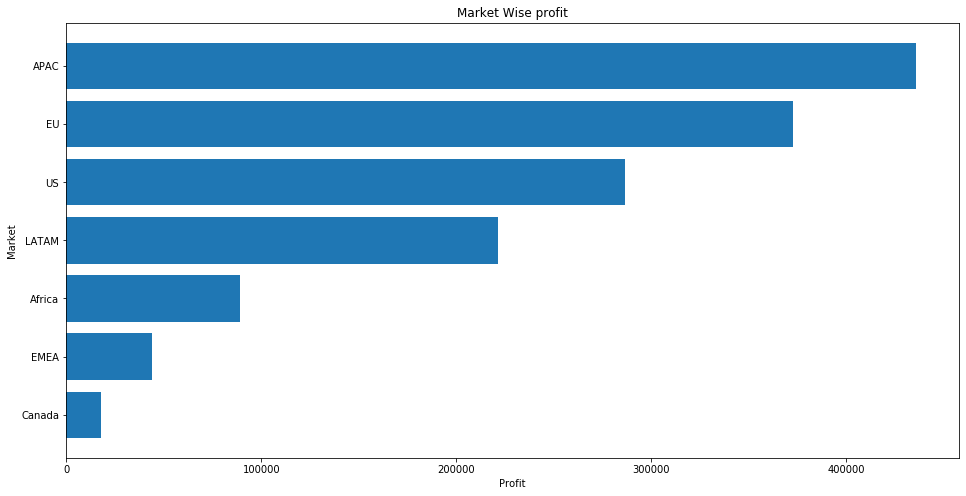

In [11]:
Session = sessionmaker(bind=engine)
session = Session()
market_profit = session.query(DimMarket.MarketName.label('Market'),
                     func.sum(FactRetail.Profit.label('Profit')).label('Total Profit')
                    ).join(DimMarket, and_(FactRetail.MarketKey == DimMarket.MarketKey)
                    ).group_by(DimMarket.MarketName).all()
    
market_profit = sorted(market_profit,key=lambda x: x[1])
plt.figure(figsize=(16,8))
markets,profit = zip(*market_profit)
# Create horizontal bars
plt.barh(markets, profit)


plt.title('Market Wise profit')
plt.ylabel('Market')
plt.xlabel('Profit')
plt.show()

**Question** : Display top 10 most profitable products.

**Answer** : Lets fetch product wise profit from our OLAP store

2020-03-15 16:39:28,640 INFO sqlalchemy.engine.base.Engine BEGIN (implicit)
2020-03-15 16:39:28,641 INFO sqlalchemy.engine.base.Engine SELECT dim_product."ProductKey" AS "dim_product_ProductKey", dim_product."ProductName" AS "Product", sum(fact_retail."Profit") AS "Total Profit" 
FROM fact_retail JOIN dim_product ON fact_retail."ProductKey" = dim_product."ProductKey" GROUP BY dim_product."ProductKey", dim_product."ProductName"
2020-03-15 16:39:28,642 INFO sqlalchemy.engine.base.Engine ()


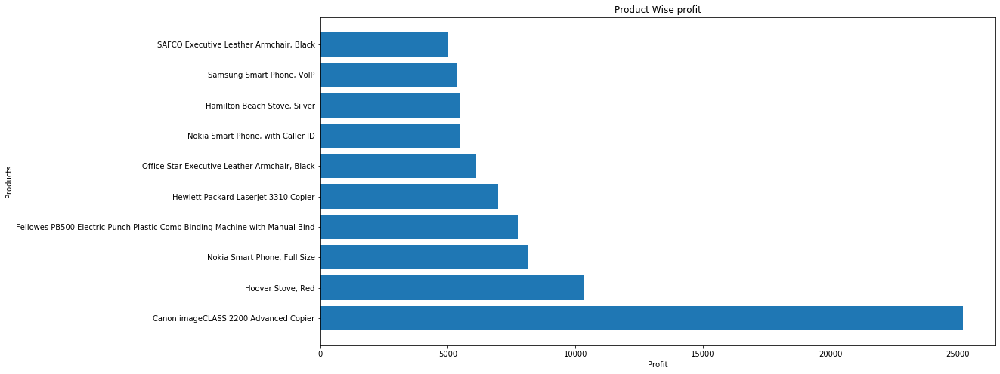

In [12]:
Session = sessionmaker(bind=engine)
session = Session()
product_profit = session.query(DimProduct.ProductKey,DimProduct.ProductName.label('Product'),
                     func.sum(FactRetail.Profit.label('Profit')).label('Total Profit')
                    ).join(DimProduct, and_(FactRetail.ProductKey == DimProduct.ProductKey)
                    ).group_by(DimProduct.ProductKey,DimProduct.ProductName).all()
    
product_profit = sorted(product_profit,key=lambda x: x[2], reverse=True)
product_profit = product_profit[:10]
plt.figure(figsize=(16,8))
_,products,profit = zip(*product_profit)
plt.barh(products, profit)
plt.title('Product Wise profit')
plt.ylabel('Products')
plt.xlabel('Profit')
plt.show()

**Question** : Display profit time series

**Answer** : Lets fetch time was profit form our OLAP Store

2020-03-15 16:39:28,962 INFO sqlalchemy.engine.base.Engine BEGIN (implicit)
2020-03-15 16:39:28,963 INFO sqlalchemy.engine.base.Engine SELECT dim_date_1."DateKey" AS "dim_date_1_DateKey", dim_date_1."Date" AS "Date", sum(fact_retail."Profit") AS "Total Profit" 
FROM fact_retail JOIN dim_date AS dim_date_1 ON fact_retail."OrderDateKey" = dim_date_1."DateKey" GROUP BY dim_date_1."DateKey", dim_date_1."Date"
2020-03-15 16:39:28,964 INFO sqlalchemy.engine.base.Engine ()


/Users/saurabhagrawal/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


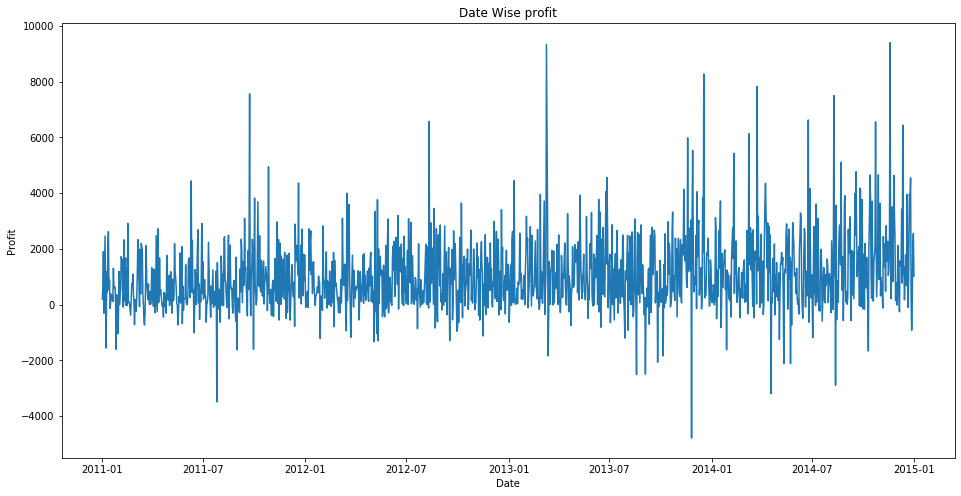

In [13]:
from sqlalchemy.orm import aliased
DimOrderDate = aliased(DimDate)

Session = sessionmaker(bind=engine)
session = Session()
date_profit = session.query(DimOrderDate.DateKey,DimOrderDate.Date.label('Date'),
                     func.sum(FactRetail.Profit.label('Profit')).label('Total Profit')
                    ).join(DimOrderDate, and_(FactRetail.OrderDateKey == DimOrderDate.DateKey)
                    ).group_by(DimOrderDate.DateKey,DimOrderDate.Date).all()
    
date_profit = sorted(date_profit,key=lambda x: x[1], reverse=True)
df = pd.DataFrame(date_profit,columns=['DateKey','Date','Profit'])
plt.figure(figsize=(16,8))
plt.plot(df['Date'],df['Profit'])
plt.title('Date Wise profit')
plt.ylabel('Profit')
plt.xlabel('Date')
plt.show()

__*conclusion*__: In this demonstration of the case study, we have gained an understanding of how to use SQLAlchemy to design a data warehouse, apply ETL process and analyze the schema. 